# Self-Driving Car Engineer Nanodegree


### Advanced Lane Finding Project By Abdelkoddous Khamsi

The goals / steps of this project are the following:

* Compute the camera calibration matrix and distortion coefficients given a set of chessboard images.
* Apply a distortion correction to raw images.
* Use color transforms, gradients, etc., to create a thresholded binary image.
* Apply a perspective transform to rectify binary image ("birds-eye view").
* Detect lane pixels and fit to find the lane boundary.
* Determine the curvature of the lane and vehicle position with respect to center.
* Warp the detected lane boundaries back onto the original image.
* Output visual display of the lane boundaries and numerical estimation of lane curvature and vehicle position.

---
## First, I'll compute the camera calibration using chessboard images

In [1]:
import numpy as np
import cv2
import glob
import matplotlib.pyplot as plt
import matplotlib.image as mpimg
import math

%matplotlib qt

# prepare object points, like (0,0,0), (1,0,0), (2,0,0) ....,(6,5,0)
objp = np.zeros((6*9,3), np.float32)
objp[:,:2] = np.mgrid[0:9,0:6].T.reshape(-1,2)

# Arrays to store object points and image points from all the images.
objpoints = [] # 3d points in real world space
imgpoints = [] # 2d points in image plane.

# Make a list of calibration images
images = glob.glob('camera_cal/calibration*.jpg')
N = len(images)

print(images)
print(type(images))
print("Number of images ==>", N)

# Step through the list and search for chessboard corners
for fname in images:
    img = cv2.imread(fname)
    gray = cv2.cvtColor(img,cv2.COLOR_BGR2GRAY)

    # Find the chessboard corners
    ret, corners = cv2.findChessboardCorners(gray, (9,6),None)

    # If found, add object points, image points
    if ret == True:
        objpoints.append(objp)
        imgpoints.append(corners)

        # Draw and display the corners
        img = cv2.drawChessboardCorners(img, (9,6), corners, ret)
        cv2.imshow('img',img)
        cv2.waitKey(1000)
    else:
        print("No corners found in ", fname)

cv2.destroyAllWindows()

C:\Users\Abdelkoddous\Anaconda3\lib\site-packages\ipykernel\parentpoller.py:116: UserWarning: Parent poll failed.  If the frontend dies,
                the kernel may be left running.  Please let us know
                about your system (bitness, Python, etc.) at
                ipython-dev@scipy.org
  ipython-dev@scipy.org""")


['camera_cal\\calibration1.jpg', 'camera_cal\\calibration10.jpg', 'camera_cal\\calibration11.jpg', 'camera_cal\\calibration12.jpg', 'camera_cal\\calibration13.jpg', 'camera_cal\\calibration14.jpg', 'camera_cal\\calibration15.jpg', 'camera_cal\\calibration16.jpg', 'camera_cal\\calibration17.jpg', 'camera_cal\\calibration18.jpg', 'camera_cal\\calibration19.jpg', 'camera_cal\\calibration2.jpg', 'camera_cal\\calibration20.jpg', 'camera_cal\\calibration3.jpg', 'camera_cal\\calibration4.jpg', 'camera_cal\\calibration5.jpg', 'camera_cal\\calibration6.jpg', 'camera_cal\\calibration7.jpg', 'camera_cal\\calibration8.jpg', 'camera_cal\\calibration9.jpg']
<class 'list'>
Number of images ==> 20
No corners found in  camera_cal\calibration1.jpg
No corners found in  camera_cal\calibration4.jpg
No corners found in  camera_cal\calibration5.jpg


objpoints array len 17
imgpoints array len 17


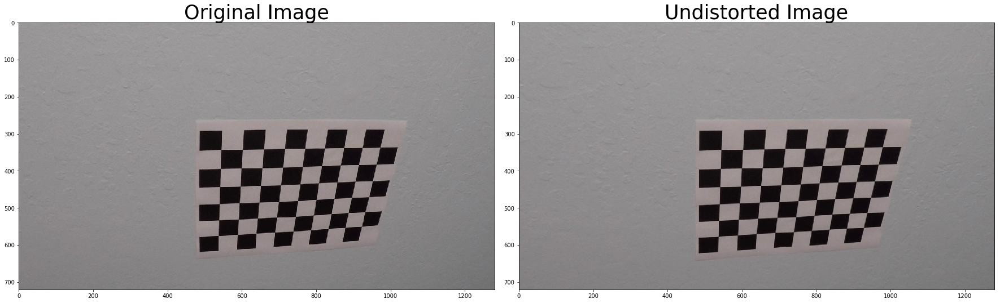

In [2]:
## Camera calibration given
%matplotlib inline

def cal_undistort(img, objpoints, imgpoints):
    # Use cv2.calibrateCamera() and cv2.undistort()
    cam_calib = cv2.calibrateCamera(objpoints, imgpoints, img.shape[:-1], None, None)
    undist = cv2.undistort(img, cam_calib[1], cam_calib[2])
    return undist

def PlotComparisonView(image_before, image_after, performedProcessing, colormap = (None, None)):
    """
    To avoid repeting ploting commands every time, will be useful throughout
    this notebook 
    """

    f, (ax1, ax2) = plt.subplots(1, 2, figsize=(24, 9))
    f.tight_layout()
    ax1.imshow(image_before, cmap = colormap[0])
    ax1.set_title('Original Image', fontsize=35)
    ax2.imshow(image_after, cmap = colormap[1])
    ax2.set_title(performedProcessing + ' Image', fontsize=35)
    plt.subplots_adjust(left=0., right=1, top=0.9, bottom=0.)
    plt.show()

img = cv2.imread(images[1])

print("objpoints array len", len( objpoints))
print("imgpoints array len", len( imgpoints))

undistorted_img = cal_undistort(img, objpoints, imgpoints)

PlotComparisonView(img, undistorted_img, 'Undistorted')

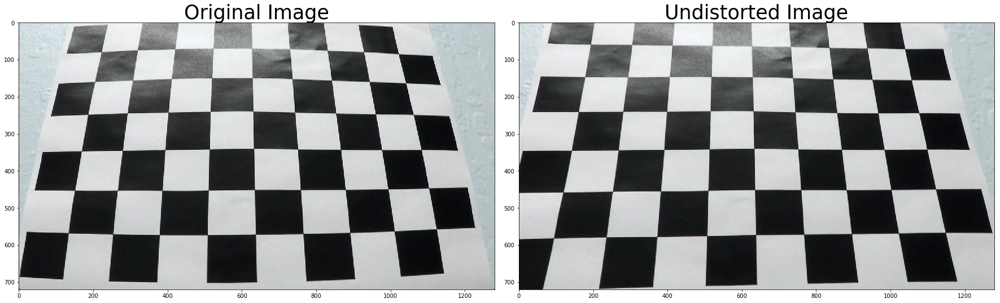

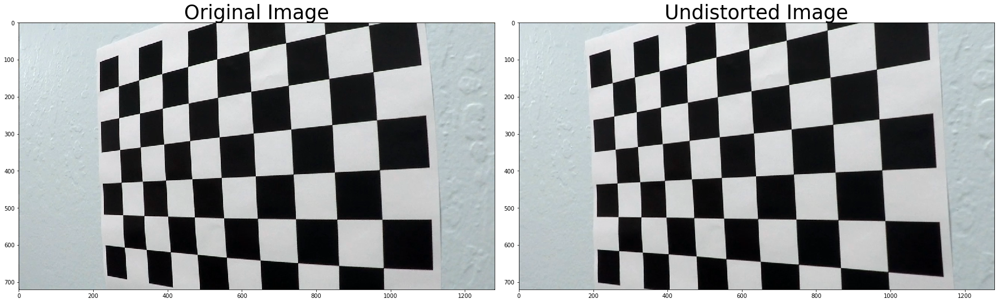

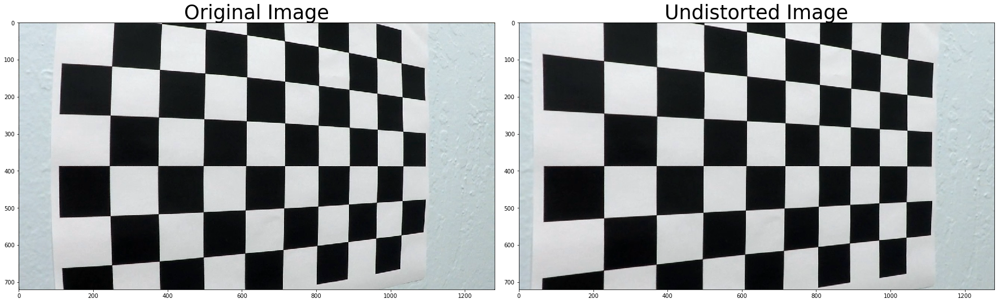

In [3]:
# Visualizing before and after of Undistortion on some chessboard images
for i in range(13,16):
    
    img = cv2.imread(images[i])
    undistorted_img = cal_undistort(img, objpoints, imgpoints)
    
    PlotComparisonView(img, undistorted_img, 'Undistorted')

## Then, I'll Apply a distortion correction to raw images

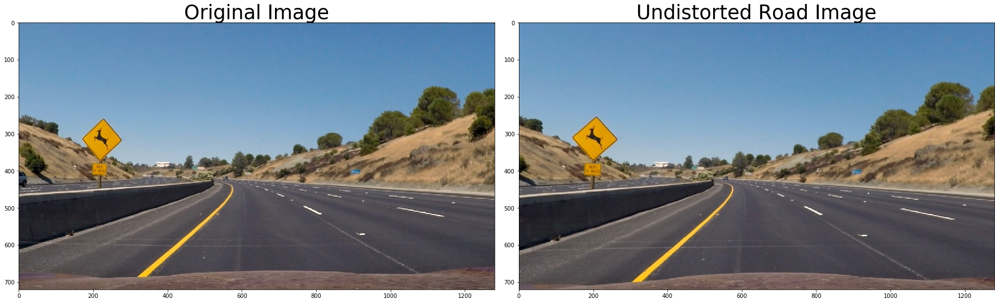

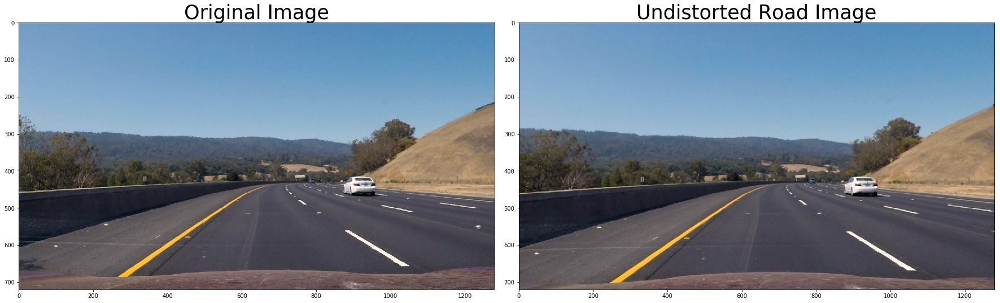

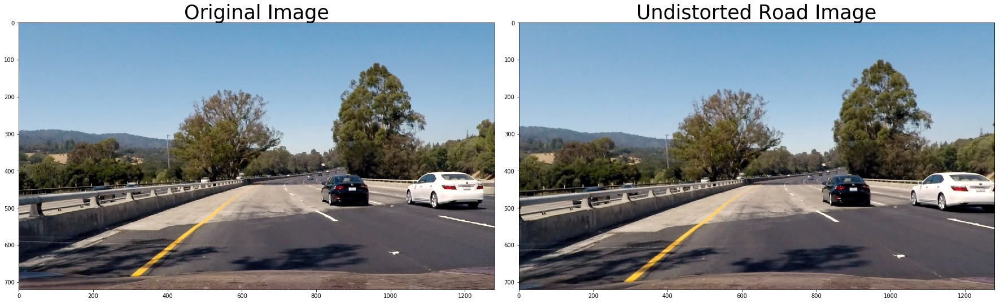

In [4]:
import matplotlib.image as mpimg

# Visualizing before and after of Undistortion on real world application image
test_images = glob.glob('test_images/test*.jpg')

for i in range(1,4):
    img = mpimg.imread(test_images[i])
    undistorted_img = cal_undistort(img, objpoints, imgpoints)
    PlotComparisonView(img, undistorted_img, 'Undistorted Road')

## I'll Use color transforms, gradients, etc., to create a thresholded binary image

* Let's start playing with the sobel operator

In [5]:
def axis_gradient(img, ksize=9, thresh=(30,255)):
    ## x gradient

    # convert to gray scale
    #if channel == 'gray':
    #    gray_image = cv2.cvtColor(img, cv2.COLOR_RGB2GRAY)
    #else:
    #    gray_image = img
    if len(img.shape) == 3:
        gray_image = cv2.cvtColor(img, cv2.COLOR_RGB2GRAY)
    elif len(img.shape) ==2:
        gray_image = img
    
    height = img.shape[0]
    width = img.shape[1]
    # derivative along x
    sobelx = cv2.Sobel(gray_image, cv2.CV_64F, 1, 0, ksize)

    abs_sobel = np.absolute(sobelx)

    scaled_sobel = np.uint8(255*abs_sobel/np.max(abs_sobel))

    single_axis_binary = np.zeros_like(gray_image, dtype=np.uint8)
    #single_axis_binary = np.zeros((height,width,1), np.uint8)

    single_axis_binary[ (scaled_sobel >= thresh[0]) & (scaled_sobel <= thresh[1])] = 1

    return single_axis_binary#cv2.Canny(gray_image, 20, 50) #

def magnitude_gradient(img, ksize=9, thresh=(50,255),channel='gray'):
    ## mag gradient
    # convert to gray scale
    #if channel == 'gray':
    #    gray_image = cv2.cvtColor(img, cv2.COLOR_RGB2GRAY)
    #else:
    #    gray_image = img
    if len(img.shape) == 3:
        gray_image = cv2.cvtColor(img, cv2.COLOR_RGB2GRAY)
    elif len(img.shape) ==2:
        gray_image = img
        
    # derivative along x and y
    sobelx = cv2.Sobel(gray_image, cv2.CV_64F, 1, 0, ksize)
    sobely = cv2.Sobel(gray_image, cv2.CV_64F, 0, 1, ksize)
    sobelxy = np.sqrt(sobelx**2 + sobely**2)

    scaled_sobel = np.uint8(255*sobelxy/np.max(sobelxy))

    mag_binary = np.zeros_like(gray_image)
    mag_binary[ (scaled_sobel >= thresh[0]) & (scaled_sobel <= thresh[1])] = 1

    return mag_binary

def direction_gradient(img, ksize=9, thresh=(0.7,1.3),channel='gray'):
    ## direction gradient

    # convert to gray scale
    #if channel == 'gray':
    #    gray_image = cv2.cvtColor(img, cv2.COLOR_RGB2GRAY)
    #else:
    #    gray_image = img
    if len(img.shape) == 3:
        gray_image = cv2.cvtColor(img, cv2.COLOR_RGB2GRAY)
    elif len(img.shape) ==2:
        gray_image = img
        
    # derivative along x and y
    sobelx = cv2.Sobel(gray_image, cv2.CV_64F, 1, 0, ksize)
    sobely = cv2.Sobel(gray_image, cv2.CV_64F, 0, 1, ksize)
    
    abs_sobelx = np.absolute(sobelx)
    abs_sobely = np.absolute(sobely)

    sobel_direction = np.arctan2(abs_sobely, abs_sobelx)

    dir_binary = np.zeros_like(sobel_direction)
    dir_binary[ (sobel_direction >= thresh[0]) & (sobel_direction <= thresh[1])] = 1

    return dir_binary


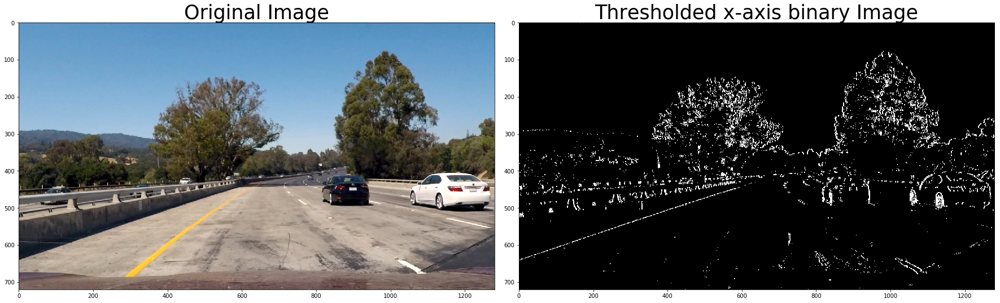

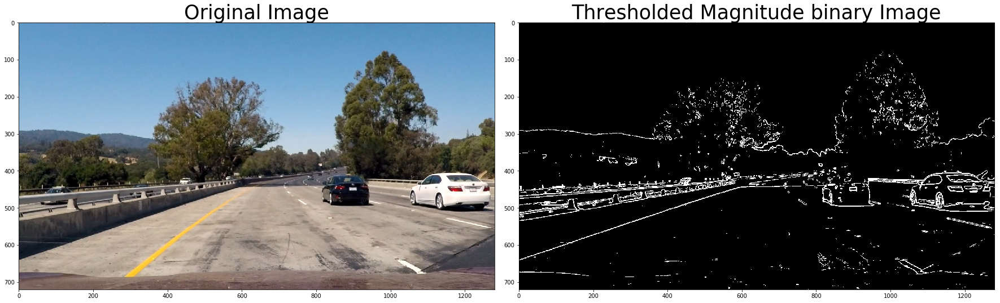

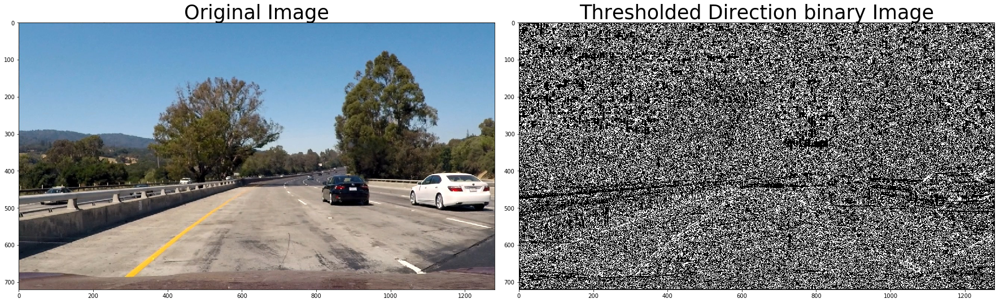

In [6]:
image = mpimg.imread(test_images[0])

# Apply all three distinct gradient
axis_binary_output = axis_gradient(image)
mag_binary_output = magnitude_gradient(image)
dir_binary_output = direction_gradient(image)


PlotComparisonView(image, axis_binary_output, 'Thresholded x-axis binary', (None, 'gray'))
PlotComparisonView(image, mag_binary_output, 'Thresholded Magnitude binary', (None, 'gray'))
PlotComparisonView(image, dir_binary_output, 'Thresholded Direction binary', (None, 'gray'))

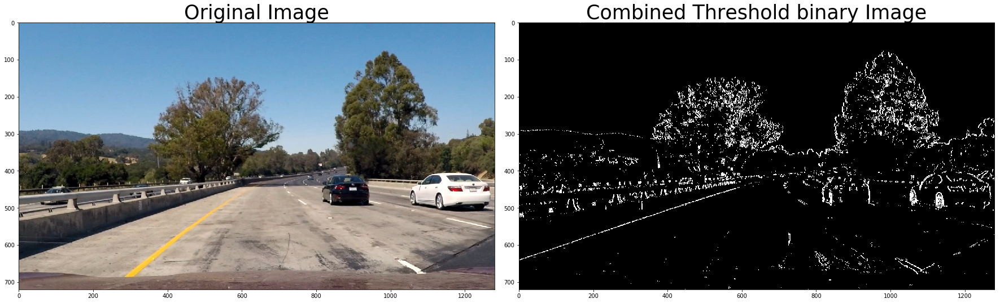

In [7]:
# Play with threshold combination
combined_binary = np.zeros_like(axis_binary_output)
combined_binary[ (axis_binary_output==1) | (mag_binary_output*dir_binary_output == 1) ] = 1

PlotComparisonView(image, combined_binary, 'Combined Threshold binary', (None, 'gray'))


In [8]:
def combinedGradient_thresholdedBinary(img):
    
    #print("Image shape ==>",img.shape)
    axis_binary_output = axis_gradient(img)
    mag_binary_output = magnitude_gradient(img)
    dir_binary_output = direction_gradient(img)
    
    combined_binary = np.zeros_like(axis_binary_output)
    combined_binary[ (axis_binary_output==1) | (mag_binary_output*dir_binary_output == 1) ] = 1

    return combined_binary

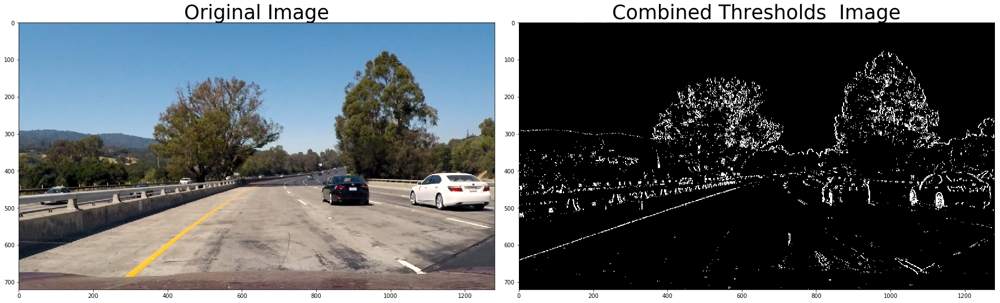

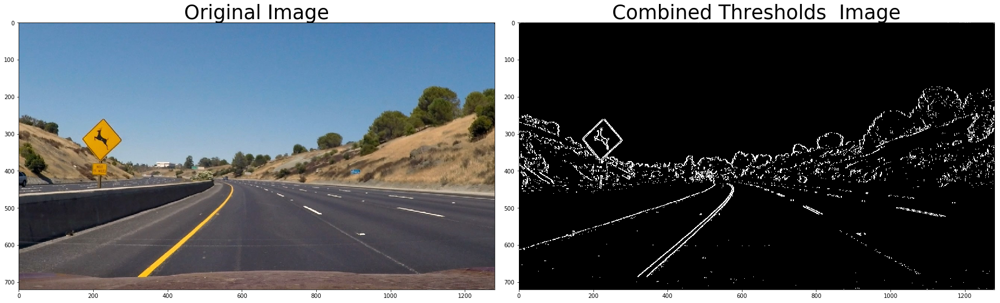

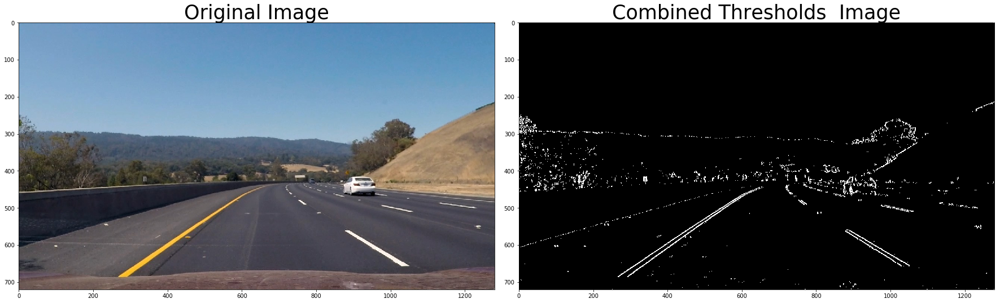

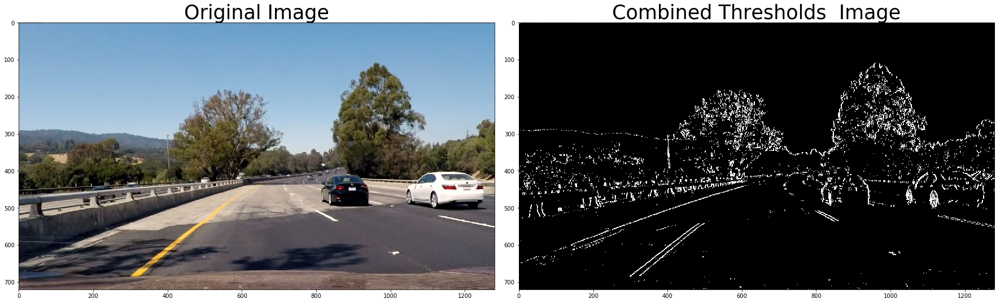

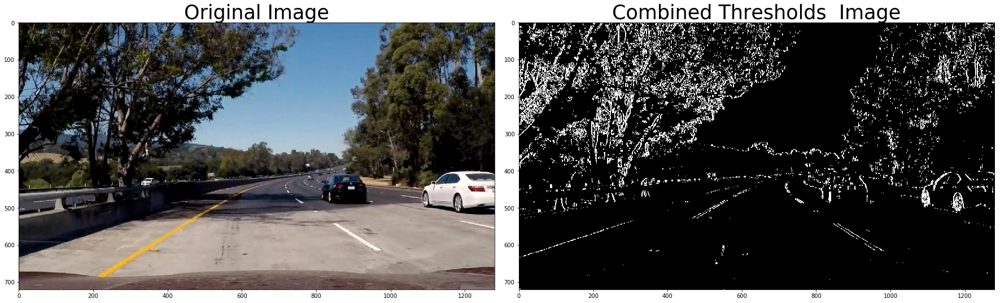

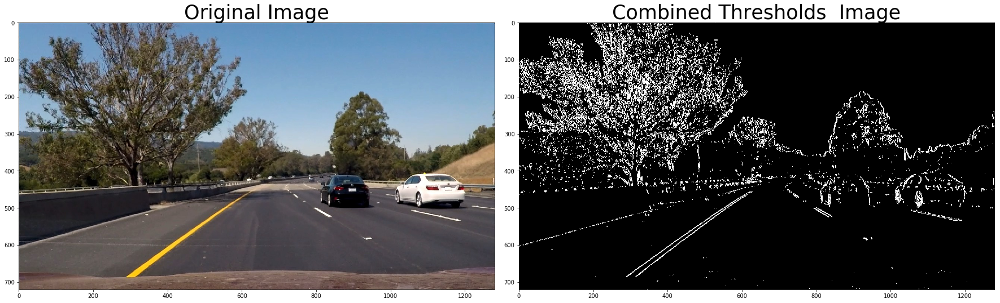

In [9]:
# Check on all the test images
for i in range ( len(test_images) ):
    
    img = mpimg.imread(test_images[i])
    
    combined_threshold = combinedGradient_thresholdedBinary(img)
    
    PlotComparisonView(img, combined_threshold, 'Combined Thresholds ', (None, 'gray'))
    
    cv2.imwrite("output_images/write_test"+str(i)+".jpg", combined_threshold)

    

* Let's start playing with color spaces to solve the issues of diffirent colorations of th road we can see for example in the first image.

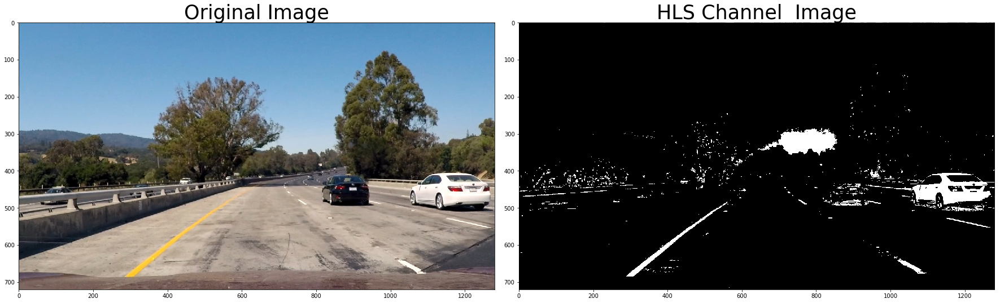

In [10]:
def to_HLS_Color_Channel(img, L_thresh=(200,255), S_thresh=(200,255)):
    
    hls = cv2.cvtColor(img, cv2.COLOR_RGB2HLS)
    
    H_thresh = (10,40)
    H = hls[:,:,0]
    L = hls[:,:,1]
    S = hls[:,:,2]
    
    S_binary = np.zeros_like(S)
    L_binary = np.zeros_like(L)
    H_binary = np.zeros_like(H)

#    S_binary[ ( ( L >= L_thresh[0] ) & ( L <= L_thresh[1] ) ) 
#            | ( ( S >= S_thresh[0]) & (S <= S_thresh[1] ) ) ] = 1

    L_binary[ (L >= L_thresh[0]) & (L <= L_thresh[1]) ] = 1 # to extract white lanes
    S_binary[ (S >= S_thresh[0]) & (S <= S_thresh[1]) ] = 1
    H_binary[ (H >= H_thresh[0]) & (H <= H_thresh[1]) ] = 1
    
    return L_binary | S_binary



image = mpimg.imread(test_images[0])
#s_binary = to_S_Color_Channel(image,(190,255))
s_binary = to_HLS_Color_Channel(image)

PlotComparisonView(image, s_binary, 'HLS Channel ', (None, 'gray'))


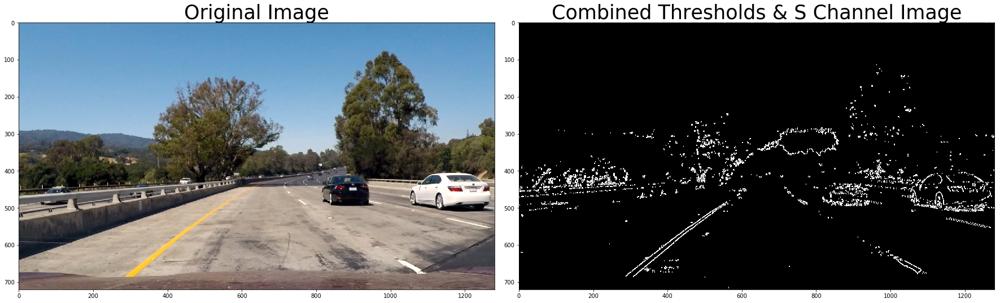

In [11]:
s_binary = to_HLS_Color_Channel(image)

combined_threshold = combinedGradient_thresholdedBinary(s_binary)

PlotComparisonView(image, combined_threshold, 'Combined Thresholds & S Channel', (None, 'gray'))

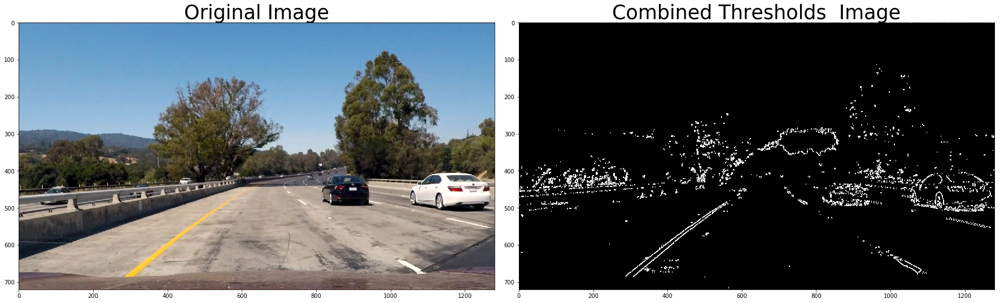

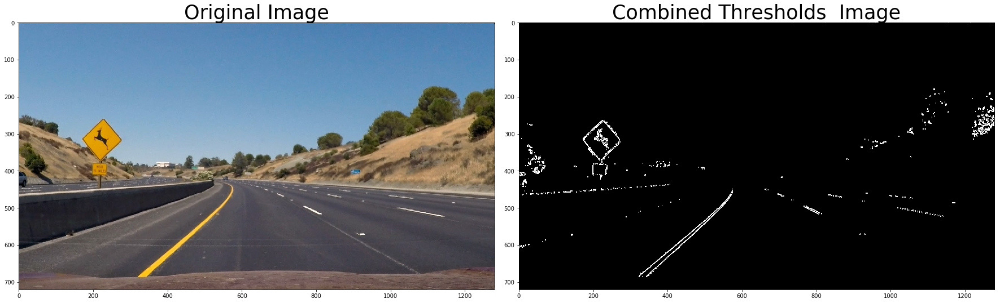

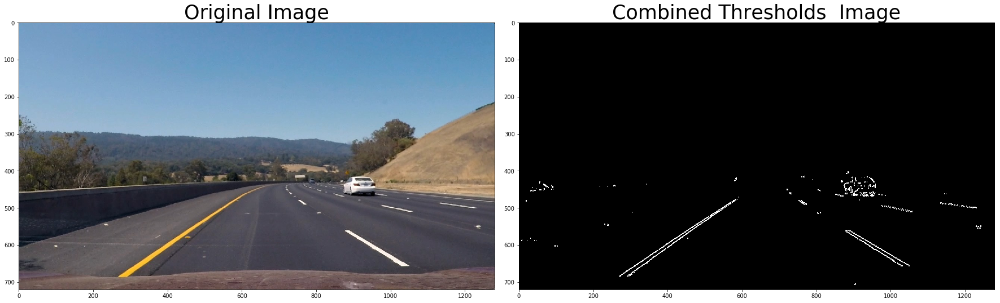

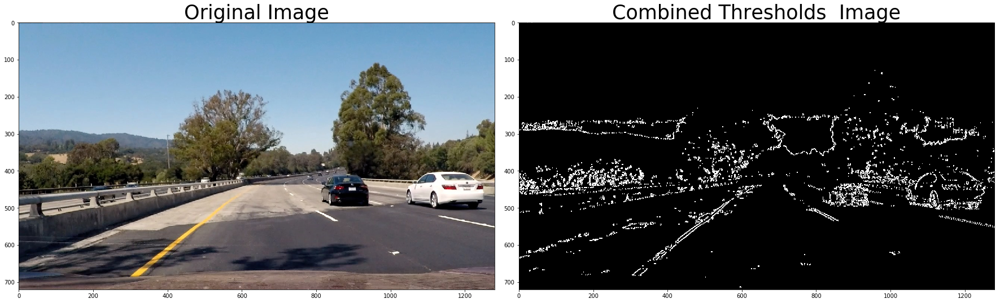

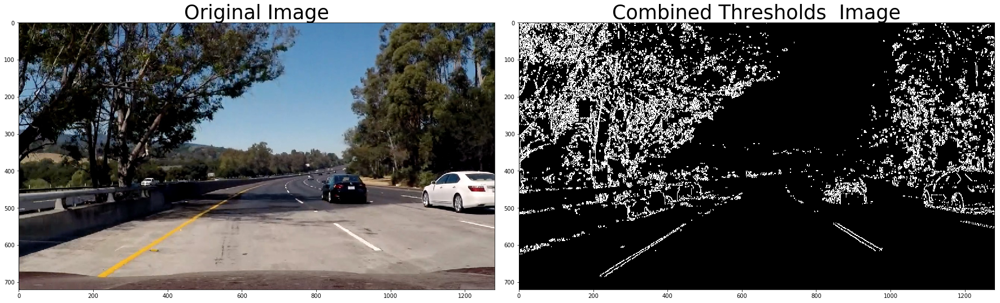

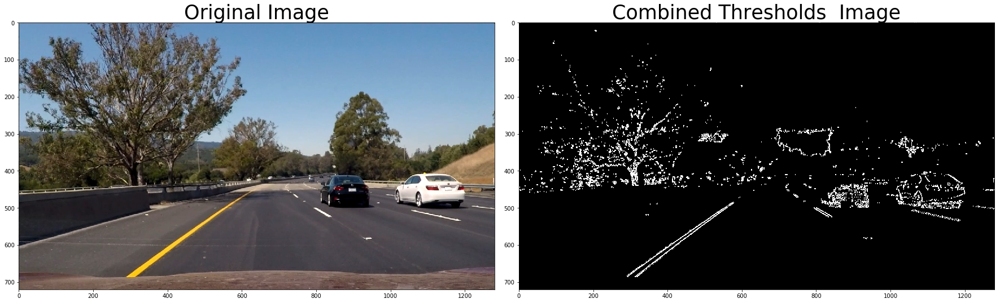

In [12]:
# Check on all the test images
for i in range ( len(test_images) ):
    
    img = mpimg.imread(test_images[i])
    
    s_binary = to_HLS_Color_Channel(img)
    
    combined_threshold = combinedGradient_thresholdedBinary(s_binary)
    
    PlotComparisonView(img, combined_threshold, 'Combined Thresholds ', (None, 'gray'))


 ## I'll use now a perspective transform to rectify binary image ("birds-eye view")

In [13]:
def drawConvexPolygonEdgesVertices(img, pts, edge = True, vertex = True):
    """
    pts: a sequence of pts that create a convex polygon
    """
    col = [255, 0, 0]
    thick = 3
    rad = 15
    
    img_copy = img.copy() # avoid img_copy = img as both images will be modified 
    
    if vertex == True:
        # draw vertices
        for pt in pts:
            cv2.circle(img_copy, pt, rad, col, -thick, lineType=8, shift=0)
    
   
    if edge == True:
        # draw edges
        N = len(pts)
        for i in range(N):
            
            cv2.line(img_copy, pts[ i ], pts[ (i+1) % N ], col, thick)
    
    return img_copy



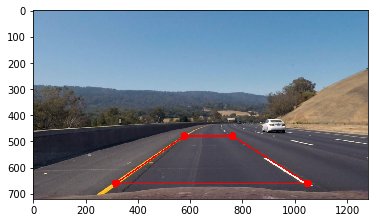

In [14]:
%matplotlib qt
image = mpimg.imread(test_images[2])
image = cal_undistort(image, objpoints, imgpoints)
img_size = ( image.shape[1], image.shape[0] )

# Manually selecting the cordinnates for a src points of RoI
src_p1 = (316,660)  # bottom left
src_p2 = (1050,660) # bottom right
src_p3 = (762,480)  # top right
src_p4 = (578,480)  # top left

src = np.float32([ src_p1, src_p2, src_p3, src_p4 ])

image_RoI = drawConvexPolygonEdgesVertices(image, [ src_p1, src_p2, src_p3, src_p4 ])

plt.imshow(image_RoI)
plt.show()

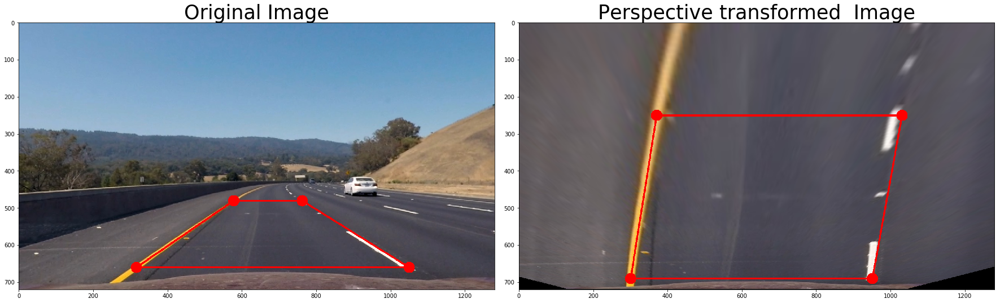

In [15]:
%matplotlib inline

height = image.shape[0]
width = image.shape[1]
# Manually selecting the cordinnates for a dst points of RoI
# need for a more reliable way to select src and dst points
dst_p1 = (350, height - 30)       # bottom left
dst_p2 = (width-300, height - 30) # bottom right
dst_p3 = (width-270, 200)         # top right
dst_p4 = (380, 200)               # top left

dst_p1 = (300, height - 30)       # bottom left
dst_p2 = (width-330, height - 30) # bottom right
dst_p3 = (width - 250, 250)         # top right
dst_p4 = (300+70, 250)               # top left

dst = np.float32([ dst_p1, dst_p2, dst_p3, dst_p4])

# generate perspective transofrmation matrix given source and destination points
M = cv2.getPerspectiveTransform(src, dst)

# perform perspective transformation
warped = cv2.warpPerspective(image, M, img_size, flags=cv2.INTER_LINEAR)

warped_RoI = drawConvexPolygonEdgesVertices(warped, [ dst_p1, dst_p2, dst_p3, dst_p4])

PlotComparisonView(image_RoI, warped_RoI, 'Perspective transformed ', colormap = (None, None))



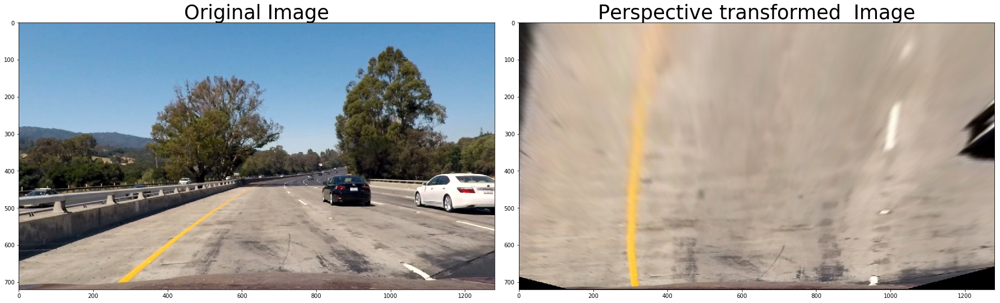

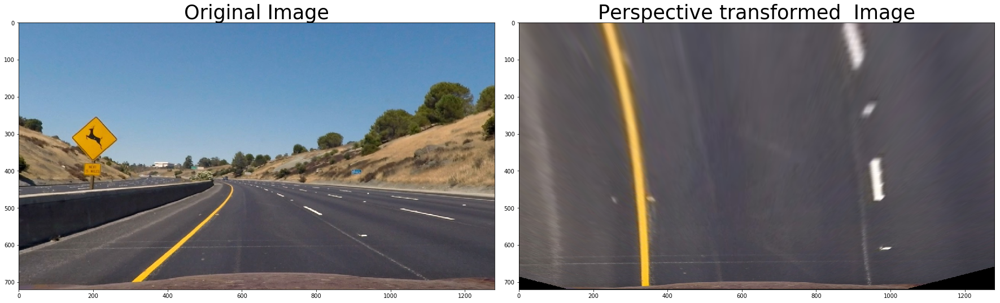

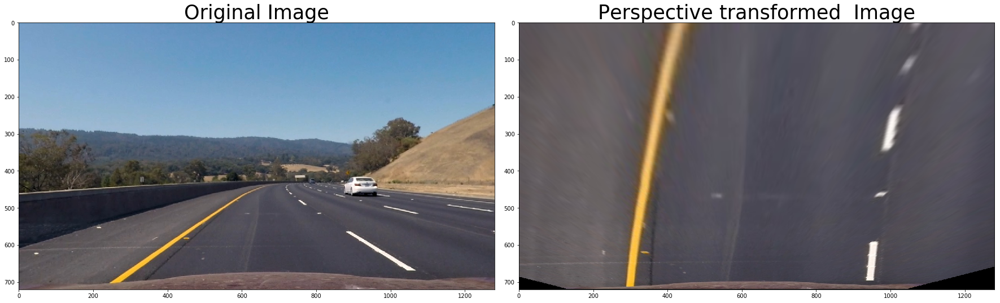

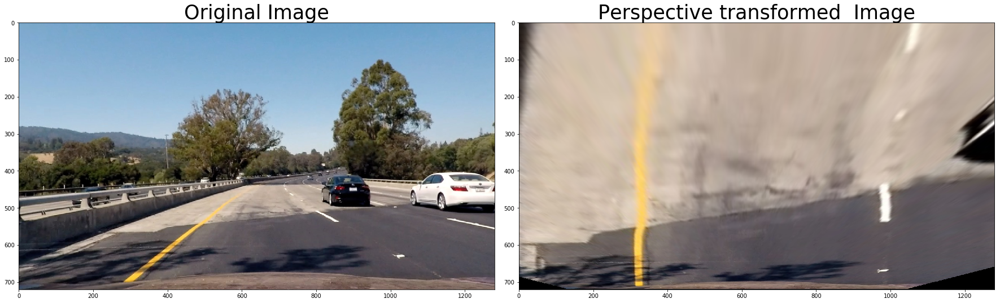

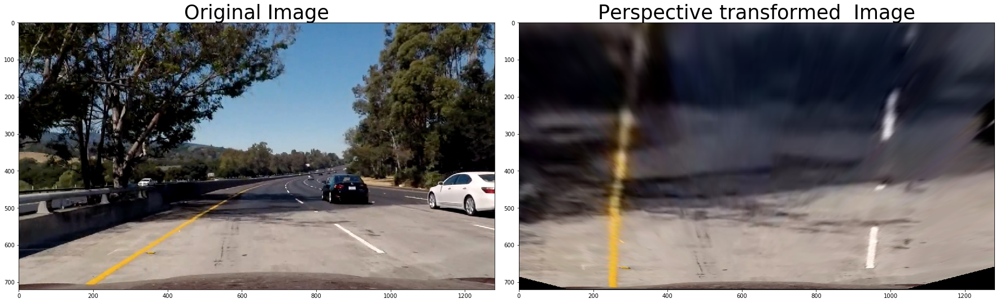

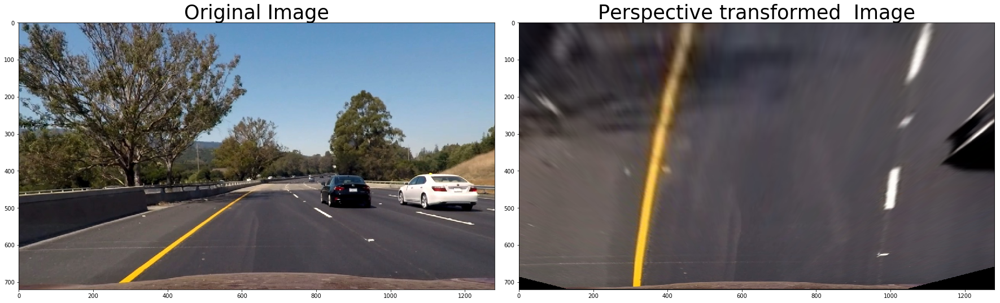

In [16]:
# Check result for all test images
for i in range ( len(test_images) ):
    
    img = mpimg.imread(test_images[i])
    undistort_img = cal_undistort(img, objpoints, imgpoints)

    warped_img = cv2.warpPerspective(undistort_img, M, img_size, flags=cv2.INTER_LINEAR)

    PlotComparisonView(undistort_img, warped_img, 'Perspective transformed ', (None, 'gray'))


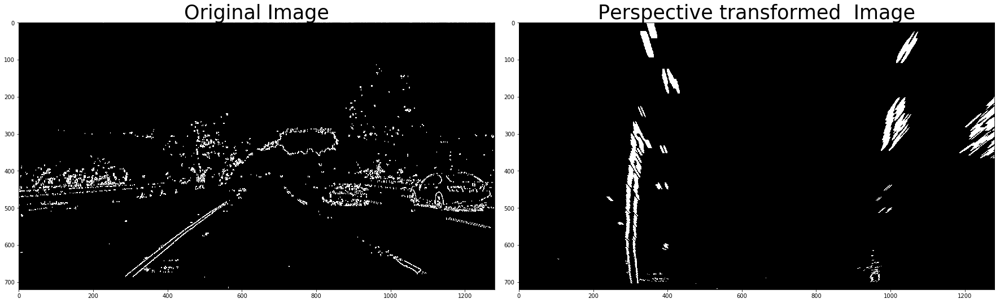

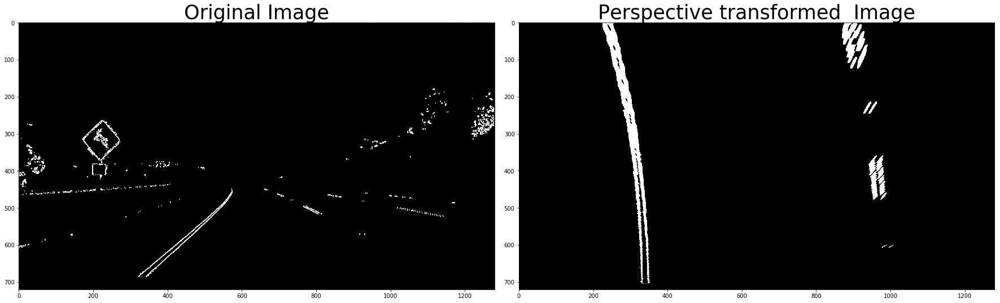

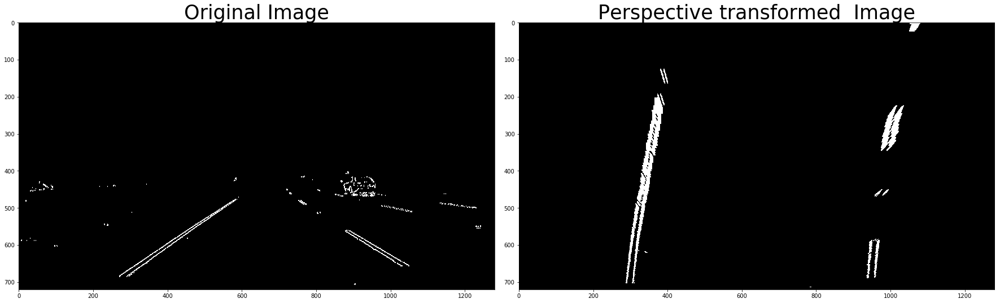

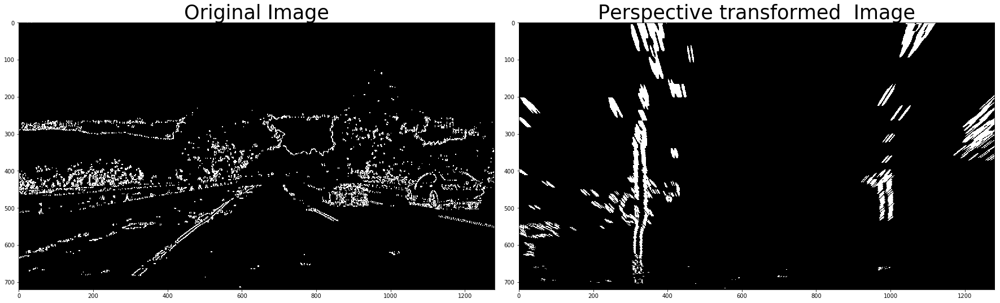

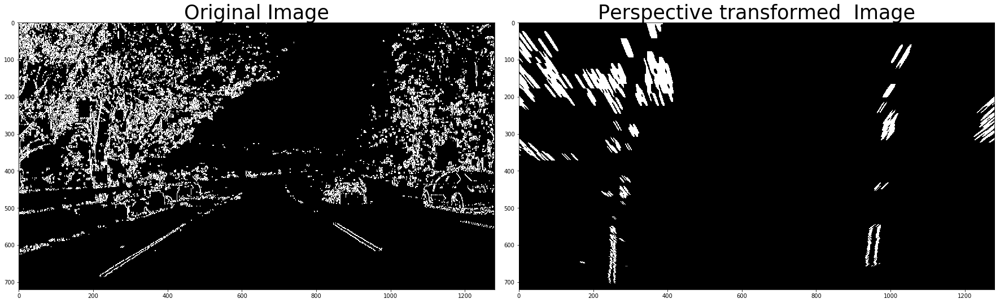

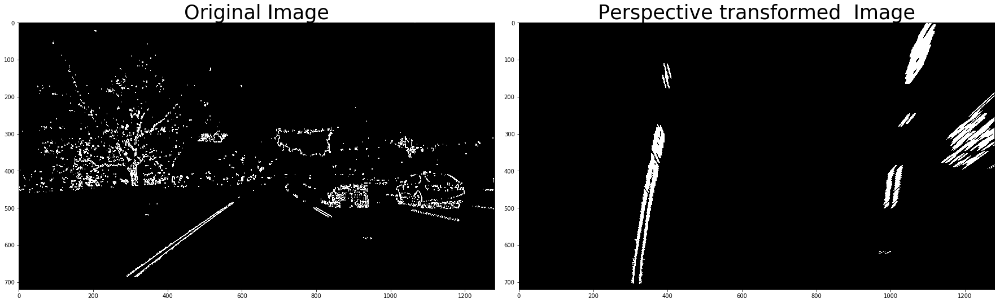

In [17]:
# Check result for all test binary images
test_warped_imgs = []
for i in range ( len(test_images) ):
    
    img = mpimg.imread(test_images[i])
    undistort_img = cal_undistort(img, objpoints, imgpoints)

    
    s_binary = to_HLS_Color_Channel(img)
    
    combined_threshold = combinedGradient_thresholdedBinary(s_binary)
    
    warped_img = cv2.warpPerspective(combined_threshold, M, img_size, flags=cv2.INTER_LINEAR)
    test_warped_imgs += [warped_img]

    PlotComparisonView(combined_threshold, warped_img, 'Perspective transformed ', ('gray', 'gray'))


## Detect lane pixels and fit to find the lane boundary.

In [18]:
# reuse histogram from course material
def hist(img):
    # TO-DO: Grab only the bottom half of the image
    # Lane lines are likely to be mostly vertical nearest to the car

    height = img.shape[0]
    bottom_half = img[ height//2:,: ]

    # TO-DO: Sum across image pixels vertically - make sure to set `axis`
    # i.e. the highest areas of vertical lines should be larger values
    histogram = np.sum( bottom_half, axis=0)
    
    return histogram


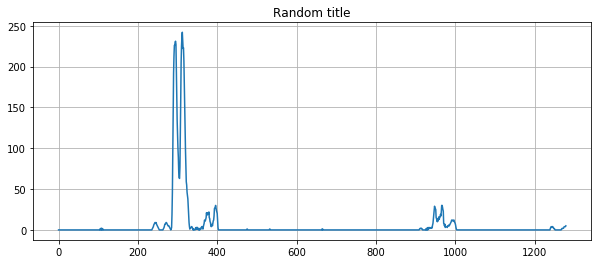

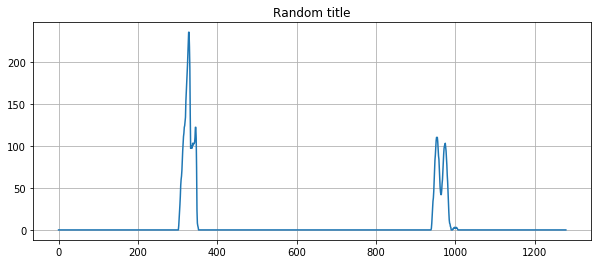

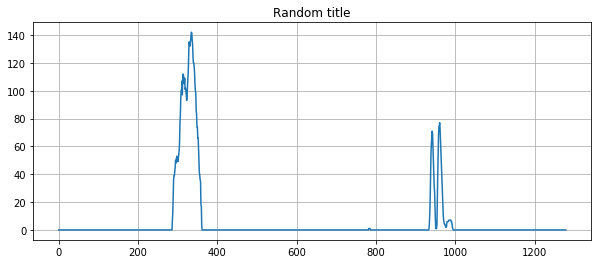

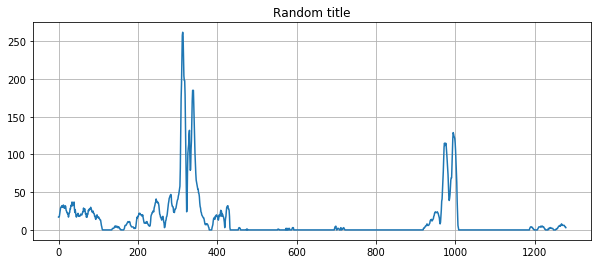

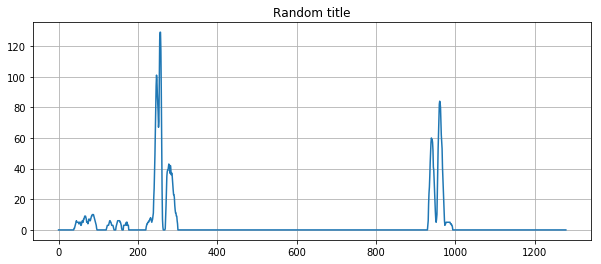

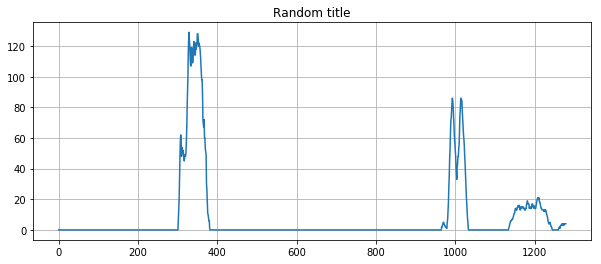

In [19]:
for i in range(6):
    # Create histogram of image binary activations
    histogram = hist(test_warped_imgs[i])

    # Visualize the resulting histogram
    fig = plt.figure(1, figsize=(10, 4))
    plt.title("Random title")
    plt.grid()
    plt.plot(histogram)
    plt.show()

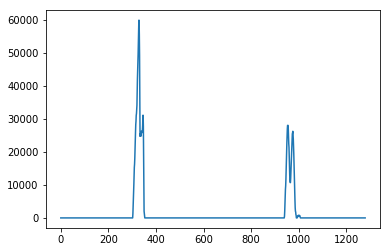

stacked image dimension (720, 1280, 3)
(1280,)
640
328 953
(array([  0,   0,   0, ..., 704, 704, 704], dtype=int64), array([223, 224, 225, ..., 333, 334, 340], dtype=int64))
577 0
new left base is ==> 338
971 53
new left base is ==> 335
new right base is ==> 990
1277 0
new left base is ==> 330
1584 2018
new left base is ==> 323
new right base is ==> 964
1841 1037
new left base is ==> 314
new right base is ==> 960
2019 56
new left base is ==> 302
new right base is ==> 935
2055 387
new left base is ==> 286
new right base is ==> 945
2062 1115
new left base is ==> 268
new right base is ==> 905
2211 3419
new left base is ==> 248
new right base is ==> 899
Number of non zero pixels are in the whole image (22992,)
Number of non zero pixels indices on the left lane (14597,)
Number of non zero pixels indices on the right lane (8085,)
(720, 1280, 3)


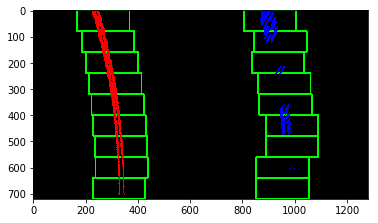

In [20]:
# HYPERPARAMETERS
# Choose the number of sliding windows
nwindows = 9
# Set the width of the windows +/- margin
margin = 100
# Set minimum number of pixels found to recenter window
minpix = 50

test_im = test_warped_imgs[1]
if np.max(test_im) == 1:
    test_im = np.uint8(255*test_im)

histogram = hist(test_im)
plt.plot(histogram)
plt.show()

out_img = np.dstack((test_im, test_im, test_im))
print("stacked image dimension", out_img.shape)
# peak of left and right part of the histogram, starting points of left and right lanes
print(histogram.shape)
midpoint = np.int(histogram.shape[0]//2)
print(midpoint)

leftxbase = np.argmax(histogram[:midpoint])
rightxbase = np.argmax(histogram[midpoint:]) + midpoint
print(leftxbase, rightxbase)

# Set height of windows - based on nwindows above and image shape
window_height = np.int(test_im.shape[0]//nwindows)

# Identify the x and y positions of all nonzero pixels in the image
nonzero = test_im.nonzero()
print(nonzero)
nonzeroy = np.array(nonzero[0])
nonzerox = np.array(nonzero[1])

# Current positions to be updated later for each window in nwindows
leftx_current = leftxbase
rightx_current = rightxbase

# Create empty lists to receive left and right lane pixel indices
left_lane_inds = []
right_lane_inds = []

# Step through the windows one by one
for window in range(nwindows):
    # Identify window boundaries in x and y (and right and left)
    win_y_low = test_im.shape[0] - (window+1)*window_height
    win_y_high = test_im.shape[0] - window*window_height
    ### TO-DO: Find the four below boundaries of the window ###
    win_xleft_low = leftx_current - margin  # Update this
    win_xleft_high = leftx_current + margin  # Update this
    win_xright_low = rightx_current - margin  # Update this
    win_xright_high = rightx_current + margin  # Update this

    #Identify the nonzero pixels in x and y within the window
    left_nonzero_pixels = ( (nonzerox > win_xleft_low) & (nonzerox < win_xleft_high)
                           & (nonzeroy > win_y_low) & (nonzeroy < win_y_high) ).nonzero()[0]
    
    right_nonzero_pixels = ( (nonzerox > win_xright_low) & (nonzerox < win_xright_high)
                           & (nonzeroy > win_y_low) & (nonzeroy < win_y_high) ).nonzero()[0]
    
    print(len(left_nonzero_pixels), len(right_nonzero_pixels)) # How many non zero pixels indices are on 
                                                               # the left & right line in current window
    left_lane_inds.append(left_nonzero_pixels) 
    right_lane_inds.append(right_nonzero_pixels) 
    
    # Draw the windows on the visualization image
    cv2.rectangle(out_img,(win_xleft_low,win_y_low), (win_xleft_high,win_y_high),(0,255,0), 5) 
    cv2.rectangle(out_img,(win_xright_low,win_y_low),(win_xright_high,win_y_high),(0,255,0), 5)
    
    # recalculating the base x-coordinates of left and right windows
    if (len(left_nonzero_pixels) > minpix):
        leftx_pixelpos_current = nonzerox[left_nonzero_pixels]
        leftx_current = np.int(np.mean( leftx_pixelpos_current, axis=0) )
        print("new left base is ==>", leftx_current)
    
    if ( len( right_nonzero_pixels ) > minpix):
        rightx_pixelpos_current = nonzerox[right_nonzero_pixels]
        rightx_current = np.int(np.mean( rightx_pixelpos_current, axis=0) )
        print("new right base is ==>", rightx_current)
    

left_lane_inds = np.concatenate( left_lane_inds )
right_lane_inds = np.concatenate( right_lane_inds )
print("Number of non zero pixels are in the whole image", nonzero[0].shape) #how many non zero pixels are in the whole image
print("Number of non zero pixels indices on the left lane", left_lane_inds.shape) # how many non zero pixels indices are on the left line
print("Number of non zero pixels indices on the right lane", right_lane_inds.shape) # how many non zero pixels indices are on the right line


# get pixel position from pixel indices
leftx_pos = nonzerox[left_lane_inds]
lefty_pos = nonzeroy[left_lane_inds]
rightx_pos = nonzerox[right_lane_inds]
righty_pos = nonzeroy[right_lane_inds]

out_img[ lefty_pos, leftx_pos] = [255, 0, 0]
out_img[ righty_pos, rightx_pos] = [0, 0, 255] 

plt.imshow(out_img)
print(out_img.shape)

In [21]:


def detectLanePixels(test_im, stats=True):
    
    # HYPERPARAMETERS
    # Choose the number of sliding windows
    nwindows = 9
    # Set the width of the windows +/- margin
    margin = 100
    # Set minimum number of pixels found to recenter window
    minpix = 50
    
    # Make sure image values are in [0, 255] interval
    if np.max(test_im) == 1:
        test_im = np.uint8(255*test_im)
    
    # Create a histogram for the second half of the image
    histogram = hist(test_im)

    # Create output image to draw on and visualize result
    out_img = np.dstack((test_im, test_im, test_im))

    # peak of left and right part of the histogram are starting points of left and right lanes
    midpoint = np.int(histogram.shape[0]//2)
    leftxbase = np.argmax(histogram[:midpoint])
    rightxbase = np.argmax(histogram[midpoint:]) + midpoint


    # Set height of windows - based on nwindows above and image shape
    window_height = np.int(test_im.shape[0]//nwindows)

    # Identify the x and y positions of all nonzero pixels in the image
    nonzero = test_im.nonzero() # nonzero is a 2-elements tuple
    nonzeroy = np.array(nonzero[0]) # first element is an array of y coordinates of non-zero pixels
    nonzerox = np.array(nonzero[1]) # second element is an array of x coordinates of non-zero pixels

    # Current positions to be updated later for each window in nwindows
    leftx_current = leftxbase
    rightx_current = rightxbase

    # Create empty lists to receive left and right lane pixel indices
    left_lane_inds = []
    right_lane_inds = []
    
    # This list is only for a general stat purpose
    activatedPixels_perWindow = []

    # Step through the windows one by one
    for window in range(nwindows):
        # Identify window boundaries in x and y (and right and left)
        win_y_low = test_im.shape[0] - (window+1)*window_height
        win_y_high = test_im.shape[0] - window*window_height

        #Find the four boundaries of the left & right windows on x axis 
        win_xleft_low = leftx_current - margin  
        win_xleft_high = leftx_current + margin 
        win_xright_low = rightx_current - margin  
        win_xright_high = rightx_current + margin

        #Identify the nonzero pixels in x and y within the window
        left_nonzero_pixels = ( (nonzerox > win_xleft_low) & (nonzerox < win_xleft_high)
                               & (nonzeroy > win_y_low) & (nonzeroy < win_y_high) ).nonzero()[0]

        right_nonzero_pixels = ( (nonzerox > win_xright_low) & (nonzerox < win_xright_high)
                               & (nonzeroy > win_y_low) & (nonzeroy < win_y_high) ).nonzero()[0]

        #print(len(left_nonzero_pixels), len(right_nonzero_pixels)) # How many non zero pixels indices are on 
                                                                   # the left & right line in current window
        activatedPixels_perWindow.insert(0,[len(left_nonzero_pixels), len(right_nonzero_pixels)])    
        
        # add the result to the one from previous windows
        left_lane_inds.append(left_nonzero_pixels) 
        right_lane_inds.append(right_nonzero_pixels) 

        # Draw the windows on the visualization image
        cv2.rectangle(out_img,(win_xleft_low,win_y_low), (win_xleft_high,win_y_high),(0,255,0), 5) 
        cv2.rectangle(out_img,(win_xright_low,win_y_low),(win_xright_high,win_y_high),(0,255,0), 5)

        # recalculating the base x-coordinates of left and right windows
        if (len(left_nonzero_pixels) > minpix):
            # Position of activated pixels in current left window
            leftx_pixelpos_current = nonzerox[left_nonzero_pixels]
            leftx_current = np.int(np.mean( leftx_pixelpos_current, axis=0) )
            #print("new left base is ==>", leftx_current)

        if ( len( right_nonzero_pixels ) > minpix):
            # Position of activated pixels in current right window
            rightx_pixelpos_current = nonzerox[right_nonzero_pixels]
            rightx_current = np.int(np.mean( rightx_pixelpos_current, axis=0) )
            #print("new right base is ==>", rightx_current)

    # reorganise indices across all windows
    left_lane_inds = np.concatenate( left_lane_inds )
    right_lane_inds = np.concatenate( right_lane_inds )
    
    if stats == True:
        print("leftxbase : ", leftxbase, 'rightxbase : ', rightxbase)
        print("Number of non zero pixels are in the whole image", nonzero[0].shape) #how many non zero pixels are in the whole image
        print("Number of non zero pixels indices on the left lane", left_lane_inds.shape) # how many non zero pixels indices are on the left line
        print("Number of non zero pixels indices on the right lane", right_lane_inds.shape) # how many non zero pixels indices are on the right line
        print("Number of activated pixels per window", np.array(activatedPixels_perWindow) )

    # get pixel position from pixel indices
    leftx_pos = nonzerox[left_lane_inds]
    lefty_pos = nonzeroy[left_lane_inds]
    rightx_pos = nonzerox[right_lane_inds]
    righty_pos = nonzeroy[right_lane_inds]

    out_img[ lefty_pos, leftx_pos] = [255, 0, 0]
    out_img[ righty_pos, rightx_pos] = [0, 0, 255]
    
    return leftx_pos, lefty_pos, rightx_pos, righty_pos, out_img



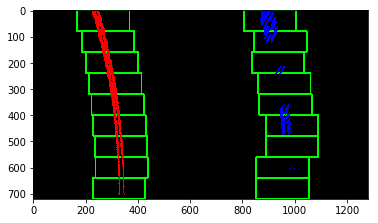

In [22]:
test_img = test_warped_imgs[1]

lane_pixel_img = detectLanePixels(test_img, stats=False)[4]

plt.imshow(lane_pixel_img)
plt.show()

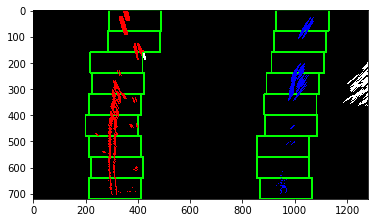

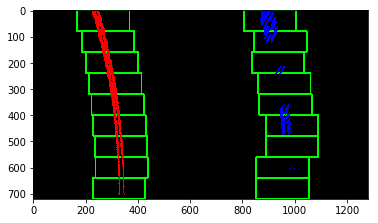

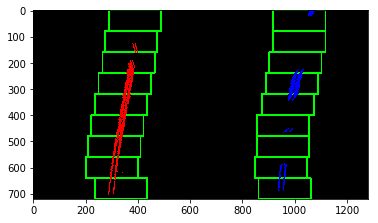

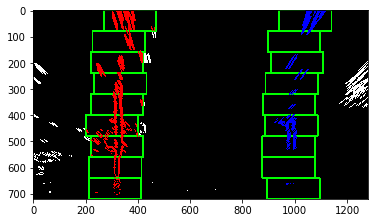

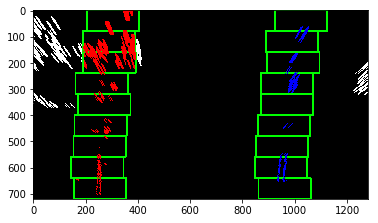

In [23]:
# Apply on all test images
for i in range(5):
    test_img = test_warped_imgs[i]

    lane_pixel_img = detectLanePixels(test_img, stats=False)[4]

    plt.imshow(lane_pixel_img)
    plt.show()

In [24]:
def fit_polynomial_toLane(image, xm_ym_per_pix = (3.7/700, 30/720), plot_poly=True):
    
    # fit a polynomial into the detected pixels so far
    test_img = test_warped_imgs[5]
    leftx, lefty, rightx, righty, lanePixel_im = detectLanePixels(image, stats=False)

    # fitting into a 2nd order polynomial x = f(y)
    #leftfit = np.polyfit( lefty*xm_ym_per_pix[1], leftx*xm_ym_per_pix[0], 2 )
    #rightfit = np.polyfit( righty*xm_ym_per_pix[1], rightx*xm_ym_per_pix[0], 2)

    leftfit = np.polyfit( lefty, leftx, 2 )
    rightfit = np.polyfit( righty, rightx, 2)
    #print("leftfit", leftfit, "rightfit", rightfit)
    # Use the fitting parameters to plot the polynomial on the image
    ## generate y axis base 
    ploty = np.linspace(0, image.shape[0]-1, image.shape[0]).astype(int)
    #ploty = ploty*xm_ym_per_pix[1]
    
    ## compute leftx = f_left(y) & rightx = f_right(y)
    plot_leftx = ( leftfit[0]*ploty**2 + leftfit[1]*ploty + leftfit[2] ).astype(int)
    plot_rightx = ( rightfit[0]*ploty**2 + rightfit[1]*ploty + rightfit[2] ).astype(int)
    
    # plot left and right fitting on lanePixel_im
    #if plot_poly == True:
    #plt.plot( plot_leftx, ploty, color='yellow' )
    #plt.plot( plot_rightx, ploty, color='yellow')
    
    #print(ploty)
    #print(plot_rightx)
    for paint in range(-5,5):
        try:
            lanePixel_im[ ploty, plot_leftx+paint] = [255, 0, 0] # will be painting only a single pixel per y value => not very visible
            lanePixel_im[ ploty, plot_rightx+paint] = [255, 0, 0]
        except:
            break
    #return leftfit, rightfit, lanePixel_im
    return leftfit, rightfit, lanePixel_im

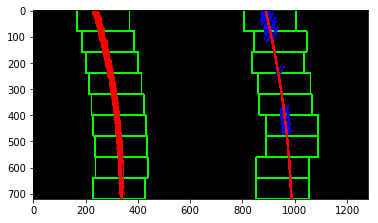

In [25]:
# Run on a single test image
test_img = test_warped_imgs[1]

out_img = fit_polynomial_toLane(test_img)[2]
plt.imshow(out_img)
plt.show()


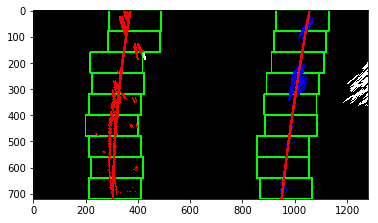

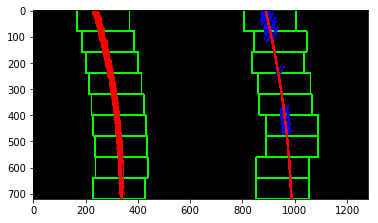

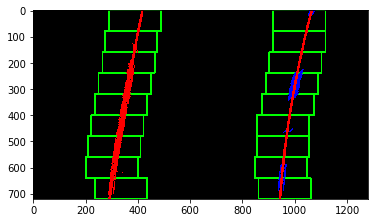

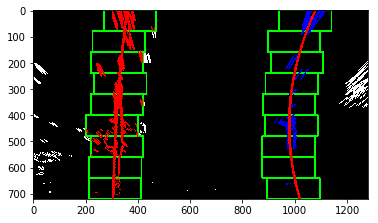

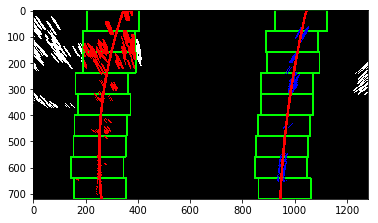

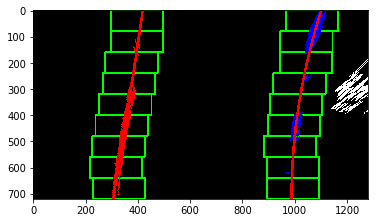

In [26]:
# Let's run on all 6 images
for i in range(6):
    
    current_test_img = test_warped_imgs[i]

    current_out_img = fit_polynomial_toLane(current_test_img)[2]
        
    plt.imshow(current_out_img)
    cv2.imwrite("output_images/polyfit"+str(i)+".jpg", current_out_img)
    plt.show()




#### Once the lane lines are found, skip the sliding window step and perfrom a check around the lane from the last frame

#### Compute curvature of the fitted polynomial

(-2399.839279967828, -3635.939618807656)


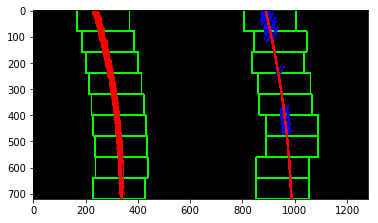

In [27]:
def compute_lane_curvature(test_im):
    
    # introducing the conversion from pixel world to real scale meter world
    xm_per_pix = 3.7/700 # a rigourous reason should be given here?
    ym_per_pix = 30/720
    
    left_fit, right_fit, polyfit_im = fit_polynomial_toLane(test_im, (xm_per_pix,ym_per_pix), plot_poly=True)
    plt.imshow(polyfit_im)

    ploty = np.linspace(0, test_im.shape[0]-1, test_im.shape[0])

    # Select the point where the curvature is calculated
    y_eval = np.max(ploty)

    a_l = left_fit[0]
    b_l = left_fit[1]
    a_r = right_fit[0]
    b_r = right_fit[1]

    # compute left and right curvature using formula from class material
    left_curverad = np.power(1 + (2*a_l*y_eval+b_l)**2, 3/2)/(2*a_l)  
    right_curverad = np.power(1 + (2*a_r*y_eval+b_r)**2, 3/2)/(2*a_r) 

    #print("left_lane_curvature", left_curverad, "right_lane_curvature", right_curverad)
    return left_curverad, right_curverad


test_img = test_warped_imgs[1]
print( compute_lane_curvature( test_img ) )

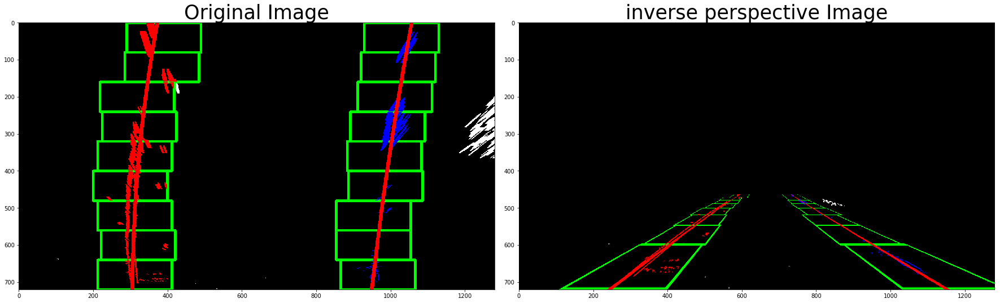

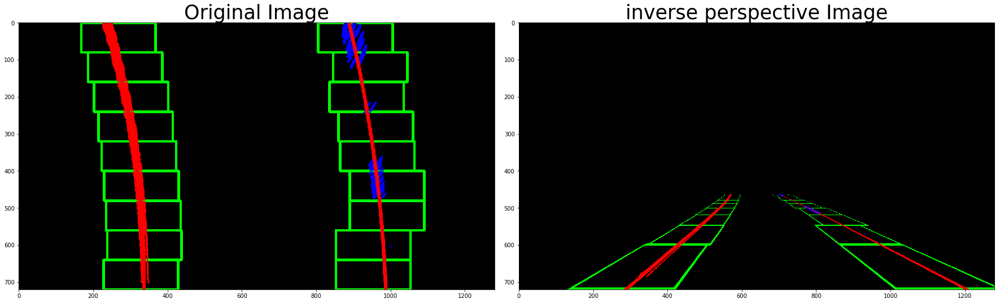

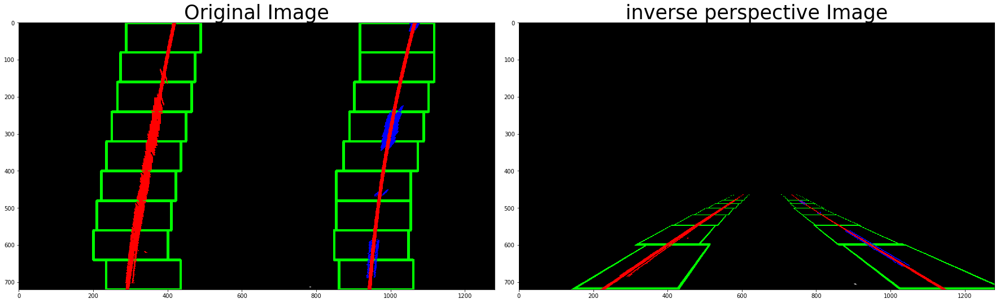

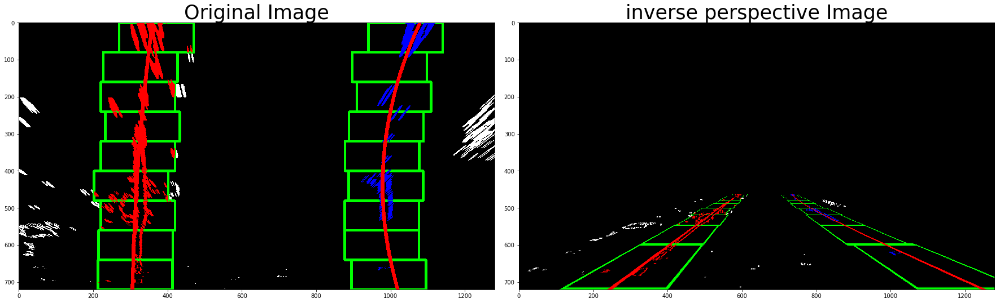

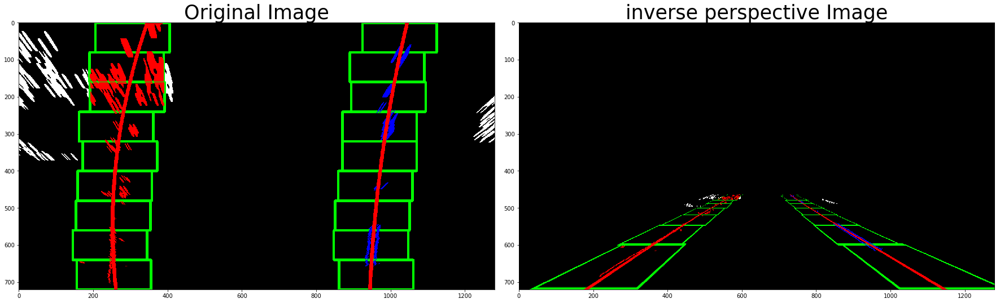

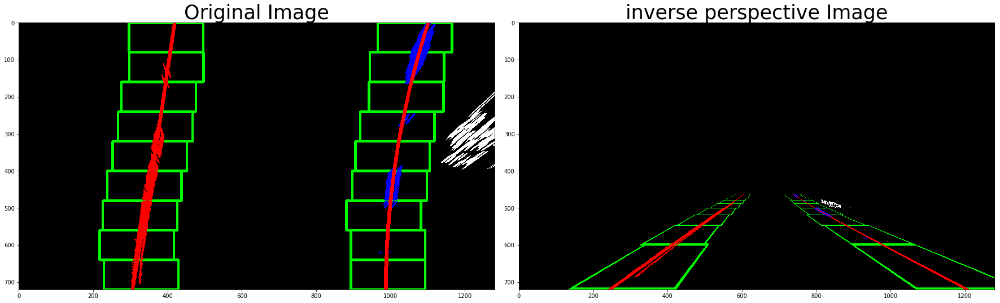

In [28]:
# perspective transform inverse

# generate perspective transofrmation matrix given source and destination points
Minv = cv2.getPerspectiveTransform(dst, src)

warped_imgs = [] # inversed perspective images

for i in range (6):
    test_img = test_warped_imgs[i]
    lane_pixel_img = fit_polynomial_toLane(test_img)[2]

    # perform perspective transformation
    warped = cv2.warpPerspective(lane_pixel_img, Minv, img_size, flags=cv2.INTER_LINEAR)
    warped_imgs += [warped]
    
    PlotComparisonView(lane_pixel_img, warped, 'inverse perspective', colormap = (None, None))

    #plt.imshow(warped)
    #plt.show()

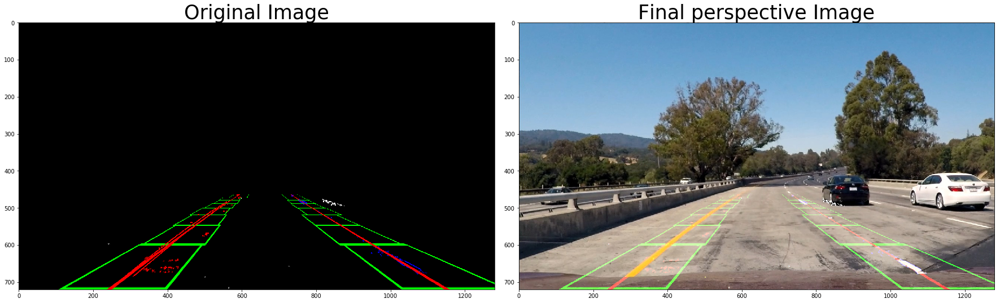

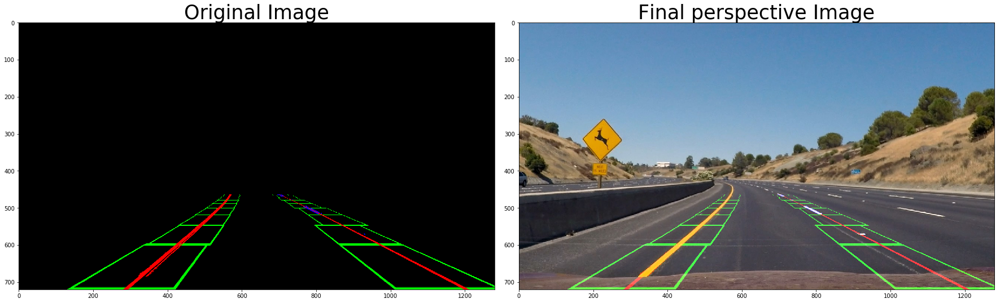

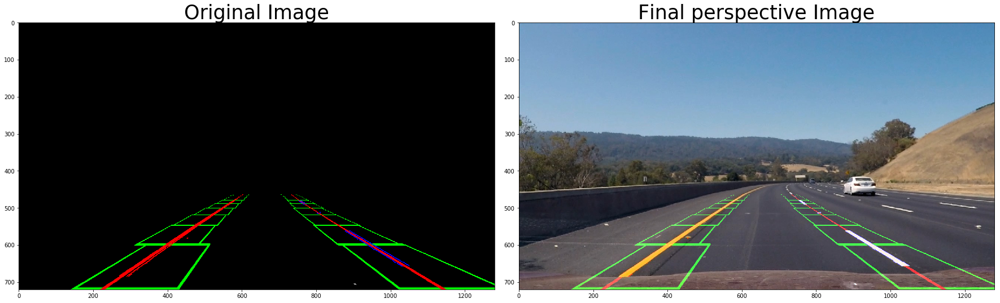

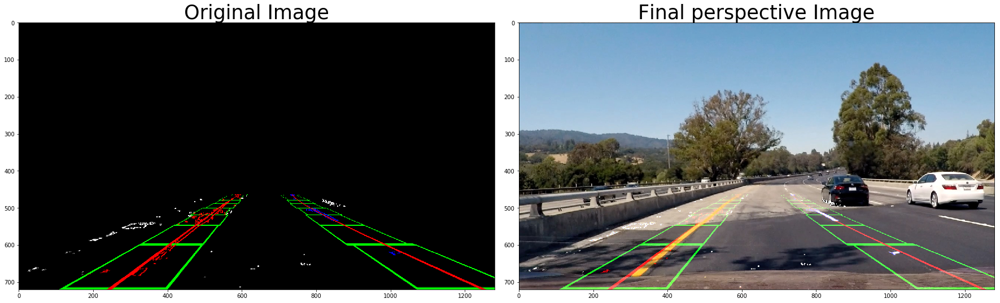

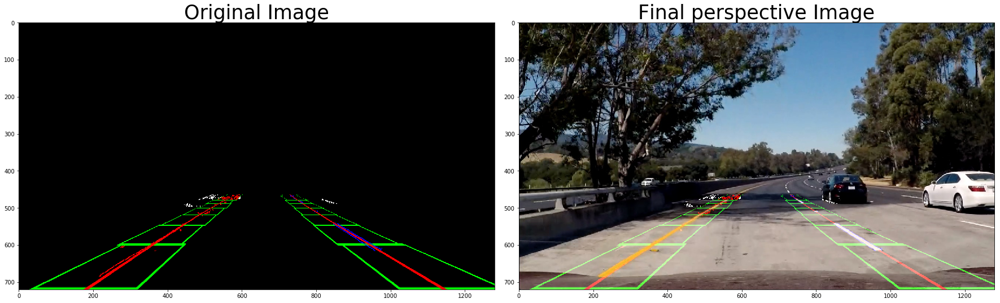

In [29]:
combined_imgs = []

for i in range(5):
    
    warped = warped_imgs[i]

    img = mpimg.imread(test_images[i])

    combined_img = warped | img
    combined_imgs += [combined_img]

    PlotComparisonView(warped, combined_img, 'Final perspective', colormap = (None, None))
    cv2.imwrite("output_images/finalPerspective"+str(i)+".jpg", cv2.cvtColor(combined_img, cv2.COLOR_RGB2BGR))


In [61]:
def advancedLaneFindingPipeline(input_img):
    
    # undistort input image
    undistort_img = cal_undistort(input_img, objpoints, imgpoints)

    # create a binary from HLS color space
    hls_binary = to_HLS_Color_Channel(undistort_img)
    
    # create a binary using axis, magnitude and direction gradient on hls_binary
    combined_threshold = combinedGradient_thresholdedBinary(hls_binary)
    
    # perform perspective transform to bird-eye view
    warped_img = cv2.warpPerspective(combined_threshold, M, img_size, flags=cv2.INTER_LINEAR)
    
    # detect lane pixel on bird-eye view image and generate fitting polynomial
    lane_pixel_img = fit_polynomial_toLane(warped_img)[2]
    current_fit = fit_polynomial_toLane(warped_img)[:2]
    print(current_fit)

    # perform inverse perspective transformation from bird-eye view
    unwarped_img = cv2.warpPerspective(lane_pixel_img, Minv, img_size, flags=cv2.INTER_LINEAR)
    
    # draw result on input_img
    finalresult_img = unwarped_img | input_img
    PlotComparisonView(unwarped_img, finalresult_img, 'Final perspective', colormap = (None, None))
    
    # save result into output_images folder
    #cv2.imwrite("output_images/finalPerspective"+str(i)+".jpg", cv2.cvtColor(combined_img, cv2.COLOR_RGB2BGR))
    
    return finalresult_img


(array([ 6.18629678e-05, -2.22803581e-01,  4.22955832e+02]), array([ 1.27099636e-04, -2.64287294e-01,  1.06585834e+03]))


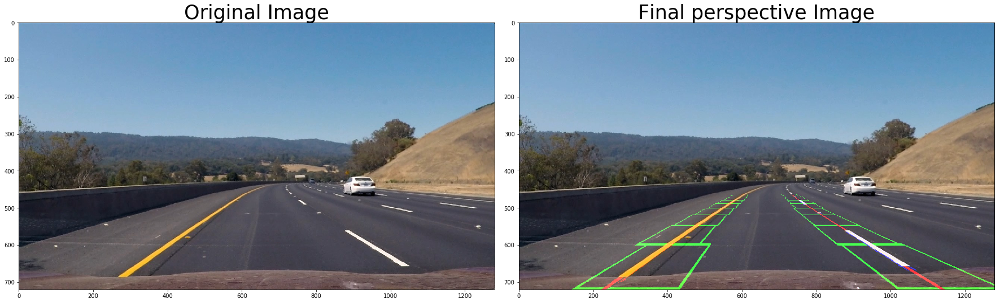

In [31]:
# test full pipeline on a single image
my_img = mpimg.imread(test_images[2])

final = advancedLaneFindingPipeline(my_img)
PlotComparisonView(my_img, final, 'Final perspective', colormap = (None, None))

In [32]:
for i in range(6):
    
    my_img = mpimg.imread(test_images[i])
    final = advancedLaneFindingPipeline(my_img)

(array([ 1.44483407e-04, -1.85988807e-01,  3.67378032e+02]), array([ 7.86749197e-05, -2.05128931e-01,  1.05672169e+03]))
(array([-2.07508988e-04,  2.89371359e-01,  2.37119575e+02]), array([-3.85815184e-05,  1.83403975e-01,  8.90526832e+02]))
(array([ 6.18629678e-05, -2.22803581e-01,  4.22955832e+02]), array([ 1.27099636e-04, -2.64287294e-01,  1.06585834e+03]))
(array([ 6.86260490e-05, -1.16409990e-01,  3.58811198e+02]), array([ 4.40502225e-04, -4.17506412e-01,  1.07814802e+03]))
(array([ 3.75879036e-04, -4.24751961e-01,  3.72873739e+02]), array([ 8.86968426e-05, -2.10078059e-01,  1.04409158e+03]))
(array([ 1.27110106e-04, -2.87349842e-01,  4.54707032e+02]), array([ 2.92852926e-04, -3.57884806e-01,  1.10379368e+03]))


## First, Let's try this pipeline on  the initial video stream as naive "independant" images

In [33]:
# Import everything needed to edit/save/watch video clips
from moviepy.editor import VideoFileClip
from IPython.display import HTML

In [34]:
def process_image(image):
    # NOTE: The output you return should be a color image (3 channel) for processing video below
    # TODO: put your pipeline here,
    result = advancedLaneFindingPipeline(image)
    # you should return the final output (image where lines are drawn on lanes)

    return result

In [59]:
video_output = 'output_videos/project_video_solution7.mp4'
## To speed up the testing process you may want to try your pipeline on a shorter subclip of the video
## To do so add .subclip(start_second,end_second) to the end of the line below
## Where start_second and end_second are integer values representing the start and end of the subclip
## You may also uncomment the following line for a subclip of the first 5 seconds
clip1 = VideoFileClip("harder_challenge_video.mp4").subclip(0, 0.4)
print(type(clip1))
#clip1 = VideoFileClip("project_video.mp4")

white_clip = clip1.fl_image(process_image) #NOTE: this function expects color images!!
%time white_clip.write_videofile(video_output, audio=False)

<class 'moviepy.video.io.VideoFileClip.VideoFileClip'>
False
--> Using Sliding Windows Approach <--
Curvature radius Real World - Left => 317.1030770978045 m - Right 266.31303525237365 m
Top ---> 18899 Middle ---> 18843 Bottom ---> 18113
left_fit_coefs [-2.14644250e-04  3.24296480e-01  2.20248142e+02] right_fit_coefs [1.26409641e-04 1.15003369e-01 8.80013443e+02]
y_eval -->  719.0
Left_curvature 2330.2903431430236 Right_curvature 4489.316504861725 sanity False
Moviepy - Building video output_videos/project_video_solution7.mp4.
Moviepy - Writing video output_videos/project_video_solution7.mp4



t:   0%|                                                                              | 0/10 [00:00<?, ?it/s, now=None]

False
--> Using Sliding Windows Approach <--
Curvature radius Real World - Left => 317.1030770978045 m - Right 266.31303525237365 m
Top ---> 18899 Middle ---> 18843 Bottom ---> 18113
left_fit_coefs [-2.14644250e-04  3.24296480e-01  2.20248142e+02] right_fit_coefs [1.26409641e-04 1.15003369e-01 8.80013443e+02]
y_eval -->  719.0
Left_curvature 2330.2903431430236 Right_curvature 4489.316504861725 sanity False


t:  20%|██████████████                                                        | 2/10 [00:01<00:07,  1.08it/s, now=None]

False
--> Using Sliding Windows Approach <--
Curvature radius Real World - Left => 338.1456026425378 m - Right 298.37108808843135 m
Top ---> 19918 Middle ---> 19335 Bottom ---> 18358
left_fit_coefs [-2.14644250e-04  3.24296480e-01  2.20248142e+02] right_fit_coefs [1.26409641e-04 1.15003369e-01 8.80013443e+02]
y_eval -->  719.0
Left_curvature 2330.2903431430236 Right_curvature 4489.316504861725 sanity False


t:  30%|█████████████████████                                                 | 3/10 [00:03<00:08,  1.18s/it, now=None]

False
--> Using Sliding Windows Approach <--
Curvature radius Real World - Left => 363.0949161952883 m - Right 307.46587429750383 m
Top ---> 20379 Middle ---> 19609 Bottom ---> 18339
---> Distance between lines is not consistent <---
left_fit_coefs [-2.14644250e-04  3.24296480e-01  2.20248142e+02] right_fit_coefs [1.26409641e-04 1.15003369e-01 8.80013443e+02]
y_eval -->  719.0
Left_curvature 2330.2903431430236 Right_curvature 4489.316504861725 sanity False


t:  40%|████████████████████████████                                          | 4/10 [00:05<00:07,  1.31s/it, now=None]

False
--> Using Sliding Windows Approach <--
Curvature radius Real World - Left => 379.6704562245914 m - Right 296.3053246648699 m
Top ---> 20432 Middle ---> 19735 Bottom ---> 18262
---> Distance between lines is not consistent <---
left_fit_coefs [-2.14644250e-04  3.24296480e-01  2.20248142e+02] right_fit_coefs [1.26409641e-04 1.15003369e-01 8.80013443e+02]
y_eval -->  719.0
Left_curvature 2330.2903431430236 Right_curvature 4489.316504861725 sanity False


t:  50%|███████████████████████████████████                                   | 5/10 [00:06<00:07,  1.41s/it, now=None]

False
--> Using Sliding Windows Approach <--
Curvature radius Real World - Left => 389.417426882718 m - Right 290.8631669720162 m
Top ---> 20375 Middle ---> 19799 Bottom ---> 18295
---> Distance between lines is not consistent <---
left_fit_coefs [-2.14644250e-04  3.24296480e-01  2.20248142e+02] right_fit_coefs [1.26409641e-04 1.15003369e-01 8.80013443e+02]
y_eval -->  719.0
Left_curvature 2330.2903431430236 Right_curvature 4489.316504861725 sanity False


t:  60%|██████████████████████████████████████████                            | 6/10 [00:08<00:05,  1.46s/it, now=None]

False
--> Using Sliding Windows Approach <--
Curvature radius Real World - Left => 392.5623508600308 m - Right 279.8884434750117 m
Top ---> 20366 Middle ---> 19837 Bottom ---> 18201
---> Distance between lines is not consistent <---
left_fit_coefs [-2.14644250e-04  3.24296480e-01  2.20248142e+02] right_fit_coefs [1.26409641e-04 1.15003369e-01 8.80013443e+02]
y_eval -->  719.0
Left_curvature 2330.2903431430236 Right_curvature 4489.316504861725 sanity False


t:  70%|█████████████████████████████████████████████████                     | 7/10 [00:10<00:04,  1.50s/it, now=None]

False
--> Using Sliding Windows Approach <--
Curvature radius Real World - Left => 360.23518002294037 m - Right 260.53742294534305 m
Top ---> 20112 Middle ---> 19688 Bottom ---> 18106
---> Distance between lines is not consistent <---
left_fit_coefs [-2.14644250e-04  3.24296480e-01  2.20248142e+02] right_fit_coefs [1.26409641e-04 1.15003369e-01 8.80013443e+02]
y_eval -->  719.0
Left_curvature 2330.2903431430236 Right_curvature 4489.316504861725 sanity False


t:  80%|████████████████████████████████████████████████████████              | 8/10 [00:11<00:03,  1.55s/it, now=None]

False
--> Using Sliding Windows Approach <--
Curvature radius Real World - Left => 312.0513372644535 m - Right 270.3997304496602 m
Top ---> 19671 Middle ---> 19142 Bottom ---> 18082
left_fit_coefs [-2.14644250e-04  3.24296480e-01  2.20248142e+02] right_fit_coefs [1.26409641e-04 1.15003369e-01 8.80013443e+02]
y_eval -->  719.0
Left_curvature 2330.2903431430236 Right_curvature 4489.316504861725 sanity False


t:  90%|███████████████████████████████████████████████████████████████       | 9/10 [00:13<00:01,  1.56s/it, now=None]

False
--> Using Sliding Windows Approach <--
Curvature radius Real World - Left => 305.7930307480999 m - Right 647.2124552864649 m
Top ---> 20130 Middle ---> 18480 Bottom ---> 18885
left_fit_coefs [-2.14644250e-04  3.24296480e-01  2.20248142e+02] right_fit_coefs [1.26409641e-04 1.15003369e-01 8.80013443e+02]
y_eval -->  719.0
Left_curvature 2330.2903431430236 Right_curvature 4489.316504861725 sanity False


t: 100%|█████████████████████████████████████████████████████████████████████| 10/10 [00:14<00:00,  1.56s/it, now=None]

False
--> Using Sliding Windows Approach <--
Curvature radius Real World - Left => 261.9195606416705 m - Right 414.6229300285071 m
Top ---> 19778 Middle ---> 18412 Bottom ---> 18709
left_fit_coefs [-2.14644250e-04  3.24296480e-01  2.20248142e+02] right_fit_coefs [1.26409641e-04 1.15003369e-01 8.80013443e+02]
y_eval -->  719.0
Left_curvature 2330.2903431430236 Right_curvature 4489.316504861725 sanity False


Moviepy - Done !
Moviepy - video ready output_videos/project_video_solution7.mp4
Wall time: 17.1 s


In [60]:
HTML("""
<video width="960" height="540" controls>
  <source src="{0}">
</video>
""".format(video_output))

### Let's skip the sliding windows step once I've found the lines
* In brief the guidline is : Once you know where the lines are in one frame of video, you can do a highly targeted search for them in the next frame.

In [49]:
# Define a class to receive the characteristics of each line detection
class Line():
    def __init__(self):
        # was the line detected in the last iteration?
        self.detected = False  
        # x values of the last n fits of the line
        self.recent_xfitted = [] 
        #average x values of the fitted line over the last n iterations
        self.bestx = None     
        #polynomial coefficients averaged over the last n iterations
        self.best_fit = None  
        #polynomial coefficients for the most recent fit
        self.current_fit = [np.array([False])]
        #polynomial coefficients for the most recent fits
        self.recent_fits = [np.array([False])]  
        #radius of curvature of the line in some units
        self.radius_of_curvature = None 
        #radius of curvature Array of the line in some units
        self.radius_of_curvature_array = [np.array([])] 
        #distance in meters of vehicle center from the line
        self.line_base_pos = None 
        #difference in fit coefficients between last and new fits
        self.diffs = np.array([0,0,0], dtype='float') 
        #x values for detected line pixels
        self.allx = None  
        #y values for detected line pixels
        self.ally = None  

        
# Create two instances from this class
left_line = Line()
right_line = Line()

In [38]:
# Turns out most the change will be in detectLanePixels function and in the way left_lane_inds & right_lane_inds are calculated

def detectLanePixels(test_im, last_fit, stats=True):
    """
    This function returns the positions of activated pixels in left and right lanes
    and the output image with those pixels painted
    """
    
    # HYPERPARAMETERS
    # Choose the number of sliding windows
    nwindows = 9
    # Set the width of the windows +/- margin
    margin = 100
    # Set minimum number of pixels found to recenter window
    minpix = 50
    
    # Make sure image values are in [0, 255] interval
    if np.max(test_im) == 1:
        test_im = np.uint8(255*test_im)
    
    # Create a histogram for the second half of the image
    histogram = hist(test_im)

    # Create output image to draw on and visualize result
    out_img = np.dstack((test_im, test_im, test_im))

    # peak of left and right part of the histogram are starting points of left and right lanes
    midpoint = np.int(histogram.shape[0]//2)
    leftxbase = np.argmax(histogram[:midpoint])
    rightxbase = np.argmax(histogram[midpoint:]) + midpoint

    # Identify the x and y positions of all nonzero pixels in the image
    nonzero = test_im.nonzero() # nonzero is a 2-elements tuple
    nonzeroy = np.array(nonzero[0]) # first element is an array of y coordinates of non-zero pixels
    nonzerox = np.array(nonzero[1]) # second element is an array of x coordinates of non-zero pixels

    # Current positions to be updated later for each window in nwindows
    leftx_current = leftxbase
    rightx_current = rightxbase
    
    
    if last_fit == False: # use sliding windows approach
        print("--> Using Sliding Windows Approach <--")
        # Create empty lists to receive left and right lane pixel indices
        left_lane_inds = []
        right_lane_inds = []

        # This list is only for a general stat purpose
        activatedPixels_perWindow = []

        # Step through the windows one by one
        for window in range(nwindows):
            # Identify window boundaries in x and y (and right and left)
            win_y_low = test_im.shape[0] - (window+1)*window_height
            win_y_high = test_im.shape[0] - window*window_height

            #Find the four boundaries of the left & right windows on x axis 
            win_xleft_low = leftx_current - margin  
            win_xleft_high = leftx_current + margin 
            win_xright_low = rightx_current - margin  
            win_xright_high = rightx_current + margin

            #Identify the nonzero pixels in x and y within the window
            left_nonzero_pixels = ( (nonzerox > win_xleft_low) & (nonzerox < win_xleft_high)
                                   & (nonzeroy > win_y_low) & (nonzeroy < win_y_high) ).nonzero()[0]

            right_nonzero_pixels = ( (nonzerox > win_xright_low) & (nonzerox < win_xright_high)
                                   & (nonzeroy > win_y_low) & (nonzeroy < win_y_high) ).nonzero()[0]

            #print(len(left_nonzero_pixels), len(right_nonzero_pixels)) # How many non zero pixels indices are on 
                                                                       # the left & right line in current window
            activatedPixels_perWindow.insert(0,[len(left_nonzero_pixels), len(right_nonzero_pixels)])    

            # add the result to the one from previous windows
            left_lane_inds.append(left_nonzero_pixels) 
            right_lane_inds.append(right_nonzero_pixels) 

            # Draw the windows on the visualization image
            cv2.rectangle(out_img,(win_xleft_low,win_y_low), (win_xleft_high,win_y_high),(0,255,0), 5) 
            cv2.rectangle(out_img,(win_xright_low,win_y_low),(win_xright_high,win_y_high),(0,255,0), 5)

            # recalculating the base x-coordinates of left and right windows
            if (len(left_nonzero_pixels) > minpix):
                # Position of activated pixels in current left window
                leftx_pixelpos_current = nonzerox[left_nonzero_pixels]
                leftx_current = np.int(np.mean( leftx_pixelpos_current, axis=0) )
                #print("new left base is ==>", leftx_current)

            if ( len( right_nonzero_pixels ) > minpix):
                # Position of activated pixels in current right window
                rightx_pixelpos_current = nonzerox[right_nonzero_pixels]
                rightx_current = np.int(np.mean( rightx_pixelpos_current, axis=0) )
                #print("new right base is ==>", rightx_current)

        # reorganise indices across all windows
        left_lane_inds = np.concatenate( left_lane_inds )
        right_lane_inds = np.concatenate( right_lane_inds )
        
    
    elif last_fit == True: # Use info from previous frames
        print("--> Searching Around previous PolyFits Approach <--")

        margin = 100
        
        # Get left_fit and right_fit of last frame lines instances
        last_left_fit = left_line.best_fit
        last_right_fit = right_line.best_fit

        # Create  lists to receive left and right lane pixel indices by exploring the region next to where
        # last lanes polyfit were found
        left_lane_inds = ( (nonzerox > (last_left_fit[0]*(nonzeroy**2) + last_left_fit[1]*nonzeroy + 
                        last_left_fit[2] - margin) ) & (nonzerox < (last_left_fit[0]*(nonzeroy**2) + 
                        last_left_fit[1]*nonzeroy + last_left_fit[2] + margin)))

        right_lane_inds = ((nonzerox > (last_right_fit[0]*(nonzeroy**2) + last_right_fit[1]*nonzeroy + 
                        last_right_fit[2] - margin)) & (nonzerox < (last_right_fit[0]*(nonzeroy**2) + 
                        last_right_fit[1]*nonzeroy + last_right_fit[2] + margin)))


    

    # get pixel position from pixel indices
    leftx_pos = nonzerox[left_lane_inds]
    lefty_pos = nonzeroy[left_lane_inds]
    rightx_pos = nonzerox[right_lane_inds]
    righty_pos = nonzeroy[right_lane_inds]

    out_img[ lefty_pos, leftx_pos] = [255, 0, 0]
    out_img[ righty_pos, rightx_pos] = [0, 0, 255]
    
    if stats == True:
        print("leftxbase : ", leftxbase, 'rightxbase : ', rightxbase)
        print("Number of non zero pixels are in the whole image", nonzero[0].shape) #how many non zero pixels are in the whole image
        print("Number of non zero pixels indices on the left lane", left_lane_inds.shape) # how many non zero pixels indices are on the left line
        print("Number of non zero pixels indices on the right lane", right_lane_inds.shape) # how many non zero pixels indices are on the right line
        print("Number of activated pixels per window", np.array(activatedPixels_perWindow) )

    return leftx_pos, lefty_pos, rightx_pos, righty_pos, out_img


In [48]:
def fit_polynomial_toLane(image, last_fit, xm_ym_per_pix = (3.7/700, 30/720), plot_poly=True):
    
    # fit a polynomial into the detected pixels so far
    test_img = test_warped_imgs[5]
    leftx, lefty, rightx, righty, lanePixel_im = detectLanePixels(image, last_fit, stats=False)

    # fitting into a 2nd order polynomial x = f(y)
    #leftfit = np.polyfit( lefty*xm_ym_per_pix[1], leftx*xm_ym_per_pix[0], 2 )
    #rightfit = np.polyfit( righty*xm_ym_per_pix[1], rightx*xm_ym_per_pix[0], 2)

    leftfit = np.polyfit( lefty, leftx, 2 )
    rightfit = np.polyfit( righty, rightx, 2)
    #print("leftfit", leftfit, "rightfit", rightfit)
    # Use the fitting parameters to plot the polynomial on the image
    ## generate y axis base
    width = image.shape[1]
    height = image.shape[0]
    
    ploty = np.linspace(0, height-1, height).astype(int)
    #ploty = ploty*xm_ym_per_pix[1]
    
    ## compute leftx = f_left(y) & rightx = f_right(y)
    plot_leftx = ( leftfit[0]*ploty**2 + leftfit[1]*ploty + leftfit[2] ).astype(int)
    plot_rightx = ( rightfit[0]*ploty**2 + rightfit[1]*ploty + rightfit[2] ).astype(int)
    
    # plot left and right fitting on lanePixel_im
    #if plot_poly == True:
    #plt.plot( plot_leftx, ploty, color='yellow' )
    #plt.plot( plot_rightx, ploty, color='yellow')
    
    #print(ploty)
    #print(plot_rightx)
    for paint in range(-5,5):
        try:
            lanePixel_im[ ploty, plot_leftx+paint] = [255, 0, 0] # will be painting only a single pixel per y value => not very visible
            lanePixel_im[ ploty, plot_rightx+paint] = [255, 0, 0]
        except:
            break
            
    # fit poly in real world space
    y_eval = np.max(ploty)
    xm_per_pix = xm_ym_per_pix[0]
    ym_per_pix = xm_ym_per_pix[1]
    
    leftfit_rw = np.polyfit( lefty*ym_per_pix, leftx*xm_per_pix, 2 )
    rightfit_rw = np.polyfit( righty*ym_per_pix, rightx*xm_per_pix, 2) 
    
    # Calculation of R_curve (radius of curvature)
    left_curverad = ((1 + (2*leftfit_rw[0]*y_eval*ym_per_pix + leftfit_rw[1])**2)**1.5) / np.absolute(2*leftfit_rw[0])
    right_curverad = ((1 + (2*rightfit_rw[0]*y_eval*ym_per_pix + rightfit_rw[1])**2)**1.5) / np.absolute(2*rightfit_rw[0])
    
    left_line.radius_of_curvature_array.append(left_curverad)
    right_line.radius_of_curvature_array.append(right_curverad)
    
    print("Curvature radius Real World - Left =>", left_curverad, "m - Right", right_curverad, "m")
    ########## Sanity Check ############
    
    ## small curvature radius
    sanity = True
    if left_curverad < 500 or right_curverad < 500:
        leftfit = left_line.best_fit
        rightfit = right_line.best_fit
        sanity = False
    
    ## Inconsistent distance between the two lanes across the heigth of the road
    LinesDiff = plot_rightx - plot_leftx
    NbPointsPerSegment = 30
    
    top = sum( LinesDiff[ :NbPointsPerSegment ] )
    middle = sum( LinesDiff[ height//2:height//2 + NbPointsPerSegment] )
    bottom = sum( LinesDiff[ -NbPointsPerSegment:] )
    
    print("Top --->", top, "Middle --->", middle, "Bottom --->", bottom )
    
    if abs( top - middle ) > 1800 or abs( top - bottom ) > 1800 or abs( middle - bottom ) > 1800:
        print( "---> Distance between lines is not consistent <---")
        leftfit = left_line.best_fit
        rightfit = right_line.best_fit
        left_line.detected = False
        right_line.detected = False
        sanity = False

    #print(  ( leftfit_rw[0]*(ploty*ym_per_pix)**2 + leftfit_rw[1]*ploty*ym_per_pix + leftfit_rw[2] )  )
    return leftfit, rightfit, lanePixel_im, sanity

In [63]:
def advancedLaneFindingPipeline(input_img):
    
    # undistort input image
    undistort_img = cal_undistort(input_img, objpoints, imgpoints)

    # create a binary from HLS color space
    hls_binary = to_HLS_Color_Channel(undistort_img)
    
    # create a binary using axis, magnitude and direction gradient on hls_binary
    combined_threshold = combinedGradient_thresholdedBinary(hls_binary)
    
    # perform perspective transform to bird-eye view
    warped_img = cv2.warpPerspective(combined_threshold, M, img_size, flags=cv2.INTER_LINEAR)
    
    # detect lane pixel on bird-eye view image and generate fitting polynomial
    #if left_line.detected == True and right_line.detected == True:
    
    last_fit = left_line.detected & right_line.detected
    print(last_fit)
    current_left_fit, current_right_fit, lane_pixel_img, sanity = fit_polynomial_toLane(warped_img, last_fit, plot_poly=False)
    # storing the recent fits of the polymomial
    left_line.recent_fits.append( current_left_fit )
    right_line.recent_fits.append( current_right_fit )
    
    left_line.best_fit = current_left_fit
    right_line.best_fit = current_right_fit
    
    left_line.detected = False
    right_line.detected = False

    print("left_fit_coefs", current_left_fit, "right_fit_coefs", current_right_fit)
    
    ############ Curvature Radius ##############
    
    # ploty = np.linspace(0, test_im.shape[0]-1, test_im.shape[0])
    ploty = np.linspace(0, image.shape[0]-1, image.shape[0])#.astype(int)

    # Select the point where the curvature is calculated
    y_eval = np.max(ploty)
    print("y_eval --> ", y_eval)

    a_l = current_left_fit[0]
    b_l = current_left_fit[1]
    a_r = current_right_fit[0]
    b_r = current_right_fit[1]

    # compute left and right curvature radius using formula from class material
    left_curvature = ( ( 1 + ( 2*a_l*y_eval + b_l )**2 )**1.5 )/np.absolute( 2*a_l )  
    right_curvature = ( ( 1 + ( 2*a_r*y_eval + b_r )**2 )**1.5 )/np.absolute( 2*a_r )
    
    print("Left_curvature", left_curvature, "Right_curvature", right_curvature, "sanity", sanity)

    #####################################

    ############ Drawing ################
    # Create an image to draw the lines on
    warp_zero = np.zeros_like(warped_img).astype(np.uint8)
    color_warp = np.dstack((warp_zero, warp_zero, warp_zero))
    
    # Recast the x and y points into usable format for cv2.fillPoly()
    ## temp ##
    left_fitx = ( current_left_fit[0]*ploty**2 + current_left_fit[1]*ploty + current_left_fit[2] ).astype(int)
    right_fitx = ( current_right_fit[0]*ploty**2 + current_right_fit[1]*ploty + current_right_fit[2] ).astype(int)
    ## temp ##
    pts_left = np.array([np.transpose(np.vstack([left_fitx, ploty]))])
    pts_right = np.array([np.flipud(np.transpose(np.vstack([right_fitx, ploty])))])
    pts = np.hstack((pts_left, pts_right))

    # Draw the lane onto the warped blank image
    cv2.fillPoly(color_warp, np.int_([pts]), (0,255, 0))
    
    
    # Warp the blank back to original image space using inverse perspective matrix (Minv)
    newwarp = cv2.warpPerspective(color_warp, Minv, (image.shape[1], image.shape[0])) 
    # Combine the result with the original image
    finalresult_img = cv2.addWeighted(input_img, 1, newwarp, 0.3, 0)
    
    #plt.imshow(result)
    #######################################
    
    # Perform inverse perspective transformation from bird's eye view
    #unwarped_img = cv2.warpPerspective(lane_pixel_img, Minv, img_size, flags=cv2.INTER_LINEAR)
    
    # draw result on input_img
    #finalresult_img = unwarped_img | input_img
    PlotComparisonView(lane_pixel_img, finalresult_img, 'Final perspective', colormap = (None, None))
    
    # save result into output_images folder
    #cv2.imwrite("output_images/finalPerspective"+str(i)+".jpg", cv2.cvtColor(combined_img, cv2.COLOR_RGB2BGR))
    
    return finalresult_img


In [41]:
def process_image(image):
    # NOTE: The output you return should be a color image (3 channel) for processing video below
    # TODO: put your pipeline here,
    result = advancedLaneFindingPipeline(image)
    # you should return the final output (image where lines are drawn on lanes)

    return result

In [52]:
# Let's play a bit more with the way I am handling video files
video_output = 'output_videos/project_video_solution19.mp4'
## To speed up the testing process you may want to try your pipeline on a shorter subclip of the video
## To do so add .subclip(start_second,end_second) to the end of the line below
## Where start_second and end_second are integer values representing the start and end of the subclip
## You may also uncomment the following line for a subclip of the first 5 seconds
clipLength = 0.4
clip1 = VideoFileClip("project_video.mp4").subclip(21.6, 22.2)
clip1 = VideoFileClip("project_video.mp4")#.subclip(21, 25)

# number of frames in clip iterator
#N = sum( 1 for f in clip1.iter_frames() )
#print("N =>", N)


white_clip = clip1.fl_image(process_image) #NOTE: this function expects color images!!
%time white_clip.write_videofile(video_output, audio=False)

False
--> Using Sliding Windows Approach <--
Curvature radius Real World - Left => 870.7296470594531 m - Right 4693.69592320204 m
Top ---> 20069 Middle ---> 19342 Bottom ---> 19738
left_fit_coefs [-1.88608172e-04  2.71122790e-01  2.38338530e+02] right_fit_coefs [-3.49962672e-05  1.44431976e-01  9.09043012e+02]
y_eval -->  719.0
Left_curvature 2650.9986413254037 Right_curvature 14477.45344746802 sanity True
Moviepy - Building video output_videos/project_video_solution18.mp4.
Moviepy - Writing video output_videos/project_video_solution18.mp4



t:   0%|                                                                            | 0/1260 [00:00<?, ?it/s, now=None]

False
--> Using Sliding Windows Approach <--
Curvature radius Real World - Left => 870.7296470594531 m - Right 4693.69592320204 m
Top ---> 20069 Middle ---> 19342 Bottom ---> 19738
left_fit_coefs [-1.88608172e-04  2.71122790e-01  2.38338530e+02] right_fit_coefs [-3.49962672e-05  1.44431976e-01  9.09043012e+02]
y_eval -->  719.0
Left_curvature 2650.9986413254037 Right_curvature 14477.45344746802 sanity True


t:   0%|                                                                    | 2/1260 [00:01<19:19,  1.09it/s, now=None]

False
--> Using Sliding Windows Approach <--
Curvature radius Real World - Left => 825.0483807780588 m - Right 1816.5223048385865 m
Top ---> 19821 Middle ---> 19268 Bottom ---> 19491
left_fit_coefs [-1.99051163e-04  2.80889357e-01  2.37117560e+02] right_fit_coefs [-9.04143749e-05  1.87284630e-01  8.99178790e+02]
y_eval -->  719.0
Left_curvature 2512.024688507823 Right_curvature 5557.322047286765 sanity True


t:   0%|▏                                                                   | 3/1260 [00:03<25:48,  1.23s/it, now=None]

False
--> Using Sliding Windows Approach <--
Curvature radius Real World - Left => 799.343782474108 m - Right 2719.480946383723 m
Top ---> 19880 Middle ---> 19150 Bottom ---> 19463
left_fit_coefs [-2.05452211e-04  2.87983340e-01  2.36291863e+02] right_fit_coefs [-6.03976561e-05  1.63922885e-01  9.00718405e+02]
y_eval -->  719.0
Left_curvature 2433.8589664857686 Right_curvature 8352.336869273744 sanity True


t:   0%|▏                                                                   | 4/1260 [00:05<29:20,  1.40s/it, now=None]

False
--> Using Sliding Windows Approach <--
Curvature radius Real World - Left => 732.5787960616442 m - Right 960.4888152237193 m
Top ---> 19267 Middle ---> 19122 Bottom ---> 19350
left_fit_coefs [-2.24178356e-04  3.02383742e-01  2.34636812e+02] right_fit_coefs [-1.70984514e-04  2.68260741e-01  8.77393635e+02]
y_eval -->  719.0
Left_curvature 2231.703280269357 Right_curvature 2926.4396648583524 sanity True


t:   0%|▎                                                                   | 5/1260 [00:07<31:05,  1.49s/it, now=None]

False
--> Using Sliding Windows Approach <--
Curvature radius Real World - Left => 728.3261828917063 m - Right 694.1591817496089 m
Top ---> 18904 Middle ---> 19142 Bottom ---> 19290
left_fit_coefs [-2.25486602e-04  3.07825347e-01  2.32341496e+02] right_fit_coefs [-2.36583876e-04  3.34206373e-01  8.62078089e+02]
y_eval -->  719.0
Left_curvature 2218.3239692991688 Right_curvature 2113.5295469222406 sanity True


t:   0%|▎                                                                   | 6/1260 [00:08<31:20,  1.50s/it, now=None]

False
--> Using Sliding Windows Approach <--
Curvature radius Real World - Left => 718.1333033741065 m - Right 797.5126389118018 m
Top ---> 18875 Middle ---> 18998 Bottom ---> 19269
left_fit_coefs [-2.28686734e-04  3.14355601e-01  2.31047268e+02] right_fit_coefs [-2.05925836e-04  3.17013410e-01  8.60148008e+02]
y_eval -->  719.0
Left_curvature 2187.0862304657016 Right_curvature 2429.648476760974 sanity True


t:   1%|▍                                                                   | 7/1260 [00:10<31:33,  1.51s/it, now=None]

False
--> Using Sliding Windows Approach <--
Curvature radius Real World - Left => 732.1063471612899 m - Right 888.3893431427842 m
Top ---> 19095 Middle ---> 19056 Bottom ---> 19290
left_fit_coefs [-2.24320968e-04  3.18152856e-01  2.27681153e+02] right_fit_coefs [-1.84863949e-04  2.99282504e-01  8.64421204e+02]
y_eval -->  719.0
Left_curvature 2229.01435508214 Right_curvature 2709.231963132732 sanity True


t:   1%|▍                                                                   | 8/1260 [00:11<31:45,  1.52s/it, now=None]

False
--> Using Sliding Windows Approach <--
Curvature radius Real World - Left => 742.2330756862892 m - Right 7249.567024680217 m
Top ---> 19069 Middle ---> 18839 Bottom ---> 19983
left_fit_coefs [-2.21260342e-04  3.20262914e-01  2.27166886e+02] right_fit_coefs [-2.26728369e-05  2.21533781e-01  8.64189956e+02]
y_eval -->  719.0
Left_curvature 2259.796191302394 Right_curvature 23244.04625380838 sanity True


t:   1%|▍                                                                   | 9/1260 [00:13<31:53,  1.53s/it, now=None]

False
--> Using Sliding Windows Approach <--
Curvature radius Real World - Left => 736.9549930096708 m - Right 3641.5687465504543 m
Top ---> 19483 Middle ---> 18921 Bottom ---> 20236
left_fit_coefs [-2.22845158e-04  3.26073477e-01  2.22829324e+02] right_fit_coefs [4.51577102e-05 1.69635230e-01 8.74449077e+02]
y_eval -->  719.0
Left_curvature 2243.8167850562145 Right_curvature 11998.628876358445 sanity True


t:   1%|▌                                                                  | 10/1260 [00:14<31:48,  1.53s/it, now=None]

False
--> Using Sliding Windows Approach <--
Curvature radius Real World - Left => 765.1157499139496 m - Right 1301.926166944321 m
Top ---> 19706 Middle ---> 18877 Bottom ---> 20445
left_fit_coefs [-2.14644250e-04  3.24296480e-01  2.20248142e+02] right_fit_coefs [1.26409641e-04 1.15003369e-01 8.80013443e+02]
y_eval -->  719.0
Left_curvature 2330.2903431430236 Right_curvature 4489.316504861725 sanity True


t:   1%|▌                                                                  | 11/1260 [00:16<31:47,  1.53s/it, now=None]

False
--> Using Sliding Windows Approach <--
Curvature radius Real World - Left => 757.2979588025003 m - Right 1428.2626926463745 m
Top ---> 19663 Middle ---> 18770 Bottom ---> 20217
left_fit_coefs [-2.16860182e-04  3.28090626e-01  2.18441439e+02] right_fit_coefs [1.15204064e-04 1.16149961e-01 8.76849396e+02]
y_eval -->  719.0
Left_curvature 2306.5458615610396 Right_curvature 4867.289402123796 sanity True


t:   1%|▋                                                                  | 12/1260 [00:18<31:52,  1.53s/it, now=None]

False
--> Using Sliding Windows Approach <--
Curvature radius Real World - Left => 883.7833722324729 m - Right 1869.1299985305743 m
Top ---> 20372 Middle ---> 19222 Bottom ---> 20041
left_fit_coefs [-1.85831518e-04  3.12369647e-01  2.13566860e+02] right_fit_coefs [8.79710510e-05 9.95434647e-02 8.95602180e+02]
y_eval -->  719.0
Left_curvature 2698.8385149566197 Right_curvature 6124.832908229731 sanity True


t:   1%|▋                                                                  | 13/1260 [00:19<31:53,  1.53s/it, now=None]

False
--> Using Sliding Windows Approach <--
Curvature radius Real World - Left => 879.6629134214502 m - Right 8963.33108099214 m
Top ---> 20149 Middle ---> 19192 Bottom ---> 19715
left_fit_coefs [-1.86703053e-04  3.16191545e-01  2.11669425e+02] right_fit_coefs [1.83354923e-05 1.47868447e-01 8.85684859e+02]
y_eval -->  719.0
Left_curvature 2687.1994295005943 Right_curvature 28520.65662513097 sanity True


t:   1%|▋                                                                  | 14/1260 [00:21<31:50,  1.53s/it, now=None]

False
--> Using Sliding Windows Approach <--
Curvature radius Real World - Left => 941.5563655713731 m - Right 4106.238885522081 m
Top ---> 20222 Middle ---> 19143 Bottom ---> 19614
left_fit_coefs [-1.74434483e-04  3.08476836e-01  2.11734373e+02] right_fit_coefs [4.00265969e-05 1.24933934e-01 8.88449451e+02]
y_eval -->  719.0
Left_curvature 2880.702494635331 Right_curvature 13120.8847873001 sanity True


t:   1%|▊                                                                  | 15/1260 [00:22<31:51,  1.54s/it, now=None]

False
--> Using Sliding Windows Approach <--
Curvature radius Real World - Left => 1018.4175214698092 m - Right 2010.9921942057194 m
Top ---> 19959 Middle ---> 18820 Bottom ---> 19436
left_fit_coefs [-1.61273325e-04  2.97111544e-01  2.15447917e+02] right_fit_coefs [8.17553959e-05 9.71147798e-02 8.83560755e+02]
y_eval -->  719.0
Left_curvature 3120.1174540615875 Right_curvature 6543.428208227828 sanity True


t:   1%|▊                                                                  | 16/1260 [00:24<31:48,  1.53s/it, now=None]

False
--> Using Sliding Windows Approach <--
Curvature radius Real World - Left => 1128.3102700368493 m - Right 1196.9114484800361 m
Top ---> 18603 Middle ---> 18766 Bottom ---> 18974
left_fit_coefs [-1.45568641e-04  2.80116776e-01  2.19945102e+02] right_fit_coefs [-1.37238463e-04  2.92059081e-01  8.39873757e+02]
y_eval -->  719.0
Left_curvature 3460.6562279181276 Right_curvature 3692.4238641893917 sanity True


t:   1%|▉                                                                  | 17/1260 [00:25<31:47,  1.53s/it, now=None]

False
--> Using Sliding Windows Approach <--
Curvature radius Real World - Left => 1175.598085346472 m - Right 926.3756590474503 m
Top ---> 18297 Middle ---> 18762 Bottom ---> 18930
left_fit_coefs [-1.39714831e-04  2.74997865e-01  2.19617199e+02] right_fit_coefs [-1.77304550e-04  3.32596373e-01  8.28682239e+02]
y_eval -->  719.0
Left_curvature 3608.2240462603636 Right_curvature 2845.538366526064 sanity True


t:   1%|▉                                                                  | 18/1260 [00:27<31:43,  1.53s/it, now=None]

False
--> Using Sliding Windows Approach <--
Curvature radius Real World - Left => 1309.133894086905 m - Right 1074.517276106748 m
Top ---> 18192 Middle ---> 18654 Bottom ---> 18891
left_fit_coefs [-1.25467773e-04  2.63539545e-01  2.21217811e+02] right_fit_coefs [-1.52872466e-04  3.16931012e-01  8.26860991e+02]
y_eval -->  719.0
Left_curvature 4026.454271598899 Right_curvature 3317.0656763722163 sanity True


t:   2%|█                                                                  | 19/1260 [00:28<31:40,  1.53s/it, now=None]

False
--> Using Sliding Windows Approach <--
Curvature radius Real World - Left => 1393.8784382272436 m - Right 1233.1576798704805 m
Top ---> 18639 Middle ---> 18851 Bottom ---> 18940
left_fit_coefs [-1.17843626e-04  2.60644489e-01  2.18340919e+02] right_fit_coefs [-1.33204664e-04  2.86347390e-01  8.39214095e+02]
y_eval -->  719.0
Left_curvature 4295.938923713818 Right_curvature 3804.33578368399 sanity True


t:   2%|█                                                                  | 20/1260 [00:30<31:41,  1.53s/it, now=None]

False
--> Using Sliding Windows Approach <--
Curvature radius Real World - Left => 1477.1477802837835 m - Right 1229.2075665322047 m
Top ---> 18845 Middle ---> 18984 Bottom ---> 18957
left_fit_coefs [-1.11203766e-04  2.57388043e-01  2.16179293e+02] right_fit_coefs [-1.33627999e-04  2.78887048e-01  8.44046224e+02]
y_eval -->  719.0
Left_curvature 4560.486110333935 Right_curvature 3784.028555884829 sanity True


t:   2%|█                                                                  | 21/1260 [00:31<31:40,  1.53s/it, now=None]

False
--> Using Sliding Windows Approach <--
Curvature radius Real World - Left => 1617.3746639503152 m - Right 1616.844305988037 m
Top ---> 19236 Middle ---> 19187 Bottom ---> 19142
left_fit_coefs [-1.01566319e-04  2.51478937e-01  2.14362049e+02] right_fit_coefs [-1.01597298e-04  2.46903091e-01  8.55648212e+02]
y_eval -->  719.0
Left_curvature 5005.194613319895 Right_curvature 4996.596883742886 sanity True


t:   2%|█▏                                                                 | 22/1260 [00:33<31:41,  1.54s/it, now=None]

False
--> Using Sliding Windows Approach <--
Curvature radius Real World - Left => 1695.5381347899915 m - Right 3313.323013101445 m
Top ---> 19688 Middle ---> 19390 Bottom ---> 19438
left_fit_coefs [-9.68867085e-05  2.49794558e-01  2.11064751e+02] right_fit_coefs [-4.95864828e-05  2.03524336e-01  8.68121641e+02]
y_eval -->  719.0
Left_curvature 5255.424983056762 Right_curvature 10348.960050343187 sanity True


t:   2%|█▏                                                                 | 23/1260 [00:34<31:42,  1.54s/it, now=None]

False
--> Using Sliding Windows Approach <--
Curvature radius Real World - Left => 1747.832295055032 m - Right 4204.42037808212 m
Top ---> 20121 Middle ---> 19503 Bottom ---> 19852
left_fit_coefs [-9.39879893e-05  2.45779065e-01  2.09185792e+02] right_fit_coefs [3.90957313e-05 1.37090323e-01 8.81414698e+02]
y_eval -->  719.0
Left_curvature 5417.780879394127 Right_curvature 13512.646167466171 sanity True


t:   2%|█▎                                                                 | 24/1260 [00:36<31:41,  1.54s/it, now=None]

False
--> Using Sliding Windows Approach <--
Curvature radius Real World - Left => 1504.256709632443 m - Right 10824.61696901878 m
Top ---> 19872 Middle ---> 19388 Bottom ---> 19585
left_fit_coefs [-1.09197773e-04  2.50657813e-01  2.11074961e+02] right_fit_coefs [-1.51795323e-05  1.69021032e-01  8.74752649e+02]
y_eval -->  719.0
Left_curvature 4639.192805103017 Right_curvature 34015.343220389026 sanity True


t:   2%|█▎                                                                 | 25/1260 [00:37<31:37,  1.54s/it, now=None]

False
--> Using Sliding Windows Approach <--
Curvature radius Real World - Left => 1305.7217425804752 m - Right 6954.227149051226 m
Top ---> 19777 Middle ---> 19296 Bottom ---> 19550
left_fit_coefs [-1.25791533e-04  2.55405470e-01  2.13097170e+02] right_fit_coefs [-2.36260816e-05  1.70974054e-01  8.73556372e+02]
y_eval -->  719.0
Left_curvature 4007.9835041326137 Right_curvature 21761.651130983224 sanity True


t:   2%|█▍                                                                 | 26/1260 [00:39<31:31,  1.53s/it, now=None]

False
--> Using Sliding Windows Approach <--
Curvature radius Real World - Left => 1327.4899826788915 m - Right 4336.315783321729 m
Top ---> 20391 Middle ---> 19494 Bottom ---> 19780
left_fit_coefs [-1.23729634e-04  2.54294738e-01  2.10420894e+02] right_fit_coefs [3.78967901e-05 1.08801122e-01 8.92042117e+02]
y_eval -->  719.0
Left_curvature 4076.4755734440946 Right_curvature 13724.964508699166 sanity True


t:   2%|█▍                                                                 | 27/1260 [00:41<31:34,  1.54s/it, now=None]

False
--> Using Sliding Windows Approach <--
Curvature radius Real World - Left => 1185.7125614681556 m - Right 2694.8722267963353 m
Top ---> 20273 Middle ---> 19646 Bottom ---> 19602
left_fit_coefs [-1.38517583e-04  2.61334903e-01  2.10111517e+02] right_fit_coefs [-6.09512025e-05  1.73140801e-01  8.87148146e+02]
y_eval -->  719.0
Left_curvature 3630.5820305048737 Right_curvature 8293.385039360925 sanity True


t:   2%|█▍                                                                 | 28/1260 [00:42<31:43,  1.54s/it, now=None]

False
--> Using Sliding Windows Approach <--
Curvature radius Real World - Left => 1247.1878761359378 m - Right 3335.4220403414956 m
Top ---> 20828 Middle ---> 19936 Bottom ---> 19682
left_fit_coefs [-1.31692781e-04  2.58444401e-01  2.07431357e+02] right_fit_coefs [-4.92435029e-05  1.43832954e-01  9.03315735e+02]
y_eval -->  719.0
Left_curvature 3823.9171421503715 Right_curvature 10234.941138949205 sanity True


t:   2%|█▌                                                                 | 29/1260 [00:44<31:32,  1.54s/it, now=None]

False
--> Using Sliding Windows Approach <--
Curvature radius Real World - Left => 1234.1760892934753 m - Right 4316.9404350739205 m
Top ---> 20621 Middle ---> 19772 Bottom ---> 19647
left_fit_coefs [-1.33078184e-04  2.53259258e-01  2.11848418e+02] right_fit_coefs [-3.80487312e-05  1.37818189e-01  9.00862455e+02]
y_eval -->  719.0
Left_curvature 3778.799614234006 Right_curvature 13277.411306879552 sanity True


t:   2%|█▌                                                                 | 30/1260 [00:45<31:29,  1.54s/it, now=None]

False
--> Using Sliding Windows Approach <--
Curvature radius Real World - Left => 937.1356424081181 m - Right 1492.040750723222 m
Top ---> 20059 Middle ---> 19592 Bottom ---> 19609
left_fit_coefs [-1.75246281e-04  2.78624201e-01  2.11991695e+02] right_fit_coefs [-1.10075615e-04  2.09942426e-01  8.81592880e+02]
y_eval -->  719.0
Left_curvature 2856.1608389869443 Right_curvature 4560.523325833042 sanity True


t:   2%|█▋                                                                 | 31/1260 [00:47<31:29,  1.54s/it, now=None]

False
--> Using Sliding Windows Approach <--
Curvature radius Real World - Left => 874.8590800412285 m - Right 683.6067682923697 m
Top ---> 18986 Middle ---> 19456 Bottom ---> 19515
left_fit_coefs [-1.87718756e-04  2.83521127e-01  2.15421865e+02] right_fit_coefs [-2.40235685e-04  3.47286006e-01  8.47431121e+02]
y_eval -->  719.0
Left_curvature 2664.296108016498 Right_curvature 2081.2998892573405 sanity True


t:   3%|█▋                                                                 | 32/1260 [00:48<31:24,  1.53s/it, now=None]

False
--> Using Sliding Windows Approach <--
Curvature radius Real World - Left => 800.2697664224207 m - Right 862.6193088976567 m
Top ---> 18801 Middle ---> 19122 Bottom ---> 19510
left_fit_coefs [-2.05214289e-04  2.91077291e-01  2.18840780e+02] right_fit_coefs [-1.90389299e-04  3.15071635e-01  8.45205483e+02]
y_eval -->  719.0
Left_curvature 2436.536602208403 Right_curvature 2632.917434193823 sanity True


t:   3%|█▊                                                                 | 33/1260 [00:50<31:26,  1.54s/it, now=None]

False
--> Using Sliding Windows Approach <--
Curvature radius Real World - Left => 796.1578494359443 m - Right 1043.539457146388 m
Top ---> 19156 Middle ---> 19285 Bottom ---> 19739
left_fit_coefs [-2.06274097e-04  2.94683695e-01  2.16259414e+02] right_fit_coefs [-1.57389030e-04  2.87707068e-01  8.54895874e+02]
y_eval -->  719.0
Left_curvature 2423.972883634243 Right_curvature 3194.812488915859 sanity True


t:   3%|█▊                                                                 | 34/1260 [00:51<31:28,  1.54s/it, now=None]

False
--> Using Sliding Windows Approach <--
Curvature radius Real World - Left => 749.692892990873 m - Right 6668.723092453619 m
Top ---> 19109 Middle ---> 19062 Bottom ---> 20348
left_fit_coefs [-2.19059227e-04  3.04726037e-01  2.16623063e+02] right_fit_coefs [-2.46477012e-05  2.24669297e-01  8.54718341e+02]
y_eval -->  719.0
Left_curvature 2282.849642049803 Right_curvature 21385.110348034836 sanity True


t:   3%|█▊                                                                 | 35/1260 [00:53<31:24,  1.54s/it, now=None]

False
--> Using Sliding Windows Approach <--
Curvature radius Real World - Left => 716.0722248127836 m - Right 4599.078735411165 m
Top ---> 19223 Middle ---> 18933 Bottom ---> 20470
left_fit_coefs [-2.29345411e-04  3.12753297e-01  2.16797856e+02] right_fit_coefs [3.57558806e-05 1.82726912e-01 8.59359053e+02]
y_eval -->  719.0
Left_curvature 2181.067951230468 Right_curvature 15149.284765838183 sanity True


t:   3%|█▉                                                                 | 36/1260 [00:54<31:26,  1.54s/it, now=None]

False
--> Using Sliding Windows Approach <--
Curvature radius Real World - Left => 692.5651685807079 m - Right 1303.5133985194495 m
Top ---> 19260 Middle ---> 18658 Bottom ---> 20592
---> Distance between lines is not consistent <---
left_fit_coefs [-2.29345411e-04  3.12753297e-01  2.16797856e+02] right_fit_coefs [3.57558806e-05 1.82726912e-01 8.59359053e+02]
y_eval -->  719.0
Left_curvature 2181.067951230468 Right_curvature 15149.284765838183 sanity False


t:   3%|█▉                                                                 | 37/1260 [00:56<31:37,  1.55s/it, now=None]

False
--> Using Sliding Windows Approach <--
Curvature radius Real World - Left => 677.9103347856685 m - Right 7835.318402647383 m
Top ---> 19097 Middle ---> 18702 Bottom ---> 19850
left_fit_coefs [-2.42256920e-04  3.27396733e-01  2.16129584e+02] right_fit_coefs [-2.09751974e-05  2.04586703e-01  8.54453419e+02]
y_eval -->  719.0
Left_curvature 2065.2859018536506 Right_curvature 24933.76185065775 sanity True


t:   3%|██                                                                 | 38/1260 [00:58<31:27,  1.54s/it, now=None]

False
--> Using Sliding Windows Approach <--
Curvature radius Real World - Left => 630.7406118628675 m - Right 1355.588690653702 m
Top ---> 19442 Middle ---> 18430 Bottom ---> 20107
left_fit_coefs [-2.60377207e-04  3.43656367e-01  2.14533018e+02] right_fit_coefs [1.21370858e-04 1.01541925e-01 8.65918523e+02]
y_eval -->  719.0
Left_curvature 1923.0180921175725 Right_curvature 4599.440480181091 sanity True


t:   3%|██                                                                 | 39/1260 [00:59<31:23,  1.54s/it, now=None]

False
--> Using Sliding Windows Approach <--
Curvature radius Real World - Left => 610.8878893559744 m - Right 6636.161961408478 m
Top ---> 18949 Middle ---> 18409 Bottom ---> 19576
left_fit_coefs [-2.68841011e-04  3.51110544e-01  2.14180664e+02] right_fit_coefs [-2.47645724e-05  2.05911716e-01  8.47914147e+02]
y_eval -->  719.0
Left_curvature 1863.3487811155069 Right_curvature 21074.80733270676 sanity True


t:   3%|██▏                                                                | 40/1260 [01:01<31:21,  1.54s/it, now=None]

False
--> Using Sliding Windows Approach <--
Curvature radius Real World - Left => 610.3048384826727 m - Right 6996.795395484192 m
Top ---> 19250 Middle ---> 18494 Bottom ---> 19477
left_fit_coefs [-2.69095290e-04  3.57541519e-01  2.10666607e+02] right_fit_coefs [-2.34858770e-05  1.91912032e-01  8.54682381e+02]
y_eval -->  719.0
Left_curvature 1860.490323079534 Right_curvature 22092.97179450589 sanity True


t:   3%|██▏                                                                | 41/1260 [01:02<31:29,  1.55s/it, now=None]

False
--> Using Sliding Windows Approach <--
Curvature radius Real World - Left => 611.2750064895666 m - Right 1271.6695045092251 m
Top ---> 18888 Middle ---> 18585 Bottom ---> 19262
left_fit_coefs [-2.68666989e-04  3.60301384e-01  2.09447408e+02] right_fit_coefs [-1.29169212e-04  2.78110383e-01  8.40132496e+02]
y_eval -->  719.0
Left_curvature 1862.933433669309 Right_curvature 3920.53257442712 sanity True


t:   3%|██▏                                                                | 42/1260 [01:04<31:20,  1.54s/it, now=None]

False
--> Using Sliding Windows Approach <--
Curvature radius Real World - Left => 590.4355604220917 m - Right 674.237929002234 m
Top ---> 18374 Middle ---> 18672 Bottom ---> 19176
left_fit_coefs [-2.68666989e-04  3.60301384e-01  2.09447408e+02] right_fit_coefs [-1.29169212e-04  2.78110383e-01  8.40132496e+02]
y_eval -->  719.0
Left_curvature 1862.933433669309 Right_curvature 3920.53257442712 sanity False


t:   3%|██▎                                                                | 43/1260 [01:05<31:20,  1.55s/it, now=None]

False
--> Using Sliding Windows Approach <--
Curvature radius Real World - Left => 593.2932270353153 m - Right 705.1599953926379 m
Top ---> 18657 Middle ---> 18780 Bottom ---> 19187
left_fit_coefs [-2.68666989e-04  3.60301384e-01  2.09447408e+02] right_fit_coefs [-1.29169212e-04  2.78110383e-01  8.40132496e+02]
y_eval -->  719.0
Left_curvature 1862.933433669309 Right_curvature 3920.53257442712 sanity False


t:   3%|██▎                                                                | 44/1260 [01:07<31:24,  1.55s/it, now=None]

False
--> Using Sliding Windows Approach <--
Curvature radius Real World - Left => 627.1303838683996 m - Right 766.8318849890234 m
Top ---> 18996 Middle ---> 18938 Bottom ---> 19211
left_fit_coefs [-2.61870426e-04  3.69949458e-01  2.01788503e+02] right_fit_coefs [-2.14170155e-04  3.46150692e-01  8.35256395e+02]
y_eval -->  719.0
Left_curvature 1909.4667518052177 Right_curvature 2339.697326539829 sanity True


t:   4%|██▍                                                                | 45/1260 [01:08<31:47,  1.57s/it, now=None]

False
--> Using Sliding Windows Approach <--
Curvature radius Real World - Left => 619.9170920028124 m - Right 912.7303124959354 m
Top ---> 19393 Middle ---> 19046 Bottom ---> 19313
left_fit_coefs [-2.64917306e-04  3.77792963e-01  1.98036945e+02] right_fit_coefs [-1.79941650e-04  3.12549887e-01  8.45430327e+02]
y_eval -->  719.0
Left_curvature 1887.4096484631175 Right_curvature 2790.7485459454156 sanity True


t:   4%|██▍                                                                | 46/1260 [01:10<31:30,  1.56s/it, now=None]

False
--> Using Sliding Windows Approach <--
Curvature radius Real World - Left => 644.2178513980424 m - Right 1266.8819349919227 m
Top ---> 19378 Middle ---> 19059 Bottom ---> 19617
left_fit_coefs [-2.54924414e-04  3.72338012e-01  1.97330855e+02] right_fit_coefs [-1.29666839e-04  2.94002189e-01  8.44410292e+02]
y_eval -->  719.0
Left_curvature 1961.463194384218 Right_curvature 3923.1223432479887 sanity True


t:   4%|██▍                                                                | 47/1260 [01:12<31:38,  1.56s/it, now=None]

False
--> Using Sliding Windows Approach <--
Curvature radius Real World - Left => 669.495538988226 m - Right 2372.721399386459 m
Top ---> 19667 Middle ---> 19127 Bottom ---> 19839
left_fit_coefs [-2.45300937e-04  3.69821625e-01  1.94356495e+02] right_fit_coefs [-6.92531662e-05  2.51704974e-01  8.51541473e+02]
y_eval -->  719.0
Left_curvature 2039.204529778117 Right_curvature 7471.934772527162 sanity True


t:   4%|██▌                                                                | 48/1260 [01:13<31:28,  1.56s/it, now=None]

False
--> Using Sliding Windows Approach <--
Curvature radius Real World - Left => 658.873094175172 m - Right 122637.81680002874 m
Top ---> 19675 Middle ---> 18979 Bottom ---> 20056
left_fit_coefs [-2.49255831e-04  3.76072730e-01  1.92569245e+02] right_fit_coefs [1.34062890e-06 2.14119934e-01 8.50694815e+02]
y_eval -->  719.0
Left_curvature 2006.9077959065687 Right_curvature 399374.398934617 sanity True


t:   4%|██▌                                                                | 49/1260 [01:15<31:22,  1.55s/it, now=None]

False
--> Using Sliding Windows Approach <--
Curvature radius Real World - Left => 724.4615148345508 m - Right 3894.427625666282 m
Top ---> 20161 Middle ---> 19123 Bottom ---> 20009
left_fit_coefs [-2.26696327e-04  3.65015075e-01  1.90044155e+02] right_fit_coefs [4.22212735e-05 1.64417179e-01 8.64908077e+02]
y_eval -->  719.0
Left_curvature 2210.634371166956 Right_curvature 12754.015386975512 sanity True


t:   4%|██▋                                                                | 50/1260 [01:16<31:21,  1.55s/it, now=None]

False
--> Using Sliding Windows Approach <--
Curvature radius Real World - Left => 762.3644089312733 m - Right 2327.1960384773715 m
Top ---> 20212 Middle ---> 19064 Bottom ---> 19970
left_fit_coefs [-2.15430030e-04  3.58640058e-01  1.89834349e+02] right_fit_coefs [7.06690242e-05 1.41276057e-01 8.66620982e+02]
y_eval -->  719.0
Left_curvature 2329.252481340426 Right_curvature 7710.535455766272 sanity True


t:   4%|██▋                                                                | 51/1260 [01:18<31:17,  1.55s/it, now=None]

False
--> Using Sliding Windows Approach <--
Curvature radius Real World - Left => 827.5374575829668 m - Right 3904.77942807537 m
Top ---> 20069 Middle ---> 19218 Bottom ---> 19511
left_fit_coefs [-1.98471204e-04  3.48190420e-01  1.89784527e+02] right_fit_coefs [-4.20802056e-05  2.08811941e-01  8.60708906e+02]
y_eval -->  719.0
Left_curvature 2534.1698382240747 Right_curvature 12276.20344647724 sanity True


t:   4%|██▊                                                                | 52/1260 [01:19<31:13,  1.55s/it, now=None]

False
--> Using Sliding Windows Approach <--
Curvature radius Real World - Left => 855.7043615440734 m - Right 1968.971295813146 m
Top ---> 19742 Middle ---> 19113 Bottom ---> 19286
left_fit_coefs [-1.91940972e-04  3.43394496e-01  1.90861315e+02] right_fit_coefs [-8.34381002e-05  2.43514221e-01  8.50208705e+02]
y_eval -->  719.0
Left_curvature 2622.7295138810455 Right_curvature 6130.153229415325 sanity True


t:   4%|██▊                                                                | 53/1260 [01:21<31:12,  1.55s/it, now=None]

False
--> Using Sliding Windows Approach <--
Curvature radius Real World - Left => 923.1787869271517 m - Right 1472.2325259301595 m
Top ---> 19498 Middle ---> 19060 Bottom ---> 19113
left_fit_coefs [-1.77917847e-04  3.32436595e-01  1.92271774e+02] right_fit_coefs [-1.11579608e-04  2.66280526e-01  8.43105760e+02]
y_eval -->  719.0
Left_curvature 2835.0503274429816 Right_curvature 4556.597088427121 sanity True


t:   4%|██▊                                                                | 54/1260 [01:22<31:09,  1.55s/it, now=None]

False
--> Using Sliding Windows Approach <--
Curvature radius Real World - Left => 996.2572169012334 m - Right 761.9909247598525 m
Top ---> 18863 Middle ---> 19101 Bottom ---> 18973
left_fit_coefs [-1.64871304e-04  3.20371003e-01  1.94250401e+02] right_fit_coefs [-2.15537340e-04  3.62066434e-01  8.22467418e+02]
y_eval -->  719.0
Left_curvature 3064.277575059146 Right_curvature 2329.2439513448594 sanity True


t:   4%|██▉                                                                | 55/1260 [01:24<31:07,  1.55s/it, now=None]

False
--> Using Sliding Windows Approach <--
Curvature radius Real World - Left => 1100.230538021838 m - Right 699.7245397741458 m
Top ---> 18836 Middle ---> 19218 Bottom ---> 18983
left_fit_coefs [-1.49297493e-04  3.08562111e-01  1.94184654e+02] right_fit_coefs [-2.34710905e-04  3.77230595e-01  8.21101877e+02]
y_eval -->  719.0
Left_curvature 3393.3828096870307 Right_curvature 2135.322624203052 sanity True


t:   4%|██▉                                                                | 56/1260 [01:25<30:59,  1.54s/it, now=None]

False
--> Using Sliding Windows Approach <--
Curvature radius Real World - Left => 1342.2696169551639 m - Right 739.5179882305412 m
Top ---> 18887 Middle ---> 19303 Bottom ---> 19009
left_fit_coefs [-1.22385777e-04  2.86006479e-01  1.96632444e+02] right_fit_coefs [-2.22083148e-04  3.63588169e-01  8.25058222e+02]
y_eval -->  719.0
Left_curvature 4159.838003760033 Right_curvature 2258.019637140542 sanity True


t:   5%|███                                                                | 57/1260 [01:27<30:59,  1.55s/it, now=None]

False
--> Using Sliding Windows Approach <--
Curvature radius Real World - Left => 1346.2056631007572 m - Right 865.5621392090535 m
Top ---> 18963 Middle ---> 19269 Bottom ---> 19089
left_fit_coefs [-1.22027439e-04  2.84707283e-01  1.96800860e+02] right_fit_coefs [-1.89754482e-04  3.39438179e-01  8.28134149e+02]
y_eval -->  719.0
Left_curvature 4170.990875983071 Right_curvature 2652.519563104869 sanity True


t:   5%|███                                                                | 58/1260 [01:29<30:52,  1.54s/it, now=None]

False
--> Using Sliding Windows Approach <--
Curvature radius Real World - Left => 1406.2746949977934 m - Right 858.9973557550686 m
Top ---> 18882 Middle ---> 19280 Bottom ---> 19141
left_fit_coefs [-1.16814734e-04  2.76719492e-01  1.98311663e+02] right_fit_coefs [-1.91205360e-04  3.42656575e-01  8.26788503e+02]
y_eval -->  719.0
Left_curvature 4356.4233958177765 Right_curvature 2632.989666102458 sanity True


t:   5%|███▏                                                               | 59/1260 [01:30<30:46,  1.54s/it, now=None]

False
--> Using Sliding Windows Approach <--
Curvature radius Real World - Left => 1430.81520722598 m - Right 7892.744737514312 m
Top ---> 18517 Middle ---> 18890 Bottom ---> 19872
left_fit_coefs [-1.14806005e-04  2.64847765e-01  2.05272992e+02] right_fit_coefs [-2.08345097e-05  2.62676340e-01  8.22539070e+02]
y_eval -->  719.0
Left_curvature 4420.344468790021 Right_curvature 25974.344287996326 sanity True


t:   5%|███▏                                                               | 60/1260 [01:32<30:43,  1.54s/it, now=None]

False
--> Using Sliding Windows Approach <--
Curvature radius Real World - Left => 1505.8912729972803 m - Right 2511.410714010597 m
Top ---> 18309 Middle ---> 18537 Bottom ---> 19939
left_fit_coefs [-1.09079692e-04  2.51392103e-01  2.11489964e+02] right_fit_coefs [6.55333831e-05 2.04752511e-01 8.22301241e+02]
y_eval -->  719.0
Left_curvature 4645.389659750476 Right_curvature 8675.316361667385 sanity True


t:   5%|███▏                                                               | 61/1260 [01:33<30:41,  1.54s/it, now=None]

False
--> Using Sliding Windows Approach <--
Curvature radius Real World - Left => 1211.7374774698812 m - Right 5837.802472314205 m
Top ---> 18198 Middle ---> 18425 Bottom ---> 19749
left_fit_coefs [-1.35547667e-04  2.68494610e-01  2.09822090e+02] right_fit_coefs [2.81797331e-05 2.25672778e-01 8.16973034e+02]
y_eval -->  719.0
Left_curvature 3718.7337068593097 Right_curvature 19662.200224282962 sanity True


t:   5%|███▎                                                               | 62/1260 [01:35<30:39,  1.54s/it, now=None]

False
--> Using Sliding Windows Approach <--
Curvature radius Real World - Left => 1088.4914266648896 m - Right 5738.077432944763 m
Top ---> 18115 Middle ---> 18240 Bottom ---> 19582
left_fit_coefs [-1.50887516e-04  2.74331206e-01  2.11480967e+02] right_fit_coefs [2.86662831e-05 2.16130142e-01 8.16103242e+02]
y_eval -->  719.0
Left_curvature 3330.091408233594 Right_curvature 19203.265150376734 sanity True


t:   5%|███▎                                                               | 63/1260 [01:36<32:20,  1.62s/it, now=None]

False
--> Using Sliding Windows Approach <--
Curvature radius Real World - Left => 1011.0959913037804 m - Right 14604.575534408366 m
Top ---> 18283 Middle ---> 18372 Bottom ---> 19487
left_fit_coefs [-1.62433183e-04  2.80728713e-01  2.10062119e+02] right_fit_coefs [-1.12573117e-05  2.30158434e-01  8.20189475e+02]
y_eval -->  719.0
Left_curvature 3088.459178401828 Right_curvature 47500.4685530995 sanity True


t:   5%|███▍                                                               | 64/1260 [01:38<33:11,  1.67s/it, now=None]

False
--> Using Sliding Windows Approach <--
Curvature radius Real World - Left => 961.2487707062005 m - Right 7680.191828107288 m
Top ---> 18386 Middle ---> 18255 Bottom ---> 19448
left_fit_coefs [-1.70852787e-04  2.82266821e-01  2.11873492e+02] right_fit_coefs [2.14095664e-05 1.95396510e-01 8.25896254e+02]
y_eval -->  719.0
Left_curvature 2932.3720428786005 Right_curvature 25168.928503407176 sanity True


t:   5%|███▍                                                               | 65/1260 [01:40<34:17,  1.72s/it, now=None]

False
--> Using Sliding Windows Approach <--
Curvature radius Real World - Left => 866.8579733095299 m - Right 1430.7423005539035 m
Top ---> 18218 Middle ---> 18482 Bottom ---> 19235
left_fit_coefs [-1.89453002e-04  2.95549521e-01  2.08571503e+02] right_fit_coefs [-1.14828236e-04  2.91069097e-01  8.15813383e+02]
y_eval -->  719.0
Left_curvature 2641.292641664516 Right_curvature 4458.344810310158 sanity True


t:   5%|███▌                                                               | 66/1260 [01:42<33:08,  1.67s/it, now=None]

False
--> Using Sliding Windows Approach <--
Curvature radius Real World - Left => 827.4959799606228 m - Right 802.1575911102226 m
Top ---> 17652 Middle ---> 18426 Bottom ---> 19088
left_fit_coefs [-1.98463183e-04  2.99233640e-01  2.09901520e+02] right_fit_coefs [-2.04762066e-04  3.73410919e-01  7.97185429e+02]
y_eval -->  719.0
Left_curvature 2520.0832305894764 Right_curvature 2464.732200194146 sanity True


t:   5%|███▌                                                               | 67/1260 [01:43<32:20,  1.63s/it, now=None]

False
--> Using Sliding Windows Approach <--
Curvature radius Real World - Left => 800.4664542558423 m - Right 951.5260658717357 m
Top ---> 17901 Middle ---> 18425 Bottom ---> 19131
left_fit_coefs [-2.05164161e-04  3.03749438e-01  2.08600958e+02] right_fit_coefs [-1.72627596e-04  3.39378389e-01  8.04813455e+02]
y_eval -->  719.0
Left_curvature 2437.3510065838186 Right_curvature 2932.5715781392937 sanity True


t:   5%|███▌                                                               | 68/1260 [01:45<31:47,  1.60s/it, now=None]

False
--> Using Sliding Windows Approach <--
Curvature radius Real World - Left => 746.5191861455755 m - Right 1106.5053434200931 m
Top ---> 18261 Middle ---> 18502 Bottom ---> 19218
left_fit_coefs [-2.19989982e-04  3.14369905e-01  2.05408849e+02] right_fit_coefs [-1.48451871e-04  3.08847796e-01  8.14165827e+02]
y_eval -->  719.0
Left_curvature 2272.8440783520323 Right_curvature 3414.154630871163 sanity True


t:   5%|███▋                                                               | 69/1260 [01:46<31:25,  1.58s/it, now=None]

False
--> Using Sliding Windows Approach <--
Curvature radius Real World - Left => 717.2865441060308 m - Right 1135.4366255343127 m
Top ---> 18058 Middle ---> 18343 Bottom ---> 19176
left_fit_coefs [-2.28956171e-04  3.18536228e-01  2.06631866e+02] right_fit_coefs [-1.44675346e-04  3.12140275e-01  8.08599500e+02]
y_eval -->  719.0
Left_curvature 2184.199322064256 Right_curvature 3512.3409139408495 sanity True


t:   6%|███▋                                                               | 70/1260 [01:48<31:06,  1.57s/it, now=None]

False
--> Using Sliding Windows Approach <--
Curvature radius Real World - Left => 928.9719236190881 m - Right 1483.625578627487 m
Top ---> 18364 Middle ---> 18556 Bottom ---> 19183
left_fit_coefs [-1.76786032e-04  2.79496318e-01  2.10033409e+02] right_fit_coefs [-1.10726594e-04  2.71618281e-01  8.22232258e+02]
y_eval -->  719.0
Left_curvature 2830.9889940668104 Right_curvature 4601.460700445761 sanity True


t:   6%|███▊                                                               | 71/1260 [01:49<30:56,  1.56s/it, now=None]

False
--> Using Sliding Windows Approach <--
Curvature radius Real World - Left => 918.1271642509255 m - Right 3122.884520106121 m
Top ---> 18429 Middle ---> 18439 Bottom ---> 20032
left_fit_coefs [-1.78874150e-04  2.82278668e-01  2.09676340e+02] right_fit_coefs [5.26800620e-05 1.93283632e-01 8.25148224e+02]
y_eval -->  719.0
Left_curvature 2797.8944339802238 Right_curvature 10540.167687162231 sanity True


t:   6%|███▊                                                               | 72/1260 [01:51<30:44,  1.55s/it, now=None]

False
--> Using Sliding Windows Approach <--
Curvature radius Real World - Left => 922.5927030099949 m - Right 3733.725828237968 m
Top ---> 18733 Middle ---> 18512 Bottom ---> 19828
left_fit_coefs [-1.78009226e-04  2.84770402e-01  2.06958602e+02] right_fit_coefs [4.40465522e-05 1.78037170e-01 8.32872643e+02]
y_eval -->  719.0
Left_curvature 2812.3368802445634 Right_curvature 12357.998854585481 sanity True


t:   6%|███▉                                                               | 73/1260 [01:52<30:36,  1.55s/it, now=None]

False
--> Using Sliding Windows Approach <--
Curvature radius Real World - Left => 943.2508167240835 m - Right 3314.559487616844 m
Top ---> 18991 Middle ---> 18565 Bottom ---> 19704
left_fit_coefs [-1.74112782e-04  2.86929657e-01  2.03533293e+02] right_fit_coefs [4.96113525e-05 1.60459085e-01 8.38323531e+02]
y_eval -->  719.0
Left_curvature 2877.4599707915304 Right_curvature 10901.437804359684 sanity True


t:   6%|███▉                                                               | 74/1260 [01:54<30:25,  1.54s/it, now=None]

False
--> Using Sliding Windows Approach <--
Curvature radius Real World - Left => 985.0563282077347 m - Right 8751.329744775363 m
Top ---> 18966 Middle ---> 18622 Bottom ---> 19313
left_fit_coefs [-1.66725350e-04  2.82172266e-01  2.02826110e+02] right_fit_coefs [-1.87783569e-05  1.92710005e-01  8.36270995e+02]
y_eval -->  719.0
Left_curvature 3007.0428856348144 Right_curvature 27730.582318637134 sanity True


t:   6%|███▉                                                               | 75/1260 [01:55<30:23,  1.54s/it, now=None]

False
--> Using Sliding Windows Approach <--
Curvature radius Real World - Left => 1403.49231654255 m - Right 3985.3058150551233 m
Top ---> 19122 Middle ---> 18880 Bottom ---> 19176
left_fit_coefs [-1.17029285e-04  2.44417467e-01  2.05870749e+02] right_fit_coefs [-4.12257327e-05  1.92563412e-01  8.43977404e+02]
y_eval -->  719.0
Left_curvature 4309.63112232368 Right_curvature 12452.945966241063 sanity True


t:   6%|████                                                               | 76/1260 [01:57<31:52,  1.62s/it, now=None]

False
--> Using Sliding Windows Approach <--
Curvature radius Real World - Left => 1466.2413084351913 m - Right 58819.98251052087 m
Top ---> 19184 Middle ---> 18801 Bottom ---> 19194
left_fit_coefs [-1.12021817e-04  2.39361659e-01  2.07228834e+02] right_fit_coefs [-2.79369221e-06  1.61398318e-01  8.47802703e+02]
y_eval -->  719.0
Left_curvature 4504.499135201362 Right_curvature 185665.0989682427 sanity True


t:   6%|████                                                               | 77/1260 [01:59<32:59,  1.67s/it, now=None]

False
--> Using Sliding Windows Approach <--
Curvature radius Real World - Left => 1828.854572193861 m - Right 2316.4465745329985 m
Top ---> 19627 Middle ---> 19275 Bottom ---> 19080
left_fit_coefs [-8.98184167e-05  2.27185630e-01  2.03147781e+02] right_fit_coefs [-7.09084077e-05  1.87216152e-01  8.57936375e+02]
y_eval -->  719.0
Left_curvature 5647.218431111989 Right_curvature 7128.3584237978675 sanity True


t:   6%|████▏                                                              | 78/1260 [02:01<34:24,  1.75s/it, now=None]

False
--> Using Sliding Windows Approach <--
Curvature radius Real World - Left => 2241.0123234947064 m - Right 44621.902789749634 m
Top ---> 20157 Middle ---> 19371 Bottom ---> 19177
left_fit_coefs [-7.33044565e-05  2.17110824e-01  2.01900202e+02] right_fit_coefs [3.68167822e-06 1.14360464e-01 8.75246007e+02]
y_eval -->  719.0
Left_curvature 6948.9176280968195 Right_curvature 138734.6343584793 sanity True


t:   6%|████▏                                                              | 79/1260 [02:03<34:56,  1.78s/it, now=None]

False
--> Using Sliding Windows Approach <--
Curvature radius Real World - Left => 3103.9802848251743 m - Right 4305.957960241732 m
Top ---> 20142 Middle ---> 19563 Bottom ---> 19133
left_fit_coefs [-5.29275912e-05  1.98589396e-01  2.03160920e+02] right_fit_coefs [-3.81459713e-05  1.39227170e-01  8.75389839e+02]
y_eval -->  719.0
Left_curvature 9660.23585967712 Right_curvature 13247.758796812113 sanity True


t:   6%|████▎                                                              | 80/1260 [02:04<33:34,  1.71s/it, now=None]

False
--> Using Sliding Windows Approach <--
Curvature radius Real World - Left => 3098.4938460179633 m - Right 846.7449447384532 m
Top ---> 19362 Middle ---> 19691 Bottom ---> 19022
left_fit_coefs [-5.30194403e-05  1.92607309e-01  2.05071736e+02] right_fit_coefs [-1.93950649e-04  2.77779579e-01  8.49301645e+02]
y_eval -->  719.0
Left_curvature 9622.696325233324 Right_curvature 2577.9802511002745 sanity True


t:   6%|████▎                                                              | 81/1260 [02:06<32:33,  1.66s/it, now=None]

False
--> Using Sliding Windows Approach <--
Curvature radius Real World - Left => 2813.248555047031 m - Right 683.7455554366915 m
Top ---> 18789 Middle ---> 19573 Bottom ---> 19060
left_fit_coefs [-5.83919136e-05  1.89604328e-01  2.07588994e+02] right_fit_coefs [-2.40187760e-04  3.33222440e-01  8.31788042e+02]
y_eval -->  719.0
Left_curvature 8706.559126363652 Right_curvature 2082.1670530480133 sanity True


t:   7%|████▎                                                              | 82/1260 [02:07<31:52,  1.62s/it, now=None]

False
--> Using Sliding Windows Approach <--
Curvature radius Real World - Left => 4232.506497959178 m - Right 780.1512771065642 m
Top ---> 18899 Middle ---> 19643 Bottom ---> 19151
left_fit_coefs [-3.88130860e-05  1.68017233e-01  2.11061451e+02] right_fit_coefs [-2.10506263e-04  3.03634770e-01  8.39109506e+02]
y_eval -->  719.0
Left_curvature 13126.293620804148 Right_curvature 2375.229299085659 sanity True


t:   7%|████▍                                                              | 83/1260 [02:09<31:19,  1.60s/it, now=None]

False
--> Using Sliding Windows Approach <--
Curvature radius Real World - Left => 2206.8774189397504 m - Right 880.5954332404731 m
Top ---> 19086 Middle ---> 19629 Bottom ---> 19357
left_fit_coefs [-7.44293702e-05  1.93685150e-01  2.06738534e+02] right_fit_coefs [-1.86496758e-04  2.87418413e-01  8.41644159e+02]
y_eval -->  719.0
Left_curvature 6793.587912252151 Right_curvature 2682.499955116196 sanity True


t:   7%|████▍                                                              | 84/1260 [02:11<31:06,  1.59s/it, now=None]

False
--> Using Sliding Windows Approach <--
Curvature radius Real World - Left => 2497.1185680104386 m - Right 1066.8111064735858 m
Top ---> 19705 Middle ---> 19986 Bottom ---> 19641
left_fit_coefs [-6.57808128e-05  1.89570653e-01  2.02202482e+02] right_fit_coefs [-1.53944719e-04  2.49825718e-01  8.58225750e+02]
y_eval -->  719.0
Left_curvature 7704.082795304227 Right_curvature 3251.8641406206166 sanity True


t:   7%|████▌                                                              | 85/1260 [02:12<31:08,  1.59s/it, now=None]

False
--> Using Sliding Windows Approach <--
Curvature radius Real World - Left => 2155.91702940748 m - Right 4407.150098558846 m
Top ---> 19758 Middle ---> 19866 Bottom ---> 20231
left_fit_coefs [-7.61877052e-05  1.93063368e-01  2.03333882e+02] right_fit_coefs [-3.72799367e-05  1.87948874e-01  8.61996561e+02]
y_eval -->  719.0
Left_curvature 6631.502747202556 Right_curvature 13776.750316379423 sanity True


t:   7%|████▌                                                              | 86/1260 [02:14<30:45,  1.57s/it, now=None]

False
--> Using Sliding Windows Approach <--
Curvature radius Real World - Left => 1827.8852768512472 m - Right 12756.003638175294 m
Top ---> 19867 Middle ---> 19741 Bottom ---> 20327
left_fit_coefs [-8.98552313e-05  1.97205046e-01  2.05483859e+02] right_fit_coefs [1.28828211e-05 1.45436974e-01 8.68497282e+02]
y_eval -->  719.0
Left_curvature 5603.138583092978 Right_curvature 40386.93666451268 sanity True


t:   7%|████▋                                                              | 87/1260 [02:15<30:32,  1.56s/it, now=None]

False
--> Using Sliding Windows Approach <--
Curvature radius Real World - Left => 1327.364680020989 m - Right 23147.98698672414 m
Top ---> 19263 Middle ---> 19262 Bottom ---> 20154
left_fit_coefs [-1.23727162e-04  2.11001582e-01  2.12091975e+02] right_fit_coefs [7.09960086e-06 1.59909738e-01 8.54915599e+02]
y_eval -->  719.0
Left_curvature 4047.785668580603 Right_curvature 73505.77139284024 sanity True


t:   7%|████▋                                                              | 88/1260 [02:17<30:26,  1.56s/it, now=None]

False
--> Using Sliding Windows Approach <--
Curvature radius Real World - Left => 1205.149785874936 m - Right 1918.6202043750448 m
Top ---> 19114 Middle ---> 18911 Bottom ---> 20237
left_fit_coefs [-1.36271577e-04  2.11316999e-01  2.18357557e+02] right_fit_coefs [8.57047353e-05 1.05852921e-01 8.56950284e+02]
y_eval -->  719.0
Left_curvature 3670.442020608216 Right_curvature 6299.2542632497 sanity True


t:   7%|████▋                                                              | 89/1260 [02:18<30:20,  1.55s/it, now=None]

False
--> Using Sliding Windows Approach <--
Curvature radius Real World - Left => 960.9903849655453 m - Right 4396.999731063108 m
Top ---> 18941 Middle ---> 18734 Bottom ---> 19966
left_fit_coefs [-1.70893919e-04  2.32587848e-01  2.19477262e+02] right_fit_coefs [3.73809658e-05 1.32383297e-01 8.52223198e+02]
y_eval -->  719.0
Left_curvature 2926.5514562217963 Right_curvature 14076.925404573134 sanity True


t:   7%|████▊                                                              | 90/1260 [02:20<30:18,  1.55s/it, now=None]

False
--> Using Sliding Windows Approach <--
Curvature radius Real World - Left => 909.937085959338 m - Right 1037.0780866945913 m
Top ---> 17769 Middle ---> 18543 Bottom ---> 19405
left_fit_coefs [-1.80484263e-04  2.33936415e-01  2.25795167e+02] right_fit_coefs [-1.58373683e-04  2.97242992e-01  8.17129645e+02]
y_eval -->  719.0
Left_curvature 2773.0484044868285 Right_curvature 3179.993158728319 sanity True


t:   7%|████▊                                                              | 91/1260 [02:21<30:13,  1.55s/it, now=None]

False
--> Using Sliding Windows Approach <--
Curvature radius Real World - Left => 903.0195813371616 m - Right 1045.69967837288 m
Top ---> 18130 Middle ---> 18711 Bottom ---> 19408
left_fit_coefs [-1.81866036e-04  2.39832100e-01  2.22679987e+02] right_fit_coefs [-1.57062381e-04  2.83895511e-01  8.26391930e+02]
y_eval -->  719.0
Left_curvature 2751.2169657454947 Right_curvature 3199.5477743321576 sanity True


t:   7%|████▉                                                              | 92/1260 [02:23<30:06,  1.55s/it, now=None]

False
--> Using Sliding Windows Approach <--
Curvature radius Real World - Left => 902.591762143273 m - Right 757.0965563985105 m
Top ---> 17933 Middle ---> 18786 Bottom ---> 19331
left_fit_coefs [-1.81951837e-04  2.42176710e-01  2.21748105e+02] right_fit_coefs [-2.16919308e-04  3.35131652e-01  8.18070418e+02]
y_eval -->  719.0
Left_curvature 2749.542657995646 Right_curvature 2306.8660814579835 sanity True


t:   7%|████▉                                                              | 93/1260 [02:25<30:11,  1.55s/it, now=None]

False
--> Using Sliding Windows Approach <--
Curvature radius Real World - Left => 829.6429290177105 m - Right 916.0326593355578 m
Top ---> 17899 Middle ---> 18573 Bottom ---> 19319
left_fit_coefs [-1.97954134e-04  2.50887483e-01  2.24131197e+02] right_fit_coefs [-1.79290412e-04  3.05853199e-01  8.20018096e+02]
y_eval -->  719.0
Left_curvature 2530.1597447122194 Right_curvature 2798.4285934666655 sanity True


t:   7%|████▉                                                              | 94/1260 [02:26<30:10,  1.55s/it, now=None]

False
--> Using Sliding Windows Approach <--
Curvature radius Real World - Left => 826.1902661765602 m - Right 1006.7766186246919 m
Top ---> 17868 Middle ---> 18467 Bottom ---> 19267
left_fit_coefs [-1.98780976e-04  2.53373630e-01  2.24722029e+02] right_fit_coefs [-1.63135865e-04  2.95375866e-01  8.19600299e+02]
y_eval -->  719.0
Left_curvature 2519.311009306531 Right_curvature 3081.9329960189975 sanity True


t:   8%|█████                                                              | 95/1260 [02:28<30:01,  1.55s/it, now=None]

False
--> Using Sliding Windows Approach <--
Curvature radius Real World - Left => 789.6039718599127 m - Right 1144.7886777118558 m
Top ---> 18218 Middle ---> 18545 Bottom ---> 19287
left_fit_coefs [-2.07992403e-04  2.63931761e-01  2.21064089e+02] right_fit_coefs [-1.43469561e-04  2.69043139e-01  8.28303543e+02]
y_eval -->  719.0
Left_curvature 2408.3933683473815 Right_curvature 3505.6534482918973 sanity True


t:   8%|█████                                                              | 96/1260 [02:29<29:53,  1.54s/it, now=None]

False
--> Using Sliding Windows Approach <--
Curvature radius Real World - Left => 801.459553776033 m - Right 3016.394598165095 m
Top ---> 18381 Middle ---> 18533 Bottom ---> 19707
left_fit_coefs [-2.04914375e-04  2.63475450e-01  2.20859640e+02] right_fit_coefs [-5.44707850e-05  2.19181128e-01  8.34151492e+02]
y_eval -->  719.0
Left_curvature 2443.6053148570386 Right_curvature 9453.74756269339 sanity True


t:   8%|█████▏                                                             | 97/1260 [02:31<29:56,  1.54s/it, now=None]

False
--> Using Sliding Windows Approach <--
Curvature radius Real World - Left => 829.2611279108329 m - Right 8738.25789584723 m
Top ---> 18530 Middle ---> 18469 Bottom ---> 19893
left_fit_coefs [-1.98042502e-04  2.61109032e-01  2.20923120e+02] right_fit_coefs [1.88117679e-05 1.70893023e-01 8.39862719e+02]
y_eval -->  719.0
Left_curvature 2526.83373804947 Right_curvature 28156.443186171593 sanity True


t:   8%|█████▏                                                             | 98/1260 [02:32<29:55,  1.54s/it, now=None]

False
--> Using Sliding Windows Approach <--
Curvature radius Real World - Left => 854.5288201438723 m - Right 10844.972864717616 m
Top ---> 18861 Middle ---> 18612 Bottom ---> 19790
left_fit_coefs [-1.92185388e-04  2.58776008e-01  2.19366669e+02] right_fit_coefs [1.51545426e-05 1.54968376e-01 8.49463970e+02]
y_eval -->  719.0
Left_curvature 2602.861690240899 Right_curvature 34551.70793419469 sanity True


t:   8%|█████▎                                                             | 99/1260 [02:34<29:50,  1.54s/it, now=None]

False
--> Using Sliding Windows Approach <--
Curvature radius Real World - Left => 869.946532380808 m - Right 8556.524503294248 m
Top ---> 18725 Middle ---> 18504 Bottom ---> 19460
left_fit_coefs [-1.88778830e-04  2.57603966e-01  2.20751479e+02] right_fit_coefs [-1.92026840e-05  1.70998744e-01  8.46209722e+02]
y_eval -->  719.0
Left_curvature 2649.3653037311688 Right_curvature 26845.126850047916 sanity True


t:   8%|█████▏                                                            | 100/1260 [02:35<29:47,  1.54s/it, now=None]

False
--> Using Sliding Windows Approach <--
Curvature radius Real World - Left => 906.4563597158854 m - Right 11200.664803254158 m
Top ---> 19050 Middle ---> 18583 Bottom ---> 19500
left_fit_coefs [-1.81174745e-04  2.52233331e-01  2.20957953e+02] right_fit_coefs [1.46706222e-05 1.32878157e-01 8.57586085e+02]
y_eval -->  719.0
Left_curvature 2760.0514564139876 Right_curvature 35300.894709222106 sanity True


t:   8%|█████▎                                                            | 101/1260 [02:37<29:44,  1.54s/it, now=None]

False
--> Using Sliding Windows Approach <--
Curvature radius Real World - Left => 928.7712638691995 m - Right 4585.940646701849 m
Top ---> 19101 Middle ---> 18524 Bottom ---> 19443
left_fit_coefs [-1.76821575e-04  2.50031230e-01  2.21981546e+02] right_fit_coefs [3.58345656e-05 1.13870522e-01 8.60588373e+02]
y_eval -->  719.0
Left_curvature 2827.7854161426985 Right_curvature 14529.483275783037 sanity True


t:   8%|█████▎                                                            | 102/1260 [02:38<29:40,  1.54s/it, now=None]

False
--> Using Sliding Windows Approach <--
Curvature radius Real World - Left => 934.3170879107718 m - Right 1446.0538097579602 m
Top ---> 18629 Middle ---> 18596 Bottom ---> 18991
left_fit_coefs [-1.75772043e-04  2.47824488e-01  2.24228781e+02] right_fit_coefs [-1.13577858e-04  2.20517273e-01  8.45564270e+02]
y_eval -->  719.0
Left_curvature 2844.6973856406985 Right_curvature 4423.883629211767 sanity True


t:   8%|█████▍                                                            | 103/1260 [02:40<29:51,  1.55s/it, now=None]

False
--> Using Sliding Windows Approach <--
Curvature radius Real World - Left => 945.9080220461807 m - Right 1314.9071221762492 m
Top ---> 18687 Middle ---> 18659 Bottom ---> 18975
left_fit_coefs [-1.73618081e-04  2.48141494e-01  2.24132712e+02] right_fit_coefs [-1.24902726e-04  2.26610424e-01  8.47348390e+02]
y_eval -->  719.0
Left_curvature 2879.894374789946 Right_curvature 4016.387007779616 sanity True


t:   8%|█████▍                                                            | 104/1260 [02:42<30:01,  1.56s/it, now=None]

False
--> Using Sliding Windows Approach <--
Curvature radius Real World - Left => 944.2504085449713 m - Right 752.984459181921 m
Top ---> 18306 Middle ---> 18742 Bottom ---> 18840
left_fit_coefs [-1.73922870e-04  2.48182856e-01  2.25265301e+02] right_fit_coefs [-2.18101402e-04  3.05860391e-01  8.34623062e+02]
y_eval -->  719.0
Left_curvature 2874.8534273728224 Right_curvature 2292.7192108233885 sanity True


t:   8%|█████▌                                                            | 105/1260 [02:43<29:58,  1.56s/it, now=None]

False
--> Using Sliding Windows Approach <--
Curvature radius Real World - Left => 1004.8313594575546 m - Right 728.0491893681556 m
Top ---> 18667 Middle ---> 19028 Bottom ---> 18944
left_fit_coefs [-1.63437520e-04  2.45295914e-01  2.22151217e+02] right_fit_coefs [-2.25573423e-04  3.02940902e-01  8.43571871e+02]
y_eval -->  719.0
Left_curvature 3059.7573330176238 Right_curvature 2218.1008045180483 sanity True


t:   8%|█████▌                                                            | 106/1260 [02:45<29:49,  1.55s/it, now=None]

False
--> Using Sliding Windows Approach <--
Curvature radius Real World - Left => 1020.2783855855893 m - Right 673.0208323690996 m
Top ---> 18729 Middle ---> 19177 Bottom ---> 19020
left_fit_coefs [-1.60963199e-04  2.43198634e-01  2.22059538e+02] right_fit_coefs [-2.44021052e-04  3.17118958e-01  8.45301228e+02]
y_eval -->  719.0
Left_curvature 3106.9416164077284 Right_curvature 2052.5123763296174 sanity True


t:   8%|█████▌                                                            | 107/1260 [02:46<29:46,  1.55s/it, now=None]

False
--> Using Sliding Windows Approach <--
Curvature radius Real World - Left => 1052.928326803839 m - Right 766.2236366541722 m
Top ---> 19055 Middle ---> 19309 Bottom ---> 19140
left_fit_coefs [-1.55972362e-04  2.40100517e-01  2.21836573e+02] right_fit_coefs [-2.14335072e-04  2.86485088e-01  8.56336008e+02]
y_eval -->  719.0
Left_curvature 3206.898496202091 Right_curvature 2334.448303992769 sanity True


t:   9%|█████▋                                                            | 108/1260 [02:48<29:42,  1.55s/it, now=None]

False
--> Using Sliding Windows Approach <--
Curvature radius Real World - Left => 929.5732171682698 m - Right 965.1784750759764 m
Top ---> 18990 Middle ---> 19091 Bottom ---> 19230
left_fit_coefs [-1.76668955e-04  2.53392226e-01  2.24021584e+02] right_fit_coefs [-1.70152628e-04  2.59971882e-01  8.56999867e+02]
y_eval -->  719.0
Left_curvature 2830.153864728844 Right_curvature 2939.5690797745438 sanity True


t:   9%|█████▋                                                            | 109/1260 [02:49<29:39,  1.55s/it, now=None]

False
--> Using Sliding Windows Approach <--
Curvature radius Real World - Left => 941.1565263273217 m - Right 2193.716456203925 m
Top ---> 19078 Middle ---> 19060 Bottom ---> 19724
left_fit_coefs [-1.74494596e-04  2.51393477e-01  2.25002897e+02] right_fit_coefs [-7.48815927e-05  2.10920034e-01  8.61523613e+02]
y_eval -->  719.0
Left_curvature 2865.419205034866 Right_curvature 6784.246505257408 sanity True


t:   9%|█████▊                                                            | 110/1260 [02:51<29:31,  1.54s/it, now=None]

False
--> Using Sliding Windows Approach <--
Curvature radius Real World - Left => 900.9374355913255 m - Right 12331.743120776218 m
Top ---> 19254 Middle ---> 19023 Bottom ---> 19955
left_fit_coefs [-1.82284374e-04  2.57358384e-01  2.24476706e+02] right_fit_coefs [-1.33247106e-05  1.69980434e-01  8.67561137e+02]
y_eval -->  719.0
Left_curvature 2743.0603516927895 Right_curvature 38811.8402061738 sanity True


t:   9%|█████▊                                                            | 111/1260 [02:52<29:57,  1.56s/it, now=None]

False
--> Using Sliding Windows Approach <--
Curvature radius Real World - Left => 871.0669002255931 m - Right 20683.219314353362 m
Top ---> 19297 Middle ---> 18917 Bottom ---> 19924
left_fit_coefs [-1.88535590e-04  2.61258230e-01  2.25421407e+02] right_fit_coefs [7.94507411e-06 1.49743023e-01 8.70224149e+02]
y_eval -->  719.0
Left_curvature 2652.4056121201497 Right_curvature 65399.93341854958 sanity True


t:   9%|█████▊                                                            | 112/1260 [02:54<29:40,  1.55s/it, now=None]

False
--> Using Sliding Windows Approach <--
Curvature radius Real World - Left => 900.3748610574221 m - Right 9656.08742283405 m
Top ---> 19867 Middle ---> 19180 Bottom ---> 19905
left_fit_coefs [-1.82398175e-04  2.61183679e-01  2.21781298e+02] right_fit_coefs [1.70161618e-05 1.20063116e-01 8.85985046e+02]
y_eval -->  719.0
Left_curvature 2741.260515977745 Right_curvature 30309.346202410965 sanity True


t:   9%|█████▉                                                            | 113/1260 [02:55<29:38,  1.55s/it, now=None]

False
--> Using Sliding Windows Approach <--
Curvature radius Real World - Left => 867.2717793278845 m - Right 2197.7122789425403 m
Top ---> 19436 Middle ---> 19051 Bottom ---> 19472
left_fit_coefs [-1.89360488e-04  2.63884654e-01  2.25217273e+02] right_fit_coefs [-7.47367340e-05  1.83824087e-01  8.74173400e+02]
y_eval -->  719.0
Left_curvature 2640.7468853625082 Right_curvature 6748.738352538432 sanity True


t:   9%|█████▉                                                            | 114/1260 [02:57<29:34,  1.55s/it, now=None]

False
--> Using Sliding Windows Approach <--
Curvature radius Real World - Left => 846.27977396426 m - Right 21026.0639992619 m
Top ---> 19556 Middle ---> 18922 Bottom ---> 19624
left_fit_coefs [-1.94057984e-04  2.66551695e-01  2.26370521e+02] right_fit_coefs [-7.81353594e-06  1.35460807e-01  8.80063880e+02]
y_eval -->  719.0
Left_curvature 2577.1537551572565 Right_curvature 65478.47460152648 sanity True


t:   9%|██████                                                            | 115/1260 [02:59<29:32,  1.55s/it, now=None]

False
--> Using Sliding Windows Approach <--
Curvature radius Real World - Left => 785.0940695336311 m - Right 2508.0612133766917 m
Top ---> 19278 Middle ---> 18806 Bottom ---> 19349
left_fit_coefs [-2.09183732e-04  2.77350518e-01  2.27715858e+02] right_fit_coefs [-6.54905756e-05  1.77683012e-01  8.71721531e+02]
y_eval -->  719.0
Left_curvature 2392.2160579946153 Right_curvature 7714.686241850066 sanity True


t:   9%|██████                                                            | 116/1260 [03:00<30:14,  1.59s/it, now=None]

False
--> Using Sliding Windows Approach <--
Curvature radius Real World - Left => 776.600938708883 m - Right 8892.387699382409 m
Top ---> 19394 Middle ---> 18666 Bottom ---> 19313
left_fit_coefs [-2.11471786e-04  2.79182377e-01  2.28423398e+02] right_fit_coefs [-1.84736380e-05  1.36627215e-01  8.76920008e+02]
y_eval -->  719.0
Left_curvature 2366.5833372734355 Right_curvature 27558.876736282386 sanity True


t:   9%|██████▏                                                           | 117/1260 [03:02<30:54,  1.62s/it, now=None]

False
--> Using Sliding Windows Approach <--
Curvature radius Real World - Left => 768.3295504054914 m - Right 696.6419001050433 m
Top ---> 18569 Middle ---> 18904 Bottom ---> 19051
left_fit_coefs [-2.13748090e-04  2.83562621e-01  2.26767883e+02] right_fit_coefs [-2.35741916e-04  3.23355252e-01  8.45121840e+02]
y_eval -->  719.0
Left_curvature 2341.1911926153634 Right_curvature 2121.7419200812733 sanity True


t:   9%|██████▏                                                           | 118/1260 [03:03<30:24,  1.60s/it, now=None]

False
--> Using Sliding Windows Approach <--
Curvature radius Real World - Left => 749.4865223999835 m - Right 572.4905855117056 m
Top ---> 18222 Middle ---> 18892 Bottom ---> 19042
left_fit_coefs [-2.13748090e-04  2.83562621e-01  2.26767883e+02] right_fit_coefs [-2.35741916e-04  3.23355252e-01  8.45121840e+02]
y_eval -->  719.0
Left_curvature 2341.1911926153634 Right_curvature 2121.7419200812733 sanity False


t:   9%|██████▏                                                           | 119/1260 [03:05<30:04,  1.58s/it, now=None]

False
--> Using Sliding Windows Approach <--
Curvature radius Real World - Left => 738.7486026169332 m - Right 661.1231711388643 m
Top ---> 18381 Middle ---> 18830 Bottom ---> 19050
left_fit_coefs [-2.22307436e-04  2.94161605e-01  2.25457012e+02] right_fit_coefs [-2.48406399e-04  3.45986424e-01  8.37390405e+02]
y_eval -->  719.0
Left_curvature 2251.3344870608985 Right_curvature 2013.210832748843 sanity True


t:  10%|██████▎                                                           | 120/1260 [03:07<29:49,  1.57s/it, now=None]

False
--> Using Sliding Windows Approach <--
Curvature radius Real World - Left => 705.7948908158538 m - Right 719.549923283419 m
Top ---> 18123 Middle ---> 18602 Bottom ---> 19074
left_fit_coefs [-2.32688977e-04  3.02983870e-01  2.26575385e+02] right_fit_coefs [-2.28236996e-04  3.45503980e-01  8.30091625e+02]
y_eval -->  719.0
Left_curvature 2152.015101812734 Right_curvature 2191.688776950641 sanity True


t:  10%|██████▎                                                           | 121/1260 [03:08<29:46,  1.57s/it, now=None]

False
--> Using Sliding Windows Approach <--
Curvature radius Real World - Left => 718.7144819850892 m - Right 950.7678552160555 m
Top ---> 18367 Middle ---> 18714 Bottom ---> 19410
left_fit_coefs [-2.28504261e-04  3.03005371e-01  2.25359424e+02] right_fit_coefs [-1.72748308e-04  3.13533245e-01  8.37379024e+02]
y_eval -->  719.0
Left_curvature 2190.2916597525377 Right_curvature 2912.8154728116083 sanity True


t:  10%|██████▍                                                           | 122/1260 [03:10<29:36,  1.56s/it, now=None]

False
--> Using Sliding Windows Approach <--
Curvature radius Real World - Left => 701.952117448159 m - Right 40991.83705809261 m
Top ---> 18505 Middle ---> 18569 Bottom ---> 20200
left_fit_coefs [-2.33961295e-04  3.09391075e-01  2.24951824e+02] right_fit_coefs [-4.01100966e-06  2.25778764e-01  8.42913301e+02]
y_eval -->  719.0
Left_curvature 2139.4508234151203 Right_curvature 133816.54209887655 sanity True


t:  10%|██████▍                                                           | 123/1260 [03:11<29:36,  1.56s/it, now=None]

False
--> Using Sliding Windows Approach <--
Curvature radius Real World - Left => 668.4132279001757 m - Right 2187.1338905117823 m
Top ---> 18297 Middle ---> 18383 Bottom ---> 19627
left_fit_coefs [-2.45703110e-04  3.19696491e-01  2.24962287e+02] right_fit_coefs [-7.51302699e-05  2.61386486e-01  8.35662524e+02]
y_eval -->  719.0
Left_curvature 2038.4284069134847 Right_curvature 6891.233831541667 sanity True


t:  10%|██████▍                                                           | 124/1260 [03:13<29:20,  1.55s/it, now=None]

False
--> Using Sliding Windows Approach <--
Curvature radius Real World - Left => 680.2425986205434 m - Right 46449.35537521912 m
Top ---> 18445 Middle ---> 18309 Bottom ---> 19809
left_fit_coefs [-2.41428859e-04  3.17600090e-01  2.25201618e+02] right_fit_coefs [-3.53928019e-06  2.12492038e-01  8.41504095e+02]
y_eval -->  719.0
Left_curvature 2073.7211761927542 Right_curvature 150484.37265152752 sanity True


t:  10%|██████▌                                                           | 125/1260 [03:14<29:13,  1.55s/it, now=None]

False
--> Using Sliding Windows Approach <--
Curvature radius Real World - Left => 680.7307302671217 m - Right 2214.3368748491216 m
Top ---> 18311 Middle ---> 18289 Bottom ---> 19414
left_fit_coefs [-2.41255027e-04  3.19490017e-01  2.25565116e+02] right_fit_coefs [-7.42032750e-05  2.52541210e-01  8.36898646e+02]
y_eval -->  719.0
Left_curvature 2074.8359550631426 Right_curvature 6954.353670189221 sanity True


t:  10%|██████▌                                                           | 126/1260 [03:16<29:09,  1.54s/it, now=None]

False
--> Using Sliding Windows Approach <--
Curvature radius Real World - Left => 733.6284871278624 m - Right 13843.730208246345 m
Top ---> 18961 Middle ---> 18505 Bottom ---> 19540
left_fit_coefs [-2.23855886e-04  3.12807267e-01  2.22452281e+02] right_fit_coefs [-1.18712673e-05  1.88043102e-01  8.56250816e+02]
y_eval -->  719.0
Left_curvature 2233.8571659634727 Right_curvature 43978.71369293463 sanity True


t:  10%|██████▋                                                           | 127/1260 [03:17<29:05,  1.54s/it, now=None]

False
--> Using Sliding Windows Approach <--
Curvature radius Real World - Left => 743.6602713183667 m - Right 17822.397800660914 m
Top ---> 19024 Middle ---> 18426 Bottom ---> 19437
left_fit_coefs [-2.20835893e-04  3.11341929e-01  2.23393956e+02] right_fit_coefs [9.22180967e-06 1.66440349e-01 8.59581230e+02]
y_eval -->  719.0
Left_curvature 2264.2560980152934 Right_curvature 56866.70264137867 sanity True


t:  10%|██████▋                                                           | 128/1260 [03:19<29:05,  1.54s/it, now=None]

False
--> Using Sliding Windows Approach <--
Curvature radius Real World - Left => 764.8170710846921 m - Right 1445.9981069207595 m
Top ---> 18877 Middle ---> 18653 Bottom ---> 19128
left_fit_coefs [-2.14726851e-04  3.11731194e-01  2.21294347e+02] right_fit_coefs [-1.13594430e-04  2.51211137e-01  8.51492361e+02]
y_eval -->  719.0
Left_curvature 2328.5701905946885 Right_curvature 4452.691935712897 sanity True


t:  10%|██████▊                                                           | 129/1260 [03:20<28:58,  1.54s/it, now=None]

False
--> Using Sliding Windows Approach <--
Curvature radius Real World - Left => 759.5771920659654 m - Right 602.1825201910988 m
Top ---> 17736 Middle ---> 18491 Bottom ---> 18809
left_fit_coefs [-2.16208102e-04  3.12950698e-01  2.23572044e+02] right_fit_coefs [-2.72720258e-04  4.04929665e-01  8.13436719e+02]
y_eval -->  719.0
Left_curvature 2312.6012685878663 Right_curvature 1833.828125613736 sanity True


t:  10%|██████▊                                                           | 130/1260 [03:22<28:56,  1.54s/it, now=None]

False
--> Using Sliding Windows Approach <--
Curvature radius Real World - Left => 751.6583604043387 m - Right 655.1433976309493 m
Top ---> 17902 Middle ---> 18528 Bottom ---> 18869
left_fit_coefs [-2.18485865e-04  3.13766844e-01  2.22546206e+02] right_fit_coefs [-2.50676336e-04  3.84136503e-01  8.18285465e+02]
y_eval -->  719.0
Left_curvature 2288.478152150024 Right_curvature 1996.2795548857075 sanity True


t:  10%|██████▊                                                           | 131/1260 [03:24<28:54,  1.54s/it, now=None]

False
--> Using Sliding Windows Approach <--
Curvature radius Real World - Left => 800.7851125238172 m - Right 759.4074539911256 m
Top ---> 17914 Middle ---> 18464 Bottom ---> 18886
left_fit_coefs [-2.05082646e-04  3.04989226e-01  2.24042143e+02] right_fit_coefs [-2.16268973e-04  3.60059343e-01  8.20418660e+02]
y_eval -->  719.0
Left_curvature 2438.413112303249 Right_curvature 2320.2893022601024 sanity True


t:  10%|██████▉                                                           | 132/1260 [03:25<28:55,  1.54s/it, now=None]

False
--> Using Sliding Windows Approach <--
Curvature radius Real World - Left => 814.0734781237866 m - Right 763.8048155908506 m
Top ---> 17743 Middle ---> 18359 Bottom ---> 18826
left_fit_coefs [-2.01735440e-04  3.03802514e-01  2.25329759e+02] right_fit_coefs [-2.15028035e-04  3.65859743e-01  8.15868004e+02]
y_eval -->  719.0
Left_curvature 2479.192135319363 Right_curvature 2336.4804379865946 sanity True


t:  11%|██████▉                                                           | 133/1260 [03:27<28:49,  1.53s/it, now=None]

False
--> Using Sliding Windows Approach <--
Curvature radius Real World - Left => 862.0250372663347 m - Right 920.7344414605461 m
Top ---> 17981 Middle ---> 18451 Bottom ---> 18967
left_fit_coefs [-1.90515059e-04  2.96558074e-01  2.25995391e+02] right_fit_coefs [-1.78391951e-04  3.35759310e-01  8.24701070e+02]
y_eval -->  719.0
Left_curvature 2626.474953254942 Right_curvature 2829.251107284708 sanity True


t:  11%|███████                                                           | 134/1260 [03:28<28:46,  1.53s/it, now=None]

False
--> Using Sliding Windows Approach <--
Curvature radius Real World - Left => 887.4818967413121 m - Right 5751.83797245696 m
Top ---> 18085 Middle ---> 18314 Bottom ---> 19983
---> Distance between lines is not consistent <---
left_fit_coefs [-1.90515059e-04  2.96558074e-01  2.25995391e+02] right_fit_coefs [-1.78391951e-04  3.35759310e-01  8.24701070e+02]
y_eval -->  719.0
Left_curvature 2626.474953254942 Right_curvature 2829.251107284708 sanity False


t:  11%|███████                                                           | 135/1260 [03:30<28:50,  1.54s/it, now=None]

False
--> Using Sliding Windows Approach <--
Curvature radius Real World - Left => 934.237217470364 m - Right 8452.26713728833 m
Top ---> 18287 Middle ---> 18368 Bottom ---> 19773
left_fit_coefs [-1.75791643e-04  2.85984994e-01  2.28400593e+02] right_fit_coefs [1.94581821e-05 2.17539563e-01 8.38885340e+02]
y_eval -->  719.0
Left_curvature 2848.9792246743036 Right_curvature 28054.25680891671 sanity True


t:  11%|███████                                                           | 136/1260 [03:31<28:46,  1.54s/it, now=None]

False
--> Using Sliding Windows Approach <--
Curvature radius Real World - Left => 947.7588721155062 m - Right 2346.1627918822614 m
Top ---> 18354 Middle ---> 18516 Bottom ---> 19370
left_fit_coefs [-1.73284487e-04  2.85343295e-01  2.27716826e+02] right_fit_coefs [-7.00410227e-05  2.60260033e-01  8.39823825e+02]
y_eval -->  719.0
Left_curvature 2891.0896659147074 Right_curvature 7412.955345543233 sanity True


t:  11%|███████▏                                                          | 137/1260 [03:33<28:40,  1.53s/it, now=None]

False
--> Using Sliding Windows Approach <--
Curvature radius Real World - Left => 969.0324395742788 m - Right 2190.4226902824435 m
Top ---> 18674 Middle ---> 18653 Bottom ---> 19277
left_fit_coefs [-1.69480777e-04  2.81446638e-01  2.27585397e+02] right_fit_coefs [-7.50078408e-05  2.42763373e-01  8.50572385e+02]
y_eval -->  719.0
Left_curvature 2956.4900413041246 Right_curvature 6848.761909715653 sanity True


t:  11%|███████▏                                                          | 138/1260 [03:34<28:46,  1.54s/it, now=None]

False
--> Using Sliding Windows Approach <--
Curvature radius Real World - Left => 1026.743702422368 m - Right 3199.724068235355 m
Top ---> 19034 Middle ---> 18835 Bottom ---> 19395
left_fit_coefs [-1.59956377e-04  2.73443243e-01  2.27133082e+02] right_fit_coefs [-5.13491920e-05  2.12766569e-01  8.62479784e+02]
y_eval -->  719.0
Left_curvature 3134.6985816014476 Right_curvature 10020.508940308011 sanity True


t:  11%|███████▎                                                          | 139/1260 [03:36<28:39,  1.53s/it, now=None]

False
--> Using Sliding Windows Approach <--
Curvature radius Real World - Left => 946.0866813033547 m - Right 6887.168115257717 m
Top ---> 19487 Middle ---> 18833 Bottom ---> 19583
left_fit_coefs [-1.73590070e-04  2.83413875e-01  2.24866629e+02] right_fit_coefs [2.38640487e-05 1.46053671e-01 8.76350692e+02]
y_eval -->  719.0
Left_curvature 2885.283908488499 Right_curvature 21982.75100470102 sanity True


t:  11%|███████▎                                                          | 140/1260 [03:37<28:44,  1.54s/it, now=None]

False
--> Using Sliding Windows Approach <--
Curvature radius Real World - Left => 983.6237647759273 m - Right 2346.499647995853 m
Top ---> 19566 Middle ---> 19143 Bottom ---> 19418
left_fit_coefs [-1.66966860e-04  2.78495621e-01  2.22804341e+02] right_fit_coefs [-7.00051863e-05  2.01638605e-01  8.76054080e+02]
y_eval -->  719.0
Left_curvature 3001.2313241425063 Right_curvature 7251.831792832612 sanity True


t:  11%|███████▍                                                          | 141/1260 [03:39<28:42,  1.54s/it, now=None]

False
--> Using Sliding Windows Approach <--
Curvature radius Real World - Left => 1015.6361403910226 m - Right 4232.479613288945 m
Top ---> 19655 Middle ---> 19080 Bottom ---> 19391
left_fit_coefs [-1.61704735e-04  2.72855988e-01  2.24072908e+02] right_fit_coefs [-3.88141420e-05  1.71805735e-01  8.80651342e+02]
y_eval -->  719.0
Left_curvature 3099.600325605094 Right_curvature 13142.743098089422 sanity True


t:  11%|███████▍                                                          | 142/1260 [03:40<28:52,  1.55s/it, now=None]

False
--> Using Sliding Windows Approach <--
Curvature radius Real World - Left => 1014.4360753737425 m - Right 1264.681347508644 m
Top ---> 19270 Middle ---> 19151 Bottom ---> 19265
left_fit_coefs [-1.61895468e-04  2.71307760e-01  2.24477075e+02] right_fit_coefs [-1.29867986e-04  2.48042049e-01  8.67093347e+02]
y_eval -->  719.0
Left_curvature 3095.2825592274885 Right_curvature 3871.7791910677925 sanity True


t:  11%|███████▍                                                          | 143/1260 [03:42<28:55,  1.55s/it, now=None]

False
--> Using Sliding Windows Approach <--
Curvature radius Real World - Left => 952.9690167643796 m - Right 782.8228751593401 m
Top ---> 18454 Middle ---> 18961 Bottom ---> 19169
left_fit_coefs [-1.72334368e-04  2.73357810e-01  2.27473077e+02] right_fit_coefs [-2.09793446e-04  3.34929680e-01  8.41683665e+02]
y_eval -->  719.0
Left_curvature 2904.1760125127566 Right_curvature 2387.249201225351 sanity True


t:  11%|███████▌                                                          | 144/1260 [03:44<28:48,  1.55s/it, now=None]

False
--> Using Sliding Windows Approach <--
Curvature radius Real World - Left => 916.3550097863157 m - Right 1049.396575933699 m
Top ---> 18663 Middle ---> 18858 Bottom ---> 19190
left_fit_coefs [-1.79219074e-04  2.77615273e-01  2.26905471e+02] right_fit_coefs [-1.56510706e-04  2.86721777e-01  8.48878516e+02]
y_eval -->  719.0
Left_curvature 2791.5387196180754 Right_curvature 3212.9055686314664 sanity True


t:  12%|███████▌                                                          | 145/1260 [03:45<28:44,  1.55s/it, now=None]

False
--> Using Sliding Windows Approach <--
Curvature radius Real World - Left => 985.0747550861337 m - Right 1133.4801281237374 m
Top ---> 18711 Middle ---> 18907 Bottom ---> 19241
left_fit_coefs [-1.66717926e-04  2.66755459e-01  2.28568445e+02] right_fit_coefs [-1.44903456e-04  2.76612378e-01  8.52143529e+02]
y_eval -->  719.0
Left_curvature 3002.3613743022806 Right_curvature 3474.704625749594 sanity True


t:  12%|███████▋                                                          | 146/1260 [03:47<28:36,  1.54s/it, now=None]

False
--> Using Sliding Windows Approach <--
Curvature radius Real World - Left => 1038.3044834691 m - Right 1815.946018572873 m
Top ---> 18620 Middle ---> 18799 Bottom ---> 19427
left_fit_coefs [-1.58171417e-04  2.56583474e-01  2.32328100e+02] right_fit_coefs [-9.04657375e-05  2.46980785e-01  8.53074743e+02]
y_eval -->  719.0
Left_curvature 3165.152671176864 Right_curvature 5640.616863047574 sanity True


t:  12%|███████▋                                                          | 147/1260 [03:48<28:37,  1.54s/it, now=None]

False
--> Using Sliding Windows Approach <--
Curvature radius Real World - Left => 1108.854999473997 m - Right 7607.027081385778 m
Top ---> 18885 Middle ---> 18823 Bottom ---> 19926
left_fit_coefs [-1.48109553e-04  2.49515812e-01  2.32940973e+02] right_fit_coefs [2.16115441e-05 1.77729424e-01 8.63436170e+02]
y_eval -->  719.0
Left_curvature 3382.640683491852 Right_curvature 24665.248425809434 sanity True


t:  12%|███████▊                                                          | 148/1260 [03:50<28:34,  1.54s/it, now=None]

False
--> Using Sliding Windows Approach <--
Curvature radius Real World - Left => 1030.8948950663703 m - Right 6139.7463728711955 m
Top ---> 18287 Middle ---> 18391 Bottom ---> 19757
left_fit_coefs [-1.59306778e-04  2.50495608e-01  2.39534950e+02] right_fit_coefs [2.67811769e-05 1.87703490e-01 8.49969009e+02]
y_eval -->  719.0
Left_curvature 3140.7571943776866 Right_curvature 20121.10063634294 sanity True


t:  12%|███████▊                                                          | 149/1260 [03:51<28:30,  1.54s/it, now=None]

False
--> Using Sliding Windows Approach <--
Curvature radius Real World - Left => 1093.4792576781638 m - Right 16568.834758177516 m
Top ---> 18334 Middle ---> 18400 Bottom ---> 19556
left_fit_coefs [-1.50189982e-04  2.43033950e-01  2.41071423e+02] right_fit_coefs [9.92146393e-06 1.86847432e-01 8.52959699e+02]
y_eval -->  719.0
Left_curvature 3332.774318283883 Right_curvature 53484.04130775152 sanity True


t:  12%|███████▊                                                          | 150/1260 [03:53<28:27,  1.54s/it, now=None]

False
--> Using Sliding Windows Approach <--
Curvature radius Real World - Left => 1180.623552574049 m - Right 10499.641468544203 m
Top ---> 18689 Middle ---> 18602 Bottom ---> 19364
left_fit_coefs [-1.39106393e-04  2.37476750e-01  2.39333264e+02] right_fit_coefs [-1.56507141e-05  1.81449517e-01  8.63056214e+02]
y_eval -->  719.0
Left_curvature 3601.9320924616504 Right_curvature 33165.676017978345 sanity True


t:  12%|███████▉                                                          | 151/1260 [03:54<28:27,  1.54s/it, now=None]

False
--> Using Sliding Windows Approach <--
Curvature radius Real World - Left => 1197.3179352141478 m - Right 3031.7745081928247 m
Top ---> 19087 Middle ---> 18627 Bottom ---> 19510
left_fit_coefs [-1.37167493e-04  2.37340977e-01  2.37732615e+02] right_fit_coefs [5.42199287e-05 1.20305754e-01 8.75603275e+02]
y_eval -->  719.0
Left_curvature 3653.971705626097 Right_curvature 9770.80487540529 sanity True


t:  12%|███████▉                                                          | 152/1260 [03:56<28:22,  1.54s/it, now=None]

False
--> Using Sliding Windows Approach <--
Curvature radius Real World - Left => 1267.020711115919 m - Right 23087.488323677466 m
Top ---> 19233 Middle ---> 18827 Bottom ---> 19291
left_fit_coefs [-1.29623245e-04  2.32999380e-01  2.36078092e+02] right_fit_coefs [-7.11648155e-06  1.47735750e-01  8.78420465e+02]
y_eval -->  719.0
Left_curvature 3869.9049316857377 Right_curvature 72261.40667143933 sanity True


t:  12%|████████                                                          | 153/1260 [03:57<28:23,  1.54s/it, now=None]

False
--> Using Sliding Windows Approach <--
Curvature radius Real World - Left => 1239.3390449732608 m - Right 2296.571500543675 m
Top ---> 18799 Middle ---> 18718 Bottom ---> 19061
left_fit_coefs [-1.32517565e-04  2.33955028e-01  2.37389902e+02] right_fit_coefs [-7.15267574e-05  2.02781520e-01  8.64397980e+02]
y_eval -->  719.0
Left_curvature 3783.747428349356 Right_curvature 7095.352741519039 sanity True


t:  12%|████████                                                          | 154/1260 [03:59<28:16,  1.53s/it, now=None]

False
--> Using Sliding Windows Approach <--
Curvature radius Real World - Left => 1318.311522546491 m - Right 767.810176054807 m
Top ---> 18614 Middle ---> 19111 Bottom ---> 18946
left_fit_coefs [-1.24581847e-04  2.31723956e-01  2.33506096e+02] right_fit_coefs [-2.13889880e-04  3.12587180e-01  8.52800193e+02]
y_eval -->  719.0
Left_curvature 4030.077907538202 Right_curvature 2337.7396438593473 sanity True


t:  12%|████████                                                          | 155/1260 [04:01<28:37,  1.55s/it, now=None]

False
--> Using Sliding Windows Approach <--
Curvature radius Real World - Left => 1209.7880789517003 m - Right 647.2996327224357 m
Top ---> 18603 Middle ---> 19265 Bottom ---> 19063
left_fit_coefs [-1.35755466e-04  2.41839856e-01  2.29094202e+02] right_fit_coefs [-2.53712079e-04  3.48885550e-01  8.47680313e+02]
y_eval -->  719.0
Left_curvature 3695.108668431642 Right_curvature 1971.490178414346 sanity True


t:  12%|████████▏                                                         | 156/1260 [04:02<28:56,  1.57s/it, now=None]

False
--> Using Sliding Windows Approach <--
Curvature radius Real World - Left => 1127.7090626829029 m - Right 730.1110645683939 m
Top ---> 18714 Middle ---> 19218 Bottom ---> 19124
left_fit_coefs [-1.45634081e-04  2.48797239e-01  2.27149153e+02] right_fit_coefs [-2.24933932e-04  3.25991096e-01  8.49899686e+02]
y_eval -->  719.0
Left_curvature 3441.2499135945595 Right_curvature 2222.8963874604333 sanity True


t:  12%|████████▏                                                         | 157/1260 [04:04<28:45,  1.56s/it, now=None]

False
--> Using Sliding Windows Approach <--
Curvature radius Real World - Left => 1115.2456533837035 m - Right 788.9725608343247 m
Top ---> 18772 Middle ---> 19200 Bottom ---> 19178
left_fit_coefs [-1.47261777e-04  2.51720995e-01  2.25064568e+02] right_fit_coefs [-2.08153884e-04  3.15015932e-01  8.49955154e+02]
y_eval -->  719.0
Left_curvature 3403.4493108311 Right_curvature 2402.9561669290897 sanity True


t:  13%|████████▎                                                         | 158/1260 [04:05<29:08,  1.59s/it, now=None]

False
--> Using Sliding Windows Approach <--
Curvature radius Real World - Left => 964.2787365653976 m - Right 908.8333156556389 m
Top ---> 18463 Middle ---> 18884 Bottom ---> 19195
left_fit_coefs [-1.70312390e-04  2.66738510e-01  2.25001404e+02] right_fit_coefs [-1.80711418e-04  3.09660975e-01  8.39861018e+02]
y_eval -->  719.0
Left_curvature 2937.8804004475123 Right_curvature 2777.1406708391414 sanity True


t:  13%|████████▎                                                         | 159/1260 [04:07<28:49,  1.57s/it, now=None]

False
--> Using Sliding Windows Approach <--
Curvature radius Real World - Left => 1009.4493699074212 m - Right 10297.767995282513 m
Top ---> 18813 Middle ---> 18922 Bottom ---> 20245
left_fit_coefs [-1.62692925e-04  2.63851738e-01  2.22103045e+02] right_fit_coefs [1.59677274e-05 2.04541593e-01 8.50043992e+02]
y_eval -->  719.0
Left_curvature 3077.396428263449 Right_curvature 33775.39567260535 sanity True


t:  13%|████████▍                                                         | 160/1260 [04:08<28:37,  1.56s/it, now=None]

False
--> Using Sliding Windows Approach <--
Curvature radius Real World - Left => 958.5977298957114 m - Right 1498.6141368022004 m
Top ---> 18828 Middle ---> 18736 Bottom ---> 20567
---> Distance between lines is not consistent <---
left_fit_coefs [-1.62692925e-04  2.63851738e-01  2.22103045e+02] right_fit_coefs [1.59677274e-05 2.04541593e-01 8.50043992e+02]
y_eval -->  719.0
Left_curvature 3077.396428263449 Right_curvature 33775.39567260535 sanity False


t:  13%|████████▍                                                         | 161/1260 [04:10<28:24,  1.55s/it, now=None]

False
--> Using Sliding Windows Approach <--
Curvature radius Real World - Left => 931.0940853623091 m - Right 4051.53820798461 m
Top ---> 19201 Middle ---> 18956 Bottom ---> 20216
left_fit_coefs [-1.76383095e-04  2.78900458e-01  2.15426471e+02] right_fit_coefs [4.05863007e-05 1.71892167e-01 8.56970589e+02]
y_eval -->  719.0
Left_curvature 2837.452684400387 Right_curvature 13312.018465340394 sanity True


t:  13%|████████▍                                                         | 162/1260 [04:11<28:24,  1.55s/it, now=None]

False
--> Using Sliding Windows Approach <--
Curvature radius Real World - Left => 923.3123087132329 m - Right 1287.6105850136628 m
Top ---> 19598 Middle ---> 18922 Bottom ---> 20389
left_fit_coefs [-1.77869856e-04  2.81879736e-01  2.12841979e+02] right_fit_coefs [1.27792406e-04 1.00359249e-01 8.68640829e+02]
y_eval -->  719.0
Left_curvature 2813.9175309127972 Right_curvature 4395.809626256732 sanity True


t:  13%|████████▌                                                         | 163/1260 [04:13<28:43,  1.57s/it, now=None]

False
--> Using Sliding Windows Approach <--
Curvature radius Real World - Left => 948.1901975143212 m - Right 1319.798240790075 m
Top ---> 19976 Middle ---> 19068 Bottom ---> 20271
left_fit_coefs [-1.73204493e-04  2.81131422e-01  2.09851018e+02] right_fit_coefs [1.24636998e-04 8.12107504e-02 8.78542290e+02]
y_eval -->  719.0
Left_curvature 2891.213930617769 Right_curvature 4426.650052648276 sanity True


t:  13%|████████▌                                                         | 164/1260 [04:15<28:45,  1.57s/it, now=None]

False
--> Using Sliding Windows Approach <--
Curvature radius Real World - Left => 888.064879456046 m - Right 5328.726464108202 m
Top ---> 19595 Middle ---> 18970 Bottom ---> 19873
left_fit_coefs [-1.84929405e-04  2.91453298e-01  2.09082048e+02] right_fit_coefs [3.08471405e-05 1.49657742e-01 8.64237313e+02]
y_eval -->  719.0
Left_curvature 2706.3771571446655 Right_curvature 17132.728004187124 sanity True


t:  13%|████████▋                                                         | 165/1260 [04:16<28:35,  1.57s/it, now=None]

False
--> Using Sliding Windows Approach <--
Curvature radius Real World - Left => 826.0493527366987 m - Right 1337.1487256363425 m
Top ---> 19718 Middle ---> 18616 Bottom ---> 19803
left_fit_coefs [-1.98810802e-04  3.00166156e-01  2.10148149e+02] right_fit_coefs [1.23003436e-04 7.27832103e-02 8.70651793e+02]
y_eval -->  719.0
Left_curvature 2515.7227851406096 Right_curvature 4450.846950158475 sanity True


t:  13%|████████▋                                                         | 166/1260 [04:18<28:24,  1.56s/it, now=None]

False
--> Using Sliding Windows Approach <--
Curvature radius Real World - Left => 851.298583678649 m - Right 1372.4275525613493 m
Top ---> 18966 Middle ---> 18899 Bottom ---> 19339
left_fit_coefs [-1.92915500e-04  2.99675074e-01  2.07410646e+02] right_fit_coefs [-1.19686390e-04  2.64951864e-01  8.40099777e+02]
y_eval -->  719.0
Left_curvature 2593.735414180429 Right_curvature 4231.715533833428 sanity True


t:  13%|████████▋                                                         | 167/1260 [04:19<28:59,  1.59s/it, now=None]

False
--> Using Sliding Windows Approach <--
Curvature radius Real World - Left => 792.6061686769181 m - Right 891.4185377696168 m
Top ---> 18302 Middle ---> 18720 Bottom ---> 19260
left_fit_coefs [-2.07199056e-04  3.09440212e-01  2.07183393e+02] right_fit_coefs [-1.84255505e-04  3.39532270e-01  8.16753983e+02]
y_eval -->  719.0
Left_curvature 2413.6161286789247 Right_curvature 2736.290703885407 sanity True


t:  13%|████████▊                                                         | 168/1260 [04:21<28:45,  1.58s/it, now=None]

False
--> Using Sliding Windows Approach <--
Curvature radius Real World - Left => 876.6884861807611 m - Right 911.8827156777883 m
Top ---> 18880 Middle ---> 19074 Bottom ---> 19300
left_fit_coefs [-1.87330703e-04  3.00921410e-01  2.02918466e+02] right_fit_coefs [-1.80110473e-04  3.16044738e-01  8.32025250e+02]
y_eval -->  719.0
Left_curvature 2673.060262079522 Right_curvature 2789.635989356075 sanity True


t:  13%|████████▊                                                         | 169/1260 [04:23<28:34,  1.57s/it, now=None]

False
--> Using Sliding Windows Approach <--
Curvature radius Real World - Left => 892.2774889116222 m - Right 1008.8796725800112 m
Top ---> 19183 Middle ---> 19190 Bottom ---> 19347
left_fit_coefs [-1.84060206e-04  3.03748583e-01  1.98667584e+02] right_fit_coefs [-1.62796528e-04  2.96390510e-01  8.38159830e+02]
y_eval -->  719.0
Left_curvature 2722.7247959198125 Right_curvature 3089.2106570460905 sanity True


t:  13%|████████▉                                                         | 170/1260 [04:24<28:20,  1.56s/it, now=None]

False
--> Using Sliding Windows Approach <--
Curvature radius Real World - Left => 945.0290397959691 m - Right 1060.4484416153782 m
Top ---> 19615 Middle ---> 19425 Bottom ---> 19383
left_fit_coefs [-1.73790095e-04  3.00033059e-01  1.94604702e+02] right_fit_coefs [-1.54875684e-04  2.75268743e-01  8.48748971e+02]
y_eval -->  719.0
Left_curvature 2887.8827232899444 Right_curvature 3241.7816476045164 sanity True


t:  14%|████████▉                                                         | 171/1260 [04:26<28:11,  1.55s/it, now=None]

False
--> Using Sliding Windows Approach <--
Curvature radius Real World - Left => 1027.9365380706145 m - Right 943.4804758911149 m
Top ---> 19685 Middle ---> 19478 Bottom ---> 19191
left_fit_coefs [-1.59778685e-04  2.92534326e-01  1.93483818e+02] right_fit_coefs [-1.74068225e-04  2.78922562e-01  8.49852519e+02]
y_eval -->  719.0
Left_curvature 3147.8429567778026 Right_curvature 2875.96503467523 sanity True


t:  14%|█████████                                                         | 172/1260 [04:27<28:05,  1.55s/it, now=None]

False
--> Using Sliding Windows Approach <--
Curvature radius Real World - Left => 997.447551417681 m - Right 1631.1341502883254 m
Top ---> 19733 Middle ---> 19423 Bottom ---> 19572
left_fit_coefs [-1.64661286e-04  2.96778862e-01  1.91485298e+02] right_fit_coefs [-1.00706002e-04  2.43069040e-01  8.50015439e+02]
y_eval -->  719.0
Left_curvature 3052.9462896736 Right_curvature 5037.016617073668 sanity True


t:  14%|█████████                                                         | 173/1260 [04:29<28:00,  1.55s/it, now=None]

False
--> Using Sliding Windows Approach <--
Curvature radius Real World - Left => 1202.841169896504 m - Right 2322.581921692267 m
Top ---> 19431 Middle ---> 19290 Bottom ---> 19608
left_fit_coefs [-1.36549496e-04  2.68493159e-01  1.97993404e+02] right_fit_coefs [-7.07366946e-05  2.29804302e-01  8.46238535e+02]
y_eval -->  719.0
Left_curvature 3690.2931183101423 Right_curvature 7243.123868383975 sanity True


t:  14%|█████████                                                         | 174/1260 [04:30<27:55,  1.54s/it, now=None]

False
--> Using Sliding Windows Approach <--
Curvature radius Real World - Left => 1280.7725890241861 m - Right 2036.3065799360543 m
Top ---> 18975 Middle ---> 19049 Bottom ---> 19442
left_fit_coefs [-1.28240870e-04  2.56608376e-01  2.02455989e+02] right_fit_coefs [-8.06817010e-05  2.44998579e-01  8.35102148e+02]
y_eval -->  719.0
Left_curvature 3929.437656082769 Right_curvature 6352.4726040561045 sanity True


t:  14%|█████████▏                                                        | 175/1260 [04:32<27:51,  1.54s/it, now=None]

False
--> Using Sliding Windows Approach <--
Curvature radius Real World - Left => 1294.129685979363 m - Right 1571.099779392179 m
Top ---> 18794 Middle ---> 18967 Bottom ---> 19281
left_fit_coefs [-1.26916146e-04  2.52145163e-01  2.04648794e+02] right_fit_coefs [-1.04559958e-04  2.59702310e-01  8.30951521e+02]
y_eval -->  719.0
Left_curvature 3968.302625083547 Right_curvature 4867.96303938851 sanity True


t:  14%|█████████▏                                                        | 176/1260 [04:33<27:44,  1.54s/it, now=None]

False
--> Using Sliding Windows Approach <--
Curvature radius Real World - Left => 1400.2653946484706 m - Right 3429.438555898638 m
Top ---> 18836 Middle ---> 18895 Bottom ---> 19424
left_fit_coefs [-1.17297554e-04  2.41420012e-01  2.06541989e+02] right_fit_coefs [-4.79137253e-05  2.19943584e-01  8.34703395e+02]
y_eval -->  719.0
Left_curvature 4296.545215991909 Right_curvature 10794.56580112885 sanity True


t:  14%|█████████▎                                                        | 177/1260 [04:35<27:43,  1.54s/it, now=None]

False
--> Using Sliding Windows Approach <--
Curvature radius Real World - Left => 1443.995735561563 m - Right 1455.3046316177179 m
Top ---> 19272 Middle ---> 19282 Bottom ---> 19296
left_fit_coefs [-1.13748249e-04  2.43392342e-01  2.01318485e+02] right_fit_coefs [-1.12865129e-04  2.43932263e-01  8.43737061e+02]
y_eval -->  719.0
Left_curvature 4437.7501722457855 Right_curvature 4474.421686011774 sanity True


t:  14%|█████████▎                                                        | 178/1260 [04:36<27:37,  1.53s/it, now=None]

False
--> Using Sliding Windows Approach <--
Curvature radius Real World - Left => 1511.9330943433513 m - Right 986.3543474737475 m
Top ---> 19280 Middle ---> 19475 Bottom ---> 19259
left_fit_coefs [-1.08638279e-04  2.38875444e-01  2.01508557e+02] right_fit_coefs [-1.66505125e-04  2.79385577e-01  8.43597837e+02]
y_eval -->  719.0
Left_curvature 4649.672809288831 Right_curvature 3010.1028482709517 sanity True


t:  14%|█████████▍                                                        | 179/1260 [04:38<27:38,  1.53s/it, now=None]

False
--> Using Sliding Windows Approach <--
Curvature radius Real World - Left => 1297.0548644546775 m - Right 696.4706663465632 m
Top ---> 19082 Middle ---> 19587 Bottom ---> 19310
left_fit_coefs [-1.26629360e-04  2.50406150e-01  2.00306158e+02] right_fit_coefs [-2.35798485e-04  3.39666189e-01  8.35110345e+02]
y_eval -->  719.0
Left_curvature 3976.203415266825 Right_curvature 2120.4557734818236 sanity True


t:  14%|█████████▍                                                        | 180/1260 [04:39<27:37,  1.53s/it, now=None]

False
--> Using Sliding Windows Approach <--
Curvature radius Real World - Left => 1219.4708919913705 m - Right 460.33475971393165 m
Top ---> 18684 Middle ---> 19833 Bottom ---> 19371
left_fit_coefs [-1.26629360e-04  2.50406150e-01  2.00306158e+02] right_fit_coefs [-2.35798485e-04  3.39666189e-01  8.35110345e+02]
y_eval -->  719.0
Left_curvature 3976.203415266825 Right_curvature 2120.4557734818236 sanity False


t:  14%|█████████▍                                                        | 181/1260 [04:41<27:39,  1.54s/it, now=None]

False
--> Using Sliding Windows Approach <--
Curvature radius Real World - Left => 930.3695418195202 m - Right 527.264733017117 m
Top ---> 18550 Middle ---> 19550 Bottom ---> 19543
left_fit_coefs [-1.26629360e-04  2.50406150e-01  2.00306158e+02] right_fit_coefs [-2.35798485e-04  3.39666189e-01  8.35110345e+02]
y_eval -->  719.0
Left_curvature 3976.203415266825 Right_curvature 2120.4557734818236 sanity False


t:  14%|█████████▌                                                        | 182/1260 [04:43<27:39,  1.54s/it, now=None]

False
--> Using Sliding Windows Approach <--
Curvature radius Real World - Left => 878.442918008636 m - Right 555.4270258229145 m
Top ---> 18912 Middle ---> 19714 Bottom ---> 19707
left_fit_coefs [-1.26629360e-04  2.50406150e-01  2.00306158e+02] right_fit_coefs [-2.35798485e-04  3.39666189e-01  8.35110345e+02]
y_eval -->  719.0
Left_curvature 3976.203415266825 Right_curvature 2120.4557734818236 sanity False


t:  15%|█████████▌                                                        | 183/1260 [04:44<27:39,  1.54s/it, now=None]

False
--> Using Sliding Windows Approach <--
Curvature radius Real World - Left => 817.2329053358135 m - Right 607.0364209137731 m
Top ---> 18391 Middle ---> 19435 Bottom ---> 19928
left_fit_coefs [-2.00954646e-04  2.86597744e-01  2.03781620e+02] right_fit_coefs [-2.70541430e-04  4.10198242e-01  8.15090023e+02]
y_eval -->  719.0
Left_curvature 2488.1446678271445 Right_curvature 1849.3871170252273 sanity True


t:  15%|█████████▋                                                        | 184/1260 [04:46<27:54,  1.56s/it, now=None]

False
--> Using Sliding Windows Approach <--
Curvature radius Real World - Left => 711.0780913586336 m - Right 3053.5059695145615 m
Top ---> 18301 Middle ---> 19096 Bottom ---> 21029
---> Distance between lines is not consistent <---
left_fit_coefs [-2.00954646e-04  2.86597744e-01  2.03781620e+02] right_fit_coefs [-2.70541430e-04  4.10198242e-01  8.15090023e+02]
y_eval -->  719.0
Left_curvature 2488.1446678271445 Right_curvature 1849.3871170252273 sanity False


t:  15%|█████████▋                                                        | 185/1260 [04:47<28:30,  1.59s/it, now=None]

False
--> Using Sliding Windows Approach <--
Curvature radius Real World - Left => 693.5686131813096 m - Right 1765.2320690581648 m
Top ---> 17989 Middle ---> 18884 Bottom ---> 20683
---> Distance between lines is not consistent <---
left_fit_coefs [-2.00954646e-04  2.86597744e-01  2.03781620e+02] right_fit_coefs [-2.70541430e-04  4.10198242e-01  8.15090023e+02]
y_eval -->  719.0
Left_curvature 2488.1446678271445 Right_curvature 1849.3871170252273 sanity False


t:  15%|█████████▋                                                        | 186/1260 [04:49<28:30,  1.59s/it, now=None]

False
--> Using Sliding Windows Approach <--
Curvature radius Real World - Left => 605.7970908812572 m - Right 1801.2222962740832 m
Top ---> 17484 Middle ---> 18358 Bottom ---> 20392
---> Distance between lines is not consistent <---
left_fit_coefs [-2.00954646e-04  2.86597744e-01  2.03781620e+02] right_fit_coefs [-2.70541430e-04  4.10198242e-01  8.15090023e+02]
y_eval -->  719.0
Left_curvature 2488.1446678271445 Right_curvature 1849.3871170252273 sanity False


t:  15%|█████████▊                                                        | 187/1260 [04:50<28:18,  1.58s/it, now=None]

False
--> Using Sliding Windows Approach <--
Curvature radius Real World - Left => 581.1489342556027 m - Right 1755.1067197870057 m
Top ---> 17510 Middle ---> 18276 Bottom ---> 20271
---> Distance between lines is not consistent <---
left_fit_coefs [-2.00954646e-04  2.86597744e-01  2.03781620e+02] right_fit_coefs [-2.70541430e-04  4.10198242e-01  8.15090023e+02]
y_eval -->  719.0
Left_curvature 2488.1446678271445 Right_curvature 1849.3871170252273 sanity False


t:  15%|█████████▊                                                        | 188/1260 [04:52<27:58,  1.57s/it, now=None]

False
--> Using Sliding Windows Approach <--
Curvature radius Real World - Left => 566.6652615312739 m - Right 1234.7440523056955 m
Top ---> 17181 Middle ---> 18093 Bottom ---> 20000
---> Distance between lines is not consistent <---
left_fit_coefs [-2.00954646e-04  2.86597744e-01  2.03781620e+02] right_fit_coefs [-2.70541430e-04  4.10198242e-01  8.15090023e+02]
y_eval -->  719.0
Left_curvature 2488.1446678271445 Right_curvature 1849.3871170252273 sanity False


t:  15%|█████████▉                                                        | 189/1260 [04:54<27:50,  1.56s/it, now=None]

False
--> Using Sliding Windows Approach <--
Curvature radius Real World - Left => 574.8383787336109 m - Right 598.4049423756131 m
Top ---> 16844 Middle ---> 18216 Bottom ---> 19547
---> Distance between lines is not consistent <---
left_fit_coefs [-2.00954646e-04  2.86597744e-01  2.03781620e+02] right_fit_coefs [-2.70541430e-04  4.10198242e-01  8.15090023e+02]
y_eval -->  719.0
Left_curvature 2488.1446678271445 Right_curvature 1849.3871170252273 sanity False


t:  15%|█████████▉                                                        | 190/1260 [04:55<27:42,  1.55s/it, now=None]

False
--> Using Sliding Windows Approach <--
Curvature radius Real World - Left => 581.7982179984782 m - Right 691.5198034575985 m
Top ---> 16878 Middle ---> 18101 Bottom ---> 19528
---> Distance between lines is not consistent <---
left_fit_coefs [-2.00954646e-04  2.86597744e-01  2.03781620e+02] right_fit_coefs [-2.70541430e-04  4.10198242e-01  8.15090023e+02]
y_eval -->  719.0
Left_curvature 2488.1446678271445 Right_curvature 1849.3871170252273 sanity False


t:  15%|██████████                                                        | 191/1260 [04:57<27:38,  1.55s/it, now=None]

False
--> Using Sliding Windows Approach <--
Curvature radius Real World - Left => 582.6267233595385 m - Right 829.3710237808498 m
Top ---> 16943 Middle ---> 17919 Bottom ---> 19388
---> Distance between lines is not consistent <---
left_fit_coefs [-2.00954646e-04  2.86597744e-01  2.03781620e+02] right_fit_coefs [-2.70541430e-04  4.10198242e-01  8.15090023e+02]
y_eval -->  719.0
Left_curvature 2488.1446678271445 Right_curvature 1849.3871170252273 sanity False


t:  15%|██████████                                                        | 192/1260 [04:58<27:36,  1.55s/it, now=None]

False
--> Using Sliding Windows Approach <--
Curvature radius Real World - Left => 611.3383488078599 m - Right 700.2638947715743 m
Top ---> 16889 Middle ---> 18043 Bottom ---> 19333
---> Distance between lines is not consistent <---
left_fit_coefs [-2.00954646e-04  2.86597744e-01  2.03781620e+02] right_fit_coefs [-2.70541430e-04  4.10198242e-01  8.15090023e+02]
y_eval -->  719.0
Left_curvature 2488.1446678271445 Right_curvature 1849.3871170252273 sanity False


t:  15%|██████████                                                        | 193/1260 [05:00<27:39,  1.56s/it, now=None]

False
--> Using Sliding Windows Approach <--
Curvature radius Real World - Left => 627.8618886776301 m - Right 770.7092484509317 m
Top ---> 16801 Middle ---> 17895 Bottom ---> 19221
---> Distance between lines is not consistent <---
left_fit_coefs [-2.00954646e-04  2.86597744e-01  2.03781620e+02] right_fit_coefs [-2.70541430e-04  4.10198242e-01  8.15090023e+02]
y_eval -->  719.0
Left_curvature 2488.1446678271445 Right_curvature 1849.3871170252273 sanity False


t:  15%|██████████▏                                                       | 194/1260 [05:01<27:31,  1.55s/it, now=None]

False
--> Using Sliding Windows Approach <--
Curvature radius Real World - Left => 668.4403084409915 m - Right 774.9387612118024 m
Top ---> 16935 Middle ---> 17960 Bottom ---> 19130
---> Distance between lines is not consistent <---
left_fit_coefs [-2.00954646e-04  2.86597744e-01  2.03781620e+02] right_fit_coefs [-2.70541430e-04  4.10198242e-01  8.15090023e+02]
y_eval -->  719.0
Left_curvature 2488.1446678271445 Right_curvature 1849.3871170252273 sanity False


t:  15%|██████████▏                                                       | 195/1260 [05:03<27:24,  1.54s/it, now=None]

False
--> Using Sliding Windows Approach <--
Curvature radius Real World - Left => 689.4135337950856 m - Right 860.8709703258022 m
Top ---> 17159 Middle ---> 18024 Bottom ---> 19136
---> Distance between lines is not consistent <---
left_fit_coefs [-2.00954646e-04  2.86597744e-01  2.03781620e+02] right_fit_coefs [-2.70541430e-04  4.10198242e-01  8.15090023e+02]
y_eval -->  719.0
Left_curvature 2488.1446678271445 Right_curvature 1849.3871170252273 sanity False


t:  16%|██████████▎                                                       | 196/1260 [05:04<27:28,  1.55s/it, now=None]

False
--> Using Sliding Windows Approach <--
Curvature radius Real World - Left => 785.3954031828562 m - Right 1896.327207664583 m
Top ---> 18250 Middle ---> 18573 Bottom ---> 19703
left_fit_coefs [-2.09102694e-04  3.20575697e-01  2.06165713e+02] right_fit_coefs [-8.66689236e-05  3.02835682e-01  8.14727123e+02]
y_eval -->  719.0
Left_curvature 2392.5881150333475 Right_curvature 6046.06657302176 sanity True


t:  16%|██████████▎                                                       | 197/1260 [05:06<27:20,  1.54s/it, now=None]

False
--> Using Sliding Windows Approach <--
Curvature radius Real World - Left => 807.3167470848989 m - Right 9412.2136535731 m
Top ---> 19247 Middle ---> 19023 Bottom ---> 20087
left_fit_coefs [-2.03427364e-04  3.22625681e-01  1.98408870e+02] right_fit_coefs [-1.74658491e-05  2.29468633e-01  8.41298919e+02]
y_eval -->  719.0
Left_curvature 2461.220172634305 Right_curvature 30439.102623705217 sanity True


t:  16%|██████████▎                                                       | 198/1260 [05:07<27:14,  1.54s/it, now=None]

False
--> Using Sliding Windows Approach <--
Curvature radius Real World - Left => 899.6578591420713 m - Right 99257.7539710243 m
Top ---> 20139 Middle ---> 19523 Bottom ---> 20195
left_fit_coefs [-1.82555396e-04  3.14394603e-01  1.91415282e+02] right_fit_coefs [-1.65590866e-06  1.86938213e-01  8.64532550e+02]
y_eval -->  719.0
Left_curvature 2749.9598196480474 Right_curvature 317506.81427260255 sanity True


t:  16%|██████████▍                                                       | 199/1260 [05:09<27:11,  1.54s/it, now=None]

False
--> Using Sliding Windows Approach <--
Curvature radius Real World - Left => 960.1183793556758 m - Right 6537.6569867568405 m
Top ---> 20887 Middle ---> 19977 Bottom ---> 20138
left_fit_coefs [-1.71067080e-04  3.13229220e-01  1.83923805e+02] right_fit_coefs [-2.51313498e-05  1.72221411e-01  8.82111487e+02]
y_eval -->  719.0
Left_curvature 2942.671454772938 Right_curvature 20450.6701006572 sanity True


t:  16%|██████████▍                                                       | 200/1260 [05:11<27:13,  1.54s/it, now=None]

False
--> Using Sliding Windows Approach <--
Curvature radius Real World - Left => 990.8684548681613 m - Right 2869.7436740652206 m
Top ---> 20722 Middle ---> 19927 Bottom ---> 19941
left_fit_coefs [-1.65759877e-04  3.08509141e-01  1.84550250e+02] right_fit_coefs [-5.72438051e-05  1.92717720e-01  8.76945574e+02]
y_eval -->  719.0
Left_curvature 3038.7023463866453 Right_curvature 8894.745982962399 sanity True


t:  16%|██████████▌                                                       | 201/1260 [05:12<27:12,  1.54s/it, now=None]

False
--> Using Sliding Windows Approach <--
Curvature radius Real World - Left => 1088.0046694590617 m - Right 8233.538148041249 m
Top ---> 21084 Middle ---> 20045 Bottom ---> 19990
left_fit_coefs [-1.50967511e-04  2.99050854e-01  1.82781108e+02] right_fit_coefs [-1.99533859e-05  1.51957491e-01  8.87669816e+02]
y_eval -->  719.0
Left_curvature 3345.3984641676025 Right_curvature 25631.67905202982 sanity True


t:  16%|██████████▌                                                       | 202/1260 [05:14<27:10,  1.54s/it, now=None]

False
--> Using Sliding Windows Approach <--
Curvature radius Real World - Left => 1081.5612769637532 m - Right 2397.220562008937 m
Top ---> 20524 Middle ---> 19843 Bottom ---> 19788
left_fit_coefs [-1.51863079e-04  2.93713324e-01  1.86185838e+02] right_fit_coefs [-6.85235701e-05  1.98208460e-01  8.71654811e+02]
y_eval -->  719.0
Left_curvature 3320.5073296267483 Right_curvature 7405.762566362698 sanity True


t:  16%|██████████▋                                                       | 203/1260 [05:15<27:18,  1.55s/it, now=None]

False
--> Using Sliding Windows Approach <--
Curvature radius Real World - Left => 1083.8674291074262 m - Right 1977.939119327513 m
Top ---> 20121 Middle ---> 19651 Bottom ---> 19689
left_fit_coefs [-1.51536562e-04  2.86804718e-01  1.90107474e+02] right_fit_coefs [-8.30481420e-05  2.16606060e-01  8.61795163e+02]
y_eval -->  719.0
Left_curvature 3323.0536592660906 Right_curvature 6106.097780375544 sanity True


t:  16%|██████████▋                                                       | 204/1260 [05:17<27:12,  1.55s/it, now=None]

False
--> Using Sliding Windows Approach <--
Curvature radius Real World - Left => 1057.8398772369292 m - Right 1728.8466223492135 m
Top ---> 20131 Middle ---> 19680 Bottom ---> 19676
left_fit_coefs [-1.55263133e-04  2.88380392e-01  1.89192801e+02] right_fit_coefs [-9.50091723e-05  2.22973325e-01  8.61206735e+02]
y_eval -->  719.0
Left_curvature 3240.8404816496045 Right_curvature 5321.619570105224 sanity True


t:  16%|██████████▋                                                       | 205/1260 [05:18<27:06,  1.54s/it, now=None]

False
--> Using Sliding Windows Approach <--
Curvature radius Real World - Left => 945.3549541658967 m - Right 604.3879484964181 m
Top ---> 18827 Middle ---> 19522 Bottom ---> 19483
left_fit_coefs [-1.73729156e-04  2.97446801e-01  1.92023635e+02] right_fit_coefs [-2.71724555e-04  3.99719092e-01  8.18127501e+02]
y_eval -->  719.0
Left_curvature 2887.8400726819045 Right_curvature 1840.3212418681949 sanity True


t:  16%|██████████▊                                                       | 206/1260 [05:20<27:05,  1.54s/it, now=None]

False
--> Using Sliding Windows Approach <--
Curvature radius Real World - Left => 989.7753280321928 m - Right 708.0490885126068 m
Top ---> 18765 Middle ---> 19383 Bottom ---> 19499
left_fit_coefs [-1.65933234e-04  2.88571394e-01  1.95288574e+02] right_fit_coefs [-2.31950596e-04  3.71400684e-01  8.19625717e+02]
y_eval -->  719.0
Left_curvature 3024.5485544705457 Right_curvature 2160.266826209893 sanity True


t:  16%|██████████▊                                                       | 207/1260 [05:21<27:00,  1.54s/it, now=None]

False
--> Using Sliding Windows Approach <--
Curvature radius Real World - Left => 845.9826393847728 m - Right 767.6694940621504 m
Top ---> 18196 Middle ---> 18940 Bottom ---> 19485
left_fit_coefs [-1.94128717e-04  3.05720452e-01  1.98343911e+02] right_fit_coefs [-2.13957770e-04  3.82379664e-01  8.03728709e+02]
y_eval -->  719.0
Left_curvature 2578.337256260131 Right_curvature 2356.501670676715 sanity True


t:  17%|██████████▉                                                       | 208/1260 [05:23<27:00,  1.54s/it, now=None]

False
--> Using Sliding Windows Approach <--
Curvature radius Real World - Left => 826.3406890533278 m - Right 2561.8758306560467 m
Top ---> 18053 Middle ---> 18679 Bottom ---> 20171
---> Distance between lines is not consistent <---
left_fit_coefs [-1.94128717e-04  3.05720452e-01  1.98343911e+02] right_fit_coefs [-2.13957770e-04  3.82379664e-01  8.03728709e+02]
y_eval -->  719.0
Left_curvature 2578.337256260131 Right_curvature 2356.501670676715 sanity False


t:  17%|██████████▉                                                       | 209/1260 [05:24<26:55,  1.54s/it, now=None]

False
--> Using Sliding Windows Approach <--
Curvature radius Real World - Left => 825.2045504179114 m - Right 4092.49783423458 m
Top ---> 18487 Middle ---> 18829 Bottom ---> 20226
left_fit_coefs [-1.99015946e-04  3.09405293e-01  1.98675711e+02] right_fit_coefs [-4.01762824e-05  2.79322926e-01  8.15260938e+02]
y_eval -->  719.0
Left_curvature 2514.393713605297 Right_curvature 13372.59663626556 sanity True


t:  17%|███████████                                                       | 210/1260 [05:26<27:57,  1.60s/it, now=None]

False
--> Using Sliding Windows Approach <--
Curvature radius Real World - Left => 809.1619675209506 m - Right 3048.7769164185934 m
Top ---> 18837 Middle ---> 18971 Bottom ---> 20110
left_fit_coefs [-2.02961817e-04  3.15715421e-01  1.95394441e+02] right_fit_coefs [-5.39146289e-05  2.70046191e-01  8.23954832e+02]
y_eval -->  719.0
Left_curvature 2465.6209343090045 Right_curvature 9794.244792202106 sanity True


t:  17%|███████████                                                       | 211/1260 [05:28<28:52,  1.65s/it, now=None]

False
--> Using Sliding Windows Approach <--
Curvature radius Real World - Left => 859.7293984567137 m - Right 3654.4131297825693 m
Top ---> 19497 Middle ---> 19301 Bottom ---> 20123
left_fit_coefs [-1.91027443e-04  3.10850468e-01  1.91848340e+02] right_fit_coefs [-4.49711749e-05  2.36104403e-01  8.42773585e+02]
y_eval -->  719.0
Left_curvature 2622.5582750189906 Right_curvature 11611.968465309097 sanity True


t:  17%|███████████                                                       | 212/1260 [05:30<29:08,  1.67s/it, now=None]

False
--> Using Sliding Windows Approach <--
Curvature radius Real World - Left => 826.5680291294274 m - Right 1627.569238157269 m
Top ---> 19256 Middle ---> 19226 Bottom ---> 19864
left_fit_coefs [-1.98689561e-04  3.16316339e-01  1.91733123e+02] right_fit_coefs [-1.00944486e-04  2.75556939e-01  8.34102262e+02]
y_eval -->  719.0
Left_curvature 2520.0240318201886 Right_curvature 5080.088682966041 sanity True


t:  17%|███████████▏                                                      | 213/1260 [05:31<28:59,  1.66s/it, now=None]

False
--> Using Sliding Windows Approach <--
Curvature radius Real World - Left => 777.7105024745551 m - Right 4082.6509359672864 m
Top ---> 19579 Middle ---> 19173 Bottom ---> 19973
left_fit_coefs [-2.11169633e-04  3.26758365e-01  1.89382990e+02] right_fit_coefs [-4.02519216e-05  2.22790045e-01  8.43463202e+02]
y_eval -->  719.0
Left_curvature 2369.659547664666 Right_curvature 12931.903707534115 sanity True


t:  17%|███████████▏                                                      | 214/1260 [05:33<28:16,  1.62s/it, now=None]

False
--> Using Sliding Windows Approach <--
Curvature radius Real World - Left => 736.3850037937457 m - Right 6333.65104454988 m
Top ---> 19740 Middle ---> 18987 Bottom ---> 19994
left_fit_coefs [-2.23018816e-04  3.36466018e-01  1.87755181e+02] right_fit_coefs [2.59560802e-05 1.69755973e-01 8.48151171e+02]
y_eval -->  719.0
Left_curvature 2242.7991505526647 Right_curvature 20515.58686327511 sanity True


t:  17%|███████████▎                                                      | 215/1260 [05:34<27:48,  1.60s/it, now=None]

False
--> Using Sliding Windows Approach <--
Curvature radius Real World - Left => 716.5962257258391 m - Right 1297.2482287357057 m
Top ---> 19202 Middle ---> 19043 Bottom ---> 19599
left_fit_coefs [-2.29177022e-04  3.42483335e-01  1.86068417e+02] right_fit_coefs [-1.26630307e-04  2.87700433e-01  8.26924493e+02]
y_eval -->  719.0
Left_curvature 2182.2664703083133 Right_curvature 4014.739999327454 sanity True


t:  17%|███████████▎                                                      | 216/1260 [05:36<27:31,  1.58s/it, now=None]

False
--> Using Sliding Windows Approach <--
Curvature radius Real World - Left => 689.6839596564402 m - Right 1599.9360769694713 m
Top ---> 19356 Middle ---> 18976 Bottom ---> 19563
left_fit_coefs [-2.38119260e-04  3.51223979e-01  1.83609225e+02] right_fit_coefs [-1.02679129e-04  2.63619301e-01  8.30000031e+02]
y_eval -->  719.0
Left_curvature 2100.0325321298087 Right_curvature 4968.0986792369995 sanity True


t:  17%|███████████▎                                                      | 217/1260 [05:37<27:07,  1.56s/it, now=None]

False
--> Using Sliding Windows Approach <--
Curvature radius Real World - Left => 717.8801385238908 m - Right 831.4609662264335 m
Top ---> 18702 Middle ---> 18956 Bottom ---> 19398
left_fit_coefs [-2.28767629e-04  3.44931636e-01  1.83673105e+02] right_fit_coefs [-1.97540683e-04  3.56219230e-01  8.06935709e+02]
y_eval -->  719.0
Left_curvature 2186.4594515616536 Right_curvature 2550.917146750423 sanity True


t:  17%|███████████▍                                                      | 218/1260 [05:39<27:07,  1.56s/it, now=None]

False
--> Using Sliding Windows Approach <--
Curvature radius Real World - Left => 753.4270045851626 m - Right 854.326903236365 m
Top ---> 19082 Middle ---> 19153 Bottom ---> 19386
left_fit_coefs [-2.17977962e-04  3.44235454e-01  1.78602426e+02] right_fit_coefs [-1.92248207e-04  3.40158010e-01  8.14923119e+02]
y_eval -->  719.0
Left_curvature 2297.071062653288 Right_curvature 2616.652958152222 sanity True


t:  17%|███████████▍                                                      | 219/1260 [05:41<27:02,  1.56s/it, now=None]

False
--> Using Sliding Windows Approach <--
Curvature radius Real World - Left => 736.4592123237048 m - Right 912.1802089578125 m
Top ---> 18673 Middle ---> 18876 Bottom ---> 19357
left_fit_coefs [-2.22998927e-04  3.47660182e-01  1.79424715e+02] right_fit_coefs [-1.80073546e-04  3.49902900e-01  8.01749531e+02]
y_eval -->  719.0
Left_curvature 2244.613278401916 Right_curvature 2811.1720306903894 sanity True


t:  17%|███████████▌                                                      | 220/1260 [05:42<26:50,  1.55s/it, now=None]

False
--> Using Sliding Windows Approach <--
Curvature radius Real World - Left => 809.1953141445867 m - Right 1099.1423435122679 m
Top ---> 19201 Middle ---> 19131 Bottom ---> 19436
left_fit_coefs [-2.02960984e-04  3.37753827e-01  1.76114337e+02] right_fit_coefs [-1.49446424e-04  3.10416341e-01  8.16559931e+02]
y_eval -->  719.0
Left_curvature 2471.3156632209934 Right_curvature 3391.5668807369966 sanity True


t:  18%|███████████▌                                                      | 221/1260 [05:44<26:38,  1.54s/it, now=None]

False
--> Using Sliding Windows Approach <--
Curvature radius Real World - Left => 831.9475783644946 m - Right 3905.334121247517 m
Top ---> 19401 Middle ---> 19047 Bottom ---> 20354
left_fit_coefs [-1.97414132e-04  3.37700311e-01  1.74029587e+02] right_fit_coefs [4.21269609e-05 2.11305617e-01 8.22636103e+02]
y_eval -->  719.0
Left_curvature 2543.758712041057 Right_curvature 13208.95266176181 sanity True


t:  18%|███████████▋                                                      | 222/1260 [05:45<26:40,  1.54s/it, now=None]

False
--> Using Sliding Windows Approach <--
Curvature radius Real World - Left => 936.6070762483014 m - Right 1736.3707312614297 m
Top ---> 19531 Middle ---> 19003 Bottom ---> 20364
left_fit_coefs [-1.75362273e-04  3.21069189e-01  1.75718518e+02] right_fit_coefs [9.47906563e-05 1.67066411e-01 8.28895130e+02]
y_eval -->  719.0
Left_curvature 2871.566614260056 Right_curvature 6019.49802130143 sanity True


t:  18%|███████████▋                                                      | 223/1260 [05:47<26:35,  1.54s/it, now=None]

False
--> Using Sliding Windows Approach <--
Curvature radius Real World - Left => 963.6686241184931 m - Right 3223.714261160084 m
Top ---> 19660 Middle ---> 19057 Bottom ---> 20021
left_fit_coefs [-1.70441041e-04  3.19514760e-01  1.74778602e+02] right_fit_coefs [5.10208745e-05 1.77720806e-01 8.32097780e+02]
y_eval -->  719.0
Left_curvature 2957.9704354757228 Right_curvature 10741.129320925731 sanity True


t:  18%|███████████▋                                                      | 224/1260 [05:48<26:36,  1.54s/it, now=None]

False
--> Using Sliding Windows Approach <--
Curvature radius Real World - Left => 912.658988083329 m - Right 2115.873311579607 m
Top ---> 19380 Middle ---> 18713 Bottom ---> 19860
left_fit_coefs [-1.79960891e-04  3.22704008e-01  1.77794166e+02] right_fit_coefs [7.77555629e-05 1.60563835e-01 8.26088497e+02]
y_eval -->  719.0
Left_curvature 2795.4266894061734 Right_curvature 7159.117746655048 sanity True


t:  18%|███████████▊                                                      | 225/1260 [05:50<26:34,  1.54s/it, now=None]

False
--> Using Sliding Windows Approach <--
Curvature radius Real World - Left => 876.5466246423055 m - Right 1289.9009117617682 m
Top ---> 19869 Middle ---> 18767 Bottom ---> 19904
left_fit_coefs [-1.87373057e-04  3.29908777e-01  1.74759745e+02] right_fit_coefs [1.27573508e-04 1.05219973e-01 8.40210813e+02]
y_eval -->  719.0
Left_curvature 2683.1212750319846 Right_curvature 4419.275925180054 sanity True


t:  18%|███████████▊                                                      | 226/1260 [05:51<26:28,  1.54s/it, now=None]

False
--> Using Sliding Windows Approach <--
Curvature radius Real World - Left => 878.523390116285 m - Right 2415.8881651358597 m
Top ---> 19494 Middle ---> 18621 Bottom ---> 19559
left_fit_coefs [-1.86948443e-04  3.23511842e-01  1.78381141e+02] right_fit_coefs [6.80732903e-05 1.43333484e-01 8.30709749e+02]
y_eval -->  719.0
Left_curvature 2686.5380277262752 Right_curvature 7995.355943143006 sanity True


t:  18%|███████████▉                                                      | 227/1260 [05:53<26:24,  1.53s/it, now=None]

False
--> Using Sliding Windows Approach <--
Curvature radius Real World - Left => 992.291272862033 m - Right 16678.472674856588 m
Top ---> 19557 Middle ---> 18787 Bottom ---> 19280
left_fit_coefs [-1.65523562e-04  3.10560563e-01  1.77824479e+02] right_fit_coefs [9.85479144e-06 1.71132999e-01 8.31694615e+02]
y_eval -->  719.0
Left_curvature 3044.5905496836535 Right_curvature 53372.317633171566 sanity True


t:  18%|███████████▉                                                      | 228/1260 [05:54<26:25,  1.54s/it, now=None]

False
--> Using Sliding Windows Approach <--
Curvature radius Real World - Left => 975.4970091164378 m - Right 2119.670748508939 m
Top ---> 19484 Middle ---> 18979 Bottom ---> 19138
left_fit_coefs [-1.68373893e-04  3.15768128e-01  1.73840099e+02] right_fit_coefs [-7.75054175e-05  2.33691926e-01  8.24501672e+02]
y_eval -->  719.0
Left_curvature 2993.7738853600567 Right_curvature 6596.294580264217 sanity True


t:  18%|███████████▉                                                      | 229/1260 [05:56<26:23,  1.54s/it, now=None]

False
--> Using Sliding Windows Approach <--
Curvature radius Real World - Left => 1040.5992770594023 m - Right 759.7445640361028 m
Top ---> 18761 Middle ---> 19096 Bottom ---> 19004
left_fit_coefs [-1.57842399e-04  3.04718145e-01  1.75096441e+02] right_fit_coefs [-2.16172182e-04  3.58273717e-01  7.99743683e+02]
y_eval -->  719.0
Left_curvature 3196.4767827344967 Right_curvature 2320.776432341523 sanity True


t:  18%|████████████                                                      | 230/1260 [05:57<26:31,  1.55s/it, now=None]

False
--> Using Sliding Windows Approach <--
Curvature radius Real World - Left => 1163.9925473152884 m - Right 750.1150724242358 m
Top ---> 19054 Middle ---> 19321 Bottom ---> 19032
left_fit_coefs [-1.41118267e-04  2.95378797e-01  1.71737782e+02] right_fit_coefs [-2.18942005e-04  3.50251606e-01  8.06107333e+02]
y_eval -->  719.0
Left_curvature 3588.6497299368357 Right_curvature 2288.0070651187993 sanity True


t:  18%|████████████                                                      | 231/1260 [05:59<26:26,  1.54s/it, now=None]

False
--> Using Sliding Windows Approach <--
Curvature radius Real World - Left => 1166.820614452854 m - Right 969.4074116794 m
Top ---> 19181 Middle ---> 19200 Bottom ---> 19022
left_fit_coefs [-1.40776090e-04  2.94657951e-01  1.71654248e+02] right_fit_coefs [-1.69426124e-04  3.07585886e-01  8.10849673e+02]
y_eval -->  719.0
Left_curvature 3597.146415826379 Right_curvature 2969.26136739897 sanity True


t:  18%|████████████▏                                                     | 232/1260 [06:00<26:28,  1.55s/it, now=None]

False
--> Using Sliding Windows Approach <--
Curvature radius Real World - Left => 1149.4133425452212 m - Right 1085.7023645139896 m
Top ---> 19555 Middle ---> 19368 Bottom ---> 19141
left_fit_coefs [-1.42908110e-04  2.97785300e-01  1.67257307e+02] right_fit_coefs [-1.51279140e-04  2.83777355e-01  8.19290845e+02]
y_eval -->  719.0
Left_curvature 3543.5410431777327 Right_curvature 3326.9240275682637 sanity True


t:  18%|████████████▏                                                     | 233/1260 [06:02<26:35,  1.55s/it, now=None]

False
--> Using Sliding Windows Approach <--
Curvature radius Real World - Left => 1338.0642242485615 m - Right 1882.0562812008432 m
Top ---> 19514 Middle ---> 19362 Bottom ---> 19467
left_fit_coefs [-1.22767133e-04  2.81386913e-01  1.68446116e+02] right_fit_coefs [-8.72938179e-05  2.53721918e-01  8.19233713e+02]
y_eval -->  719.0
Left_curvature 4140.09351039688 Right_curvature 5869.552658555435 sanity True


t:  19%|████████████▎                                                     | 234/1260 [06:04<26:33,  1.55s/it, now=None]

False
--> Using Sliding Windows Approach <--
Curvature radius Real World - Left => 1285.574806280606 m - Right 9193.356478335863 m
Top ---> 19612 Middle ---> 19295 Bottom ---> 19751
left_fit_coefs [-1.27776358e-04  2.83358319e-01  1.67024049e+02] right_fit_coefs [-1.78784338e-05  2.10976203e-01  8.21814639e+02]
y_eval -->  719.0
Left_curvature 3971.477490082425 Right_curvature 29418.827045074413 sanity True


t:  19%|████████████▎                                                     | 235/1260 [06:05<26:27,  1.55s/it, now=None]

False
--> Using Sliding Windows Approach <--
Curvature radius Real World - Left => 1237.4410076524994 m - Right 2730.2033113189746 m
Top ---> 19560 Middle ---> 19310 Bottom ---> 19576
left_fit_coefs [-1.32742486e-04  2.83858023e-01  1.66430327e+02] right_fit_coefs [-6.01827488e-05  2.32459399e-01  8.19141766e+02]
y_eval -->  719.0
Left_curvature 3815.637128204822 Right_curvature 8574.773552129718 sanity True


t:  19%|████████████▎                                                     | 236/1260 [06:07<26:25,  1.55s/it, now=None]

False
--> Using Sliding Windows Approach <--
Curvature radius Real World - Left => 1184.7499913611225 m - Right 1710.2459551571005 m
Top ---> 18935 Middle ---> 19004 Bottom ---> 19356
left_fit_coefs [-1.38638564e-04  2.79266394e-01  1.71975823e+02] right_fit_coefs [-9.60649243e-05  2.69031266e-01  8.03270279e+02]
y_eval -->  719.0
Left_curvature 3641.094674182058 Right_curvature 5339.139194703172 sanity True


t:  19%|████████████▍                                                     | 237/1260 [06:08<26:22,  1.55s/it, now=None]

False
--> Using Sliding Windows Approach <--
Curvature radius Real World - Left => 1135.3473857757501 m - Right 5835.238733257243 m
Top ---> 19405 Middle ---> 18937 Bottom ---> 19685
left_fit_coefs [-1.44668775e-04  2.83517978e-01  1.70425292e+02] right_fit_coefs [2.81749051e-05 1.72887909e-01 8.18795373e+02]
y_eval -->  719.0
Left_curvature 3485.7521239362163 Right_curvature 18972.263927758482 sanity True


t:  19%|████████████▍                                                     | 238/1260 [06:10<26:22,  1.55s/it, now=None]

False
--> Using Sliding Windows Approach <--
Curvature radius Real World - Left => 1166.4898166368152 m - Right 1414.8328876232 m
Top ---> 18863 Middle ---> 18986 Bottom ---> 19267
left_fit_coefs [-1.40806408e-04  2.77839702e-01  1.72355012e+02] right_fit_coefs [-1.16110616e-04  2.79708336e-01  8.01093776e+02]
y_eval -->  719.0
Left_curvature 3581.267401682058 Right_curvature 4388.6010845808 sanity True


t:  19%|████████████▌                                                     | 239/1260 [06:11<26:17,  1.55s/it, now=None]

False
--> Using Sliding Windows Approach <--
Curvature radius Real World - Left => 1148.0597545817918 m - Right 2488.2416824655916 m
Top ---> 18950 Middle ---> 18850 Bottom ---> 19288
left_fit_coefs [-1.43062944e-04  2.73260834e-01  1.75720793e+02] right_fit_coefs [-6.60320225e-05  2.34229581e-01  8.07895964e+02]
y_eval -->  719.0
Left_curvature 3518.9039760858414 Right_curvature 7793.469903118929 sanity True


t:  19%|████████████▌                                                     | 240/1260 [06:13<26:36,  1.57s/it, now=None]

False
--> Using Sliding Windows Approach <--
Curvature radius Real World - Left => 1018.6339274611048 m - Right 649.5947330710317 m
Top ---> 18279 Middle ---> 19036 Bottom ---> 19104
left_fit_coefs [-1.61235356e-04  2.89290032e-01  1.71743232e+02] right_fit_coefs [-2.52820149e-04  3.94964003e-01  7.79585934e+02]
y_eval -->  719.0
Left_curvature 3116.4132706349287 Right_curvature 1980.6176836863472 sanity True


t:  19%|████████████▌                                                     | 241/1260 [06:14<26:26,  1.56s/it, now=None]

False
--> Using Sliding Windows Approach <--
Curvature radius Real World - Left => 974.3610223554485 m - Right 605.336584697033 m
Top ---> 18195 Middle ---> 19041 Bottom ---> 19121
left_fit_coefs [-1.68558249e-04  2.92260112e-01  1.71979867e+02] right_fit_coefs [-2.71300974e-04  4.10706933e-01  7.76797848e+02]
y_eval -->  719.0
Left_curvature 2977.407971223513 Right_curvature 1844.1421675562437 sanity True


t:  19%|████████████▋                                                     | 242/1260 [06:16<26:18,  1.55s/it, now=None]

False
--> Using Sliding Windows Approach <--
Curvature radius Real World - Left => 1029.9564746251244 m - Right 664.4221584909257 m
Top ---> 18688 Middle ---> 19308 Bottom ---> 19279
left_fit_coefs [-1.59462760e-04  2.86518760e-01  1.69061475e+02] right_fit_coefs [-2.47175323e-04  3.78095301e-01  7.90707891e+02]
y_eval -->  719.0
Left_curvature 3150.935409237143 Right_curvature 2024.4134969523109 sanity True


t:  19%|████████████▋                                                     | 243/1260 [06:18<26:12,  1.55s/it, now=None]

False
--> Using Sliding Windows Approach <--
Curvature radius Real World - Left => 979.0777807106934 m - Right 663.6370238263488 m
Top ---> 18216 Middle ---> 19038 Bottom ---> 19252
left_fit_coefs [-1.67744932e-04  2.87819189e-01  1.72860612e+02] right_fit_coefs [-2.47473845e-04  3.95027537e-01  7.78565603e+02]
y_eval -->  719.0
Left_curvature 2990.4312738937797 Right_curvature 2025.0648241135732 sanity True


t:  19%|████████████▊                                                     | 244/1260 [06:19<26:08,  1.54s/it, now=None]

False
--> Using Sliding Windows Approach <--
Curvature radius Real World - Left => 966.6695146412596 m - Right 719.1563145535389 m
Top ---> 18417 Middle ---> 19106 Bottom ---> 19344
left_fit_coefs [-1.69897883e-04  2.90281440e-01  1.71064348e+02] right_fit_coefs [-2.28373244e-04  3.76922946e-01  7.83723720e+02]
y_eval -->  719.0
Left_curvature 2952.2772255468 Right_curvature 2197.134984141899 sanity True


t:  19%|████████████▊                                                     | 245/1260 [06:21<26:02,  1.54s/it, now=None]

False
--> Using Sliding Windows Approach <--
Curvature radius Real World - Left => 938.7717550285652 m - Right 2248.125423981602 m
Top ---> 18254 Middle ---> 18839 Bottom ---> 20067
---> Distance between lines is not consistent <---
left_fit_coefs [-1.69897883e-04  2.90281440e-01  1.71064348e+02] right_fit_coefs [-2.28373244e-04  3.76922946e-01  7.83723720e+02]
y_eval -->  719.0
Left_curvature 2952.2772255468 Right_curvature 2197.134984141899 sanity False


t:  20%|████████████▉                                                     | 246/1260 [06:22<26:06,  1.54s/it, now=None]

False
--> Using Sliding Windows Approach <--
Curvature radius Real World - Left => 894.1352716976744 m - Right 2255.998895098958 m
Top ---> 18167 Middle ---> 18706 Bottom ---> 19955
left_fit_coefs [-1.83674897e-04  2.93739033e-01  1.74494574e+02] right_fit_coefs [-7.28629011e-05  3.00507822e-01  7.79937913e+02]
y_eval -->  719.0
Left_curvature 2725.7829952434313 Right_curvature 7260.298637522304 sanity True


t:  20%|████████████▉                                                     | 247/1260 [06:24<26:02,  1.54s/it, now=None]

False
--> Using Sliding Windows Approach <--
Curvature radius Real World - Left => 916.8797506150374 m - Right 1851.9954899564898 m
Top ---> 18331 Middle ---> 18781 Bottom ---> 19808
left_fit_coefs [-1.79119121e-04  2.89210057e-01  1.73852993e+02] right_fit_coefs [-8.87360046e-05  2.95642095e-01  7.84809961e+02]
y_eval -->  719.0
Left_curvature 2795.6303598968016 Right_curvature 5875.031441162725 sanity True


t:  20%|████████████▉                                                     | 248/1260 [06:25<25:58,  1.54s/it, now=None]

False
--> Using Sliding Windows Approach <--
Curvature radius Real World - Left => 940.6149429618197 m - Right 1540.0778805051473 m
Top ---> 17900 Middle ---> 18534 Bottom ---> 19579
left_fit_coefs [-1.74598695e-04  2.80421187e-01  1.79511232e+02] right_fit_coefs [-1.06700585e-04  3.12636003e-01  7.75706516e+02]
y_eval -->  719.0
Left_curvature 2867.41049452354 Right_curvature 4865.28308707007 sanity True


t:  20%|█████████████                                                     | 249/1260 [06:27<25:54,  1.54s/it, now=None]

False
--> Using Sliding Windows Approach <--
Curvature radius Real World - Left => 964.3086430149975 m - Right 1385.852545430767 m
Top ---> 18324 Middle ---> 18762 Bottom ---> 19519
left_fit_coefs [-1.70311108e-04  2.82981899e-01  1.75322088e+02] right_fit_coefs [-1.18552880e-04  3.03435531e-01  7.85839974e+02]
y_eval -->  719.0
Left_curvature 2942.1900385170457 Right_curvature 4329.852578118907 sanity True


t:  20%|█████████████                                                     | 250/1260 [06:28<25:54,  1.54s/it, now=None]

False
--> Using Sliding Windows Approach <--
Curvature radius Real World - Left => 921.3998508563573 m - Right 1747.2022449434687 m
Top ---> 18400 Middle ---> 18678 Bottom ---> 19505
left_fit_coefs [-1.78240007e-04  2.86397375e-01  1.76285093e+02] right_fit_coefs [-9.40412121e-05  2.79301220e-01  7.89716166e+02]
y_eval -->  719.0
Left_curvature 2809.0165598086933 Right_curvature 5483.208944160384 sanity True


t:  20%|█████████████▏                                                    | 251/1260 [06:30<25:50,  1.54s/it, now=None]

False
--> Using Sliding Windows Approach <--
Curvature radius Real World - Left => 1042.2626701177312 m - Right 674.81058924797 m
Top ---> 18086 Middle ---> 18964 Bottom ---> 19182
left_fit_coefs [-1.57575206e-04  2.71595270e-01  1.77072578e+02] right_fit_coefs [-2.43374853e-04  3.86195229e-01  7.78286356e+02]
y_eval -->  719.0
Left_curvature 3182.732067743609 Right_curvature 2058.488588515543 sanity True


t:  20%|█████████████▏                                                    | 252/1260 [06:31<25:49,  1.54s/it, now=None]

False
--> Using Sliding Windows Approach <--
Curvature radius Real World - Left => 1113.6798313839313 m - Right 585.7629787168202 m
Top ---> 18031 Middle ---> 19087 Bottom ---> 19152
left_fit_coefs [-1.57575206e-04  2.71595270e-01  1.77072578e+02] right_fit_coefs [-2.43374853e-04  3.86195229e-01  7.78286356e+02]
y_eval -->  719.0
Left_curvature 3182.732067743609 Right_curvature 2058.488588515543 sanity False


t:  20%|█████████████▎                                                    | 253/1260 [06:33<25:47,  1.54s/it, now=None]

False
--> Using Sliding Windows Approach <--
Curvature radius Real World - Left => 957.0718473223943 m - Right 658.9109102851896 m
Top ---> 18186 Middle ---> 19012 Bottom ---> 19239
left_fit_coefs [-1.71597781e-04  2.81110738e-01  1.75505848e+02] right_fit_coefs [-2.49244795e-04  3.87649452e-01  7.80209695e+02]
y_eval -->  719.0
Left_curvature 2918.950126384438 Right_curvature 2008.6323933178621 sanity True


t:  20%|█████████████▎                                                    | 254/1260 [06:34<25:49,  1.54s/it, now=None]

False
--> Using Sliding Windows Approach <--
Curvature radius Real World - Left => 1047.3898699313213 m - Right 737.8590580327805 m
Top ---> 18583 Middle ---> 19195 Bottom ---> 19309
left_fit_coefs [-1.56803796e-04  2.70352070e-01  1.75566064e+02] right_fit_coefs [-2.22577637e-04  3.52612867e-01  7.93805992e+02]
y_eval -->  719.0
Left_curvature 3198.332181163425 Right_curvature 2249.9773944116687 sanity True


t:  20%|█████████████▎                                                    | 255/1260 [06:36<25:55,  1.55s/it, now=None]

False
--> Using Sliding Windows Approach <--
Curvature radius Real World - Left => 999.4114046007146 m - Right 808.1647650560313 m
Top ---> 18290 Middle ---> 18967 Bottom ---> 19324
left_fit_coefs [-1.64327693e-04  2.69022205e-01  1.80834252e+02] right_fit_coefs [-2.03224198e-04  3.47046697e-01  7.89312082e+02]
y_eval -->  719.0
Left_curvature 3047.5880483588426 Right_curvature 2471.4321568894006 sanity True


t:  20%|█████████████▍                                                    | 256/1260 [06:38<25:51,  1.55s/it, now=None]

False
--> Using Sliding Windows Approach <--
Curvature radius Real World - Left => 879.2189072481286 m - Right 970.1475155209899 m
Top ---> 18630 Middle ---> 18981 Bottom ---> 19424
left_fit_coefs [-1.86788998e-04  2.89260249e-01  1.76776083e+02] right_fit_coefs [-1.69301042e-04  3.14939660e-01  7.97401930e+02]
y_eval -->  719.0
Left_curvature 2678.530827845434 Right_curvature 2975.985502039012 sanity True


t:  20%|█████████████▍                                                    | 257/1260 [06:39<25:48,  1.54s/it, now=None]

False
--> Using Sliding Windows Approach <--
Curvature radius Real World - Left => 1011.2631449655494 m - Right 5081.301428240511 m
Top ---> 18436 Middle ---> 18870 Bottom ---> 20159
left_fit_coefs [-1.62400279e-04  2.59582443e-01  1.86587491e+02] right_fit_coefs [-3.23519355e-05  2.49409081e-01  8.01110261e+02]
y_eval -->  719.0
Left_curvature 3081.9471099047437 Right_curvature 16419.045596558673 sanity True


t:  20%|█████████████▌                                                    | 258/1260 [06:41<25:42,  1.54s/it, now=None]

False
--> Using Sliding Windows Approach <--
Curvature radius Real World - Left => 1022.6881868976584 m - Right 17422.372095556166 m
Top ---> 18404 Middle ---> 18703 Bottom ---> 20137
left_fit_coefs [-1.60585115e-04  2.52070206e-01  1.91544094e+02] right_fit_coefs [9.43794116e-06 2.13582597e-01 8.05579108e+02]
y_eval -->  719.0
Left_curvature 3115.702799964891 Right_curvature 57130.503072674495 sanity True


t:  21%|█████████████▌                                                    | 259/1260 [06:42<25:35,  1.53s/it, now=None]

False
--> Using Sliding Windows Approach <--
Curvature radius Real World - Left => 1011.5459177321509 m - Right 2425.992479708553 m
Top ---> 18520 Middle ---> 18840 Bottom ---> 19779
left_fit_coefs [-1.62353453e-04  2.51195359e-01  1.92627590e+02] right_fit_coefs [-6.77297827e-05  2.44004738e-01  8.10042899e+02]
y_eval -->  719.0
Left_curvature 3081.1528898572874 Right_curvature 7621.566384122498 sanity True


t:  21%|█████████████▌                                                    | 260/1260 [06:44<25:33,  1.53s/it, now=None]

False
--> Using Sliding Windows Approach <--
Curvature radius Real World - Left => 985.421455432736 m - Right 1660.7655098167093 m
Top ---> 18288 Middle ---> 18688 Bottom ---> 19512
left_fit_coefs [-1.66656675e-04  2.48860333e-01  1.97699089e+02] right_fit_coefs [-9.89190221e-05  2.59572075e-01  8.07094539e+02]
y_eval -->  719.0
Left_curvature 3000.561444352397 Right_curvature 5159.3674469768985 sanity True


t:  21%|█████████████▋                                                    | 261/1260 [06:45<25:32,  1.53s/it, now=None]

False
--> Using Sliding Windows Approach <--
Curvature radius Real World - Left => 1122.0350263261384 m - Right 18372.913396035172 m
Top ---> 19106 Middle ---> 18927 Bottom ---> 19823
left_fit_coefs [-1.46367215e-04  2.35160412e-01  1.97251989e+02] right_fit_coefs [8.94483862e-06 1.58200164e-01 8.35174294e+02]
y_eval -->  719.0
Left_curvature 3419.1882162104257 Right_curvature 58369.60000696525 sanity True


t:  21%|█████████████▋                                                    | 262/1260 [06:47<25:29,  1.53s/it, now=None]

False
--> Using Sliding Windows Approach <--
Curvature radius Real World - Left => 1120.9639546832902 m - Right 3362.256575635685 m
Top ---> 19236 Middle ---> 18851 Bottom ---> 19835
left_fit_coefs [-1.46506452e-04  2.31539324e-01  2.01132683e+02] right_fit_coefs [4.88868642e-05 1.19914612e-01 8.43893091e+02]
y_eval -->  719.0
Left_curvature 3415.04744242533 Right_curvature 10787.764860900006 sanity True


t:  21%|█████████████▊                                                    | 263/1260 [06:48<25:29,  1.53s/it, now=None]

False
--> Using Sliding Windows Approach <--
Curvature radius Real World - Left => 1100.9859750610758 m - Right 14097.615308502078 m
Top ---> 19312 Middle ---> 18966 Bottom ---> 19589
left_fit_coefs [-1.49164629e-04  2.33542293e-01  2.01388327e+02] right_fit_coefs [-1.16540989e-05  1.47989413e-01  8.46312764e+02]
y_eval -->  719.0
Left_curvature 3353.8247043292795 Right_curvature 44016.41022718459 sanity True


t:  21%|█████████████▊                                                    | 264/1260 [06:50<25:28,  1.53s/it, now=None]

False
--> Using Sliding Windows Approach <--
Curvature radius Real World - Left => 1133.1291740605932 m - Right 774.5700842192008 m
Top ---> 18635 Middle ---> 19200 Bottom ---> 19273
left_fit_coefs [-1.44933237e-04  2.26883597e-01  2.03146667e+02] right_fit_coefs [-2.12023072e-04  3.05566558e-01  8.23192192e+02]
y_eval -->  719.0
Left_curvature 3451.6297096298385 Right_curvature 2358.235544816489 sanity True


t:  21%|█████████████▉                                                    | 265/1260 [06:51<25:27,  1.54s/it, now=None]

False
--> Using Sliding Windows Approach <--
Curvature radius Real World - Left => 1115.920637366209 m - Right 571.6663548493459 m
Top ---> 18322 Middle ---> 19290 Bottom ---> 19227
left_fit_coefs [-1.44933237e-04  2.26883597e-01  2.03146667e+02] right_fit_coefs [-2.12023072e-04  3.05566558e-01  8.23192192e+02]
y_eval -->  719.0
Left_curvature 3451.6297096298385 Right_curvature 2358.235544816489 sanity False


t:  21%|█████████████▉                                                    | 266/1260 [06:53<25:28,  1.54s/it, now=None]

False
--> Using Sliding Windows Approach <--
Curvature radius Real World - Left => 1068.6840650053107 m - Right 651.1701849423629 m
Top ---> 18904 Middle ---> 19529 Bottom ---> 19429
left_fit_coefs [-1.53672667e-04  2.35222527e-01  1.99004237e+02] right_fit_coefs [-2.52208399e-04  3.31459603e-01  8.27764627e+02]
y_eval -->  719.0
Left_curvature 3254.658919620662 Right_curvature 1985.3859460142637 sanity True


t:  21%|█████████████▉                                                    | 267/1260 [06:54<25:24,  1.54s/it, now=None]

False
--> Using Sliding Windows Approach <--
Curvature radius Real World - Left => 942.1804050480165 m - Right 720.3314397473878 m
Top ---> 18836 Middle ---> 19357 Bottom ---> 19454
left_fit_coefs [-1.74304998e-04  2.48048584e-01  2.00764179e+02] right_fit_coefs [-2.27988368e-04  3.17044622e-01  8.27609542e+02]
y_eval -->  719.0
Left_curvature 2868.564204784871 Right_curvature 2193.47824605575 sanity True


t:  21%|██████████████                                                    | 268/1260 [06:56<25:25,  1.54s/it, now=None]

False
--> Using Sliding Windows Approach <--
Curvature radius Real World - Left => 975.4344516071612 m - Right 828.6309056396245 m
Top ---> 19049 Middle ---> 19403 Bottom ---> 19530
left_fit_coefs [-1.68362650e-04  2.41308906e-01  2.02136742e+02] right_fit_coefs [-1.98190446e-04  2.85704434e-01  8.36466859e+02]
y_eval -->  719.0
Left_curvature 2969.78264302032 Right_curvature 2522.8278389990833 sanity True


t:  21%|██████████████                                                    | 269/1260 [06:58<25:28,  1.54s/it, now=None]

False
--> Using Sliding Windows Approach <--
Curvature radius Real World - Left => 1042.8854295870929 m - Right 941.4994705321031 m
Top ---> 19419 Middle ---> 19618 Bottom ---> 19680
left_fit_coefs [-1.57473602e-04  2.33518329e-01  2.01129863e+02] right_fit_coefs [-1.74431275e-04  2.58386214e-01  8.48139412e+02]
y_eval -->  719.0
Left_curvature 3175.373502746254 Right_curvature 2866.703798424664 sanity True


t:  21%|██████████████▏                                                   | 270/1260 [06:59<25:24,  1.54s/it, now=None]

False
--> Using Sliding Windows Approach <--
Curvature radius Real World - Left => 1063.7842248579518 m - Right 3572.2183452455947 m
Top ---> 19455 Middle ---> 19493 Bottom ---> 20276
left_fit_coefs [-1.54379883e-04  2.28299457e-01  2.03598098e+02] right_fit_coefs [-4.59902486e-05  1.89649315e-01  8.52618858e+02]
y_eval -->  719.0
Left_curvature 3238.9568472924293 Right_curvature 11121.608909746985 sanity True


t:  22%|██████████████▏                                                   | 271/1260 [07:01<25:28,  1.55s/it, now=None]

False
--> Using Sliding Windows Approach <--
Curvature radius Real World - Left => 1049.1885987078215 m - Right 11745.078979870592 m
Top ---> 19299 Middle ---> 19307 Bottom ---> 20295
left_fit_coefs [-1.56527373e-04  2.26547705e-01  2.07063261e+02] right_fit_coefs [-1.39903861e-05  1.72005322e-01  8.51108608e+02]
y_eval -->  719.0
Left_curvature 3194.3396984841943 Right_curvature 36982.65961098136 sanity True


t:  22%|██████████████▏                                                   | 272/1260 [07:02<25:34,  1.55s/it, now=None]

False
--> Using Sliding Windows Approach <--
Curvature radius Real World - Left => 1058.6187885457643 m - Right 4497.338797979602 m
Top ---> 18689 Middle ---> 18954 Bottom ---> 20004
left_fit_coefs [-1.55133196e-04  2.16176057e-01  2.16011753e+02] right_fit_coefs [-3.65342043e-05  1.94558534e-01  8.39310699e+02]
y_eval -->  719.0
Left_curvature 3223.267348929591 Right_curvature 14101.957317521183 sanity True


t:  22%|██████████████▎                                                   | 273/1260 [07:04<25:27,  1.55s/it, now=None]

False
--> Using Sliding Windows Approach <--
Curvature radius Real World - Left => 1063.5433721620211 m - Right 2630.3942517080895 m
Top ---> 18704 Middle ---> 18953 Bottom ---> 19813
left_fit_coefs [-1.54414827e-04  2.16118505e-01  2.17020217e+02] right_fit_coefs [-6.24536794e-05  2.03309567e-01  8.40678609e+02]
y_eval -->  719.0
Left_curvature 3238.201815333518 Right_curvature 8161.135473609338 sanity True


t:  22%|██████████████▎                                                   | 274/1260 [07:05<25:26,  1.55s/it, now=None]

False
--> Using Sliding Windows Approach <--
Curvature radius Real World - Left => 1078.4856767441859 m - Right 89300.81908254875 m
Top ---> 18532 Middle ---> 18659 Bottom ---> 19789
left_fit_coefs [-1.52275721e-04  2.08228003e-01  2.24040350e+02] right_fit_coefs [-1.84014608e-06  1.61323966e-01  8.42402438e+02]
y_eval -->  719.0
Left_curvature 3284.086137071044 Right_curvature 282044.1113206159 sanity True


t:  22%|██████████████▍                                                   | 275/1260 [07:07<25:22,  1.55s/it, now=None]

False
--> Using Sliding Windows Approach <--
Curvature radius Real World - Left => 1211.430940531222 m - Right 1173.3886634251116 m
Top ---> 18272 Middle ---> 18896 Bottom ---> 19436
left_fit_coefs [-1.35564250e-04  1.95376093e-01  2.26108056e+02] right_fit_coefs [-1.39969069e-04  2.54881916e-01  8.34312336e+02]
y_eval -->  719.0
Left_curvature 3688.28905784106 Right_curvature 3587.6267899405543 sanity True


t:  22%|██████████████▍                                                   | 276/1260 [07:08<25:17,  1.54s/it, now=None]

False
--> Using Sliding Windows Approach <--
Curvature radius Real World - Left => 1306.2237951084105 m - Right 639.7006608479908 m
Top ---> 17988 Middle ---> 19169 Bottom ---> 19350
left_fit_coefs [-1.25726539e-04  1.89044084e-01  2.25562621e+02] right_fit_coefs [-2.5672675e-04  3.4943168e-01  8.2282781e+02]
y_eval -->  719.0
Left_curvature 3977.291068328133 Right_curvature 1948.7346761868907 sanity True


t:  22%|██████████████▌                                                   | 277/1260 [07:10<25:07,  1.53s/it, now=None]

False
--> Using Sliding Windows Approach <--
Curvature radius Real World - Left => 1223.0532000471972 m - Right 744.8354185285907 m
Top ---> 18274 Middle ---> 19182 Bottom ---> 19440
left_fit_coefs [-1.34276042e-04  1.95086136e-01  2.25117620e+02] right_fit_coefs [-2.20487367e-04  3.12752374e-01  8.32588003e+02]
y_eval -->  719.0
Left_curvature 3723.694749217465 Right_curvature 2267.766760865946 sanity True


t:  22%|██████████████▌                                                   | 278/1260 [07:11<25:06,  1.53s/it, now=None]

False
--> Using Sliding Windows Approach <--
Curvature radius Real World - Left => 1193.4514453710249 m - Right 829.2085214427888 m
Top ---> 18640 Middle ---> 19303 Bottom ---> 19500
left_fit_coefs [-1.37606588e-04  2.01604548e-01  2.22048441e+02] right_fit_coefs [-1.98052399e-04  2.86388448e-01  8.42206437e+02]
y_eval -->  719.0
Left_curvature 3633.6226327073273 Right_curvature 2524.593981579844 sanity True


t:  22%|██████████████▌                                                   | 279/1260 [07:13<25:03,  1.53s/it, now=None]

False
--> Using Sliding Windows Approach <--
Curvature radius Real World - Left => 1172.2498871224602 m - Right 967.2169354777169 m
Top ---> 18436 Middle ---> 19075 Bottom ---> 19465
left_fit_coefs [-1.40095360e-04  1.98171177e-01  2.27578304e+02] right_fit_coefs [-1.69795588e-04  2.68982766e-01  8.41104630e+02]
y_eval -->  719.0
Left_curvature 3569.0553876142344 Right_curvature 2947.4380286577875 sanity True


t:  22%|██████████████▋                                                   | 280/1260 [07:14<25:02,  1.53s/it, now=None]

False
--> Using Sliding Windows Approach <--
Curvature radius Real World - Left => 1044.8769145978845 m - Right 1123.6657531181866 m
Top ---> 18635 Middle ---> 19043 Bottom ---> 19486
left_fit_coefs [-1.57174092e-04  2.11338641e-01  2.26477186e+02] right_fit_coefs [-1.46156872e-04  2.44768504e-01  8.47132059e+02]
y_eval -->  719.0
Left_curvature 3182.213920640621 Right_curvature 3427.125043255469 sanity True


t:  22%|██████████████▋                                                   | 281/1260 [07:16<24:59,  1.53s/it, now=None]

False
--> Using Sliding Windows Approach <--
Curvature radius Real World - Left => 1079.7977445607112 m - Right 2577.478030029573 m
Top ---> 18853 Middle ---> 18978 Bottom ---> 20563
left_fit_coefs [-1.52090844e-04  2.06163665e-01  2.28662592e+02] right_fit_coefs [6.37942786e-05 1.33763056e-01 8.58065411e+02]
y_eval -->  719.0
Left_curvature 3288.2847235335375 Right_curvature 8443.048926817703 sanity True


t:  22%|██████████████▊                                                   | 282/1260 [07:18<24:56,  1.53s/it, now=None]

False
--> Using Sliding Windows Approach <--
Curvature radius Real World - Left => 1043.359085251877 m - Right 3505.0643704950207 m
Top ---> 18719 Middle ---> 18797 Bottom ---> 20264
left_fit_coefs [-1.57403460e-04  2.06233652e-01  2.32796339e+02] right_fit_coefs [4.68999372e-05 1.33799229e-01 8.57834479e+02]
y_eval -->  719.0
Left_curvature 3178.477874594811 Right_curvature 11315.13306837345 sanity True


t:  22%|██████████████▊                                                   | 283/1260 [07:19<24:55,  1.53s/it, now=None]

False
--> Using Sliding Windows Approach <--
Curvature radius Real World - Left => 1111.7193676711206 m - Right 7615.310919276264 m
Top ---> 19045 Middle ---> 18979 Bottom ---> 20070
left_fit_coefs [-1.47723584e-04  2.01863931e-01  2.32157918e+02] right_fit_coefs [2.15788273e-05 1.29956850e-01 8.67958749e+02]
y_eval -->  719.0
Left_curvature 3385.266360732345 Right_curvature 24077.446566227398 sanity True


t:  23%|██████████████▉                                                   | 284/1260 [07:21<24:56,  1.53s/it, now=None]

False
--> Using Sliding Windows Approach <--
Curvature radius Real World - Left => 1262.1091914899553 m - Right 78588.36383524432 m
Top ---> 18882 Middle ---> 18936 Bottom ---> 19886
left_fit_coefs [-1.30120918e-04  1.82619451e-01  2.39296029e+02] right_fit_coefs [2.09068666e-06 1.36280826e-01 8.69324514e+02]
y_eval -->  719.0
Left_curvature 3842.6961406112127 Right_curvature 246149.29565568847 sanity True


t:  23%|██████████████▉                                                   | 285/1260 [07:22<24:53,  1.53s/it, now=None]

False
--> Using Sliding Windows Approach <--
Curvature radius Real World - Left => 1275.0975191428952 m - Right 5647.996859497895 m
Top ---> 19203 Middle ---> 19117 Bottom ---> 19709
left_fit_coefs [-1.28795428e-04  1.84140572e-01  2.38360065e+02] right_fit_coefs [-2.90833980e-05  1.37397369e-01  8.79104465e+02]
y_eval -->  719.0
Left_curvature 3882.1320014784433 Right_curvature 17428.039902839042 sanity True


t:  23%|██████████████▉                                                   | 286/1260 [07:24<24:54,  1.53s/it, now=None]

False
--> Using Sliding Windows Approach <--
Curvature radius Real World - Left => 1405.5064084700734 m - Right 2180.0577336624833 m
Top ---> 19816 Middle ---> 19224 Bottom ---> 19986
left_fit_coefs [-1.16845375e-04  1.75067659e-01  2.38921858e+02] right_fit_coefs [7.53743933e-05 4.54282983e-02 9.01296710e+02]
y_eval -->  719.0
Left_curvature 4279.478018039645 Right_curvature 6870.3601119786035 sanity True


t:  23%|███████████████                                                   | 287/1260 [07:25<24:56,  1.54s/it, now=None]

False
--> Using Sliding Windows Approach <--
Curvature radius Real World - Left => 1310.2529988816482 m - Right 2692.0401293781974 m
Top ---> 19958 Middle ---> 19226 Bottom ---> 19838
left_fit_coefs [-1.25339707e-04  1.79929672e-01  2.40315119e+02] right_fit_coefs [6.10284264e-05 3.95406335e-02 9.07618509e+02]
y_eval -->  719.0
Left_curvature 3989.159406105522 Right_curvature 8392.859053058739 sanity True


t:  23%|███████████████                                                   | 288/1260 [07:27<24:54,  1.54s/it, now=None]

False
--> Using Sliding Windows Approach <--
Curvature radius Real World - Left => 1494.2953600106416 m - Right 3438.749753140497 m
Top ---> 20231 Middle ---> 19427 Bottom ---> 19758
left_fit_coefs [-1.09902620e-04  1.65953679e-01  2.42836066e+02] right_fit_coefs [4.77689550e-05 3.01808391e-02 9.19119618e+02]
y_eval -->  719.0
Left_curvature 4549.909467360252 Right_curvature 10620.909167920714 sanity True


t:  23%|███████████████▏                                                  | 289/1260 [07:28<24:53,  1.54s/it, now=None]

False
--> Using Sliding Windows Approach <--
Curvature radius Real World - Left => 1527.3722166567593 m - Right 861.3170310307304 m
Top ---> 18607 Middle ---> 19322 Bottom ---> 19417
left_fit_coefs [-1.07522408e-04  1.52881063e-01  2.52615638e+02] right_fit_coefs [-1.90671725e-04  2.51292965e-01  8.71464756e+02]
y_eval -->  719.0
Left_curvature 4650.21449855129 Right_curvature 2624.369800426401 sanity True


t:  23%|███████████████▏                                                  | 290/1260 [07:30<24:54,  1.54s/it, now=None]

False
--> Using Sliding Windows Approach <--
Curvature radius Real World - Left => 1505.0842659096168 m - Right 930.8721402835057 m
Top ---> 18825 Middle ---> 19399 Bottom ---> 19446
left_fit_coefs [-1.09114655e-04  1.54449085e-01  2.52375421e+02] right_fit_coefs [-1.76424125e-04  2.33755657e-01  8.78741128e+02]
y_eval -->  719.0
Left_curvature 4582.377406420217 Right_curvature 2835.7703223701114 sanity True


t:  23%|███████████████▏                                                  | 291/1260 [07:31<24:52,  1.54s/it, now=None]

False
--> Using Sliding Windows Approach <--
Curvature radius Real World - Left => 1418.7383092529908 m - Right 1200.6626675161053 m
Top ---> 18606 Middle ---> 19114 Bottom ---> 19440
left_fit_coefs [-1.15756119e-04  1.51270214e-01  2.59348518e+02] right_fit_coefs [-1.36780396e-04  2.06593050e-01  8.78733670e+02]
y_eval -->  719.0
Left_curvature 4320.920555903052 Right_curvature 3656.032333609188 sanity True


t:  23%|███████████████▎                                                  | 292/1260 [07:33<24:55,  1.55s/it, now=None]

False
--> Using Sliding Windows Approach <--
Curvature radius Real World - Left => 1606.8263938313848 m - Right 1582.421065574527 m
Top ---> 18442 Middle ---> 18972 Bottom ---> 19459
left_fit_coefs [-1.02205879e-04  1.37209592e-01  2.64953480e+02] right_fit_coefs [-1.03785513e-04  1.87012411e-01  8.78942393e+02]
y_eval -->  719.0
Left_curvature 4892.785856737615 Right_curvature 4827.940162966923 sanity True


t:  23%|███████████████▎                                                  | 293/1260 [07:34<24:51,  1.54s/it, now=None]

False
--> Using Sliding Windows Approach <--
Curvature radius Real World - Left => 1791.5014735178263 m - Right 3055.7390073612296 m
Top ---> 18625 Middle ---> 18997 Bottom ---> 20343
left_fit_coefs [-9.16698869e-05  1.30177993e-01  2.65638351e+02] right_fit_coefs [5.37883005e-05 1.08050589e-01 8.86796809e+02]
y_eval -->  719.0
Left_curvature 5454.3759387765995 Right_curvature 9779.071419535432 sanity True


t:  23%|███████████████▍                                                  | 294/1260 [07:36<24:46,  1.54s/it, now=None]

False
--> Using Sliding Windows Approach <--
Curvature radius Real World - Left => 2102.475199463789 m - Right 4195.375067031529 m
Top ---> 18500 Middle ---> 18868 Bottom ---> 20016
left_fit_coefs [-7.81111623e-05  1.16040215e-01  2.70930764e+02] right_fit_coefs [3.91690891e-05 1.04301625e-01 8.87777764e+02]
y_eval -->  719.0
Left_curvature 6401.266400472427 Right_curvature 13262.371379270218 sanity True


t:  23%|███████████████▍                                                  | 295/1260 [07:38<24:40,  1.53s/it, now=None]

False
--> Using Sliding Windows Approach <--
Curvature radius Real World - Left => 1752.8593686251452 m - Right 3687.7011137473683 m
Top ---> 18798 Middle ---> 18923 Bottom ---> 19982
left_fit_coefs [-9.36907714e-05  1.32502304e-01  2.66788887e+02] right_fit_coefs [4.45592150e-05 9.01807885e-02 8.93935607e+02]
y_eval -->  719.0
Left_curvature 5336.744545249881 Right_curvature 11623.906527151848 sanity True


t:  23%|███████████████▌                                                  | 296/1260 [07:39<24:43,  1.54s/it, now=None]

False
--> Using Sliding Windows Approach <--
Curvature radius Real World - Left => 2089.3573997418175 m - Right 2356.6488364107613 m
Top ---> 18674 Middle ---> 18795 Bottom ---> 19921
left_fit_coefs [-7.86015962e-05  1.18051035e-01  2.70834689e+02] right_fit_coefs [6.97362182e-05 7.15413612e-02 8.93937045e+02]
y_eval -->  719.0
Left_curvature 6361.434615047465 Right_curvature 7489.719879678753 sanity True


t:  24%|███████████████▌                                                  | 297/1260 [07:41<24:41,  1.54s/it, now=None]

False
--> Using Sliding Windows Approach <--
Curvature radius Real World - Left => 1833.8264208864737 m - Right 4316.012360571398 m
Top ---> 18909 Middle ---> 18895 Bottom ---> 19749
left_fit_coefs [-8.95541308e-05  1.27731639e-01  2.67891729e+02] right_fit_coefs [3.80664203e-05 7.66238667e-02 8.98919933e+02]
y_eval -->  719.0
Left_curvature 5583.224562282327 Right_curvature 13476.390042055502 sanity True


t:  24%|███████████████▌                                                  | 298/1260 [07:42<24:53,  1.55s/it, now=None]

False
--> Using Sliding Windows Approach <--
Curvature radius Real World - Left => 2039.8719475072055 m - Right 2985.8327117740505 m
Top ---> 19145 Middle ---> 18967 Bottom ---> 19724
left_fit_coefs [-8.05084380e-05  1.22463554e-01  2.67068954e+02] right_fit_coefs [5.50251709e-05 5.30170627e-02 9.06298383e+02]
y_eval -->  719.0
Left_curvature 6210.946379809624 Right_curvature 9325.79360275865 sanity True


t:  24%|███████████████▋                                                  | 299/1260 [07:44<24:50,  1.55s/it, now=None]

False
--> Using Sliding Windows Approach <--
Curvature radius Real World - Left => 2241.5246840504205 m - Right 6023.13575178654 m
Top ---> 19206 Middle ---> 19050 Bottom ---> 19586
left_fit_coefs [-7.32659590e-05  1.18916572e-01  2.66068153e+02] right_fit_coefs [2.72731309e-05 6.49792367e-02 9.07073468e+02]
y_eval -->  719.0
Left_curvature 6826.334093780323 Right_curvature 18632.440176103195 sanity True


t:  24%|███████████████▋                                                  | 300/1260 [07:45<24:50,  1.55s/it, now=None]

False
--> Using Sliding Windows Approach <--
Curvature radius Real World - Left => 2160.6774805903215 m - Right 2996.216387928308 m
Top ---> 19257 Middle ---> 19294 Bottom ---> 19473
left_fit_coefs [-7.60076317e-05  1.27066690e-01  2.61153736e+02] right_fit_coefs [-5.48138588e-05  1.22188104e-01  9.03127677e+02]
y_eval -->  719.0
Left_curvature 6581.402105539826 Right_curvature 9147.524309221253 sanity True


t:  24%|███████████████▊                                                  | 301/1260 [07:47<24:41,  1.54s/it, now=None]

False
--> Using Sliding Windows Approach <--
Curvature radius Real World - Left => 1667.1848295747986 m - Right 882.9370591419382 m
Top ---> 18568 Middle ---> 19300 Bottom ---> 19387
left_fit_coefs [-9.85054117e-05  1.42224550e-01  2.59658746e+02] right_fit_coefs [-1.86002915e-04  2.44237911e-01  8.77125900e+02]
y_eval -->  719.0
Left_curvature 5075.865764473567 Right_curvature 2690.3069150608085 sanity True


t:  24%|███████████████▊                                                  | 302/1260 [07:48<24:37,  1.54s/it, now=None]

False
--> Using Sliding Windows Approach <--
Curvature radius Real World - Left => 1910.5821478362932 m - Right 924.7434631934948 m
Top ---> 19022 Middle ---> 19582 Bottom ---> 19464
left_fit_coefs [-8.59569386e-05  1.40001554e-01  2.54305889e+02] right_fit_coefs [-1.77595027e-04  2.27357190e-01  8.87158789e+02]
y_eval -->  719.0
Left_curvature 5819.2116939946245 Right_curvature 2818.711493456162 sanity True


t:  24%|███████████████▊                                                  | 303/1260 [07:50<24:37,  1.54s/it, now=None]

False
--> Using Sliding Windows Approach <--
Curvature radius Real World - Left => 1895.991768763829 m - Right 1333.7378363180444 m
Top ---> 19124 Middle ---> 19474 Bottom ---> 19560
left_fit_coefs [-8.66183101e-05  1.39424770e-01  2.54498439e+02] right_fit_coefs [-1.23132937e-04  1.86196897e-01  8.91262746e+02]
y_eval -->  719.0
Left_curvature 5774.365644845907 Right_curvature 4061.1598642672166 sanity True


t:  24%|███████████████▉                                                  | 304/1260 [07:52<24:51,  1.56s/it, now=None]

False
--> Using Sliding Windows Approach <--
Curvature radius Real World - Left => 1726.9155301712199 m - Right 1574.5371656200746 m
Top ---> 19098 Middle ---> 19394 Bottom ---> 19596
left_fit_coefs [-9.50984995e-05  1.46134635e-01  2.53629998e+02] right_fit_coefs [-1.04303431e-04  1.77042110e-01  8.89784151e+02]
y_eval -->  719.0
Left_curvature 5258.40086132611 Right_curvature 4798.969956510363 sanity True


t:  24%|███████████████▉                                                  | 305/1260 [07:53<24:51,  1.56s/it, now=None]

False
--> Using Sliding Windows Approach <--
Curvature radius Real World - Left => 2401.142347190753 m - Right 3747.3903038558306 m
Top ---> 19449 Middle ---> 19545 Bottom ---> 20397
left_fit_coefs [-6.83966018e-05  1.26987419e-01  2.54536061e+02] right_fit_coefs [4.38497635e-05 9.21071449e-02 9.03328187e+02]
y_eval -->  719.0
Left_curvature 7319.296635117361 Right_curvature 11816.824080484435 sanity True


t:  24%|████████████████                                                  | 306/1260 [07:55<24:46,  1.56s/it, now=None]

False
--> Using Sliding Windows Approach <--
Curvature radius Real World - Left => 2986.1445871210985 m - Right 2259.761732610982 m
Top ---> 18883 Middle ---> 19151 Bottom ---> 20268
left_fit_coefs [-5.49970939e-05  1.04436471e-01  2.65631939e+02] right_fit_coefs [7.27337669e-05 7.94247178e-02 8.95436620e+02]
y_eval -->  719.0
Left_curvature 9100.154809409003 Right_curvature 7226.494627023569 sanity True


t:  24%|████████████████                                                  | 307/1260 [07:56<24:38,  1.55s/it, now=None]

False
--> Using Sliding Windows Approach <--
Curvature radius Real World - Left => 3772.533361156131 m - Right 1244.439460358198 m
Top ---> 19427 Middle ---> 19339 Bottom ---> 20458
left_fit_coefs [-4.35337062e-05  1.00294131e-01  2.63023680e+02] right_fit_coefs [1.32113979e-04 2.37492436e-02 9.11686076e+02]
y_eval -->  719.0
Left_curvature 11509.83857516446 Right_curvature 4046.87252913227 sanity True


t:  24%|████████████████▏                                                 | 308/1260 [07:58<24:36,  1.55s/it, now=None]

False
--> Using Sliding Windows Approach <--
Curvature radius Real World - Left => 3658.869207151955 m - Right 1042.2111289291286 m
Top ---> 18826 Middle ---> 18863 Bottom ---> 20275
left_fit_coefs [-4.48850444e-05  8.57353989e-02  2.76170931e+02] right_fit_coefs [1.57789049e-04 1.01291799e-02 9.04798069e+02]
y_eval -->  719.0
Left_curvature 11147.072010174154 Right_curvature 3439.552889036228 sanity True


t:  25%|████████████████▏                                                 | 309/1260 [07:59<24:34,  1.55s/it, now=None]

False
--> Using Sliding Windows Approach <--
Curvature radius Real World - Left => 2713.7931429687824 m - Right 1776.6152248106712 m
Top ---> 19001 Middle ---> 18956 Bottom ---> 19966
left_fit_coefs [-6.05157401e-05  9.79524490e-02  2.74747415e+02] right_fit_coefs [9.25004454e-05 3.42864865e-02 9.08993229e+02]
y_eval -->  719.0
Left_curvature 8263.794085546837 Right_curvature 5633.904960438349 sanity True


t:  25%|████████████████▏                                                 | 310/1260 [08:01<24:30,  1.55s/it, now=None]

False
--> Using Sliding Windows Approach <--
Curvature radius Real World - Left => 3487.3136353698137 m - Right 742.8642267942797 m
Top ---> 19214 Middle ---> 18736 Bottom ---> 20132
left_fit_coefs [-4.70927781e-05  7.96090124e-02  2.82220534e+02] right_fit_coefs [ 2.21403733e-04 -6.92088526e-02  9.24770023e+02]
y_eval -->  719.0
Left_curvature 10619.590646909732 Right_curvature 2471.8625257320236 sanity True


t:  25%|████████████████▎                                                 | 311/1260 [08:02<24:22,  1.54s/it, now=None]

False
--> Using Sliding Windows Approach <--
Curvature radius Real World - Left => 3848.531880889461 m - Right 65540.43369822034 m
Top ---> 18190 Middle ---> 18704 Bottom ---> 19447
left_fit_coefs [-4.26726034e-05  6.74725331e-02  2.90088950e+02] right_fit_coefs [-2.50628699e-06  9.94377344e-02  8.95924640e+02]
y_eval -->  719.0
Left_curvature 11717.775648892739 Right_curvature 202252.9204452443 sanity True


t:  25%|████████████████▎                                                 | 312/1260 [08:04<24:20,  1.54s/it, now=None]

False
--> Using Sliding Windows Approach <--
Curvature radius Real World - Left => 4618.940970616823 m - Right 2267.343847313817 m
Top ---> 17893 Middle ---> 18761 Bottom ---> 19301
left_fit_coefs [-3.55551327e-05  6.02832834e-02  2.92454390e+02] right_fit_coefs [-7.24358608e-05  1.55076853e-01  8.87501467e+02]
y_eval -->  719.0
Left_curvature 14064.435269041473 Right_curvature 6929.515810907774 sanity True


t:  25%|████████████████▍                                                 | 313/1260 [08:05<24:19,  1.54s/it, now=None]

False
--> Using Sliding Windows Approach <--
Curvature radius Real World - Left => 3893.0563726865603 m - Right 7041.007106123966 m
Top ---> 17476 Middle ---> 18334 Bottom ---> 19242
left_fit_coefs [-4.21846108e-05  5.13868039e-02  3.03411279e+02] right_fit_coefs [-2.33288253e-05  1.22965021e-01  8.84868564e+02]
y_eval -->  719.0
Left_curvature 11854.192962875564 Right_curvature 21690.27679274958 sanity True


t:  25%|████████████████▍                                                 | 314/1260 [08:07<24:17,  1.54s/it, now=None]

False
--> Using Sliding Windows Approach <--
Curvature radius Real World - Left => 4059.868246991155 m - Right 10833.238545558528 m
Top ---> 17776 Middle ---> 18444 Bottom ---> 19235
left_fit_coefs [-4.04513012e-05  5.06093371e-02  3.03308046e+02] right_fit_coefs [-1.51619023e-05  1.02439373e-01  8.95063709e+02]
y_eval -->  719.0
Left_curvature 12361.601403894305 Right_curvature 33299.555711074776 sanity True


t:  25%|████████████████▌                                                 | 315/1260 [08:09<24:19,  1.54s/it, now=None]

False
--> Using Sliding Windows Approach <--
Curvature radius Real World - Left => 3786.6147983914498 m - Right 35645.61910514683 m
Top ---> 17954 Middle ---> 18485 Bottom ---> 19244
left_fit_coefs [-4.33704356e-05  5.22385302e-02  3.03475064e+02] right_fit_coefs [-4.60791512e-06  8.64502555e-02  9.01379054e+02]
y_eval -->  719.0
Left_curvature 11530.364621282635 Right_curvature 109547.70285172586 sanity True


t:  25%|████████████████▌                                                 | 316/1260 [08:10<24:16,  1.54s/it, now=None]

False
--> Using Sliding Windows Approach <--
Curvature radius Real World - Left => 4161.4164598303505 m - Right 41998.34899365704 m
Top ---> 18247 Middle ---> 18629 Bottom ---> 19277
left_fit_coefs [-3.94641811e-05  5.02771211e-02  3.02736526e+02] right_fit_coefs [3.91083559e-06 6.87199462e-02 9.10692372e+02]
y_eval -->  719.0
Left_curvature 12670.51298427051 Right_curvature 128911.316717025 sanity True


t:  25%|████████████████▌                                                 | 317/1260 [08:12<24:12,  1.54s/it, now=None]

False
--> Using Sliding Windows Approach <--
Curvature radius Real World - Left => 4876.21290827804 m - Right 1222.855049696662 m
Top ---> 18628 Middle ---> 18728 Bottom ---> 19962
left_fit_coefs [-3.36791559e-05  4.70199680e-02  3.02874143e+02] right_fit_coefs [ 1.34408238e-04 -8.70952377e-03  9.24318061e+02]
y_eval -->  719.0
Left_curvature 14846.022101329247 Right_curvature 3911.7081772974375 sanity True


t:  25%|████████████████▋                                                 | 318/1260 [08:13<24:10,  1.54s/it, now=None]

False
--> Using Sliding Windows Approach <--
Curvature radius Real World - Left => 6086.515025583066 m - Right 1485.2645810727092 m
Top ---> 18135 Middle ---> 18414 Bottom ---> 19608
left_fit_coefs [-2.69821134e-05  2.99277893e-02  3.13262448e+02] right_fit_coefs [1.10640044e-04 2.08919648e-03 9.17967938e+02]
y_eval -->  719.0
Left_curvature 18532.982722356363 Right_curvature 4696.424335043278 sanity True


t:  25%|████████████████▋                                                 | 319/1260 [08:15<24:09,  1.54s/it, now=None]

False
--> Using Sliding Windows Approach <--
Curvature radius Real World - Left => 8564.066504014401 m - Right 1588.8844144693169 m
Top ---> 18354 Middle ---> 18530 Bottom ---> 19533
left_fit_coefs [-1.91762609e-05  2.41232473e-02  3.13442171e+02] right_fit_coefs [ 1.03409723e-04 -7.21147258e-03  9.25337777e+02]
y_eval -->  719.0
Left_curvature 26074.37080598959 Right_curvature 4981.057986526139 sanity True


t:  25%|████████████████▊                                                 | 320/1260 [08:16<24:13,  1.55s/it, now=None]

False
--> Using Sliding Windows Approach <--
Curvature radius Real World - Left => 14562.875143179012 m - Right 989.8867985906793 m
Top ---> 18295 Middle ---> 18285 Bottom ---> 19520
left_fit_coefs [-1.12770886e-05  1.10203182e-02  3.20511195e+02] right_fit_coefs [ 1.66036369e-04 -5.73481656e-02  9.31160813e+02]
y_eval -->  719.0
Left_curvature 44339.480358121225 Right_curvature 3161.2637227497503 sanity True


t:  25%|████████████████▊                                                 | 321/1260 [08:18<24:09,  1.54s/it, now=None]

False
--> Using Sliding Windows Approach <--
Curvature radius Real World - Left => 10788.77427867771 m - Right 1164.7677556383203 m
Top ---> 18650 Middle ---> 18473 Bottom ---> 19387
left_fit_coefs [-1.52220065e-05  1.78324224e-02  3.17480777e+02] right_fit_coefs [ 1.41066104e-04 -5.85796305e-02  9.40009961e+02]
y_eval -->  719.0
Left_curvature 32847.991761192105 Right_curvature 3655.6767158699163 sanity True


t:  26%|████████████████▊                                                 | 322/1260 [08:19<24:10,  1.55s/it, now=None]

False
--> Using Sliding Windows Approach <--
Curvature radius Real World - Left => 29287.607134815396 m - Right 1297.8678167132464 m
Top ---> 18679 Middle ---> 18533 Bottom ---> 19289
left_fit_coefs [-5.60738051e-06  1.08491800e-02  3.18579177e+02] right_fit_coefs [ 1.26585527e-04 -5.44246478e-02  9.41951770e+02]
y_eval -->  719.0
Left_curvature 89169.23317617881 Right_curvature 4046.7653205070333 sanity True


t:  26%|████████████████▉                                                 | 323/1260 [08:21<24:05,  1.54s/it, now=None]

False
--> Using Sliding Windows Approach <--
Curvature radius Real World - Left => 34429.85655144405 m - Right 1055.4775590822642 m
Top ---> 17643 Middle ---> 18758 Bottom ---> 18674
left_fit_coefs [4.76990158e-06 1.84622545e-03 3.21247451e+02] right_fit_coefs [-1.55607078e-04  1.66383359e-01  9.07230047e+02]
y_eval -->  719.0
Left_curvature 104835.8818278742 Right_curvature 3229.1034119564697 sanity True


t:  26%|████████████████▉                                                 | 324/1260 [08:22<24:08,  1.55s/it, now=None]

False
--> Using Sliding Windows Approach <--
Curvature radius Real World - Left => 14736.265052940542 m - Right 1171.6381766127954 m
Top ---> 18214 Middle ---> 19065 Bottom ---> 18808
left_fit_coefs [1.11445005e-05 3.98247287e-03 3.15844920e+02] right_fit_coefs [-1.40180351e-04  1.42315460e-01  9.20611855e+02]
y_eval -->  719.0
Left_curvature 44892.12203842088 Right_curvature 3585.6413935718806 sanity True


t:  26%|█████████████████                                                 | 325/1260 [08:24<24:03,  1.54s/it, now=None]

False
--> Using Sliding Windows Approach <--
Curvature radius Real World - Left => 24818.638368600772 m - Right 1410.499556670287 m
Top ---> 18055 Middle ---> 18942 Bottom ---> 18894
left_fit_coefs [6.61709125e-06 1.35044854e-03 3.19096076e+02] right_fit_coefs [-1.16435524e-04  1.30090597e-01  9.19473182e+02]
y_eval -->  719.0
Left_curvature 75575.2842721631 Right_curvature 4303.207990395426 sanity True


t:  26%|█████████████████                                                 | 326/1260 [08:26<24:01,  1.54s/it, now=None]

False
--> Using Sliding Windows Approach <--
Curvature radius Real World - Left => 13532.593639864543 m - Right 1622.71623669685 m
Top ---> 18094 Middle ---> 18943 Bottom ---> 18939
left_fit_coefs [ 1.21356866e-05 -5.26995433e-03  3.20996692e+02] right_fit_coefs [-1.01206677e-04  1.18062529e-01  9.21908603e+02]
y_eval -->  719.0
Left_curvature 41209.970825685996 Right_curvature 4945.979654732137 sanity True


t:  26%|█████████████████▏                                                | 327/1260 [08:27<23:56,  1.54s/it, now=None]

False
--> Using Sliding Windows Approach <--
Curvature radius Real World - Left => 9509.81637429742 m - Right 1813.9415936993503 m
Top ---> 18384 Middle ---> 19099 Bottom ---> 19019
left_fit_coefs [ 1.72693234e-05 -6.26120813e-03  3.18222395e+02] right_fit_coefs [-9.05376470e-05  1.01442033e-01  9.29860113e+02]
y_eval -->  719.0
Left_curvature 28968.05528228152 Right_curvature 5529.413609417394 sanity True


t:  26%|█████████████████▏                                                | 328/1260 [08:29<23:59,  1.54s/it, now=None]

False
--> Using Sliding Windows Approach <--
Curvature radius Real World - Left => 5243.179729769657 m - Right 3136.3645713134874 m
Top ---> 18481 Middle ---> 19113 Bottom ---> 19110
left_fit_coefs [ 3.13224942e-05 -1.87530600e-02  3.20233161e+02] right_fit_coefs [-5.23621415e-05  7.21728319e-02  9.34933863e+02]
y_eval -->  719.0
Left_curvature 15979.519650227752 Right_curvature 9549.023494531775 sanity True


t:  26%|█████████████████▏                                                | 329/1260 [08:30<23:54,  1.54s/it, now=None]

False
--> Using Sliding Windows Approach <--
Curvature radius Real World - Left => 6569.78178573301 m - Right 2732.11734132157 m
Top ---> 19187 Middle ---> 19469 Bottom ---> 19968
left_fit_coefs [ 2.49978228e-05 -6.17252620e-03  3.11772559e+02] right_fit_coefs [6.01222403e-05 6.54456032e-03 9.50908614e+02]
y_eval -->  719.0
Left_curvature 20028.345441469388 Right_curvature 8424.51647382614 sanity True


t:  26%|█████████████████▎                                                | 330/1260 [08:32<23:53,  1.54s/it, now=None]

False
--> Using Sliding Windows Approach <--
Curvature radius Real World - Left => 7777.937756387048 m - Right 1528.409117177632 m
Top ---> 18856 Middle ---> 19186 Bottom ---> 20076
left_fit_coefs [ 2.11146291e-05 -1.06267796e-02  3.17332465e+02] right_fit_coefs [ 1.07500735e-04 -1.39838645e-02  9.46191008e+02]
y_eval -->  719.0
Left_curvature 23694.101379102423 Right_curvature 4789.732572186396 sanity True


t:  26%|█████████████████▎                                                | 331/1260 [08:33<23:52,  1.54s/it, now=None]

False
--> Using Sliding Windows Approach <--
Curvature radius Real World - Left => 9315.944689984184 m - Right 1425.9279660180603 m
Top ---> 18633 Middle ---> 19001 Bottom ---> 19982
left_fit_coefs [ 1.76285952e-05 -1.67797921e-02  3.22432341e+02] right_fit_coefs [ 1.15229076e-04 -2.22032871e-02  9.43998265e+02]
y_eval -->  719.0
Left_curvature 28366.133575211337 Right_curvature 4473.893200105717 sanity True


t:  26%|█████████████████▍                                                | 332/1260 [08:35<23:50,  1.54s/it, now=None]

False
--> Using Sliding Windows Approach <--
Curvature radius Real World - Left => 12801.271066771416 m - Right 1682.6221723226072 m
Top ---> 18051 Middle ---> 18579 Bottom ---> 19637
left_fit_coefs [ 1.28289526e-05 -2.50594180e-02  3.32215669e+02] right_fit_coefs [ 9.76416803e-05 -1.00903932e-02  9.33857537e+02]
y_eval -->  719.0
Left_curvature 38976.89842041629 Right_curvature 5251.764178929444 sanity True


t:  26%|█████████████████▍                                                | 333/1260 [08:36<23:50,  1.54s/it, now=None]

False
--> Using Sliding Windows Approach <--
Curvature radius Real World - Left => 12447.690710329402 m - Right 1086.9325710550788 m
Top ---> 18050 Middle ---> 18381 Bottom ---> 19631
left_fit_coefs [ 1.31933965e-05 -3.11921070e-02  3.36363802e+02] right_fit_coefs [ 1.51189085e-04 -5.41966283e-02  9.38304454e+02]
y_eval -->  719.0
Left_curvature 37906.23601574829 Right_curvature 3440.1385357697764 sanity True


t:  27%|█████████████████▍                                                | 334/1260 [08:38<23:45,  1.54s/it, now=None]

False
--> Using Sliding Windows Approach <--
Curvature radius Real World - Left => 19718.545328700344 m - Right 10493.767335637933 m
Top ---> 17649 Middle ---> 18542 Bottom ---> 19211
left_fit_coefs [ 8.32858116e-06 -2.59886118e-02  3.34818458e+02] right_fit_coefs [-1.56506573e-05  6.63768304e-02  9.21834633e+02]
y_eval -->  719.0
Left_curvature 60051.91667699804 Right_curvature 32039.817506707648 sanity True


t:  27%|█████████████████▌                                                | 335/1260 [08:39<23:52,  1.55s/it, now=None]

False
--> Using Sliding Windows Approach <--
Curvature radius Real World - Left => 27067.60426261756 m - Right 1455.5358774174986 m
Top ---> 17306 Middle ---> 18632 Bottom ---> 19035
left_fit_coefs [ 6.06731036e-06 -2.31860305e-02  3.34323238e+02] right_fit_coefs [-1.12829778e-04  1.45877307e-01  9.08759037e+02]
y_eval -->  719.0
Left_curvature 82434.69083746377 Right_curvature 4433.2360999633265 sanity True


t:  27%|█████████████████▌                                                | 336/1260 [08:41<23:46,  1.54s/it, now=None]

False
--> Using Sliding Windows Approach <--
Curvature radius Real World - Left => 87714.1422375396 m - Right 3385.659692298357 m
Top ---> 18433 Middle ---> 19058 Bottom ---> 19230
left_fit_coefs [ 1.87229483e-06 -4.16922096e-03  3.22238007e+02] right_fit_coefs [-4.85065685e-05  7.10892991e-02  9.35930140e+02]
y_eval -->  719.0
Left_curvature 267052.83098638535 Right_curvature 10307.909954378703 sanity True


t:  27%|█████████████████▋                                                | 337/1260 [08:42<23:39,  1.54s/it, now=None]

False
--> Using Sliding Windows Approach <--
Curvature radius Real World - Left => 9653.812788051142 m - Right 1947.5843030183491 m
Top ---> 18342 Middle ---> 19075 Bottom ---> 19290
left_fit_coefs [-1.70116829e-05  9.60319866e-03  3.20417466e+02] right_fit_coefs [-8.43239308e-05  1.03591768e-01  9.30442781e+02]
y_eval -->  719.0
Left_curvature 29401.30129693106 Right_curvature 5932.290875605033 sanity True


t:  27%|█████████████████▋                                                | 338/1260 [08:44<23:36,  1.54s/it, now=None]

False
--> Using Sliding Windows Approach <--
Curvature radius Real World - Left => 5588.423220689013 m - Right 2631.9934861634424 m
Top ---> 18541 Middle ---> 19088 Bottom ---> 19325
left_fit_coefs [-2.93872932e-05  2.03380759e-02  3.18478297e+02] right_fit_coefs [-6.23963989e-05  8.28258261e-02  9.35482247e+02]
y_eval -->  719.0
Left_curvature 17026.421346063817 Right_curvature 8013.855266108393 sanity True


t:  27%|█████████████████▊                                                | 339/1260 [08:46<23:34,  1.54s/it, now=None]

False
--> Using Sliding Windows Approach <--
Curvature radius Real World - Left => 4046.95071686451 m - Right 6702.498079616075 m
Top ---> 18705 Middle ---> 18980 Bottom ---> 19363
left_fit_coefs [-4.05812493e-05  2.82664725e-02  3.18275909e+02] right_fit_coefs [-2.45024182e-05  4.83699956e-02  9.41459692e+02]
y_eval -->  719.0
Left_curvature 12337.697578571242 Right_curvature 20411.430761068048 sanity True


t:  27%|█████████████████▊                                                | 340/1260 [08:47<23:31,  1.53s/it, now=None]

False
--> Using Sliding Windows Approach <--
Curvature radius Real World - Left => 2966.4632561893004 m - Right 7483.016094614737 m
Top ---> 18503 Middle ---> 18721 Bottom ---> 19425
left_fit_coefs [-5.53637156e-05  3.55371154e-02  3.21255810e+02] right_fit_coefs [2.19482575e-05 2.44503811e-02 9.38284084e+02]
y_eval -->  719.0
Left_curvature 9057.515665354747 Right_curvature 22888.142732092823 sanity True


t:  27%|█████████████████▊                                                | 341/1260 [08:49<23:33,  1.54s/it, now=None]

False
--> Using Sliding Windows Approach <--
Curvature radius Real World - Left => 2521.8266374995974 m - Right 1386.344282118798 m
Top ---> 18712 Middle ---> 18712 Bottom ---> 19969
left_fit_coefs [-6.51259707e-05  4.42343114e-02  3.20068090e+02] right_fit_coefs [ 1.18519115e-04 -2.69911820e-02  9.44758695e+02]
y_eval -->  719.0
Left_curvature 7705.568607487272 Right_curvature 4349.595650641448 sanity True


t:  27%|█████████████████▉                                                | 342/1260 [08:50<23:36,  1.54s/it, now=None]

False
--> Using Sliding Windows Approach <--
Curvature radius Real World - Left => 2407.0970775008623 m - Right 858.5327749808488 m
Top ---> 18320 Middle ---> 18325 Bottom ---> 20105
left_fit_coefs [-6.82312757e-05  4.17897554e-02  3.25949804e+02] right_fit_coefs [ 1.91504434e-04 -5.87340497e-02  9.38055168e+02]
y_eval -->  719.0
Left_curvature 7362.919920388971 Right_curvature 2796.8678701514996 sanity True


t:  27%|█████████████████▉                                                | 343/1260 [08:52<23:32,  1.54s/it, now=None]

False
--> Using Sliding Windows Approach <--
Curvature radius Real World - Left => 85486.16017421937 m - Right 953.7122460576013 m
Top ---> 18332 Middle ---> 18512 Bottom ---> 19844
left_fit_coefs [ 1.92109899e-06 -1.55564315e-02  3.34075415e+02] right_fit_coefs [ 1.72336912e-04 -6.46006300e-02  9.45580770e+02]
y_eval -->  719.0
Left_curvature 260331.59740462629 Right_curvature 3048.6055260631 sanity True


t:  27%|██████████████████                                                | 344/1260 [08:53<23:31,  1.54s/it, now=None]

False
--> Using Sliding Windows Approach <--
Curvature radius Real World - Left => 5217.957290321506 m - Right 1044.1436734945107 m
Top ---> 18929 Middle ---> 18674 Bottom ---> 19707
left_fit_coefs [-3.14736720e-05  2.54893104e-02  3.20728419e+02] right_fit_coefs [ 1.57373209e-04 -7.27223452e-02  9.53107973e+02]
y_eval -->  719.0
Left_curvature 15895.608355121321 Right_curvature 3290.230264123906 sanity True


t:  27%|██████████████████                                                | 345/1260 [08:55<23:28,  1.54s/it, now=None]

False
--> Using Sliding Windows Approach <--
Curvature radius Real World - Left => 17809.18654164384 m - Right 1010.8282932524031 m
Top ---> 19125 Middle ---> 18741 Bottom ---> 19583
left_fit_coefs [-9.22146259e-06  1.09716451e-02  3.21562783e+02] right_fit_coefs [ 1.62548066e-04 -9.04053748e-02  9.60248888e+02]
y_eval -->  719.0
Left_curvature 54221.75972765998 Right_curvature 3171.29814330893 sanity True


t:  27%|██████████████████                                                | 346/1260 [08:56<23:27,  1.54s/it, now=None]

False
--> Using Sliding Windows Approach <--
Curvature radius Real World - Left => 5977.276063441639 m - Right 837.8561160182095 m
Top ---> 19444 Middle ---> 18909 Bottom ---> 19592
left_fit_coefs [ 2.74755274e-05 -1.65732063e-02  3.23625325e+02] right_fit_coefs [ 1.96116221e-04 -1.30972698e-01  9.73442969e+02]
y_eval -->  719.0
Left_curvature 18212.375336325465 Right_curvature 2637.2503920136132 sanity True


t:  28%|██████████████████▏                                               | 347/1260 [08:58<23:27,  1.54s/it, now=None]

False
--> Using Sliding Windows Approach <--
Curvature radius Real World - Left => 4674.4387651341885 m - Right 1545.2093776802626 m
Top ---> 18931 Middle ---> 18855 Bottom ---> 19254
left_fit_coefs [ 3.51332927e-05 -2.98207965e-02  3.30119694e+02] right_fit_coefs [ 1.06300819e-04 -6.54426727e-02  9.61599657e+02]
y_eval -->  719.0
Left_curvature 14240.664343899572 Right_curvature 4757.652465835592 sanity True


t:  28%|██████████████████▏                                               | 348/1260 [08:59<23:29,  1.55s/it, now=None]

False
--> Using Sliding Windows Approach <--
Curvature radius Real World - Left => 3546.3063068360925 m - Right 1077.8877369595693 m
Top ---> 19565 Middle ---> 19050 Bottom ---> 19306
left_fit_coefs [ 4.63104225e-05 -3.39801668e-02  3.27019184e+02] right_fit_coefs [ 1.52394017e-04 -1.22645438e-01  9.80397478e+02]
y_eval -->  719.0
Left_curvature 10813.936696058263 Right_curvature 3326.902315590695 sanity True


t:  28%|██████████████████▎                                               | 349/1260 [09:01<23:28,  1.55s/it, now=None]

False
--> Using Sliding Windows Approach <--
Curvature radius Real World - Left => 3228.7253289816426 m - Right 2016.1581270398935 m
Top ---> 18213 Middle ---> 19104 Bottom ---> 19001
left_fit_coefs [ 5.08651626e-05 -4.60404892e-02  3.33012105e+02] right_fit_coefs [-8.14570448e-05  8.71843868e-02  9.38123412e+02]
y_eval -->  719.0
Left_curvature 9840.744230556447 Right_curvature 6146.465806049511 sanity True


t:  28%|██████████████████▎                                               | 350/1260 [09:03<23:36,  1.56s/it, now=None]

False
--> Using Sliding Windows Approach <--
Curvature radius Real World - Left => 4551.570785120806 m - Right 2605.6368209390835 m
Top ---> 18625 Middle ---> 19260 Bottom ---> 19155
left_fit_coefs [ 3.60817381e-05 -3.02350119e-02  3.27028973e+02] right_fit_coefs [-6.30283670e-05  6.65112926e-02  9.46424232e+02]
y_eval -->  719.0
Left_curvature 13867.170116316438 Right_curvature 7939.861764059935 sanity True


t:  28%|██████████████████▍                                               | 351/1260 [09:04<23:35,  1.56s/it, now=None]

False
--> Using Sliding Windows Approach <--
Curvature radius Real World - Left => 4615.874738836492 m - Right 5375.284741623697 m
Top ---> 18694 Middle ---> 19193 Bottom ---> 19189
left_fit_coefs [ 3.55789228e-05 -3.43207278e-02  3.29453045e+02] right_fit_coefs [-3.05522274e-05  3.69233373e-02  9.51572529e+02]
y_eval -->  719.0
Left_curvature 14059.243756750297 Right_curvature 16366.625503751058 sanity True


t:  28%|██████████████████▍                                               | 352/1260 [09:06<23:35,  1.56s/it, now=None]

False
--> Using Sliding Windows Approach <--
Curvature radius Real World - Left => 7299.9971525546425 m - Right 13515.072662352293 m
Top ---> 18805 Middle ---> 19170 Bottom ---> 19260
left_fit_coefs [ 2.24968544e-05 -2.44725180e-02  3.27733694e+02] right_fit_coefs [-1.21513809e-05  2.16402846e-02  9.53901777e+02]
y_eval -->  719.0
Left_curvature 22227.398525381774 Right_curvature 41148.658360797155 sanity True


t:  28%|██████████████████▍                                               | 353/1260 [09:07<23:28,  1.55s/it, now=None]

False
--> Using Sliding Windows Approach <--
Curvature radius Real World - Left => 8917.09498869533 m - Right 5898.732490725999 m
Top ---> 19410 Middle ---> 19331 Bottom ---> 19604
left_fit_coefs [-1.84171419e-05  1.34158745e-02  3.17560331e+02] right_fit_coefs [ 2.78416133e-05 -1.03143679e-02  9.64554823e+02]
y_eval -->  719.0
Left_curvature 27155.57534677949 Right_curvature 17982.53153746085 sanity True


t:  28%|██████████████████▌                                               | 354/1260 [09:09<23:24,  1.55s/it, now=None]

False
--> Using Sliding Windows Approach <--
Curvature radius Real World - Left => 5716.024280809207 m - Right 998.9785012323624 m
Top ---> 19381 Middle ---> 19152 Bottom ---> 20247
left_fit_coefs [-2.87313269e-05  1.75676491e-02  3.19053195e+02] right_fit_coefs [ 1.64492209e-04 -7.97577882e-02  9.66646936e+02]
y_eval -->  719.0
Left_curvature 17417.331128311904 Right_curvature 3152.4184588235285 sanity True


t:  28%|██████████████████▌                                               | 355/1260 [09:10<23:25,  1.55s/it, now=None]

False
--> Using Sliding Windows Approach <--
Curvature radius Real World - Left => 3060.96048554187 m - Right 967.2557764385485 m
Top ---> 19680 Middle ---> 19154 Bottom ---> 20212
left_fit_coefs [-5.36539000e-05  3.90989581e-02  3.14125965e+02] right_fit_coefs [ 1.69876389e-04 -9.59841405e-02  9.72077913e+02]
y_eval -->  719.0
Left_curvature 9339.238157098876 Right_curvature 3040.9441069657673 sanity True


t:  28%|██████████████████▋                                               | 356/1260 [09:12<23:22,  1.55s/it, now=None]

False
--> Using Sliding Windows Approach <--
Curvature radius Real World - Left => 2923.906193940093 m - Right 1000.6863834466886 m
Top ---> 19780 Middle ---> 19110 Bottom ---> 20017
left_fit_coefs [-5.61691783e-05  3.97175119e-02  3.15221312e+02] right_fit_coefs [ 1.64179710e-04 -1.07384624e-01  9.76662269e+02]
y_eval -->  719.0
Left_curvature 8924.193067972712 Right_curvature 3121.4283230655574 sanity True


t:  28%|██████████████████▋                                               | 357/1260 [09:13<23:19,  1.55s/it, now=None]

False
--> Using Sliding Windows Approach <--
Curvature radius Real World - Left => 2072.2239270333002 m - Right 1341.4379891742576 m
Top ---> 19474 Middle ---> 18870 Bottom ---> 19725
left_fit_coefs [-7.92578639e-05  5.60181382e-02  3.16329121e+02] right_fit_coefs [ 1.22455046e-04 -7.67484710e-02  9.67229247e+02]
y_eval -->  719.0
Left_curvature 6340.332016350975 Right_curvature 4143.72338557649 sanity True


t:  28%|██████████████████▊                                               | 358/1260 [09:15<23:17,  1.55s/it, now=None]

False
--> Using Sliding Windows Approach <--
Curvature radius Real World - Left => 2071.1262608850734 m - Right 1255.1550542287703 m
Top ---> 19794 Middle ---> 18997 Bottom ---> 19693
left_fit_coefs [-7.92987636e-05  6.12957111e-02  3.13037110e+02] right_fit_coefs [ 1.30869349e-04 -9.47702093e-02  9.75101585e+02]
y_eval -->  719.0
Left_curvature 6331.589973267264 Right_curvature 3870.7285009561892 sanity True


t:  28%|██████████████████▊                                               | 359/1260 [09:17<24:38,  1.64s/it, now=None]

False
--> Using Sliding Windows Approach <--
Curvature radius Real World - Left => 1572.8725327903182 m - Right 907.9164640143013 m
Top ---> 19907 Middle ---> 18720 Bottom ---> 19619
left_fit_coefs [-1.04423354e-04  8.29677753e-02  3.11817575e+02] right_fit_coefs [ 1.80950284e-04 -1.36149253e-01  9.78473656e+02]
y_eval -->  719.0
Left_curvature 4820.664868267351 Right_curvature 2827.22380580101 sanity True


t:  29%|██████████████████▊                                               | 360/1260 [09:19<25:15,  1.68s/it, now=None]

False
--> Using Sliding Windows Approach <--
Curvature radius Real World - Left => 1614.595131541502 m - Right 3575.6172687518374 m
Top ---> 19326 Middle ---> 19075 Bottom ---> 19214
left_fit_coefs [-1.01722541e-04  8.68667844e-02  3.08641820e+02] right_fit_coefs [-4.59302876e-05  4.14285178e-02  9.53449916e+02]
y_eval -->  719.0
Left_curvature 4941.377908577085 Right_curvature 10895.96157712966 sanity True


t:  29%|██████████████████▉                                               | 361/1260 [09:21<26:23,  1.76s/it, now=None]

False
--> Using Sliding Windows Approach <--
Curvature radius Real World - Left => 1641.170221931399 m - Right 1671.1474815212327 m
Top ---> 19121 Middle ---> 19140 Bottom ---> 19162
left_fit_coefs [-1.00074415e-04  8.79262647e-02  3.07746000e+02] right_fit_coefs [-9.82784258e-05  8.86075696e-02  9.45040963e+02]
y_eval -->  719.0
Left_curvature 5019.786744505137 Right_curvature 5108.809378852424 sanity True


t:  29%|██████████████████▉                                               | 362/1260 [09:22<25:27,  1.70s/it, now=None]

False
--> Using Sliding Windows Approach <--
Curvature radius Real World - Left => 1590.4375422521464 m - Right 2636.5955788205697 m
Top ---> 19125 Middle ---> 18960 Bottom ---> 19078
left_fit_coefs [-1.03265763e-04  9.57738697e-02  3.06325988e+02] right_fit_coefs [-6.22883760e-05  6.43076774e-02  9.44269895e+02]
y_eval -->  719.0
Left_curvature 4862.077850616065 Right_curvature 8034.865781138238 sanity True


t:  29%|███████████████████                                               | 363/1260 [09:24<24:39,  1.65s/it, now=None]

False
--> Using Sliding Windows Approach <--
Curvature radius Real World - Left => 2482.380196661639 m - Right 2916.854297751622 m
Top ---> 19078 Middle ---> 19041 Bottom ---> 19052
left_fit_coefs [-6.61582330e-05  6.68985840e-02  3.11046309e+02] right_fit_coefs [-5.63033501e-05  5.88319002e-02  9.47044629e+02]
y_eval -->  719.0
Left_curvature 7566.679011026322 Right_curvature 8886.992054073147 sanity True


t:  29%|███████████████████                                               | 364/1260 [09:25<24:15,  1.62s/it, now=None]

False
--> Using Sliding Windows Approach <--
Curvature radius Real World - Left => 2342.5929673752908 m - Right 37698.329852442264 m
Top ---> 18753 Middle ---> 18677 Bottom ---> 19061
left_fit_coefs [-7.01065595e-05  6.74733161e-02  3.15002800e+02] right_fit_coefs [-4.35642669e-06  3.50440810e-02  9.40558527e+02]
y_eval -->  719.0
Left_curvature 7143.894918339119 Right_curvature 114915.58588331932 sanity True


t:  29%|███████████████████                                               | 365/1260 [09:27<23:53,  1.60s/it, now=None]

False
--> Using Sliding Windows Approach <--
Curvature radius Real World - Left => 3435.8326434484666 m - Right 1096.8817944372865 m
Top ---> 19075 Middle ---> 18829 Bottom ---> 19960
left_fit_coefs [-4.77984970e-05  5.35871801e-02  3.14636743e+02] right_fit_coefs [ 1.49825120e-04 -4.60888162e-02  9.51878347e+02]
y_eval -->  719.0
Left_curvature 10464.18018139627 Right_curvature 3481.829744956089 sanity True


t:  29%|███████████████████▏                                              | 366/1260 [09:28<23:33,  1.58s/it, now=None]

False
--> Using Sliding Windows Approach <--
Curvature radius Real World - Left => 12727.691583088872 m - Right 1107.7865806911948 m
Top ---> 18971 Middle ---> 18782 Bottom ---> 19699
left_fit_coefs [-1.29031070e-05  2.17337875e-02  3.21188176e+02] right_fit_coefs [ 1.48333560e-04 -5.83448864e-02  9.54586485e+02]
y_eval -->  719.0
Left_curvature 38750.94415635118 Right_curvature 3492.917227856673 sanity True


t:  29%|███████████████████▏                                              | 367/1260 [09:30<23:21,  1.57s/it, now=None]

False
--> Using Sliding Windows Approach <--
Curvature radius Real World - Left => 6103.533376713751 m - Right 1190.3361586455105 m
Top ---> 19033 Middle ---> 18933 Bottom ---> 19602
left_fit_coefs [ 2.69073565e-05 -1.01837822e-02  3.24440252e+02] right_fit_coefs [ 1.38027794e-04 -6.30242181e-02  9.59774748e+02]
y_eval -->  719.0
Left_curvature 18604.93784052311 Right_curvature 3722.6194234663194 sanity True


t:  29%|███████████████████▎                                              | 368/1260 [09:31<23:14,  1.56s/it, now=None]

False
--> Using Sliding Windows Approach <--
Curvature radius Real World - Left => 2119.3830961271074 m - Right 970.7591235707445 m
Top ---> 19176 Middle ---> 19056 Bottom ---> 19587
left_fit_coefs [ 7.74946154e-05 -5.19024497e-02  3.29860687e+02] right_fit_coefs [ 1.69259932e-04 -9.79269671e-02  9.69665975e+02]
y_eval -->  719.0
Left_curvature 6486.394525530243 Right_curvature 3048.297048589405 sanity True


t:  29%|███████████████████▎                                              | 369/1260 [09:33<23:05,  1.55s/it, now=None]

False
--> Using Sliding Windows Approach <--
Curvature radius Real World - Left => 1494.9008631878212 m - Right 1535.4965910587205 m
Top ---> 18546 Middle ---> 18900 Bottom ---> 19201
left_fit_coefs [ 1.09869833e-04 -9.10194203e-02  3.42144025e+02] right_fit_coefs [ 1.06977595e-04 -5.72194630e-02  9.59837122e+02]
y_eval -->  719.0
Left_curvature 4581.49276964856 Right_curvature 4739.469582845696 sanity True


t:  29%|███████████████████▍                                              | 370/1260 [09:34<23:04,  1.56s/it, now=None]

False
--> Using Sliding Windows Approach <--
Curvature radius Real World - Left => 1140.6431751608545 m - Right 1086.2859482578817 m
Top ---> 18787 Middle ---> 19046 Bottom ---> 19319
left_fit_coefs [ 1.44001752e-04 -1.23200836e-01  3.46368348e+02] right_fit_coefs [ 1.51229904e-04 -1.02729132e-01  9.72360751e+02]
y_eval -->  719.0
Left_curvature 3508.883452956878 Right_curvature 3371.729216059668 sanity True


t:  29%|███████████████████▍                                              | 371/1260 [09:36<22:58,  1.55s/it, now=None]

False
--> Using Sliding Windows Approach <--
Curvature radius Real World - Left => 1019.640582692542 m - Right 4593.153860066523 m
Top ---> 17943 Middle ---> 19170 Bottom ---> 18967
left_fit_coefs [ 1.61091046e-04 -1.47246748e-01  3.53003303e+02] right_fit_coefs [-3.57547298e-05  4.35018360e-02  9.48395222e+02]
y_eval -->  719.0
Left_curvature 3137.06014052236 Right_curvature 13985.477484688205 sanity True


t:  30%|███████████████████▍                                              | 372/1260 [09:38<22:53,  1.55s/it, now=None]

False
--> Using Sliding Windows Approach <--
Curvature radius Real World - Left => 1005.9997976480912 m - Right 2251.5693585858085 m
Top ---> 18035 Middle ---> 19373 Bottom ---> 18982
left_fit_coefs [ 1.63277741e-04 -1.46869656e-01  3.49509250e+02] right_fit_coefs [-7.29410803e-05  6.87604068e-02  9.47601069e+02]
y_eval -->  719.0
Left_curvature 3097.8449767896027 Right_curvature 6868.273526998057 sanity True


t:  30%|███████████████████▌                                              | 373/1260 [09:39<22:46,  1.54s/it, now=None]

False
--> Using Sliding Windows Approach <--
Curvature radius Real World - Left => 1036.5905977151297 m - Right 2640.4613027627265 m
Top ---> 18081 Middle ---> 19420 Bottom ---> 19129
left_fit_coefs [ 1.58454260e-04 -1.47704435e-01  3.49195259e+02] right_fit_coefs [-6.21974087e-05  6.13679192e-02  9.48964828e+02]
y_eval -->  719.0
Left_curvature 3185.942011007786 Right_curvature 8048.424413131476 sanity True


t:  30%|███████████████████▌                                              | 374/1260 [09:41<22:45,  1.54s/it, now=None]

False
--> Using Sliding Windows Approach <--
Curvature radius Real World - Left => 1113.7905813656287 m - Right 7212.5985742159555 m
Top ---> 17891 Middle ---> 19172 Bottom ---> 19187
left_fit_coefs [ 1.47461265e-04 -1.52113153e-01  3.54879467e+02] right_fit_coefs [-2.27694258e-05  3.33186962e-02  9.48595760e+02]
y_eval -->  719.0
Left_curvature 3409.008288878992 Right_curvature 21959.282307084504 sanity True


t:  30%|███████████████████▋                                              | 375/1260 [09:42<22:43,  1.54s/it, now=None]

False
--> Using Sliding Windows Approach <--
Curvature radius Real World - Left => 1127.9993002824924 m - Right 37383.53360067416 m
Top ---> 17690 Middle ---> 19031 Bottom ---> 19240
left_fit_coefs [ 1.45599669e-04 -1.60168356e-01  3.59795519e+02] right_fit_coefs [-4.39305216e-06  2.28709246e-02  9.46791045e+02]
y_eval -->  719.0
Left_curvature 3446.5522876576883 Right_curvature 113862.87140524708 sanity True


t:  30%|███████████████████▋                                              | 376/1260 [09:44<22:49,  1.55s/it, now=None]

False
--> Using Sliding Windows Approach <--
Curvature radius Real World - Left => 1882.842829757401 m - Right 3085.906266328057 m
Top ---> 17494 Middle ---> 18599 Bottom ---> 19391
---> Distance between lines is not consistent <---
left_fit_coefs [ 1.45599669e-04 -1.60168356e-01  3.59795519e+02] right_fit_coefs [-4.39305216e-06  2.28709246e-02  9.46791045e+02]
y_eval -->  719.0
Left_curvature 3446.5522876576883 Right_curvature 113862.87140524708 sanity False


t:  30%|███████████████████▋                                              | 377/1260 [09:45<22:51,  1.55s/it, now=None]

False
--> Using Sliding Windows Approach <--
Curvature radius Real World - Left => 2261.875649474273 m - Right 728.062016827417 m
Top ---> 17721 Middle ---> 18577 Bottom ---> 20408
---> Distance between lines is not consistent <---
left_fit_coefs [ 1.45599669e-04 -1.60168356e-01  3.59795519e+02] right_fit_coefs [-4.39305216e-06  2.28709246e-02  9.46791045e+02]
y_eval -->  719.0
Left_curvature 3446.5522876576883 Right_curvature 113862.87140524708 sanity False


t:  30%|███████████████████▊                                              | 378/1260 [09:47<22:47,  1.55s/it, now=None]

False
--> Using Sliding Windows Approach <--
Curvature radius Real World - Left => 3375.185849843191 m - Right 888.5523201730326 m
Top ---> 17717 Middle ---> 18460 Bottom ---> 20070
---> Distance between lines is not consistent <---
left_fit_coefs [ 1.45599669e-04 -1.60168356e-01  3.59795519e+02] right_fit_coefs [-4.39305216e-06  2.28709246e-02  9.46791045e+02]
y_eval -->  719.0
Left_curvature 3446.5522876576883 Right_curvature 113862.87140524708 sanity False


t:  30%|███████████████████▊                                              | 379/1260 [09:48<22:43,  1.55s/it, now=None]

False
--> Using Sliding Windows Approach <--
Curvature radius Real World - Left => 4221.4951744869395 m - Right 1013.1404195655036 m
Top ---> 18070 Middle ---> 18606 Bottom ---> 19938
---> Distance between lines is not consistent <---
left_fit_coefs [ 1.45599669e-04 -1.60168356e-01  3.59795519e+02] right_fit_coefs [-4.39305216e-06  2.28709246e-02  9.46791045e+02]
y_eval -->  719.0
Left_curvature 3446.5522876576883 Right_curvature 113862.87140524708 sanity False


t:  30%|███████████████████▉                                              | 380/1260 [09:50<22:41,  1.55s/it, now=None]

False
--> Using Sliding Windows Approach <--
Curvature radius Real World - Left => 9052.260759921732 m - Right 1721.2773397800486 m
Top ---> 18550 Middle ---> 18761 Bottom ---> 19738
left_fit_coefs [-1.81434049e-05 -2.91686204e-02  3.40934303e+02] right_fit_coefs [ 9.54259963e-05 -5.33644481e-02  9.59480920e+02]
y_eval -->  719.0
Left_curvature 27684.54461451729 Right_curvature 5295.028826815958 sanity True


t:  30%|███████████████████▉                                              | 381/1260 [09:51<22:39,  1.55s/it, now=None]

False
--> Using Sliding Windows Approach <--
Curvature radius Real World - Left => 6159.528642344226 m - Right 1459.5235951091008 m
Top ---> 18866 Middle ---> 18834 Bottom ---> 19753
left_fit_coefs [-2.66641795e-05 -1.67911147e-02  3.36700807e+02] right_fit_coefs [ 1.12541698e-04 -7.40694097e-02  9.66384048e+02]
y_eval -->  719.0
Left_curvature 18837.3156895435 Right_curvature 4494.229370502495 sanity True


t:  30%|████████████████████                                              | 382/1260 [09:53<22:36,  1.54s/it, now=None]

False
--> Using Sliding Windows Approach <--
Curvature radius Real World - Left => 3962.114033969447 m - Right 825.4234157889427 m
Top ---> 19356 Middle ---> 18782 Bottom ---> 19894
left_fit_coefs [-4.14528800e-05 -4.73301407e-04  3.32413577e+02] right_fit_coefs [ 1.99052987e-04 -1.47537865e-01  9.79806762e+02]
y_eval -->  719.0
Left_curvature 12127.260535681202 Right_curvature 2584.7263823545904 sanity True


t:  30%|████████████████████                                              | 383/1260 [09:55<22:32,  1.54s/it, now=None]

False
--> Using Sliding Windows Approach <--
Curvature radius Real World - Left => 3359.862426179138 m - Right 996.4446108758233 m
Top ---> 19196 Middle ---> 18682 Bottom ---> 19686
left_fit_coefs [-4.88844868e-05  2.12465442e-03  3.34811291e+02] right_fit_coefs [ 1.64860589e-04 -1.27358522e-01  9.76171829e+02]
y_eval -->  719.0
Left_curvature 10299.576977618919 Right_curvature 3087.7876430102315 sanity True


t:  30%|████████████████████                                              | 384/1260 [09:56<22:38,  1.55s/it, now=None]

False
--> Using Sliding Windows Approach <--
Curvature radius Real World - Left => 2654.8482575202097 m - Right 9752.02847265207 m
Top ---> 18750 Middle ---> 18791 Bottom ---> 19397
left_fit_coefs [-6.18669370e-05  1.68736363e-02  3.31486517e+02] right_fit_coefs [ 1.68403720e-05 -7.85712739e-03  9.56275171e+02]
y_eval -->  719.0
Left_curvature 8144.946563851742 Right_curvature 29702.47526424578 sanity True


t:  31%|████████████████████▏                                             | 385/1260 [09:58<22:35,  1.55s/it, now=None]

False
--> Using Sliding Windows Approach <--
Curvature radius Real World - Left => 3770.7143469704083 m - Right 2975.9148296461376 m
Top ---> 18372 Middle ---> 18888 Bottom ---> 19292
left_fit_coefs [-4.35567181e-05  4.89785670e-03  3.32634698e+02] right_fit_coefs [-5.51858965e-05  5.80426813e-02  9.44022483e+02]
y_eval -->  719.0
Left_curvature 11536.733005597533 Right_curvature 9066.460922762772 sanity True


t:  31%|████████████████████▏                                             | 386/1260 [09:59<22:37,  1.55s/it, now=None]

False
--> Using Sliding Windows Approach <--
Curvature radius Real World - Left => 2517.8644974011063 m - Right 4213.343077469417 m
Top ---> 18764 Middle ---> 18983 Bottom ---> 19366
left_fit_coefs [-6.52310684e-05  2.97499035e-02  3.24377583e+02] right_fit_coefs [-3.89780241e-05  3.96883361e-02  9.49692078e+02]
y_eval -->  719.0
Left_curvature 7712.278764370359 Right_curvature 12832.892706739092 sanity True


t:  31%|████████████████████▎                                             | 387/1260 [10:01<22:34,  1.55s/it, now=None]

False
--> Using Sliding Windows Approach <--
Curvature radius Real World - Left => 3098.260054477176 m - Right 4650.913614672207 m
Top ---> 19093 Middle ---> 19200 Bottom ---> 19394
left_fit_coefs [-5.30089171e-05  2.94242724e-02  3.19013331e+02] right_fit_coefs [-3.53109661e-05  3.11547638e-02  9.55485647e+02]
y_eval -->  719.0
Left_curvature 9463.384379557681 Right_curvature 14168.086056234519 sanity True


t:  31%|████████████████████▎                                             | 388/1260 [10:02<22:27,  1.55s/it, now=None]

False
--> Using Sliding Windows Approach <--
Curvature radius Real World - Left => 2473.5250518787193 m - Right 57926.73611200031 m
Top ---> 19137 Middle ---> 19050 Bottom ---> 19388
left_fit_coefs [-6.63982499e-05  4.27859748e-02  3.17108995e+02] right_fit_coefs [-2.83507806e-06  8.88997722e-03  9.55780417e+02]
y_eval -->  719.0
Left_curvature 7561.705236903418 Right_curvature 176368.11560356288 sanity True


t:  31%|████████████████████▍                                             | 389/1260 [10:04<22:23,  1.54s/it, now=None]

False
--> Using Sliding Windows Approach <--
Curvature radius Real World - Left => 7143.710014658492 m - Right 8819.499330565372 m
Top ---> 19290 Middle ---> 19200 Bottom ---> 19440
left_fit_coefs [-2.29892185e-05  1.30700003e-02  3.18622721e+02] right_fit_coefs [ 1.86210124e-05 -8.80904407e-03  9.61468175e+02]
y_eval -->  719.0
Left_curvature 21762.36153138489 Right_curvature 26864.390840456406 sanity True


t:  31%|████████████████████▍                                             | 390/1260 [10:05<22:20,  1.54s/it, now=None]

False
--> Using Sliding Windows Approach <--
Curvature radius Real World - Left => 16250.917889696164 m - Right 1053.3216622540722 m
Top ---> 19530 Middle ---> 19240 Bottom ---> 20095
left_fit_coefs [-1.01056947e-05  9.81889356e-03  3.15257686e+02] right_fit_coefs [ 1.55989437e-04 -8.19717636e-02  9.67646493e+02]
y_eval -->  719.0
Left_curvature 49478.70234477319 Right_curvature 3303.252135796217 sanity True


t:  31%|████████████████████▍                                             | 391/1260 [10:07<22:18,  1.54s/it, now=None]

False
--> Using Sliding Windows Approach <--
Curvature radius Real World - Left => 15488.961031833178 m - Right 701.5136029064128 m
Top ---> 19750 Middle ---> 19161 Bottom ---> 20277
left_fit_coefs [-1.06028250e-05  1.31587452e-02  3.13088692e+02] right_fit_coefs [ 2.34328790e-04 -1.37274039e-01  9.73779231e+02]
y_eval -->  719.0
Left_curvature 47157.55167758659 Right_curvature 2262.6476961171575 sanity True


t:  31%|████████████████████▌                                             | 392/1260 [10:08<22:14,  1.54s/it, now=None]

False
--> Using Sliding Windows Approach <--
Curvature radius Real World - Left => 2101438.339463805 m - Right 957.5746779594799 m
Top ---> 19879 Middle ---> 19289 Bottom ---> 19926
left_fit_coefs [7.81498779e-08 1.02151403e-02 3.09558404e+02] right_fit_coefs [ 1.71579074e-04 -1.10989329e-01  9.73716728e+02]
y_eval -->  719.0
Left_curvature 6398986.269598905 Right_curvature 2995.019973617839 sanity True


t:  31%|████████████████████▌                                             | 393/1260 [10:10<22:13,  1.54s/it, now=None]

False
--> Using Sliding Windows Approach <--
Curvature radius Real World - Left => 36928.10265263153 m - Right 1056.7500387074379 m
Top ---> 19593 Middle ---> 19073 Bottom ---> 19615
left_fit_coefs [4.44721314e-06 3.85576457e-03 3.13512540e+02] right_fit_coefs [ 1.55461479e-04 -1.03440224e-01  9.68027946e+02]
y_eval -->  719.0
Left_curvature 112447.68275239381 Right_curvature 3286.0831914861565 sanity True


t:  31%|████████████████████▋                                             | 394/1260 [10:11<22:13,  1.54s/it, now=None]

False
--> Using Sliding Windows Approach <--
Curvature radius Real World - Left => 141025.6356527146 m - Right 1461.5298993787935 m
Top ---> 19837 Middle ---> 19230 Bottom ---> 19471
left_fit_coefs [-1.16452272e-06  1.61450894e-02  3.06568084e+02] right_fit_coefs [ 1.12383166e-04 -8.27855637e-02  9.69054744e+02]
y_eval -->  719.0
Left_curvature 429495.31704948447 Right_curvature 4490.591097850795 sanity True


t:  31%|████████████████████▋                                             | 395/1260 [10:13<22:12,  1.54s/it, now=None]

False
--> Using Sliding Windows Approach <--
Curvature radius Real World - Left => 56290.315881140625 m - Right 1260.19929378345 m
Top ---> 19837 Middle ---> 19178 Bottom ---> 19446
left_fit_coefs [2.91751014e-06 1.03684724e-02 3.07790807e+02] right_fit_coefs [ 1.30342130e-04 -9.99600991e-02  9.70465512e+02]
y_eval -->  719.0
Left_curvature 171433.53857879294 Right_curvature 3880.1687682056313 sanity True


t:  31%|████████████████████▋                                             | 396/1260 [10:15<22:15,  1.55s/it, now=None]

False
--> Using Sliding Windows Approach <--
Curvature radius Real World - Left => 83984.26206051206 m - Right 1766.1919145999518 m
Top ---> 19742 Middle ---> 19213 Bottom ---> 19327
left_fit_coefs [1.95545760e-06 1.25581148e-02 3.06057008e+02] right_fit_coefs [ 9.29916228e-05 -7.36085886e-02  9.65633858e+02]
y_eval -->  719.0
Left_curvature 255785.23944645684 Right_curvature 5405.999424543221 sanity True


t:  32%|████████████████████▊                                             | 397/1260 [10:16<22:16,  1.55s/it, now=None]

False
--> Using Sliding Windows Approach <--
Curvature radius Real World - Left => 23892.826834002262 m - Right 2097.3659856139075 m
Top ---> 20005 Middle ---> 19350 Bottom ---> 19340
left_fit_coefs [-6.87350995e-06  2.45810580e-02  3.00226204e+02] right_fit_coefs [ 7.83051012e-05 -6.84480884e-02  9.68321589e+02]
y_eval -->  719.0
Left_curvature 72766.60869651995 Right_curvature 6403.962572516129 sanity True


t:  32%|████████████████████▊                                             | 398/1260 [10:18<22:13,  1.55s/it, now=None]

False
--> Using Sliding Windows Approach <--
Curvature radius Real World - Left => 4774.498095640293 m - Right 24064.364221623742 m
Top ---> 19681 Middle ---> 19384 Bottom ---> 19320
left_fit_coefs [-3.43966493e-05  4.78678309e-02  2.95143709e+02] right_fit_coefs [-6.82447823e-06  1.06830695e-02  9.51817078e+02]
y_eval -->  719.0
Left_curvature 14536.355035442859 Right_curvature 73265.75749981495 sanity True


t:  32%|████████████████████▉                                             | 399/1260 [10:19<22:09,  1.54s/it, now=None]

False
--> Using Sliding Windows Approach <--
Curvature radius Real World - Left => 3183.1719591537217 m - Right 3682.9791421466025 m
Top ---> 19777 Middle ---> 19524 Bottom ---> 19365
left_fit_coefs [-5.15922741e-05  6.47459382e-02  2.89759653e+02] right_fit_coefs [-4.45913854e-05  3.94367761e-02  9.49344370e+02]
y_eval -->  719.0
Left_curvature 9692.670043806911 Right_curvature 11223.179099865007 sanity True


t:  32%|████████████████████▉                                             | 400/1260 [10:21<22:04,  1.54s/it, now=None]

False
--> Using Sliding Windows Approach <--
Curvature radius Real World - Left => 2933.6223269350294 m - Right 9613.31054290741 m
Top ---> 19805 Middle ---> 19444 Bottom ---> 19380
left_fit_coefs [-5.59811186e-05  6.69071574e-02  2.90070509e+02] right_fit_coefs [-1.70832796e-05  1.85166411e-02  9.50830287e+02]
y_eval -->  719.0
Left_curvature 8934.058672534393 Right_curvature 29269.991249047638 sanity True


t:  32%|█████████████████████                                             | 401/1260 [10:22<22:05,  1.54s/it, now=None]

False
--> Using Sliding Windows Approach <--
Curvature radius Real World - Left => 2057.847551494772 m - Right 7999.936036838013 m
Top ---> 20223 Middle ---> 19519 Bottom ---> 19542
left_fit_coefs [-7.98061612e-05  9.12752739e-02  2.82879184e+02] right_fit_coefs [ 2.05286312e-05 -1.35619177e-02  9.58313325e+02]
y_eval -->  719.0
Left_curvature 6270.364884531779 Right_curvature 24365.53160231319 sanity True


t:  32%|█████████████████████                                             | 402/1260 [10:24<22:00,  1.54s/it, now=None]

False
--> Using Sliding Windows Approach <--
Curvature radius Real World - Left => 2417.0630868890385 m - Right 1599.033694331344 m
Top ---> 20311 Middle ---> 19515 Bottom ---> 19946
left_fit_coefs [-6.79450404e-05  8.42065537e-02  2.82518403e+02] right_fit_coefs [ 1.02724717e-04 -5.57151875e-02  9.61449003e+02]
y_eval -->  719.0
Left_curvature 7360.900203951362 Right_curvature 4929.308522979992 sanity True


t:  32%|█████████████████████                                             | 403/1260 [10:25<22:02,  1.54s/it, now=None]

False
--> Using Sliding Windows Approach <--
Curvature radius Real World - Left => 1969.4262528595807 m - Right 985.7156797304579 m
Top ---> 20354 Middle ---> 19294 Bottom ---> 20032
left_fit_coefs [-8.33890750e-05  9.79823165e-02  2.80854321e+02] right_fit_coefs [ 1.66688029e-04 -9.74000138e-02  9.62100359e+02]
y_eval -->  719.0
Left_curvature 6000.315698321869 Right_curvature 3091.1819311312047 sanity True


t:  32%|█████████████████████▏                                            | 404/1260 [10:27<21:59,  1.54s/it, now=None]

False
--> Using Sliding Windows Approach <--
Curvature radius Real World - Left => 1931.2317409466773 m - Right 861.9315565547582 m
Top ---> 20780 Middle ---> 19410 Bottom ---> 20050
left_fit_coefs [-8.50378091e-05  1.06487008e-01  2.74888822e+02] right_fit_coefs [ 1.90632553e-04 -1.27288843e-01  9.70865377e+02]
y_eval -->  719.0
Left_curvature 5881.9386888929475 Right_curvature 2708.1341269432423 sanity True


t:  32%|█████████████████████▏                                            | 405/1260 [10:28<21:59,  1.54s/it, now=None]

False
--> Using Sliding Windows Approach <--
Curvature radius Real World - Left => 1789.4350436748402 m - Right 1243.8163114562733 m
Top ---> 20578 Middle ---> 19307 Bottom ---> 19692
left_fit_coefs [-9.17766956e-05  1.11215007e-01  2.75156979e+02] right_fit_coefs [ 1.32064720e-04 -9.26173432e-02  9.64006463e+02]
y_eval -->  719.0
Left_curvature 5451.5284221342945 Right_curvature 3839.905414338437 sanity True


t:  32%|█████████████████████▎                                            | 406/1260 [10:30<21:55,  1.54s/it, now=None]

False
--> Using Sliding Windows Approach <--
Curvature radius Real World - Left => 2030.9645682271948 m - Right 699.8729039157487 m
Top ---> 21116 Middle ---> 19344 Bottom ---> 19894
left_fit_coefs [-8.08615587e-05  1.08596516e-01  2.71328352e+02] right_fit_coefs [ 2.34797230e-04 -1.77641492e-01  9.79259486e+02]
y_eval -->  719.0
Left_curvature 6183.955306677181 Right_curvature 2211.7876505152603 sanity True


t:  32%|█████████████████████▎                                            | 407/1260 [10:32<21:57,  1.54s/it, now=None]

False
--> Using Sliding Windows Approach <--
Curvature radius Real World - Left => 2276.155607111029 m - Right 991.1049372502326 m
Top ---> 21108 Middle ---> 19493 Bottom ---> 19649
left_fit_coefs [-7.21509259e-05  1.02350033e-01  2.70461386e+02] right_fit_coefs [ 1.65739696e-04 -1.39526763e-01  9.77493149e+02]
y_eval -->  719.0
Left_curvature 6929.938460446782 Right_curvature 3061.0647932990905 sanity True


t:  32%|█████████████████████▎                                            | 408/1260 [10:33<21:53,  1.54s/it, now=None]

False
--> Using Sliding Windows Approach <--
Curvature radius Real World - Left => 15535.026498392825 m - Right 1052.5614119787376 m
Top ---> 20756 Middle ---> 19530 Bottom ---> 19398
left_fit_coefs [1.05718371e-05 2.69453432e-02 2.85497959e+02] right_fit_coefs [ 1.56050642e-04 -1.43172011e-01  9.79775289e+02]
y_eval -->  719.0
Left_curvature 47421.55087553169 Right_curvature 3235.8517525167426 sanity True


t:  32%|█████████████████████▍                                            | 409/1260 [10:35<21:52,  1.54s/it, now=None]

False
--> Using Sliding Windows Approach <--
Curvature radius Real World - Left => 6844.594267836411 m - Right 1161.9334652877485 m
Top ---> 20750 Middle ---> 19577 Bottom ---> 19304
left_fit_coefs [2.39951184e-05 1.60270262e-02 2.86570782e+02] right_fit_coefs [ 1.41353789e-04 -1.37837542e-01  9.80235350e+02]
y_eval -->  719.0
Left_curvature 20917.435259102673 Right_curvature 3559.962366239296 sanity True


t:  33%|█████████████████████▍                                            | 410/1260 [10:36<21:52,  1.54s/it, now=None]

False
--> Using Sliding Windows Approach <--
Curvature radius Real World - Left => 4700.301529908929 m - Right 4714.684920028234 m
Top ---> 19561 Middle ---> 19588 Bottom ---> 19124
left_fit_coefs [ 3.49417314e-05 -1.55918116e-04  2.91800564e+02] right_fit_coefs [-3.48333813e-05  2.94381793e-02  9.43200769e+02]
y_eval -->  719.0
Left_curvature 14363.425575149513 Right_curvature 14363.23150644827 sanity True


t:  33%|█████████████████████▌                                            | 411/1260 [10:38<21:52,  1.55s/it, now=None]

False
--> Using Sliding Windows Approach <--
Curvature radius Real World - Left => 7050.3943538066105 m - Right 2523.8671515064525 m
Top ---> 19548 Middle ---> 19655 Bottom ---> 19156
left_fit_coefs [2.32943976e-05 1.13203428e-02 2.87783361e+02] right_fit_coefs [-6.50717100e-05  5.59060820e-02  9.38668804e+02]
y_eval -->  719.0
Left_curvature 21529.091796400004 Right_curvature 7700.189249082601 sanity True


t:  33%|█████████████████████▌                                            | 412/1260 [10:39<21:51,  1.55s/it, now=None]

False
--> Using Sliding Windows Approach <--
Curvature radius Real World - Left => 8974.354342365803 m - Right 5432.782128442431 m
Top ---> 19623 Middle ---> 19560 Bottom ---> 19193
left_fit_coefs [1.83002766e-05 1.39889281e-02 2.87614303e+02] right_fit_coefs [-3.02290168e-05  2.81090296e-02  9.41364369e+02]
y_eval -->  719.0
Left_curvature 27388.594130371668 Right_curvature 16546.253168357314 sanity True


t:  33%|█████████████████████▋                                            | 413/1260 [10:41<21:46,  1.54s/it, now=None]

False
--> Using Sliding Windows Approach <--
Curvature radius Real World - Left => 34155.45135735469 m - Right 110637.97227057446 m
Top ---> 19796 Middle ---> 19529 Bottom ---> 19287
left_fit_coefs [4.80831221e-06 2.21419945e-02 2.86669637e+02] right_fit_coefs [ 1.48436137e-06 -9.60254660e-04  9.47009617e+02]
y_eval -->  719.0
Left_curvature 104118.30922238983 Right_curvature 336845.8947845103 sanity True


t:  33%|█████████████████████▋                                            | 414/1260 [10:42<21:44,  1.54s/it, now=None]

False
--> Using Sliding Windows Approach <--
Curvature radius Real World - Left => 19680.733253992195 m - Right 2263.3388142569047 m
Top ---> 19787 Middle ---> 19498 Bottom ---> 19647
left_fit_coefs [8.34471054e-06 1.68321586e-02 2.88204302e+02] right_fit_coefs [ 7.25676488e-05 -3.61333640e-02  9.48587793e+02]
y_eval -->  719.0
Left_curvature 59992.92415691902 Right_curvature 6938.276648870948 sanity True


t:  33%|█████████████████████▋                                            | 415/1260 [10:44<21:42,  1.54s/it, now=None]

False
--> Using Sliding Windows Approach <--
Curvature radius Real World - Left => 57694.21172599849 m - Right 1051.896272131445 m
Top ---> 19465 Middle ---> 19136 Bottom ---> 19892
left_fit_coefs [2.84651624e-06 9.96840755e-03 2.95084651e+02] right_fit_coefs [ 1.56203199e-04 -8.00732510e-02  9.45464505e+02]
y_eval -->  719.0
Left_curvature 175705.41103451574 Right_curvature 3301.8013663800625 sanity True


t:  33%|█████████████████████▊                                            | 416/1260 [10:45<21:39,  1.54s/it, now=None]

False
--> Using Sliding Windows Approach <--
Curvature radius Real World - Left => 40863.80085800447 m - Right 797.2646663576539 m
Top ---> 20070 Middle ---> 19301 Bottom ---> 20047
left_fit_coefs [-4.01891087e-06  2.35123511e-02  2.87150462e+02] right_fit_coefs [ 2.06127166e-04 -1.28953072e-01  9.58270468e+02]
y_eval -->  719.0
Left_curvature 124470.50548708548 Right_curvature 2528.4311373267183 sanity True


t:  33%|█████████████████████▊                                            | 417/1260 [10:47<21:36,  1.54s/it, now=None]

False
--> Using Sliding Windows Approach <--
Curvature radius Real World - Left => 14773.569043772419 m - Right 876.847998941205 m
Top ---> 19897 Middle ---> 19167 Bottom ---> 19845
left_fit_coefs [-1.11162684e-05  2.36273044e-02  2.89525395e+02] right_fit_coefs [ 1.87390804e-04 -1.21737990e-01  9.54744552e+02]
y_eval -->  719.0
Left_curvature 44983.063152187686 Right_curvature 2756.042897391985 sanity True


t:  33%|█████████████████████▉                                            | 418/1260 [10:49<21:35,  1.54s/it, now=None]

False
--> Using Sliding Windows Approach <--
Curvature radius Real World - Left => 7322.570497573283 m - Right 836.6068364571163 m
Top ---> 20195 Middle ---> 19207 Bottom ---> 19805
left_fit_coefs [-2.24274757e-05  3.56258703e-02  2.85139401e+02] right_fit_coefs [ 1.96397115e-04 -1.39975703e-01  9.60809588e+02]
y_eval -->  719.0
Left_curvature 22294.4637426199 Right_curvature 2623.7376911107885 sanity True


t:  33%|█████████████████████▉                                            | 419/1260 [10:50<21:32,  1.54s/it, now=None]

False
--> Using Sliding Windows Approach <--
Curvature radius Real World - Left => 5619.161819198764 m - Right 756.1566598098232 m
Top ---> 20551 Middle ---> 19263 Bottom ---> 19772
left_fit_coefs [-2.92261993e-05  4.40626763e-02  2.81856996e+02] right_fit_coefs [ 2.17291577e-04 -1.70639572e-01  9.69911389e+02]
y_eval -->  719.0
Left_curvature 17108.04413018192 Right_curvature 2370.8305533015728 sanity True


t:  33%|██████████████████████                                            | 420/1260 [10:52<21:35,  1.54s/it, now=None]

False
--> Using Sliding Windows Approach <--
Curvature radius Real World - Left => 4386.890389074097 m - Right 1637.0834689477267 m
Top ---> 19973 Middle ---> 19185 Bottom ---> 19416
left_fit_coefs [-3.74358355e-05  4.70924034e-02  2.84909175e+02] right_fit_coefs [ 1.00326996e-04 -7.89015022e-02  9.52476967e+02]
y_eval -->  719.0
Left_curvature 13357.096699442274 Right_curvature 5015.681153172773 sanity True


t:  33%|██████████████████████                                            | 421/1260 [10:53<21:29,  1.54s/it, now=None]

False
--> Using Sliding Windows Approach <--
Curvature radius Real World - Left => 3661.122917104322 m - Right 1114.125438393577 m
Top ---> 20338 Middle ---> 19172 Bottom ---> 19431
left_fit_coefs [-4.48570854e-05  5.24441669e-02  2.83905855e+02] right_fit_coefs [ 1.47428176e-04 -1.29851458e-01  9.64456549e+02]
y_eval -->  719.0
Left_curvature 11148.943095058889 Right_curvature 3425.871790156827 sanity True


t:  33%|██████████████████████                                            | 422/1260 [10:55<21:31,  1.54s/it, now=None]

False
--> Using Sliding Windows Approach <--
Curvature radius Real World - Left => 3191.950381814269 m - Right 3684.978802869352 m
Top ---> 18998 Middle ---> 19090 Bottom ---> 19200
left_fit_coefs [-5.14509282e-05  5.10621902e-02  2.88027740e+02] right_fit_coefs [-4.45666017e-05  5.60520766e-02  9.21378374e+02]
y_eval -->  719.0
Left_curvature 9725.65917891993 Right_curvature 11220.25011485238 sanity True


t:  34%|██████████████████████▏                                           | 423/1260 [10:56<21:26,  1.54s/it, now=None]

False
--> Using Sliding Windows Approach <--
Curvature radius Real World - Left => 3348.4224797433026 m - Right 5297.401400519961 m
Top ---> 19342 Middle ---> 19228 Bottom ---> 19241
left_fit_coefs [-4.90463335e-05  5.37293199e-02  2.83547107e+02] right_fit_coefs [-3.10014286e-05  3.61049004e-02  9.28498863e+02]
y_eval -->  719.0
Left_curvature 10198.757830990895 Right_curvature 16130.026716331518 sanity True


t:  34%|██████████████████████▏                                           | 424/1260 [10:58<21:35,  1.55s/it, now=None]

False
--> Using Sliding Windows Approach <--
Curvature radius Real World - Left => 2667.3837485858066 m - Right 51438.65847693501 m
Top ---> 19630 Middle ---> 19246 Bottom ---> 19290
left_fit_coefs [-6.15691716e-05  6.67539917e-02  2.79220610e+02] right_fit_coefs [-3.19267185e-06  7.35957492e-03  9.34696986e+02]
y_eval -->  719.0
Left_curvature 8126.7278182838945 Right_curvature 156610.44147925943 sanity True


t:  34%|██████████████████████▎                                           | 425/1260 [10:59<21:35,  1.55s/it, now=None]

False
--> Using Sliding Windows Approach <--
Curvature radius Real World - Left => 3388.8333108799143 m - Right 20587.255133795836 m
Top ---> 19661 Middle ---> 19232 Bottom ---> 19140
left_fit_coefs [-4.84612753e-05  5.89462468e-02  2.79019411e+02] right_fit_coefs [-7.97711485e-06  4.88520903e-03  9.34971970e+02]
y_eval -->  719.0
Left_curvature 10319.301898183727 Right_curvature 62683.38115518951 sanity True


t:  34%|██████████████████████▎                                           | 426/1260 [11:01<21:32,  1.55s/it, now=None]

False
--> Using Sliding Windows Approach <--
Curvature radius Real World - Left => 2937.6530188250904 m - Right 2646.632039401404 m
Top ---> 20305 Middle ---> 19502 Bottom ---> 19585
left_fit_coefs [-5.59040655e-05  7.81366296e-02  2.67221466e+02] right_fit_coefs [ 6.20546310e-05 -4.14611803e-02  9.45778543e+02]
y_eval -->  719.0
Left_curvature 8943.96147606655 Right_curvature 8085.016224700005 sanity True


t:  34%|██████████████████████▎                                           | 427/1260 [11:02<21:28,  1.55s/it, now=None]

False
--> Using Sliding Windows Approach <--
Curvature radius Real World - Left => 3520.8496186673906 m - Right 1370.7256993249068 m
Top ---> 20208 Middle ---> 19352 Bottom ---> 19695
left_fit_coefs [-4.66440622e-05  6.77643176e-02  2.70594480e+02] right_fit_coefs [ 1.19836791e-04 -7.61851605e-02  9.46174610e+02]
y_eval -->  719.0
Left_curvature 10719.485688823313 Right_curvature 4230.321787020367 sanity True


t:  34%|██████████████████████▍                                           | 428/1260 [11:04<21:26,  1.55s/it, now=None]

False
--> Using Sliding Windows Approach <--
Curvature radius Real World - Left => 3437.688843152028 m - Right 1080.8608125523685 m
Top ---> 20326 Middle ---> 19311 Bottom ---> 19742
left_fit_coefs [-4.77724250e-05  6.99015854e-02  2.68901918e+02] right_fit_coefs [ 1.51990599e-04 -1.01902504e-01  9.48872806e+02]
y_eval -->  719.0
Left_curvature 10466.311655287578 Right_curvature 3357.0616732687754 sanity True


t:  34%|██████████████████████▍                                           | 429/1260 [11:06<21:25,  1.55s/it, now=None]

False
--> Using Sliding Windows Approach <--
Curvature radius Real World - Left => 4252.316380076529 m - Right 1214.8998626821883 m
Top ---> 20147 Middle ---> 19226 Bottom ---> 19546
left_fit_coefs [-3.86205429e-05  5.87322429e-02  2.72107097e+02] right_fit_coefs [ 1.35209365e-04 -9.51046800e-02  9.45909012e+02]
y_eval -->  719.0
Left_curvature 12946.676113479038 Right_curvature 3752.8282058402224 sanity True


t:  34%|██████████████████████▌                                           | 430/1260 [11:07<21:20,  1.54s/it, now=None]

False
--> Using Sliding Windows Approach <--
Curvature radius Real World - Left => 7676.358336077336 m - Right 793.7853549116599 m
Top ---> 20389 Middle ---> 19181 Bottom ---> 19612
left_fit_coefs [-2.13939348e-05  4.48152493e-02  2.73339486e+02] right_fit_coefs [ 2.06989887e-04 -1.56656743e-01  9.55868313e+02]
y_eval -->  719.0
Left_curvature 23378.03126160017 Right_curvature 2487.964481788117 sanity True


t:  34%|██████████████████████▌                                           | 431/1260 [11:09<21:18,  1.54s/it, now=None]

False
--> Using Sliding Windows Approach <--
Curvature radius Real World - Left => 6162.010861782029 m - Right 1083.9887236641443 m
Top ---> 20781 Middle ---> 19469 Bottom ---> 19496
left_fit_coefs [-2.66517514e-05  5.87581905e-02  2.64252500e+02] right_fit_coefs [ 1.51529669e-04 -1.31308307e-01  9.59607181e+02]
y_eval -->  719.0
Left_curvature 18772.243302996703 Right_curvature 3336.8651842276563 sanity True


t:  34%|██████████████████████▋                                           | 432/1260 [11:10<21:17,  1.54s/it, now=None]

False
--> Using Sliding Windows Approach <--
Curvature radius Real World - Left => 16885.65169313696 m - Right 1588.0523533493529 m
Top ---> 20461 Middle ---> 19516 Bottom ---> 19299
left_fit_coefs [9.72616481e-06 2.46066703e-02 2.71422981e+02] right_fit_coefs [ 1.03420161e-04 -9.87374968e-02  9.55159093e+02]
y_eval -->  719.0
Left_curvature 51522.61806524165 Right_curvature 4852.774523096866 sanity True


t:  34%|██████████████████████▋                                           | 433/1260 [11:12<21:14,  1.54s/it, now=None]

False
--> Using Sliding Windows Approach <--
Curvature radius Real World - Left => 6727.798371091528 m - Right 1669.142720845759 m
Top ---> 21259 Middle ---> 19834 Bottom ---> 19372
---> Distance between lines is not consistent <---
left_fit_coefs [9.72616481e-06 2.46066703e-02 2.71422981e+02] right_fit_coefs [ 1.03420161e-04 -9.87374968e-02  9.55159093e+02]
y_eval -->  719.0
Left_curvature 51522.61806524165 Right_curvature 4852.774523096866 sanity False


t:  34%|██████████████████████▋                                           | 434/1260 [11:13<21:15,  1.54s/it, now=None]

False
--> Using Sliding Windows Approach <--
Curvature radius Real World - Left => 13212.590618948785 m - Right 1655.3214625967955 m
Top ---> 21016 Middle ---> 19756 Bottom ---> 19356
left_fit_coefs [-1.24298421e-05  4.83739379e-02  2.62001034e+02] right_fit_coefs [ 9.92135852e-05 -1.12324933e-01  9.64981986e+02]
y_eval -->  719.0
Left_curvature 40281.915061816064 Right_curvature 5046.594536086424 sanity True


t:  35%|██████████████████████▊                                           | 435/1260 [11:15<21:12,  1.54s/it, now=None]

False
--> Using Sliding Windows Approach <--
Curvature radius Real World - Left => 7544.5626451997105 m - Right 2273.2938161973448 m
Top ---> 20128 Middle ---> 19873 Bottom ---> 19276
left_fit_coefs [-2.17678947e-05  5.65056170e-02  2.59971221e+02] right_fit_coefs [-7.22465076e-05  5.16658686e-02  9.30981431e+02]
y_eval -->  719.0
Left_curvature 22991.496949366607 Right_curvature 6949.0826318839845 sanity True


t:  35%|██████████████████████▊                                           | 436/1260 [11:16<21:12,  1.54s/it, now=None]

False
--> Using Sliding Windows Approach <--
Curvature radius Real World - Left => 9844.769087132934 m - Right 4162.983129638506 m
Top ---> 20041 Middle ---> 19711 Bottom ---> 19276
left_fit_coefs [-1.66818268e-05  4.64860860e-02  2.64413305e+02] right_fit_coefs [-3.94501974e-05  2.58521222e-02  9.32697340e+02]
y_eval -->  719.0
Left_curvature 29995.495089881035 Right_curvature 12692.337609011722 sanity True


t:  35%|██████████████████████▉                                           | 437/1260 [11:18<21:04,  1.54s/it, now=None]

False
--> Using Sliding Windows Approach <--
Curvature radius Real World - Left => 9181.87899815987 m - Right 7664.900199757355 m
Top ---> 19720 Middle ---> 19439 Bottom ---> 19454
left_fit_coefs [-1.78860274e-05  3.81475650e-02  2.71655598e+02] right_fit_coefs [ 2.14262281e-05 -2.51976849e-03  9.29126580e+02]
y_eval -->  719.0
Left_curvature 27961.258566872166 Right_curvature 23363.907569564235 sanity True


t:  35%|██████████████████████▉                                           | 438/1260 [11:19<21:10,  1.55s/it, now=None]

False
--> Using Sliding Windows Approach <--
Curvature radius Real World - Left => 8923.261981322468 m - Right 2328.6858344398565 m
Top ---> 20135 Middle ---> 19600 Bottom ---> 19709
left_fit_coefs [-1.84044841e-05  4.46179451e-02  2.65757763e+02] right_fit_coefs [ 7.05298373e-05 -3.96924235e-02  9.38051525e+02]
y_eval -->  719.0
Left_curvature 27180.72116992779 Right_curvature 7129.75723378802 sanity True


t:  35%|██████████████████████▉                                           | 439/1260 [11:21<21:06,  1.54s/it, now=None]

False
--> Using Sliding Windows Approach <--
Curvature radius Real World - Left => 8669.347503236851 m - Right 1496.4828314368003 m
Top ---> 19741 Middle ---> 19266 Bottom ---> 19699
left_fit_coefs [-1.89434192e-05  3.67325125e-02  2.72780729e+02] right_fit_coefs [ 1.09768463e-04 -5.75332320e-02  9.32164086e+02]
y_eval -->  719.0
Left_curvature 26397.957421539333 Right_curvature 4623.970192823993 sanity True


t:  35%|███████████████████████                                           | 440/1260 [11:22<21:05,  1.54s/it, now=None]

False
--> Using Sliding Windows Approach <--
Curvature radius Real World - Left => 8196.243294135988 m - Right 1687.497327432202 m
Top ---> 19369 Middle ---> 19020 Bottom ---> 19524
left_fit_coefs [-2.00368292e-05  2.90667174e-02  2.79354960e+02] right_fit_coefs [ 9.73393695e-05 -4.84628449e-02  9.26080498e+02]
y_eval -->  719.0
Left_curvature 24954.05052644479 Right_curvature 5201.326593360987 sanity True


t:  35%|███████████████████████                                           | 441/1260 [11:24<21:00,  1.54s/it, now=None]

False
--> Using Sliding Windows Approach <--
Curvature radius Real World - Left => 21211.773225793328 m - Right 1602.6703562859227 m
Top ---> 19535 Middle ---> 19189 Bottom ---> 19507
left_fit_coefs [7.74230653e-06 7.13921122e-03 2.80910091e+02] right_fit_coefs [ 1.02488445e-04 -6.26420352e-02  9.33134791e+02]
y_eval -->  719.0
Left_curvature 64612.58491920229 Right_curvature 4931.237306384689 sanity True


t:  35%|███████████████████████▏                                          | 442/1260 [11:26<21:00,  1.54s/it, now=None]

False
--> Using Sliding Windows Approach <--
Curvature radius Real World - Left => 4355.307128647034 m - Right 1228.1634445468005 m
Top ---> 19504 Middle ---> 19143 Bottom ---> 19503
left_fit_coefs [ 3.77081612e-05 -2.28732919e-02  2.87443724e+02] right_fit_coefs [ 1.33749771e-04 -9.20691915e-02  9.38609858e+02]
y_eval -->  719.0
Left_curvature 13279.283089326118 Right_curvature 3794.835758138949 sanity True


t:  35%|███████████████████████▏                                          | 443/1260 [11:27<20:58,  1.54s/it, now=None]

False
--> Using Sliding Windows Approach <--
Curvature radius Real World - Left => 5965.607650956919 m - Right 1172.2422237578771 m
Top ---> 20556 Middle ---> 19652 Bottom ---> 19596
left_fit_coefs [2.75301627e-05 3.68127491e-03 2.70533212e+02] right_fit_coefs [ 1.40116855e-04 -1.23410938e-01  9.57424396e+02]
y_eval -->  719.0
Left_curvature 18212.92740683672 Right_curvature 3601.129825855693 sanity True


t:  35%|███████████████████████▎                                          | 444/1260 [11:29<20:55,  1.54s/it, now=None]

False
--> Using Sliding Windows Approach <--
Curvature radius Real World - Left => 2865.423895530833 m - Right 3302.3745710397957 m
Top ---> 20027 Middle ---> 19722 Bottom ---> 19398
left_fit_coefs [ 5.73173608e-05 -2.78446150e-02  2.77801139e+02] right_fit_coefs [ 4.97302968e-05 -5.31214442e-02  9.45874966e+02]
y_eval -->  719.0
Left_curvature 8762.366296512833 Right_curvature 10059.334405017149 sanity True


t:  35%|███████████████████████▎                                          | 445/1260 [11:30<20:52,  1.54s/it, now=None]

False
--> Using Sliding Windows Approach <--
Curvature radius Real World - Left => 2837.471634376919 m - Right 2751.3602562748647 m
Top ---> 20329 Middle ---> 19863 Bottom ---> 19450
left_fit_coefs [ 5.78822713e-05 -2.69108971e-02  2.74438353e+02] right_fit_coefs [ 5.96896246e-05 -7.04824827e-02  9.52711014e+02]
y_eval -->  719.0
Left_curvature 8679.361623555393 Right_curvature 8379.626406984471 sanity True


t:  35%|███████████████████████▎                                          | 446/1260 [11:32<21:09,  1.56s/it, now=None]

False
--> Using Sliding Windows Approach <--
Curvature radius Real World - Left => 3359.73330207832 m - Right 3990.9474223552525 m
Top ---> 19646 Middle ---> 19830 Bottom ---> 19402
left_fit_coefs [ 4.88830692e-05 -2.72384844e-02  2.77535421e+02] right_fit_coefs [-4.11509169e-05  2.57872477e-02  9.31675230e+02]
y_eval -->  719.0
Left_curvature 10256.945309217874 Right_curvature 12170.720061018865 sanity True


t:  35%|███████████████████████▍                                          | 447/1260 [11:33<21:09,  1.56s/it, now=None]

False
--> Using Sliding Windows Approach <--
Curvature radius Real World - Left => 2523.7004008375247 m - Right 2858.490136005766 m
Top ---> 18868 Middle ---> 19549 Bottom ---> 19357
left_fit_coefs [ 6.50761836e-05 -5.44689754e-02  2.89323946e+02] right_fit_coefs [-5.74531693e-05  5.70525211e-02  9.16677219e+02]
y_eval -->  719.0
Left_curvature 7700.938171838314 Right_curvature 8711.273345232796 sanity True


t:  36%|███████████████████████▍                                          | 448/1260 [11:35<21:06,  1.56s/it, now=None]

False
--> Using Sliding Windows Approach <--
Curvature radius Real World - Left => 2622.6732362823855 m - Right 4154.271432952721 m
Top ---> 19039 Middle ---> 19603 Bottom ---> 19447
left_fit_coefs [ 6.26198345e-05 -5.58453248e-02  2.89311727e+02] right_fit_coefs [-3.95323896e-05  3.70744195e-02  9.22644020e+02]
y_eval -->  719.0
Left_curvature 7998.705086940258 Right_curvature 12655.275012917107 sanity True


t:  36%|███████████████████████▌                                          | 449/1260 [11:36<21:01,  1.56s/it, now=None]

False
--> Using Sliding Windows Approach <--
Curvature radius Real World - Left => 2597.0044495631378 m - Right 1641.8532059032543 m
Top ---> 18788 Middle ---> 19375 Bottom ---> 20175
left_fit_coefs [ 6.32378165e-05 -6.75713404e-02  2.96672819e+02] right_fit_coefs [ 1.00058181e-04 -2.70477618e-02  9.22382205e+02]
y_eval -->  719.0
Left_curvature 7913.136684228182 Right_curvature 5099.761231390388 sanity True


t:  36%|███████████████████████▌                                          | 450/1260 [11:38<20:52,  1.55s/it, now=None]

False
--> Using Sliding Windows Approach <--
Curvature radius Real World - Left => 3501.896859366796 m - Right 1017.4094650952711 m
Top ---> 19102 Middle ---> 19374 Bottom ---> 20411
left_fit_coefs [ 4.68967627e-05 -5.23771859e-02  2.92540828e+02] right_fit_coefs [ 1.61516845e-04 -7.18333713e-02  9.29597035e+02]
y_eval -->  719.0
Left_curvature 10665.344301993024 Right_curvature 3215.9276933800943 sanity True


t:  36%|███████████████████████▌                                          | 451/1260 [11:39<20:48,  1.54s/it, now=None]

False
--> Using Sliding Windows Approach <--
Curvature radius Real World - Left => 5757.911815312874 m - Right 905.77582312066 m
Top ---> 19197 Middle ---> 19269 Bottom ---> 20393
left_fit_coefs [ 2.85219256e-05 -3.98375478e-02  2.91839112e+02] right_fit_coefs [ 1.81434653e-04 -9.25322564e-02  9.32400037e+02]
y_eval -->  719.0
Left_curvature 17530.409641779712 Right_curvature 2873.8254248165613 sanity True


t:  36%|███████████████████████▋                                          | 452/1260 [11:41<20:51,  1.55s/it, now=None]

False
--> Using Sliding Windows Approach <--
Curvature radius Real World - Left => 13060.01726516789 m - Right 1068.8241859566397 m
Top ---> 19413 Middle ---> 19277 Bottom ---> 20126
left_fit_coefs [ 1.25747837e-05 -2.45469933e-02  2.88524152e+02] right_fit_coefs [ 1.53713878e-04 -9.16404328e-02  9.36585399e+02]
y_eval -->  719.0
Left_curvature 39764.60777669197 Right_curvature 3334.836935296603 sanity True


t:  36%|███████████████████████▋                                          | 453/1260 [11:43<20:45,  1.54s/it, now=None]

False
--> Using Sliding Windows Approach <--
Curvature radius Real World - Left => 383873.94281322125 m - Right 964.5178016780296 m
Top ---> 19785 Middle ---> 19377 Bottom ---> 20166
left_fit_coefs [-4.27816026e-07 -1.26555368e-02  2.84643324e+02] right_fit_coefs [ 1.70335378e-04 -1.17117654e-01  9.45647487e+02]
y_eval -->  719.0
Left_curvature 1169035.42451842 Right_curvature 3007.6210704433825 sanity True


t:  36%|███████████████████████▊                                          | 454/1260 [11:44<20:52,  1.55s/it, now=None]

False
--> Using Sliding Windows Approach <--
Curvature radius Real World - Left => 23029.922309932277 m - Right 1161.1812921554852 m
Top ---> 19352 Middle ---> 19172 Bottom ---> 19903
left_fit_coefs [ 7.13107636e-06 -2.90996515e-02  2.95215233e+02] right_fit_coefs [ 1.41468094e-04 -9.88285368e-02  9.41255349e+02]
y_eval -->  719.0
Left_curvature 70152.99702147137 Right_curvature 3592.5321838805817 sanity True


t:  36%|███████████████████████▊                                          | 455/1260 [11:46<20:47,  1.55s/it, now=None]

False
--> Using Sliding Windows Approach <--
Curvature radius Real World - Left => 7624.034867616069 m - Right 1253.2741842407866 m
Top ---> 19349 Middle ---> 19176 Bottom ---> 19773
left_fit_coefs [ 2.15407561e-05 -4.47218849e-02  2.99990305e+02] right_fit_coefs [ 1.31061512e-04 -1.02521609e-01  9.45682250e+02]
y_eval -->  719.0
Left_curvature 23218.39232375563 Right_curvature 3857.3498518831466 sanity True


t:  36%|███████████████████████▉                                          | 456/1260 [11:47<20:40,  1.54s/it, now=None]

False
--> Using Sliding Windows Approach <--
Curvature radius Real World - Left => 5155.267320715664 m - Right 2037.934481909724 m
Top ---> 19140 Middle ---> 19233 Bottom ---> 19653
left_fit_coefs [ 3.18562002e-05 -5.70505634e-02  3.04289538e+02] right_fit_coefs [ 8.05894341e-05 -6.75571450e-02  9.42405312e+02]
y_eval -->  719.0
Left_curvature 15698.50692444313 Right_curvature 6226.038227669656 sanity True


t:  36%|███████████████████████▉                                          | 457/1260 [11:49<20:39,  1.54s/it, now=None]

False
--> Using Sliding Windows Approach <--
Curvature radius Real World - Left => 4229.854922434254 m - Right 2131.837661081912 m
Top ---> 18299 Middle ---> 19285 Bottom ---> 19406
left_fit_coefs [ 3.88257103e-05 -6.58153488e-02  3.08822487e+02] right_fit_coefs [-7.70382785e-05  7.06745721e-02  9.16883373e+02]
y_eval -->  719.0
Left_curvature 12879.990029279626 Right_curvature 6505.94602638478 sanity True


t:  36%|███████████████████████▉                                          | 458/1260 [11:50<20:40,  1.55s/it, now=None]

False
--> Using Sliding Windows Approach <--
Curvature radius Real World - Left => 7028.401249274049 m - Right 2615.8853978092284 m
Top ---> 18457 Middle ---> 19298 Bottom ---> 19478
left_fit_coefs [ 2.33664128e-05 -5.49007625e-02  3.08101903e+02] right_fit_coefs [-6.27822850e-05  5.64556599e-02  9.21692976e+02]
y_eval -->  719.0
Left_curvature 21412.79899756244 Right_curvature 7977.701944835931 sanity True


t:  36%|████████████████████████                                          | 459/1260 [11:52<20:36,  1.54s/it, now=None]

False
--> Using Sliding Windows Approach <--
Curvature radius Real World - Left => 7019.669670369825 m - Right 6574.079556263934 m
Top ---> 18154 Middle ---> 18995 Bottom ---> 19428
left_fit_coefs [ 2.33957992e-05 -6.56266600e-02  3.17536586e+02] right_fit_coefs [-2.49809660e-05  3.01649980e-02  9.21329036e+02]
y_eval -->  719.0
Left_curvature 21404.15894101508 Right_curvature 20016.234045084653 sanity True


t:  37%|████████████████████████                                          | 460/1260 [11:53<20:36,  1.55s/it, now=None]

False
--> Using Sliding Windows Approach <--
Curvature radius Real World - Left => 7851.472571000217 m - Right 22461.189006714252 m
Top ---> 18323 Middle ---> 19054 Bottom ---> 19524
left_fit_coefs [ 2.09171327e-05 -6.00751814e-02  3.14654579e+02] right_fit_coefs [-7.31158634e-06  1.75454704e-02  9.24525256e+02]
y_eval -->  719.0
Left_curvature 23936.119460703958 Right_curvature 68389.68422658961 sanity True


t:  37%|████████████████████████▏                                         | 461/1260 [11:55<20:48,  1.56s/it, now=None]

False
--> Using Sliding Windows Approach <--
Curvature radius Real World - Left => 8333.621653515782 m - Right 2729.6425234238213 m
Top ---> 18495 Middle ---> 19050 Bottom ---> 19837
left_fit_coefs [ 1.97069729e-05 -5.90105477e-02  3.14841250e+02] right_fit_coefs [ 6.01700347e-05 -2.30772416e-02  9.30721163e+02]
y_eval -->  719.0
Left_curvature 25407.54194559899 Right_curvature 8360.011849120558 sanity True


t:  37%|████████████████████████▏                                         | 462/1260 [11:57<20:45,  1.56s/it, now=None]

False
--> Using Sliding Windows Approach <--
Curvature radius Real World - Left => 16802.301856696966 m - Right 1156.9513757259754 m
Top ---> 19023 Middle ---> 19185 Bottom ---> 20235
left_fit_coefs [ 9.77428476e-06 -4.48374579e-02  3.08405495e+02] right_fit_coefs [ 1.41999396e-04 -8.15134640e-02  9.43087952e+02]
y_eval -->  719.0
Left_curvature 51227.36146295775 Right_curvature 3600.9340705501277 sanity True


t:  37%|████████████████████████▎                                         | 463/1260 [11:58<20:49,  1.57s/it, now=None]

False
--> Using Sliding Windows Approach <--
Curvature radius Real World - Left => 36541.30568956508 m - Right 891.0770553090139 m
Top ---> 19566 Middle ---> 19340 Bottom ---> 20425
left_fit_coefs [-4.49438820e-06 -2.56428971e-02  3.00474490e+02] right_fit_coefs [ 1.84395177e-04 -1.19961732e-01  9.54030837e+02]
y_eval -->  719.0
Left_curvature 111421.90329986303 Right_curvature 2797.7684533820743 sanity True


t:  37%|████████████████████████▎                                         | 464/1260 [12:00<20:45,  1.57s/it, now=None]

False
--> Using Sliding Windows Approach <--
Curvature radius Real World - Left => 6695.702475805981 m - Right 957.5874081530972 m
Top ---> 19221 Middle ---> 19014 Bottom ---> 20168
left_fit_coefs [-2.45290385e-05 -2.06938945e-02  3.07314436e+02] right_fit_coefs [ 1.71571316e-04 -1.15942245e-01  9.49317702e+02]
y_eval -->  719.0
Left_curvature 20479.850337354343 Right_curvature 2989.320885164103 sanity True


t:  37%|████████████████████████▎                                         | 465/1260 [12:01<20:39,  1.56s/it, now=None]

False
--> Using Sliding Windows Approach <--
Curvature radius Real World - Left => 3901.1459249369605 m - Right 1224.3146958706486 m
Top ---> 19364 Middle ---> 19014 Bottom ---> 19926
left_fit_coefs [-4.21012529e-05 -3.78582692e-03  3.04001304e+02] right_fit_coefs [ 1.34164008e-04 -1.02748290e-01  9.50461216e+02]
y_eval -->  719.0
Left_curvature 11949.922792820724 Right_curvature 3772.335477931203 sanity True


t:  37%|████████████████████████▍                                         | 466/1260 [12:03<20:39,  1.56s/it, now=None]

False
--> Using Sliding Windows Approach <--
Curvature radius Real World - Left => 3267.42359811466 m - Right 754.7165798206431 m
Top ---> 19382 Middle ---> 18758 Bottom ---> 19989
left_fit_coefs [-5.02686367e-05 -2.55105046e-03  3.08276781e+02] right_fit_coefs [ 2.17713708e-04 -1.66289997e-01  9.56929393e+02]
y_eval -->  719.0
Left_curvature 10030.237159756134 Right_curvature 2371.2127119473002 sanity True


t:  37%|████████████████████████▍                                         | 467/1260 [12:04<20:40,  1.56s/it, now=None]

False
--> Using Sliding Windows Approach <--
Curvature radius Real World - Left => 2262.1846365504193 m - Right 856.8408985421837 m
Top ---> 19685 Middle ---> 18812 Bottom ---> 19833
left_fit_coefs [-7.26083939e-05  2.20886480e-02  3.01432925e+02] right_fit_coefs [ 1.91726739e-04 -1.60534383e-01  9.59987422e+02]
y_eval -->  719.0
Left_curvature 6956.376329950656 Right_curvature 2659.9356141704875 sanity True


t:  37%|████████████████████████▌                                         | 468/1260 [12:06<20:33,  1.56s/it, now=None]

False
--> Using Sliding Windows Approach <--
Curvature radius Real World - Left => 2535.8879903055445 m - Right 1025.1579670664412 m
Top ---> 19688 Middle ---> 18865 Bottom ---> 19638
left_fit_coefs [-6.47693976e-05  1.99923186e-02  3.01044414e+02] right_fit_coefs [ 1.60225102e-04 -1.44414121e-01  9.59836628e+02]
y_eval -->  719.0
Left_curvature 7781.7324634176275 Right_curvature 3155.285198462995 sanity True


t:  37%|████████████████████████▌                                         | 469/1260 [12:08<20:31,  1.56s/it, now=None]

False
--> Using Sliding Windows Approach <--
Curvature radius Real World - Left => 2951.946287604897 m - Right 4367.652632149966 m
Top ---> 19113 Middle ---> 18924 Bottom ---> 19382
left_fit_coefs [-5.56387821e-05  1.65399077e-02  3.01396718e+02] right_fit_coefs [ 3.76009448e-05 -3.71209612e-02  9.39087446e+02]
y_eval -->  719.0
Left_curvature 9040.892430015145 Right_curvature 13303.268693809083 sanity True


t:  37%|████████████████████████▌                                         | 470/1260 [12:09<20:25,  1.55s/it, now=None]

False
--> Using Sliding Windows Approach <--
Curvature radius Real World - Left => 2057.9112636007394 m - Right 3786.0025436603555 m
Top ---> 19840 Middle ---> 19200 Bottom ---> 19458
left_fit_coefs [-7.98110574e-05  4.86182355e-02  2.88264198e+02] right_fit_coefs [ 4.33773603e-05 -5.81833049e-02  9.51163169e+02]
y_eval -->  719.0
Left_curvature 6305.961567975299 Right_curvature 11527.05431276255 sanity True


t:  37%|████████████████████████▋                                         | 471/1260 [12:11<20:25,  1.55s/it, now=None]

False
--> Using Sliding Windows Approach <--
Curvature radius Real World - Left => 1924.0110500312478 m - Right 7928.262459595722 m
Top ---> 19421 Middle ---> 19030 Bottom ---> 19379
left_fit_coefs [-8.53668404e-05  5.16986580e-02  2.90479233e+02] right_fit_coefs [ 2.07140951e-05 -2.60260805e-02  9.38821463e+02]
y_eval -->  719.0
Left_curvature 5901.492841162986 Right_curvature 24138.665221431926 sanity True


t:  37%|████████████████████████▋                                         | 472/1260 [12:12<20:22,  1.55s/it, now=None]

False
--> Using Sliding Windows Approach <--
Curvature radius Real World - Left => 2419.048488021958 m - Right 3880.6371360927615 m
Top ---> 19661 Middle ---> 19091 Bottom ---> 19337
left_fit_coefs [-6.78940468e-05  4.20106860e-02  2.90016299e+02] right_fit_coefs [ 4.23195904e-05 -5.29557649e-02  9.46811466e+02]
y_eval -->  719.0
Left_curvature 7398.617190331826 Right_curvature 11815.96516171874 sanity True


t:  38%|████████████████████████▊                                         | 473/1260 [12:14<20:15,  1.54s/it, now=None]

False
--> Using Sliding Windows Approach <--
Curvature radius Real World - Left => 2213.842298980244 m - Right 1828.4523057764882 m
Top ---> 19858 Middle ---> 19080 Bottom ---> 19516
left_fit_coefs [-7.41866501e-05  5.44436890e-02  2.86094060e+02] right_fit_coefs [ 8.98226025e-05 -7.99093755e-02  9.50012382e+02]
y_eval -->  719.0
Left_curvature 6767.361785712685 Right_curvature 5586.797415756582 sanity True


t:  38%|████████████████████████▊                                         | 474/1260 [12:15<20:16,  1.55s/it, now=None]

False
--> Using Sliding Windows Approach <--
Curvature radius Real World - Left => 2263.151360229992 m - Right 1134.2752628309124 m
Top ---> 19860 Middle ---> 18960 Bottom ---> 19611
left_fit_coefs [-7.25702014e-05  5.25897908e-02  2.88022886e+02] right_fit_coefs [ 1.44815469e-04 -1.15802750e-01  9.52473309e+02]
y_eval -->  719.0
Left_curvature 6917.593410866609 Right_curvature 3497.021434395991 sanity True


t:  38%|████████████████████████▉                                         | 475/1260 [12:17<20:18,  1.55s/it, now=None]

False
--> Using Sliding Windows Approach <--
Curvature radius Real World - Left => 7138.341313744337 m - Right 1099.20606357831 m
Top ---> 20265 Middle ---> 19302 Bottom ---> 19611
left_fit_coefs [-2.30063500e-05  2.24034827e-02  2.86118912e+02] right_fit_coefs [ 1.49428831e-04 -1.33350401e-01  9.63905537e+02]
y_eval -->  719.0
Left_curvature 21736.84843672515 Right_curvature 3379.491179304518 sanity True


t:  38%|████████████████████████▉                                         | 476/1260 [12:18<20:18,  1.55s/it, now=None]

False
--> Using Sliding Windows Approach <--
Curvature radius Real World - Left => 7138.419729797461 m - Right 1043.8567926863823 m
Top ---> 20315 Middle ---> 19236 Bottom ---> 19506
left_fit_coefs [-2.30060861e-05  2.33888371e-02  2.86667184e+02] right_fit_coefs [ 1.57351626e-04 -1.45542172e-01  9.66161557e+02]
y_eval -->  719.0
Left_curvature 21736.44301960445 Right_curvature 3208.710981807963 sanity True


t:  38%|████████████████████████▉                                         | 477/1260 [12:20<20:14,  1.55s/it, now=None]

False
--> Using Sliding Windows Approach <--
Curvature radius Real World - Left => 23372.941809348944 m - Right 1196.1364783682309 m
Top ---> 20668 Middle ---> 19510 Bottom ---> 19430
left_fit_coefs [-7.02636848e-06  1.67449248e-02  2.83183445e+02] right_fit_coefs [ 1.37306150e-04 -1.46800405e-01  9.74486130e+02]
y_eval -->  719.0
Left_curvature 71165.22271378028 Right_curvature 3655.5171221531787 sanity True


t:  38%|█████████████████████████                                         | 478/1260 [12:21<20:11,  1.55s/it, now=None]

False
--> Using Sliding Windows Approach <--
Curvature radius Real World - Left => 6893.396312028563 m - Right 1078.9489315817166 m
Top ---> 20864 Middle ---> 19635 Bottom ---> 19404
left_fit_coefs [ 2.38242801e-05 -4.64073941e-03  2.84606673e+02] right_fit_coefs [ 1.52219691e-04 -1.67313667e-01  9.82331112e+02]
y_eval -->  719.0
Left_curvature 21014.61565991789 Right_curvature 3297.8424769823246 sanity True


t:  38%|█████████████████████████                                         | 479/1260 [12:23<20:11,  1.55s/it, now=None]

False
--> Using Sliding Windows Approach <--
Curvature radius Real World - Left => 12377.19486529432 m - Right 1490.7661850900136 m
Top ---> 21046 Middle ---> 19785 Bottom ---> 19294
left_fit_coefs [1.32687040e-05 6.56771063e-03 2.81054456e+02] right_fit_coefs [ 1.10162892e-04 -1.48524023e-01  9.85151336e+02]
y_eval -->  719.0
Left_curvature 37719.844501969674 Right_curvature 4539.399376817955 sanity True


t:  38%|█████████████████████████▏                                        | 480/1260 [12:25<20:14,  1.56s/it, now=None]

False
--> Using Sliding Windows Approach <--
Curvature radius Real World - Left => 5171.587572692457 m - Right 1307.6969642226604 m
Top ---> 21440 Middle ---> 20013 Bottom ---> 19332
---> Distance between lines is not consistent <---
left_fit_coefs [1.32687040e-05 6.56771063e-03 2.81054456e+02] right_fit_coefs [ 1.10162892e-04 -1.48524023e-01  9.85151336e+02]
y_eval -->  719.0
Left_curvature 37719.844501969674 Right_curvature 4539.399376817955 sanity False


t:  38%|█████████████████████████▏                                        | 481/1260 [12:26<20:14,  1.56s/it, now=None]

False
--> Using Sliding Windows Approach <--
Curvature radius Real World - Left => 7918.856021525496 m - Right 2262.0792977210795 m
Top ---> 21094 Middle ---> 19959 Bottom ---> 19262
---> Distance between lines is not consistent <---
left_fit_coefs [1.32687040e-05 6.56771063e-03 2.81054456e+02] right_fit_coefs [ 1.10162892e-04 -1.48524023e-01  9.85151336e+02]
y_eval -->  719.0
Left_curvature 37719.844501969674 Right_curvature 4539.399376817955 sanity False


t:  38%|█████████████████████████▏                                        | 482/1260 [12:28<20:19,  1.57s/it, now=None]

False
--> Using Sliding Windows Approach <--
Curvature radius Real World - Left => 5677.329724740792 m - Right 3145.4431183354973 m
Top ---> 21384 Middle ---> 20236 Bottom ---> 19325
---> Distance between lines is not consistent <---
left_fit_coefs [1.32687040e-05 6.56771063e-03 2.81054456e+02] right_fit_coefs [ 1.10162892e-04 -1.48524023e-01  9.85151336e+02]
y_eval -->  719.0
Left_curvature 37719.844501969674 Right_curvature 4539.399376817955 sanity False


t:  38%|█████████████████████████▎                                        | 483/1260 [12:29<20:19,  1.57s/it, now=None]

False
--> Using Sliding Windows Approach <--
Curvature radius Real World - Left => 7200.159666906049 m - Right 1726.0019811302113 m
Top ---> 21880 Middle ---> 20333 Bottom ---> 19422
---> Distance between lines is not consistent <---
left_fit_coefs [1.32687040e-05 6.56771063e-03 2.81054456e+02] right_fit_coefs [ 1.10162892e-04 -1.48524023e-01  9.85151336e+02]
y_eval -->  719.0
Left_curvature 37719.844501969674 Right_curvature 4539.399376817955 sanity False


t:  38%|█████████████████████████▎                                        | 484/1260 [12:31<20:17,  1.57s/it, now=None]

False
--> Using Sliding Windows Approach <--
Curvature radius Real World - Left => 16406.620295317432 m - Right 2939.9631218006216 m
Top ---> 20640 Middle ---> 20202 Bottom ---> 19347
left_fit_coefs [1.00098701e-05 4.47428687e-03 2.79425878e+02] right_fit_coefs [-5.58713313e-05 -1.07922015e-02  9.67730045e+02]
y_eval -->  719.0
Left_curvature 49977.37562499521 Right_curvature 9060.85678806788 sanity True


t:  38%|█████████████████████████▍                                        | 485/1260 [12:32<20:17,  1.57s/it, now=None]

False
--> Using Sliding Windows Approach <--
Curvature radius Real World - Left => 35430.52900887455 m - Right 11023.57028670683 m
Top ---> 20800 Middle ---> 20211 Bottom ---> 19595
left_fit_coefs [-4.63518166e-06  1.39728572e-02  2.78088744e+02] right_fit_coefs [-1.48990216e-05 -3.73288035e-02  9.72345383e+02]
y_eval -->  719.0
Left_curvature 107879.27767479995 Right_curvature 33733.1696037042 sanity True


t:  39%|█████████████████████████▍                                        | 486/1260 [12:34<20:10,  1.56s/it, now=None]

False
--> Using Sliding Windows Approach <--
Curvature radius Real World - Left => 90399.46152963057 m - Right 3115.8027242760145 m
Top ---> 20429 Middle ---> 19887 Bottom ---> 19770
left_fit_coefs [-1.81667816e-06  2.13591462e-03  2.86473039e+02] right_fit_coefs [ 5.27077549e-05 -6.80182093e-02  9.68413640e+02]
y_eval -->  719.0
Left_curvature 275227.70994680957 Right_curvature 9487.130416305068 sanity True


t:  39%|█████████████████████████▌                                        | 487/1260 [12:36<20:17,  1.57s/it, now=None]

False
--> Using Sliding Windows Approach <--
Curvature radius Real World - Left => 11355.889094080256 m - Right 1536.557595777013 m
Top ---> 20381 Middle ---> 19811 Bottom ---> 19934
left_fit_coefs [ 1.44618211e-05 -1.55417360e-02  2.92101730e+02] right_fit_coefs [ 1.06886247e-04 -1.03105817e-01  9.72528972e+02]
y_eval -->  719.0
Left_curvature 34575.22423729098 Right_curvature 4695.844905335189 sanity True


t:  39%|█████████████████████████▌                                        | 488/1260 [12:37<20:21,  1.58s/it, now=None]

False
--> Using Sliding Windows Approach <--
Curvature radius Real World - Left => 65514.11916869269 m - Right 1099.131479708222 m
Top ---> 20064 Middle ---> 19501 Bottom ---> 19986
left_fit_coefs [ 2.50674873e-06 -1.69694939e-02  2.99152872e+02] right_fit_coefs [ 1.49443427e-04 -1.26117148e-01  9.69413355e+02]
y_eval -->  719.0
Left_curvature 199514.99877632756 Right_curvature 3385.383969594162 sanity True


t:  39%|█████████████████████████▌                                        | 489/1260 [12:39<20:14,  1.58s/it, now=None]

False
--> Using Sliding Windows Approach <--
Curvature radius Real World - Left => 281230.81083968095 m - Right 1192.6782973339816 m
Top ---> 19854 Middle ---> 19325 Bottom ---> 19781
left_fit_coefs [ 5.83961930e-07 -1.93638828e-02  3.03366801e+02] right_fit_coefs [ 1.37715217e-04 -1.21495832e-01  9.66620061e+02]
y_eval -->  719.0
Left_curvature 856660.9472633566 Right_curvature 3662.631207751734 sanity True


t:  39%|█████████████████████████▋                                        | 490/1260 [12:40<20:06,  1.57s/it, now=None]

False
--> Using Sliding Windows Approach <--
Curvature radius Real World - Left => 19211.90365193659 m - Right 949.4880626747264 m
Top ---> 20114 Middle ---> 19344 Bottom ---> 19744
left_fit_coefs [ 8.54819576e-06 -2.21686261e-02  3.02871726e+02] right_fit_coefs [ 1.72997733e-04 -1.58151146e-01  9.75208363e+02]
y_eval -->  719.0
Left_curvature 58500.43352871648 Right_curvature 2925.885512219204 sanity True


t:  39%|█████████████████████████▋                                        | 491/1260 [12:42<19:59,  1.56s/it, now=None]

False
--> Using Sliding Windows Approach <--
Curvature radius Real World - Left => 11178.30025687555 m - Right 2227.076894259645 m
Top ---> 19744 Middle ---> 19368 Bottom ---> 19440
left_fit_coefs [ 1.46915859e-05 -2.87760406e-02  3.05780845e+02] right_fit_coefs [ 7.37416071e-05 -8.65715144e-02  9.64810415e+02]
y_eval -->  719.0
Left_curvature 34036.072746258054 Right_curvature 6784.288077779453 sanity True


t:  39%|█████████████████████████▊                                        | 492/1260 [12:43<19:59,  1.56s/it, now=None]

False
--> Using Sliding Windows Approach <--
Curvature radius Real World - Left => 129302.6322821501 m - Right 1141.3067402783963 m
Top ---> 20539 Middle ---> 19497 Bottom ---> 19539
left_fit_coefs [ 1.27009721e-06 -8.66297732e-03  2.97207457e+02] right_fit_coefs [ 1.43901131e-04 -1.60342343e-01  9.84258559e+02]
y_eval -->  719.0
Left_curvature 393698.2555920026 Right_curvature 3485.9258871573784 sanity True


t:  39%|█████████████████████████▊                                        | 493/1260 [12:45<19:51,  1.55s/it, now=None]

False
--> Using Sliding Windows Approach <--
Curvature radius Real World - Left => 12155.772139449682 m - Right 3294.4968384660756 m
Top ---> 20180 Middle ---> 19578 Bottom ---> 19460
left_fit_coefs [-1.35102967e-05  8.94865797e-04  2.95991817e+02] right_fit_coefs [ 4.98488817e-05 -7.97264517e-02  9.69975645e+02]
y_eval -->  719.0
Left_curvature 37027.87846073471 Right_curvature 10031.288769084831 sanity True


t:  39%|█████████████████████████▉                                        | 494/1260 [12:46<19:46,  1.55s/it, now=None]

False
--> Using Sliding Windows Approach <--
Curvature radius Real World - Left => 7721.786143095008 m - Right 4957.170546094641 m
Top ---> 20250 Middle ---> 19881 Bottom ---> 19440
left_fit_coefs [-2.12680646e-05  1.71107032e-02  2.87503976e+02] right_fit_coefs [-3.31320980e-05 -1.33191121e-02  9.62853830e+02]
y_eval -->  719.0
Left_curvature 23515.827742224054 Right_curvature 15175.313089701333 sanity True


t:  39%|█████████████████████████▉                                        | 495/1260 [12:48<19:44,  1.55s/it, now=None]

False
--> Using Sliding Windows Approach <--
Curvature radius Real World - Left => 9572.635565439927 m - Right 2297.261430515853 m
Top ---> 20158 Middle ---> 19970 Bottom ---> 19452
left_fit_coefs [-1.71558784e-05  1.68044330e-02  2.85436787e+02] right_fit_coefs [-7.14993367e-05  2.19229746e-02  9.56967845e+02]
y_eval -->  719.0
Left_curvature 29147.233992391364 Right_curvature 7061.824769322662 sanity True


t:  39%|█████████████████████████▉                                        | 496/1260 [12:50<19:42,  1.55s/it, now=None]

False
--> Using Sliding Windows Approach <--
Curvature radius Real World - Left => 10977.508695403274 m - Right 4059.9240252368 m
Top ---> 20119 Middle ---> 19842 Bottom ---> 19417
left_fit_coefs [-1.49603189e-05  1.27533184e-02  2.87764792e+02] right_fit_coefs [-4.04542646e-05 -2.33438405e-03  9.58446145e+02]
y_eval -->  719.0
Left_curvature 33425.59422379632 Right_curvature 12427.574575153167 sanity True


t:  39%|██████████████████████████                                        | 497/1260 [12:51<19:38,  1.54s/it, now=None]

False
--> Using Sliding Windows Approach <--
Curvature radius Real World - Left => 14361.210405173302 m - Right 13647.719980582746 m
Top ---> 20130 Middle ---> 19860 Bottom ---> 19578
left_fit_coefs [-1.14354477e-05  1.04230978e-02  2.87511267e+02] right_fit_coefs [-1.20335838e-05 -1.54566017e-02  9.58945058e+02]
y_eval -->  719.0
Left_curvature 43726.07033309205 Right_curvature 41617.29233153749 sanity True


t:  40%|██████████████████████████                                        | 498/1260 [12:53<19:35,  1.54s/it, now=None]

False
--> Using Sliding Windows Approach <--
Curvature radius Real World - Left => 24508.16271473329 m - Right 2242.3348973340244 m
Top ---> 19847 Middle ---> 19620 Bottom ---> 19885
left_fit_coefs [ 6.70089921e-06 -9.02664406e-03  2.93900570e+02] right_fit_coefs [ 7.32435985e-05 -5.52249896e-02  9.55910916e+02]
y_eval -->  719.0
Left_curvature 74616.89284431736 Right_curvature 6852.252568074892 sanity True


t:  40%|██████████████████████████▏                                       | 499/1260 [12:54<19:35,  1.55s/it, now=None]

False
--> Using Sliding Windows Approach <--
Curvature radius Real World - Left => 3657482.7923688474 m - Right 1342.9586774752313 m
Top ---> 20194 Middle ---> 19710 Bottom ---> 20128
left_fit_coefs [-4.49015720e-08  2.34926052e-04  2.88564941e+02] right_fit_coefs [ 1.22308411e-04 -9.12175402e-02  9.62963906e+02]
y_eval -->  719.0
Left_curvature 11135468.086236442 Right_curvature 4132.057242860998 sanity True


t:  40%|██████████████████████████▏                                       | 500/1260 [12:56<19:37,  1.55s/it, now=None]

False
--> Using Sliding Windows Approach <--
Curvature radius Real World - Left => 14205.938923886846 m - Right 1415.9284038715655 m
Top ---> 20661 Middle ---> 19987 Bottom ---> 20079
left_fit_coefs [1.15605154e-05 1.12808578e-03 2.82034489e+02] right_fit_coefs [ 1.15996624e-04 -1.02903098e-01  9.72680231e+02]
y_eval -->  719.0
Left_curvature 43271.11320800104 Right_curvature 4336.898097286378 sanity True


t:  40%|██████████████████████████▏                                       | 501/1260 [12:57<19:36,  1.55s/it, now=None]

False
--> Using Sliding Windows Approach <--
Curvature radius Real World - Left => 26855.368881540307 m - Right 1062.141362555945 m
Top ---> 21142 Middle ---> 20130 Bottom ---> 20234
left_fit_coefs [6.11530006e-06 1.31691328e-02 2.75526811e+02] right_fit_coefs [ 1.54645501e-04 -1.37360126e-01  9.82200119e+02]
y_eval -->  719.0
Left_curvature 81821.30335671773 Right_curvature 3268.3207440010124 sanity True


t:  40%|██████████████████████████▎                                       | 502/1260 [12:59<19:33,  1.55s/it, now=None]

False
--> Using Sliding Windows Approach <--
Curvature radius Real World - Left => 129326.05163201601 m - Right 963.2841657740763 m
Top ---> 21779 Middle ---> 20376 Bottom ---> 20266
left_fit_coefs [-1.26988798e-06  2.87405230e-02  2.67506250e+02] right_fit_coefs [ 1.70510919e-04 -1.67807342e-01  9.96275137e+02]
y_eval -->  719.0
Left_curvature 394163.4192232263 Right_curvature 2958.7449463755097 sanity True


t:  40%|██████████████████████████▎                                       | 503/1260 [13:00<19:33,  1.55s/it, now=None]

False
--> Using Sliding Windows Approach <--
Curvature radius Real World - Left => 51030.84357934258 m - Right 2360.030948461052 m
Top ---> 21147 Middle ---> 20257 Bottom ---> 19880
left_fit_coefs [3.21821684e-06 1.54197248e-02 2.76433549e+02] right_fit_coefs [ 6.95867670e-05 -9.30166910e-02  9.82738774e+02]
y_eval -->  719.0
Left_curvature 155459.21328861854 Right_curvature 7185.8097337489135 sanity True


t:  40%|██████████████████████████▍                                       | 504/1260 [13:02<19:29,  1.55s/it, now=None]

False
--> Using Sliding Windows Approach <--
Curvature radius Real World - Left => 13712.976668642403 m - Right 1527.8733801869423 m
Top ---> 21401 Middle ---> 20209 Bottom ---> 19942
left_fit_coefs [-1.19760284e-05  2.54933036e-02  2.75683435e+02] right_fit_coefs [ 1.07488530e-04 -1.31352701e-01  9.91320410e+02]
y_eval -->  719.0
Left_curvature 41754.353033556894 Right_curvature 4655.420308857235 sanity True


t:  40%|██████████████████████████▍                                       | 505/1260 [13:03<19:24,  1.54s/it, now=None]

False
--> Using Sliding Windows Approach <--
Curvature radius Real World - Left => 12674.60063784334 m - Right 1952.5155639080228 m
Top ---> 21372 Middle ---> 20259 Bottom ---> 19920
left_fit_coefs [-1.29571621e-05  2.43167644e-02  2.76125846e+02] right_fit_coefs [ 8.41103709e-05 -1.16414306e-01  9.90554283e+02]
y_eval -->  719.0
Left_curvature 38590.56720459115 Right_curvature 5944.753647510844 sanity True


t:  40%|██████████████████████████▌                                       | 506/1260 [13:05<19:25,  1.55s/it, now=None]

False
--> Using Sliding Windows Approach <--
Curvature radius Real World - Left => 8698.142648131037 m - Right 3329.645365983864 m
Top ---> 21213 Middle ---> 20252 Bottom ---> 19860
left_fit_coefs [-1.88806679e-05  2.91577365e-02  2.75751614e+02] right_fit_coefs [ 4.93228603e-05 -8.60478414e-02  9.84498378e+02]
y_eval -->  719.0
Left_curvature 26482.27407293394 Right_curvature 10140.764408497587 sanity True


t:  40%|██████████████████████████▌                                       | 507/1260 [13:07<20:27,  1.63s/it, now=None]

False
--> Using Sliding Windows Approach <--
Curvature radius Real World - Left => 9438.113194195208 m - Right 2271.066264192214 m
Top ---> 21556 Middle ---> 20362 Bottom ---> 19890
left_fit_coefs [-1.74004101e-05  3.39104906e-02  2.71072954e+02] right_fit_coefs [ 7.23126962e-05 -1.11054896e-01  9.91704145e+02]
y_eval -->  719.0
Left_curvature 28738.360514679625 Right_curvature 6914.933438711937 sanity True


t:  40%|██████████████████████████▌                                       | 508/1260 [13:09<20:56,  1.67s/it, now=None]

False
--> Using Sliding Windows Approach <--
Curvature radius Real World - Left => 4930.144832302236 m - Right 4270.5901336278675 m
Top ---> 20818 Middle ---> 20303 Bottom ---> 19813
left_fit_coefs [-3.33107328e-05  4.62914149e-02  2.69907275e+02] right_fit_coefs [-3.84580058e-05  1.08515147e-03  9.64199168e+02]
y_eval -->  719.0
Left_curvature 15010.235476350239 Right_curvature 13058.56242586419 sanity True


t:  40%|██████████████████████████▋                                       | 509/1260 [13:10<21:31,  1.72s/it, now=None]

False
--> Using Sliding Windows Approach <--
Curvature radius Real World - Left => 3655.7210262123094 m - Right 11268.397545156633 m
Top ---> 21163 Middle ---> 20381 Bottom ---> 20044
left_fit_coefs [-4.49232293e-05  6.04776707e-02  2.63741358e+02] right_fit_coefs [ 1.45741712e-05 -3.54101753e-02  9.70553225e+02]
y_eval -->  719.0
Left_curvature 11130.382879760245 Right_curvature 34318.01770251587 sanity True


t:  40%|██████████████████████████▋                                       | 510/1260 [13:12<20:48,  1.67s/it, now=None]

False
--> Using Sliding Windows Approach <--
Curvature radius Real World - Left => 3902.1505327407936 m - Right 2593.3640408753463 m
Top ---> 21092 Middle ---> 20233 Bottom ---> 20190
left_fit_coefs [-4.20862203e-05  5.73275688e-02  2.65476911e+02] right_fit_coefs [ 6.33269788e-05 -6.27282431e-02  9.70227663e+02]
y_eval -->  719.0
Left_curvature 11880.554718281686 Right_curvature 7905.040231029933 sanity True


t:  41%|██████████████████████████▊                                       | 511/1260 [13:14<20:20,  1.63s/it, now=None]

False
--> Using Sliding Windows Approach <--
Curvature radius Real World - Left => 9520.250851641744 m - Right 3387.5859371648694 m
Top ---> 20968 Middle ---> 20196 Bottom ---> 19920
left_fit_coefs [-1.72503128e-05  3.68852786e-02  2.68827057e+02] right_fit_coefs [ 4.84790874e-05 -6.03454268e-02  9.69178403e+02]
y_eval -->  719.0
Left_curvature 28991.325683878767 Right_curvature 10315.083084520626 sanity True


t:  41%|██████████████████████████▊                                       | 512/1260 [13:15<20:03,  1.61s/it, now=None]

False
--> Using Sliding Windows Approach <--
Curvature radius Real World - Left => 4343.578529597019 m - Right 1249.9895010889106 m
Top ---> 21052 Middle ---> 19989 Bottom ---> 20181
left_fit_coefs [-3.78090859e-05  5.56802617e-02  2.65653081e+02] right_fit_coefs [ 1.31403491e-04 -1.07574144e-01  9.69698241e+02]
y_eval -->  719.0
Left_curvature 13224.368623311033 Right_curvature 3842.9400758846086 sanity True


t:  41%|██████████████████████████▊                                       | 513/1260 [13:17<19:45,  1.59s/it, now=None]

False
--> Using Sliding Windows Approach <--
Curvature radius Real World - Left => 7256.853249630085 m - Right 1777.5513537025226 m
Top ---> 20549 Middle ---> 19759 Bottom ---> 19787
left_fit_coefs [-2.26305825e-05  3.72836587e-02  2.74047922e+02] right_fit_coefs [ 9.23951154e-05 -8.18034705e-02  9.60806469e+02]
y_eval -->  719.0
Left_curvature 22094.74095770541 Right_curvature 5432.718692776474 sanity True


t:  41%|██████████████████████████▉                                       | 514/1260 [13:18<19:28,  1.57s/it, now=None]

False
--> Using Sliding Windows Approach <--
Curvature radius Real World - Left => 20148.039083966298 m - Right 1464.338881836497 m
Top ---> 20796 Middle ---> 19827 Bottom ---> 19760
left_fit_coefs [-8.15107573e-06  3.09494921e-02  2.71979485e+02] right_fit_coefs [ 1.12159082e-04 -1.05860306e-01  9.67157151e+02]
y_eval -->  719.0
Left_curvature 61375.61913694933 Right_curvature 4478.510899595873 sanity True


t:  41%|██████████████████████████▉                                       | 515/1260 [13:20<19:26,  1.57s/it, now=None]

False
--> Using Sliding Windows Approach <--
Curvature radius Real World - Left => 63294.36782446149 m - Right 2541.54038361536 m
Top ---> 20585 Middle ---> 19854 Bottom ---> 19586
left_fit_coefs [2.59468383e-06 1.95368192e-02 2.74998060e+02] right_fit_coefs [ 6.46175908e-05 -7.35346914e-02  9.62699929e+02]
y_eval -->  719.0
Left_curvature 192858.21930892285 Right_curvature 7742.193198280177 sanity True


t:  41%|███████████████████████████                                       | 516/1260 [13:21<19:17,  1.56s/it, now=None]

False
--> Using Sliding Windows Approach <--
Curvature radius Real World - Left => 110212.74568752457 m - Right 1989.148090238798 m
Top ---> 21079 Middle ---> 20010 Bottom ---> 19610
left_fit_coefs [-1.49011847e-06  3.10895384e-02  2.68518907e+02] right_fit_coefs [ 8.25619951e-05 -1.00558084e-01  9.73007768e+02]
y_eval -->  719.0
Left_curvature 335965.61338818667 Right_curvature 6059.053248094235 sanity True


t:  41%|███████████████████████████                                       | 517/1260 [13:23<19:11,  1.55s/it, now=None]

False
--> Using Sliding Windows Approach <--
Curvature radius Real World - Left => 2196835.7011847375 m - Right 2115.95730132353 m
Top ---> 21337 Middle ---> 20147 Bottom ---> 19595
left_fit_coefs [-7.47581262e-08  3.41485842e-02  2.65312105e+02] right_fit_coefs [ 7.76134945e-05 -1.06252025e-01  9.78532958e+02]
y_eval -->  719.0
Left_curvature 6699864.935205875 Right_curvature 6442.455910594323 sanity True


t:  41%|███████████████████████████▏                                      | 518/1260 [13:24<19:10,  1.55s/it, now=None]

False
--> Using Sliding Windows Approach <--
Curvature radius Real World - Left => 38343.28967718802 m - Right 2679.0425208946026 m
Top ---> 21203 Middle ---> 20096 Bottom ---> 19543
left_fit_coefs [-4.28314337e-06  3.40341734e-02  2.67216175e+02] right_fit_coefs [ 6.13005734e-05 -9.35569208e-02  9.75768468e+02]
y_eval -->  719.0
Left_curvature 116872.78056237112 Right_curvature 8156.888214073286 sanity True


t:  41%|███████████████████████████▏                                      | 519/1260 [13:26<19:06,  1.55s/it, now=None]

False
--> Using Sliding Windows Approach <--
Curvature radius Real World - Left => 28618.43579128576 m - Right 1816.6371256467623 m
Top ---> 21735 Middle ---> 20272 Bottom ---> 19589
---> Distance between lines is not consistent <---
left_fit_coefs [-4.28314337e-06  3.40341734e-02  2.67216175e+02] right_fit_coefs [ 6.13005734e-05 -9.35569208e-02  9.75768468e+02]
y_eval -->  719.0
Left_curvature 116872.78056237112 Right_curvature 8156.888214073286 sanity False


t:  41%|███████████████████████████▏                                      | 520/1260 [13:27<19:03,  1.54s/it, now=None]

False
--> Using Sliding Windows Approach <--
Curvature radius Real World - Left => 11643.573661083841 m - Right 2411.494017217248 m
Top ---> 20424 Middle ---> 20136 Bottom ---> 19515
left_fit_coefs [-1.41045987e-05  3.77320706e-02  2.70090482e+02] right_fit_coefs [-6.81087152e-05  3.23933539e-02  9.50978366e+02]
y_eval -->  719.0
Left_curvature 35465.62339463945 Right_curvature 7388.566382289918 sanity True


t:  41%|███████████████████████████▎                                      | 521/1260 [13:29<18:59,  1.54s/it, now=None]

False
--> Using Sliding Windows Approach <--
Curvature radius Real World - Left => 10959.765204131698 m - Right 6630.409630218768 m
Top ---> 20576 Middle ---> 20100 Bottom ---> 19588
left_fit_coefs [-1.49845905e-05  3.63304163e-02  2.72089675e+02] right_fit_coefs [-2.47696441e-05 -3.79982897e-03  9.58443658e+02]
y_eval -->  719.0
Left_curvature 33378.55005060923 Right_curvature 20233.06509213898 sanity True


t:  41%|███████████████████████████▎                                      | 522/1260 [13:30<18:58,  1.54s/it, now=None]

False
--> Using Sliding Windows Approach <--
Curvature radius Real World - Left => 12858.469798470302 m - Right 3306.877970017372 m
Top ---> 20635 Middle ---> 20070 Bottom ---> 19981
left_fit_coefs [-1.27719333e-05  3.24955413e-02  2.74113575e+02] right_fit_coefs [ 4.96630614e-05 -4.41037849e-02  9.63055177e+02]
y_eval -->  719.0
Left_curvature 39160.06521196339 Right_curvature 10079.111846507609 sanity True


t:  42%|███████████████████████████▍                                      | 523/1260 [13:32<18:54,  1.54s/it, now=None]

False
--> Using Sliding Windows Approach <--
Curvature radius Real World - Left => 4103.241273510434 m - Right 1918.271443702424 m
Top ---> 20290 Middle ---> 19950 Bottom ---> 19934
left_fit_coefs [ 4.00248836e-05 -2.19440523e-02  2.89161806e+02] right_fit_coefs [ 8.56172946e-05 -7.16908267e-02  9.66106350e+02]
y_eval -->  719.0
Left_curvature 12516.000130063469 Right_curvature 5863.124425198839 sanity True


t:  42%|███████████████████████████▍                                      | 524/1260 [13:34<18:53,  1.54s/it, now=None]

False
--> Using Sliding Windows Approach <--
Curvature radius Real World - Left => 3131.6576145237664 m - Right 1158.7592402125404 m
Top ---> 20817 Middle ---> 19738 Bottom ---> 20091
left_fit_coefs [-5.24409734e-05  6.47935470e-02  2.71834428e+02] right_fit_coefs [ 1.41756571e-04 -1.09873310e-01  9.68202509e+02]
y_eval -->  719.0
Left_curvature 9536.141379835248 Right_curvature 3573.9983063811205 sanity True


t:  42%|███████████████████████████▌                                      | 525/1260 [13:35<18:51,  1.54s/it, now=None]

False
--> Using Sliding Windows Approach <--
Curvature radius Real World - Left => 5317.764632405485 m - Right 1317.3947680826925 m
Top ---> 20504 Middle ---> 19595 Bottom ---> 19833
left_fit_coefs [-3.08827134e-05  3.60876729e-02  2.82271033e+02] right_fit_coefs [ 1.24675485e-04 -1.08070078e-01  9.67825895e+02]
y_eval -->  719.0
Left_curvature 16191.9689988552 Right_curvature 4040.9573411551173 sanity True


t:  42%|███████████████████████████▌                                      | 526/1260 [13:37<18:50,  1.54s/it, now=None]

False
--> Using Sliding Windows Approach <--
Curvature radius Real World - Left => 6240.048725477447 m - Right 1362.018893365732 m
Top ---> 21152 Middle ---> 19961 Bottom ---> 19874
left_fit_coefs [-2.63181974e-05  4.30542804e-02  2.73383583e+02] right_fit_coefs [ 1.20582897e-04 -1.24556205e-01  9.80852830e+02]
y_eval -->  719.0
Left_curvature 18999.03477938045 Right_curvature 4161.371432314294 sanity True


t:  42%|███████████████████████████▌                                      | 527/1260 [13:38<18:46,  1.54s/it, now=None]

False
--> Using Sliding Windows Approach <--
Curvature radius Real World - Left => 5446.450598322147 m - Right 1872.3851679486254 m
Top ---> 20929 Middle ---> 20091 Bottom ---> 19743
left_fit_coefs [ 3.01536198e-05 -1.37583266e-02  2.85064609e+02] right_fit_coefs [ 8.77103229e-05 -1.12092675e-01  9.83959639e+02]
y_eval -->  719.0
Left_curvature 16603.558097009718 Right_curvature 5702.267669844473 sanity True


t:  42%|███████████████████████████▋                                      | 528/1260 [13:40<18:49,  1.54s/it, now=None]

False
--> Using Sliding Windows Approach <--
Curvature radius Real World - Left => 4662.127777152139 m - Right 1507.939125364442 m
Top ---> 21542 Middle ---> 20377 Bottom ---> 19784
left_fit_coefs [ 3.52271339e-05 -9.62948137e-03  2.78342063e+02] right_fit_coefs [ 1.08908277e-04 -1.47551068e-01  9.98710597e+02]
y_eval -->  719.0
Left_curvature 14229.45595590242 Right_curvature 4591.584444546245 sanity True


t:  42%|███████████████████████████▋                                      | 529/1260 [13:41<18:48,  1.54s/it, now=None]

False
--> Using Sliding Windows Approach <--
Curvature radius Real World - Left => 3404.896198586986 m - Right 2711.501325395305 m
Top ---> 20983 Middle ---> 20264 Bottom ---> 19666
left_fit_coefs [ 4.82341067e-05 -3.24535091e-02  2.88210173e+02] right_fit_coefs [ 6.05671745e-05 -1.04833426e-01  9.88682653e+02]
y_eval -->  719.0
Left_curvature 10387.296133129272 Right_curvature 8259.193125173017 sanity True


t:  42%|███████████████████████████▊                                      | 530/1260 [13:43<18:44,  1.54s/it, now=None]

False
--> Using Sliding Windows Approach <--
Curvature radius Real World - Left => 51820.806253998475 m - Right 2060.9175198929447 m
Top ---> 19916 Middle ---> 19972 Bottom ---> 19475
left_fit_coefs [-3.16912738e-06  3.04481176e-03  2.89193035e+02] right_fit_coefs [-7.96981070e-05  3.59955300e-02  9.52873961e+02]
y_eval -->  719.0
Left_curvature 157772.67873177966 Right_curvature 6331.917556803936 sanity True


t:  42%|███████████████████████████▊                                      | 531/1260 [13:44<18:43,  1.54s/it, now=None]

False
--> Using Sliding Windows Approach <--
Curvature radius Real World - Left => 7461.96584559767 m - Right 3010.2848941409993 m
Top ---> 19703 Middle ---> 19668 Bottom ---> 19433
left_fit_coefs [-2.20086770e-05  1.37520579e-02  2.91966227e+02] right_fit_coefs [-5.45591745e-05  2.35940777e-02  9.48782036e+02]
y_eval -->  719.0
Left_curvature 22729.2276398747 Right_curvature 9205.76755712925 sanity True


t:  42%|███████████████████████████▊                                      | 532/1260 [13:46<18:42,  1.54s/it, now=None]

False
--> Using Sliding Windows Approach <--
Curvature radius Real World - Left => 4481.457439723296 m - Right 614311.7815038478 m
Top ---> 19140 Middle ---> 19170 Bottom ---> 19416
left_fit_coefs [-3.66473108e-05  1.17818699e-02  3.02236497e+02] right_fit_coefs [ 2.67334500e-07 -1.64832734e-03  9.40775254e+02]
y_eval -->  719.0
Left_curvature 13677.843269772193 Right_curvature 1870320.5076104733 sanity True


t:  42%|███████████████████████████▉                                      | 533/1260 [13:47<18:37,  1.54s/it, now=None]

False
--> Using Sliding Windows Approach <--
Curvature radius Real World - Left => 3016.0331444208605 m - Right 1319.674151399545 m
Top ---> 19346 Middle ---> 19137 Bottom ---> 20161
left_fit_coefs [-5.44541991e-05  3.08102171e-02  2.97712046e+02] right_fit_coefs [ 1.24488460e-04 -5.86088356e-02  9.43873180e+02]
y_eval -->  719.0
Left_curvature 9213.114649548586 Right_curvature 4104.0947969539575 sanity True


t:  42%|███████████████████████████▉                                      | 534/1260 [13:49<18:38,  1.54s/it, now=None]

False
--> Using Sliding Windows Approach <--
Curvature radius Real World - Left => 3771.7497424219487 m - Right 2433.185827469923 m
Top ---> 19288 Middle ---> 19165 Bottom ---> 19818
left_fit_coefs [-4.35429020e-05  2.30592223e-02  2.98732873e+02] right_fit_coefs [ 6.75015648e-05 -3.13441576e-02  9.42462564e+02]
y_eval -->  719.0
Left_curvature 11509.888230997809 Right_curvature 7455.2810876295825 sanity True


t:  42%|████████████████████████████                                      | 535/1260 [13:51<18:34,  1.54s/it, now=None]

False
--> Using Sliding Windows Approach <--
Curvature radius Real World - Left => 2179.6087817677385 m - Right 1209.0468640333895 m
Top ---> 20208 Middle ---> 19380 Bottom ---> 20035
left_fit_coefs [-7.53501633e-05  6.58819441e-02  2.83551225e+02] right_fit_coefs [ 1.35865105e-04 -9.42358143e-02  9.59383419e+02]
y_eval -->  719.0
Left_curvature 6653.648310393791 Right_curvature 3736.73055014175 sanity True


t:  43%|████████████████████████████                                      | 536/1260 [13:52<18:33,  1.54s/it, now=None]

False
--> Using Sliding Windows Approach <--
Curvature radius Real World - Left => 1489.3685249780872 m - Right 1548.7795286922287 m
Top ---> 21153 Middle ---> 19727 Bottom ---> 19896
left_fit_coefs [-1.10270142e-04  1.19176563e-01  2.63756595e+02] right_fit_coefs [ 1.06044111e-04 -9.69689741e-02  9.71947760e+02]
y_eval -->  719.0
Left_curvature 4544.877109712086 Right_curvature 4736.83861536754 sanity True


t:  43%|████████████████████████████▏                                     | 537/1260 [13:54<18:31,  1.54s/it, now=None]

False
--> Using Sliding Windows Approach <--
Curvature radius Real World - Left => 37728.128024746395 m - Right 2941.0341604539703 m
Top ---> 19672 Middle ---> 19544 Bottom ---> 19821
left_fit_coefs [-4.35303297e-06 -2.94613590e-02  3.11691832e+02] right_fit_coefs [ 5.58400969e-05 -6.51830551e-02  9.67968020e+02]
y_eval -->  719.0
Left_curvature 115082.35803995367 Right_curvature 8957.20790839291 sanity True


t:  43%|████████████████████████████▏                                     | 538/1260 [13:55<18:29,  1.54s/it, now=None]

False
--> Using Sliding Windows Approach <--
Curvature radius Real World - Left => 6140.940435697753 m - Right 2920.660018741292 m
Top ---> 20560 Middle ---> 19844 Bottom ---> 19740
left_fit_coefs [-2.67431582e-05  1.95658127e-02  2.91042714e+02] right_fit_coefs [ 5.62293211e-05 -7.99594306e-02  9.78025115e+02]
y_eval -->  719.0
Left_curvature 18706.379727145806 Right_curvature 8892.168636402297 sanity True


t:  43%|████████████████████████████▏                                     | 539/1260 [13:57<18:36,  1.55s/it, now=None]

False
--> Using Sliding Windows Approach <--
Curvature radius Real World - Left => 1639.2995274275088 m - Right 15826.694311158812 m
Top ---> 20681 Middle ---> 19770 Bottom ---> 19541
left_fit_coefs [-1.00186485e-04  9.66035517e-02  2.74596464e+02] right_fit_coefs [-1.03769216e-05 -2.27919037e-02  9.65562118e+02]
y_eval -->  719.0
Left_curvature 5007.567810139162 Right_curvature 48286.68418580937 sanity True


t:  43%|████████████████████████████▎                                     | 540/1260 [13:58<18:37,  1.55s/it, now=None]

False
--> Using Sliding Windows Approach <--
Curvature radius Real World - Left => 1729.547311964152 m - Right 20879.569763921147 m
Top ---> 20511 Middle ---> 19758 Bottom ---> 19640
left_fit_coefs [-9.49612967e-05  7.85702672e-02  2.81772263e+02] right_fit_coefs [-7.86569540e-06 -2.63040368e-02  9.67044468e+02]
y_eval -->  719.0
Left_curvature 5291.879436556239 Right_curvature 63702.128162907386 sanity True


t:  43%|████████████████████████████▎                                     | 541/1260 [14:00<18:32,  1.55s/it, now=None]

False
--> Using Sliding Windows Approach <--
Curvature radius Real World - Left => 1146.3730617568715 m - Right 2923.1453969375575 m
Top ---> 21062 Middle ---> 19617 Bottom ---> 19657
left_fit_coefs [-1.43275473e-04  1.34268240e-01  2.67765640e+02] right_fit_coefs [ 5.61815281e-05 -7.72879777e-02  9.72903479e+02]
y_eval -->  719.0
Left_curvature 3516.7728673400557 Right_curvature 8899.885955745878 sanity True


t:  43%|████████████████████████████▍                                     | 542/1260 [14:01<18:30,  1.55s/it, now=None]

False
--> Using Sliding Windows Approach <--
Curvature radius Real World - Left => 871.2731897961203 m - Right 1910.8292445733891 m
Top ---> 21346 Middle ---> 19489 Bottom ---> 19658
---> Distance between lines is not consistent <---
left_fit_coefs [-1.43275473e-04  1.34268240e-01  2.67765640e+02] right_fit_coefs [ 5.61815281e-05 -7.72879777e-02  9.72903479e+02]
y_eval -->  719.0
Left_curvature 3516.7728673400557 Right_curvature 8899.885955745878 sanity False


t:  43%|████████████████████████████▍                                     | 543/1260 [14:03<18:25,  1.54s/it, now=None]

False
--> Using Sliding Windows Approach <--
Curvature radius Real World - Left => 943.1771679900332 m - Right 1572.773356716109 m
Top ---> 21681 Middle ---> 19583 Bottom ---> 19563
---> Distance between lines is not consistent <---
left_fit_coefs [-1.43275473e-04  1.34268240e-01  2.67765640e+02] right_fit_coefs [ 5.61815281e-05 -7.72879777e-02  9.72903479e+02]
y_eval -->  719.0
Left_curvature 3516.7728673400557 Right_curvature 8899.885955745878 sanity False


t:  43%|████████████████████████████▍                                     | 544/1260 [14:04<18:28,  1.55s/it, now=None]

False
--> Using Sliding Windows Approach <--
Curvature radius Real World - Left => 24356.75275416053 m - Right 1600.2942472516197 m
Top ---> 20410 Middle ---> 19458 Bottom ---> 19350
left_fit_coefs [-6.74255474e-06  7.95058441e-03  2.96031638e+02] right_fit_coefs [ 1.02624416e-04 -1.22279623e-01  9.78542973e+02]
y_eval -->  719.0
Left_curvature 74156.2068672033 Right_curvature 4876.811438861271 sanity True


t:  43%|████████████████████████████▌                                     | 545/1260 [14:06<18:25,  1.55s/it, now=None]

False
--> Using Sliding Windows Approach <--
Curvature radius Real World - Left => 10936.30258961823 m - Right 897.7185398623296 m
Top ---> 20891 Middle ---> 19554 Bottom ---> 19665
left_fit_coefs [-1.50166722e-05  1.55620651e-02  2.93029605e+02] right_fit_coefs [ 1.82963838e-04 -1.86433538e-01  9.92502441e+02]
y_eval -->  719.0
Left_curvature 33298.142348588946 Right_curvature 2756.910966927797 sanity True


t:  43%|████████████████████████████▌                                     | 546/1260 [14:08<18:21,  1.54s/it, now=None]

False
--> Using Sliding Windows Approach <--
Curvature radius Real World - Left => 518.1209927278644 m - Right 4903.925041981424 m
Top ---> 23018 Middle ---> 19806 Bottom ---> 19261
---> Distance between lines is not consistent <---
left_fit_coefs [-1.50166722e-05  1.55620651e-02  2.93029605e+02] right_fit_coefs [ 1.82963838e-04 -1.86433538e-01  9.92502441e+02]
y_eval -->  719.0
Left_curvature 33298.142348588946 Right_curvature 2756.910966927797 sanity False


t:  43%|████████████████████████████▋                                     | 547/1260 [14:09<18:19,  1.54s/it, now=None]

False
--> Using Sliding Windows Approach <--
Curvature radius Real World - Left => 568.7127822383181 m - Right 30939.332160581747 m
Top ---> 23539 Middle ---> 20159 Bottom ---> 19070
---> Distance between lines is not consistent <---
left_fit_coefs [-1.50166722e-05  1.55620651e-02  2.93029605e+02] right_fit_coefs [ 1.82963838e-04 -1.86433538e-01  9.92502441e+02]
y_eval -->  719.0
Left_curvature 33298.142348588946 Right_curvature 2756.910966927797 sanity False


t:  43%|████████████████████████████▋                                     | 548/1260 [14:11<18:18,  1.54s/it, now=None]

False
--> Using Sliding Windows Approach <--
Curvature radius Real World - Left => 464.38134301974344 m - Right 11080.302483998237 m
Top ---> 23808 Middle ---> 20119 Bottom ---> 19256
---> Distance between lines is not consistent <---
left_fit_coefs [-1.50166722e-05  1.55620651e-02  2.93029605e+02] right_fit_coefs [ 1.82963838e-04 -1.86433538e-01  9.92502441e+02]
y_eval -->  719.0
Left_curvature 33298.142348588946 Right_curvature 2756.910966927797 sanity False


t:  44%|████████████████████████████▊                                     | 549/1260 [14:12<18:17,  1.54s/it, now=None]

False
--> Using Sliding Windows Approach <--
Curvature radius Real World - Left => 384.7274582669884 m - Right 96277.62557851704 m
Top ---> 24400 Middle ---> 20244 Bottom ---> 19364
---> Distance between lines is not consistent <---
left_fit_coefs [-1.50166722e-05  1.55620651e-02  2.93029605e+02] right_fit_coefs [ 1.82963838e-04 -1.86433538e-01  9.92502441e+02]
y_eval -->  719.0
Left_curvature 33298.142348588946 Right_curvature 2756.910966927797 sanity False


t:  44%|████████████████████████████▊                                     | 550/1260 [14:14<18:15,  1.54s/it, now=None]

False
--> Using Sliding Windows Approach <--
Curvature radius Real World - Left => 2620.7090634938095 m - Right 490224.16033017304 m
Top ---> 21677 Middle ---> 20614 Bottom ---> 19216
---> Distance between lines is not consistent <---
left_fit_coefs [-1.50166722e-05  1.55620651e-02  2.93029605e+02] right_fit_coefs [ 1.82963838e-04 -1.86433538e-01  9.92502441e+02]
y_eval -->  719.0
Left_curvature 33298.142348588946 Right_curvature 2756.910966927797 sanity False


t:  44%|████████████████████████████▊                                     | 551/1260 [14:15<18:18,  1.55s/it, now=None]

False
--> Using Sliding Windows Approach <--
Curvature radius Real World - Left => 707.3835464041905 m - Right 21546.804426361443 m
Top ---> 23744 Middle ---> 20766 Bottom ---> 19672
---> Distance between lines is not consistent <---
left_fit_coefs [-1.50166722e-05  1.55620651e-02  2.93029605e+02] right_fit_coefs [ 1.82963838e-04 -1.86433538e-01  9.92502441e+02]
y_eval -->  719.0
Left_curvature 33298.142348588946 Right_curvature 2756.910966927797 sanity False


t:  44%|████████████████████████████▉                                     | 552/1260 [14:17<18:13,  1.54s/it, now=None]

False
--> Using Sliding Windows Approach <--
Curvature radius Real World - Left => 602.2195555766157 m - Right 18473.210344866293 m
Top ---> 24632 Middle ---> 21079 Bottom ---> 19625
---> Distance between lines is not consistent <---
left_fit_coefs [-1.50166722e-05  1.55620651e-02  2.93029605e+02] right_fit_coefs [ 1.82963838e-04 -1.86433538e-01  9.92502441e+02]
y_eval -->  719.0
Left_curvature 33298.142348588946 Right_curvature 2756.910966927797 sanity False


t:  44%|████████████████████████████▉                                     | 553/1260 [14:18<18:16,  1.55s/it, now=None]

False
--> Using Sliding Windows Approach <--
Curvature radius Real World - Left => 1215.564429932452 m - Right 2069.1595205484973 m
Top ---> 23399 Middle ---> 21155 Bottom ---> 19474
---> Distance between lines is not consistent <---
left_fit_coefs [-1.50166722e-05  1.55620651e-02  2.93029605e+02] right_fit_coefs [ 1.82963838e-04 -1.86433538e-01  9.92502441e+02]
y_eval -->  719.0
Left_curvature 33298.142348588946 Right_curvature 2756.910966927797 sanity False


t:  44%|█████████████████████████████                                     | 554/1260 [14:20<18:18,  1.56s/it, now=None]

False
--> Using Sliding Windows Approach <--
Curvature radius Real World - Left => 759.5915539984702 m - Right 3596.2335917976516 m
Top ---> 24042 Middle ---> 21160 Bottom ---> 19686
---> Distance between lines is not consistent <---
left_fit_coefs [-1.50166722e-05  1.55620651e-02  2.93029605e+02] right_fit_coefs [ 1.82963838e-04 -1.86433538e-01  9.92502441e+02]
y_eval -->  719.0
Left_curvature 33298.142348588946 Right_curvature 2756.910966927797 sanity False


t:  44%|█████████████████████████████                                     | 555/1260 [14:22<18:37,  1.59s/it, now=None]

False
--> Using Sliding Windows Approach <--
Curvature radius Real World - Left => 8590.090338234078 m - Right 4076.945818361528 m
Top ---> 23007 Middle ---> 21093 Bottom ---> 19741
---> Distance between lines is not consistent <---
left_fit_coefs [-1.50166722e-05  1.55620651e-02  2.93029605e+02] right_fit_coefs [ 1.82963838e-04 -1.86433538e-01  9.92502441e+02]
y_eval -->  719.0
Left_curvature 33298.142348588946 Right_curvature 2756.910966927797 sanity False


t:  44%|█████████████████████████████                                     | 556/1260 [14:23<18:23,  1.57s/it, now=None]

False
--> Using Sliding Windows Approach <--
Curvature radius Real World - Left => 1792.502844615494 m - Right 2249.203111101669 m
Top ---> 21743 Middle ---> 20749 Bottom ---> 19709
---> Distance between lines is not consistent <---
left_fit_coefs [-1.50166722e-05  1.55620651e-02  2.93029605e+02] right_fit_coefs [ 1.82963838e-04 -1.86433538e-01  9.92502441e+02]
y_eval -->  719.0
Left_curvature 33298.142348588946 Right_curvature 2756.910966927797 sanity False


t:  44%|█████████████████████████████▏                                    | 557/1260 [14:25<18:17,  1.56s/it, now=None]

False
--> Using Sliding Windows Approach <--
Curvature radius Real World - Left => 1414.0767320184932 m - Right 1383.0765594996813 m
Top ---> 21620 Middle ---> 20601 Bottom ---> 19677
---> Distance between lines is not consistent <---
left_fit_coefs [-1.50166722e-05  1.55620651e-02  2.93029605e+02] right_fit_coefs [ 1.82963838e-04 -1.86433538e-01  9.92502441e+02]
y_eval -->  719.0
Left_curvature 33298.142348588946 Right_curvature 2756.910966927797 sanity False


t:  44%|█████████████████████████████▏                                    | 558/1260 [14:26<18:09,  1.55s/it, now=None]

False
--> Using Sliding Windows Approach <--
Curvature radius Real World - Left => 887.5682108840779 m - Right 1142.3391466483538 m
Top ---> 21025 Middle ---> 20578 Bottom ---> 19893
left_fit_coefs [ 1.85088075e-04 -1.52109960e-01  3.11367588e+02] right_fit_coefs [ 1.43766580e-04 -1.77171736e-01  1.01261185e+03]
y_eval -->  719.0
Left_curvature 2754.2921803938966 Right_curvature 3482.4205615527503 sanity True


t:  44%|█████████████████████████████▎                                    | 559/1260 [14:28<18:04,  1.55s/it, now=None]

False
--> Using Sliding Windows Approach <--
Curvature radius Real World - Left => 1186.0724514025796 m - Right 1136.6351500534142 m
Top ---> 25282 Middle ---> 21707 Bottom ---> 20363
---> Distance between lines is not consistent <---
left_fit_coefs [ 1.85088075e-04 -1.52109960e-01  3.11367588e+02] right_fit_coefs [ 1.43766580e-04 -1.77171736e-01  1.01261185e+03]
y_eval -->  719.0
Left_curvature 2754.2921803938966 Right_curvature 3482.4205615527503 sanity False


t:  44%|█████████████████████████████▎                                    | 560/1260 [14:29<18:01,  1.55s/it, now=None]

False
--> Using Sliding Windows Approach <--
Curvature radius Real World - Left => 635.7902520107248 m - Right 1656.5706936142797 m
Top ---> 24235 Middle ---> 22931 Bottom ---> 20650
---> Distance between lines is not consistent <---
left_fit_coefs [ 1.85088075e-04 -1.52109960e-01  3.11367588e+02] right_fit_coefs [ 1.43766580e-04 -1.77171736e-01  1.01261185e+03]
y_eval -->  719.0
Left_curvature 2754.2921803938966 Right_curvature 3482.4205615527503 sanity False


t:  45%|█████████████████████████████▍                                    | 561/1260 [14:31<17:59,  1.54s/it, now=None]

False
--> Using Sliding Windows Approach <--
Curvature radius Real World - Left => 717.9248879615828 m - Right 1759.6304194394413 m
Top ---> 24876 Middle ---> 23253 Bottom ---> 20837
---> Distance between lines is not consistent <---
left_fit_coefs [ 1.85088075e-04 -1.52109960e-01  3.11367588e+02] right_fit_coefs [ 1.43766580e-04 -1.77171736e-01  1.01261185e+03]
y_eval -->  719.0
Left_curvature 2754.2921803938966 Right_curvature 3482.4205615527503 sanity False


t:  45%|█████████████████████████████▍                                    | 562/1260 [14:32<17:59,  1.55s/it, now=None]

False
--> Using Sliding Windows Approach <--
Curvature radius Real World - Left => 1565.5937055195955 m - Right 1452.7810499583206 m
Top ---> 26917 Middle ---> 23877 Bottom ---> 21141
---> Distance between lines is not consistent <---
left_fit_coefs [ 1.85088075e-04 -1.52109960e-01  3.11367588e+02] right_fit_coefs [ 1.43766580e-04 -1.77171736e-01  1.01261185e+03]
y_eval -->  719.0
Left_curvature 2754.2921803938966 Right_curvature 3482.4205615527503 sanity False


t:  45%|█████████████████████████████▍                                    | 563/1260 [14:34<17:57,  1.55s/it, now=None]

False
--> Using Sliding Windows Approach <--
Curvature radius Real World - Left => 2766.5483721132173 m - Right 4093.9348956379863 m
Top ---> 24622 Middle ---> 22706 Bottom ---> 20804
---> Distance between lines is not consistent <---
left_fit_coefs [ 1.85088075e-04 -1.52109960e-01  3.11367588e+02] right_fit_coefs [ 1.43766580e-04 -1.77171736e-01  1.01261185e+03]
y_eval -->  719.0
Left_curvature 2754.2921803938966 Right_curvature 3482.4205615527503 sanity False


t:  45%|█████████████████████████████▌                                    | 564/1260 [14:35<17:54,  1.54s/it, now=None]

False
--> Using Sliding Windows Approach <--
Curvature radius Real World - Left => 2291.6847033057234 m - Right 2524.054914941175 m
Top ---> 23542 Middle ---> 21524 Bottom ---> 20611
---> Distance between lines is not consistent <---
left_fit_coefs [ 1.85088075e-04 -1.52109960e-01  3.11367588e+02] right_fit_coefs [ 1.43766580e-04 -1.77171736e-01  1.01261185e+03]
y_eval -->  719.0
Left_curvature 2754.2921803938966 Right_curvature 3482.4205615527503 sanity False


t:  45%|█████████████████████████████▌                                    | 565/1260 [14:37<17:51,  1.54s/it, now=None]

False
--> Using Sliding Windows Approach <--
Curvature radius Real World - Left => 392.63831534658397 m - Right 2262.8457628192223 m
Top ---> 25383 Middle ---> 21387 Bottom ---> 20087
---> Distance between lines is not consistent <---
left_fit_coefs [ 1.85088075e-04 -1.52109960e-01  3.11367588e+02] right_fit_coefs [ 1.43766580e-04 -1.77171736e-01  1.01261185e+03]
y_eval -->  719.0
Left_curvature 2754.2921803938966 Right_curvature 3482.4205615527503 sanity False


t:  45%|█████████████████████████████▋                                    | 566/1260 [14:38<17:49,  1.54s/it, now=None]

False
--> Using Sliding Windows Approach <--
Curvature radius Real World - Left => 260.8170327275658 m - Right 1582.9125068735123 m
Top ---> 26744 Middle ---> 20888 Bottom ---> 20532
---> Distance between lines is not consistent <---
left_fit_coefs [ 1.85088075e-04 -1.52109960e-01  3.11367588e+02] right_fit_coefs [ 1.43766580e-04 -1.77171736e-01  1.01261185e+03]
y_eval -->  719.0
Left_curvature 2754.2921803938966 Right_curvature 3482.4205615527503 sanity False


t:  45%|█████████████████████████████▋                                    | 567/1260 [14:40<17:49,  1.54s/it, now=None]

False
--> Using Sliding Windows Approach <--
Curvature radius Real World - Left => 1622.0049664791209 m - Right 1016.7380513568797 m
Top ---> 21233 Middle ---> 19818 Bottom ---> 20323
left_fit_coefs [-1.01254026e-04  1.01227673e-01  2.65587914e+02] right_fit_coefs [ 1.61562774e-04 -1.31512201e-01  9.76579084e+02]
y_eval -->  719.0
Left_curvature 4952.668477213364 Right_curvature 3142.0733985923493 sanity True


t:  45%|█████████████████████████████▊                                    | 568/1260 [14:42<17:45,  1.54s/it, now=None]

False
--> Using Sliding Windows Approach <--
Curvature radius Real World - Left => 3261.106944369139 m - Right 1146.7103564266333 m
Top ---> 20866 Middle ---> 19770 Bottom ---> 20099
left_fit_coefs [-5.03597860e-05  5.04028937e-02  2.79503398e+02] right_fit_coefs [ 1.43237764e-04 -1.25774214e-01  9.77483267e+02]
y_eval -->  719.0
Left_curvature 9935.775374257779 Right_curvature 3524.433572389009 sanity True


t:  45%|█████████████████████████████▊                                    | 569/1260 [14:43<17:46,  1.54s/it, now=None]

False
--> Using Sliding Windows Approach <--
Curvature radius Real World - Left => 12841.55554659388 m - Right 1377.7231378633824 m
Top ---> 21282 Middle ---> 20204 Bottom ---> 20106
left_fit_coefs [-1.27886979e-05  2.18640442e-02  2.80356584e+02] right_fit_coefs [ 1.19206601e-04 -1.29502312e-01  9.91726421e+02]
y_eval -->  719.0
Left_curvature 39097.729460148425 Right_curvature 4205.45789987361 sanity True


t:  45%|█████████████████████████████▊                                    | 570/1260 [14:45<17:43,  1.54s/it, now=None]

False
--> Using Sliding Windows Approach <--
Curvature radius Real World - Left => 2809.4382242899223 m - Right 1314.5412811143829 m
Top ---> 22260 Middle ---> 20494 Bottom ---> 20124
---> Distance between lines is not consistent <---
left_fit_coefs [-1.27886979e-05  2.18640442e-02  2.80356584e+02] right_fit_coefs [ 1.19206601e-04 -1.29502312e-01  9.91726421e+02]
y_eval -->  719.0
Left_curvature 39097.729460148425 Right_curvature 4205.45789987361 sanity False


t:  45%|█████████████████████████████▉                                    | 571/1260 [14:46<17:42,  1.54s/it, now=None]

False
--> Using Sliding Windows Approach <--
Curvature radius Real World - Left => 4507.216270846414 m - Right 1179.6708734643857 m
Top ---> 22157 Middle ---> 20770 Bottom ---> 20220
---> Distance between lines is not consistent <---
left_fit_coefs [-1.27886979e-05  2.18640442e-02  2.80356584e+02] right_fit_coefs [ 1.19206601e-04 -1.29502312e-01  9.91726421e+02]
y_eval -->  719.0
Left_curvature 39097.729460148425 Right_curvature 4205.45789987361 sanity False


t:  45%|█████████████████████████████▉                                    | 572/1260 [14:48<17:40,  1.54s/it, now=None]

False
--> Using Sliding Windows Approach <--
Curvature radius Real World - Left => 1838.5094525102372 m - Right 1284.7196155013933 m
Top ---> 21975 Middle ---> 20825 Bottom ---> 20056
---> Distance between lines is not consistent <---
left_fit_coefs [-1.27886979e-05  2.18640442e-02  2.80356584e+02] right_fit_coefs [ 1.19206601e-04 -1.29502312e-01  9.91726421e+02]
y_eval -->  719.0
Left_curvature 39097.729460148425 Right_curvature 4205.45789987361 sanity False


t:  45%|██████████████████████████████                                    | 573/1260 [14:49<17:42,  1.55s/it, now=None]

False
--> Using Sliding Windows Approach <--
Curvature radius Real World - Left => 3228.644869178297 m - Right 1486.884610354117 m
Top ---> 22483 Middle ---> 21037 Bottom ---> 20107
---> Distance between lines is not consistent <---
left_fit_coefs [-1.27886979e-05  2.18640442e-02  2.80356584e+02] right_fit_coefs [ 1.19206601e-04 -1.29502312e-01  9.91726421e+02]
y_eval -->  719.0
Left_curvature 39097.729460148425 Right_curvature 4205.45789987361 sanity False


t:  46%|██████████████████████████████                                    | 574/1260 [14:51<17:44,  1.55s/it, now=None]

False
--> Using Sliding Windows Approach <--
Curvature radius Real World - Left => 3551.1084495404625 m - Right 1869.35500484679 m
Top ---> 21090 Middle ---> 20999 Bottom ---> 19972
left_fit_coefs [ 4.62472720e-05 -4.21471068e-02  2.95102269e+02] right_fit_coefs [-8.78858309e-05  2.29714282e-04  9.97726438e+02]
y_eval -->  719.0
Left_curvature 10821.07056665648 Right_curvature 5825.543684850081 sanity True


t:  46%|██████████████████████████████                                    | 575/1260 [14:52<17:41,  1.55s/it, now=None]

False
--> Using Sliding Windows Approach <--
Curvature radius Real World - Left => 2336.1288152241555 m - Right 1054.9017119772884 m
Top ---> 20199 Middle ---> 20875 Bottom ---> 19958
left_fit_coefs [ 7.02996649e-05 -7.67633588e-02  3.08107005e+02] right_fit_coefs [-1.55764211e-04  7.39875387e-02  9.79296049e+02]
y_eval -->  719.0
Left_curvature 7118.724375987356 Right_curvature 3318.9259794294917 sanity True


t:  46%|██████████████████████████████▏                                   | 576/1260 [14:54<17:40,  1.55s/it, now=None]

False
--> Using Sliding Windows Approach <--
Curvature radius Real World - Left => 14222.055136816176 m - Right 1489.5468109589165 m
Top ---> 21089 Middle ---> 20871 Bottom ---> 19998
left_fit_coefs [-1.15473449e-05  2.45231431e-02  2.78240896e+02] right_fit_coefs [-1.10288662e-04  4.25381239e-02  9.80908005e+02]
y_eval -->  719.0
Left_curvature 43304.069342821196 Right_curvature 4625.460537320649 sanity True


t:  46%|██████████████████████████████▏                                   | 577/1260 [14:56<17:36,  1.55s/it, now=None]

False
--> Using Sliding Windows Approach <--
Curvature radius Real World - Left => 4659.926427715963 m - Right 8129.747989100907 m
Top ---> 20855 Middle ---> 20558 Bottom ---> 20647
left_fit_coefs [-3.52425482e-05  3.51591008e-02  2.80838684e+02] right_fit_coefs [ 2.02008172e-05 -1.46147576e-02  9.76889327e+02]
y_eval -->  719.0
Left_curvature 14192.52245852467 Right_curvature 24759.209487716627 sanity True


t:  46%|██████████████████████████████▎                                   | 578/1260 [14:57<17:34,  1.55s/it, now=None]

False
--> Using Sliding Windows Approach <--
Curvature radius Real World - Left => 331.0503089364026 m - Right 1000.839243042941 m
Top ---> 25809 Middle ---> 21048 Bottom ---> 21193
---> Distance between lines is not consistent <---
left_fit_coefs [-3.52425482e-05  3.51591008e-02  2.80838684e+02] right_fit_coefs [ 2.02008172e-05 -1.46147576e-02  9.76889327e+02]
y_eval -->  719.0
Left_curvature 14192.52245852467 Right_curvature 24759.209487716627 sanity False


t:  46%|██████████████████████████████▎                                   | 579/1260 [14:59<17:31,  1.54s/it, now=None]

False
--> Using Sliding Windows Approach <--
Curvature radius Real World - Left => 444.2256289984966 m - Right 1058.0592598919366 m
Top ---> 24489 Middle ---> 20705 Bottom ---> 20820
---> Distance between lines is not consistent <---
left_fit_coefs [-3.52425482e-05  3.51591008e-02  2.80838684e+02] right_fit_coefs [ 2.02008172e-05 -1.46147576e-02  9.76889327e+02]
y_eval -->  719.0
Left_curvature 14192.52245852467 Right_curvature 24759.209487716627 sanity False


t:  46%|██████████████████████████████▍                                   | 580/1260 [15:00<17:34,  1.55s/it, now=None]

False
--> Using Sliding Windows Approach <--
Curvature radius Real World - Left => 2326.863761134744 m - Right 1281.5581324014354 m
Top ---> 21266 Middle ---> 20224 Bottom ---> 20619
left_fit_coefs [-7.05787124e-05  9.24856733e-02  2.62288025e+02] right_fit_coefs [ 1.28178843e-04 -8.15011892e-02  9.73618966e+02]
y_eval -->  719.0
Left_curvature 7085.151058838892 Right_curvature 3962.82155091206 sanity True


t:  46%|██████████████████████████████▍                                   | 581/1260 [15:02<17:30,  1.55s/it, now=None]

False
--> Using Sliding Windows Approach <--
Curvature radius Real World - Left => 1813.5588777706903 m - Right 869.6887762706201 m
Top ---> 19736 Middle ---> 19911 Bottom ---> 20739
left_fit_coefs [ 9.05564454e-05 -1.04031956e-01  3.21577943e+02] right_fit_coefs [ 1.88930449e-04 -1.26153748e-01  9.79746267e+02]
y_eval -->  719.0
Left_curvature 5527.099178145206 Right_curvature 2730.992580189242 sanity True


t:  46%|██████████████████████████████▍                                   | 582/1260 [15:03<17:26,  1.54s/it, now=None]

False
--> Using Sliding Windows Approach <--
Curvature radius Real World - Left => 1236.873112131793 m - Right 1041.9855223890181 m
Top ---> 19376 Middle ---> 19891 Bottom ---> 20508
left_fit_coefs [ 1.32779802e-04 -1.55282806e-01  3.35993725e+02] right_fit_coefs [ 1.57654050e-04 -1.18392601e-01  9.81255351e+02]
y_eval -->  719.0
Left_curvature 3772.815837491854 Right_curvature 3227.476151463974 sanity True


t:  46%|██████████████████████████████▌                                   | 583/1260 [15:05<17:22,  1.54s/it, now=None]

False
--> Using Sliding Windows Approach <--
Curvature radius Real World - Left => 1087.2486875456364 m - Right 1323.6461895307104 m
Top ---> 18649 Middle ---> 19620 Bottom ---> 20320
left_fit_coefs [ 1.51049175e-04 -1.99164963e-01  3.55920570e+02] right_fit_coefs [ 1.24090319e-04 -9.91090794e-02  9.76098334e+02]
y_eval -->  719.0
Left_curvature 3311.7969838269573 Right_curvature 4067.421976790068 sanity True


t:  46%|██████████████████████████████▌                                   | 584/1260 [15:06<17:29,  1.55s/it, now=None]

False
--> Using Sliding Windows Approach <--
Curvature radius Real World - Left => 314.4952027211486 m - Right 17861.197130407843 m
Top ---> 25645 Middle ---> 20829 Bottom ---> 20051
---> Distance between lines is not consistent <---
left_fit_coefs [ 1.51049175e-04 -1.99164963e-01  3.55920570e+02] right_fit_coefs [ 1.24090319e-04 -9.91090794e-02  9.76098334e+02]
y_eval -->  719.0
Left_curvature 3311.7969838269573 Right_curvature 4067.421976790068 sanity False


t:  46%|██████████████████████████████▋                                   | 585/1260 [15:08<17:21,  1.54s/it, now=None]

False
--> Using Sliding Windows Approach <--
Curvature radius Real World - Left => 735.4178983731813 m - Right 12757.684044159105 m
Top ---> 22784 Middle ---> 20517 Bottom ---> 20074
---> Distance between lines is not consistent <---
left_fit_coefs [ 1.51049175e-04 -1.99164963e-01  3.55920570e+02] right_fit_coefs [ 1.24090319e-04 -9.91090794e-02  9.76098334e+02]
y_eval -->  719.0
Left_curvature 3311.7969838269573 Right_curvature 4067.421976790068 sanity False


t:  47%|██████████████████████████████▋                                   | 586/1260 [15:09<17:19,  1.54s/it, now=None]

False
--> Using Sliding Windows Approach <--
Curvature radius Real World - Left => 412.0274435638522 m - Right 6062.826209901264 m
Top ---> 24701 Middle ---> 20721 Bottom ---> 19966
---> Distance between lines is not consistent <---
left_fit_coefs [ 1.51049175e-04 -1.99164963e-01  3.55920570e+02] right_fit_coefs [ 1.24090319e-04 -9.91090794e-02  9.76098334e+02]
y_eval -->  719.0
Left_curvature 3311.7969838269573 Right_curvature 4067.421976790068 sanity False


t:  47%|██████████████████████████████▋                                   | 587/1260 [15:11<17:20,  1.55s/it, now=None]

False
--> Using Sliding Windows Approach <--
Curvature radius Real World - Left => 3149.0122826572365 m - Right 3366.461408376354 m
Top ---> 19581 Middle ---> 19800 Bottom ---> 19980
left_fit_coefs [ 5.21520328e-05 -6.20402851e-02  3.08410669e+02] right_fit_coefs [ 4.87842309e-05 -4.04219888e-02  9.60836013e+02]
y_eval -->  719.0
Left_curvature 9589.767438755553 Right_curvature 10262.80480942181 sanity True


t:  47%|██████████████████████████████▊                                   | 588/1260 [15:13<17:17,  1.54s/it, now=None]

False
--> Using Sliding Windows Approach <--
Curvature radius Real World - Left => 614.2052081030527 m - Right 1839.7157371889248 m
Top ---> 17199 Middle ---> 19277 Bottom ---> 19958
---> Distance between lines is not consistent <---
left_fit_coefs [ 5.21520328e-05 -6.20402851e-02  3.08410669e+02] right_fit_coefs [ 4.87842309e-05 -4.04219888e-02  9.60836013e+02]
y_eval -->  719.0
Left_curvature 9589.767438755553 Right_curvature 10262.80480942181 sanity False


t:  47%|██████████████████████████████▊                                   | 589/1260 [15:14<17:15,  1.54s/it, now=None]

False
--> Using Sliding Windows Approach <--
Curvature radius Real World - Left => 2628.4624336054294 m - Right 1018.0290524410515 m
Top ---> 19886 Middle ---> 19786 Bottom ---> 20353
left_fit_coefs [ 6.24810437e-05 -6.55026780e-02  3.06519132e+02] right_fit_coefs [ 1.61372718e-04 -1.13854160e-01  9.70025970e+02]
y_eval -->  719.0
Left_curvature 8009.542533772883 Right_curvature 3163.576316700998 sanity True


t:  47%|██████████████████████████████▉                                   | 590/1260 [15:16<17:14,  1.54s/it, now=None]

False
--> Using Sliding Windows Approach <--
Curvature radius Real World - Left => 1737.4473381064477 m - Right 1119.7617738451793 m
Top ---> 22400 Middle ---> 20490 Bottom ---> 20395
---> Distance between lines is not consistent <---
left_fit_coefs [ 6.24810437e-05 -6.55026780e-02  3.06519132e+02] right_fit_coefs [ 1.61372718e-04 -1.13854160e-01  9.70025970e+02]
y_eval -->  719.0
Left_curvature 8009.542533772883 Right_curvature 3163.576316700998 sanity False


t:  47%|██████████████████████████████▉                                   | 591/1260 [15:17<17:09,  1.54s/it, now=None]

False
--> Using Sliding Windows Approach <--
Curvature radius Real World - Left => 1489.201066900656 m - Right 820.7411277410517 m
Top ---> 23255 Middle ---> 20779 Bottom ---> 20629
---> Distance between lines is not consistent <---
left_fit_coefs [ 6.24810437e-05 -6.55026780e-02  3.06519132e+02] right_fit_coefs [ 1.61372718e-04 -1.13854160e-01  9.70025970e+02]
y_eval -->  719.0
Left_curvature 8009.542533772883 Right_curvature 3163.576316700998 sanity False


t:  47%|███████████████████████████████                                   | 592/1260 [15:19<17:09,  1.54s/it, now=None]

False
--> Using Sliding Windows Approach <--
Curvature radius Real World - Left => 615.1705508067304 m - Right 755.8280023602204 m
Top ---> 18590 Middle ---> 19783 Bottom ---> 20533
---> Distance between lines is not consistent <---
left_fit_coefs [ 6.24810437e-05 -6.55026780e-02  3.06519132e+02] right_fit_coefs [ 1.61372718e-04 -1.13854160e-01  9.70025970e+02]
y_eval -->  719.0
Left_curvature 8009.542533772883 Right_curvature 3163.576316700998 sanity False


t:  47%|███████████████████████████████                                   | 593/1260 [15:20<17:07,  1.54s/it, now=None]

False
--> Using Sliding Windows Approach <--
Curvature radius Real World - Left => 274.46471220305517 m - Right 760.9937254602703 m
Top ---> 14456 Middle ---> 18914 Bottom ---> 20383
---> Distance between lines is not consistent <---
left_fit_coefs [ 6.24810437e-05 -6.55026780e-02  3.06519132e+02] right_fit_coefs [ 1.61372718e-04 -1.13854160e-01  9.70025970e+02]
y_eval -->  719.0
Left_curvature 8009.542533772883 Right_curvature 3163.576316700998 sanity False


t:  47%|███████████████████████████████                                   | 594/1260 [15:22<17:25,  1.57s/it, now=None]

False
--> Using Sliding Windows Approach <--
Curvature radius Real World - Left => 3283.895262594167 m - Right 736.2959770288209 m
Top ---> 22456 Middle ---> 20407 Bottom ---> 20398
---> Distance between lines is not consistent <---
left_fit_coefs [ 6.24810437e-05 -6.55026780e-02  3.06519132e+02] right_fit_coefs [ 1.61372718e-04 -1.13854160e-01  9.70025970e+02]
y_eval -->  719.0
Left_curvature 8009.542533772883 Right_curvature 3163.576316700998 sanity False


t:  47%|███████████████████████████████▏                                  | 595/1260 [15:23<17:24,  1.57s/it, now=None]

False
--> Using Sliding Windows Approach <--
Curvature radius Real World - Left => 491.2056512129223 m - Right 824.3145832971054 m
Top ---> 26011 Middle ---> 21084 Bottom ---> 20215
---> Distance between lines is not consistent <---
left_fit_coefs [ 6.24810437e-05 -6.55026780e-02  3.06519132e+02] right_fit_coefs [ 1.61372718e-04 -1.13854160e-01  9.70025970e+02]
y_eval -->  719.0
Left_curvature 8009.542533772883 Right_curvature 3163.576316700998 sanity False


t:  47%|███████████████████████████████▏                                  | 596/1260 [15:25<17:18,  1.56s/it, now=None]

False
--> Using Sliding Windows Approach <--
Curvature radius Real World - Left => 297.2035500334402 m - Right 893.2916001908072 m
Top ---> 29527 Middle ---> 22025 Bottom ---> 20185
---> Distance between lines is not consistent <---
left_fit_coefs [ 6.24810437e-05 -6.55026780e-02  3.06519132e+02] right_fit_coefs [ 1.61372718e-04 -1.13854160e-01  9.70025970e+02]
y_eval -->  719.0
Left_curvature 8009.542533772883 Right_curvature 3163.576316700998 sanity False


t:  47%|███████████████████████████████▎                                  | 597/1260 [15:26<17:10,  1.55s/it, now=None]

False
--> Using Sliding Windows Approach <--
Curvature radius Real World - Left => 854.6203397941645 m - Right 867.9576160953387 m
Top ---> 25579 Middle ---> 21392 Bottom ---> 20160
---> Distance between lines is not consistent <---
left_fit_coefs [ 6.24810437e-05 -6.55026780e-02  3.06519132e+02] right_fit_coefs [ 1.61372718e-04 -1.13854160e-01  9.70025970e+02]
y_eval -->  719.0
Left_curvature 8009.542533772883 Right_curvature 3163.576316700998 sanity False


t:  47%|███████████████████████████████▎                                  | 598/1260 [15:28<17:10,  1.56s/it, now=None]

False
--> Using Sliding Windows Approach <--
Curvature radius Real World - Left => 401.64213487163425 m - Right 1117.2475332919662 m
Top ---> 28275 Middle ---> 22058 Bottom ---> 20160
---> Distance between lines is not consistent <---
left_fit_coefs [ 6.24810437e-05 -6.55026780e-02  3.06519132e+02] right_fit_coefs [ 1.61372718e-04 -1.13854160e-01  9.70025970e+02]
y_eval -->  719.0
Left_curvature 8009.542533772883 Right_curvature 3163.576316700998 sanity False


t:  48%|███████████████████████████████▍                                  | 599/1260 [15:30<17:04,  1.55s/it, now=None]

False
--> Using Sliding Windows Approach <--
Curvature radius Real World - Left => 782.7133950865965 m - Right 1067.5266343643264 m
Top ---> 21246 Middle ---> 20875 Bottom ---> 20157
left_fit_coefs [ 2.09857287e-04 -2.12801748e-01  3.22372899e+02] right_fit_coefs [ 1.53838596e-04 -2.25466355e-01  1.03076359e+03]
y_eval -->  719.0
Left_curvature 2410.9188261224854 Right_curvature 3250.247588038168 sanity True


t:  48%|███████████████████████████████▍                                  | 600/1260 [15:31<16:59,  1.55s/it, now=None]

False
--> Using Sliding Windows Approach <--
Curvature radius Real World - Left => 6815.238419460198 m - Right 895.8445114042546 m
Top ---> 24167 Middle ---> 21361 Bottom ---> 20210
---> Distance between lines is not consistent <---
left_fit_coefs [ 2.09857287e-04 -2.12801748e-01  3.22372899e+02] right_fit_coefs [ 1.53838596e-04 -2.25466355e-01  1.03076359e+03]
y_eval -->  719.0
Left_curvature 2410.9188261224854 Right_curvature 3250.247588038168 sanity False


t:  48%|███████████████████████████████▍                                  | 601/1260 [15:33<16:55,  1.54s/it, now=None]

False
--> Using Sliding Windows Approach <--
Curvature radius Real World - Left => 1715.0741051096388 m - Right 729.641829054102 m
Top ---> 26054 Middle ---> 22030 Bottom ---> 20530
---> Distance between lines is not consistent <---
left_fit_coefs [ 2.09857287e-04 -2.12801748e-01  3.22372899e+02] right_fit_coefs [ 1.53838596e-04 -2.25466355e-01  1.03076359e+03]
y_eval -->  719.0
Left_curvature 2410.9188261224854 Right_curvature 3250.247588038168 sanity False


t:  48%|███████████████████████████████▌                                  | 602/1260 [15:34<16:56,  1.54s/it, now=None]

False
--> Using Sliding Windows Approach <--
Curvature radius Real World - Left => 4068.3633828810985 m - Right 1041.4327020348346 m
Top ---> 25368 Middle ---> 22177 Bottom ---> 20610
---> Distance between lines is not consistent <---
left_fit_coefs [ 2.09857287e-04 -2.12801748e-01  3.22372899e+02] right_fit_coefs [ 1.53838596e-04 -2.25466355e-01  1.03076359e+03]
y_eval -->  719.0
Left_curvature 2410.9188261224854 Right_curvature 3250.247588038168 sanity False


t:  48%|███████████████████████████████▌                                  | 603/1260 [15:36<16:51,  1.54s/it, now=None]

False
--> Using Sliding Windows Approach <--
Curvature radius Real World - Left => 273.8449125111114 m - Right 1467.6557884729398 m
Top ---> 30969 Middle ---> 23070 Bottom ---> 20684
---> Distance between lines is not consistent <---
left_fit_coefs [ 2.09857287e-04 -2.12801748e-01  3.22372899e+02] right_fit_coefs [ 1.53838596e-04 -2.25466355e-01  1.03076359e+03]
y_eval -->  719.0
Left_curvature 2410.9188261224854 Right_curvature 3250.247588038168 sanity False


t:  48%|███████████████████████████████▋                                  | 604/1260 [15:37<16:53,  1.55s/it, now=None]

False
--> Using Sliding Windows Approach <--
Curvature radius Real World - Left => 6811.791651798442 m - Right 1490.8445910340442 m
Top ---> 25037 Middle ---> 22250 Bottom ---> 20613
---> Distance between lines is not consistent <---
left_fit_coefs [ 2.09857287e-04 -2.12801748e-01  3.22372899e+02] right_fit_coefs [ 1.53838596e-04 -2.25466355e-01  1.03076359e+03]
y_eval -->  719.0
Left_curvature 2410.9188261224854 Right_curvature 3250.247588038168 sanity False


t:  48%|███████████████████████████████▋                                  | 605/1260 [15:39<16:51,  1.54s/it, now=None]

False
--> Using Sliding Windows Approach <--
Curvature radius Real World - Left => 4260.223336488919 m - Right 4921.142726103506 m
Top ---> 23701 Middle ---> 21732 Bottom ---> 20421
---> Distance between lines is not consistent <---
left_fit_coefs [ 2.09857287e-04 -2.12801748e-01  3.22372899e+02] right_fit_coefs [ 1.53838596e-04 -2.25466355e-01  1.03076359e+03]
y_eval -->  719.0
Left_curvature 2410.9188261224854 Right_curvature 3250.247588038168 sanity False


t:  48%|███████████████████████████████▋                                  | 606/1260 [15:40<16:50,  1.54s/it, now=None]

False
--> Using Sliding Windows Approach <--
Curvature radius Real World - Left => 55709.859381707225 m - Right 637.6305920950259 m
Top ---> 22525 Middle ---> 20704 Bottom ---> 20815
---> Distance between lines is not consistent <---
left_fit_coefs [ 2.09857287e-04 -2.12801748e-01  3.22372899e+02] right_fit_coefs [ 1.53838596e-04 -2.25466355e-01  1.03076359e+03]
y_eval -->  719.0
Left_curvature 2410.9188261224854 Right_curvature 3250.247588038168 sanity False


t:  48%|███████████████████████████████▊                                  | 607/1260 [15:42<16:50,  1.55s/it, now=None]

False
--> Using Sliding Windows Approach <--
Curvature radius Real World - Left => 400.855797873927 m - Right 487.3793410498826 m
Top ---> 27399 Middle ---> 21249 Bottom ---> 20716
---> Distance between lines is not consistent <---
left_fit_coefs [ 2.09857287e-04 -2.12801748e-01  3.22372899e+02] right_fit_coefs [ 1.53838596e-04 -2.25466355e-01  1.03076359e+03]
y_eval -->  719.0
Left_curvature 2410.9188261224854 Right_curvature 3250.247588038168 sanity False


t:  48%|███████████████████████████████▊                                  | 608/1260 [15:43<16:47,  1.54s/it, now=None]

False
--> Using Sliding Windows Approach <--
Curvature radius Real World - Left => 494.2128312357981 m - Right 554.9425385600658 m
Top ---> 18511 Middle ---> 19737 Bottom ---> 20616
---> Distance between lines is not consistent <---
left_fit_coefs [ 2.09857287e-04 -2.12801748e-01  3.22372899e+02] right_fit_coefs [ 1.53838596e-04 -2.25466355e-01  1.03076359e+03]
y_eval -->  719.0
Left_curvature 2410.9188261224854 Right_curvature 3250.247588038168 sanity False


t:  48%|███████████████████████████████▉                                  | 609/1260 [15:45<16:41,  1.54s/it, now=None]

False
--> Using Sliding Windows Approach <--
Curvature radius Real World - Left => 580.9018256041788 m - Right 475.2774974125326 m
Top ---> 19740 Middle ---> 19951 Bottom ---> 20570
left_fit_coefs [ 2.09857287e-04 -2.12801748e-01  3.22372899e+02] right_fit_coefs [ 1.53838596e-04 -2.25466355e-01  1.03076359e+03]
y_eval -->  719.0
Left_curvature 2410.9188261224854 Right_curvature 3250.247588038168 sanity False


t:  48%|███████████████████████████████▉                                  | 610/1260 [15:47<16:42,  1.54s/it, now=None]

False
--> Using Sliding Windows Approach <--
Curvature radius Real World - Left => 527.6373728681982 m - Right 520.2008672520143 m
Top ---> 19437 Middle ---> 19975 Bottom ---> 20500
left_fit_coefs [ 2.09857287e-04 -2.12801748e-01  3.22372899e+02] right_fit_coefs [ 1.53838596e-04 -2.25466355e-01  1.03076359e+03]
y_eval -->  719.0
Left_curvature 2410.9188261224854 Right_curvature 3250.247588038168 sanity False


t:  48%|████████████████████████████████                                  | 611/1260 [15:48<16:40,  1.54s/it, now=None]

False
--> Using Sliding Windows Approach <--
Curvature radius Real World - Left => 798.7166791599941 m - Right 492.7461869293377 m
Top ---> 20663 Middle ---> 20123 Bottom ---> 20499
left_fit_coefs [ 2.09857287e-04 -2.12801748e-01  3.22372899e+02] right_fit_coefs [ 1.53838596e-04 -2.25466355e-01  1.03076359e+03]
y_eval -->  719.0
Left_curvature 2410.9188261224854 Right_curvature 3250.247588038168 sanity False


t:  49%|████████████████████████████████                                  | 612/1260 [15:50<16:35,  1.54s/it, now=None]

False
--> Using Sliding Windows Approach <--
Curvature radius Real World - Left => 3605.8707949784784 m - Right 445.0493358542263 m
Top ---> 22593 Middle ---> 20301 Bottom ---> 20416
---> Distance between lines is not consistent <---
left_fit_coefs [ 2.09857287e-04 -2.12801748e-01  3.22372899e+02] right_fit_coefs [ 1.53838596e-04 -2.25466355e-01  1.03076359e+03]
y_eval -->  719.0
Left_curvature 2410.9188261224854 Right_curvature 3250.247588038168 sanity False


t:  49%|████████████████████████████████                                  | 613/1260 [15:51<16:36,  1.54s/it, now=None]

False
--> Using Sliding Windows Approach <--
Curvature radius Real World - Left => 2247.446121105938 m - Right 343.5661862113926 m
Top ---> 22810 Middle ---> 20275 Bottom ---> 20729
---> Distance between lines is not consistent <---
left_fit_coefs [ 2.09857287e-04 -2.12801748e-01  3.22372899e+02] right_fit_coefs [ 1.53838596e-04 -2.25466355e-01  1.03076359e+03]
y_eval -->  719.0
Left_curvature 2410.9188261224854 Right_curvature 3250.247588038168 sanity False


t:  49%|████████████████████████████████▏                                 | 614/1260 [15:53<16:36,  1.54s/it, now=None]

False
--> Using Sliding Windows Approach <--
Curvature radius Real World - Left => 789.7886322841726 m - Right 1073.6825235821257 m
Top ---> 20226 Middle ---> 20222 Bottom ---> 19837
left_fit_coefs [ 2.07950927e-04 -2.47442907e-01  3.31441499e+02] right_fit_coefs [ 1.52956661e-04 -2.26448784e-01  1.00535312e+03]
y_eval -->  719.0
Left_curvature 2414.0191244703287 Right_curvature 3269.1067879864554 sanity True


t:  49%|████████████████████████████████▏                                 | 615/1260 [15:54<16:32,  1.54s/it, now=None]

False
--> Using Sliding Windows Approach <--
Curvature radius Real World - Left => 248.7590018612397 m - Right 914.6828011633189 m
Top ---> 16012 Middle ---> 19770 Bottom ---> 19930
---> Distance between lines is not consistent <---
left_fit_coefs [ 2.07950927e-04 -2.47442907e-01  3.31441499e+02] right_fit_coefs [ 1.52956661e-04 -2.26448784e-01  1.00535312e+03]
y_eval -->  719.0
Left_curvature 2414.0191244703287 Right_curvature 3269.1067879864554 sanity False


t:  49%|████████████████████████████████▎                                 | 616/1260 [15:56<16:32,  1.54s/it, now=None]

False
--> Using Sliding Windows Approach <--
Curvature radius Real World - Left => 354.9684355401638 m - Right 705.6975704706957 m
Top ---> 17271 Middle ---> 19598 Bottom ---> 20157
---> Distance between lines is not consistent <---
left_fit_coefs [ 2.07950927e-04 -2.47442907e-01  3.31441499e+02] right_fit_coefs [ 1.52956661e-04 -2.26448784e-01  1.00535312e+03]
y_eval -->  719.0
Left_curvature 2414.0191244703287 Right_curvature 3269.1067879864554 sanity False


t:  49%|████████████████████████████████▎                                 | 617/1260 [15:57<16:32,  1.54s/it, now=None]

False
--> Using Sliding Windows Approach <--
Curvature radius Real World - Left => 206.9618225727969 m - Right 555.4961054322753 m
Top ---> 31921 Middle ---> 22029 Bottom ---> 20371
---> Distance between lines is not consistent <---
left_fit_coefs [ 2.07950927e-04 -2.47442907e-01  3.31441499e+02] right_fit_coefs [ 1.52956661e-04 -2.26448784e-01  1.00535312e+03]
y_eval -->  719.0
Left_curvature 2414.0191244703287 Right_curvature 3269.1067879864554 sanity False


t:  49%|████████████████████████████████▎                                 | 618/1260 [15:59<16:29,  1.54s/it, now=None]

False
--> Using Sliding Windows Approach <--
Curvature radius Real World - Left => 15538.872868687575 m - Right 571.1266846413703 m
Top ---> 22453 Middle ---> 20302 Bottom ---> 20238
---> Distance between lines is not consistent <---
left_fit_coefs [ 2.07950927e-04 -2.47442907e-01  3.31441499e+02] right_fit_coefs [ 1.52956661e-04 -2.26448784e-01  1.00535312e+03]
y_eval -->  719.0
Left_curvature 2414.0191244703287 Right_curvature 3269.1067879864554 sanity False


t:  49%|████████████████████████████████▍                                 | 619/1260 [16:00<16:33,  1.55s/it, now=None]

False
--> Using Sliding Windows Approach <--
Curvature radius Real World - Left => 458.1886744976087 m - Right 477.2179681807521 m
Top ---> 27274 Middle ---> 21048 Bottom ---> 20142
---> Distance between lines is not consistent <---
left_fit_coefs [ 2.07950927e-04 -2.47442907e-01  3.31441499e+02] right_fit_coefs [ 1.52956661e-04 -2.26448784e-01  1.00535312e+03]
y_eval -->  719.0
Left_curvature 2414.0191244703287 Right_curvature 3269.1067879864554 sanity False


t:  49%|████████████████████████████████▍                                 | 620/1260 [16:02<16:30,  1.55s/it, now=None]

False
--> Using Sliding Windows Approach <--
Curvature radius Real World - Left => 1949.6232228557612 m - Right 596.6005150137872 m
Top ---> 23106 Middle ---> 20741 Bottom ---> 19867
---> Distance between lines is not consistent <---
left_fit_coefs [ 2.07950927e-04 -2.47442907e-01  3.31441499e+02] right_fit_coefs [ 1.52956661e-04 -2.26448784e-01  1.00535312e+03]
y_eval -->  719.0
Left_curvature 2414.0191244703287 Right_curvature 3269.1067879864554 sanity False


t:  49%|████████████████████████████████▌                                 | 621/1260 [16:04<16:28,  1.55s/it, now=None]

False
--> Using Sliding Windows Approach <--
Curvature radius Real World - Left => 58.29696667156446 m - Right 516.439222548271 m
Top ---> -10494 Middle ---> 14236 Bottom ---> 19757
---> Distance between lines is not consistent <---
left_fit_coefs [ 2.07950927e-04 -2.47442907e-01  3.31441499e+02] right_fit_coefs [ 1.52956661e-04 -2.26448784e-01  1.00535312e+03]
y_eval -->  719.0
Left_curvature 2414.0191244703287 Right_curvature 3269.1067879864554 sanity False


t:  49%|████████████████████████████████▌                                 | 622/1260 [16:05<16:26,  1.55s/it, now=None]

False
--> Using Sliding Windows Approach <--
Curvature radius Real World - Left => 74.29710640250379 m - Right 538.8757632694083 m
Top ---> -3809 Middle ---> 15398 Bottom ---> 19963
---> Distance between lines is not consistent <---
left_fit_coefs [ 2.07950927e-04 -2.47442907e-01  3.31441499e+02] right_fit_coefs [ 1.52956661e-04 -2.26448784e-01  1.00535312e+03]
y_eval -->  719.0
Left_curvature 2414.0191244703287 Right_curvature 3269.1067879864554 sanity False


t:  49%|████████████████████████████████▋                                 | 623/1260 [16:07<16:21,  1.54s/it, now=None]

False
--> Using Sliding Windows Approach <--
Curvature radius Real World - Left => 709.8142359829159 m - Right 720.7794625475756 m
Top ---> 18843 Middle ---> 19440 Bottom ---> 19960
left_fit_coefs [ 2.31401451e-04 -4.12669428e-01  4.29433178e+02] right_fit_coefs [ 2.27850480e-04 -3.56149486e-01  1.05672978e+03]
y_eval -->  719.0
Left_curvature 2181.478718157673 Right_curvature 2197.095794368545 sanity True


t:  50%|████████████████████████████████▋                                 | 624/1260 [16:08<16:23,  1.55s/it, now=None]

False
--> Using Sliding Windows Approach <--
Curvature radius Real World - Left => 59.82154487807923 m - Right 634.1900660831482 m
Top ---> -14197 Middle ---> 12484 Bottom ---> 19946
---> Distance between lines is not consistent <---
left_fit_coefs [ 2.31401451e-04 -4.12669428e-01  4.29433178e+02] right_fit_coefs [ 2.27850480e-04 -3.56149486e-01  1.05672978e+03]
y_eval -->  719.0
Left_curvature 2181.478718157673 Right_curvature 2197.095794368545 sanity False


t:  50%|████████████████████████████████▋                                 | 625/1260 [16:10<16:18,  1.54s/it, now=None]

False
--> Using Sliding Windows Approach <--
Curvature radius Real World - Left => 3158.113213306422 m - Right 1598.1357481448706 m
Top ---> 19305 Middle ---> 18870 Bottom ---> 19528
left_fit_coefs [-5.20588701e-05 -1.38842724e-01  3.85283007e+02] right_fit_coefs [ 1.02782262e-04 -2.39424948e-01  1.03023670e+03]
y_eval -->  719.0
Left_curvature 10269.911472775571 Right_curvature 4926.038882250861 sanity True


t:  50%|████████████████████████████████▊                                 | 626/1260 [16:11<16:18,  1.54s/it, now=None]

False
--> Using Sliding Windows Approach <--
Curvature radius Real World - Left => 121.75301401172271 m - Right 1424.4533223525252 m
Top ---> 36115 Middle ---> 22196 Bottom ---> 19438
---> Distance between lines is not consistent <---
left_fit_coefs [-5.20588701e-05 -1.38842724e-01  3.85283007e+02] right_fit_coefs [ 1.02782262e-04 -2.39424948e-01  1.03023670e+03]
y_eval -->  719.0
Left_curvature 10269.911472775571 Right_curvature 4926.038882250861 sanity False


t:  50%|████████████████████████████████▊                                 | 627/1260 [16:13<16:13,  1.54s/it, now=None]

False
--> Using Sliding Windows Approach <--
Curvature radius Real World - Left => 5234.494267092707 m - Right 1371.35218421912 m
Top ---> 22265 Middle ---> 20144 Bottom ---> 19227
---> Distance between lines is not consistent <---
left_fit_coefs [-5.20588701e-05 -1.38842724e-01  3.85283007e+02] right_fit_coefs [ 1.02782262e-04 -2.39424948e-01  1.03023670e+03]
y_eval -->  719.0
Left_curvature 10269.911472775571 Right_curvature 4926.038882250861 sanity False


t:  50%|████████████████████████████████▉                                 | 628/1260 [16:14<16:11,  1.54s/it, now=None]

False
--> Using Sliding Windows Approach <--
Curvature radius Real World - Left => 263.9330194985216 m - Right 1197.1266912395492 m
Top ---> 13625 Middle ---> 18225 Bottom ---> 19117
---> Distance between lines is not consistent <---
left_fit_coefs [-5.20588701e-05 -1.38842724e-01  3.85283007e+02] right_fit_coefs [ 1.02782262e-04 -2.39424948e-01  1.03023670e+03]
y_eval -->  719.0
Left_curvature 10269.911472775571 Right_curvature 4926.038882250861 sanity False


t:  50%|████████████████████████████████▉                                 | 629/1260 [16:16<16:11,  1.54s/it, now=None]

False
--> Using Sliding Windows Approach <--
Curvature radius Real World - Left => 380.0299562393284 m - Right 656.5457770745667 m
Top ---> 16336 Middle ---> 18881 Bottom ---> 19968
---> Distance between lines is not consistent <---
left_fit_coefs [-5.20588701e-05 -1.38842724e-01  3.85283007e+02] right_fit_coefs [ 1.02782262e-04 -2.39424948e-01  1.03023670e+03]
y_eval -->  719.0
Left_curvature 10269.911472775571 Right_curvature 4926.038882250861 sanity False


t:  50%|█████████████████████████████████                                 | 630/1260 [16:17<16:07,  1.54s/it, now=None]

False
--> Using Sliding Windows Approach <--
Curvature radius Real World - Left => 335.0262519238332 m - Right 645.1560340570793 m
Top ---> 16737 Middle ---> 19491 Bottom ---> 20400
---> Distance between lines is not consistent <---
left_fit_coefs [-5.20588701e-05 -1.38842724e-01  3.85283007e+02] right_fit_coefs [ 1.02782262e-04 -2.39424948e-01  1.03023670e+03]
y_eval -->  719.0
Left_curvature 10269.911472775571 Right_curvature 4926.038882250861 sanity False


t:  50%|█████████████████████████████████                                 | 631/1260 [16:19<16:07,  1.54s/it, now=None]

False
--> Using Sliding Windows Approach <--
Curvature radius Real World - Left => 374.97310432828635 m - Right 903.3431342568158 m
Top ---> 17917 Middle ---> 20131 Bottom ---> 20414
---> Distance between lines is not consistent <---
left_fit_coefs [-5.20588701e-05 -1.38842724e-01  3.85283007e+02] right_fit_coefs [ 1.02782262e-04 -2.39424948e-01  1.03023670e+03]
y_eval -->  719.0
Left_curvature 10269.911472775571 Right_curvature 4926.038882250861 sanity False


t:  50%|█████████████████████████████████                                 | 632/1260 [16:20<16:05,  1.54s/it, now=None]

False
--> Using Sliding Windows Approach <--
Curvature radius Real World - Left => 305.81233697026096 m - Right 851.8054315595463 m
Top ---> 17635 Middle ---> 20399 Bottom ---> 20586
---> Distance between lines is not consistent <---
left_fit_coefs [-5.20588701e-05 -1.38842724e-01  3.85283007e+02] right_fit_coefs [ 1.02782262e-04 -2.39424948e-01  1.03023670e+03]
y_eval -->  719.0
Left_curvature 10269.911472775571 Right_curvature 4926.038882250861 sanity False


t:  50%|█████████████████████████████████▏                                | 633/1260 [16:22<16:04,  1.54s/it, now=None]

False
--> Using Sliding Windows Approach <--
Curvature radius Real World - Left => 648.8728214301807 m - Right 866.1824313536965 m
Top ---> 20028 Middle ---> 20562 Bottom ---> 20619
left_fit_coefs [ 2.53118047e-04 -4.24866103e-01  4.33055811e+02] right_fit_coefs [ 1.89626117e-04 -3.50625725e-01  1.09959957e+03]
y_eval -->  719.0
Left_curvature 1986.3560750844003 Right_curvature 2660.832262290795 sanity True


t:  50%|█████████████████████████████████▏                                | 634/1260 [16:24<16:08,  1.55s/it, now=None]

False
--> Using Sliding Windows Approach <--
Curvature radius Real World - Left => 1832.8762823430854 m - Right 538.9825010331646 m
Top ---> 21393 Middle ---> 20300 Bottom ---> 20761
left_fit_coefs [ 2.53118047e-04 -4.24866103e-01  4.33055811e+02] right_fit_coefs [ 1.89626117e-04 -3.50625725e-01  1.09959957e+03]
y_eval -->  719.0
Left_curvature 1986.3560750844003 Right_curvature 2660.832262290795 sanity False


t:  50%|█████████████████████████████████▎                                | 635/1260 [16:25<16:05,  1.54s/it, now=None]

False
--> Using Sliding Windows Approach <--
Curvature radius Real World - Left => 1199.4002540246324 m - Right 577.8630275170455 m
Top ---> 19585 Middle ---> 19434 Bottom ---> 20316
left_fit_coefs [ 2.53118047e-04 -4.24866103e-01  4.33055811e+02] right_fit_coefs [ 1.89626117e-04 -3.50625725e-01  1.09959957e+03]
y_eval -->  719.0
Left_curvature 1986.3560750844003 Right_curvature 2660.832262290795 sanity False


t:  50%|█████████████████████████████████▎                                | 636/1260 [16:27<16:05,  1.55s/it, now=None]

False
--> Using Sliding Windows Approach <--
Curvature radius Real World - Left => 2388.6535041653674 m - Right 1158.2561782510345 m
Top ---> 18795 Middle ---> 19020 Bottom ---> 19725
left_fit_coefs [ 6.87943598e-05 -2.57075960e-01  4.19029537e+02] right_fit_coefs [ 1.41800519e-04 -2.64595525e-01  1.04556990e+03]
y_eval -->  719.0
Left_curvature 7542.410441735328 Right_curvature 3545.5770824628457 sanity True


t:  51%|█████████████████████████████████▎                                | 637/1260 [16:28<16:00,  1.54s/it, now=None]

False
--> Using Sliding Windows Approach <--
Curvature radius Real World - Left => 1238.930882726669 m - Right 752.0060163581908 m
Top ---> 17171 Middle ---> 18071 Bottom ---> 19475
---> Distance between lines is not consistent <---
left_fit_coefs [ 6.87943598e-05 -2.57075960e-01  4.19029537e+02] right_fit_coefs [ 1.41800519e-04 -2.64595525e-01  1.04556990e+03]
y_eval -->  719.0
Left_curvature 7542.410441735328 Right_curvature 3545.5770824628457 sanity False


t:  51%|█████████████████████████████████▍                                | 638/1260 [16:30<15:58,  1.54s/it, now=None]

False
--> Using Sliding Windows Approach <--
Curvature radius Real World - Left => 757.1435685836409 m - Right 736.382834132316 m
Top ---> 16244 Middle ---> 17850 Bottom ---> 19358
---> Distance between lines is not consistent <---
left_fit_coefs [ 6.87943598e-05 -2.57075960e-01  4.19029537e+02] right_fit_coefs [ 1.41800519e-04 -2.64595525e-01  1.04556990e+03]
y_eval -->  719.0
Left_curvature 7542.410441735328 Right_curvature 3545.5770824628457 sanity False


t:  51%|█████████████████████████████████▍                                | 639/1260 [16:31<15:57,  1.54s/it, now=None]

False
--> Using Sliding Windows Approach <--
Curvature radius Real World - Left => 623.974320350703 m - Right 784.4258676072346 m
Top ---> 16422 Middle ---> 18181 Bottom ---> 19424
---> Distance between lines is not consistent <---
left_fit_coefs [ 6.87943598e-05 -2.57075960e-01  4.19029537e+02] right_fit_coefs [ 1.41800519e-04 -2.64595525e-01  1.04556990e+03]
y_eval -->  719.0
Left_curvature 7542.410441735328 Right_curvature 3545.5770824628457 sanity False


t:  51%|█████████████████████████████████▌                                | 640/1260 [16:33<15:57,  1.54s/it, now=None]

False
--> Using Sliding Windows Approach <--
Curvature radius Real World - Left => 848.2495371233674 m - Right 972.5820161839737 m
Top ---> 18262 Middle ---> 19043 Bottom ---> 19589
left_fit_coefs [ 1.93658149e-04 -3.83481262e-01  4.58863905e+02] right_fit_coefs [ 1.68870490e-04 -3.01568524e-01  1.06641298e+03]
y_eval -->  719.0
Left_curvature 2624.684961986049 Right_curvature 2976.1824098762836 sanity True


t:  51%|█████████████████████████████████▌                                | 641/1260 [16:34<15:54,  1.54s/it, now=None]

False
--> Using Sliding Windows Approach <--
Curvature radius Real World - Left => 1190.777562191669 m - Right 1170.6635967857364 m
Top ---> 19750 Middle ---> 19780 Bottom ---> 19821
left_fit_coefs [ 1.37950959e-04 -3.01520988e-01  4.25450294e+02] right_fit_coefs [ 1.40317631e-04 -2.99700995e-01  1.08370845e+03]
y_eval -->  719.0
Left_curvature 3682.473456997355 Right_curvature 3614.7209628377136 sanity True


t:  51%|█████████████████████████████████▋                                | 642/1260 [16:36<15:53,  1.54s/it, now=None]

False
--> Using Sliding Windows Approach <--
Curvature radius Real World - Left => 1197.0844624168972 m - Right 992.6705846491654 m
Top ---> 20115 Middle ---> 19949 Bottom ---> 19991
left_fit_coefs [ 1.37216658e-04 -2.88833399e-01  4.18119015e+02] right_fit_coefs [ 1.65463115e-04 -3.15156949e-01  1.08896957e+03]
y_eval -->  719.0
Left_curvature 3689.7451311095956 Right_curvature 3048.8908235257 sanity True


t:  51%|█████████████████████████████████▋                                | 643/1260 [16:37<15:48,  1.54s/it, now=None]

False
--> Using Sliding Windows Approach <--
Curvature radius Real World - Left => 1381.6323963394927 m - Right 668.6027438056677 m
Top ---> 20029 Middle ---> 19687 Bottom ---> 20238
left_fit_coefs [ 1.18895969e-04 -2.76077261e-01  4.20714151e+02] right_fit_coefs [ 2.45626842e-04 -3.56884734e-01  1.08943571e+03]
y_eval -->  719.0
Left_curvature 4275.234211436721 Right_curvature 2035.6493488640174 sanity True


t:  51%|█████████████████████████████████▋                                | 644/1260 [16:39<15:54,  1.55s/it, now=None]

False
--> Using Sliding Windows Approach <--
Curvature radius Real World - Left => 1222.096558951312 m - Right 604.23913883939 m
Top ---> 19404 Middle ---> 19279 Bottom ---> 20113
left_fit_coefs [ 1.34423135e-04 -3.07080839e-01  4.38682633e+02] right_fit_coefs [ 2.71793259e-04 -3.72060387e-01  1.08639595e+03]
y_eval -->  719.0
Left_curvature 3792.0618060737297 Right_curvature 1840.6066967128893 sanity True


t:  51%|█████████████████████████████████▊                                | 645/1260 [16:41<15:51,  1.55s/it, now=None]

False
--> Using Sliding Windows Approach <--
Curvature radius Real World - Left => 1483.6152673289512 m - Right 606.4418729690883 m
Top ---> 19366 Middle ---> 19086 Bottom ---> 19919
left_fit_coefs [ 1.10737411e-04 -2.87271314e-01  4.38922265e+02] right_fit_coefs [ 2.70804984e-04 -3.75619139e-01  1.08567221e+03]
y_eval -->  719.0
Left_curvature 4626.658478038986 Right_curvature 1846.8744461677184 sanity True


t:  51%|█████████████████████████████████▊                                | 646/1260 [16:42<15:49,  1.55s/it, now=None]

False
--> Using Sliding Windows Approach <--
Curvature radius Real World - Left => 1321.672190761781 m - Right 668.0303708957136 m
Top ---> 18820 Middle ---> 18801 Bottom ---> 19613
left_fit_coefs [ 1.24306893e-04 -3.08009625e-01  4.50583052e+02] right_fit_coefs [ 2.45837293e-04 -3.57120343e-01  1.07859736e+03]
y_eval -->  719.0
Left_curvature 4123.5250655515 Right_curvature 2033.9052194421072 sanity True


t:  51%|█████████████████████████████████▉                                | 647/1260 [16:44<15:46,  1.54s/it, now=None]

False
--> Using Sliding Windows Approach <--
Curvature radius Real World - Left => 1034.9714498412188 m - Right 497.7974844629735 m
Top ---> 18935 Middle ---> 18742 Bottom ---> 19731
left_fit_coefs [ 1.24306893e-04 -3.08009625e-01  4.50583052e+02] right_fit_coefs [ 2.45837293e-04 -3.57120343e-01  1.07859736e+03]
y_eval -->  719.0
Left_curvature 4123.5250655515 Right_curvature 2033.9052194421072 sanity False


t:  51%|█████████████████████████████████▉                                | 648/1260 [16:45<15:42,  1.54s/it, now=None]

False
--> Using Sliding Windows Approach <--
Curvature radius Real World - Left => 1295.0953576764814 m - Right 573.9689607241113 m
Top ---> 19140 Middle ---> 18806 Bottom ---> 19598
left_fit_coefs [ 1.24306893e-04 -3.08009625e-01  4.50583052e+02] right_fit_coefs [ 2.45837293e-04 -3.57120343e-01  1.07859736e+03]
y_eval -->  719.0
Left_curvature 4123.5250655515 Right_curvature 2033.9052194421072 sanity False


t:  52%|█████████████████████████████████▉                                | 649/1260 [16:47<15:38,  1.54s/it, now=None]

False
--> Using Sliding Windows Approach <--
Curvature radius Real World - Left => 1294.2660684978475 m - Right 940.0275583063925 m
Top ---> 18692 Middle ---> 18850 Bottom ---> 19321
left_fit_coefs [ 1.26930735e-04 -3.00755303e-01  4.47737420e+02] right_fit_coefs [ 1.74716254e-04 -3.04789574e-01  1.07088068e+03]
y_eval -->  719.0
Left_curvature 4022.0369570467274 Right_curvature 2874.100364943009 sanity True


t:  52%|██████████████████████████████████                                | 650/1260 [16:48<15:40,  1.54s/it, now=None]

False
--> Using Sliding Windows Approach <--
Curvature radius Real World - Left => 1534.6908684266784 m - Right 1145.640038040163 m
Top ---> 19071 Middle ---> 19075 Bottom ---> 19330
left_fit_coefs [ 1.07042237e-04 -2.66248664e-01  4.33420396e+02] right_fit_coefs [ 1.43368149e-04 -2.79916660e-01  1.06931618e+03]
y_eval -->  719.0
Left_curvature 4759.72810149302 Right_curvature 3516.0194639779556 sanity True


t:  52%|██████████████████████████████████                                | 651/1260 [16:50<15:37,  1.54s/it, now=None]

False
--> Using Sliding Windows Approach <--
Curvature radius Real World - Left => 2396.3160974270863 m - Right 1235.1405923427305 m
Top ---> 19236 Middle ---> 19040 Bottom ---> 19300
left_fit_coefs [ 6.85583704e-05 -2.22425302e-01  4.22530023e+02] right_fit_coefs [ 1.32979742e-04 -2.65636343e-01  1.06433302e+03]
y_eval -->  719.0
Left_curvature 7461.465887884565 Right_curvature 3791.2431990231967 sanity True


t:  52%|██████████████████████████████████▏                               | 652/1260 [16:51<15:34,  1.54s/it, now=None]

False
--> Using Sliding Windows Approach <--
Curvature radius Real World - Left => 2189.8959540886294 m - Right 1064.1612957334744 m
Top ---> 19381 Middle ---> 19039 Bottom ---> 19264
left_fit_coefs [ 7.50160090e-05 -2.20767251e-01  4.20203442e+02] right_fit_coefs [ 1.54339127e-04 -2.83448058e-01  1.06713104e+03]
y_eval -->  719.0
Left_curvature 6793.072971560123 Right_curvature 3258.0211834178717 sanity True


t:  52%|██████████████████████████████████▏                               | 653/1260 [16:53<15:36,  1.54s/it, now=None]

False
--> Using Sliding Windows Approach <--
Curvature radius Real World - Left => 3844.916410419668 m - Right 909.9508735972194 m
Top ---> 19557 Middle ---> 18906 Bottom ---> 19251
left_fit_coefs [ 4.27290541e-05 -1.87418000e-01  4.14016722e+02] right_fit_coefs [ 1.80486278e-04 -3.01318485e-01  1.06751220e+03]
y_eval -->  719.0
Left_curvature 11981.288150891933 Right_curvature 2777.5502024938 sanity True


t:  52%|██████████████████████████████████▎                               | 654/1260 [16:54<15:36,  1.55s/it, now=None]

False
--> Using Sliding Windows Approach <--
Curvature radius Real World - Left => 3723.921673736086 m - Right 650.1507641661362 m
Top ---> 19694 Middle ---> 18873 Bottom ---> 19545
left_fit_coefs [ 4.41156725e-05 -1.82904746e-01  4.12487028e+02] right_fit_coefs [ 2.52601178e-04 -3.40101864e-01  1.07124764e+03]
y_eval -->  719.0
Left_curvature 11577.34293443938 Right_curvature 1980.9947205555836 sanity True


t:  52%|██████████████████████████████████▎                               | 655/1260 [16:56<16:21,  1.62s/it, now=None]

False
--> Using Sliding Windows Approach <--
Curvature radius Real World - Left => 2265.0932188818433 m - Right 658.6147525602969 m
Top ---> 19530 Middle ---> 18827 Bottom ---> 19386
left_fit_coefs [ 7.25214697e-05 -2.06182411e-01  4.17970099e+02] right_fit_coefs [ 2.49353741e-04 -3.40283975e-01  1.07094720e+03]
y_eval -->  719.0
Left_curvature 7002.165825415334 Right_curvature 2006.1893666456274 sanity True


t:  52%|██████████████████████████████████▎                               | 656/1260 [16:58<17:15,  1.71s/it, now=None]

False
--> Using Sliding Windows Approach <--
Curvature radius Real World - Left => 1995.5496302344015 m - Right 563.327019779893 m
Top ---> 19714 Middle ---> 18844 Bottom ---> 19477
left_fit_coefs [ 7.25214697e-05 -2.06182411e-01  4.17970099e+02] right_fit_coefs [ 2.49353741e-04 -3.40283975e-01  1.07094720e+03]
y_eval -->  719.0
Left_curvature 7002.165825415334 Right_curvature 2006.1893666456274 sanity False


t:  52%|██████████████████████████████████▍                               | 657/1260 [17:00<17:12,  1.71s/it, now=None]

False
--> Using Sliding Windows Approach <--
Curvature radius Real World - Left => 1606.770718938889 m - Right 749.3568151589076 m
Top ---> 19573 Middle ---> 18908 Bottom ---> 19096
left_fit_coefs [ 1.02224022e-04 -2.24542541e-01  4.19969184e+02] right_fit_coefs [ 2.19158358e-04 -3.31675841e-01  1.07392419e+03]
y_eval -->  719.0
Left_curvature 4935.401814885166 Right_curvature 2282.3900137563414 sanity True


t:  52%|██████████████████████████████████▍                               | 658/1260 [17:02<17:19,  1.73s/it, now=None]

False
--> Using Sliding Windows Approach <--
Curvature radius Real World - Left => 1294.5378021361973 m - Right 577.7437242656315 m
Top ---> 19411 Middle ---> 18718 Bottom ---> 19157
left_fit_coefs [ 1.02224022e-04 -2.24542541e-01  4.19969184e+02] right_fit_coefs [ 2.19158358e-04 -3.31675841e-01  1.07392419e+03]
y_eval -->  719.0
Left_curvature 4935.401814885166 Right_curvature 2282.3900137563414 sanity False


t:  52%|██████████████████████████████████▌                               | 659/1260 [17:03<16:48,  1.68s/it, now=None]

False
--> Using Sliding Windows Approach <--
Curvature radius Real World - Left => 1112.055445602748 m - Right 713.0386243467282 m
Top ---> 19483 Middle ---> 18936 Bottom ---> 18997
left_fit_coefs [ 1.47687871e-04 -2.63532048e-01  4.27059385e+02] right_fit_coefs [ 2.30320824e-04 -3.46405910e-01  1.07773757e+03]
y_eval -->  719.0
Left_curvature 3398.8170446263844 Right_curvature 2171.6377460416106 sanity True


t:  52%|██████████████████████████████████▌                               | 660/1260 [17:05<16:19,  1.63s/it, now=None]

False
--> Using Sliding Windows Approach <--
Curvature radius Real World - Left => 954.989523336275 m - Right 542.9705347265148 m
Top ---> 19488 Middle ---> 18799 Bottom ---> 19063
left_fit_coefs [ 1.47687871e-04 -2.63532048e-01  4.27059385e+02] right_fit_coefs [ 2.30320824e-04 -3.46405910e-01  1.07773757e+03]
y_eval -->  719.0
Left_curvature 3398.8170446263844 Right_curvature 2171.6377460416106 sanity False


t:  52%|██████████████████████████████████▌                               | 661/1260 [17:06<15:59,  1.60s/it, now=None]

False
--> Using Sliding Windows Approach <--
Curvature radius Real World - Left => 866.7088014960718 m - Right 858.3613632491441 m
Top ---> 19294 Middle ---> 19070 Bottom ---> 18877
left_fit_coefs [ 1.89486953e-04 -3.01259024e-01  4.33713929e+02] right_fit_coefs [ 1.91336377e-04 -3.22858782e-01  1.07720250e+03]
y_eval -->  719.0
Left_curvature 2641.9824651790527 Right_curvature 2622.128993566379 sanity True


t:  53%|██████████████████████████████████▋                               | 662/1260 [17:08<15:47,  1.58s/it, now=None]

False
--> Using Sliding Windows Approach <--
Curvature radius Real World - Left => 789.6548253554299 m - Right 1646.7498876526417 m
Top ---> 18982 Middle ---> 19289 Bottom ---> 18837
left_fit_coefs [ 2.07973932e-04 -3.14066348e-01  4.32837700e+02] right_fit_coefs [ 9.97518474e-05 -2.43408340e-01  1.06455918e+03]
y_eval -->  719.0
Left_curvature 2404.958889815314 Right_curvature 5087.760119703287 sanity True


t:  53%|██████████████████████████████████▋                               | 663/1260 [17:09<15:37,  1.57s/it, now=None]

False
--> Using Sliding Windows Approach <--
Curvature radius Real World - Left => 824.5524254613057 m - Right 2339.711494725552 m
Top ---> 18875 Middle ---> 19333 Bottom ---> 18873
left_fit_coefs [ 1.99172543e-04 -3.05709107e-01  4.30508178e+02] right_fit_coefs [ 7.02122838e-05 -2.12999218e-01  1.05829476e+03]
y_eval -->  719.0
Left_curvature 2511.7888103568675 Right_curvature 7255.755767896193 sanity True


t:  53%|██████████████████████████████████▊                               | 664/1260 [17:11<15:31,  1.56s/it, now=None]

False
--> Using Sliding Windows Approach <--
Curvature radius Real World - Left => 831.6967099705621 m - Right 1798.0159078052718 m
Top ---> 18953 Middle ---> 19339 Bottom ---> 18967
left_fit_coefs [ 1.97462226e-04 -3.06168862e-01  4.30650627e+02] right_fit_coefs [ 9.13588806e-05 -2.29270335e-01  1.06135276e+03]
y_eval -->  719.0
Left_curvature 2534.0050679250326 Right_curvature 5551.785985393053 sanity True


t:  53%|██████████████████████████████████▊                               | 665/1260 [17:12<15:26,  1.56s/it, now=None]

False
--> Using Sliding Windows Approach <--
Curvature radius Real World - Left => 752.1891941300706 m - Right 1556.6347168198724 m
Top ---> 18628 Middle ---> 19207 Bottom ---> 18970
left_fit_coefs [ 2.18333478e-04 -3.32459659e-01  4.39788720e+02] right_fit_coefs [ 1.05518754e-04 -2.34914734e-01  1.05930453e+03]
y_eval -->  719.0
Left_curvature 2291.2500918047804 Right_curvature 4787.755520874465 sanity True


t:  53%|██████████████████████████████████▉                               | 666/1260 [17:14<15:23,  1.55s/it, now=None]

False
--> Using Sliding Windows Approach <--
Curvature radius Real World - Left => 793.3930758469714 m - Right 1182.2904593809578 m
Top ---> 18451 Middle ---> 19036 Bottom ---> 19106
left_fit_coefs [ 2.06998380e-04 -3.30806278e-01  4.43492133e+02] right_fit_coefs [ 1.38914107e-04 -2.50223987e-01  1.05738688e+03]
y_eval -->  719.0
Left_curvature 2419.45879491113 Right_curvature 3613.1052700784735 sanity True


t:  53%|██████████████████████████████████▉                               | 667/1260 [17:15<15:17,  1.55s/it, now=None]

False
--> Using Sliding Windows Approach <--
Curvature radius Real World - Left => 857.0510175185569 m - Right 554.6469954816173 m
Top ---> 18577 Middle ---> 18876 Bottom ---> 19867
left_fit_coefs [ 2.06998380e-04 -3.30806278e-01  4.43492133e+02] right_fit_coefs [ 1.38914107e-04 -2.50223987e-01  1.05738688e+03]
y_eval -->  719.0
Left_curvature 2419.45879491113 Right_curvature 3613.1052700784735 sanity False


t:  53%|██████████████████████████████████▉                               | 668/1260 [17:17<15:13,  1.54s/it, now=None]

False
--> Using Sliding Windows Approach <--
Curvature radius Real World - Left => 770.8236578785177 m - Right 758.1231436989137 m
Top ---> 18587 Middle ---> 19057 Bottom ---> 19522
left_fit_coefs [ 2.13058932e-04 -3.38688897e-01  4.45570429e+02] right_fit_coefs [ 2.16623968e-04 -2.96298300e-01  1.06443758e+03]
y_eval -->  719.0
Left_curvature 2350.444354838773 Right_curvature 2308.9478691163304 sanity True


t:  53%|███████████████████████████████████                               | 669/1260 [17:19<15:11,  1.54s/it, now=None]

False
--> Using Sliding Windows Approach <--
Curvature radius Real World - Left => 928.5447777136774 m - Right 623.6501346205725 m
Top ---> 19030 Middle ---> 19088 Bottom ---> 19736
left_fit_coefs [ 1.76874717e-04 -3.02957983e-01  4.36758972e+02] right_fit_coefs [ 2.63345911e-04 -3.31080690e-01  1.07148006e+03]
y_eval -->  719.0
Left_curvature 2836.885959117432 Right_curvature 1905.1028626137922 sanity True


t:  53%|███████████████████████████████████                               | 670/1260 [17:20<15:13,  1.55s/it, now=None]

False
--> Using Sliding Windows Approach <--
Curvature radius Real World - Left => 1121.0413196113923 m - Right 718.7260475104924 m
Top ---> 19255 Middle ---> 19131 Bottom ---> 19593
left_fit_coefs [ 1.46508309e-04 -2.72479972e-01  4.29611327e+02] right_fit_coefs [ 2.28497901e-04 -3.15615261e-01  1.07202002e+03]
y_eval -->  719.0
Left_curvature 3432.3463417468456 Right_curvature 2188.755636952725 sanity True


t:  53%|███████████████████████████████████▏                              | 671/1260 [17:22<15:10,  1.55s/it, now=None]

False
--> Using Sliding Windows Approach <--
Curvature radius Real World - Left => 1165.3117477101298 m - Right 703.7250527154343 m
Top ---> 19409 Middle ---> 19178 Bottom ---> 19602
left_fit_coefs [ 1.40943973e-04 -2.68047575e-01  4.28937384e+02] right_fit_coefs [ 2.33368336e-04 -3.25315970e-01  1.07671178e+03]
y_eval -->  719.0
Left_curvature 3570.2723047727795 Right_curvature 2142.8745626914842 sanity True


t:  53%|███████████████████████████████████▏                              | 672/1260 [17:23<15:08,  1.54s/it, now=None]

False
--> Using Sliding Windows Approach <--
Curvature radius Real World - Left => 1015.7660963315559 m - Right 864.0773307603438 m
Top ---> 18846 Middle ---> 19017 Bottom ---> 19365
left_fit_coefs [ 1.61693858e-04 -2.96859120e-01  4.40156299e+02] right_fit_coefs [ 1.90061833e-04 -2.92065470e-01  1.06828391e+03]
y_eval -->  719.0
Left_curvature 3111.4865247806483 Right_curvature 2632.1111995943384 sanity True


t:  53%|███████████████████████████████████▎                              | 673/1260 [17:25<15:06,  1.54s/it, now=None]

False
--> Using Sliding Windows Approach <--
Curvature radius Real World - Left => 1150.8748222980214 m - Right 737.9804583982739 m
Top ---> 19222 Middle ---> 19041 Bottom ---> 19411
left_fit_coefs [ 1.42715252e-04 -2.77421669e-01  4.35032288e+02] right_fit_coefs [ 2.22535479e-04 -3.25218575e-01  1.07641053e+03]
y_eval -->  719.0
Left_curvature 3530.907883341051 Right_curvature 2246.924317655079 sanity True


t:  53%|███████████████████████████████████▎                              | 674/1260 [17:26<15:08,  1.55s/it, now=None]

False
--> Using Sliding Windows Approach <--
Curvature radius Real World - Left => 1059.0964629733198 m - Right 1411.1886767419112 m
Top ---> 18526 Middle ---> 19032 Bottom ---> 19232
left_fit_coefs [ 1.55081538e-04 -2.93289043e-01  4.40829345e+02] right_fit_coefs [ 1.16386256e-04 -2.31367409e-01  1.05748437e+03]
y_eval -->  719.0
Left_curvature 3248.02825506931 Right_curvature 4322.465062963822 sanity True


t:  54%|███████████████████████████████████▎                              | 675/1260 [17:28<15:03,  1.54s/it, now=None]

False
--> Using Sliding Windows Approach <--
Curvature radius Real World - Left => 1038.7649423512378 m - Right 1629.2883464620345 m
Top ---> 18287 Middle ---> 18972 Bottom ---> 19208
left_fit_coefs [ 1.58117602e-04 -2.98923493e-01  4.44076596e+02] right_fit_coefs [ 1.00807922e-04 -2.13173606e-01  1.05239495e+03]
y_eval -->  719.0
Left_curvature 3186.517472117668 Right_curvature 4994.5846074832025 sanity True


t:  54%|███████████████████████████████████▍                              | 676/1260 [17:29<15:02,  1.55s/it, now=None]

False
--> Using Sliding Windows Approach <--
Curvature radius Real World - Left => 1053.1830203395311 m - Right 1573.2191736428028 m
Top ---> 18114 Middle ---> 18857 Bottom ---> 19186
left_fit_coefs [ 1.55955177e-04 -2.99796832e-01  4.46774607e+02] right_fit_coefs [ 1.04398276e-04 -2.10900348e-01  1.04927749e+03]
y_eval -->  719.0
Left_curvature 3233.5255838370613 Right_curvature 4815.911073102024 sanity True


t:  54%|███████████████████████████████████▍                              | 677/1260 [17:31<14:59,  1.54s/it, now=None]

False
--> Using Sliding Windows Approach <--
Curvature radius Real World - Left => 1044.1998513319973 m - Right 1331.038906524874 m
Top ---> 18099 Middle ---> 18790 Bottom ---> 19190
left_fit_coefs [ 1.57296825e-04 -3.01686885e-01  4.48618214e+02] right_fit_coefs [ 1.23389004e-04 -2.24650830e-01  1.05089111e+03]
y_eval -->  719.0
Left_curvature 3205.917214679171 Right_curvature 4065.784064803354 sanity True


t:  54%|███████████████████████████████████▌                              | 678/1260 [17:32<14:57,  1.54s/it, now=None]

False
--> Using Sliding Windows Approach <--
Curvature radius Real World - Left => 1338.8262899211381 m - Right 1122.9466190198305 m
Top ---> 18535 Middle ---> 18858 Bottom ---> 19314
left_fit_coefs [ 1.22687562e-04 -2.64290300e-01  4.38454807e+02] right_fit_coefs [ 1.46250124e-04 -2.43456268e-01  1.05594131e+03]
y_eval -->  719.0
Left_curvature 4122.678975627547 Right_curvature 3424.4370721059277 sanity True


t:  54%|███████████████████████████████████▌                              | 679/1260 [17:34<14:56,  1.54s/it, now=None]

False
--> Using Sliding Windows Approach <--
Curvature radius Real World - Left => 1348.7323483546088 m - Right 538.7085151039488 m
Top ---> 18575 Middle ---> 18696 Bottom ---> 20058
left_fit_coefs [ 1.22687562e-04 -2.64290300e-01  4.38454807e+02] right_fit_coefs [ 1.46250124e-04 -2.43456268e-01  1.05594131e+03]
y_eval -->  719.0
Left_curvature 4122.678975627547 Right_curvature 3424.4370721059277 sanity False


t:  54%|███████████████████████████████████▌                              | 680/1260 [17:36<14:53,  1.54s/it, now=None]

False
--> Using Sliding Windows Approach <--
Curvature radius Real World - Left => 1777.3586206617324 m - Right 583.7527364311537 m
Top ---> 18868 Middle ---> 18716 Bottom ---> 19870
left_fit_coefs [ 1.22687562e-04 -2.64290300e-01  4.38454807e+02] right_fit_coefs [ 1.46250124e-04 -2.43456268e-01  1.05594131e+03]
y_eval -->  719.0
Left_curvature 4122.678975627547 Right_curvature 3424.4370721059277 sanity False


t:  54%|███████████████████████████████████▋                              | 681/1260 [17:37<14:52,  1.54s/it, now=None]

False
--> Using Sliding Windows Approach <--
Curvature radius Real World - Left => 1854.395956277525 m - Right 572.9670558469196 m
Top ---> 18933 Middle ---> 18648 Bottom ---> 19741
left_fit_coefs [ 1.22687562e-04 -2.64290300e-01  4.38454807e+02] right_fit_coefs [ 1.46250124e-04 -2.43456268e-01  1.05594131e+03]
y_eval -->  719.0
Left_curvature 4122.678975627547 Right_curvature 3424.4370721059277 sanity False


t:  54%|███████████████████████████████████▋                              | 682/1260 [17:39<14:50,  1.54s/it, now=None]

False
--> Using Sliding Windows Approach <--
Curvature radius Real World - Left => 1722.536021354047 m - Right 535.9626124970322 m
Top ---> 19104 Middle ---> 18654 Bottom ---> 19682
left_fit_coefs [ 1.22687562e-04 -2.64290300e-01  4.38454807e+02] right_fit_coefs [ 1.46250124e-04 -2.43456268e-01  1.05594131e+03]
y_eval -->  719.0
Left_curvature 4122.678975627547 Right_curvature 3424.4370721059277 sanity False


t:  54%|███████████████████████████████████▊                              | 683/1260 [17:40<14:57,  1.56s/it, now=None]

False
--> Using Sliding Windows Approach <--
Curvature radius Real World - Left => 1823.230039189954 m - Right 594.1903405406824 m
Top ---> 19171 Middle ---> 18687 Bottom ---> 19518
left_fit_coefs [ 1.22687562e-04 -2.64290300e-01  4.38454807e+02] right_fit_coefs [ 1.46250124e-04 -2.43456268e-01  1.05594131e+03]
y_eval -->  719.0
Left_curvature 4122.678975627547 Right_curvature 3424.4370721059277 sanity False


t:  54%|███████████████████████████████████▊                              | 684/1260 [17:42<14:53,  1.55s/it, now=None]

False
--> Using Sliding Windows Approach <--
Curvature radius Real World - Left => 1762.0538182046002 m - Right 437.89736698430704 m
Top ---> 19721 Middle ---> 18694 Bottom ---> 19677
left_fit_coefs [ 1.22687562e-04 -2.64290300e-01  4.38454807e+02] right_fit_coefs [ 1.46250124e-04 -2.43456268e-01  1.05594131e+03]
y_eval -->  719.0
Left_curvature 4122.678975627547 Right_curvature 3424.4370721059277 sanity False


t:  54%|███████████████████████████████████▉                              | 685/1260 [17:43<14:49,  1.55s/it, now=None]

False
--> Using Sliding Windows Approach <--
Curvature radius Real World - Left => 1709.6581628935342 m - Right 661.3925023115752 m
Top ---> 19384 Middle ---> 18806 Bottom ---> 19309
left_fit_coefs [ 9.60730692e-05 -2.18166011e-01  4.23088220e+02] right_fit_coefs [ 2.48308550e-04 -3.31036465e-01  1.07080922e+03]
y_eval -->  719.0
Left_curvature 5254.430128875996 Right_curvature 2015.6708472897196 sanity True


t:  54%|███████████████████████████████████▉                              | 686/1260 [17:45<14:43,  1.54s/it, now=None]

False
--> Using Sliding Windows Approach <--
Curvature radius Real World - Left => 1616.7814200690668 m - Right 978.2571531756373 m
Top ---> 18844 Middle ---> 18727 Bottom ---> 19069
left_fit_coefs [ 1.01591982e-04 -2.25977846e-01  4.27199943e+02] right_fit_coefs [ 1.67878689e-04 -2.62726437e-01  1.05583351e+03]
y_eval -->  719.0
Left_curvature 4968.83966631506 Right_curvature 2980.3714189981247 sanity True


t:  55%|███████████████████████████████████▉                              | 687/1260 [17:46<14:41,  1.54s/it, now=None]

False
--> Using Sliding Windows Approach <--
Curvature radius Real World - Left => 1383.9500683522895 m - Right 1455.357974122683 m
Top ---> 18510 Middle ---> 18776 Bottom ---> 18982
left_fit_coefs [ 1.18679404e-04 -2.41051777e-01  4.29728829e+02] right_fit_coefs [ 1.12850179e-04 -2.14186512e-01  1.04637713e+03]
y_eval -->  719.0
Left_curvature 4244.3821703347085 Right_curvature 4448.572349825464 sanity True


t:  55%|████████████████████████████████████                              | 688/1260 [17:48<14:41,  1.54s/it, now=None]

False
--> Using Sliding Windows Approach <--
Curvature radius Real World - Left => 1536.6045308826356 m - Right 1302.47477811691 m
Top ---> 18828 Middle ---> 18873 Bottom ---> 19042
left_fit_coefs [ 1.06888386e-04 -2.21928158e-01  4.21782954e+02] right_fit_coefs [ 1.26094111e-04 -2.25314675e-01  1.04944688e+03]
y_eval -->  719.0
Left_curvature 4710.472540949539 Right_curvature 3976.8085020159406 sanity True


t:  55%|████████████████████████████████████                              | 689/1260 [17:49<14:39,  1.54s/it, now=None]

False
--> Using Sliding Windows Approach <--
Curvature radius Real World - Left => 1499.7492729752555 m - Right 1468.364210008491 m
Top ---> 19217 Middle ---> 19135 Bottom ---> 19076
left_fit_coefs [ 1.09510870e-04 -2.12770805e-01  4.13750509e+02] right_fit_coefs [ 1.11853173e-04 -2.21259808e-01  1.05442671e+03]
y_eval -->  719.0
Left_curvature 4586.712138618432 Right_curvature 4494.6420003220455 sanity True


t:  55%|████████████████████████████████████▏                             | 690/1260 [17:51<14:38,  1.54s/it, now=None]

False
--> Using Sliding Windows Approach <--
Curvature radius Real World - Left => 1547.1626523782772 m - Right 1192.280380869583 m
Top ---> 19241 Middle ---> 19049 Bottom ---> 19087
left_fit_coefs [ 1.06155108e-04 -2.08785313e-01  4.13184766e+02] right_fit_coefs [ 1.37747227e-04 -2.38849479e-01  1.05498198e+03]
y_eval -->  719.0
Left_curvature 4732.369094986655 Right_curvature 3638.8906810632593 sanity True


t:  55%|████████████████████████████████████▏                             | 691/1260 [17:53<14:37,  1.54s/it, now=None]

False
--> Using Sliding Windows Approach <--
Curvature radius Real World - Left => 2168.4721236246605 m - Right 1092.470110683417 m
Top ---> 19407 Middle ---> 19012 Bottom ---> 19159
left_fit_coefs [ 7.57436223e-05 -1.82058454e-01  4.07756961e+02] right_fit_coefs [ 1.50329643e-04 -2.47600296e-01  1.05558138e+03]
y_eval -->  719.0
Left_curvature 6654.254762582685 Right_curvature 3330.9524327658764 sanity True


t:  55%|████████████████████████████████████▏                             | 692/1260 [17:54<14:35,  1.54s/it, now=None]

False
--> Using Sliding Windows Approach <--
Curvature radius Real World - Left => 1904.872856809114 m - Right 660.2716374346702 m
Top ---> 19307 Middle ---> 18839 Bottom ---> 19515
left_fit_coefs [ 8.62240798e-05 -1.93551225e-01  4.12112341e+02] right_fit_coefs [ 2.48745826e-04 -3.00240680e-01  1.05718060e+03]
y_eval -->  719.0
Left_curvature 5840.983597353484 Right_curvature 2020.0456384644367 sanity True


t:  55%|████████████████████████████████████▎                             | 693/1260 [17:56<14:38,  1.55s/it, now=None]

False
--> Using Sliding Windows Approach <--
Curvature radius Real World - Left => 2083.2334621311797 m - Right 680.505782277582 m
Top ---> 19404 Middle ---> 18840 Bottom ---> 19431
left_fit_coefs [ 7.88422657e-05 -1.84614803e-01  4.09111426e+02] right_fit_coefs [ 2.41343205e-04 -3.00152065e-01  1.05754474e+03]
y_eval -->  719.0
Left_curvature 6390.114916901003 Right_curvature 2078.5775868513742 sanity True


t:  55%|████████████████████████████████████▎                             | 694/1260 [17:57<14:40,  1.56s/it, now=None]

False
--> Using Sliding Windows Approach <--
Curvature radius Real World - Left => 1833.430878524681 m - Right 667.4404294488846 m
Top ---> 19549 Middle ---> 18902 Bottom ---> 19377
left_fit_coefs [ 8.95817718e-05 -1.90860917e-01  4.08068467e+02] right_fit_coefs [ 2.46065114e-04 -3.11585417e-01  1.06136217e+03]
y_eval -->  719.0
Left_curvature 5613.750481740948 Right_curvature 2037.4273312169073 sanity True


t:  55%|████████████████████████████████████▍                             | 695/1260 [17:59<14:36,  1.55s/it, now=None]

False
--> Using Sliding Windows Approach <--
Curvature radius Real World - Left => 1731.6663549641744 m - Right 689.5616300884826 m
Top ---> 19534 Middle ---> 18890 Bottom ---> 19280
left_fit_coefs [ 9.48451116e-05 -1.94443636e-01  4.08387577e+02] right_fit_coefs [ 2.38167183e-04 -3.09842432e-01  1.06117566e+03]
y_eval -->  719.0
Left_curvature 5298.428423172874 Right_curvature 2102.7218413756923 sanity True


t:  55%|████████████████████████████████████▍                             | 696/1260 [18:00<14:47,  1.57s/it, now=None]

False
--> Using Sliding Windows Approach <--
Curvature radius Real World - Left => 1412.4198211745174 m - Right 576.9561917245909 m
Top ---> 19652 Middle ---> 18902 Bottom ---> 19359
left_fit_coefs [ 9.48451116e-05 -1.94443636e-01  4.08387577e+02] right_fit_coefs [ 2.38167183e-04 -3.09842432e-01  1.06117566e+03]
y_eval -->  719.0
Left_curvature 5298.428423172874 Right_curvature 2102.7218413756923 sanity False


t:  55%|████████████████████████████████████▌                             | 697/1260 [18:02<14:41,  1.57s/it, now=None]

False
--> Using Sliding Windows Approach <--
Curvature radius Real World - Left => 1061.032295466832 m - Right 852.475927517603 m
Top ---> 19002 Middle ---> 18860 Bottom ---> 18997
left_fit_coefs [ 1.54783869e-04 -2.54171560e-01  4.22430564e+02] right_fit_coefs [ 1.92646880e-04 -2.82066640e-01  1.05620129e+03]
y_eval -->  719.0
Left_curvature 3235.148139418425 Right_curvature 2595.521169961224 sanity True


t:  55%|████████████████████████████████████▌                             | 698/1260 [18:03<14:38,  1.56s/it, now=None]

False
--> Using Sliding Windows Approach <--
Curvature radius Real World - Left => 957.5508737381259 m - Right 1398.6785596663117 m
Top ---> 18488 Middle ---> 18849 Bottom ---> 18809
left_fit_coefs [ 1.71509853e-04 -2.72647523e-01  4.27941503e+02] right_fit_coefs [ 1.17422537e-04 -2.18213928e-01  1.04340883e+03]
y_eval -->  719.0
Left_curvature 2918.2447189579298 Right_curvature 4273.6978289402605 sanity True


t:  55%|████████████████████████████████████▌                             | 699/1260 [18:05<14:32,  1.56s/it, now=None]

False
--> Using Sliding Windows Approach <--
Curvature radius Real World - Left => 731.5322598148781 m - Right 1573.683219029882 m
Top ---> 17956 Middle ---> 18814 Bottom ---> 18767
left_fit_coefs [ 2.24497131e-04 -3.29316108e-01  4.42791551e+02] right_fit_coefs [ 1.04365340e-04 -2.03367445e-01  1.03960755e+03]
y_eval -->  719.0
Left_curvature 2227.3406364231714 Right_curvature 4811.284901763025 sanity True


t:  56%|████████████████████████████████████▋                             | 700/1260 [18:07<14:28,  1.55s/it, now=None]

False
--> Using Sliding Windows Approach <--
Curvature radius Real World - Left => 702.7957991945502 m - Right 1289.4014545375305 m
Top ---> 17686 Middle ---> 18638 Bottom ---> 18791
left_fit_coefs [ 2.33676735e-04 -3.44736901e-01  4.49580828e+02] right_fit_coefs [ 1.27369797e-04 -2.15215763e-01  1.03725635e+03]
y_eval -->  719.0
Left_curvature 2139.9515737015586 Right_curvature 3931.630559265107 sanity True


t:  56%|████████████████████████████████████▋                             | 701/1260 [18:08<14:25,  1.55s/it, now=None]

False
--> Using Sliding Windows Approach <--
Curvature radius Real World - Left => 620.2106837039087 m - Right 1106.4507078169543 m
Top ---> 17414 Middle ---> 18537 Bottom ---> 18768
left_fit_coefs [ 2.64791838e-04 -3.80947656e-01  4.60242201e+02] right_fit_coefs [ 1.48427791e-04 -2.31598684e-01  1.03857035e+03]
y_eval -->  719.0
Left_curvature 1888.2758146010674 Right_curvature 3370.307840343491 sanity True


t:  56%|████████████████████████████████████▊                             | 702/1260 [18:10<14:24,  1.55s/it, now=None]

False
--> Using Sliding Windows Approach <--
Curvature radius Real World - Left => 587.6511456831632 m - Right 1046.293256657358 m
Top ---> 17528 Middle ---> 18649 Bottom ---> 18840
left_fit_coefs [ 2.64791838e-04 -3.80947656e-01  4.60242201e+02] right_fit_coefs [ 1.48427791e-04 -2.31598684e-01  1.03857035e+03]
y_eval -->  719.0
Left_curvature 1888.2758146010674 Right_curvature 3370.307840343491 sanity False


t:  56%|████████████████████████████████████▊                             | 703/1260 [18:11<14:22,  1.55s/it, now=None]

False
--> Using Sliding Windows Approach <--
Curvature radius Real World - Left => 651.1078001132697 m - Right 843.9014464253646 m
Top ---> 17688 Middle ---> 18627 Bottom ---> 19104
left_fit_coefs [ 2.52227305e-04 -3.73225840e-01  4.57566423e+02] right_fit_coefs [ 1.94605365e-04 -2.63785218e-01  1.04558453e+03]
y_eval -->  719.0
Left_curvature 1982.6681809963252 Right_curvature 2570.2959960728435 sanity True


t:  56%|████████████████████████████████████▉                             | 704/1260 [18:13<14:20,  1.55s/it, now=None]

False
--> Using Sliding Windows Approach <--
Curvature radius Real World - Left => 762.7268386824543 m - Right 448.3882277400269 m
Top ---> 18058 Middle ---> 18527 Bottom ---> 19987
---> Distance between lines is not consistent <---
left_fit_coefs [ 2.52227305e-04 -3.73225840e-01  4.57566423e+02] right_fit_coefs [ 1.94605365e-04 -2.63785218e-01  1.04558453e+03]
y_eval -->  719.0
Left_curvature 1982.6681809963252 Right_curvature 2570.2959960728435 sanity False


t:  56%|████████████████████████████████████▉                             | 705/1260 [18:14<14:20,  1.55s/it, now=None]

False
--> Using Sliding Windows Approach <--
Curvature radius Real World - Left => 829.2505585768662 m - Right 559.159879373878 m
Top ---> 17916 Middle ---> 18429 Bottom ---> 19557
left_fit_coefs [ 2.52227305e-04 -3.73225840e-01  4.57566423e+02] right_fit_coefs [ 1.94605365e-04 -2.63785218e-01  1.04558453e+03]
y_eval -->  719.0
Left_curvature 1982.6681809963252 Right_curvature 2570.2959960728435 sanity False


t:  56%|████████████████████████████████████▉                             | 706/1260 [18:16<14:17,  1.55s/it, now=None]

False
--> Using Sliding Windows Approach <--
Curvature radius Real World - Left => 872.1162243867585 m - Right 444.15369666300546 m
Top ---> 18278 Middle ---> 18421 Bottom ---> 19792
left_fit_coefs [ 2.52227305e-04 -3.73225840e-01  4.57566423e+02] right_fit_coefs [ 1.94605365e-04 -2.63785218e-01  1.04558453e+03]
y_eval -->  719.0
Left_curvature 1982.6681809963252 Right_curvature 2570.2959960728435 sanity False


t:  56%|█████████████████████████████████████                             | 707/1260 [18:17<14:13,  1.54s/it, now=None]

False
--> Using Sliding Windows Approach <--
Curvature radius Real World - Left => 1075.341348812386 m - Right 562.0984156969589 m
Top ---> 18428 Middle ---> 18511 Bottom ---> 19536
left_fit_coefs [ 2.52227305e-04 -3.73225840e-01  4.57566423e+02] right_fit_coefs [ 1.94605365e-04 -2.63785218e-01  1.04558453e+03]
y_eval -->  719.0
Left_curvature 1982.6681809963252 Right_curvature 2570.2959960728435 sanity False


t:  56%|█████████████████████████████████████                             | 708/1260 [18:19<14:14,  1.55s/it, now=None]

False
--> Using Sliding Windows Approach <--
Curvature radius Real World - Left => 1223.8770958495406 m - Right 526.6585009044302 m
Top ---> 18725 Middle ---> 18497 Bottom ---> 19504
left_fit_coefs [ 2.52227305e-04 -3.73225840e-01  4.57566423e+02] right_fit_coefs [ 1.94605365e-04 -2.63785218e-01  1.04558453e+03]
y_eval -->  719.0
Left_curvature 1982.6681809963252 Right_curvature 2570.2959960728435 sanity False


t:  56%|█████████████████████████████████████▏                            | 709/1260 [18:20<14:12,  1.55s/it, now=None]

False
--> Using Sliding Windows Approach <--
Curvature radius Real World - Left => 1310.4549745327008 m - Right 637.5332297374009 m
Top ---> 18510 Middle ---> 18435 Bottom ---> 19270
left_fit_coefs [ 1.25341956e-04 -2.64675935e-01  4.36300058e+02] right_fit_coefs [ 2.57611101e-04 -3.23035688e-01  1.05412074e+03]
y_eval -->  719.0
Left_curvature 4031.821316894664 Right_curvature 1947.4574692251595 sanity True


t:  56%|█████████████████████████████████████▏                            | 710/1260 [18:22<14:08,  1.54s/it, now=None]

False
--> Using Sliding Windows Approach <--
Curvature radius Real World - Left => 1360.71810929599 m - Right 724.8250489392765 m
Top ---> 18395 Middle ---> 18419 Bottom ---> 19158
left_fit_coefs [ 1.20714136e-04 -2.62278066e-01  4.36734593e+02] right_fit_coefs [ 2.26577604e-04 -3.01233525e-01  1.05043123e+03]
y_eval -->  719.0
Left_curvature 4190.9853372851085 Right_curvature 2208.750463776183 sanity True


t:  56%|█████████████████████████████████████▏                            | 711/1260 [18:24<14:06,  1.54s/it, now=None]

False
--> Using Sliding Windows Approach <--
Curvature radius Real World - Left => 1163.2737571685561 m - Right 1185.4869416631493 m
Top ---> 17997 Middle ---> 18532 Bottom ---> 19008
left_fit_coefs [ 1.41194822e-04 -2.76688458e-01  4.38368089e+02] right_fit_coefs [ 1.38533402e-04 -2.25847578e-01  1.03747342e+03]
y_eval -->  719.0
Left_curvature 3570.0585954808316 Right_curvature 3613.07969918534 sanity True


t:  57%|█████████████████████████████████████▎                            | 712/1260 [18:25<14:05,  1.54s/it, now=None]

False
--> Using Sliding Windows Approach <--
Curvature radius Real World - Left => 1586.7807222921929 m - Right 1145.5977342569472 m
Top ---> 18473 Middle ---> 18630 Bottom ---> 19048
left_fit_coefs [ 1.03514588e-04 -2.33232638e-01  4.25167844e+02] right_fit_coefs [ 1.43357324e-04 -2.34106282e-01  1.04095343e+03]
y_eval -->  719.0
Left_curvature 4881.913971100896 Right_curvature 3491.878593378424 sanity True


t:  57%|█████████████████████████████████████▎                            | 713/1260 [18:27<14:07,  1.55s/it, now=None]

False
--> Using Sliding Windows Approach <--
Curvature radius Real World - Left => 977.5501650101759 m - Right 1031.9010568506017 m
Top ---> 18250 Middle ---> 18674 Bottom ---> 19001
left_fit_coefs [ 1.68010141e-04 -2.95725295e-01  4.38686310e+02] right_fit_coefs [ 1.59151924e-04 -2.53010386e-01  1.04640197e+03]
y_eval -->  719.0
Left_curvature 2989.098642514338 Right_curvature 3144.401051054597 sanity True


t:  57%|█████████████████████████████████████▍                            | 714/1260 [18:28<14:03,  1.55s/it, now=None]

False
--> Using Sliding Windows Approach <--
Curvature radius Real World - Left => 947.9792545300614 m - Right 945.3774386210765 m
Top ---> 18038 Middle ---> 18504 Bottom ---> 18927
left_fit_coefs [ 1.73251378e-04 -3.04119754e-01  4.43966092e+02] right_fit_coefs [ 1.73716060e-04 -2.61225055e-01  1.04461890e+03]
y_eval -->  719.0
Left_curvature 2899.0774675112098 Right_curvature 2878.82328656916 sanity True


t:  57%|█████████████████████████████████████▍                            | 715/1260 [18:30<14:01,  1.54s/it, now=None]

False
--> Using Sliding Windows Approach <--
Curvature radius Real World - Left => 960.7704666064958 m - Right 763.4703473206448 m
Top ---> 17972 Middle ---> 18348 Bottom ---> 18992
left_fit_coefs [ 1.70949738e-04 -3.10794283e-01  4.49876503e+02] right_fit_coefs [ 2.15106935e-04 -2.93127072e-01  1.04868491e+03]
y_eval -->  719.0
Left_curvature 2943.3740475465124 Right_curvature 2325.340007232826 sanity True


t:  57%|█████████████████████████████████████▌                            | 716/1260 [18:31<14:00,  1.54s/it, now=None]

False
--> Using Sliding Windows Approach <--
Curvature radius Real World - Left => 886.4507656468439 m - Right 535.3442123235675 m
Top ---> 17968 Middle ---> 18334 Bottom ---> 19499
left_fit_coefs [ 1.70949738e-04 -3.10794283e-01  4.49876503e+02] right_fit_coefs [ 2.15106935e-04 -2.93127072e-01  1.04868491e+03]
y_eval -->  719.0
Left_curvature 2943.3740475465124 Right_curvature 2325.340007232826 sanity False


t:  57%|█████████████████████████████████████▌                            | 717/1260 [18:33<13:56,  1.54s/it, now=None]

False
--> Using Sliding Windows Approach <--
Curvature radius Real World - Left => 959.3507868921619 m - Right 484.58037474778746 m
Top ---> 18519 Middle ---> 18478 Bottom ---> 19588
left_fit_coefs [ 1.70949738e-04 -3.10794283e-01  4.49876503e+02] right_fit_coefs [ 2.15106935e-04 -2.93127072e-01  1.04868491e+03]
y_eval -->  719.0
Left_curvature 2943.3740475465124 Right_curvature 2325.340007232826 sanity False


t:  57%|█████████████████████████████████████▌                            | 718/1260 [18:34<13:56,  1.54s/it, now=None]

False
--> Using Sliding Windows Approach <--
Curvature radius Real World - Left => 1135.6569502408652 m - Right 522.7098151360414 m
Top ---> 18863 Middle ---> 18602 Bottom ---> 19525
left_fit_coefs [ 1.70949738e-04 -3.10794283e-01  4.49876503e+02] right_fit_coefs [ 2.15106935e-04 -2.93127072e-01  1.04868491e+03]
y_eval -->  719.0
Left_curvature 2943.3740475465124 Right_curvature 2325.340007232826 sanity False


t:  57%|█████████████████████████████████████▋                            | 719/1260 [18:36<13:54,  1.54s/it, now=None]

False
--> Using Sliding Windows Approach <--
Curvature radius Real World - Left => 1487.6701288473425 m - Right 487.5273875840204 m
Top ---> 19267 Middle ---> 18575 Bottom ---> 19484
left_fit_coefs [ 1.70949738e-04 -3.10794283e-01  4.49876503e+02] right_fit_coefs [ 2.15106935e-04 -2.93127072e-01  1.04868491e+03]
y_eval -->  719.0
Left_curvature 2943.3740475465124 Right_curvature 2325.340007232826 sanity False


t:  57%|█████████████████████████████████████▋                            | 720/1260 [18:37<13:52,  1.54s/it, now=None]

False
--> Using Sliding Windows Approach <--
Curvature radius Real World - Left => 1481.0490198099644 m - Right 538.8978352809257 m
Top ---> 19405 Middle ---> 18688 Bottom ---> 19353
left_fit_coefs [ 1.70949738e-04 -3.10794283e-01  4.49876503e+02] right_fit_coefs [ 2.15106935e-04 -2.93127072e-01  1.04868491e+03]
y_eval -->  719.0
Left_curvature 2943.3740475465124 Right_curvature 2325.340007232826 sanity False


t:  57%|█████████████████████████████████████▊                            | 721/1260 [18:39<13:54,  1.55s/it, now=None]

False
--> Using Sliding Windows Approach <--
Curvature radius Real World - Left => 1403.3593843133033 m - Right 518.656651430392 m
Top ---> 19473 Middle ---> 18700 Bottom ---> 19354
left_fit_coefs [ 1.70949738e-04 -3.10794283e-01  4.49876503e+02] right_fit_coefs [ 2.15106935e-04 -2.93127072e-01  1.04868491e+03]
y_eval -->  719.0
Left_curvature 2943.3740475465124 Right_curvature 2325.340007232826 sanity False


t:  57%|█████████████████████████████████████▊                            | 722/1260 [18:41<13:53,  1.55s/it, now=None]

False
--> Using Sliding Windows Approach <--
Curvature radius Real World - Left => 1486.4925957261728 m - Right 486.22793798423794 m
Top ---> 19895 Middle ---> 18784 Bottom ---> 19319
left_fit_coefs [ 1.70949738e-04 -3.10794283e-01  4.49876503e+02] right_fit_coefs [ 2.15106935e-04 -2.93127072e-01  1.04868491e+03]
y_eval -->  719.0
Left_curvature 2943.3740475465124 Right_curvature 2325.340007232826 sanity False


t:  57%|█████████████████████████████████████▊                            | 723/1260 [18:42<13:51,  1.55s/it, now=None]

False
--> Using Sliding Windows Approach <--
Curvature radius Real World - Left => 1578.2913729240033 m - Right 660.9478855480629 m
Top ---> 19729 Middle ---> 18922 Bottom ---> 19167
left_fit_coefs [ 1.04073927e-04 -2.39857032e-01  4.32949609e+02] right_fit_coefs [ 2.48472617e-04 -3.70816411e-01  1.09246263e+03]
y_eval -->  719.0
Left_curvature 4863.0263929023595 Right_curvature 2012.8453573630927 sanity True


t:  57%|█████████████████████████████████████▉                            | 724/1260 [18:44<13:49,  1.55s/it, now=None]

False
--> Using Sliding Windows Approach <--
Curvature radius Real World - Left => 1515.8707215055522 m - Right 918.2127392152105 m
Top ---> 19493 Middle ---> 19016 Bottom ---> 19057
left_fit_coefs [ 1.08358389e-04 -2.43650647e-01  4.34062761e+02] right_fit_coefs [ 1.78869405e-04 -3.15438817e-01  1.08487463e+03]
y_eval -->  719.0
Left_curvature 4667.814820949059 Right_curvature 2809.562278286338 sanity True


t:  58%|█████████████████████████████████████▉                            | 725/1260 [18:45<13:47,  1.55s/it, now=None]

False
--> Using Sliding Windows Approach <--
Curvature radius Real World - Left => 1601.3892943421165 m - Right 1570.6324589714777 m
Top ---> 19545 Middle ---> 19286 Bottom ---> 19063
left_fit_coefs [ 1.02569434e-04 -2.29818333e-01  4.27318350e+02] right_fit_coefs [ 1.04588224e-04 -2.54462186e-01  1.07911901e+03]
y_eval -->  719.0
Left_curvature 4924.385834834259 Right_curvature 4858.520083778337 sanity True


t:  58%|██████████████████████████████████████                            | 726/1260 [18:47<13:47,  1.55s/it, now=None]

False
--> Using Sliding Windows Approach <--
Curvature radius Real World - Left => 1262.768635279436 m - Right 7113.561831822551 m
Top ---> 30749 Middle ---> 28461 Bottom ---> 25633
---> Distance between lines is not consistent <---
left_fit_coefs [ 1.02569434e-04 -2.29818333e-01  4.27318350e+02] right_fit_coefs [ 1.04588224e-04 -2.54462186e-01  1.07911901e+03]
y_eval -->  719.0
Left_curvature 4924.385834834259 Right_curvature 4858.520083778337 sanity False


t:  58%|██████████████████████████████████████                            | 727/1260 [18:48<13:45,  1.55s/it, now=None]

False
--> Using Sliding Windows Approach <--
Curvature radius Real World - Left => 1451.65857628701 m - Right 1163.2064594822236 m
Top ---> 19405 Middle ---> 19139 Bottom ---> 19085
left_fit_coefs [ 1.13150096e-04 -2.47617590e-01  4.36753126e+02] right_fit_coefs [ 1.41206418e-04 -2.83241384e-01  1.08410268e+03]
y_eval -->  719.0
Left_curvature 4466.781255551142 Right_curvature 3575.1218982282735 sanity True


t:  58%|██████████████████████████████████████▏                           | 728/1260 [18:50<13:45,  1.55s/it, now=None]

False
--> Using Sliding Windows Approach <--
Curvature radius Real World - Left => 1256.6256723478357 m - Right 837.4574841829882 m
Top ---> 19307 Middle ---> 19075 Bottom ---> 19312
left_fit_coefs [ 1.30707212e-04 -2.64638950e-01  4.42538328e+02] right_fit_coefs [ 1.96105711e-04 -3.11580950e-01  1.08683939e+03]
y_eval -->  719.0
Left_curvature 3859.1334374681282 Right_curvature 2552.9925370768447 sanity True


t:  58%|██████████████████████████████████████▏                           | 729/1260 [18:51<13:43,  1.55s/it, now=None]

False
--> Using Sliding Windows Approach <--
Curvature radius Real World - Left => 1714.8017210035084 m - Right 623.059521650337 m
Top ---> 19639 Middle ---> 19005 Bottom ---> 19573
left_fit_coefs [ 9.57898058e-05 -2.30077187e-01  4.35444432e+02] right_fit_coefs [ 2.63585050e-04 -3.54183056e-01  1.09185266e+03]
y_eval -->  719.0
Left_curvature 5286.652641036185 Right_curvature 1898.6786123334598 sanity True


t:  58%|██████████████████████████████████████▏                           | 730/1260 [18:53<13:45,  1.56s/it, now=None]

False
--> Using Sliding Windows Approach <--
Curvature radius Real World - Left => 1109.0993249344208 m - Right 763.5384198491637 m
Top ---> 19272 Middle ---> 19045 Bottom ---> 19298
left_fit_coefs [ 1.48091151e-04 -2.85855318e-01  4.51033772e+02] right_fit_coefs [ 2.15089248e-04 -3.32736163e-01  1.09403486e+03]
y_eval -->  719.0
Left_curvature 3403.2494383617905 Right_curvature 2326.5321732893117 sanity True


t:  58%|██████████████████████████████████████▎                           | 731/1260 [18:55<13:43,  1.56s/it, now=None]

False
--> Using Sliding Windows Approach <--
Curvature radius Real World - Left => 1030.634611732892 m - Right 782.7654755862844 m
Top ---> 19102 Middle ---> 18938 Bottom ---> 19133
left_fit_coefs [ 1.59364524e-04 -2.99958302e-01  4.57439285e+02] right_fit_coefs [ 2.09808727e-04 -3.34644387e-01  1.09464471e+03]
y_eval -->  719.0
Left_curvature 3161.075850582831 Right_curvature 2387.0025934290366 sanity True


t:  58%|██████████████████████████████████████▎                           | 732/1260 [18:56<13:38,  1.55s/it, now=None]

False
--> Using Sliding Windows Approach <--
Curvature radius Real World - Left => 869.2752338721973 m - Right 654.7630797388927 m
Top ---> 18715 Middle ---> 18704 Bottom ---> 19122
left_fit_coefs [ 1.88943049e-04 -3.36772200e-01  4.70521578e+02] right_fit_coefs [ 2.50818557e-04 -3.61732630e-01  1.09466610e+03]
y_eval -->  719.0
Left_curvature 2663.1259779721613 Right_curvature 1993.4762430539113 sanity True


t:  58%|██████████████████████████████████████▍                           | 733/1260 [18:58<13:36,  1.55s/it, now=None]

False
--> Using Sliding Windows Approach <--
Curvature radius Real World - Left => 940.9065225644575 m - Right 659.1196506163258 m
Top ---> 18534 Middle ---> 18540 Bottom ---> 19049
left_fit_coefs [ 1.74567959e-04 -3.31079684e-01  4.74292736e+02] right_fit_coefs [ 2.49160729e-04 -3.59483462e-01  1.09245907e+03]
y_eval -->  719.0
Left_curvature 2891.7896025293207 Right_curvature 2006.741052649199 sanity True


t:  58%|██████████████████████████████████████▍                           | 734/1260 [18:59<13:33,  1.55s/it, now=None]

False
--> Using Sliding Windows Approach <--
Curvature radius Real World - Left => 912.8842841239958 m - Right 679.3317999494719 m
Top ---> 18539 Middle ---> 18557 Bottom ---> 18999
left_fit_coefs [ 1.79925386e-04 -3.37074016e-01  4.76299032e+02] right_fit_coefs [ 2.41748233e-04 -3.59255666e-01  1.09447527e+03]
y_eval -->  719.0
Left_curvature 2804.5518541556735 Right_curvature 2068.686482534069 sanity True


t:  58%|██████████████████████████████████████▌                           | 735/1260 [19:01<13:33,  1.55s/it, now=None]

False
--> Using Sliding Windows Approach <--
Curvature radius Real World - Left => 875.5330794605094 m - Right 1039.0632534661895 m
Top ---> 18265 Middle ---> 18685 Bottom ---> 18868
left_fit_coefs [ 1.87598532e-04 -3.44250062e-01  4.77917263e+02] right_fit_coefs [ 1.58069659e-04 -2.94023379e-01  1.08608410e+03]
y_eval -->  719.0
Left_curvature 2687.4762325521547 Right_curvature 3184.306883611324 sanity True


t:  58%|██████████████████████████████████████▌                           | 736/1260 [19:02<13:30,  1.55s/it, now=None]

False
--> Using Sliding Windows Approach <--
Curvature radius Real World - Left => 796.9099370725651 m - Right 1354.2711735474657 m
Top ---> 17922 Middle ---> 18679 Bottom ---> 18794
left_fit_coefs [ 2.06100301e-04 -3.61181031e-01  4.82704489e+02] right_fit_coefs [ 1.21286228e-04 -2.58022510e-01  1.07859625e+03]
y_eval -->  719.0
Left_curvature 2441.303767528585 Right_curvature 4165.786186381667 sanity True


t:  58%|██████████████████████████████████████▌                           | 737/1260 [19:04<13:26,  1.54s/it, now=None]

False
--> Using Sliding Windows Approach <--
Curvature radius Real World - Left => 803.0353836689869 m - Right 1233.3933005412723 m
Top ---> 18035 Middle ---> 18697 Bottom ---> 18820
left_fit_coefs [ 2.04529041e-04 -3.60229609e-01  4.83061688e+02] right_fit_coefs [ 1.33170688e-04 -2.71081911e-01  1.08292539e+03]
y_eval -->  719.0
Left_curvature 2460.688012599105 Right_curvature 3790.3051036270094 sanity True


t:  59%|██████████████████████████████████████▋                           | 738/1260 [19:05<13:26,  1.55s/it, now=None]

False
--> Using Sliding Windows Approach <--
Curvature radius Real World - Left => 761.2290767515123 m - Right 39.270414918923 m
Top ---> 67771 Middle ---> 32294 Bottom ---> 27418
---> Distance between lines is not consistent <---
left_fit_coefs [ 2.04529041e-04 -3.60229609e-01  4.83061688e+02] right_fit_coefs [ 1.33170688e-04 -2.71081911e-01  1.08292539e+03]
y_eval -->  719.0
Left_curvature 2460.688012599105 Right_curvature 3790.3051036270094 sanity False


t:  59%|██████████████████████████████████████▋                           | 739/1260 [19:07<13:27,  1.55s/it, now=None]

False
--> Using Sliding Windows Approach <--
Curvature radius Real World - Left => 857.138902593817 m - Right 1000.2088799879788 m
Top ---> 18227 Middle ---> 18697 Bottom ---> 18939
left_fit_coefs [ 1.91624067e-04 -3.49567239e-01  4.82687361e+02] right_fit_coefs [ 1.64206399e-04 -2.95494424e-01  1.08945912e+03]
y_eval -->  719.0
Left_curvature 2630.744362866408 Right_curvature 3061.059369275733 sanity True


t:  59%|██████████████████████████████████████▊                           | 740/1260 [19:08<13:26,  1.55s/it, now=None]

False
--> Using Sliding Windows Approach <--
Curvature radius Real World - Left => 944.0195935979046 m - Right 438.9132897323908 m
Top ---> 18261 Middle ---> 18419 Bottom ---> 19937
left_fit_coefs [ 1.91624067e-04 -3.49567239e-01  4.82687361e+02] right_fit_coefs [ 1.64206399e-04 -2.95494424e-01  1.08945912e+03]
y_eval -->  719.0
Left_curvature 2630.744362866408 Right_curvature 3061.059369275733 sanity False


t:  59%|██████████████████████████████████████▊                           | 741/1260 [19:10<13:23,  1.55s/it, now=None]

False
--> Using Sliding Windows Approach <--
Curvature radius Real World - Left => 904.2495851086566 m - Right 505.68019928728825 m
Top ---> 18172 Middle ---> 18390 Bottom ---> 19572
left_fit_coefs [ 1.91624067e-04 -3.49567239e-01  4.82687361e+02] right_fit_coefs [ 1.64206399e-04 -2.95494424e-01  1.08945912e+03]
y_eval -->  719.0
Left_curvature 2630.744362866408 Right_curvature 3061.059369275733 sanity False


t:  59%|██████████████████████████████████████▊                           | 742/1260 [19:12<13:21,  1.55s/it, now=None]

False
--> Using Sliding Windows Approach <--
Curvature radius Real World - Left => 889.5254192217109 m - Right 494.0525029935002 m
Top ---> 18095 Middle ---> 18251 Bottom ---> 19402
left_fit_coefs [ 1.91624067e-04 -3.49567239e-01  4.82687361e+02] right_fit_coefs [ 1.64206399e-04 -2.95494424e-01  1.08945912e+03]
y_eval -->  719.0
Left_curvature 2630.744362866408 Right_curvature 3061.059369275733 sanity False


t:  59%|██████████████████████████████████████▉                           | 743/1260 [19:13<13:21,  1.55s/it, now=None]

False
--> Using Sliding Windows Approach <--
Curvature radius Real World - Left => 897.540356898923 m - Right 496.38200731549 m
Top ---> 18173 Middle ---> 18211 Bottom ---> 19256
left_fit_coefs [ 1.91624067e-04 -3.49567239e-01  4.82687361e+02] right_fit_coefs [ 1.64206399e-04 -2.95494424e-01  1.08945912e+03]
y_eval -->  719.0
Left_curvature 2630.744362866408 Right_curvature 3061.059369275733 sanity False


t:  59%|██████████████████████████████████████▉                           | 744/1260 [19:15<13:16,  1.54s/it, now=None]

False
--> Using Sliding Windows Approach <--
Curvature radius Real World - Left => 944.707710068972 m - Right 536.6806212421494 m
Top ---> 18106 Middle ---> 18142 Bottom ---> 19079
left_fit_coefs [ 1.91624067e-04 -3.49567239e-01  4.82687361e+02] right_fit_coefs [ 1.64206399e-04 -2.95494424e-01  1.08945912e+03]
y_eval -->  719.0
Left_curvature 2630.744362866408 Right_curvature 3061.059369275733 sanity False


t:  59%|███████████████████████████████████████                           | 745/1260 [19:16<13:13,  1.54s/it, now=None]

False
--> Using Sliding Windows Approach <--
Curvature radius Real World - Left => 1029.3388310902794 m - Right 532.7939862420696 m
Top ---> 18393 Middle ---> 18229 Bottom ---> 19091
left_fit_coefs [ 1.91624067e-04 -3.49567239e-01  4.82687361e+02] right_fit_coefs [ 1.64206399e-04 -2.95494424e-01  1.08945912e+03]
y_eval -->  719.0
Left_curvature 2630.744362866408 Right_curvature 3061.059369275733 sanity False


t:  59%|███████████████████████████████████████                           | 746/1260 [19:18<13:13,  1.54s/it, now=None]

False
--> Using Sliding Windows Approach <--
Curvature radius Real World - Left => 1139.5497401986763 m - Right 550.5970573662604 m
Top ---> 18674 Middle ---> 18311 Bottom ---> 19028
left_fit_coefs [ 1.91624067e-04 -3.49567239e-01  4.82687361e+02] right_fit_coefs [ 1.64206399e-04 -2.95494424e-01  1.08945912e+03]
y_eval -->  719.0
Left_curvature 2630.744362866408 Right_curvature 3061.059369275733 sanity False


t:  59%|███████████████████████████████████████▏                          | 747/1260 [19:19<13:11,  1.54s/it, now=None]

False
--> Using Sliding Windows Approach <--
Curvature radius Real World - Left => 1072.5354039707404 m - Right 866.9903516657502 m
Top ---> 18330 Middle ---> 18471 Bottom ---> 18853
left_fit_coefs [ 1.53158776e-04 -3.22534408e-01  4.88718277e+02] right_fit_coefs [ 1.89433555e-04 -3.23470562e-01  1.09973000e+03]
y_eval -->  719.0
Left_curvature 3315.9591693382054 Right_curvature 2649.778752575449 sanity True


t:  59%|███████████████████████████████████████▏                          | 748/1260 [19:21<13:14,  1.55s/it, now=None]

False
--> Using Sliding Windows Approach <--
Curvature radius Real World - Left => 1199.8625292712393 m - Right 1174.0991459302177 m
Top ---> 18431 Middle ---> 18632 Bottom ---> 18836
left_fit_coefs [ 1.36908528e-04 -3.03042443e-01  4.83372780e+02] right_fit_coefs [ 1.39898688e-04 -2.85520422e-01  1.09746573e+03]
y_eval -->  719.0
Left_curvature 3713.994405103606 Right_curvature 3612.2224169966366 sanity True


t:  59%|███████████████████████████████████████▏                          | 749/1260 [19:22<13:10,  1.55s/it, now=None]

False
--> Using Sliding Windows Approach <--
Curvature radius Real World - Left => 1189.045305872973 m - Right 1162.6012265821164 m
Top ---> 18613 Middle ---> 18724 Bottom ---> 18845
left_fit_coefs [ 1.38151430e-04 -3.01076855e-01  4.82651559e+02] right_fit_coefs [ 1.41285027e-04 -2.92192011e-01  1.10296175e+03]
y_eval -->  719.0
Left_curvature 3676.3081759297415 Right_curvature 3581.0994626404863 sanity True


t:  60%|███████████████████████████████████████▎                          | 750/1260 [19:24<13:09,  1.55s/it, now=None]

False
--> Using Sliding Windows Approach <--
Curvature radius Real World - Left => 1110.0449590434685 m - Right 74.43543514934133 m
Top ---> 48380 Middle ---> 29552 Bottom ---> 26394
---> Distance between lines is not consistent <---
left_fit_coefs [ 1.38151430e-04 -3.01076855e-01  4.82651559e+02] right_fit_coefs [ 1.41285027e-04 -2.92192011e-01  1.10296175e+03]
y_eval -->  719.0
Left_curvature 3676.3081759297415 Right_curvature 3581.0994626404863 sanity False


t:  60%|███████████████████████████████████████▎                          | 751/1260 [19:25<13:07,  1.55s/it, now=None]

False
--> Using Sliding Windows Approach <--
Curvature radius Real World - Left => 1181.1819531442206 m - Right 916.9875657388088 m
Top ---> 18834 Middle ---> 18684 Bottom ---> 18818
left_fit_coefs [ 1.39072155e-04 -3.03880486e-01  4.87677781e+02] right_fit_coefs [ 1.79118648e-04 -3.33486977e-01  1.11593644e+03]
y_eval -->  719.0
Left_curvature 3653.624215000968 Right_curvature 2815.611151418624 sanity True


t:  60%|███████████████████████████████████████▍                          | 752/1260 [19:27<13:06,  1.55s/it, now=None]

False
--> Using Sliding Windows Approach <--
Curvature radius Real World - Left => 1195.8879573701313 m - Right 574.2624728250768 m
Top ---> 19016 Middle ---> 18707 Bottom ---> 19445
left_fit_coefs [ 1.39072155e-04 -3.03880486e-01  4.87677781e+02] right_fit_coefs [ 1.79118648e-04 -3.33486977e-01  1.11593644e+03]
y_eval -->  719.0
Left_curvature 3653.624215000968 Right_curvature 2815.611151418624 sanity False


t:  60%|███████████████████████████████████████▍                          | 753/1260 [19:29<13:01,  1.54s/it, now=None]

False
--> Using Sliding Windows Approach <--
Curvature radius Real World - Left => 1169.491975673565 m - Right 498.4815966763322 m
Top ---> 19066 Middle ---> 18608 Bottom ---> 19475
left_fit_coefs [ 1.39072155e-04 -3.03880486e-01  4.87677781e+02] right_fit_coefs [ 1.79118648e-04 -3.33486977e-01  1.11593644e+03]
y_eval -->  719.0
Left_curvature 3653.624215000968 Right_curvature 2815.611151418624 sanity False


t:  60%|███████████████████████████████████████▍                          | 754/1260 [19:30<13:00,  1.54s/it, now=None]

False
--> Using Sliding Windows Approach <--
Curvature radius Real World - Left => 1400.3442055350592 m - Right 456.09338118911955 m
Top ---> 19035 Middle ---> 18376 Bottom ---> 19429
left_fit_coefs [ 1.39072155e-04 -3.03880486e-01  4.87677781e+02] right_fit_coefs [ 1.79118648e-04 -3.33486977e-01  1.11593644e+03]
y_eval -->  719.0
Left_curvature 3653.624215000968 Right_curvature 2815.611151418624 sanity False


t:  60%|███████████████████████████████████████▌                          | 755/1260 [19:32<12:59,  1.54s/it, now=None]

False
--> Using Sliding Windows Approach <--
Curvature radius Real World - Left => 1213.888314892504 m - Right 486.4225198019996 m
Top ---> 18974 Middle ---> 18367 Bottom ---> 19194
left_fit_coefs [ 1.39072155e-04 -3.03880486e-01  4.87677781e+02] right_fit_coefs [ 1.79118648e-04 -3.33486977e-01  1.11593644e+03]
y_eval -->  719.0
Left_curvature 3653.624215000968 Right_curvature 2815.611151418624 sanity False


t:  60%|███████████████████████████████████████▌                          | 756/1260 [19:33<12:56,  1.54s/it, now=None]

False
--> Using Sliding Windows Approach <--
Curvature radius Real World - Left => 1176.7781306150125 m - Right 510.30474818244716 m
Top ---> 19290 Middle ---> 18545 Bottom ---> 19103
left_fit_coefs [ 1.39072155e-04 -3.03880486e-01  4.87677781e+02] right_fit_coefs [ 1.79118648e-04 -3.33486977e-01  1.11593644e+03]
y_eval -->  719.0
Left_curvature 3653.624215000968 Right_curvature 2815.611151418624 sanity False


t:  60%|███████████████████████████████████████▋                          | 757/1260 [19:35<12:57,  1.55s/it, now=None]

False
--> Using Sliding Windows Approach <--
Curvature radius Real World - Left => 1309.6555002935943 m - Right 503.1253418427395 m
Top ---> 19668 Middle ---> 18642 Bottom ---> 19076
left_fit_coefs [ 1.39072155e-04 -3.03880486e-01  4.87677781e+02] right_fit_coefs [ 1.79118648e-04 -3.33486977e-01  1.11593644e+03]
y_eval -->  719.0
Left_curvature 3653.624215000968 Right_curvature 2815.611151418624 sanity False


t:  60%|███████████████████████████████████████▋                          | 758/1260 [19:36<12:57,  1.55s/it, now=None]

False
--> Using Sliding Windows Approach <--
Curvature radius Real World - Left => 1413.8597243807458 m - Right 539.047004269279 m
Top ---> 19917 Middle ---> 18747 Bottom ---> 18962
left_fit_coefs [ 1.39072155e-04 -3.03880486e-01  4.87677781e+02] right_fit_coefs [ 1.79118648e-04 -3.33486977e-01  1.11593644e+03]
y_eval -->  719.0
Left_curvature 3653.624215000968 Right_curvature 2815.611151418624 sanity False


t:  60%|███████████████████████████████████████▊                          | 759/1260 [19:38<12:55,  1.55s/it, now=None]

False
--> Using Sliding Windows Approach <--
Curvature radius Real World - Left => 1540.5282423257656 m - Right 604.1799252016071 m
Top ---> 20055 Middle ---> 18850 Bottom ---> 18873
left_fit_coefs [ 1.06636115e-04 -2.64766402e-01  4.87177296e+02] right_fit_coefs [ 2.71833831e-04 -4.40660301e-01  1.15816777e+03]
y_eval -->  719.0
Left_curvature 4776.433078495772 Right_curvature 1846.1956435799973 sanity True


t:  60%|███████████████████████████████████████▊                          | 760/1260 [19:39<12:53,  1.55s/it, now=None]

False
--> Using Sliding Windows Approach <--
Curvature radius Real World - Left => 1536.9944918024273 m - Right 1052.7583013493834 m
Top ---> 19580 Middle ---> 18961 Bottom ---> 18724
left_fit_coefs [ 1.06878942e-04 -2.60961920e-01  4.85755718e+02] right_fit_coefs [ 1.56045029e-04 -3.37783064e-01  1.13963425e+03]
y_eval -->  719.0
Left_curvature 4759.16872860529 Right_curvature 3266.1979396780557 sanity True


t:  60%|███████████████████████████████████████▊                          | 761/1260 [19:41<12:51,  1.55s/it, now=None]

False
--> Using Sliding Windows Approach <--
Curvature radius Real World - Left => 1209.2062865493717 m - Right 37.21090236569035 m
Top ---> 65813 Middle ---> 30499 Bottom ---> 28648
---> Distance between lines is not consistent <---
left_fit_coefs [ 1.06878942e-04 -2.60961920e-01  4.85755718e+02] right_fit_coefs [ 1.56045029e-04 -3.37783064e-01  1.13963425e+03]
y_eval -->  719.0
Left_curvature 4759.16872860529 Right_curvature 3266.1979396780557 sanity False


t:  60%|███████████████████████████████████████▉                          | 762/1260 [19:42<12:48,  1.54s/it, now=None]

False
--> Using Sliding Windows Approach <--
Curvature radius Real World - Left => 1315.7165324837583 m - Right 236.00098097048146 m
Top ---> 20305 Middle ---> 25703 Bottom ---> 25022
---> Distance between lines is not consistent <---
left_fit_coefs [ 1.06878942e-04 -2.60961920e-01  4.85755718e+02] right_fit_coefs [ 1.56045029e-04 -3.37783064e-01  1.13963425e+03]
y_eval -->  719.0
Left_curvature 4759.16872860529 Right_curvature 3266.1979396780557 sanity False


t:  61%|███████████████████████████████████████▉                          | 763/1260 [19:44<12:45,  1.54s/it, now=None]

False
--> Using Sliding Windows Approach <--
Curvature radius Real World - Left => 1497.6357459158505 m - Right 1272.6527854549129 m
Top ---> 19723 Middle ---> 19159 Bottom ---> 18777
left_fit_coefs [ 1.09678423e-04 -2.46996884e-01  4.76555365e+02] right_fit_coefs [ 1.29088476e-04 -3.06668474e-01  1.13485369e+03]
y_eval -->  719.0
Left_curvature 4613.395976167794 Right_curvature 3958.742372271384 sanity True


t:  61%|████████████████████████████████████████                          | 764/1260 [19:46<12:46,  1.54s/it, now=None]

False
--> Using Sliding Windows Approach <--
Curvature radius Real World - Left => 1251.1036913569335 m - Right 952.5581413808093 m
Top ---> 19772 Middle ---> 19215 Bottom ---> 18986
left_fit_coefs [ 1.31281906e-04 -2.60781414e-01  4.77149283e+02] right_fit_coefs [ 1.72432904e-04 -3.28379398e-01  1.13720005e+03]
y_eval -->  719.0
Left_curvature 3838.250356891343 Right_curvature 2927.8546128597154 sanity True


t:  61%|████████████████████████████████████████                          | 765/1260 [19:47<12:44,  1.54s/it, now=None]

False
--> Using Sliding Windows Approach <--
Curvature radius Real World - Left => 1233.6933371756354 m - Right 723.3862063705488 m
Top ---> 19886 Middle ---> 19198 Bottom ---> 19208
left_fit_coefs [ 1.33132820e-04 -2.59472563e-01  4.75722813e+02] right_fit_coefs [ 2.27031016e-04 -3.59704079e-01  1.14003987e+03]
y_eval -->  719.0
Left_curvature 3781.7483736417416 Right_curvature 2205.991878494145 sanity True


t:  61%|████████████████████████████████████████                          | 766/1260 [19:49<13:10,  1.60s/it, now=None]

False
--> Using Sliding Windows Approach <--
Curvature radius Real World - Left => 998.9271894864961 m - Right 651.6063694403905 m
Top ---> 19648 Middle ---> 19080 Bottom ---> 19153
left_fit_coefs [ 1.64414071e-04 -2.89005670e-01  4.83216085e+02] right_fit_coefs [ 2.52034722e-04 -3.75749602e-01  1.13936947e+03]
y_eval -->  719.0
Left_curvature 3053.7215088271305 Right_curvature 1984.3819185495731 sanity True


t:  61%|████████████████████████████████████████▏                         | 767/1260 [19:50<13:01,  1.59s/it, now=None]

False
--> Using Sliding Windows Approach <--
Curvature radius Real World - Left => 1082.0678385227568 m - Right 740.8435869498697 m
Top ---> 19828 Middle ---> 19177 Bottom ---> 19056
left_fit_coefs [ 1.51782071e-04 -2.72752224e-01  4.77497307e+02] right_fit_coefs [ 2.21684501e-04 -3.60241851e-01  1.13965978e+03]
y_eval -->  719.0
Left_curvature 3308.878890148764 Right_curvature 2261.2754675436563 sanity True


t:  61%|████████████████████████████████████████▏                         | 768/1260 [19:52<12:53,  1.57s/it, now=None]

False
--> Using Sliding Windows Approach <--
Curvature radius Real World - Left => 902.8788501185475 m - Right 726.6432133590682 m
Top ---> 19660 Middle ---> 19130 Bottom ---> 18943
left_fit_coefs [ 1.81899169e-04 -3.01072102e-01  4.84527873e+02] right_fit_coefs [ 2.26017057e-04 -3.67134677e-01  1.14076545e+03]
y_eval -->  719.0
Left_curvature 2755.211649092145 Right_curvature 2218.1126659074484 sanity True


t:  61%|████████████████████████████████████████▎                         | 769/1260 [19:53<12:47,  1.56s/it, now=None]

False
--> Using Sliding Windows Approach <--
Curvature radius Real World - Left => 854.0180520562974 m - Right 782.6882601336706 m
Top ---> 19326 Middle ---> 19013 Bottom ---> 18843
left_fit_coefs [ 1.92305850e-04 -3.15246006e-01  4.90689272e+02] right_fit_coefs [ 2.09836282e-04 -3.51128049e-01  1.13541377e+03]
y_eval -->  719.0
Left_curvature 2605.8712256337617 Right_curvature 2391.5318890703797 sanity True


t:  61%|████████████████████████████████████████▎                         | 770/1260 [19:55<12:44,  1.56s/it, now=None]

False
--> Using Sliding Windows Approach <--
Curvature radius Real World - Left => 792.3618217501361 m - Right 39.10337678432303 m
Top ---> 62233 Middle ---> 29860 Bottom ---> 28736
---> Distance between lines is not consistent <---
left_fit_coefs [ 1.92305850e-04 -3.15246006e-01  4.90689272e+02] right_fit_coefs [ 2.09836282e-04 -3.51128049e-01  1.13541377e+03]
y_eval -->  719.0
Left_curvature 2605.8712256337617 Right_curvature 2391.5318890703797 sanity False


t:  61%|████████████████████████████████████████▍                         | 771/1260 [19:57<12:39,  1.55s/it, now=None]

False
--> Using Sliding Windows Approach <--
Curvature radius Real World - Left => 691.5251182906645 m - Right 45.36554453209767 m
Top ---> 56368 Middle ---> 29221 Bottom ---> 28217
---> Distance between lines is not consistent <---
left_fit_coefs [ 1.92305850e-04 -3.15246006e-01  4.90689272e+02] right_fit_coefs [ 2.09836282e-04 -3.51128049e-01  1.13541377e+03]
y_eval -->  719.0
Left_curvature 2605.8712256337617 Right_curvature 2391.5318890703797 sanity False


t:  61%|████████████████████████████████████████▍                         | 772/1260 [19:58<12:38,  1.55s/it, now=None]

False
--> Using Sliding Windows Approach <--
Curvature radius Real World - Left => 693.5795585081252 m - Right 53.70448278670273 m
Top ---> 50261 Middle ---> 28510 Bottom ---> 28361
---> Distance between lines is not consistent <---
left_fit_coefs [ 1.92305850e-04 -3.15246006e-01  4.90689272e+02] right_fit_coefs [ 2.09836282e-04 -3.51128049e-01  1.13541377e+03]
y_eval -->  719.0
Left_curvature 2605.8712256337617 Right_curvature 2391.5318890703797 sanity False


t:  61%|████████████████████████████████████████▍                         | 773/1260 [20:00<12:37,  1.55s/it, now=None]

False
--> Using Sliding Windows Approach <--
Curvature radius Real World - Left => 736.2183037442136 m - Right 164.64863565567447 m
Top ---> 32776 Middle ---> 26814 Bottom ---> 26651
---> Distance between lines is not consistent <---
left_fit_coefs [ 1.92305850e-04 -3.15246006e-01  4.90689272e+02] right_fit_coefs [ 2.09836282e-04 -3.51128049e-01  1.13541377e+03]
y_eval -->  719.0
Left_curvature 2605.8712256337617 Right_curvature 2391.5318890703797 sanity False


t:  61%|████████████████████████████████████████▌                         | 774/1260 [20:01<12:35,  1.56s/it, now=None]

False
--> Using Sliding Windows Approach <--
Curvature radius Real World - Left => 724.4712225510885 m - Right 61.32819437085606 m
Top ---> 47171 Middle ---> 28251 Bottom ---> 27975
---> Distance between lines is not consistent <---
left_fit_coefs [ 1.92305850e-04 -3.15246006e-01  4.90689272e+02] right_fit_coefs [ 2.09836282e-04 -3.51128049e-01  1.13541377e+03]
y_eval -->  719.0
Left_curvature 2605.8712256337617 Right_curvature 2391.5318890703797 sanity False


t:  62%|████████████████████████████████████████▌                         | 775/1260 [20:03<12:38,  1.56s/it, now=None]

False
--> Using Sliding Windows Approach <--
Curvature radius Real World - Left => 774.7929963278253 m - Right 1407.9706524875667 m
Top ---> 18981 Middle ---> 19358 Bottom ---> 19050
left_fit_coefs [ 2.11966482e-04 -3.34176128e-01  4.91763634e+02] right_fit_coefs [ 1.16665884e-04 -2.62280425e-01  1.12347902e+03]
y_eval -->  719.0
Left_curvature 2361.915940768641 Right_curvature 4343.298306931822 sanity True


t:  62%|████████████████████████████████████████▋                         | 776/1260 [20:04<12:34,  1.56s/it, now=None]

False
--> Using Sliding Windows Approach <--
Curvature radius Real World - Left => 817.5348456374039 m - Right 667.4043259333147 m
Top ---> 18828 Middle ---> 19141 Bottom ---> 19734
left_fit_coefs [ 2.00890126e-04 -3.33666665e-01  4.95985233e+02] right_fit_coefs [ 2.46073749e-04 -3.22256006e-01  1.12339453e+03]
y_eval -->  719.0
Left_curvature 2496.4150644775696 Right_curvature 2034.955030793621 sanity True


t:  62%|████████████████████████████████████████▋                         | 777/1260 [20:06<12:32,  1.56s/it, now=None]

False
--> Using Sliding Windows Approach <--
Curvature radius Real World - Left => 871.9241411317804 m - Right 650.8164829941983 m
Top ---> 18724 Middle ---> 18993 Bottom ---> 19677
left_fit_coefs [ 1.88364518e-04 -3.27787738e-01  4.97586120e+02] right_fit_coefs [ 2.52347029e-04 -3.27793603e-01  1.12170950e+03]
y_eval -->  719.0
Left_curvature 2667.3380412568454 Right_curvature 1985.0573099429773 sanity True


t:  62%|████████████████████████████████████████▊                         | 778/1260 [20:07<12:27,  1.55s/it, now=None]

False
--> Using Sliding Windows Approach <--
Curvature radius Real World - Left => 966.4163008032609 m - Right 586.4345973282522 m
Top ---> 18544 Middle ---> 18741 Bottom ---> 19670
left_fit_coefs [ 1.88364518e-04 -3.27787738e-01  4.97586120e+02] right_fit_coefs [ 2.52347029e-04 -3.27793603e-01  1.12170950e+03]
y_eval -->  719.0
Left_curvature 2667.3380412568454 Right_curvature 1985.0573099429773 sanity False


t:  62%|████████████████████████████████████████▊                         | 779/1260 [20:09<12:23,  1.55s/it, now=None]

False
--> Using Sliding Windows Approach <--
Curvature radius Real World - Left => 980.0059855443799 m - Right 501.76634447898175 m
Top ---> 18593 Middle ---> 18651 Bottom ---> 19797
left_fit_coefs [ 1.88364518e-04 -3.27787738e-01  4.97586120e+02] right_fit_coefs [ 2.52347029e-04 -3.27793603e-01  1.12170950e+03]
y_eval -->  719.0
Left_curvature 2667.3380412568454 Right_curvature 1985.0573099429773 sanity False


t:  62%|████████████████████████████████████████▊                         | 780/1260 [20:10<12:21,  1.54s/it, now=None]

False
--> Using Sliding Windows Approach <--
Curvature radius Real World - Left => 1069.4454779405028 m - Right 608.7587268787679 m
Top ---> 18726 Middle ---> 18728 Bottom ---> 19527
left_fit_coefs [ 1.53585650e-04 -2.99872589e-01  4.94453668e+02] right_fit_coefs [ 2.69785316e-04 -3.44634145e-01  1.11921095e+03]
y_eval -->  719.0
Left_curvature 3286.0491753623637 Right_curvature 1858.5442268931736 sanity True


t:  62%|████████████████████████████████████████▉                         | 781/1260 [20:12<12:18,  1.54s/it, now=None]

False
--> Using Sliding Windows Approach <--
Curvature radius Real World - Left => 1061.2402911576082 m - Right 607.7048906556554 m
Top ---> 18904 Middle ---> 18803 Bottom ---> 19500
left_fit_coefs [ 1.54769366e-04 -2.94923846e-01  4.90877766e+02] right_fit_coefs [ 2.70251038e-04 -3.49232379e-01  1.12180399e+03]
y_eval -->  719.0
Left_curvature 3256.0236168885017 Right_curvature 1854.4389427983288 sanity True


t:  62%|████████████████████████████████████████▉                         | 782/1260 [20:14<12:15,  1.54s/it, now=None]

False
--> Using Sliding Windows Approach <--
Curvature radius Real World - Left => 1272.9410367264531 m - Right 706.7603578745078 m
Top ---> 19360 Middle ---> 19066 Bottom ---> 19512
left_fit_coefs [ 1.29032438e-04 -2.63288936e-01  4.78505108e+02] right_fit_coefs [ 2.32365567e-04 -3.30782290e-01  1.12482367e+03]
y_eval -->  719.0
Left_curvature 3910.1757115291425 Right_curvature 2151.81823237724 sanity True


t:  62%|█████████████████████████████████████████                         | 783/1260 [20:15<12:15,  1.54s/it, now=None]

False
--> Using Sliding Windows Approach <--
Curvature radius Real World - Left => 1238.3813242646115 m - Right 732.2451549313852 m
Top ---> 19276 Middle ---> 18998 Bottom ---> 19374
left_fit_coefs [ 1.32631946e-04 -2.65554801e-01  4.78645193e+02] right_fit_coefs [ 2.24278443e-04 -3.26911884e-01  1.12205372e+03]
y_eval -->  719.0
Left_curvature 3801.5390787519336 Right_curvature 2229.4363618317125 sanity True


t:  62%|█████████████████████████████████████████                         | 784/1260 [20:17<12:17,  1.55s/it, now=None]

False
--> Using Sliding Windows Approach <--
Curvature radius Real World - Left => 1416.4232469248193 m - Right 1356.9544216033817 m
Top ---> 18954 Middle ---> 19110 Bottom ---> 19289
left_fit_coefs [ 1.15961687e-04 -2.44725288e-01  4.71523377e+02] right_fit_coefs [ 1.21035882e-04 -2.32293985e-01  1.10316894e+03]
y_eval -->  719.0
Left_curvature 4351.149993476051 Right_curvature 4152.045280513322 sanity True


t:  62%|█████████████████████████████████████████                         | 785/1260 [20:18<12:14,  1.55s/it, now=None]

False
--> Using Sliding Windows Approach <--
Curvature radius Real World - Left => 1394.977228533281 m - Right 1673.0263078682342 m
Top ---> 19106 Middle ---> 19256 Bottom ---> 19261
left_fit_coefs [ 1.17739602e-04 -2.35438934e-01  4.64931483e+02] right_fit_coefs [ 9.81739847e-05 -2.13838735e-01  1.10146452e+03]
y_eval -->  719.0
Left_curvature 4274.546522898371 Right_curvature 5133.389731601877 sanity True


t:  62%|█████████████████████████████████████████▏                        | 786/1260 [20:20<12:14,  1.55s/it, now=None]

False
--> Using Sliding Windows Approach <--
Curvature radius Real World - Left => 1279.7219633848788 m - Right 1243.3182215946874 m
Top ---> 18985 Middle ---> 19106 Bottom ---> 19240
left_fit_coefs [ 1.28341077e-04 -2.44338084e-01  4.68021704e+02] right_fit_coefs [ 1.32093828e-04 -2.34694387e-01  1.10070677e+03]
y_eval -->  719.0
Left_curvature 3916.7736794002803 Right_curvature 3796.5606888438356 sanity True


t:  62%|█████████████████████████████████████████▏                        | 787/1260 [20:21<12:11,  1.55s/it, now=None]

False
--> Using Sliding Windows Approach <--
Curvature radius Real World - Left => 1564.83973968698 m - Right 1048.9087508560801 m
Top ---> 19141 Middle ---> 19070 Bottom ---> 19358
left_fit_coefs [ 1.04962133e-04 -2.25750843e-01  4.64006534e+02] right_fit_coefs [ 1.56571920e-04 -2.52340563e-01  1.10239254e+03]
y_eval -->  719.0
Left_curvature 4803.673968948243 Right_curvature 3196.9626400669767 sanity True


t:  63%|█████████████████████████████████████████▎                        | 788/1260 [20:23<12:07,  1.54s/it, now=None]

False
--> Using Sliding Windows Approach <--
Curvature radius Real World - Left => 1620.01720422294 m - Right 622.0196004794203 m
Top ---> 19111 Middle ---> 18914 Bottom ---> 19846
left_fit_coefs [ 1.01388487e-04 -2.24195994e-01  4.65617265e+02] right_fit_coefs [ 2.64056788e-04 -3.05607807e-01  1.10378387e+03]
y_eval -->  719.0
Left_curvature 4977.0633089303565 Right_curvature 1909.1514806516013 sanity True


t:  63%|█████████████████████████████████████████▎                        | 789/1260 [20:24<12:08,  1.55s/it, now=None]

False
--> Using Sliding Windows Approach <--
Curvature radius Real World - Left => 1345.4062152878394 m - Right 515.2108436095716 m
Top ---> 18870 Middle ---> 18696 Bottom ---> 19880
left_fit_coefs [ 1.01388487e-04 -2.24195994e-01  4.65617265e+02] right_fit_coefs [ 2.64056788e-04 -3.05607807e-01  1.10378387e+03]
y_eval -->  719.0
Left_curvature 4977.0633089303565 Right_curvature 1909.1514806516013 sanity False


t:  63%|█████████████████████████████████████████▍                        | 790/1260 [20:26<12:10,  1.55s/it, now=None]

False
--> Using Sliding Windows Approach <--
Curvature radius Real World - Left => 1363.715433012204 m - Right 532.205280337792 m
Top ---> 18889 Middle ---> 18597 Bottom ---> 19612
left_fit_coefs [ 1.01388487e-04 -2.24195994e-01  4.65617265e+02] right_fit_coefs [ 2.64056788e-04 -3.05607807e-01  1.10378387e+03]
y_eval -->  719.0
Left_curvature 4977.0633089303565 Right_curvature 1909.1514806516013 sanity False


t:  63%|█████████████████████████████████████████▍                        | 791/1260 [20:28<12:05,  1.55s/it, now=None]

False
--> Using Sliding Windows Approach <--
Curvature radius Real World - Left => 1171.7772160628706 m - Right 553.7900069142038 m
Top ---> 18927 Middle ---> 18659 Bottom ---> 19482
left_fit_coefs [ 1.01388487e-04 -2.24195994e-01  4.65617265e+02] right_fit_coefs [ 2.64056788e-04 -3.05607807e-01  1.10378387e+03]
y_eval -->  719.0
Left_curvature 4977.0633089303565 Right_curvature 1909.1514806516013 sanity False


t:  63%|█████████████████████████████████████████▍                        | 792/1260 [20:29<12:04,  1.55s/it, now=None]

False
--> Using Sliding Windows Approach <--
Curvature radius Real World - Left => 1150.0834244169873 m - Right 599.644389792232 m
Top ---> 19084 Middle ---> 18757 Bottom ---> 19361
left_fit_coefs [ 1.01388487e-04 -2.24195994e-01  4.65617265e+02] right_fit_coefs [ 2.64056788e-04 -3.05607807e-01  1.10378387e+03]
y_eval -->  719.0
Left_curvature 4977.0633089303565 Right_curvature 1909.1514806516013 sanity False


t:  63%|█████████████████████████████████████████▌                        | 793/1260 [20:31<12:07,  1.56s/it, now=None]

False
--> Using Sliding Windows Approach <--
Curvature radius Real World - Left => 1138.1829445340238 m - Right 516.446097043348 m
Top ---> 19125 Middle ---> 18594 Bottom ---> 19294
left_fit_coefs [ 1.01388487e-04 -2.24195994e-01  4.65617265e+02] right_fit_coefs [ 2.64056788e-04 -3.05607807e-01  1.10378387e+03]
y_eval -->  719.0
Left_curvature 4977.0633089303565 Right_curvature 1909.1514806516013 sanity False


t:  63%|█████████████████████████████████████████▌                        | 794/1260 [20:32<12:05,  1.56s/it, now=None]

False
--> Using Sliding Windows Approach <--
Curvature radius Real World - Left => 1273.5596297500083 m - Right 646.4007483410855 m
Top ---> 18973 Middle ---> 18602 Bottom ---> 19116
left_fit_coefs [ 1.28962958e-04 -2.47554263e-01  4.72186281e+02] right_fit_coefs [ 2.54070735e-04 -3.30605232e-01  1.10581939e+03]
y_eval -->  719.0
Left_curvature 3899.535310812839 Right_curvature 1971.521299348761 sanity True


t:  63%|█████████████████████████████████████████▋                        | 795/1260 [20:34<12:01,  1.55s/it, now=None]

False
--> Using Sliding Windows Approach <--
Curvature radius Real World - Left => 1424.7184825407464 m - Right 2209.262305740608 m
Top ---> 18059 Middle ---> 18588 Bottom ---> 18792
left_fit_coefs [ 1.15284144e-04 -2.38081416e-01  4.72124312e+02] right_fit_coefs [ 7.43434560e-05 -1.73285965e-01  1.07316210e+03]
y_eval -->  719.0
Left_curvature 4371.1639209737195 Right_curvature 6770.042730840834 sanity True


t:  63%|█████████████████████████████████████████▋                        | 796/1260 [20:35<11:58,  1.55s/it, now=None]

False
--> Using Sliding Windows Approach <--
Curvature radius Real World - Left => 1616.1149888968282 m - Right 1744.1123643085507 m
Top ---> 17896 Middle ---> 18404 Bottom ---> 18822
left_fit_coefs [ 1.01635123e-04 -2.29163462e-01  4.72440914e+02] right_fit_coefs [ 9.41649623e-05 -1.79044872e-01  1.06821462e+03]
y_eval -->  719.0
Left_curvature 4970.497822364601 Right_curvature 5325.003271575105 sanity True


t:  63%|█████████████████████████████████████████▋                        | 797/1260 [20:37<11:56,  1.55s/it, now=None]

False
--> Using Sliding Windows Approach <--
Curvature radius Real World - Left => 1872.1303522848023 m - Right 1437.4716853523064 m
Top ---> 18233 Middle ---> 18456 Bottom ---> 18847
left_fit_coefs [ 8.77361362e-05 -2.08318526e-01  4.64677181e+02] right_fit_coefs [ 1.14250018e-04 -1.97757509e-01  1.07226652e+03]
y_eval -->  719.0
Left_curvature 5756.698537370507 Right_curvature 4383.721077047473 sanity True


t:  63%|█████████████████████████████████████████▊                        | 798/1260 [20:38<11:54,  1.55s/it, now=None]

False
--> Using Sliding Windows Approach <--
Curvature radius Real World - Left => 1935.853093344272 m - Right 1455.9777046594234 m
Top ---> 18283 Middle ---> 18471 Bottom ---> 18834
left_fit_coefs [ 8.48477870e-05 -2.03188121e-01  4.62446076e+02] right_fit_coefs [ 1.12798063e-04 -1.96775217e-01  1.07188658e+03]
y_eval -->  719.0
Left_curvature 5951.250238102575 Right_curvature 4440.6495223716065 sanity True


t:  63%|█████████████████████████████████████████▊                        | 799/1260 [20:40<11:52,  1.55s/it, now=None]

False
--> Using Sliding Windows Approach <--
Curvature radius Real World - Left => 2631.593154675869 m - Right 1352.3867189627265 m
Top ---> 18806 Middle ---> 18673 Bottom ---> 18952
left_fit_coefs [ 6.24166258e-05 -1.74451327e-01  4.51059787e+02] right_fit_coefs [ 1.21438372e-04 -2.09836596e-01  1.07843686e+03]
y_eval -->  719.0
Left_curvature 8097.036931350741 Right_curvature 4124.972982773049 sanity True


t:  63%|█████████████████████████████████████████▉                        | 800/1260 [20:41<11:51,  1.55s/it, now=None]

False
--> Using Sliding Windows Approach <--
Curvature radius Real World - Left => 2974.1811300477343 m - Right 710.3394748485019 m
Top ---> 19187 Middle ---> 18743 Bottom ---> 19538
left_fit_coefs [ 5.52257192e-05 -1.58132170e-01  4.42835887e+02] right_fit_coefs [ 2.31218124e-04 -2.67715686e-01  1.08396544e+03]
y_eval -->  719.0
Left_curvature 9138.034653382341 Right_curvature 2176.0847946033555 sanity True


t:  64%|█████████████████████████████████████████▉                        | 801/1260 [20:43<11:50,  1.55s/it, now=None]

False
--> Using Sliding Windows Approach <--
Curvature radius Real World - Left => 4733.604982877375 m - Right 855.258379467777 m
Top ---> 19476 Middle ---> 18847 Bottom ---> 19352
left_fit_coefs [ 3.46996886e-05 -1.33777160e-01  4.34237455e+02] right_fit_coefs [ 1.92022507e-04 -2.52940165e-01  1.08505052e+03]
y_eval -->  719.0
Left_curvature 14561.687914199249 Right_curvature 2605.961827379218 sanity True


t:  64%|██████████████████████████████████████████                        | 802/1260 [20:45<11:51,  1.55s/it, now=None]

False
--> Using Sliding Windows Approach <--
Curvature radius Real World - Left => 4308.903848699424 m - Right 786.7370735108591 m
Top ---> 19714 Middle ---> 18933 Bottom ---> 19382
left_fit_coefs [ 3.81184991e-05 -1.29681417e-01  4.29329759e+02] right_fit_coefs [ 2.08749187e-04 -2.68425696e-01  1.08845210e+03]
y_eval -->  719.0
Left_curvature 13227.42762617655 Right_curvature 2398.842904813038 sanity True


t:  64%|██████████████████████████████████████████                        | 803/1260 [20:46<12:13,  1.60s/it, now=None]

False
--> Using Sliding Windows Approach <--
Curvature radius Real World - Left => 3728.540535512072 m - Right 693.1103276831591 m
Top ---> 19751 Middle ---> 18877 Bottom ---> 19396
left_fit_coefs [ 4.40508601e-05 -1.32008946e-01  4.28039821e+02] right_fit_coefs [ 2.36957713e-04 -2.87804074e-01  1.08858822e+03]
y_eval -->  719.0
Left_curvature 11430.882443959015 Right_curvature 2118.9584341531804 sanity True


t:  64%|██████████████████████████████████████████                        | 804/1260 [20:48<12:34,  1.66s/it, now=None]

False
--> Using Sliding Windows Approach <--
Curvature radius Real World - Left => 4588.628200465189 m - Right 727.3125471331507 m
Top ---> 19375 Middle ---> 18616 Bottom ---> 19219
left_fit_coefs [ 3.57949969e-05 -1.27981035e-01  4.30600972e+02] right_fit_coefs [ 2.25814512e-04 -2.72042042e-01  1.07845650e+03]
y_eval -->  719.0
Left_curvature 14091.257110432678 Right_curvature 2223.430034770316 sanity True


t:  64%|██████████████████████████████████████████▏                       | 805/1260 [20:50<12:35,  1.66s/it, now=None]

False
--> Using Sliding Windows Approach <--
Curvature radius Real World - Left => 2904.3325110125584 m - Right 1099.3682055332972 m
Top ---> 18697 Middle ---> 18459 Bottom ---> 18878
left_fit_coefs [ 5.65518824e-05 -1.50082584e-01  4.37892994e+02] right_fit_coefs [ 1.49382990e-04 -2.08019973e-01  1.06190070e+03]
y_eval -->  719.0
Left_curvature 8904.21717448542 Right_curvature 3347.3329639936514 sanity True


t:  64%|██████████████████████████████████████████▏                       | 806/1260 [20:52<12:49,  1.69s/it, now=None]

False
--> Using Sliding Windows Approach <--
Curvature radius Real World - Left => 1964.113065073707 m - Right 2822.2958089229987 m
Top ---> 18270 Middle ---> 18545 Bottom ---> 18628
left_fit_coefs [ 8.36182976e-05 -1.68059778e-01  4.38736943e+02] right_fit_coefs [ 5.81924066e-05 -1.32526262e-01  1.04724143e+03]
y_eval -->  719.0
Left_curvature 6000.071983382308 Right_curvature 8622.954687826528 sanity True


t:  64%|██████████████████████████████████████████▎                       | 807/1260 [20:53<12:33,  1.66s/it, now=None]

False
--> Using Sliding Windows Approach <--
Curvature radius Real World - Left => 2520.2544376130904 m - Right 11197.54782305298 m
Top ---> 18124 Middle ---> 18663 Bottom ---> 18610
left_fit_coefs [ 6.51666068e-05 -1.43183070e-01  4.29462526e+02] right_fit_coefs [-1.46687752e-05 -6.23214065e-02  1.03245473e+03]
y_eval -->  719.0
Left_curvature 7700.8281890002445 Right_curvature 34442.38675345107 sanity True


t:  64%|██████████████████████████████████████████▎                       | 808/1260 [20:55<12:15,  1.63s/it, now=None]

False
--> Using Sliding Windows Approach <--
Curvature radius Real World - Left => 1963.0442637962894 m - Right 4977.919901301838 m
Top ---> 18078 Middle ---> 18550 Bottom ---> 18639
left_fit_coefs [ 8.36618097e-05 -1.56204381e-01  4.31133739e+02] right_fit_coefs [ 3.29926599e-05 -9.26218751e-02  1.03281643e+03]
y_eval -->  719.0
Left_curvature 5987.999191707335 Right_curvature 15201.308426334204 sanity True


t:  64%|██████████████████████████████████████████▍                       | 809/1260 [20:56<11:59,  1.60s/it, now=None]

False
--> Using Sliding Windows Approach <--
Curvature radius Real World - Left => 1825.6202835101276 m - Right 5036.554078575968 m
Top ---> 18506 Middle ---> 18806 Bottom ---> 18683
left_fit_coefs [ 8.99574668e-05 -1.48479804e-01  4.22351678e+02] right_fit_coefs [ 3.26090585e-05 -9.85024691e-02  1.03852815e+03]
y_eval -->  719.0
Left_curvature 5561.230781290348 Right_curvature 15394.466980435152 sanity True


t:  64%|██████████████████████████████████████████▍                       | 810/1260 [20:58<11:54,  1.59s/it, now=None]

False
--> Using Sliding Windows Approach <--
Curvature radius Real World - Left => 1680.4950345106165 m - Right 3781.0633224739913 m
Top ---> 18796 Middle ---> 18980 Bottom ---> 18792
left_fit_coefs [ 9.77253727e-05 -1.48886891e-01  4.17150461e+02] right_fit_coefs [ 4.34364303e-05 -1.10548372e-01  1.04315158e+03]
y_eval -->  719.0
Left_curvature 5116.914640964524 Right_curvature 11551.024163203581 sanity True


t:  64%|██████████████████████████████████████████▍                       | 811/1260 [20:59<11:47,  1.58s/it, now=None]

False
--> Using Sliding Windows Approach <--
Curvature radius Real World - Left => 1270.7153506101324 m - Right 2265.3999241035785 m
Top ---> 18879 Middle ---> 19099 Bottom ---> 18918
left_fit_coefs [ 1.29240170e-04 -1.72176056e-01  4.17804077e+02] right_fit_coefs [ 7.24946190e-05 -1.29746698e-01  1.04650002e+03]
y_eval -->  719.0
Left_curvature 3869.850881963542 Right_curvature 6903.791647633531 sanity True


t:  64%|██████████████████████████████████████████▌                       | 812/1260 [21:01<11:42,  1.57s/it, now=None]

False
--> Using Sliding Windows Approach <--
Curvature radius Real World - Left => 1277.6389416262318 m - Right 876.03977753541 m
Top ---> 19431 Middle ---> 19350 Bottom ---> 19683
left_fit_coefs [ 1.28540931e-04 -1.61433865e-01  4.07744992e+02] right_fit_coefs [ 1.87492311e-04 -1.91814248e-01  1.05588679e+03]
y_eval -->  719.0
Left_curvature 3893.0090474516714 Right_curvature 2691.0247915200775 sanity True


t:  65%|██████████████████████████████████████████▌                       | 813/1260 [21:02<11:39,  1.56s/it, now=None]

False
--> Using Sliding Windows Approach <--
Curvature radius Real World - Left => 1228.7333592177288 m - Right 621.401726813675 m
Top ---> 19644 Middle ---> 19366 Bottom ---> 20000
left_fit_coefs [ 1.33658104e-04 -1.62723850e-01  4.04219807e+02] right_fit_coefs [ 2.64410540e-04 -2.39563545e-01  1.06011439e+03]
y_eval -->  719.0
Left_curvature 3745.764563256049 Right_curvature 1947.3952575218987 sanity True


t:  65%|██████████████████████████████████████████▋                       | 814/1260 [21:04<11:34,  1.56s/it, now=None]

False
--> Using Sliding Windows Approach <--
Curvature radius Real World - Left => 1394.1096673451887 m - Right 564.653007808425 m
Top ---> 19950 Middle ---> 19375 Bottom ---> 20030
left_fit_coefs [ 1.33658104e-04 -1.62723850e-01  4.04219807e+02] right_fit_coefs [ 2.64410540e-04 -2.39563545e-01  1.06011439e+03]
y_eval -->  719.0
Left_curvature 3745.764563256049 Right_curvature 1947.3952575218987 sanity False


t:  65%|██████████████████████████████████████████▋                       | 815/1260 [21:05<11:30,  1.55s/it, now=None]

False
--> Using Sliding Windows Approach <--
Curvature radius Real World - Left => 1070.8328129960207 m - Right 722.0641110900506 m
Top ---> 19646 Middle ---> 19393 Bottom ---> 19668
left_fit_coefs [ 1.53368824e-04 -1.82817475e-01  4.03914776e+02] right_fit_coefs [ 2.27487241e-04 -2.35002549e-01  1.05950210e+03]
y_eval -->  719.0
Left_curvature 3267.077725749217 Right_curvature 2225.9649477551593 sanity True


t:  65%|██████████████████████████████████████████▋                       | 816/1260 [21:07<11:28,  1.55s/it, now=None]

False
--> Using Sliding Windows Approach <--
Curvature radius Real World - Left => 998.6050008319688 m - Right 562.6937661234323 m
Top ---> 19203 Middle ---> 18973 Bottom ---> 19633
left_fit_coefs [ 1.53368824e-04 -1.82817475e-01  4.03914776e+02] right_fit_coefs [ 2.27487241e-04 -2.35002549e-01  1.05950210e+03]
y_eval -->  719.0
Left_curvature 3267.077725749217 Right_curvature 2225.9649477551593 sanity False


t:  65%|██████████████████████████████████████████▊                       | 817/1260 [21:09<11:24,  1.55s/it, now=None]

False
--> Using Sliding Windows Approach <--
Curvature radius Real World - Left => 829.276742176438 m - Right 604.3307964278267 m
Top ---> 18478 Middle ---> 18665 Bottom ---> 19339
left_fit_coefs [ 1.98041799e-04 -2.50237935e-01  4.28664630e+02] right_fit_coefs [ 2.71859394e-04 -2.61637904e-01  1.04468834e+03]
y_eval -->  719.0
Left_curvature 2529.2405342682846 Right_curvature 1885.4979491786476 sanity True


t:  65%|██████████████████████████████████████████▊                       | 818/1260 [21:10<11:23,  1.55s/it, now=None]

False
--> Using Sliding Windows Approach <--
Curvature radius Real World - Left => 851.0519804972024 m - Right 743.5644360656707 m
Top ---> 18224 Middle ---> 18625 Bottom ---> 19179
left_fit_coefs [ 1.92972863e-04 -2.49036663e-01  4.28980481e+02] right_fit_coefs [ 2.20912180e-04 -2.22758404e-01  1.03606831e+03]
y_eval -->  719.0
Left_curvature 2594.186154979035 Right_curvature 2293.995723787031 sanity True


t:  65%|██████████████████████████████████████████▉                       | 819/1260 [21:12<11:19,  1.54s/it, now=None]

False
--> Using Sliding Windows Approach <--
Curvature radius Real World - Left => 850.4348137932899 m - Right 1061.2982279435378 m
Top ---> 18190 Middle ---> 18805 Bottom ---> 19102
left_fit_coefs [ 1.93114300e-04 -2.44393933e-01  4.24543565e+02] right_fit_coefs [ 1.54750610e-04 -1.72758392e-01  1.02988140e+03]
y_eval -->  719.0
Left_curvature 2593.449159893699 Right_curvature 3243.018971311168 sanity True


t:  65%|██████████████████████████████████████████▉                       | 820/1260 [21:13<11:18,  1.54s/it, now=None]

False
--> Using Sliding Windows Approach <--
Curvature radius Real World - Left => 880.6714643408869 m - Right 1060.5267972133818 m
Top ---> 18292 Middle ---> 18842 Bottom ---> 19126
left_fit_coefs [ 1.86482252e-04 -2.41248761e-01  4.22829905e+02] right_fit_coefs [ 1.54861347e-04 -1.78103476e-01  1.03166244e+03]
y_eval -->  719.0
Left_curvature 2684.133816826092 Right_curvature 3238.32745768634 sanity True


t:  65%|███████████████████████████████████████████                       | 821/1260 [21:15<11:26,  1.56s/it, now=None]

False
--> Using Sliding Windows Approach <--
Curvature radius Real World - Left => 898.1568022498392 m - Right 1010.1798943636594 m
Top ---> 18631 Middle ---> 18979 Bottom ---> 19155
left_fit_coefs [ 1.82852347e-04 -2.33862588e-01  4.17384160e+02] right_fit_coefs [ 1.62578040e-04 -1.93793256e-01  1.03782276e+03]
y_eval -->  719.0
Left_curvature 2737.9158009289986 Right_curvature 3082.8278915384985 sanity True


t:  65%|███████████████████████████████████████████                       | 822/1260 [21:16<11:35,  1.59s/it, now=None]

False
--> Using Sliding Windows Approach <--
Curvature radius Real World - Left => 902.2454535824108 m - Right 965.0725962069214 m
Top ---> 19108 Middle ---> 19222 Bottom ---> 19250
left_fit_coefs [ 1.82024983e-04 -2.28109366e-01  4.10186895e+02] right_fit_coefs [ 1.70174467e-04 -2.12993177e-01  1.04693149e+03]
y_eval -->  719.0
Left_curvature 2751.540461573715 Right_curvature 2942.5959586123604 sanity True


t:  65%|███████████████████████████████████████████                       | 823/1260 [21:18<11:27,  1.57s/it, now=None]

False
--> Using Sliding Windows Approach <--
Curvature radius Real World - Left => 1228.4412565100863 m - Right 919.6241344394093 m
Top ---> 19444 Middle ---> 19230 Bottom ---> 19350
left_fit_coefs [ 1.33687105e-04 -1.89555625e-01  4.02095622e+02] right_fit_coefs [ 1.78584120e-04 -2.26923014e-01  1.05074701e+03]
y_eval -->  719.0
Left_curvature 3740.116987502573 Right_curvature 2803.5516494545386 sanity True


t:  65%|███████████████████████████████████████████▏                      | 824/1260 [21:20<11:21,  1.56s/it, now=None]

False
--> Using Sliding Windows Approach <--
Curvature radius Real World - Left => 1422.0191978756943 m - Right 725.3834454546248 m
Top ---> 19589 Middle ---> 19168 Bottom ---> 19529
left_fit_coefs [ 1.15488717e-04 -1.76681422e-01  3.99530281e+02] right_fit_coefs [ 2.26423906e-04 -2.59297476e-01  1.05377023e+03]
y_eval -->  719.0
Left_curvature 4330.158152133988 Right_curvature 2222.8235846234597 sanity True


t:  65%|███████████████████████████████████████████▏                      | 825/1260 [21:21<11:18,  1.56s/it, now=None]

False
--> Using Sliding Windows Approach <--
Curvature radius Real World - Left => 1746.459319327745 m - Right 624.9283441342308 m
Top ---> 19651 Middle ---> 19032 Bottom ---> 19619
left_fit_coefs [ 9.40362030e-05 -1.65676591e-01  3.99318948e+02] right_fit_coefs [ 2.62843430e-04 -2.88713243e-01  1.05610989e+03]
y_eval -->  719.0
Left_curvature 5324.499106264282 Right_curvature 1925.0502361591846 sanity True


t:  66%|███████████████████████████████████████████▎                      | 826/1260 [21:23<11:16,  1.56s/it, now=None]

False
--> Using Sliding Windows Approach <--
Curvature radius Real World - Left => 1699.619950215878 m - Right 545.4062909341764 m
Top ---> 19551 Middle ---> 18830 Bottom ---> 19568
left_fit_coefs [ 9.40362030e-05 -1.65676591e-01  3.99318948e+02] right_fit_coefs [ 2.62843430e-04 -2.88713243e-01  1.05610989e+03]
y_eval -->  719.0
Left_curvature 5324.499106264282 Right_curvature 1925.0502361591846 sanity False


t:  66%|███████████████████████████████████████████▎                      | 827/1260 [21:24<11:11,  1.55s/it, now=None]

False
--> Using Sliding Windows Approach <--
Curvature radius Real World - Left => 1869.6587201919383 m - Right 554.1298827877598 m
Top ---> 19592 Middle ---> 18765 Bottom ---> 19431
left_fit_coefs [ 9.40362030e-05 -1.65676591e-01  3.99318948e+02] right_fit_coefs [ 2.62843430e-04 -2.88713243e-01  1.05610989e+03]
y_eval -->  719.0
Left_curvature 5324.499106264282 Right_curvature 1925.0502361591846 sanity False


t:  66%|███████████████████████████████████████████▎                      | 828/1260 [21:26<11:07,  1.55s/it, now=None]

False
--> Using Sliding Windows Approach <--
Curvature radius Real World - Left => 1872.0240725427602 m - Right 532.3392081141876 m
Top ---> 19695 Middle ---> 18744 Bottom ---> 19379
left_fit_coefs [ 9.40362030e-05 -1.65676591e-01  3.99318948e+02] right_fit_coefs [ 2.62843430e-04 -2.88713243e-01  1.05610989e+03]
y_eval -->  719.0
Left_curvature 5324.499106264282 Right_curvature 1925.0502361591846 sanity False


t:  66%|███████████████████████████████████████████▍                      | 829/1260 [21:27<11:05,  1.55s/it, now=None]

False
--> Using Sliding Windows Approach <--
Curvature radius Real World - Left => 1927.7838827379996 m - Right 618.1537413696908 m
Top ---> 19619 Middle ---> 18745 Bottom ---> 19174
left_fit_coefs [ 8.51931054e-05 -1.65032300e-01  4.01610452e+02] right_fit_coefs [ 2.65700735e-04 -3.16254253e-01  1.05770951e+03]
y_eval -->  719.0
Left_curvature 5884.946529109362 Right_curvature 1894.0597149018963 sanity True


t:  66%|███████████████████████████████████████████▍                      | 830/1260 [21:29<11:05,  1.55s/it, now=None]

False
--> Using Sliding Windows Approach <--
Curvature radius Real World - Left => 1568.0298304104042 m - Right 560.5873510046475 m
Top ---> 19910 Middle ---> 18812 Bottom ---> 19091
left_fit_coefs [ 8.51931054e-05 -1.65032300e-01  4.01610452e+02] right_fit_coefs [ 2.65700735e-04 -3.16254253e-01  1.05770951e+03]
y_eval -->  719.0
Left_curvature 5884.946529109362 Right_curvature 1894.0597149018963 sanity False


t:  66%|███████████████████████████████████████████▌                      | 831/1260 [21:30<11:06,  1.55s/it, now=None]

False
--> Using Sliding Windows Approach <--
Curvature radius Real World - Left => 1689.448923395979 m - Right 1033.4495947071198 m
Top ---> 19479 Middle ---> 18970 Bottom ---> 18930
left_fit_coefs [ 9.72089669e-05 -1.66635635e-01  3.96691352e+02] right_fit_coefs [ 1.58911537e-04 -2.37730606e-01  1.04700472e+03]
y_eval -->  719.0
Left_curvature 5149.121223844021 Right_curvature 3146.8055089938794 sanity True


t:  66%|███████████████████████████████████████████▌                      | 832/1260 [21:32<11:04,  1.55s/it, now=None]

False
--> Using Sliding Windows Approach <--
Curvature radius Real World - Left => 1453.4396126051818 m - Right 1174.6342154100787 m
Top ---> 19520 Middle ---> 19079 Bottom ---> 18848
left_fit_coefs [ 1.12992051e-04 -1.72477135e-01  3.93659567e+02] right_fit_coefs [ 1.39812687e-04 -2.23729962e-01  1.04504540e+03]
y_eval -->  719.0
Left_curvature 4425.753106424751 Right_curvature 3578.972869586022 sanity True


t:  66%|███████████████████████████████████████████▋                      | 833/1260 [21:33<11:01,  1.55s/it, now=None]

False
--> Using Sliding Windows Approach <--
Curvature radius Real World - Left => 1388.7236592988893 m - Right 1116.359353080486 m
Top ---> 19594 Middle ---> 19101 Bottom ---> 18854
left_fit_coefs [ 1.18257391e-04 -1.75335716e-01  3.92597242e+02] right_fit_coefs [ 1.47110707e-04 -2.32172623e-01  1.04652042e+03]
y_eval -->  719.0
Left_curvature 4228.242443349702 Right_curvature 3400.970349417246 sanity True


t:  66%|███████████████████████████████████████████▋                      | 834/1260 [21:35<10:59,  1.55s/it, now=None]

False
--> Using Sliding Windows Approach <--
Curvature radius Real World - Left => 1773.6709666589275 m - Right 1009.8856436157167 m
Top ---> 20195 Middle ---> 19304 Bottom ---> 18973
left_fit_coefs [ 9.25918109e-05 -1.46244396e-01  3.80733468e+02] right_fit_coefs [ 1.62621002e-04 -2.55678107e-01  1.05536618e+03]
y_eval -->  719.0
Left_curvature 5401.435142591951 Right_curvature 3076.831512196719 sanity True


t:  66%|███████████████████████████████████████████▋                      | 835/1260 [21:37<10:59,  1.55s/it, now=None]

False
--> Using Sliding Windows Approach <--
Curvature radius Real World - Left => 1330.0626541796016 m - Right 902.8373192378624 m
Top ---> 20225 Middle ---> 19394 Bottom ---> 19020
left_fit_coefs [ 1.23473106e-04 -1.69773337e-01  3.81373065e+02] right_fit_coefs [ 1.81900963e-04 -2.69525287e-01  1.05705149e+03]
y_eval -->  719.0
Left_curvature 4049.8325974675386 Right_curvature 2749.0092187825294 sanity True


t:  66%|███████████████████████████████████████████▊                      | 836/1260 [21:38<10:57,  1.55s/it, now=None]

False
--> Using Sliding Windows Approach <--
Curvature radius Real World - Left => 1373.3053682113843 m - Right 830.5856797261441 m
Top ---> 20662 Middle ---> 19618 Bottom ---> 19183
left_fit_coefs [ 1.19585717e-04 -1.56236060e-01  3.71847137e+02] right_fit_coefs [ 1.97724010e-04 -2.83257029e-01  1.06239014e+03]
y_eval -->  719.0
Left_curvature 4182.652873672821 Right_curvature 2528.7817031648533 sanity True


t:  66%|███████████████████████████████████████████▊                      | 837/1260 [21:40<10:53,  1.55s/it, now=None]

False
--> Using Sliding Windows Approach <--
Curvature radius Real World - Left => 1492.7828271946148 m - Right 651.6580439732955 m
Top ---> 21146 Middle ---> 19777 Bottom ---> 19495
left_fit_coefs [ 1.10014896e-04 -1.37985370e-01  3.61311631e+02] right_fit_coefs [ 2.52024510e-04 -3.20172607e-01  1.06879203e+03]
y_eval -->  719.0
Left_curvature 4547.625529243646 Right_curvature 1989.2457000365557 sanity True


t:  67%|███████████████████████████████████████████▉                      | 838/1260 [21:41<10:54,  1.55s/it, now=None]

False
--> Using Sliding Windows Approach <--
Curvature radius Real World - Left => 1500.4042939634455 m - Right 521.6226858798934 m
Top ---> 21203 Middle ---> 19634 Bottom ---> 19601
left_fit_coefs [ 1.10014896e-04 -1.37985370e-01  3.61311631e+02] right_fit_coefs [ 2.52024510e-04 -3.20172607e-01  1.06879203e+03]
y_eval -->  719.0
Left_curvature 4547.625529243646 Right_curvature 1989.2457000365557 sanity False


t:  67%|███████████████████████████████████████████▉                      | 839/1260 [21:43<10:51,  1.55s/it, now=None]

False
--> Using Sliding Windows Approach <--
Curvature radius Real World - Left => 1307.2202900419463 m - Right 647.4186085681451 m
Top ---> 21039 Middle ---> 19656 Bottom ---> 19260
left_fit_coefs [ 1.25632180e-04 -1.57057019e-01  3.64587859e+02] right_fit_coefs [ 2.53669343e-04 -3.34952252e-01  1.06845777e+03]
y_eval -->  719.0
Left_curvature 3983.1980157151256 Right_curvature 1973.7003214117915 sanity True


t:  67%|████████████████████████████████████████████                      | 840/1260 [21:44<10:54,  1.56s/it, now=None]

False
--> Using Sliding Windows Approach <--
Curvature radius Real World - Left => 1447.4706448863972 m - Right 574.7420233578578 m
Top ---> 21142 Middle ---> 19572 Bottom ---> 19310
---> Distance between lines is not consistent <---
left_fit_coefs [ 1.25632180e-04 -1.57057019e-01  3.64587859e+02] right_fit_coefs [ 2.53669343e-04 -3.34952252e-01  1.06845777e+03]
y_eval -->  719.0
Left_curvature 3983.1980157151256 Right_curvature 1973.7003214117915 sanity False


t:  67%|████████████████████████████████████████████                      | 841/1260 [21:46<11:01,  1.58s/it, now=None]

False
--> Using Sliding Windows Approach <--
Curvature radius Real World - Left => 982.4217220390784 m - Right 555.209999269785 m
Top ---> 21086 Middle ---> 19680 Bottom ---> 19274
---> Distance between lines is not consistent <---
left_fit_coefs [ 1.25632180e-04 -1.57057019e-01  3.64587859e+02] right_fit_coefs [ 2.53669343e-04 -3.34952252e-01  1.06845777e+03]
y_eval -->  719.0
Left_curvature 3983.1980157151256 Right_curvature 1973.7003214117915 sanity False


t:  67%|████████████████████████████████████████████                      | 842/1260 [21:47<10:57,  1.57s/it, now=None]

False
--> Using Sliding Windows Approach <--
Curvature radius Real World - Left => 953.8891956172786 m - Right 597.8314644072025 m
Top ---> 21607 Middle ---> 20027 Bottom ---> 19269
---> Distance between lines is not consistent <---
left_fit_coefs [ 1.25632180e-04 -1.57057019e-01  3.64587859e+02] right_fit_coefs [ 2.53669343e-04 -3.34952252e-01  1.06845777e+03]
y_eval -->  719.0
Left_curvature 3983.1980157151256 Right_curvature 1973.7003214117915 sanity False


t:  67%|████████████████████████████████████████████▏                     | 843/1260 [21:49<10:53,  1.57s/it, now=None]

False
--> Using Sliding Windows Approach <--
Curvature radius Real World - Left => 940.2007569464223 m - Right 638.0891436424289 m
Top ---> 21699 Middle ---> 20116 Bottom ---> 19223
---> Distance between lines is not consistent <---
left_fit_coefs [ 1.25632180e-04 -1.57057019e-01  3.64587859e+02] right_fit_coefs [ 2.53669343e-04 -3.34952252e-01  1.06845777e+03]
y_eval -->  719.0
Left_curvature 3983.1980157151256 Right_curvature 1973.7003214117915 sanity False


t:  67%|████████████████████████████████████████████▏                     | 844/1260 [21:51<10:53,  1.57s/it, now=None]

False
--> Using Sliding Windows Approach <--
Curvature radius Real World - Left => 861.3900690386854 m - Right 701.9331073102933 m
Top ---> 21799 Middle ---> 20319 Bottom ---> 19253
---> Distance between lines is not consistent <---
left_fit_coefs [ 1.25632180e-04 -1.57057019e-01  3.64587859e+02] right_fit_coefs [ 2.53669343e-04 -3.34952252e-01  1.06845777e+03]
y_eval -->  719.0
Left_curvature 3983.1980157151256 Right_curvature 1973.7003214117915 sanity False


t:  67%|████████████████████████████████████████████▎                     | 845/1260 [21:52<10:48,  1.56s/it, now=None]

False
--> Using Sliding Windows Approach <--
Curvature radius Real World - Left => 835.0937107449173 m - Right 717.5548286500472 m
Top ---> 21718 Middle ---> 20329 Bottom ---> 19272
---> Distance between lines is not consistent <---
left_fit_coefs [ 1.25632180e-04 -1.57057019e-01  3.64587859e+02] right_fit_coefs [ 2.53669343e-04 -3.34952252e-01  1.06845777e+03]
y_eval -->  719.0
Left_curvature 3983.1980157151256 Right_curvature 1973.7003214117915 sanity False


t:  67%|████████████████████████████████████████████▎                     | 846/1260 [21:54<10:44,  1.56s/it, now=None]

False
--> Using Sliding Windows Approach <--
Curvature radius Real World - Left => 971.5031786603697 m - Right 1486.6145062624764 m
Top ---> 20761 Middle ---> 20178 Bottom ---> 19246
left_fit_coefs [ 1.69049730e-04 -2.05429672e-01  3.61332272e+02] right_fit_coefs [ 1.10486350e-04 -2.36498303e-01  1.05382678e+03]
y_eval -->  719.0
Left_curvature 2964.0053250353776 Right_curvature 4566.404102138684 sanity True


t:  67%|████████████████████████████████████████████▎                     | 847/1260 [21:55<10:42,  1.55s/it, now=None]

False
--> Using Sliding Windows Approach <--
Curvature radius Real World - Left => 895.3197295145654 m - Right 1317.3781586567607 m
Top ---> 20839 Middle ---> 20222 Bottom ---> 19259
left_fit_coefs [ 1.83435046e-04 -2.23949267e-01  3.65061768e+02] right_fit_coefs [ 1.24680487e-04 -2.58101892e-01  1.06016212e+03]
y_eval -->  719.0
Left_curvature 2732.2494995786556 Right_curvature 4047.671452188265 sanity True


t:  67%|████████████████████████████████████████████▍                     | 848/1260 [21:57<10:44,  1.56s/it, now=None]

False
--> Using Sliding Windows Approach <--
Curvature radius Real World - Left => 962.0650748657257 m - Right 911.447863412429 m
Top ---> 21295 Middle ---> 20427 Bottom ---> 19693
left_fit_coefs [ 1.70707444e-04 -2.10165402e-01  3.58221651e+02] right_fit_coefs [ 1.80187646e-04 -2.94332829e-01  1.06927140e+03]
y_eval -->  719.0
Left_curvature 2934.4677503538624 Right_curvature 2780.050651634911 sanity True


t:  67%|████████████████████████████████████████████▍                     | 849/1260 [21:58<10:42,  1.56s/it, now=None]

False
--> Using Sliding Windows Approach <--
Curvature radius Real World - Left => 975.5516657863417 m - Right 1004.0290006938202 m
Top ---> 21311 Middle ---> 20453 Bottom ---> 19638
left_fit_coefs [ 1.68345430e-04 -2.14855646e-01  3.60448579e+02] right_fit_coefs [ 1.63580639e-04 -2.92445779e-01  1.07194684e+03]
y_eval -->  719.0
Left_curvature 2973.38636143016 Right_curvature 3071.6185998628384 sanity True


t:  67%|████████████████████████████████████████████▌                     | 850/1260 [22:00<10:43,  1.57s/it, now=None]

False
--> Using Sliding Windows Approach <--
Curvature radius Real World - Left => 906.8201828560301 m - Right 833.5352520748893 m
Top ---> 21249 Middle ---> 20403 Bottom ---> 19737
left_fit_coefs [ 1.81104590e-04 -2.34964565e-01  3.67518164e+02] right_fit_coefs [ 1.97030627e-04 -3.19708429e-01  1.07705968e+03]
y_eval -->  719.0
Left_curvature 2763.5212594867794 Right_curvature 2542.715704632496 sanity True


t:  68%|████████████████████████████████████████████▌                     | 851/1260 [22:02<10:39,  1.56s/it, now=None]

False
--> Using Sliding Windows Approach <--
Curvature radius Real World - Left => 951.1703897287562 m - Right 847.4770909176362 m
Top ---> 21179 Middle ---> 20343 Bottom ---> 19731
left_fit_coefs [ 1.72657953e-04 -2.38162015e-01  3.72943885e+02] right_fit_coefs [ 1.93792599e-04 -3.23768931e-01  1.08016402e+03]
y_eval -->  719.0
Left_curvature 2896.3439276526833 Right_curvature 2587.9520548521864 sanity True


t:  68%|████████████████████████████████████████████▋                     | 852/1260 [22:03<10:39,  1.57s/it, now=None]

False
--> Using Sliding Windows Approach <--
Curvature radius Real World - Left => 989.4674046875662 m - Right 760.5287731006014 m
Top ---> 21391 Middle ---> 20409 Bottom ---> 19864
left_fit_coefs [ 1.65974893e-04 -2.36419458e-01  3.73073220e+02] right_fit_coefs [ 2.15944441e-04 -3.46863407e-01  1.08773739e+03]
y_eval -->  719.0
Left_curvature 3012.5267467238928 Right_curvature 2319.9972896027602 sanity True


t:  68%|████████████████████████████████████████████▋                     | 853/1260 [22:05<10:37,  1.57s/it, now=None]

False
--> Using Sliding Windows Approach <--
Curvature radius Real World - Left => 925.4182282947868 m - Right 46.568510102957596 m
Top ---> 45622 Middle ---> 27738 Bottom ---> 37546
---> Distance between lines is not consistent <---
left_fit_coefs [ 1.65974893e-04 -2.36419458e-01  3.73073220e+02] right_fit_coefs [ 2.15944441e-04 -3.46863407e-01  1.08773739e+03]
y_eval -->  719.0
Left_curvature 3012.5267467238928 Right_curvature 2319.9972896027602 sanity False


t:  68%|████████████████████████████████████████████▋                     | 854/1260 [22:06<10:35,  1.56s/it, now=None]

False
--> Using Sliding Windows Approach <--
Curvature radius Real World - Left => 912.5858038871742 m - Right 963.4956821575947 m
Top ---> 21198 Middle ---> 20484 Bottom ---> 19753
left_fit_coefs [ 1.79957581e-04 -2.60140948e-01  3.82146077e+02] right_fit_coefs [ 1.70473677e-04 -3.22827071e-01  1.08975272e+03]
y_eval -->  719.0
Left_curvature 2778.440270790268 Right_curvature 2959.595620871034 sanity True


t:  68%|████████████████████████████████████████████▊                     | 855/1260 [22:08<10:30,  1.56s/it, now=None]

False
--> Using Sliding Windows Approach <--
Curvature radius Real World - Left => 1248.1634384430643 m - Right 982.1534801728387 m
Top ---> 21637 Middle ---> 20567 Bottom ---> 19828
---> Distance between lines is not consistent <---
left_fit_coefs [ 1.79957581e-04 -2.60140948e-01  3.82146077e+02] right_fit_coefs [ 1.70473677e-04 -3.22827071e-01  1.08975272e+03]
y_eval -->  719.0
Left_curvature 2778.440270790268 Right_curvature 2959.595620871034 sanity False


t:  68%|████████████████████████████████████████████▊                     | 856/1260 [22:09<10:29,  1.56s/it, now=None]

False
--> Using Sliding Windows Approach <--
Curvature radius Real World - Left => 1552.5433872881292 m - Right 809.0906492934417 m
Top ---> 21844 Middle ---> 20460 Bottom ---> 19852
---> Distance between lines is not consistent <---
left_fit_coefs [ 1.79957581e-04 -2.60140948e-01  3.82146077e+02] right_fit_coefs [ 1.70473677e-04 -3.22827071e-01  1.08975272e+03]
y_eval -->  719.0
Left_curvature 2778.440270790268 Right_curvature 2959.595620871034 sanity False


t:  68%|████████████████████████████████████████████▉                     | 857/1260 [22:11<10:31,  1.57s/it, now=None]

False
--> Using Sliding Windows Approach <--
Curvature radius Real World - Left => 1690.3473396722377 m - Right 1115.5201489812662 m
Top ---> 29370 Middle ---> 27774 Bottom ---> 24638
---> Distance between lines is not consistent <---
left_fit_coefs [ 1.79957581e-04 -2.60140948e-01  3.82146077e+02] right_fit_coefs [ 1.70473677e-04 -3.22827071e-01  1.08975272e+03]
y_eval -->  719.0
Left_curvature 2778.440270790268 Right_curvature 2959.595620871034 sanity False


t:  68%|████████████████████████████████████████████▉                     | 858/1260 [22:13<10:30,  1.57s/it, now=None]

False
--> Using Sliding Windows Approach <--
Curvature radius Real World - Left => 1956.2276486205708 m - Right 1725.857986750329 m
Top ---> 20918 Middle ---> 20315 Bottom ---> 19841
left_fit_coefs [ 8.39590289e-05 -1.84750760e-01  3.72847401e+02] right_fit_coefs [ 9.51834290e-05 -2.45005337e-01  1.07099366e+03]
y_eval -->  719.0
Left_curvature 5991.932623344515 Right_curvature 5345.414808171665 sanity True


t:  68%|████████████████████████████████████████████▉                     | 859/1260 [22:14<10:28,  1.57s/it, now=None]

False
--> Using Sliding Windows Approach <--
Curvature radius Real World - Left => 2935.417545640067 m - Right 675.7024430560421 m
Top ---> 21098 Middle ---> 20142 Bottom ---> 20548
left_fit_coefs [ 5.59552232e-05 -1.60218889e-01  3.69704536e+02] right_fit_coefs [ 2.43050531e-04 -3.21494872e-01  1.07524580e+03]
y_eval -->  719.0
Left_curvature 9021.110599530086 Right_curvature 2059.6071499622844 sanity True


t:  68%|█████████████████████████████████████████████                     | 860/1260 [22:16<10:25,  1.56s/it, now=None]

False
--> Using Sliding Windows Approach <--
Curvature radius Real World - Left => 3121.7713041622073 m - Right 716.2695595159456 m
Top ---> 21187 Middle ---> 20102 Bottom ---> 20309
left_fit_coefs [ 5.26147583e-05 -1.54298829e-01  3.67114008e+02] right_fit_coefs [ 2.29280839e-04 -3.23382203e-01  1.07572884e+03]
y_eval -->  719.0
Left_curvature 9591.324290209659 Right_curvature 2180.8625385064424 sanity True


t:  68%|█████████████████████████████████████████████                     | 861/1260 [22:17<10:22,  1.56s/it, now=None]

False
--> Using Sliding Windows Approach <--
Curvature radius Real World - Left => 3478.3408337135193 m - Right 605.8734888052361 m
Top ---> 21240 Middle ---> 19950 Bottom ---> 20288
left_fit_coefs [ 4.72213780e-05 -1.47823176e-01  3.67010726e+02] right_fit_coefs [ 2.71065872e-04 -3.54640229e-01  1.07797880e+03]
y_eval -->  719.0
Left_curvature 10690.029116285119 Right_curvature 1847.9901450506284 sanity True


t:  68%|█████████████████████████████████████████████▏                    | 862/1260 [22:19<10:20,  1.56s/it, now=None]

False
--> Using Sliding Windows Approach <--
Curvature radius Real World - Left => 2738.8156470017198 m - Right 663.6142946132898 m
Top ---> 21450 Middle ---> 20071 Bottom ---> 20091
left_fit_coefs [ 5.99684074e-05 -1.49137084e-01  3.63080709e+02] right_fit_coefs [ 2.47473403e-04 -3.49497405e-01  1.08091060e+03]
y_eval -->  719.0
Left_curvature 8387.257556076998 Right_curvature 2020.5420919739488 sanity True


t:  68%|█████████████████████████████████████████████▏                    | 863/1260 [22:20<10:18,  1.56s/it, now=None]

False
--> Using Sliding Windows Approach <--
Curvature radius Real World - Left => 2107.900895043304 m - Right 690.4779197838011 m
Top ---> 21489 Middle ---> 20123 Bottom ---> 19967
left_fit_coefs [ 7.79147487e-05 -1.61866752e-01  3.64053030e+02] right_fit_coefs [ 2.37845426e-04 -3.50553181e-01  1.08303931e+03]
y_eval -->  719.0
Left_curvature 6441.182028116267 Right_curvature 2102.435173267856 sanity True


t:  69%|█████████████████████████████████████████████▎                    | 864/1260 [22:22<10:15,  1.55s/it, now=None]

False
--> Using Sliding Windows Approach <--
Curvature radius Real World - Left => 1210.1795494451333 m - Right 702.5550495917496 m
Top ---> 21613 Middle ---> 20335 Bottom ---> 19833
left_fit_coefs [ 1.35704584e-04 -2.01983584e-01  3.66936576e+02] right_fit_coefs [ 2.33759187e-04 -3.58438645e-01  1.08955782e+03]
y_eval -->  719.0
Left_curvature 3684.7325212795604 Right_curvature 2140.548078277801 sanity True


t:  69%|█████████████████████████████████████████████▎                    | 865/1260 [22:23<10:16,  1.56s/it, now=None]

False
--> Using Sliding Windows Approach <--
Curvature radius Real World - Left => 1319.610061555076 m - Right 621.4206028219756 m
Top ---> 22201 Middle ---> 20506 Bottom ---> 19902
---> Distance between lines is not consistent <---
left_fit_coefs [ 1.35704584e-04 -2.01983584e-01  3.66936576e+02] right_fit_coefs [ 2.33759187e-04 -3.58438645e-01  1.08955782e+03]
y_eval -->  719.0
Left_curvature 3684.7325212795604 Right_curvature 2140.548078277801 sanity False


t:  69%|█████████████████████████████████████████████▎                    | 866/1260 [22:25<10:14,  1.56s/it, now=None]

False
--> Using Sliding Windows Approach <--
Curvature radius Real World - Left => 1441.0175610599092 m - Right 594.6733697934 m
Top ---> 22129 Middle ---> 20347 Bottom ---> 19815
---> Distance between lines is not consistent <---
left_fit_coefs [ 1.35704584e-04 -2.01983584e-01  3.66936576e+02] right_fit_coefs [ 2.33759187e-04 -3.58438645e-01  1.08955782e+03]
y_eval -->  719.0
Left_curvature 3684.7325212795604 Right_curvature 2140.548078277801 sanity False


t:  69%|█████████████████████████████████████████████▍                    | 867/1260 [22:27<10:10,  1.55s/it, now=None]

False
--> Using Sliding Windows Approach <--
Curvature radius Real World - Left => 1805.9965107277449 m - Right 700.5758565606777 m
Top ---> 22606 Middle ---> 20648 Bottom ---> 19826
---> Distance between lines is not consistent <---
left_fit_coefs [ 1.35704584e-04 -2.01983584e-01  3.66936576e+02] right_fit_coefs [ 2.33759187e-04 -3.58438645e-01  1.08955782e+03]
y_eval -->  719.0
Left_curvature 3684.7325212795604 Right_curvature 2140.548078277801 sanity False


t:  69%|█████████████████████████████████████████████▍                    | 868/1260 [22:28<10:07,  1.55s/it, now=None]

False
--> Using Sliding Windows Approach <--
Curvature radius Real World - Left => 1406.144624782147 m - Right 668.0602632885588 m
Top ---> 22524 Middle ---> 20614 Bottom ---> 19746
---> Distance between lines is not consistent <---
left_fit_coefs [ 1.35704584e-04 -2.01983584e-01  3.66936576e+02] right_fit_coefs [ 2.33759187e-04 -3.58438645e-01  1.08955782e+03]
y_eval -->  719.0
Left_curvature 3684.7325212795604 Right_curvature 2140.548078277801 sanity False


t:  69%|█████████████████████████████████████████████▌                    | 869/1260 [22:30<10:06,  1.55s/it, now=None]

False
--> Using Sliding Windows Approach <--
Curvature radius Real World - Left => 1962.8332017739992 m - Right 50.595884758411366 m
Top ---> 43070 Middle ---> 27190 Bottom ---> 36937
---> Distance between lines is not consistent <---
left_fit_coefs [ 1.35704584e-04 -2.01983584e-01  3.66936576e+02] right_fit_coefs [ 2.33759187e-04 -3.58438645e-01  1.08955782e+03]
y_eval -->  719.0
Left_curvature 3684.7325212795604 Right_curvature 2140.548078277801 sanity False


t:  69%|█████████████████████████████████████████████▌                    | 870/1260 [22:31<10:04,  1.55s/it, now=None]

False
--> Using Sliding Windows Approach <--
Curvature radius Real World - Left => 2116.816537057672 m - Right 1424.9495974767062 m
Top ---> 21915 Middle ---> 20610 Bottom ---> 19671
---> Distance between lines is not consistent <---
left_fit_coefs [ 1.35704584e-04 -2.01983584e-01  3.66936576e+02] right_fit_coefs [ 2.33759187e-04 -3.58438645e-01  1.08955782e+03]
y_eval -->  719.0
Left_curvature 3684.7325212795604 Right_curvature 2140.548078277801 sanity False


t:  69%|█████████████████████████████████████████████▌                    | 871/1260 [22:33<10:01,  1.55s/it, now=None]

False
--> Using Sliding Windows Approach <--
Curvature radius Real World - Left => 2205.554771412686 m - Right 1787.2619315737397 m
Top ---> 21971 Middle ---> 20554 Bottom ---> 19373
---> Distance between lines is not consistent <---
left_fit_coefs [ 1.35704584e-04 -2.01983584e-01  3.66936576e+02] right_fit_coefs [ 2.33759187e-04 -3.58438645e-01  1.08955782e+03]
y_eval -->  719.0
Left_curvature 3684.7325212795604 Right_curvature 2140.548078277801 sanity False


t:  69%|█████████████████████████████████████████████▋                    | 872/1260 [22:34<10:01,  1.55s/it, now=None]

False
--> Using Sliding Windows Approach <--
Curvature radius Real World - Left => 1738.4496173152636 m - Right 2245.4197554338107 m
Top ---> 22118 Middle ---> 20822 Bottom ---> 19494
---> Distance between lines is not consistent <---
left_fit_coefs [ 1.35704584e-04 -2.01983584e-01  3.66936576e+02] right_fit_coefs [ 2.33759187e-04 -3.58438645e-01  1.08955782e+03]
y_eval -->  719.0
Left_curvature 3684.7325212795604 Right_curvature 2140.548078277801 sanity False


t:  69%|█████████████████████████████████████████████▋                    | 873/1260 [22:36<10:01,  1.55s/it, now=None]

False
--> Using Sliding Windows Approach <--
Curvature radius Real World - Left => 1933.8449197229318 m - Right 1252.4499747006607 m
Top ---> 22412 Middle ---> 20814 Bottom ---> 19663
---> Distance between lines is not consistent <---
left_fit_coefs [ 1.35704584e-04 -2.01983584e-01  3.66936576e+02] right_fit_coefs [ 2.33759187e-04 -3.58438645e-01  1.08955782e+03]
y_eval -->  719.0
Left_curvature 3684.7325212795604 Right_curvature 2140.548078277801 sanity False


t:  69%|█████████████████████████████████████████████▊                    | 874/1260 [22:37<09:59,  1.55s/it, now=None]

False
--> Using Sliding Windows Approach <--
Curvature radius Real World - Left => 2083.729967909693 m - Right 1070.0970529937242 m
Top ---> 22812 Middle ---> 20985 Bottom ---> 19816
---> Distance between lines is not consistent <---
left_fit_coefs [ 1.35704584e-04 -2.01983584e-01  3.66936576e+02] right_fit_coefs [ 2.33759187e-04 -3.58438645e-01  1.08955782e+03]
y_eval -->  719.0
Left_curvature 3684.7325212795604 Right_curvature 2140.548078277801 sanity False


t:  69%|█████████████████████████████████████████████▊                    | 875/1260 [22:39<09:58,  1.55s/it, now=None]

False
--> Using Sliding Windows Approach <--
Curvature radius Real World - Left => 1805.0141757384472 m - Right 774.9884356173774 m
Top ---> 22889 Middle ---> 20917 Bottom ---> 19940
---> Distance between lines is not consistent <---
left_fit_coefs [ 1.35704584e-04 -2.01983584e-01  3.66936576e+02] right_fit_coefs [ 2.33759187e-04 -3.58438645e-01  1.08955782e+03]
y_eval -->  719.0
Left_curvature 3684.7325212795604 Right_curvature 2140.548078277801 sanity False


t:  70%|█████████████████████████████████████████████▉                    | 876/1260 [22:40<09:59,  1.56s/it, now=None]

False
--> Using Sliding Windows Approach <--
Curvature radius Real World - Left => 1457.4904983011465 m - Right 734.659560973635 m
Top ---> 22541 Middle ---> 20730 Bottom ---> 19820
---> Distance between lines is not consistent <---
left_fit_coefs [ 1.35704584e-04 -2.01983584e-01  3.66936576e+02] right_fit_coefs [ 2.33759187e-04 -3.58438645e-01  1.08955782e+03]
y_eval -->  719.0
Left_curvature 3684.7325212795604 Right_curvature 2140.548078277801 sanity False


t:  70%|█████████████████████████████████████████████▉                    | 877/1260 [22:42<09:57,  1.56s/it, now=None]

False
--> Using Sliding Windows Approach <--
Curvature radius Real World - Left => 1588.644858438036 m - Right 805.7896579927223 m
Top ---> 22907 Middle ---> 20922 Bottom ---> 19780
---> Distance between lines is not consistent <---
left_fit_coefs [ 1.35704584e-04 -2.01983584e-01  3.66936576e+02] right_fit_coefs [ 2.33759187e-04 -3.58438645e-01  1.08955782e+03]
y_eval -->  719.0
Left_curvature 3684.7325212795604 Right_curvature 2140.548078277801 sanity False


t:  70%|█████████████████████████████████████████████▉                    | 878/1260 [22:44<09:53,  1.55s/it, now=None]

False
--> Using Sliding Windows Approach <--
Curvature radius Real World - Left => 1206.8068465553326 m - Right 787.928248277036 m
Top ---> 22937 Middle ---> 21012 Bottom ---> 19747
---> Distance between lines is not consistent <---
left_fit_coefs [ 1.35704584e-04 -2.01983584e-01  3.66936576e+02] right_fit_coefs [ 2.33759187e-04 -3.58438645e-01  1.08955782e+03]
y_eval -->  719.0
Left_curvature 3684.7325212795604 Right_curvature 2140.548078277801 sanity False


t:  70%|██████████████████████████████████████████████                    | 879/1260 [22:45<09:48,  1.55s/it, now=None]

False
--> Using Sliding Windows Approach <--
Curvature radius Real World - Left => 1179.3656435326286 m - Right 882.8988754192146 m
Top ---> 22716 Middle ---> 20969 Bottom ---> 19692
---> Distance between lines is not consistent <---
left_fit_coefs [ 1.35704584e-04 -2.01983584e-01  3.66936576e+02] right_fit_coefs [ 2.33759187e-04 -3.58438645e-01  1.08955782e+03]
y_eval -->  719.0
Left_curvature 3684.7325212795604 Right_curvature 2140.548078277801 sanity False


t:  70%|██████████████████████████████████████████████                    | 880/1260 [22:47<09:49,  1.55s/it, now=None]

False
--> Using Sliding Windows Approach <--
Curvature radius Real World - Left => 1109.2842574654426 m - Right 754.4023532822728 m
Top ---> 22844 Middle ---> 20960 Bottom ---> 19715
---> Distance between lines is not consistent <---
left_fit_coefs [ 1.35704584e-04 -2.01983584e-01  3.66936576e+02] right_fit_coefs [ 2.33759187e-04 -3.58438645e-01  1.08955782e+03]
y_eval -->  719.0
Left_curvature 3684.7325212795604 Right_curvature 2140.548078277801 sanity False


t:  70%|██████████████████████████████████████████████▏                   | 881/1260 [22:48<09:48,  1.55s/it, now=None]

False
--> Using Sliding Windows Approach <--
Curvature radius Real World - Left => 1108.2246535784648 m - Right 667.6294705590135 m
Top ---> 22946 Middle ---> 20931 Bottom ---> 19738
---> Distance between lines is not consistent <---
left_fit_coefs [ 1.35704584e-04 -2.01983584e-01  3.66936576e+02] right_fit_coefs [ 2.33759187e-04 -3.58438645e-01  1.08955782e+03]
y_eval -->  719.0
Left_curvature 3684.7325212795604 Right_curvature 2140.548078277801 sanity False


t:  70%|██████████████████████████████████████████████▏                   | 882/1260 [22:50<09:48,  1.56s/it, now=None]

False
--> Using Sliding Windows Approach <--
Curvature radius Real World - Left => 1412.820110351315 m - Right 4692.209948961562 m
Top ---> 22350 Middle ---> 21232 Bottom ---> 19647
---> Distance between lines is not consistent <---
left_fit_coefs [ 1.35704584e-04 -2.01983584e-01  3.66936576e+02] right_fit_coefs [ 2.33759187e-04 -3.58438645e-01  1.08955782e+03]
y_eval -->  719.0
Left_curvature 3684.7325212795604 Right_curvature 2140.548078277801 sanity False


t:  70%|██████████████████████████████████████████████▎                   | 883/1260 [22:51<09:47,  1.56s/it, now=None]

False
--> Using Sliding Windows Approach <--
Curvature radius Real World - Left => 1067.102015146799 m - Right 5029.484182845713 m
Top ---> 21819 Middle ---> 21096 Bottom ---> 19597
---> Distance between lines is not consistent <---
left_fit_coefs [ 1.35704584e-04 -2.01983584e-01  3.66936576e+02] right_fit_coefs [ 2.33759187e-04 -3.58438645e-01  1.08955782e+03]
y_eval -->  719.0
Left_curvature 3684.7325212795604 Right_curvature 2140.548078277801 sanity False


t:  70%|██████████████████████████████████████████████▎                   | 884/1260 [22:53<09:44,  1.56s/it, now=None]

False
--> Using Sliding Windows Approach <--
Curvature radius Real World - Left => 1074.2429731322345 m - Right 1546.9655779323487 m
Top ---> 21647 Middle ---> 20879 Bottom ---> 19865
left_fit_coefs [ 1.52876711e-04 -2.21045491e-01  3.68799169e+02] right_fit_coefs [ 1.06198272e-04 -2.74025194e-01  1.09115902e+03]
y_eval -->  719.0
Left_curvature 3270.6165162672833 Right_curvature 4812.488618735722 sanity True


t:  70%|██████████████████████████████████████████████▎                   | 885/1260 [22:54<09:41,  1.55s/it, now=None]

False
--> Using Sliding Windows Approach <--
Curvature radius Real World - Left => 967.8488958288067 m - Right 938.4724475064116 m
Top ---> 21327 Middle ---> 20661 Bottom ---> 20084
left_fit_coefs [ 1.69682213e-04 -2.45985024e-01  3.78467675e+02] right_fit_coefs [ 1.75007902e-04 -3.09729344e-01  1.09027754e+03]
y_eval -->  719.0
Left_curvature 2946.702179346273 Right_curvature 2871.4763326808484 sanity True


t:  70%|██████████████████████████████████████████████▍                   | 886/1260 [22:56<09:38,  1.55s/it, now=None]

False
--> Using Sliding Windows Approach <--
Curvature radius Real World - Left => 981.9349962126615 m - Right 708.4629624661354 m
Top ---> 20814 Middle ---> 20208 Bottom ---> 20100
left_fit_coefs [ 1.67249813e-04 -2.61322434e-01  3.91607066e+02] right_fit_coefs [ 2.31807531e-04 -3.42370471e-01  1.08645353e+03]
y_eval -->  719.0
Left_curvature 2991.4834739313806 Right_curvature 2157.2257458256076 sanity True


t:  70%|██████████████████████████████████████████████▍                   | 887/1260 [22:58<09:36,  1.55s/it, now=None]

False
--> Using Sliding Windows Approach <--
Curvature radius Real World - Left => 953.9718963184347 m - Right 759.9731071776761 m
Top ---> 20878 Middle ---> 20280 Bottom ---> 20026
left_fit_coefs [ 1.72151461e-04 -2.62858933e-01  3.90967371e+02] right_fit_coefs [ 2.16098619e-04 -3.35419176e-01  1.08798052e+03]
y_eval -->  719.0
Left_curvature 2905.439743453353 Right_curvature 2315.870891114165 sanity True


t:  70%|██████████████████████████████████████████████▌                   | 888/1260 [22:59<09:36,  1.55s/it, now=None]

False
--> Using Sliding Windows Approach <--
Curvature radius Real World - Left => 1206.4699688927897 m - Right 655.3631923994515 m
Top ---> 20887 Middle ---> 20032 Bottom ---> 20032
left_fit_coefs [ 1.36127928e-04 -2.39334592e-01  3.90711063e+02] right_fit_coefs [ 2.50588919e-04 -3.62966010e-01  1.08872303e+03]
y_eval -->  719.0
Left_curvature 3683.485593411117 Right_curvature 1995.3202519285692 sanity True


t:  71%|██████████████████████████████████████████████▌                   | 889/1260 [23:01<09:39,  1.56s/it, now=None]

False
--> Using Sliding Windows Approach <--
Curvature radius Real World - Left => 1290.1256156916816 m - Right 749.3496667549458 m
Top ---> 20768 Middle ---> 19976 Bottom ---> 19882
left_fit_coefs [ 1.27302852e-04 -2.33145084e-01  3.91729448e+02] right_fit_coefs [ 2.19162769e-04 -3.41834061e-01  1.08545998e+03]
y_eval -->  719.0
Left_curvature 3942.4289723392862 Right_curvature 2283.8453955474433 sanity True


t:  71%|██████████████████████████████████████████████▌                   | 890/1260 [23:02<09:37,  1.56s/it, now=None]

False
--> Using Sliding Windows Approach <--
Curvature radius Real World - Left => 1507.2900324138682 m - Right 807.4539047362969 m
Top ---> 21188 Middle ---> 20162 Bottom ---> 19868
left_fit_coefs [ 1.08962361e-04 -2.09732153e-01  3.83081279e+02] right_fit_coefs [ 2.03400178e-04 -3.41549192e-01  1.09127818e+03]
y_eval -->  719.0
Left_curvature 4608.121089978729 Right_curvature 2467.0884404448298 sanity True


t:  71%|██████████████████████████████████████████████▋                   | 891/1260 [23:04<09:33,  1.55s/it, now=None]

False
--> Using Sliding Windows Approach <--
Curvature radius Real World - Left => 1650.4141134543029 m - Right 791.8009292793878 m
Top ---> 21439 Middle ---> 20251 Bottom ---> 19899
left_fit_coefs [ 9.95134796e-05 -1.97483161e-01  3.79187757e+02] right_fit_coefs [ 2.07422228e-04 -3.49458524e-01  1.09597034e+03]
y_eval -->  719.0
Left_curvature 5046.751014735929 Right_curvature 2420.0214540833144 sanity True


t:  71%|██████████████████████████████████████████████▋                   | 892/1260 [23:05<09:31,  1.55s/it, now=None]

False
--> Using Sliding Windows Approach <--
Curvature radius Real World - Left => 2459.2814543248533 m - Right 739.7112383800517 m
Top ---> 22021 Middle ---> 20330 Bottom ---> 19843
---> Distance between lines is not consistent <---
left_fit_coefs [ 9.95134796e-05 -1.97483161e-01  3.79187757e+02] right_fit_coefs [ 2.07422228e-04 -3.49458524e-01  1.09597034e+03]
y_eval -->  719.0
Left_curvature 5046.751014735929 Right_curvature 2420.0214540833144 sanity False


t:  71%|██████████████████████████████████████████████▊                   | 893/1260 [23:07<09:29,  1.55s/it, now=None]

False
--> Using Sliding Windows Approach <--
Curvature radius Real World - Left => 2500.738254972898 m - Right 1683.4073942387918 m
Top ---> 21085 Middle ---> 20314 Bottom ---> 19826
left_fit_coefs [ 6.56788103e-05 -1.63285746e-01  3.73083283e+02] right_fit_coefs [ 9.75829654e-05 -2.47052296e-01  1.07711843e+03]
y_eval -->  719.0
Left_curvature 7666.983839832057 Right_curvature 5211.641486272481 sanity True


t:  71%|██████████████████████████████████████████████▊                   | 894/1260 [23:08<09:26,  1.55s/it, now=None]

False
--> Using Sliding Windows Approach <--
Curvature radius Real World - Left => 4682.801329330271 m - Right 2532.5678163663824 m
Top ---> 21093 Middle ---> 20224 Bottom ---> 19629
left_fit_coefs [ 3.50766174e-05 -1.37581083e-01  3.69990594e+02] right_fit_coefs [ 6.48750711e-05 -2.29717750e-01  1.07442382e+03]
y_eval -->  719.0
Left_curvature 14417.181263695315 Right_curvature 7923.29119977263 sanity True


t:  71%|██████████████████████████████████████████████▉                   | 895/1260 [23:10<09:23,  1.54s/it, now=None]

False
--> Using Sliding Windows Approach <--
Curvature radius Real World - Left => 4813.01887300932 m - Right 1043.6312289753182 m
Top ---> 20944 Middle ---> 20008 Bottom ---> 19992
left_fit_coefs [ 3.41287013e-05 -1.43514997e-01  3.76528643e+02] right_fit_coefs [ 1.57371092e-04 -2.78153607e-01  1.07657921e+03]
y_eval -->  719.0
Left_curvature 14846.852159880726 Right_curvature 3190.0266735350274 sanity True


t:  71%|██████████████████████████████████████████████▉                   | 896/1260 [23:12<09:26,  1.56s/it, now=None]

False
--> Using Sliding Windows Approach <--
Curvature radius Real World - Left => 6111.672243713337 m - Right 1630.8939857286202 m
Top ---> 20892 Middle ---> 19968 Bottom ---> 19626
left_fit_coefs [ 2.68773024e-05 -1.37242020e-01  3.78058557e+02] right_fit_coefs [ 1.00724971e-04 -2.51410336e-01  1.07603730e+03]
y_eval -->  719.0
Left_curvature 18874.961307707457 Right_curvature 5048.814178454077 sanity True


t:  71%|██████████████████████████████████████████████▉                   | 897/1260 [23:13<09:21,  1.55s/it, now=None]

False
--> Using Sliding Windows Approach <--
Curvature radius Real World - Left => 5211.849248602249 m - Right 1261.936246297087 m
Top ---> 21226 Middle ---> 20094 Bottom ---> 19727
left_fit_coefs [ 3.15158621e-05 -1.31136096e-01  3.73775177e+02] right_fit_coefs [ 1.30162584e-04 -2.74390344e-01  1.08335149e+03]
y_eval -->  719.0
Left_curvature 16040.604597314225 Right_curvature 3885.2630604646884 sanity True


t:  71%|███████████████████████████████████████████████                   | 898/1260 [23:15<09:21,  1.55s/it, now=None]

False
--> Using Sliding Windows Approach <--
Curvature radius Real World - Left => 2768.4648130610776 m - Right 895.5958892982177 m
Top ---> 21227 Middle ---> 20032 Bottom ---> 19781
left_fit_coefs [ 5.93269720e-05 -1.52522421e-01  3.78283500e+02] right_fit_coefs [ 1.83381614e-04 -3.11595566e-01  1.08812441e+03]
y_eval -->  719.0
Left_curvature 8485.040066484102 Right_curvature 2735.9409997750754 sanity True


t:  71%|███████████████████████████████████████████████                   | 899/1260 [23:16<09:20,  1.55s/it, now=None]

False
--> Using Sliding Windows Approach <--
Curvature radius Real World - Left => 2172.2402361726035 m - Right 1190.3696742517782 m
Top ---> 21244 Middle ---> 20154 Bottom ---> 19577
left_fit_coefs [ 7.56073554e-05 -1.60463745e-01  3.77563246e+02] right_fit_coefs [ 1.37988250e-04 -2.85852888e-01  1.08753026e+03]
y_eval -->  719.0
Left_curvature 6639.686574968351 Right_curvature 3665.1192549536972 sanity True


t:  71%|███████████████████████████████████████████████▏                  | 900/1260 [23:18<09:19,  1.55s/it, now=None]

False
--> Using Sliding Windows Approach <--
Curvature radius Real World - Left => 2024.0597372321536 m - Right 1021.5316499672462 m
Top ---> 21083 Middle ---> 19985 Bottom ---> 19521
left_fit_coefs [ 8.11426679e-05 -1.69071854e-01  3.82552526e+02] right_fit_coefs [ 1.60784532e-04 -3.01810724e-01  1.08726826e+03]
y_eval -->  719.0
Left_curvature 6187.3716540959185 Right_curvature 3133.032708766305 sanity True


t:  72%|███████████████████████████████████████████████▏                  | 901/1260 [23:19<09:17,  1.55s/it, now=None]

False
--> Using Sliding Windows Approach <--
Curvature radius Real World - Left => 1995.6771643541242 m - Right 1107.8405411890135 m
Top ---> 20728 Middle ---> 19801 Bottom ---> 19404
left_fit_coefs [ 8.22975524e-05 -1.74763745e-01  3.87747683e+02] right_fit_coefs [ 1.48259462e-04 -2.86179063e-01  1.08026121e+03]
y_eval -->  719.0
Left_curvature 6104.547280951806 Right_curvature 3399.4463692913155 sanity True


t:  72%|███████████████████████████████████████████████▏                  | 902/1260 [23:21<09:16,  1.55s/it, now=None]

False
--> Using Sliding Windows Approach <--
Curvature radius Real World - Left => 2458.440350941704 m - Right 1329.2766257182545 m
Top ---> 21031 Middle ---> 20014 Bottom ---> 19471
left_fit_coefs [ 6.68063072e-05 -1.52432180e-01  3.78491300e+02] right_fit_coefs [ 1.23570665e-04 -2.68751381e-01  1.08123120e+03]
y_eval -->  719.0
Left_curvature 7520.017912842419 Right_curvature 4096.695373232882 sanity True


t:  72%|███████████████████████████████████████████████▎                  | 903/1260 [23:22<09:17,  1.56s/it, now=None]

False
--> Using Sliding Windows Approach <--
Curvature radius Real World - Left => 2077.2209841859803 m - Right 936.5313485355044 m
Top ---> 21365 Middle ---> 20026 Bottom ---> 19457
---> Distance between lines is not consistent <---
left_fit_coefs [ 6.68063072e-05 -1.52432180e-01  3.78491300e+02] right_fit_coefs [ 1.23570665e-04 -2.68751381e-01  1.08123120e+03]
y_eval -->  719.0
Left_curvature 7520.017912842419 Right_curvature 4096.695373232882 sanity False


t:  72%|███████████████████████████████████████████████▎                  | 904/1260 [23:24<09:15,  1.56s/it, now=None]

False
--> Using Sliding Windows Approach <--
Curvature radius Real World - Left => 1887.272059637604 m - Right 963.2424849043119 m
Top ---> 21590 Middle ---> 20201 Bottom ---> 19497
---> Distance between lines is not consistent <---
left_fit_coefs [ 6.68063072e-05 -1.52432180e-01  3.78491300e+02] right_fit_coefs [ 1.23570665e-04 -2.68751381e-01  1.08123120e+03]
y_eval -->  719.0
Left_curvature 7520.017912842419 Right_curvature 4096.695373232882 sanity False


t:  72%|███████████████████████████████████████████████▍                  | 905/1260 [23:26<09:11,  1.55s/it, now=None]

False
--> Using Sliding Windows Approach <--
Curvature radius Real World - Left => 1702.8280406277086 m - Right 1435.7468764469204 m
Top ---> 21389 Middle ---> 20351 Bottom ---> 19518
---> Distance between lines is not consistent <---
left_fit_coefs [ 6.68063072e-05 -1.52432180e-01  3.78491300e+02] right_fit_coefs [ 1.23570665e-04 -2.68751381e-01  1.08123120e+03]
y_eval -->  719.0
Left_curvature 7520.017912842419 Right_curvature 4096.695373232882 sanity False


t:  72%|███████████████████████████████████████████████▍                  | 906/1260 [23:27<09:09,  1.55s/it, now=None]

False
--> Using Sliding Windows Approach <--
Curvature radius Real World - Left => 1921.3708042784128 m - Right 1282.5860543003153 m
Top ---> 21383 Middle ---> 20291 Bottom ---> 19580
---> Distance between lines is not consistent <---
left_fit_coefs [ 6.68063072e-05 -1.52432180e-01  3.78491300e+02] right_fit_coefs [ 1.23570665e-04 -2.68751381e-01  1.08123120e+03]
y_eval -->  719.0
Left_curvature 7520.017912842419 Right_curvature 4096.695373232882 sanity False


t:  72%|███████████████████████████████████████████████▌                  | 907/1260 [23:29<09:05,  1.55s/it, now=None]

False
--> Using Sliding Windows Approach <--
Curvature radius Real World - Left => 2131.6620204273545 m - Right 1195.2435502871838 m
Top ---> 21680 Middle ---> 20397 Bottom ---> 19632
---> Distance between lines is not consistent <---
left_fit_coefs [ 6.68063072e-05 -1.52432180e-01  3.78491300e+02] right_fit_coefs [ 1.23570665e-04 -2.68751381e-01  1.08123120e+03]
y_eval -->  719.0
Left_curvature 7520.017912842419 Right_curvature 4096.695373232882 sanity False


t:  72%|███████████████████████████████████████████████▌                  | 908/1260 [23:30<09:03,  1.55s/it, now=None]

False
--> Using Sliding Windows Approach <--
Curvature radius Real World - Left => 2380.5495244842396 m - Right 759.6768949828064 m
Top ---> 21554 Middle ---> 20123 Bottom ---> 19813
left_fit_coefs [ 6.89886658e-05 -1.31789237e-01  3.62661170e+02] right_fit_coefs [ 2.16180307e-04 -3.21612904e-01  1.08388319e+03]
y_eval -->  719.0
Left_curvature 7259.112356791034 Right_curvature 2313.284731777432 sanity True


t:  72%|███████████████████████████████████████████████▌                  | 909/1260 [23:32<09:02,  1.55s/it, now=None]

False
--> Using Sliding Windows Approach <--
Curvature radius Real World - Left => 2496.1431354608553 m - Right 689.3853133526262 m
Top ---> 21670 Middle ---> 20066 Bottom ---> 19778
---> Distance between lines is not consistent <---
left_fit_coefs [ 6.89886658e-05 -1.31789237e-01  3.62661170e+02] right_fit_coefs [ 2.16180307e-04 -3.21612904e-01  1.08388319e+03]
y_eval -->  719.0
Left_curvature 7259.112356791034 Right_curvature 2313.284731777432 sanity False


t:  72%|███████████████████████████████████████████████▋                  | 910/1260 [23:33<09:03,  1.55s/it, now=None]

False
--> Using Sliding Windows Approach <--
Curvature radius Real World - Left => 2296.7851779401512 m - Right 615.080653358649 m
Top ---> 21463 Middle ---> 19866 Bottom ---> 19737
left_fit_coefs [ 7.15049748e-05 -1.37763841e-01  3.66107429e+02] right_fit_coefs [ 2.67003480e-04 -3.61781449e-01  1.08477211e+03]
y_eval -->  719.0
Left_curvature 7005.328888836036 Right_curvature 1874.015505508141 sanity True


t:  72%|███████████████████████████████████████████████▋                  | 911/1260 [23:35<09:02,  1.55s/it, now=None]

False
--> Using Sliding Windows Approach <--
Curvature radius Real World - Left => 2793.8299338438824 m - Right 579.3322121857021 m
Top ---> 21748 Middle ---> 19865 Bottom ---> 19675
---> Distance between lines is not consistent <---
left_fit_coefs [ 7.15049748e-05 -1.37763841e-01  3.66107429e+02] right_fit_coefs [ 2.67003480e-04 -3.61781449e-01  1.08477211e+03]
y_eval -->  719.0
Left_curvature 7005.328888836036 Right_curvature 1874.015505508141 sanity False


t:  72%|███████████████████████████████████████████████▊                  | 912/1260 [23:36<09:00,  1.55s/it, now=None]

False
--> Using Sliding Windows Approach <--
Curvature radius Real World - Left => 2606.336551163172 m - Right 560.1168690197215 m
Top ---> 22181 Middle ---> 20062 Bottom ---> 19691
---> Distance between lines is not consistent <---
left_fit_coefs [ 7.15049748e-05 -1.37763841e-01  3.66107429e+02] right_fit_coefs [ 2.67003480e-04 -3.61781449e-01  1.08477211e+03]
y_eval -->  719.0
Left_curvature 7005.328888836036 Right_curvature 1874.015505508141 sanity False


t:  72%|███████████████████████████████████████████████▊                  | 913/1260 [23:38<08:56,  1.55s/it, now=None]

False
--> Using Sliding Windows Approach <--
Curvature radius Real World - Left => 1342.3806827235073 m - Right 675.0907105983789 m
Top ---> 21563 Middle ---> 19989 Bottom ---> 19380
---> Distance between lines is not consistent <---
left_fit_coefs [ 7.15049748e-05 -1.37763841e-01  3.66107429e+02] right_fit_coefs [ 2.67003480e-04 -3.61781449e-01  1.08477211e+03]
y_eval -->  719.0
Left_curvature 7005.328888836036 Right_curvature 1874.015505508141 sanity False


t:  73%|███████████████████████████████████████████████▉                  | 914/1260 [23:39<08:55,  1.55s/it, now=None]

False
--> Using Sliding Windows Approach <--
Curvature radius Real World - Left => 1165.7408726015867 m - Right 648.0416184284833 m
Top ---> 21652 Middle ---> 20022 Bottom ---> 19290
---> Distance between lines is not consistent <---
left_fit_coefs [ 7.15049748e-05 -1.37763841e-01  3.66107429e+02] right_fit_coefs [ 2.67003480e-04 -3.61781449e-01  1.08477211e+03]
y_eval -->  719.0
Left_curvature 7005.328888836036 Right_curvature 1874.015505508141 sanity False


t:  73%|███████████████████████████████████████████████▉                  | 915/1260 [23:41<08:53,  1.55s/it, now=None]

False
--> Using Sliding Windows Approach <--
Curvature radius Real World - Left => 1136.4925785876233 m - Right 550.4676524328692 m
Top ---> 22154 Middle ---> 20141 Bottom ---> 19344
---> Distance between lines is not consistent <---
left_fit_coefs [ 7.15049748e-05 -1.37763841e-01  3.66107429e+02] right_fit_coefs [ 2.67003480e-04 -3.61781449e-01  1.08477211e+03]
y_eval -->  719.0
Left_curvature 7005.328888836036 Right_curvature 1874.015505508141 sanity False


t:  73%|███████████████████████████████████████████████▉                  | 916/1260 [23:43<08:52,  1.55s/it, now=None]

False
--> Using Sliding Windows Approach <--
Curvature radius Real World - Left => 948.5053453911339 m - Right 1408.001202680103 m
Top ---> 20951 Middle ---> 20226 Bottom ---> 19179
left_fit_coefs [ 1.73147621e-04 -2.14489522e-01  3.73012326e+02] right_fit_coefs [ 1.16661941e-04 -2.59583850e-01  1.07206113e+03]
y_eval -->  719.0
Left_curvature 2892.8655293497814 Right_curvature 4340.20760235974 sanity True


t:  73%|████████████████████████████████████████████████                  | 917/1260 [23:44<08:54,  1.56s/it, now=None]

False
--> Using Sliding Windows Approach <--
Curvature radius Real World - Left => 1009.4177195594164 m - Right 1328.6542720747989 m
Top ---> 21324 Middle ---> 20365 Bottom ---> 19219
---> Distance between lines is not consistent <---
left_fit_coefs [ 1.73147621e-04 -2.14489522e-01  3.73012326e+02] right_fit_coefs [ 1.16661941e-04 -2.59583850e-01  1.07206113e+03]
y_eval -->  719.0
Left_curvature 2892.8655293497814 Right_curvature 4340.20760235974 sanity False


t:  73%|████████████████████████████████████████████████                  | 918/1260 [23:46<08:52,  1.56s/it, now=None]

False
--> Using Sliding Windows Approach <--
Curvature radius Real World - Left => 967.3970091652328 m - Right 1831.9315636816784 m
Top ---> 21213 Middle ---> 20335 Bottom ---> 18986
---> Distance between lines is not consistent <---
left_fit_coefs [ 1.73147621e-04 -2.14489522e-01  3.73012326e+02] right_fit_coefs [ 1.16661941e-04 -2.59583850e-01  1.07206113e+03]
y_eval -->  719.0
Left_curvature 2892.8655293497814 Right_curvature 4340.20760235974 sanity False


t:  73%|████████████████████████████████████████████████▏                 | 919/1260 [23:47<08:47,  1.55s/it, now=None]

False
--> Using Sliding Windows Approach <--
Curvature radius Real World - Left => 982.2813040024624 m - Right 1071.2365138855193 m
Top ---> 21520 Middle ---> 20432 Bottom ---> 19338
---> Distance between lines is not consistent <---
left_fit_coefs [ 1.73147621e-04 -2.14489522e-01  3.73012326e+02] right_fit_coefs [ 1.16661941e-04 -2.59583850e-01  1.07206113e+03]
y_eval -->  719.0
Left_curvature 2892.8655293497814 Right_curvature 4340.20760235974 sanity False


t:  73%|████████████████████████████████████████████████▏                 | 920/1260 [23:49<08:46,  1.55s/it, now=None]

False
--> Using Sliding Windows Approach <--
Curvature radius Real World - Left => 914.4137841912369 m - Right 935.055565482426 m
Top ---> 21204 Middle ---> 20287 Bottom ---> 19410
left_fit_coefs [ 1.79599961e-04 -2.36065541e-01  3.77418122e+02] right_fit_coefs [ 1.75652128e-04 -3.19543952e-01  1.08543845e+03]
y_eval -->  719.0
Left_curvature 2786.0231432798955 Right_curvature 2865.6989327175124 sanity True


t:  73%|████████████████████████████████████████████████▏                 | 921/1260 [23:50<08:44,  1.55s/it, now=None]

False
--> Using Sliding Windows Approach <--
Curvature radius Real World - Left => 1251.0446150901355 m - Right 701.7845242325626 m
Top ---> 21329 Middle ---> 20084 Bottom ---> 19650
left_fit_coefs [ 1.31272044e-04 -1.99506749e-01  3.73026262e+02] right_fit_coefs [ 2.34014932e-04 -3.54838924e-01  1.08626654e+03]
y_eval -->  719.0
Left_curvature 3809.5428271653695 Right_curvature 2137.6921658931806 sanity True


t:  73%|████████████████████████████████████████████████▎                 | 922/1260 [23:52<08:42,  1.54s/it, now=None]

False
--> Using Sliding Windows Approach <--
Curvature radius Real World - Left => 987.8363343533988 m - Right 737.4502954727451 m
Top ---> 21221 Middle ---> 20182 Bottom ---> 19616
left_fit_coefs [ 1.66248973e-04 -2.35553732e-01  3.80056106e+02] right_fit_coefs [ 2.22701358e-04 -3.53770231e-01  1.08907436e+03]
y_eval -->  719.0
Left_curvature 3007.5930365410727 Right_curvature 2248.945488853852 sanity True


t:  73%|████████████████████████████████████████████████▎                 | 923/1260 [23:53<08:42,  1.55s/it, now=None]

False
--> Using Sliding Windows Approach <--
Curvature radius Real World - Left => 881.0998032205138 m - Right 823.2470946003615 m
Top ---> 20936 Middle ---> 20171 Bottom ---> 19559
left_fit_coefs [ 1.86388503e-04 -2.61945757e-01  3.87538963e+02] right_fit_coefs [ 1.99499184e-04 -3.38091477e-01  1.08661435e+03]
y_eval -->  719.0
Left_curvature 2682.7176854082527 Right_curvature 2516.141938800328 sanity True


t:  73%|████████████████████████████████████████████████▍                 | 924/1260 [23:55<08:41,  1.55s/it, now=None]

False
--> Using Sliding Windows Approach <--
Curvature radius Real World - Left => 844.3217966114004 m - Right 987.2193042009027 m
Top ---> 20861 Middle ---> 20241 Bottom ---> 19477
left_fit_coefs [ 1.94507808e-04 -2.68989657e-01  3.88475946e+02] right_fit_coefs [ 1.66376232e-04 -3.15584826e-01  1.08452690e+03]
y_eval -->  719.0
Left_curvature 2571.0334084332944 Right_curvature 3031.543156135363 sanity True


t:  73%|████████████████████████████████████████████████▍                 | 925/1260 [23:57<08:39,  1.55s/it, now=None]

False
--> Using Sliding Windows Approach <--
Curvature radius Real World - Left => 893.041629243766 m - Right 844.5523772325292 m
Top ---> 20540 Middle ---> 19950 Bottom ---> 19483
left_fit_coefs [ 1.83896333e-04 -2.73890243e-01  3.96570970e+02] right_fit_coefs [ 1.94467340e-04 -3.32624964e-01  1.08204906e+03]
y_eval -->  719.0
Left_curvature 2719.287182398506 Right_curvature 2581.9590584108623 sanity True


t:  73%|████████████████████████████████████████████████▌                 | 926/1260 [23:58<08:37,  1.55s/it, now=None]

False
--> Using Sliding Windows Approach <--
Curvature radius Real World - Left => 966.2274360493157 m - Right 841.4440153279937 m
Top ---> 20419 Middle ---> 19848 Bottom ---> 19493
left_fit_coefs [ 1.69969608e-04 -2.69886870e-01  3.99545329e+02] right_fit_coefs [ 1.95185290e-04 -3.32793375e-01  1.08110863e+03]
y_eval -->  719.0
Left_curvature 2944.5654863945565 Right_curvature 2572.1124376439875 sanity True


t:  74%|████████████████████████████████████████████████▌                 | 927/1260 [24:00<08:38,  1.56s/it, now=None]

False
--> Using Sliding Windows Approach <--
Curvature radius Real World - Left => 810.1596365666152 m - Right 1852.8434580056353 m
Top ---> 19936 Middle ---> 20099 Bottom ---> 19458
left_fit_coefs [ 2.02709107e-04 -2.93078617e-01  4.00236957e+02] right_fit_coefs [ 8.86592644e-05 -2.34045682e-01  1.06398119e+03]
y_eval -->  719.0
Left_curvature 2466.5980034620375 Right_curvature 5735.885468022504 sanity True


t:  74%|████████████████████████████████████████████████▌                 | 928/1260 [24:01<08:36,  1.56s/it, now=None]

False
--> Using Sliding Windows Approach <--
Curvature radius Real World - Left => 1015.139992413952 m - Right 2321.3490996313276 m
Top ---> 20043 Middle ---> 20104 Bottom ---> 19533
left_fit_coefs [ 1.61780069e-04 -2.58694107e-01  3.94070189e+02] right_fit_coefs [ 7.07692277e-05 -2.17776970e-01  1.06157052e+03]
y_eval -->  719.0
Left_curvature 3093.7631111626965 Right_curvature 7208.327487965794 sanity True


t:  74%|████████████████████████████████████████████████▋                 | 929/1260 [24:03<08:33,  1.55s/it, now=None]

False
--> Using Sliding Windows Approach <--
Curvature radius Real World - Left => 1076.3601757620365 m - Right 1558.098910377336 m
Top ---> 20394 Middle ---> 20182 Bottom ---> 19666
left_fit_coefs [ 1.52578962e-04 -2.47784214e-01  3.89902317e+02] right_fit_coefs [ 1.05426136e-04 -2.49018023e-01  1.06971705e+03]
y_eval -->  719.0
Left_curvature 3280.9503863188656 Right_curvature 4810.326669567014 sanity True


t:  74%|████████████████████████████████████████████████▋                 | 930/1260 [24:04<08:32,  1.55s/it, now=None]

False
--> Using Sliding Windows Approach <--
Curvature radius Real World - Left => 1423.3002691667698 m - Right 1062.408305406396 m
Top ---> 20444 Middle ---> 20028 Bottom ---> 19913
left_fit_coefs [ 1.15392891e-04 -2.20967135e-01  3.87831118e+02] right_fit_coefs [ 1.54589903e-04 -2.74665199e-01  1.07001902e+03]
y_eval -->  719.0
Left_curvature 4352.721542619128 Right_curvature 3247.676347382056 sanity True


t:  74%|████████████████████████████████████████████████▊                 | 931/1260 [24:06<08:31,  1.56s/it, now=None]

False
--> Using Sliding Windows Approach <--
Curvature radius Real World - Left => 1952.5492925102055 m - Right 687.6779283594867 m
Top ---> 20471 Middle ---> 19824 Bottom ---> 20280
left_fit_coefs [ 8.41219588e-05 -2.01238708e-01  3.88481265e+02] right_fit_coefs [ 2.38816243e-04 -3.21339607e-01  1.07256007e+03]
y_eval -->  719.0
Left_curvature 6001.291437953883 Right_curvature 2095.1909393611704 sanity True


t:  74%|████████████████████████████████████████████████▊                 | 932/1260 [24:07<08:29,  1.55s/it, now=None]

False
--> Using Sliding Windows Approach <--
Curvature radius Real World - Left => 1955.636011759932 m - Right 704.2160996348757 m
Top ---> 20594 Middle ---> 19823 Bottom ---> 20149
left_fit_coefs [ 8.39886048e-05 -1.99249756e-01  3.88572520e+02] right_fit_coefs [ 2.33205264e-04 -3.28705913e-01  1.07690016e+03]
y_eval -->  719.0
Left_curvature 6008.264426484083 Right_curvature 2144.175867482912 sanity True


t:  74%|████████████████████████████████████████████████▊                 | 933/1260 [24:09<08:27,  1.55s/it, now=None]

False
--> Using Sliding Windows Approach <--
Curvature radius Real World - Left => 2069.9379805251683 m - Right 644.8749956204258 m
Top ---> 20513 Middle ---> 19666 Bottom ---> 20096
left_fit_coefs [ 7.93527278e-05 -1.98894792e-01  3.92423260e+02] right_fit_coefs [ 2.54667009e-04 -3.45749342e-01  1.07837102e+03]
y_eval -->  719.0
Left_curvature 6369.0453513645925 Right_curvature 1964.5813122227319 sanity True


t:  74%|████████████████████████████████████████████████▉                 | 934/1260 [24:10<08:26,  1.56s/it, now=None]

False
--> Using Sliding Windows Approach <--
Curvature radius Real World - Left => 2607.857180063511 m - Right 671.8667743485943 m
Top ---> 20860 Middle ---> 19786 Bottom ---> 20049
left_fit_coefs [ 6.29854358e-05 -1.77989110e-01  3.86319053e+02] right_fit_coefs [ 2.44433539e-04 -3.48073854e-01  1.08409685e+03]
y_eval -->  719.0
Left_curvature 8029.508776660708 Right_curvature 2045.581728357328 sanity True


t:  74%|████████████████████████████████████████████████▉                 | 935/1260 [24:12<08:24,  1.55s/it, now=None]

False
--> Using Sliding Windows Approach <--
Curvature radius Real World - Left => 1586.079655737896 m - Right 734.5946808517025 m
Top ---> 20462 Middle ---> 19688 Bottom ---> 19798
left_fit_coefs [ 1.03554494e-04 -2.18049922e-01  3.98046624e+02] right_fit_coefs [ 2.23562188e-04 -3.36276421e-01  1.08177722e+03]
y_eval -->  719.0
Left_curvature 4863.037464066788 Right_curvature 2237.2484341130007 sanity True


t:  74%|█████████████████████████████████████████████████                 | 936/1260 [24:14<08:24,  1.56s/it, now=None]

False
--> Using Sliding Windows Approach <--
Curvature radius Real World - Left => 2409.456687746648 m - Right 557.5452121185645 m
Top ---> 20922 Middle ---> 19545 Bottom ---> 19824
left_fit_coefs [ 1.03554494e-04 -2.18049922e-01  3.98046624e+02] right_fit_coefs [ 2.23562188e-04 -3.36276421e-01  1.08177722e+03]
y_eval -->  719.0
Left_curvature 4863.037464066788 Right_curvature 2237.2484341130007 sanity False


t:  74%|█████████████████████████████████████████████████                 | 937/1260 [24:15<08:21,  1.55s/it, now=None]

False
--> Using Sliding Windows Approach <--
Curvature radius Real World - Left => 2202.8527111629137 m - Right 785.0886832681905 m
Top ---> 20776 Middle ---> 19706 Bottom ---> 19648
left_fit_coefs [ 7.45620638e-05 -1.82585982e-01  3.90433075e+02] right_fit_coefs [ 2.09187886e-04 -3.33806182e-01  1.08503250e+03]
y_eval -->  719.0
Left_curvature 6763.03757331749 Right_curvature 2394.0997917453324 sanity True


t:  74%|█████████████████████████████████████████████████▏                | 938/1260 [24:17<08:21,  1.56s/it, now=None]

False
--> Using Sliding Windows Approach <--
Curvature radius Real World - Left => 2198.7688710486696 m - Right 603.2414343963526 m
Top ---> 21102 Middle ---> 19601 Bottom ---> 19569
left_fit_coefs [ 7.46997104e-05 -1.79627998e-01  3.90658434e+02] right_fit_coefs [ 2.72240555e-04 -3.95247761e-01  1.09711025e+03]
y_eval -->  719.0
Left_curvature 6745.886744947215 Right_curvature 1836.6500761457517 sanity True


t:  75%|█████████████████████████████████████████████████▏                | 939/1260 [24:18<08:17,  1.55s/it, now=None]

False
--> Using Sliding Windows Approach <--
Curvature radius Real World - Left => 1839.377863008048 m - Right 1011.233009646374 m
Top ---> 20551 Middle ---> 19721 Bottom ---> 19458
left_fit_coefs [ 8.92923943e-05 -1.91386805e-01  3.92171023e+02] right_fit_coefs [ 1.62418137e-04 -2.96796982e-01  1.07873253e+03]
y_eval -->  719.0
Left_curvature 5632.934621357909 Right_curvature 3096.959809908475 sanity True


t:  75%|█████████████████████████████████████████████████▏                | 940/1260 [24:20<08:16,  1.55s/it, now=None]

False
--> Using Sliding Windows Approach <--
Curvature radius Real World - Left => 2047.5143536873502 m - Right 928.7647438045576 m
Top ---> 20647 Middle ---> 19674 Bottom ---> 19438
left_fit_coefs [ 8.02170381e-05 -1.84234890e-01  3.91399984e+02] right_fit_coefs [ 1.76837046e-04 -3.12184191e-01  1.08153282e+03]
y_eval -->  719.0
Left_curvature 6277.504862845231 Right_curvature 2841.688295900157 sanity True


t:  75%|█████████████████████████████████████████████████▎                | 941/1260 [24:21<08:23,  1.58s/it, now=None]

False
--> Using Sliding Windows Approach <--
Curvature radius Real World - Left => 1798.216549823744 m - Right 644.6243243898055 m
Top ---> 20714 Middle ---> 19650 Bottom ---> 19792
left_fit_coefs [ 9.13355139e-05 -1.91412670e-01  3.92275831e+02] right_fit_coefs [ 2.54764465e-04 -3.53599277e-01  1.08501202e+03]
y_eval -->  719.0
Left_curvature 5503.981098298766 Right_curvature 1963.0758347673311 sanity True


t:  75%|█████████████████████████████████████████████████▎                | 942/1260 [24:23<08:20,  1.57s/it, now=None]

False
--> Using Sliding Windows Approach <--
Curvature radius Real World - Left => 3009.8186243526684 m - Right 644.7687053854513 m
Top ---> 21189 Middle ---> 19720 Bottom ---> 19740
left_fit_coefs [ 5.45709705e-05 -1.52961748e-01  3.81585283e+02] right_fit_coefs [ 2.54706419e-04 -3.66779562e-01  1.09095648e+03]
y_eval -->  719.0
Left_curvature 9238.743359112383 Right_curvature 1963.0451371364304 sanity True


t:  75%|█████████████████████████████████████████████████▍                | 943/1260 [24:25<08:15,  1.56s/it, now=None]

False
--> Using Sliding Windows Approach <--
Curvature radius Real World - Left => 2103.324152561675 m - Right 498.8252640755368 m
Top ---> 21091 Middle ---> 19562 Bottom ---> 19879
left_fit_coefs [ 5.45709705e-05 -1.52961748e-01  3.81585283e+02] right_fit_coefs [ 2.54706419e-04 -3.66779562e-01  1.09095648e+03]
y_eval -->  719.0
Left_curvature 9238.743359112383 Right_curvature 1963.0451371364304 sanity False


t:  75%|█████████████████████████████████████████████████▍                | 944/1260 [24:26<08:13,  1.56s/it, now=None]

False
--> Using Sliding Windows Approach <--
Curvature radius Real World - Left => 1060.6694118766036 m - Right 678.95040451334 m
Top ---> 21220 Middle ---> 20000 Bottom ---> 19477
left_fit_coefs [ 1.54833526e-04 -2.33402750e-01  3.92031609e+02] right_fit_coefs [ 2.41889387e-04 -3.80270669e-01  1.10150843e+03]
y_eval -->  719.0
Left_curvature 3229.834788285994 Right_curvature 2070.323028246544 sanity True


t:  75%|█████████████████████████████████████████████████▌                | 945/1260 [24:28<08:13,  1.57s/it, now=None]

False
--> Using Sliding Windows Approach <--
Curvature radius Real World - Left => 733.6573775860389 m - Right 609.0076360234015 m
Top ---> 20634 Middle ---> 19807 Bottom ---> 19350
left_fit_coefs [ 2.23847632e-04 -3.08233787e-01  4.13127349e+02] right_fit_coefs [ 2.69664220e-04 -4.02355709e-01  1.10222153e+03]
y_eval -->  719.0
Left_curvature 2234.287365238762 Right_curvature 1854.7488757500566 sanity True


t:  75%|█████████████████████████████████████████████████▌                | 946/1260 [24:29<08:10,  1.56s/it, now=None]

False
--> Using Sliding Windows Approach <--
Curvature radius Real World - Left => 805.2929748757605 m - Right 643.692810352896 m
Top ---> 20832 Middle ---> 19861 Bottom ---> 19306
left_fit_coefs [ 2.03934310e-04 -2.87303769e-01  4.08246690e+02] right_fit_coefs [ 2.55137786e-04 -3.97155393e-01  1.10419943e+03]
y_eval -->  719.0
Left_curvature 2451.90024936014 Right_curvature 1962.4189951633323 sanity True


t:  75%|█████████████████████████████████████████████████▌                | 947/1260 [24:31<08:07,  1.56s/it, now=None]

False
--> Using Sliding Windows Approach <--
Curvature radius Real World - Left => 788.6401118300402 m - Right 600.1289526313741 m
Top ---> 21240 Middle ---> 20045 Bottom ---> 19401
---> Distance between lines is not consistent <---
left_fit_coefs [ 2.03934310e-04 -2.87303769e-01  4.08246690e+02] right_fit_coefs [ 2.55137786e-04 -3.97155393e-01  1.10419943e+03]
y_eval -->  719.0
Left_curvature 2451.90024936014 Right_curvature 1962.4189951633323 sanity False


t:  75%|█████████████████████████████████████████████████▋                | 948/1260 [24:32<08:05,  1.55s/it, now=None]

False
--> Using Sliding Windows Approach <--
Curvature radius Real World - Left => 922.419272624985 m - Right 640.6609033223822 m
Top ---> 21068 Middle ---> 19883 Bottom ---> 19326
left_fit_coefs [ 1.78039946e-04 -2.69786602e-01  4.06713667e+02] right_fit_coefs [ 2.56350230e-04 -4.10179683e-01  1.11101018e+03]
y_eval -->  719.0
Left_curvature 2809.156745339667 Right_curvature 1955.509220804416 sanity True


t:  75%|█████████████████████████████████████████████████▋                | 949/1260 [24:34<08:02,  1.55s/it, now=None]

False
--> Using Sliding Windows Approach <--
Curvature radius Real World - Left => 923.0980461041186 m - Right 649.3585463014363 m
Top ---> 21403 Middle ---> 20062 Bottom ---> 19342
---> Distance between lines is not consistent <---
left_fit_coefs [ 1.78039946e-04 -2.69786602e-01  4.06713667e+02] right_fit_coefs [ 2.56350230e-04 -4.10179683e-01  1.11101018e+03]
y_eval -->  719.0
Left_curvature 2809.156745339667 Right_curvature 1955.509220804416 sanity False


t:  75%|█████████████████████████████████████████████████▊                | 950/1260 [24:35<08:04,  1.56s/it, now=None]

False
--> Using Sliding Windows Approach <--
Curvature radius Real World - Left => 1182.8959791954264 m - Right 617.4996911162199 m
Top ---> 21637 Middle ---> 20034 Bottom ---> 19433
---> Distance between lines is not consistent <---
left_fit_coefs [ 1.78039946e-04 -2.69786602e-01  4.06713667e+02] right_fit_coefs [ 2.56350230e-04 -4.10179683e-01  1.11101018e+03]
y_eval -->  719.0
Left_curvature 2809.156745339667 Right_curvature 1955.509220804416 sanity False


t:  75%|█████████████████████████████████████████████████▊                | 951/1260 [24:37<08:33,  1.66s/it, now=None]

False
--> Using Sliding Windows Approach <--
Curvature radius Real World - Left => 1149.580589688638 m - Right 1110.9235664617308 m
Top ---> 21154 Middle ---> 20215 Bottom ---> 19392
left_fit_coefs [ 1.42862555e-04 -2.41979529e-01  3.99895403e+02] right_fit_coefs [ 1.47878802e-04 -3.30775063e-01  1.10628772e+03]
y_eval -->  719.0
Left_curvature 3506.880341094324 Right_curvature 3452.162272269059 sanity True


t:  76%|█████████████████████████████████████████████████▊                | 952/1260 [24:39<08:40,  1.69s/it, now=None]

False
--> Using Sliding Windows Approach <--
Curvature radius Real World - Left => 1452.6441134222225 m - Right 1729.375702406063 m
Top ---> 21439 Middle ---> 20520 Bottom ---> 19552
---> Distance between lines is not consistent <---
left_fit_coefs [ 1.42862555e-04 -2.41979529e-01  3.99895403e+02] right_fit_coefs [ 1.47878802e-04 -3.30775063e-01  1.10628772e+03]
y_eval -->  719.0
Left_curvature 3506.880341094324 Right_curvature 3452.162272269059 sanity False


t:  76%|█████████████████████████████████████████████████▉                | 953/1260 [24:41<09:00,  1.76s/it, now=None]

False
--> Using Sliding Windows Approach <--
Curvature radius Real World - Left => 1441.8816110765513 m - Right 2318.42393367846 m
Top ---> 20922 Middle ---> 20292 Bottom ---> 19419
left_fit_coefs [ 1.13907956e-04 -2.25436568e-01  3.98494822e+02] right_fit_coefs [ 7.08822012e-05 -2.67177240e-01  1.09656201e+03]
y_eval -->  719.0
Left_curvature 4414.5470904247995 Right_curvature 7344.855394782226 sanity True


t:  76%|█████████████████████████████████████████████████▉                | 954/1260 [24:43<08:47,  1.72s/it, now=None]

False
--> Using Sliding Windows Approach <--
Curvature radius Real World - Left => 1733.397085481979 m - Right 1158.304337681927 m
Top ---> 21547 Middle ---> 20474 Bottom ---> 19811
left_fit_coefs [ 9.47527996e-05 -2.02694930e-01  3.90479049e+02] right_fit_coefs [ 1.41828448e-04 -3.20419055e-01  1.11041980e+03]
y_eval -->  719.0
Left_curvature 5311.868341261955 Right_curvature 3597.362416366544 sanity True


t:  76%|██████████████████████████████████████████████████                | 955/1260 [24:44<08:28,  1.67s/it, now=None]

False
--> Using Sliding Windows Approach <--
Curvature radius Real World - Left => 1923.3309695237408 m - Right 999.8694176373158 m
Top ---> 21361 Middle ---> 20308 Bottom ---> 19884
left_fit_coefs [ 8.53998298e-05 -2.02865879e-01  3.94973540e+02] right_fit_coefs [ 1.64283699e-04 -3.30894801e-01  1.10881676e+03]
y_eval -->  719.0
Left_curvature 5911.1945529299965 Right_curvature 3084.5098277481875 sanity True


t:  76%|██████████████████████████████████████████████████                | 956/1260 [24:46<08:16,  1.63s/it, now=None]

False
--> Using Sliding Windows Approach <--
Curvature radius Real World - Left => 1645.359980364628 m - Right 965.3194286518499 m
Top ---> 21015 Middle ---> 20119 Bottom ---> 19774
left_fit_coefs [ 9.98275600e-05 -2.23824968e-01  4.05357627e+02] right_fit_coefs [ 1.70159838e-04 -3.34351593e-01  1.10748762e+03]
y_eval -->  719.0
Left_curvature 5057.126359099384 Right_curvature 2973.9186956845892 sanity True


t:  76%|██████████████████████████████████████████████████▏               | 957/1260 [24:47<08:07,  1.61s/it, now=None]

False
--> Using Sliding Windows Approach <--
Curvature radius Real World - Left => 1962.701980297091 m - Right 1006.8255619771037 m
Top ---> 21439 Middle ---> 20303 Bottom ---> 19803
left_fit_coefs [ 8.36866964e-05 -2.00256099e-01  3.96963335e+02] right_fit_coefs [ 1.63154220e-04 -3.36450858e-01  1.11356847e+03]
y_eval -->  719.0
Left_curvature 6031.991010471121 Right_curvature 3112.379917670659 sanity True


t:  76%|██████████████████████████████████████████████████▏               | 958/1260 [24:49<07:59,  1.59s/it, now=None]

False
--> Using Sliding Windows Approach <--
Curvature radius Real World - Left => 1344.4301513592557 m - Right 846.5454068313213 m
Top ---> 20993 Middle ---> 20086 Bottom ---> 19744
left_fit_coefs [ 1.22167014e-04 -2.43600750e-01  4.12560728e+02] right_fit_coefs [ 1.94023880e-04 -3.55666971e-01  1.11398410e+03]
y_eval -->  719.0
Left_curvature 4121.1148819643695 Right_curvature 2599.7527085544093 sanity True


t:  76%|██████████████████████████████████████████████████▏               | 959/1260 [24:50<07:52,  1.57s/it, now=None]

False
--> Using Sliding Windows Approach <--
Curvature radius Real World - Left => 1380.569359346084 m - Right 1189.29693940893 m
Top ---> 21205 Middle ---> 20323 Bottom ---> 19651
left_fit_coefs [ 1.18966417e-04 -2.31892196e-01  4.07518211e+02] right_fit_coefs [ 1.38136963e-04 -3.20778060e-01  1.11564095e+03]
y_eval -->  719.0
Left_curvature 4226.207209727844 Right_curvature 3700.8901506675074 sanity True


t:  76%|██████████████████████████████████████████████████▎               | 960/1260 [24:52<07:49,  1.56s/it, now=None]

False
--> Using Sliding Windows Approach <--
Curvature radius Real World - Left => 1295.1127029599618 m - Right 1158.1110599978829 m
Top ---> 20719 Middle ---> 20064 Bottom ---> 19564
left_fit_coefs [ 1.26819446e-04 -2.51136183e-01  4.19961333e+02] right_fit_coefs [ 1.41849853e-04 -3.17574395e-01  1.11148125e+03]
y_eval -->  719.0
Left_curvature 3970.61470321676 Right_curvature 3593.298781454774 sanity True


t:  76%|██████████████████████████████████████████████████▎               | 961/1260 [24:53<07:44,  1.55s/it, now=None]

False
--> Using Sliding Windows Approach <--
Curvature radius Real World - Left => 1099.1030913861393 m - Right 1474.3503170605557 m
Top ---> 20386 Middle ---> 20078 Bottom ---> 19534
left_fit_coefs [ 1.49431586e-04 -2.74290047e-01  4.27636609e+02] right_fit_coefs [ 1.11433237e-04 -2.88188563e-01  1.10740106e+03]
y_eval -->  719.0
Left_curvature 3363.7417637525436 Right_curvature 4597.623301071594 sanity True


t:  76%|██████████████████████████████████████████████████▍               | 962/1260 [24:55<07:42,  1.55s/it, now=None]

False
--> Using Sliding Windows Approach <--
Curvature radius Real World - Left => 1189.2811310721934 m - Right 2430.316123373282 m
Top ---> 20369 Middle ---> 20198 Bottom ---> 19559
left_fit_coefs [ 1.38101883e-04 -2.60586168e-01  4.24521806e+02] right_fit_coefs [ 6.76118664e-05 -2.49128816e-01  1.10337487e+03]
y_eval -->  719.0
Left_curvature 3641.4084566013466 Right_curvature 7652.581682682277 sanity True


t:  76%|██████████████████████████████████████████████████▍               | 963/1260 [24:57<07:40,  1.55s/it, now=None]

False
--> Using Sliding Windows Approach <--
Curvature radius Real World - Left => 1037.8592166816757 m - Right 3535.571204931379 m
Top ---> 19772 Middle ---> 20042 Bottom ---> 19530
left_fit_coefs [ 1.58249241e-04 -2.86363550e-01  4.35352482e+02] right_fit_coefs [ 4.64753974e-05 -2.17791579e-01  1.09346572e+03]
y_eval -->  719.0
Left_curvature 3175.9736502273654 Right_curvature 11128.225234701791 sanity True


t:  77%|██████████████████████████████████████████████████▍               | 964/1260 [24:58<07:40,  1.56s/it, now=None]

False
--> Using Sliding Windows Approach <--
Curvature radius Real World - Left => 1110.8253890812107 m - Right 2544.079582643618 m
Top ---> 20052 Middle ---> 20137 Bottom ---> 19645
left_fit_coefs [ 1.47855842e-04 -2.74733700e-01  4.32719147e+02] right_fit_coefs [ 6.45837789e-05 -2.34519594e-01  1.10051886e+03]
y_eval -->  719.0
Left_curvature 3401.263515086514 Right_curvature 7976.048827422222 sanity True


t:  77%|██████████████████████████████████████████████████▌               | 965/1260 [25:00<07:38,  1.55s/it, now=None]

False
--> Using Sliding Windows Approach <--
Curvature radius Real World - Left => 1217.3491275408976 m - Right 1222.2543696337027 m
Top ---> 19954 Middle ---> 19942 Bottom ---> 19932
left_fit_coefs [ 1.34924812e-04 -2.71626517e-01  4.37431059e+02] right_fit_coefs [ 1.34384024e-04 -2.72231821e-01  1.10252006e+03]
y_eval -->  719.0
Left_curvature 3739.294843501947 Right_curvature 3755.5548316549957 sanity True


t:  77%|██████████████████████████████████████████████████▌               | 966/1260 [25:01<07:36,  1.55s/it, now=None]

False
--> Using Sliding Windows Approach <--
Curvature radius Real World - Left => 1430.9060413678478 m - Right 713.82753754716 m
Top ---> 19953 Middle ---> 19693 Bottom ---> 20243
left_fit_coefs [ 1.14793428e-04 -2.54752480e-01  4.37254738e+02] right_fit_coefs [ 2.30065295e-04 -3.23442381e-01  1.10325337e+03]
y_eval -->  719.0
Left_curvature 4408.300474778423 Right_curvature 2173.4741673112453 sanity True


t:  77%|██████████████████████████████████████████████████▋               | 967/1260 [25:03<07:34,  1.55s/it, now=None]

False
--> Using Sliding Windows Approach <--
Curvature radius Real World - Left => 1830.6872119530922 m - Right 672.390854527041 m
Top ---> 20294 Middle ---> 19701 Bottom ---> 20212
left_fit_coefs [ 8.97284860e-05 -2.27017626e-01  4.30148913e+02] right_fit_coefs [ 2.44243479e-04 -3.41764835e-01  1.10811762e+03]
y_eval -->  719.0
Left_curvature 5652.814688846642 Right_curvature 2047.4122157461934 sanity True


t:  77%|██████████████████████████████████████████████████▋               | 968/1260 [25:04<07:33,  1.55s/it, now=None]

False
--> Using Sliding Windows Approach <--
Curvature radius Real World - Left => 492.463612371183 m - Right 668.1825151598224 m
Top ---> 18145 Middle ---> 19385 Bottom ---> 19920
left_fit_coefs [ 8.97284860e-05 -2.27017626e-01  4.30148913e+02] right_fit_coefs [ 2.44243479e-04 -3.41764835e-01  1.10811762e+03]
y_eval -->  719.0
Left_curvature 5652.814688846642 Right_curvature 2047.4122157461934 sanity False


t:  77%|██████████████████████████████████████████████████▊               | 969/1260 [25:06<07:32,  1.55s/it, now=None]

False
--> Using Sliding Windows Approach <--
Curvature radius Real World - Left => 2595.283641728906 m - Right 696.8514434575973 m
Top ---> 20065 Middle ---> 19465 Bottom ---> 20097
left_fit_coefs [ 6.33044629e-05 -2.20360026e-01  4.38033699e+02] right_fit_coefs [ 2.35669719e-04 -3.42699766e-01  1.10849507e+03]
y_eval -->  719.0
Left_curvature 8097.322430668921 Right_curvature 2121.659369308531 sanity True


t:  77%|██████████████████████████████████████████████████▊               | 970/1260 [25:07<07:29,  1.55s/it, now=None]

False
--> Using Sliding Windows Approach <--
Curvature radius Real World - Left => 499.81505144525573 m - Right 625.0440633581519 m
Top ---> 18815 Middle ---> 19606 Bottom ---> 19890
left_fit_coefs [ 6.33044629e-05 -2.20360026e-01  4.38033699e+02] right_fit_coefs [ 2.35669719e-04 -3.42699766e-01  1.10849507e+03]
y_eval -->  719.0
Left_curvature 8097.322430668921 Right_curvature 2121.659369308531 sanity False


t:  77%|██████████████████████████████████████████████████▊               | 971/1260 [25:09<07:26,  1.54s/it, now=None]

False
--> Using Sliding Windows Approach <--
Curvature radius Real World - Left => 679.1395059907472 m - Right 617.0502099470617 m
Top ---> 19415 Middle ---> 19556 Bottom ---> 19849
left_fit_coefs [ 2.41823206e-04 -3.83133526e-01  4.71740704e+02] right_fit_coefs [ 2.66148150e-04 -3.79351696e-01  1.11879296e+03]
y_eval -->  719.0
Left_curvature 2071.512224857689 Right_curvature 1878.6849154998793 sanity True


t:  77%|██████████████████████████████████████████████████▉               | 972/1260 [25:11<07:25,  1.55s/it, now=None]

False
--> Using Sliding Windows Approach <--
Curvature radius Real World - Left => 517.1851001157191 m - Right 751.7780396551517 m
Top ---> 18559 Middle ---> 19534 Bottom ---> 19748
left_fit_coefs [ 2.41823206e-04 -3.83133526e-01  4.71740704e+02] right_fit_coefs [ 2.66148150e-04 -3.79351696e-01  1.11879296e+03]
y_eval -->  719.0
Left_curvature 2071.512224857689 Right_curvature 1878.6849154998793 sanity False


t:  77%|██████████████████████████████████████████████████▉               | 973/1260 [25:12<07:24,  1.55s/it, now=None]

False
--> Using Sliding Windows Approach <--
Curvature radius Real World - Left => 1018.0883742723893 m - Right 628.3283746166682 m
Top ---> 21594 Middle ---> 19287 Bottom ---> 20059
---> Distance between lines is not consistent <---
left_fit_coefs [ 2.41823206e-04 -3.83133526e-01  4.71740704e+02] right_fit_coefs [ 2.66148150e-04 -3.79351696e-01  1.11879296e+03]
y_eval -->  719.0
Left_curvature 2071.512224857689 Right_curvature 1878.6849154998793 sanity False


t:  77%|███████████████████████████████████████████████████               | 974/1260 [25:14<07:22,  1.55s/it, now=None]

False
--> Using Sliding Windows Approach <--
Curvature radius Real World - Left => 1918.379125415095 m - Right 568.2657362772089 m
Top ---> 20687 Middle ---> 19492 Bottom ---> 19790
left_fit_coefs [ 2.41823206e-04 -3.83133526e-01  4.71740704e+02] right_fit_coefs [ 2.66148150e-04 -3.79351696e-01  1.11879296e+03]
y_eval -->  719.0
Left_curvature 2071.512224857689 Right_curvature 1878.6849154998793 sanity False


t:  77%|███████████████████████████████████████████████████               | 975/1260 [25:15<07:20,  1.55s/it, now=None]

False
--> Using Sliding Windows Approach <--
Curvature radius Real World - Left => 3712.2245240519214 m - Right 5213.12747669022 m
Top ---> 20109 Middle ---> 19601 Bottom ---> 19653
left_fit_coefs [-4.42664828e-05 -9.54754826e-02  4.07052471e+02] right_fit_coefs [ 3.15147430e-05 -1.72021812e-01  1.07840980e+03]
y_eval -->  719.0
Left_curvature 11726.968742981715 Right_curvature 16249.174187993878 sanity True


t:  77%|███████████████████████████████████████████████████               | 976/1260 [25:17<07:21,  1.55s/it, now=None]

False
--> Using Sliding Windows Approach <--
Curvature radius Real World - Left => 881.8468605628516 m - Right 4549.152566788002 m
Top ---> 20980 Middle ---> 19447 Bottom ---> 19558
left_fit_coefs [-1.86449973e-04  4.71498114e-02  3.74574907e+02] right_fit_coefs [ 3.61151237e-05 -1.81428084e-01  1.07711859e+03]
y_eval -->  719.0
Left_curvature 2880.465140261147 Right_curvature 14194.308398712132 sanity True


t:  78%|███████████████████████████████████████████████████▏              | 977/1260 [25:18<07:19,  1.55s/it, now=None]

False
--> Using Sliding Windows Approach <--
Curvature radius Real World - Left => 2657.3092821435093 m - Right 11061.512745536156 m
Top ---> 19134 Middle ---> 19395 Bottom ---> 19110
left_fit_coefs [ 6.18230279e-05 -2.07941473e-01  4.38041155e+02] right_fit_coefs [-1.48577141e-05 -1.54099489e-01  1.07514304e+03]
y_eval -->  719.0
Left_curvature 8260.117037885042 Right_curvature 35218.59208424263 sanity True


t:  78%|███████████████████████████████████████████████████▏              | 978/1260 [25:20<07:17,  1.55s/it, now=None]

False
--> Using Sliding Windows Approach <--
Curvature radius Real World - Left => 812.4200193525264 m - Right 1821.5305065357477 m
Top ---> 21000 Middle ---> 19263 Bottom ---> 19663
left_fit_coefs [-2.02361142e-04  8.05994229e-02  3.64160427e+02] right_fit_coefs [ 9.01677573e-05 -1.94358970e-01  1.06811367e+03]
y_eval -->  719.0
Left_curvature 2636.694791084791 Right_curvature 5580.07258252335 sanity True


t:  78%|███████████████████████████████████████████████████▎              | 979/1260 [25:21<07:16,  1.55s/it, now=None]

False
--> Using Sliding Windows Approach <--
Curvature radius Real World - Left => 4552.607656115246 m - Right 4953.769403531155 m
Top ---> 19791 Middle ---> 19256 Bottom ---> 19238
left_fit_coefs [-3.60884742e-05 -8.09225956e-02  4.02668674e+02] right_fit_coefs [ 3.31615215e-05 -1.57495356e-01  1.06347122e+03]
y_eval -->  719.0
Left_curvature 14223.062051257271 Right_curvature 15351.247806560214 sanity True


t:  78%|███████████████████████████████████████████████████▎              | 980/1260 [25:23<07:15,  1.55s/it, now=None]

False
--> Using Sliding Windows Approach <--
Curvature radius Real World - Left => 810.6769582041856 m - Right 38738.468872883044 m
Top ---> 21334 Middle ---> 19474 Bottom ---> 19125
---> Distance between lines is not consistent <---
left_fit_coefs [-3.60884742e-05 -8.09225956e-02  4.02668674e+02] right_fit_coefs [ 3.31615215e-05 -1.57495356e-01  1.06347122e+03]
y_eval -->  719.0
Left_curvature 14223.062051257271 Right_curvature 15351.247806560214 sanity False


t:  78%|███████████████████████████████████████████████████▍              | 981/1260 [25:25<07:14,  1.56s/it, now=None]

False
--> Using Sliding Windows Approach <--
Curvature radius Real World - Left => 584.9241311604086 m - Right 10755.18775840279 m
Top ---> 22130 Middle ---> 19594 Bottom ---> 19098
---> Distance between lines is not consistent <---
left_fit_coefs [-3.60884742e-05 -8.09225956e-02  4.02668674e+02] right_fit_coefs [ 3.31615215e-05 -1.57495356e-01  1.06347122e+03]
y_eval -->  719.0
Left_curvature 14223.062051257271 Right_curvature 15351.247806560214 sanity False


t:  78%|███████████████████████████████████████████████████▍              | 982/1260 [25:26<07:12,  1.56s/it, now=None]

False
--> Using Sliding Windows Approach <--
Curvature radius Real World - Left => 1189.4636618300128 m - Right 38864.75032621942 m
Top ---> 20981 Middle ---> 19538 Bottom ---> 19128
---> Distance between lines is not consistent <---
left_fit_coefs [-3.60884742e-05 -8.09225956e-02  4.02668674e+02] right_fit_coefs [ 3.31615215e-05 -1.57495356e-01  1.06347122e+03]
y_eval -->  719.0
Left_curvature 14223.062051257271 Right_curvature 15351.247806560214 sanity False


t:  78%|███████████████████████████████████████████████████▍              | 983/1260 [25:28<07:12,  1.56s/it, now=None]

False
--> Using Sliding Windows Approach <--
Curvature radius Real World - Left => 3073.973062472335 m - Right 5560.48305269018 m
Top ---> 19892 Middle ---> 19519 Bottom ---> 19014
left_fit_coefs [ 5.34263363e-05 -1.10112123e-01  3.90000160e+02] right_fit_coefs [ 2.95407700e-05 -1.35392979e-01  1.05346870e+03]
y_eval -->  719.0
Left_curvature 9374.237226634545 Right_curvature 17145.410267860207 sanity True


t:  78%|███████████████████████████████████████████████████▌              | 984/1260 [25:29<07:09,  1.56s/it, now=None]

False
--> Using Sliding Windows Approach <--
Curvature radius Real World - Left => 3074.6155600658312 m - Right 2016.4555714353426 m
Top ---> 20661 Middle ---> 19794 Bottom ---> 19182
left_fit_coefs [ 5.34140916e-05 -9.32420716e-02  3.76445162e+02] right_fit_coefs [ 8.14521821e-05 -1.84473243e-01  1.06643749e+03]
y_eval -->  719.0
Left_curvature 9364.617491333682 Right_curvature 6180.379124497446 sanity True


t:  78%|███████████████████████████████████████████████████▌              | 985/1260 [25:31<07:08,  1.56s/it, now=None]

False
--> Using Sliding Windows Approach <--
Curvature radius Real World - Left => 3447.949217304873 m - Right 845.0808442621162 m
Top ---> 21207 Middle ---> 19691 Bottom ---> 19304
---> Distance between lines is not consistent <---
left_fit_coefs [ 5.34140916e-05 -9.32420716e-02  3.76445162e+02] right_fit_coefs [ 8.14521821e-05 -1.84473243e-01  1.06643749e+03]
y_eval -->  719.0
Left_curvature 9364.617491333682 Right_curvature 6180.379124497446 sanity False


t:  78%|███████████████████████████████████████████████████▋              | 986/1260 [25:32<07:06,  1.56s/it, now=None]

False
--> Using Sliding Windows Approach <--
Curvature radius Real World - Left => 1445.3775801544423 m - Right 699.4518703254479 m
Top ---> 20866 Middle ---> 19620 Bottom ---> 19290
left_fit_coefs [ 1.13622347e-04 -1.52551109e-01  3.88190393e+02] right_fit_coefs [ 2.34796339e-04 -3.15110998e-01  1.08603638e+03]
y_eval -->  719.0
Left_curvature 4401.318151286302 Right_curvature 2131.1261537589003 sanity True


t:  78%|███████████████████████████████████████████████████▋              | 987/1260 [25:34<07:04,  1.55s/it, now=None]

False
--> Using Sliding Windows Approach <--
Curvature radius Real World - Left => 1265.2282163224338 m - Right 777.2035593887643 m
Top ---> 20939 Middle ---> 19790 Bottom ---> 19287
left_fit_coefs [ 1.29803013e-04 -1.56073425e-01  3.82176348e+02] right_fit_coefs [ 2.11305145e-04 -2.94016363e-01  1.08211710e+03]
y_eval -->  719.0
Left_curvature 3857.396344146998 Right_curvature 2366.5899285788023 sanity True


t:  78%|███████████████████████████████████████████████████▊              | 988/1260 [25:35<07:01,  1.55s/it, now=None]

False
--> Using Sliding Windows Approach <--
Curvature radius Real World - Left => 867.0913041489403 m - Right 673.0786276983769 m
Top ---> 20482 Middle ---> 19672 Bottom ---> 19299
left_fit_coefs [ 1.89418523e-04 -2.08010988e-01  3.92496459e+02] right_fit_coefs [ 2.44006113e-04 -3.04377010e-01  1.07662406e+03]
y_eval -->  719.0
Left_curvature 2656.0819197840715 Right_curvature 2055.7797541114915 sanity True


t:  78%|███████████████████████████████████████████████████▊              | 989/1260 [25:37<07:00,  1.55s/it, now=None]

False
--> Using Sliding Windows Approach <--
Curvature radius Real World - Left => 820.0469833445311 m - Right 526.7566090918835 m
Top ---> 20790 Middle ---> 19874 Bottom ---> 19798
left_fit_coefs [ 1.89418523e-04 -2.08010988e-01  3.92496459e+02] right_fit_coefs [ 2.44006113e-04 -3.04377010e-01  1.07662406e+03]
y_eval -->  719.0
Left_curvature 2656.0819197840715 Right_curvature 2055.7797541114915 sanity False


t:  79%|███████████████████████████████████████████████████▊              | 990/1260 [25:38<06:58,  1.55s/it, now=None]

False
--> Using Sliding Windows Approach <--
Curvature radius Real World - Left => 1758.0749146773428 m - Right 12872.921596639708 m
Top ---> 22063 Middle ---> 20130 Bottom ---> 18912
---> Distance between lines is not consistent <---
left_fit_coefs [ 1.89418523e-04 -2.08010988e-01  3.92496459e+02] right_fit_coefs [ 2.44006113e-04 -3.04377010e-01  1.07662406e+03]
y_eval -->  719.0
Left_curvature 2656.0819197840715 Right_curvature 2055.7797541114915 sanity False


t:  79%|███████████████████████████████████████████████████▉              | 991/1260 [25:40<06:59,  1.56s/it, now=None]

False
--> Using Sliding Windows Approach <--
Curvature radius Real World - Left => 4466.096761015694 m - Right 1400.8545533038182 m
Top ---> 21891 Middle ---> 20198 Bottom ---> 19692
---> Distance between lines is not consistent <---
left_fit_coefs [ 1.89418523e-04 -2.08010988e-01  3.92496459e+02] right_fit_coefs [ 2.44006113e-04 -3.04377010e-01  1.07662406e+03]
y_eval -->  719.0
Left_curvature 2656.0819197840715 Right_curvature 2055.7797541114915 sanity False


t:  79%|███████████████████████████████████████████████████▉              | 992/1260 [25:42<06:57,  1.56s/it, now=None]

False
--> Using Sliding Windows Approach <--
Curvature radius Real World - Left => 1446.747868366243 m - Right 1503.2084416115958 m
Top ---> 21621 Middle ---> 20495 Bottom ---> 19436
---> Distance between lines is not consistent <---
left_fit_coefs [ 1.89418523e-04 -2.08010988e-01  3.92496459e+02] right_fit_coefs [ 2.44006113e-04 -3.04377010e-01  1.07662406e+03]
y_eval -->  719.0
Left_curvature 2656.0819197840715 Right_curvature 2055.7797541114915 sanity False


t:  79%|████████████████████████████████████████████████████              | 993/1260 [25:43<06:54,  1.55s/it, now=None]

False
--> Using Sliding Windows Approach <--
Curvature radius Real World - Left => 3355.181343126464 m - Right 825.1729657301148 m
Top ---> 21690 Middle ---> 20088 Bottom ---> 19650
---> Distance between lines is not consistent <---
left_fit_coefs [ 1.89418523e-04 -2.08010988e-01  3.92496459e+02] right_fit_coefs [ 2.44006113e-04 -3.04377010e-01  1.07662406e+03]
y_eval -->  719.0
Left_curvature 2656.0819197840715 Right_curvature 2055.7797541114915 sanity False


t:  79%|████████████████████████████████████████████████████              | 994/1260 [25:45<06:53,  1.55s/it, now=None]

False
--> Using Sliding Windows Approach <--
Curvature radius Real World - Left => 2599.6173082426144 m - Right 746.3539751315395 m
Top ---> 21648 Middle ---> 20007 Bottom ---> 19589
---> Distance between lines is not consistent <---
left_fit_coefs [ 1.89418523e-04 -2.08010988e-01  3.92496459e+02] right_fit_coefs [ 2.44006113e-04 -3.04377010e-01  1.07662406e+03]
y_eval -->  719.0
Left_curvature 2656.0819197840715 Right_curvature 2055.7797541114915 sanity False


t:  79%|████████████████████████████████████████████████████              | 995/1260 [25:46<06:58,  1.58s/it, now=None]

False
--> Using Sliding Windows Approach <--
Curvature radius Real World - Left => 1893.3585856782956 m - Right 732.626216097445 m
Top ---> 21342 Middle ---> 19882 Bottom ---> 19485
---> Distance between lines is not consistent <---
left_fit_coefs [ 1.89418523e-04 -2.08010988e-01  3.92496459e+02] right_fit_coefs [ 2.44006113e-04 -3.04377010e-01  1.07662406e+03]
y_eval -->  719.0
Left_curvature 2656.0819197840715 Right_curvature 2055.7797541114915 sanity False


t:  79%|████████████████████████████████████████████████████▏             | 996/1260 [25:48<06:55,  1.58s/it, now=None]

False
--> Using Sliding Windows Approach <--
Curvature radius Real World - Left => 1308.8181530964025 m - Right 626.6760322501933 m
Top ---> 21223 Middle ---> 19802 Bottom ---> 19433
left_fit_coefs [ 1.25481470e-04 -1.42528602e-01  3.56669694e+02] right_fit_coefs [ 2.62075698e-04 -3.27064776e-01  1.06671711e+03]
y_eval -->  719.0
Left_curvature 3993.246799943072 Right_curvature 1914.9474474726185 sanity True


t:  79%|████████████████████████████████████████████████████▏             | 997/1260 [25:49<06:53,  1.57s/it, now=None]

False
--> Using Sliding Windows Approach <--
Curvature radius Real World - Left => 1031.6581959051298 m - Right 778.8591445012765 m
Top ---> 21608 Middle ---> 20250 Bottom ---> 19377
---> Distance between lines is not consistent <---
left_fit_coefs [ 1.25481470e-04 -1.42528602e-01  3.56669694e+02] right_fit_coefs [ 2.62075698e-04 -3.27064776e-01  1.06671711e+03]
y_eval -->  719.0
Left_curvature 3993.246799943072 Right_curvature 1914.9474474726185 sanity False


t:  79%|████████████████████████████████████████████████████▎             | 998/1260 [25:51<06:50,  1.57s/it, now=None]

False
--> Using Sliding Windows Approach <--
Curvature radius Real World - Left => 766.5433689869922 m - Right 1717.410851555361 m
Top ---> 20887 Middle ---> 20414 Bottom ---> 19174
left_fit_coefs [ 2.14294346e-04 -2.08738491e-01  3.58793889e+02] right_fit_coefs [ 9.56354697e-05 -2.06143323e-01  1.05500459e+03]
y_eval -->  719.0
Left_curvature 2367.9162200870805 Right_curvature 5265.155638154054 sanity True


t:  79%|████████████████████████████████████████████████████▎             | 999/1260 [25:53<06:46,  1.56s/it, now=None]

False
--> Using Sliding Windows Approach <--
Curvature radius Real World - Left => 1111.3640237204254 m - Right 2527.9003309796726 m
Top ---> 21949 Middle ---> 20819 Bottom ---> 19225
---> Distance between lines is not consistent <---
left_fit_coefs [ 2.14294346e-04 -2.08738491e-01  3.58793889e+02] right_fit_coefs [ 9.56354697e-05 -2.06143323e-01  1.05500459e+03]
y_eval -->  719.0
Left_curvature 2367.9162200870805 Right_curvature 5265.155638154054 sanity False


t:  79%|███████████████████████████████████████████████████▌             | 1000/1260 [25:54<06:44,  1.55s/it, now=None]

False
--> Using Sliding Windows Approach <--
Curvature radius Real World - Left => 3933.1480866249785 m - Right 2248.9174215515995 m
Top ---> 22040 Middle ---> 20428 Bottom ---> 19722
---> Distance between lines is not consistent <---
left_fit_coefs [ 2.14294346e-04 -2.08738491e-01  3.58793889e+02] right_fit_coefs [ 9.56354697e-05 -2.06143323e-01  1.05500459e+03]
y_eval -->  719.0
Left_curvature 2367.9162200870805 Right_curvature 5265.155638154054 sanity False


t:  79%|███████████████████████████████████████████████████▋             | 1001/1260 [25:56<06:42,  1.55s/it, now=None]

False
--> Using Sliding Windows Approach <--
Curvature radius Real World - Left => 5810.550084870185 m - Right 1441.4224494181012 m
Top ---> 22044 Middle ---> 20545 Bottom ---> 20137
---> Distance between lines is not consistent <---
left_fit_coefs [ 2.14294346e-04 -2.08738491e-01  3.58793889e+02] right_fit_coefs [ 9.56354697e-05 -2.06143323e-01  1.05500459e+03]
y_eval -->  719.0
Left_curvature 2367.9162200870805 Right_curvature 5265.155638154054 sanity False


t:  80%|███████████████████████████████████████████████████▋             | 1002/1260 [25:57<06:40,  1.55s/it, now=None]

False
--> Using Sliding Windows Approach <--
Curvature radius Real World - Left => 275.90361669023457 m - Right 1577.62340274806 m
Top ---> 19347 Middle ---> 21398 Bottom ---> 19913
---> Distance between lines is not consistent <---
left_fit_coefs [ 2.14294346e-04 -2.08738491e-01  3.58793889e+02] right_fit_coefs [ 9.56354697e-05 -2.06143323e-01  1.05500459e+03]
y_eval -->  719.0
Left_curvature 2367.9162200870805 Right_curvature 5265.155638154054 sanity False


t:  80%|███████████████████████████████████████████████████▋             | 1003/1260 [25:59<06:37,  1.55s/it, now=None]

False
--> Using Sliding Windows Approach <--
Curvature radius Real World - Left => 244.66615223050096 m - Right 2585.547585322012 m
Top ---> 19459 Middle ---> 21944 Bottom ---> 20062
---> Distance between lines is not consistent <---
left_fit_coefs [ 2.14294346e-04 -2.08738491e-01  3.58793889e+02] right_fit_coefs [ 9.56354697e-05 -2.06143323e-01  1.05500459e+03]
y_eval -->  719.0
Left_curvature 2367.9162200870805 Right_curvature 5265.155638154054 sanity False


t:  80%|███████████████████████████████████████████████████▊             | 1004/1260 [26:00<06:38,  1.56s/it, now=None]

False
--> Using Sliding Windows Approach <--
Curvature radius Real World - Left => 263.27551553219837 m - Right 3484.6610687151638 m
Top ---> 20828 Middle ---> 22639 Bottom ---> 20354
---> Distance between lines is not consistent <---
left_fit_coefs [ 2.14294346e-04 -2.08738491e-01  3.58793889e+02] right_fit_coefs [ 9.56354697e-05 -2.06143323e-01  1.05500459e+03]
y_eval -->  719.0
Left_curvature 2367.9162200870805 Right_curvature 5265.155638154054 sanity False


t:  80%|███████████████████████████████████████████████████▊             | 1005/1260 [26:02<06:36,  1.56s/it, now=None]

False
--> Using Sliding Windows Approach <--
Curvature radius Real World - Left => 207.88826046482524 m - Right 1416.3555075165743 m
Top ---> 19398 Middle ---> 22400 Bottom ---> 20533
---> Distance between lines is not consistent <---
left_fit_coefs [ 2.14294346e-04 -2.08738491e-01  3.58793889e+02] right_fit_coefs [ 9.56354697e-05 -2.06143323e-01  1.05500459e+03]
y_eval -->  719.0
Left_curvature 2367.9162200870805 Right_curvature 5265.155638154054 sanity False


t:  80%|███████████████████████████████████████████████████▉             | 1006/1260 [26:03<06:33,  1.55s/it, now=None]

False
--> Using Sliding Windows Approach <--
Curvature radius Real World - Left => 4818.070861766009 m - Right 546.5446878797163 m
Top ---> 20964 Middle ---> 20277 Bottom ---> 21465
left_fit_coefs [ 2.14294346e-04 -2.08738491e-01  3.58793889e+02] right_fit_coefs [ 9.56354697e-05 -2.06143323e-01  1.05500459e+03]
y_eval -->  719.0
Left_curvature 2367.9162200870805 Right_curvature 5265.155638154054 sanity False


t:  80%|███████████████████████████████████████████████████▉             | 1007/1260 [26:05<06:31,  1.55s/it, now=None]

False
--> Using Sliding Windows Approach <--
Curvature radius Real World - Left => 1032.0746638684373 m - Right 566.2919322196796 m
Top ---> 24845 Middle ---> 21339 Bottom ---> 21191
---> Distance between lines is not consistent <---
left_fit_coefs [ 2.14294346e-04 -2.08738491e-01  3.58793889e+02] right_fit_coefs [ 9.56354697e-05 -2.06143323e-01  1.05500459e+03]
y_eval -->  719.0
Left_curvature 2367.9162200870805 Right_curvature 5265.155638154054 sanity False


t:  80%|████████████████████████████████████████████████████             | 1008/1260 [26:07<06:29,  1.55s/it, now=None]

False
--> Using Sliding Windows Approach <--
Curvature radius Real World - Left => 840.1824501259674 m - Right 419.8869639875312 m
Top ---> 24105 Middle ---> 20408 Bottom ---> 21036
---> Distance between lines is not consistent <---
left_fit_coefs [ 2.14294346e-04 -2.08738491e-01  3.58793889e+02] right_fit_coefs [ 9.56354697e-05 -2.06143323e-01  1.05500459e+03]
y_eval -->  719.0
Left_curvature 2367.9162200870805 Right_curvature 5265.155638154054 sanity False


t:  80%|████████████████████████████████████████████████████             | 1009/1260 [26:08<06:30,  1.55s/it, now=None]

False
--> Using Sliding Windows Approach <--
Curvature radius Real World - Left => 544.8592805642417 m - Right 440.0838160887668 m
Top ---> 24253 Middle ---> 20175 Bottom ---> 21053
---> Distance between lines is not consistent <---
left_fit_coefs [ 2.14294346e-04 -2.08738491e-01  3.58793889e+02] right_fit_coefs [ 9.56354697e-05 -2.06143323e-01  1.05500459e+03]
y_eval -->  719.0
Left_curvature 2367.9162200870805 Right_curvature 5265.155638154054 sanity False


t:  80%|████████████████████████████████████████████████████             | 1010/1260 [26:10<06:27,  1.55s/it, now=None]

False
--> Using Sliding Windows Approach <--
Curvature radius Real World - Left => 648.3879240178957 m - Right 465.6968111070114 m
Top ---> 25007 Middle ---> 20712 Bottom ---> 20911
---> Distance between lines is not consistent <---
left_fit_coefs [ 2.14294346e-04 -2.08738491e-01  3.58793889e+02] right_fit_coefs [ 9.56354697e-05 -2.06143323e-01  1.05500459e+03]
y_eval -->  719.0
Left_curvature 2367.9162200870805 Right_curvature 5265.155638154054 sanity False


t:  80%|████████████████████████████████████████████████████▏            | 1011/1260 [26:11<06:28,  1.56s/it, now=None]

False
--> Using Sliding Windows Approach <--
Curvature radius Real World - Left => 568.655367486391 m - Right 451.13678827007567 m
Top ---> 25681 Middle ---> 20707 Bottom ---> 20603
---> Distance between lines is not consistent <---
left_fit_coefs [ 2.14294346e-04 -2.08738491e-01  3.58793889e+02] right_fit_coefs [ 9.56354697e-05 -2.06143323e-01  1.05500459e+03]
y_eval -->  719.0
Left_curvature 2367.9162200870805 Right_curvature 5265.155638154054 sanity False


t:  80%|████████████████████████████████████████████████████▏            | 1012/1260 [26:13<06:27,  1.56s/it, now=None]

False
--> Using Sliding Windows Approach <--
Curvature radius Real World - Left => 500.15556057745056 m - Right 490.9212440937323 m
Top ---> 27243 Middle ---> 21532 Bottom ---> 20830
---> Distance between lines is not consistent <---
left_fit_coefs [ 2.14294346e-04 -2.08738491e-01  3.58793889e+02] right_fit_coefs [ 9.56354697e-05 -2.06143323e-01  1.05500459e+03]
y_eval -->  719.0
Left_curvature 2367.9162200870805 Right_curvature 5265.155638154054 sanity False


t:  80%|████████████████████████████████████████████████████▎            | 1013/1260 [26:14<06:23,  1.55s/it, now=None]

False
--> Using Sliding Windows Approach <--
Curvature radius Real World - Left => 255.4065688020952 m - Right 411.28030749553307 m
Top ---> 31065 Middle ---> 21965 Bottom ---> 20750
---> Distance between lines is not consistent <---
left_fit_coefs [ 2.14294346e-04 -2.08738491e-01  3.58793889e+02] right_fit_coefs [ 9.56354697e-05 -2.06143323e-01  1.05500459e+03]
y_eval -->  719.0
Left_curvature 2367.9162200870805 Right_curvature 5265.155638154054 sanity False


t:  80%|████████████████████████████████████████████████████▎            | 1014/1260 [26:16<06:21,  1.55s/it, now=None]

False
--> Using Sliding Windows Approach <--
Curvature radius Real World - Left => 1321.7018087358067 m - Right 441.26524912884935 m
Top ---> 26397 Middle ---> 21565 Bottom ---> 20533
---> Distance between lines is not consistent <---
left_fit_coefs [ 2.14294346e-04 -2.08738491e-01  3.58793889e+02] right_fit_coefs [ 9.56354697e-05 -2.06143323e-01  1.05500459e+03]
y_eval -->  719.0
Left_curvature 2367.9162200870805 Right_curvature 5265.155638154054 sanity False


t:  81%|████████████████████████████████████████████████████▎            | 1015/1260 [26:17<06:19,  1.55s/it, now=None]

False
--> Using Sliding Windows Approach <--
Curvature radius Real World - Left => 1981.953001779639 m - Right 1071.2164212461494 m
Top ---> 25372 Middle ---> 21835 Bottom ---> 20205
---> Distance between lines is not consistent <---
left_fit_coefs [ 2.14294346e-04 -2.08738491e-01  3.58793889e+02] right_fit_coefs [ 9.56354697e-05 -2.06143323e-01  1.05500459e+03]
y_eval -->  719.0
Left_curvature 2367.9162200870805 Right_curvature 5265.155638154054 sanity False


t:  81%|████████████████████████████████████████████████████▍            | 1016/1260 [26:19<06:18,  1.55s/it, now=None]

False
--> Using Sliding Windows Approach <--
Curvature radius Real World - Left => 313.2808115886014 m - Right 3109.0784560730167 m
Top ---> 28809 Middle ---> 22273 Bottom ---> 19504
---> Distance between lines is not consistent <---
left_fit_coefs [ 2.14294346e-04 -2.08738491e-01  3.58793889e+02] right_fit_coefs [ 9.56354697e-05 -2.06143323e-01  1.05500459e+03]
y_eval -->  719.0
Left_curvature 2367.9162200870805 Right_curvature 5265.155638154054 sanity False


t:  81%|████████████████████████████████████████████████████▍            | 1017/1260 [26:21<06:17,  1.56s/it, now=None]

False
--> Using Sliding Windows Approach <--
Curvature radius Real World - Left => 4181.039808918599 m - Right 1307.6602331293723 m
Top ---> 24599 Middle ---> 21759 Bottom ---> 20293
---> Distance between lines is not consistent <---
left_fit_coefs [ 2.14294346e-04 -2.08738491e-01  3.58793889e+02] right_fit_coefs [ 9.56354697e-05 -2.06143323e-01  1.05500459e+03]
y_eval -->  719.0
Left_curvature 2367.9162200870805 Right_curvature 5265.155638154054 sanity False


t:  81%|████████████████████████████████████████████████████▌            | 1018/1260 [26:22<06:17,  1.56s/it, now=None]

False
--> Using Sliding Windows Approach <--
Curvature radius Real World - Left => 9008.905949687896 m - Right 922.600494827559 m
Top ---> 24241 Middle ---> 21550 Bottom ---> 20413
---> Distance between lines is not consistent <---
left_fit_coefs [ 2.14294346e-04 -2.08738491e-01  3.58793889e+02] right_fit_coefs [ 9.56354697e-05 -2.06143323e-01  1.05500459e+03]
y_eval -->  719.0
Left_curvature 2367.9162200870805 Right_curvature 5265.155638154054 sanity False


t:  81%|████████████████████████████████████████████████████▌            | 1019/1260 [26:24<06:14,  1.55s/it, now=None]

False
--> Using Sliding Windows Approach <--
Curvature radius Real World - Left => 1623.0384857170334 m - Right 674.0881606866507 m
Top ---> 23358 Middle ---> 21396 Bottom ---> 20580
---> Distance between lines is not consistent <---
left_fit_coefs [ 2.14294346e-04 -2.08738491e-01  3.58793889e+02] right_fit_coefs [ 9.56354697e-05 -2.06143323e-01  1.05500459e+03]
y_eval -->  719.0
Left_curvature 2367.9162200870805 Right_curvature 5265.155638154054 sanity False


t:  81%|████████████████████████████████████████████████████▌            | 1020/1260 [26:25<06:13,  1.56s/it, now=None]

False
--> Using Sliding Windows Approach <--
Curvature radius Real World - Left => 6541.035774660732 m - Right 748.9412502817165 m
Top ---> 24422 Middle ---> 21721 Bottom ---> 20588
---> Distance between lines is not consistent <---
left_fit_coefs [ 2.14294346e-04 -2.08738491e-01  3.58793889e+02] right_fit_coefs [ 9.56354697e-05 -2.06143323e-01  1.05500459e+03]
y_eval -->  719.0
Left_curvature 2367.9162200870805 Right_curvature 5265.155638154054 sanity False


t:  81%|████████████████████████████████████████████████████▋            | 1021/1260 [26:27<06:11,  1.55s/it, now=None]

False
--> Using Sliding Windows Approach <--
Curvature radius Real World - Left => 808.9785345741581 m - Right 809.5503213011639 m
Top ---> 22007 Middle ---> 21135 Bottom ---> 20334
left_fit_coefs [ 2.03012775e-04 -2.52225729e-01  3.44361524e+02] right_fit_coefs [ 2.02869910e-04 -3.32757189e-01  1.07905870e+03]
y_eval -->  719.0
Left_curvature 2468.7260682901133 Right_curvature 2470.859989188774 sanity True


t:  81%|████████████████████████████████████████████████████▋            | 1022/1260 [26:28<06:10,  1.56s/it, now=None]

False
--> Using Sliding Windows Approach <--
Curvature radius Real World - Left => 2247.1026998331 m - Right 676.627504602187 m
Top ---> 24076 Middle ---> 21580 Bottom ---> 20449
---> Distance between lines is not consistent <---
left_fit_coefs [ 2.03012775e-04 -2.52225729e-01  3.44361524e+02] right_fit_coefs [ 2.02869910e-04 -3.32757189e-01  1.07905870e+03]
y_eval -->  719.0
Left_curvature 2468.7260682901133 Right_curvature 2470.859989188774 sanity False


t:  81%|████████████████████████████████████████████████████▊            | 1023/1260 [26:30<06:08,  1.56s/it, now=None]

False
--> Using Sliding Windows Approach <--
Curvature radius Real World - Left => 2887.942106824411 m - Right 738.1127825226808 m
Top ---> 25953 Middle ---> 22158 Bottom ---> 20590
---> Distance between lines is not consistent <---
left_fit_coefs [ 2.03012775e-04 -2.52225729e-01  3.44361524e+02] right_fit_coefs [ 2.02869910e-04 -3.32757189e-01  1.07905870e+03]
y_eval -->  719.0
Left_curvature 2468.7260682901133 Right_curvature 2470.859989188774 sanity False


t:  81%|████████████████████████████████████████████████████▊            | 1024/1260 [26:31<06:07,  1.56s/it, now=None]

False
--> Using Sliding Windows Approach <--
Curvature radius Real World - Left => 756.3302436067371 m - Right 770.2090103322964 m
Top ---> 23106 Middle ---> 21842 Bottom ---> 20655
---> Distance between lines is not consistent <---
left_fit_coefs [ 2.03012775e-04 -2.52225729e-01  3.44361524e+02] right_fit_coefs [ 2.02869910e-04 -3.32757189e-01  1.07905870e+03]
y_eval -->  719.0
Left_curvature 2468.7260682901133 Right_curvature 2470.859989188774 sanity False


t:  81%|████████████████████████████████████████████████████▉            | 1025/1260 [26:33<06:07,  1.56s/it, now=None]

False
--> Using Sliding Windows Approach <--
Curvature radius Real World - Left => 3407.0805529687123 m - Right 923.7806567376837 m
Top ---> 25541 Middle ---> 22566 Bottom ---> 20740
---> Distance between lines is not consistent <---
left_fit_coefs [ 2.03012775e-04 -2.52225729e-01  3.44361524e+02] right_fit_coefs [ 2.02869910e-04 -3.32757189e-01  1.07905870e+03]
y_eval -->  719.0
Left_curvature 2468.7260682901133 Right_curvature 2470.859989188774 sanity False


t:  81%|████████████████████████████████████████████████████▉            | 1026/1260 [26:35<06:05,  1.56s/it, now=None]

False
--> Using Sliding Windows Approach <--
Curvature radius Real World - Left => 560.6740783869781 m - Right 2697.940412356836 m
Top ---> 21059 Middle ---> 21577 Bottom ---> 20466
left_fit_coefs [ 2.03012775e-04 -2.52225729e-01  3.44361524e+02] right_fit_coefs [ 2.02869910e-04 -3.32757189e-01  1.07905870e+03]
y_eval -->  719.0
Left_curvature 2468.7260682901133 Right_curvature 2470.859989188774 sanity False


t:  82%|████████████████████████████████████████████████████▉            | 1027/1260 [26:36<06:02,  1.56s/it, now=None]

False
--> Using Sliding Windows Approach <--
Curvature radius Real World - Left => 1297.0718173064229 m - Right 1230.902633556807 m
Top ---> 22542 Middle ---> 21498 Bottom ---> 20589
---> Distance between lines is not consistent <---
left_fit_coefs [ 2.03012775e-04 -2.52225729e-01  3.44361524e+02] right_fit_coefs [ 2.02869910e-04 -3.32757189e-01  1.07905870e+03]
y_eval -->  719.0
Left_curvature 2468.7260682901133 Right_curvature 2470.859989188774 sanity False


t:  82%|█████████████████████████████████████████████████████            | 1028/1260 [26:38<06:00,  1.56s/it, now=None]

False
--> Using Sliding Windows Approach <--
Curvature radius Real World - Left => 8422.627195930616 m - Right 1518.5525058897226 m
Top ---> 21395 Middle ---> 20535 Bottom ---> 20620
left_fit_coefs [-1.95062962e-05 -1.02466018e-01  3.31950722e+02] right_fit_coefs [ 1.08162042e-04 -2.31727834e-01  1.04695068e+03]
y_eval -->  719.0
Left_curvature 26290.490138673722 Right_curvature 4663.004534192062 sanity True


t:  82%|█████████████████████████████████████████████████████            | 1029/1260 [26:39<05:58,  1.55s/it, now=None]

False
--> Using Sliding Windows Approach <--
Curvature radius Real World - Left => 416.15678164364766 m - Right 1302.7975377045982 m
Top ---> 20286 Middle ---> 21171 Bottom ---> 20147
left_fit_coefs [-1.95062962e-05 -1.02466018e-01  3.31950722e+02] right_fit_coefs [ 1.08162042e-04 -2.31727834e-01  1.04695068e+03]
y_eval -->  719.0
Left_curvature 26290.490138673722 Right_curvature 4663.004534192062 sanity False


t:  82%|█████████████████████████████████████████████████████▏           | 1030/1260 [26:41<05:58,  1.56s/it, now=None]

False
--> Using Sliding Windows Approach <--
Curvature radius Real World - Left => 332.23257958571287 m - Right 24031.42438081708 m
Top ---> 25520 Middle ---> 21134 Bottom ---> 20541
---> Distance between lines is not consistent <---
left_fit_coefs [-1.95062962e-05 -1.02466018e-01  3.31950722e+02] right_fit_coefs [ 1.08162042e-04 -2.31727834e-01  1.04695068e+03]
y_eval -->  719.0
Left_curvature 26290.490138673722 Right_curvature 4663.004534192062 sanity False


t:  82%|█████████████████████████████████████████████████████▏           | 1031/1260 [26:42<05:55,  1.55s/it, now=None]

False
--> Using Sliding Windows Approach <--
Curvature radius Real World - Left => 284.81445985641847 m - Right 1490.1986584343986 m
Top ---> 19534 Middle ---> 21387 Bottom ---> 19894
---> Distance between lines is not consistent <---
left_fit_coefs [-1.95062962e-05 -1.02466018e-01  3.31950722e+02] right_fit_coefs [ 1.08162042e-04 -2.31727834e-01  1.04695068e+03]
y_eval -->  719.0
Left_curvature 26290.490138673722 Right_curvature 4663.004534192062 sanity False


t:  82%|█████████████████████████████████████████████████████▏           | 1032/1260 [26:44<05:54,  1.55s/it, now=None]

False
--> Using Sliding Windows Approach <--
Curvature radius Real World - Left => 382.04926820999793 m - Right 1427.6441347231885 m
Top ---> 19956 Middle ---> 21113 Bottom ---> 20021
left_fit_coefs [-1.95062962e-05 -1.02466018e-01  3.31950722e+02] right_fit_coefs [ 1.08162042e-04 -2.31727834e-01  1.04695068e+03]
y_eval -->  719.0
Left_curvature 26290.490138673722 Right_curvature 4663.004534192062 sanity False


t:  82%|█████████████████████████████████████████████████████▎           | 1033/1260 [26:45<05:52,  1.55s/it, now=None]

False
--> Using Sliding Windows Approach <--
Curvature radius Real World - Left => 399.10558537593647 m - Right 1745.8069323710727 m
Top ---> 19970 Middle ---> 21300 Bottom ---> 20352
left_fit_coefs [-1.95062962e-05 -1.02466018e-01  3.31950722e+02] right_fit_coefs [ 1.08162042e-04 -2.31727834e-01  1.04695068e+03]
y_eval -->  719.0
Left_curvature 26290.490138673722 Right_curvature 4663.004534192062 sanity False


t:  82%|█████████████████████████████████████████████████████▎           | 1034/1260 [26:47<05:50,  1.55s/it, now=None]

False
--> Using Sliding Windows Approach <--
Curvature radius Real World - Left => 224.04194931020118 m - Right 2598.421137007473 m
Top ---> 19330 Middle ---> 21784 Bottom ---> 19439
---> Distance between lines is not consistent <---
left_fit_coefs [-1.95062962e-05 -1.02466018e-01  3.31950722e+02] right_fit_coefs [ 1.08162042e-04 -2.31727834e-01  1.04695068e+03]
y_eval -->  719.0
Left_curvature 26290.490138673722 Right_curvature 4663.004534192062 sanity False


t:  82%|█████████████████████████████████████████████████████▍           | 1035/1260 [26:49<05:49,  1.55s/it, now=None]

False
--> Using Sliding Windows Approach <--
Curvature radius Real World - Left => 330.5359123294543 m - Right 918.9742054906825 m
Top ---> 18969 Middle ---> 20780 Bottom ---> 20272
---> Distance between lines is not consistent <---
left_fit_coefs [-1.95062962e-05 -1.02466018e-01  3.31950722e+02] right_fit_coefs [ 1.08162042e-04 -2.31727834e-01  1.04695068e+03]
y_eval -->  719.0
Left_curvature 26290.490138673722 Right_curvature 4663.004534192062 sanity False


t:  82%|█████████████████████████████████████████████████████▍           | 1036/1260 [26:50<05:49,  1.56s/it, now=None]

False
--> Using Sliding Windows Approach <--
Curvature radius Real World - Left => 269.42723285780596 m - Right 141.4805337585624 m
Top ---> 6639 Middle ---> 19774 Bottom ---> 19672
---> Distance between lines is not consistent <---
left_fit_coefs [-1.95062962e-05 -1.02466018e-01  3.31950722e+02] right_fit_coefs [ 1.08162042e-04 -2.31727834e-01  1.04695068e+03]
y_eval -->  719.0
Left_curvature 26290.490138673722 Right_curvature 4663.004534192062 sanity False


t:  82%|█████████████████████████████████████████████████████▍           | 1037/1260 [26:52<05:48,  1.56s/it, now=None]

False
--> Using Sliding Windows Approach <--
Curvature radius Real World - Left => 374.1878985585057 m - Right 147.98461030049873 m
Top ---> 6487 Middle ---> 19165 Bottom ---> 20178
---> Distance between lines is not consistent <---
left_fit_coefs [-1.95062962e-05 -1.02466018e-01  3.31950722e+02] right_fit_coefs [ 1.08162042e-04 -2.31727834e-01  1.04695068e+03]
y_eval -->  719.0
Left_curvature 26290.490138673722 Right_curvature 4663.004534192062 sanity False


t:  82%|█████████████████████████████████████████████████████▌           | 1038/1260 [26:53<05:46,  1.56s/it, now=None]

False
--> Using Sliding Windows Approach <--
Curvature radius Real World - Left => 331.20208266743526 m - Right 120.34181901712479 m
Top ---> 4557 Middle ---> 18978 Bottom ---> 19431
---> Distance between lines is not consistent <---
left_fit_coefs [-1.95062962e-05 -1.02466018e-01  3.31950722e+02] right_fit_coefs [ 1.08162042e-04 -2.31727834e-01  1.04695068e+03]
y_eval -->  719.0
Left_curvature 26290.490138673722 Right_curvature 4663.004534192062 sanity False


t:  82%|█████████████████████████████████████████████████████▌           | 1039/1260 [26:55<05:46,  1.57s/it, now=None]

False
--> Using Sliding Windows Approach <--
Curvature radius Real World - Left => 545.3382870756084 m - Right 116.08497527153052 m
Top ---> 1334 Middle ---> 12787 Bottom ---> 11417
---> Distance between lines is not consistent <---
left_fit_coefs [-1.95062962e-05 -1.02466018e-01  3.31950722e+02] right_fit_coefs [ 1.08162042e-04 -2.31727834e-01  1.04695068e+03]
y_eval -->  719.0
Left_curvature 26290.490138673722 Right_curvature 4663.004534192062 sanity False


t:  83%|█████████████████████████████████████████████████████▋           | 1040/1260 [26:56<05:45,  1.57s/it, now=None]

False
--> Using Sliding Windows Approach <--
Curvature radius Real World - Left => 858.2668246897468 m - Right 6959.989975449031 m
Top ---> 8460 Middle ---> 11521 Bottom ---> 12867
---> Distance between lines is not consistent <---
left_fit_coefs [-1.95062962e-05 -1.02466018e-01  3.31950722e+02] right_fit_coefs [ 1.08162042e-04 -2.31727834e-01  1.04695068e+03]
y_eval -->  719.0
Left_curvature 26290.490138673722 Right_curvature 4663.004534192062 sanity False


t:  83%|█████████████████████████████████████████████████████▋           | 1041/1260 [26:58<05:43,  1.57s/it, now=None]

False
--> Using Sliding Windows Approach <--
Curvature radius Real World - Left => 1289.511668318335 m - Right 185.93128057551877 m
Top ---> 21590 Middle ---> 19471 Bottom ---> 22734
---> Distance between lines is not consistent <---
left_fit_coefs [-1.95062962e-05 -1.02466018e-01  3.31950722e+02] right_fit_coefs [ 1.08162042e-04 -2.31727834e-01  1.04695068e+03]
y_eval -->  719.0
Left_curvature 26290.490138673722 Right_curvature 4663.004534192062 sanity False


t:  83%|█████████████████████████████████████████████████████▊           | 1042/1260 [27:00<05:41,  1.57s/it, now=None]

False
--> Using Sliding Windows Approach <--
Curvature radius Real World - Left => 919.0329270627751 m - Right 339.3432358534859 m
Top ---> 22222 Middle ---> 19522 Bottom ---> 21573
---> Distance between lines is not consistent <---
left_fit_coefs [-1.95062962e-05 -1.02466018e-01  3.31950722e+02] right_fit_coefs [ 1.08162042e-04 -2.31727834e-01  1.04695068e+03]
y_eval -->  719.0
Left_curvature 26290.490138673722 Right_curvature 4663.004534192062 sanity False


t:  83%|█████████████████████████████████████████████████████▊           | 1043/1260 [27:01<05:38,  1.56s/it, now=None]

False
--> Using Sliding Windows Approach <--
Curvature radius Real World - Left => 1397.1039546525276 m - Right 243.57442252552485 m
Top ---> 24131 Middle ---> 19877 Bottom ---> 21388
---> Distance between lines is not consistent <---
left_fit_coefs [-1.95062962e-05 -1.02466018e-01  3.31950722e+02] right_fit_coefs [ 1.08162042e-04 -2.31727834e-01  1.04695068e+03]
y_eval -->  719.0
Left_curvature 26290.490138673722 Right_curvature 4663.004534192062 sanity False


t:  83%|█████████████████████████████████████████████████████▊           | 1044/1260 [27:03<05:37,  1.56s/it, now=None]

False
--> Using Sliding Windows Approach <--
Curvature radius Real World - Left => 959.3327159330737 m - Right 309.4470822260249 m
Top ---> 24781 Middle ---> 20060 Bottom ---> 20528
---> Distance between lines is not consistent <---
left_fit_coefs [-1.95062962e-05 -1.02466018e-01  3.31950722e+02] right_fit_coefs [ 1.08162042e-04 -2.31727834e-01  1.04695068e+03]
y_eval -->  719.0
Left_curvature 26290.490138673722 Right_curvature 4663.004534192062 sanity False


t:  83%|█████████████████████████████████████████████████████▉           | 1045/1260 [27:04<05:35,  1.56s/it, now=None]

False
--> Using Sliding Windows Approach <--
Curvature radius Real World - Left => 1008.5332753618216 m - Right 423.52027218673624 m
Top ---> 24109 Middle ---> 20844 Bottom ---> 19387
---> Distance between lines is not consistent <---
left_fit_coefs [-1.95062962e-05 -1.02466018e-01  3.31950722e+02] right_fit_coefs [ 1.08162042e-04 -2.31727834e-01  1.04695068e+03]
y_eval -->  719.0
Left_curvature 26290.490138673722 Right_curvature 4663.004534192062 sanity False


t:  83%|█████████████████████████████████████████████████████▉           | 1046/1260 [27:06<05:35,  1.57s/it, now=None]

False
--> Using Sliding Windows Approach <--
Curvature radius Real World - Left => 341.1665213224151 m - Right 1204.5217266862892 m
Top ---> 20580 Middle ---> 20454 Bottom ---> 17978
---> Distance between lines is not consistent <---
left_fit_coefs [-1.95062962e-05 -1.02466018e-01  3.31950722e+02] right_fit_coefs [ 1.08162042e-04 -2.31727834e-01  1.04695068e+03]
y_eval -->  719.0
Left_curvature 26290.490138673722 Right_curvature 4663.004534192062 sanity False


t:  83%|██████████████████████████████████████████████████████           | 1047/1260 [27:07<05:33,  1.56s/it, now=None]

False
--> Using Sliding Windows Approach <--
Curvature radius Real World - Left => 275.0132101559125 m - Right 2522.7511361838865 m
Top ---> 17956 Middle ---> 19976 Bottom ---> 18192
---> Distance between lines is not consistent <---
left_fit_coefs [-1.95062962e-05 -1.02466018e-01  3.31950722e+02] right_fit_coefs [ 1.08162042e-04 -2.31727834e-01  1.04695068e+03]
y_eval -->  719.0
Left_curvature 26290.490138673722 Right_curvature 4663.004534192062 sanity False


t:  83%|██████████████████████████████████████████████████████           | 1048/1260 [27:09<05:30,  1.56s/it, now=None]

False
--> Using Sliding Windows Approach <--
Curvature radius Real World - Left => 4011.6034261401805 m - Right 349.6153723541845 m
Top ---> 25496 Middle ---> 21625 Bottom ---> 20997
---> Distance between lines is not consistent <---
left_fit_coefs [-1.95062962e-05 -1.02466018e-01  3.31950722e+02] right_fit_coefs [ 1.08162042e-04 -2.31727834e-01  1.04695068e+03]
y_eval -->  719.0
Left_curvature 26290.490138673722 Right_curvature 4663.004534192062 sanity False


t:  83%|██████████████████████████████████████████████████████           | 1049/1260 [27:10<05:29,  1.56s/it, now=None]

False
--> Using Sliding Windows Approach <--
Curvature radius Real World - Left => 788.2249208740357 m - Right 576.6524573525344 m
Top ---> 22929 Middle ---> 21691 Bottom ---> 21082
---> Distance between lines is not consistent <---
left_fit_coefs [-1.95062962e-05 -1.02466018e-01  3.31950722e+02] right_fit_coefs [ 1.08162042e-04 -2.31727834e-01  1.04695068e+03]
y_eval -->  719.0
Left_curvature 26290.490138673722 Right_curvature 4663.004534192062 sanity False


t:  83%|██████████████████████████████████████████████████████▏          | 1050/1260 [27:12<05:27,  1.56s/it, now=None]

False
--> Using Sliding Windows Approach <--
Curvature radius Real World - Left => 1037.4890290294327 m - Right 635.6206340996386 m
Top ---> 23815 Middle ---> 22069 Bottom ---> 21151
---> Distance between lines is not consistent <---
left_fit_coefs [-1.95062962e-05 -1.02466018e-01  3.31950722e+02] right_fit_coefs [ 1.08162042e-04 -2.31727834e-01  1.04695068e+03]
y_eval -->  719.0
Left_curvature 26290.490138673722 Right_curvature 4663.004534192062 sanity False


t:  83%|██████████████████████████████████████████████████████▏          | 1051/1260 [27:14<05:24,  1.55s/it, now=None]

False
--> Using Sliding Windows Approach <--
Curvature radius Real World - Left => 529.6319521510178 m - Right 800.3487015914703 m
Top ---> 21768 Middle ---> 21476 Bottom ---> 20496
left_fit_coefs [-1.95062962e-05 -1.02466018e-01  3.31950722e+02] right_fit_coefs [ 1.08162042e-04 -2.31727834e-01  1.04695068e+03]
y_eval -->  719.0
Left_curvature 26290.490138673722 Right_curvature 4663.004534192062 sanity False


t:  83%|██████████████████████████████████████████████████████▎          | 1052/1260 [27:15<05:22,  1.55s/it, now=None]

False
--> Using Sliding Windows Approach <--
Curvature radius Real World - Left => 367.0030274531531 m - Right 701.8509130213025 m
Top ---> 20751 Middle ---> 21434 Bottom ---> 20592
left_fit_coefs [-1.95062962e-05 -1.02466018e-01  3.31950722e+02] right_fit_coefs [ 1.08162042e-04 -2.31727834e-01  1.04695068e+03]
y_eval -->  719.0
Left_curvature 26290.490138673722 Right_curvature 4663.004534192062 sanity False


t:  84%|██████████████████████████████████████████████████████▎          | 1053/1260 [27:17<05:22,  1.56s/it, now=None]

False
--> Using Sliding Windows Approach <--
Curvature radius Real World - Left => 211.83826480026312 m - Right 462.54823329695796 m
Top ---> 18903 Middle ---> 21447 Bottom ---> 20899
---> Distance between lines is not consistent <---
left_fit_coefs [-1.95062962e-05 -1.02466018e-01  3.31950722e+02] right_fit_coefs [ 1.08162042e-04 -2.31727834e-01  1.04695068e+03]
y_eval -->  719.0
Left_curvature 26290.490138673722 Right_curvature 4663.004534192062 sanity False


t:  84%|██████████████████████████████████████████████████████▎          | 1054/1260 [27:18<05:19,  1.55s/it, now=None]

False
--> Using Sliding Windows Approach <--
Curvature radius Real World - Left => 245.67577889018852 m - Right 554.5964691742361 m
Top ---> 17375 Middle ---> 20325 Bottom ---> 20492
---> Distance between lines is not consistent <---
left_fit_coefs [-1.95062962e-05 -1.02466018e-01  3.31950722e+02] right_fit_coefs [ 1.08162042e-04 -2.31727834e-01  1.04695068e+03]
y_eval -->  719.0
Left_curvature 26290.490138673722 Right_curvature 4663.004534192062 sanity False


t:  84%|██████████████████████████████████████████████████████▍          | 1055/1260 [27:20<05:17,  1.55s/it, now=None]

False
--> Using Sliding Windows Approach <--
Curvature radius Real World - Left => 495.5376128292623 m - Right 754.7202848961896 m
Top ---> 18700 Middle ---> 20018 Bottom ---> 20448
left_fit_coefs [-1.95062962e-05 -1.02466018e-01  3.31950722e+02] right_fit_coefs [ 1.08162042e-04 -2.31727834e-01  1.04695068e+03]
y_eval -->  719.0
Left_curvature 26290.490138673722 Right_curvature 4663.004534192062 sanity False


t:  84%|██████████████████████████████████████████████████████▍          | 1056/1260 [27:21<05:16,  1.55s/it, now=None]

False
--> Using Sliding Windows Approach <--
Curvature radius Real World - Left => 640.3259296511737 m - Right 1436.1568825700795 m
Top ---> 18067 Middle ---> 19724 Bottom ---> 20270
---> Distance between lines is not consistent <---
left_fit_coefs [-1.95062962e-05 -1.02466018e-01  3.31950722e+02] right_fit_coefs [ 1.08162042e-04 -2.31727834e-01  1.04695068e+03]
y_eval -->  719.0
Left_curvature 26290.490138673722 Right_curvature 4663.004534192062 sanity False


t:  84%|██████████████████████████████████████████████████████▌          | 1057/1260 [27:23<05:14,  1.55s/it, now=None]

False
--> Using Sliding Windows Approach <--
Curvature radius Real World - Left => 2105.157922471576 m - Right 2311.2863227321436 m
Top ---> 18687 Middle ---> 19468 Bottom ---> 20134
left_fit_coefs [ 7.80750773e-05 -2.95865636e-01  4.29074576e+02] right_fit_coefs [ 7.10784651e-05 -2.21015716e-01  1.05092103e+03]
y_eval -->  719.0
Left_curvature 6730.596241314549 Right_curvature 7183.937022772483 sanity True


t:  84%|██████████████████████████████████████████████████████▌          | 1058/1260 [27:24<05:13,  1.55s/it, now=None]

False
--> Using Sliding Windows Approach <--
Curvature radius Real World - Left => 5442.192722244393 m - Right 1517.5667440122213 m
Top ---> 18983 Middle ---> 19303 Bottom ---> 20132
left_fit_coefs [ 3.02071733e-05 -2.48379397e-01  4.21680898e+02] right_fit_coefs [ 1.08239818e-04 -2.48830052e-01  1.05432487e+03]
y_eval -->  719.0
Left_curvature 17606.0579575927 Right_curvature 4679.665706955763 sanity True


t:  84%|██████████████████████████████████████████████████████▋          | 1059/1260 [27:26<05:11,  1.55s/it, now=None]

False
--> Using Sliding Windows Approach <--
Curvature radius Real World - Left => 6126.775431136536 m - Right 989.7357995014562 m
Top ---> 18842 Middle ---> 18788 Bottom ---> 20057
left_fit_coefs [-2.68406754e-05 -1.96985771e-01  4.19736021e+02] right_fit_coefs [ 1.65935699e-04 -2.76783235e-01  1.04887264e+03]
y_eval -->  719.0
Left_curvature 20200.56058408156 Right_curvature 3019.802130982611 sanity True


t:  84%|██████████████████████████████████████████████████████▋          | 1060/1260 [27:28<05:11,  1.56s/it, now=None]

False
--> Using Sliding Windows Approach <--
Curvature radius Real World - Left => 20254.069618556314 m - Right 634.6239278926955 m
Top ---> 18237 Middle ---> 18322 Bottom ---> 20218
---> Distance between lines is not consistent <---
left_fit_coefs [-2.68406754e-05 -1.96985771e-01  4.19736021e+02] right_fit_coefs [ 1.65935699e-04 -2.76783235e-01  1.04887264e+03]
y_eval -->  719.0
Left_curvature 20200.56058408156 Right_curvature 3019.802130982611 sanity False


t:  84%|██████████████████████████████████████████████████████▋          | 1061/1260 [27:29<05:09,  1.56s/it, now=None]

False
--> Using Sliding Windows Approach <--
Curvature radius Real World - Left => 8884.507900572364 m - Right 616.7474322114499 m
Top ---> 17461 Middle ---> 17806 Bottom ---> 19819
---> Distance between lines is not consistent <---
left_fit_coefs [-2.68406754e-05 -1.96985771e-01  4.19736021e+02] right_fit_coefs [ 1.65935699e-04 -2.76783235e-01  1.04887264e+03]
y_eval -->  719.0
Left_curvature 20200.56058408156 Right_curvature 3019.802130982611 sanity False


t:  84%|██████████████████████████████████████████████████████▊          | 1062/1260 [27:31<05:08,  1.56s/it, now=None]

False
--> Using Sliding Windows Approach <--
Curvature radius Real World - Left => 10132.699910435816 m - Right 568.8781188280885 m
Top ---> 17832 Middle ---> 17847 Bottom ---> 19722
---> Distance between lines is not consistent <---
left_fit_coefs [-2.68406754e-05 -1.96985771e-01  4.19736021e+02] right_fit_coefs [ 1.65935699e-04 -2.76783235e-01  1.04887264e+03]
y_eval -->  719.0
Left_curvature 20200.56058408156 Right_curvature 3019.802130982611 sanity False


t:  84%|██████████████████████████████████████████████████████▊          | 1063/1260 [27:32<05:06,  1.56s/it, now=None]

False
--> Using Sliding Windows Approach <--
Curvature radius Real World - Left => 3564.0770978668593 m - Right 629.4765790412507 m
Top ---> 19146 Middle ---> 18731 Bottom ---> 19824
left_fit_coefs [ 4.61040463e-05 -2.18338559e-01  4.21638732e+02] right_fit_coefs [ 2.60901863e-04 -3.40072498e-01  1.06145112e+03]
y_eval -->  719.0
Left_curvature 11223.248045890436 Right_curvature 1919.972964649895 sanity True


t:  84%|██████████████████████████████████████████████████████▉          | 1064/1260 [27:34<05:04,  1.55s/it, now=None]

False
--> Using Sliding Windows Approach <--
Curvature radius Real World - Left => 2260.6778460881924 m - Right 660.865995125859 m
Top ---> 19862 Middle ---> 19207 Bottom ---> 19814
left_fit_coefs [ 7.26681336e-05 -2.19587204e-01  4.10651991e+02] right_fit_coefs [ 2.48502792e-04 -3.48386094e-01  1.07452640e+03]
y_eval -->  719.0
Left_curvature 7017.755304076792 Right_curvature 2012.292177450156 sanity True


t:  85%|██████████████████████████████████████████████████████▉          | 1065/1260 [27:35<05:02,  1.55s/it, now=None]

False
--> Using Sliding Windows Approach <--
Curvature radius Real World - Left => 2090.91137178884 m - Right 765.1889047447778 m
Top ---> 20842 Middle ---> 19839 Bottom ---> 19847
left_fit_coefs [ 7.85561580e-05 -1.95852283e-01  3.90162941e+02] right_fit_coefs [ 2.14628176e-04 -3.41846327e-01  1.08703473e+03]
y_eval -->  719.0
Left_curvature 6430.580801211424 Right_curvature 2333.465553305093 sanity True


t:  85%|██████████████████████████████████████████████████████▉          | 1066/1260 [27:37<05:01,  1.55s/it, now=None]

False
--> Using Sliding Windows Approach <--
Curvature radius Real World - Left => 1662.6726404643841 m - Right 721.3356511004564 m
Top ---> 21452 Middle ---> 20197 Bottom ---> 19934
left_fit_coefs [ 9.87811186e-05 -2.01338760e-01  3.83123138e+02] right_fit_coefs [ 2.27679113e-04 -3.67375696e-01  1.10046704e+03]
y_eval -->  719.0
Left_curvature 5088.410978067342 Right_curvature 2201.3388087196745 sanity True


t:  85%|███████████████████████████████████████████████████████          | 1067/1260 [27:38<04:59,  1.55s/it, now=None]

False
--> Using Sliding Windows Approach <--
Curvature radius Real World - Left => 1457.1582243438552 m - Right 828.8265627177556 m
Top ---> 21075 Middle ---> 20086 Bottom ---> 19766
left_fit_coefs [ 1.12712279e-04 -2.19120278e-01  3.90650914e+02] right_fit_coefs [ 1.98160173e-04 -3.43715412e-01  1.09483701e+03]
y_eval -->  719.0
Left_curvature 4457.741066401577 Right_curvature 2536.29109830627 sanity True


t:  85%|███████████████████████████████████████████████████████          | 1068/1260 [27:40<04:56,  1.55s/it, now=None]

False
--> Using Sliding Windows Approach <--
Curvature radius Real World - Left => 1408.4435927757668 m - Right 749.7566493283009 m
Top ---> 21440 Middle ---> 20182 Bottom ---> 19726
left_fit_coefs [ 1.16607993e-04 -2.15471089e-01  3.87847432e+02] right_fit_coefs [ 2.19057151e-04 -3.71890349e-01  1.10472927e+03]
y_eval -->  719.0
Left_curvature 4302.567879309757 Right_curvature 2293.5977542088604 sanity True


t:  85%|███████████████████████████████████████████████████████▏         | 1069/1260 [27:41<04:54,  1.54s/it, now=None]

False
--> Using Sliding Windows Approach <--
Curvature radius Real World - Left => 1539.3588033018093 m - Right 706.9521480027836 m
Top ---> 21039 Middle ---> 19886 Bottom ---> 19683
left_fit_coefs [ 1.06697520e-04 -2.22732615e-01  3.98222755e+02] right_fit_coefs [ 2.32313543e-04 -3.78513786e-01  1.10177663e+03]
y_eval -->  719.0
Left_curvature 4719.944326749828 Right_curvature 2158.6446086832216 sanity True


t:  85%|███████████████████████████████████████████████████████▏         | 1070/1260 [27:43<04:53,  1.54s/it, now=None]

False
--> Using Sliding Windows Approach <--
Curvature radius Real World - Left => 1569.8773744214566 m - Right 1048.7511623216683 m
Top ---> 20511 Middle ---> 19869 Bottom ---> 19633
left_fit_coefs [ 1.04625433e-04 -2.25574207e-01  4.01583239e+02] right_fit_coefs [ 1.56616957e-04 -3.05399936e-01  1.08644667e+03]
y_eval -->  719.0
Left_curvature 4819.464384534897 Right_curvature 3223.3415008988914 sanity True


t:  85%|███████████████████████████████████████████████████████▎         | 1071/1260 [27:45<04:51,  1.54s/it, now=None]

False
--> Using Sliding Windows Approach <--
Curvature radius Real World - Left => 2036.674448942706 m - Right 1091.8112931523187 m
Top ---> 21115 Middle ---> 20154 Bottom ---> 19746
left_fit_coefs [ 8.06460720e-05 -1.92249472e-01  3.88685546e+02] right_fit_coefs [ 1.50447648e-04 -3.08562067e-01  1.09421827e+03]
y_eval -->  719.0
Left_curvature 6254.121948316868 Right_curvature 3365.8998070592006 sanity True


t:  85%|███████████████████████████████████████████████████████▎         | 1072/1260 [27:46<04:49,  1.54s/it, now=None]

False
--> Using Sliding Windows Approach <--
Curvature radius Real World - Left => 2974.589155288746 m - Right 1171.3271852403911 m
Top ---> 20821 Middle ---> 19923 Bottom ---> 19677
left_fit_coefs [ 5.52227822e-05 -1.77780155e-01  3.91612453e+02] right_fit_coefs [ 1.40234650e-04 -2.94172136e-01  1.08732070e+03]
y_eval -->  719.0
Left_curvature 9185.973084615267 Right_curvature 3611.325330407499 sanity True


t:  85%|███████████████████████████████████████████████████████▎         | 1073/1260 [27:48<04:48,  1.54s/it, now=None]

False
--> Using Sliding Windows Approach <--
Curvature radius Real World - Left => 3962.183636506908 m - Right 1169.5726964630533 m
Top ---> 21355 Middle ---> 20086 Bottom ---> 19598
left_fit_coefs [ 4.14583574e-05 -1.58672014e-01  3.85715966e+02] right_fit_coefs [ 1.40459178e-04 -3.14834860e-01  1.09981058e+03]
y_eval -->  719.0
Left_curvature 12238.230304050989 Right_curvature 3627.975566349205 sanity True


t:  85%|███████████████████████████████████████████████████████▍         | 1074/1260 [27:49<04:46,  1.54s/it, now=None]

False
--> Using Sliding Windows Approach <--
Curvature radius Real World - Left => 5592.299127678665 m - Right 1158.0930359108513 m
Top ---> 21339 Middle ---> 19999 Bottom ---> 19541
left_fit_coefs [ 2.93748936e-05 -1.50501777e-01  3.86852352e+02] right_fit_coefs [ 1.41852618e-04 -3.18293749e-01  1.10055732e+03]
y_eval -->  719.0
Left_curvature 17321.458059953125 Right_curvature 3594.096304612376 sanity True


t:  85%|███████████████████████████████████████████████████████▍         | 1075/1260 [27:51<04:47,  1.55s/it, now=None]

False
--> Using Sliding Windows Approach <--
Curvature radius Real World - Left => 4655.127105928337 m - Right 1031.7812058964976 m
Top ---> 21237 Middle ---> 19900 Bottom ---> 19520
left_fit_coefs [ 3.52883686e-05 -1.57420174e-01  3.91357509e+02] right_fit_coefs [ 1.59207068e-04 -3.29555638e-01  1.10176236e+03]
y_eval -->  719.0
Left_curvature 14411.518646710361 Right_curvature 3188.3750799804125 sanity True


t:  85%|███████████████████████████████████████████████████████▌         | 1076/1260 [27:52<04:46,  1.56s/it, now=None]

False
--> Using Sliding Windows Approach <--
Curvature radius Real World - Left => 5396.6107800197915 m - Right 1081.6189377701307 m
Top ---> 21523 Middle ---> 20045 Bottom ---> 19519
---> Distance between lines is not consistent <---
left_fit_coefs [ 3.52883686e-05 -1.57420174e-01  3.91357509e+02] right_fit_coefs [ 1.59207068e-04 -3.29555638e-01  1.10176236e+03]
y_eval -->  719.0
Left_curvature 14411.518646710361 Right_curvature 3188.3750799804125 sanity False


t:  85%|███████████████████████████████████████████████████████▌         | 1077/1260 [27:54<04:43,  1.55s/it, now=None]

False
--> Using Sliding Windows Approach <--
Curvature radius Real World - Left => 7941.3274766223985 m - Right 1067.30899589807 m
Top ---> 20741 Middle ---> 19531 Bottom ---> 19327
left_fit_coefs [ 2.06877369e-05 -1.54163598e-01  4.02202103e+02] right_fit_coefs [ 1.53904763e-04 -3.18197576e-01  1.09591191e+03]
y_eval -->  719.0
Left_curvature 24732.23929096382 Right_curvature 3294.609940286039 sanity True


t:  86%|███████████████████████████████████████████████████████▌         | 1078/1260 [27:55<04:41,  1.55s/it, now=None]

False
--> Using Sliding Windows Approach <--
Curvature radius Real World - Left => 774972.2740953733 m - Right 876.4741599048225 m
Top ---> 21031 Middle ---> 19464 Bottom ---> 19303
left_fit_coefs [ 2.12001829e-07 -1.32050856e-01  4.00145184e+02] right_fit_coefs [ 1.87401369e-04 -3.50047184e-01  1.10428868e+03]
y_eval -->  719.0
Left_curvature 2420139.8776820153 Right_curvature 2694.088160799449 sanity True


t:  86%|███████████████████████████████████████████████████████▋         | 1079/1260 [27:57<04:41,  1.55s/it, now=None]

False
--> Using Sliding Windows Approach <--
Curvature radius Real World - Left => 3879.278961983374 m - Right 862.1596145537673 m
Top ---> 21157 Middle ---> 19643 Bottom ---> 19269
---> Distance between lines is not consistent <---
left_fit_coefs [ 2.12001829e-07 -1.32050856e-01  4.00145184e+02] right_fit_coefs [ 1.87401369e-04 -3.50047184e-01  1.10428868e+03]
y_eval -->  719.0
Left_curvature 2420139.8776820153 Right_curvature 2694.088160799449 sanity False


t:  86%|███████████████████████████████████████████████████████▋         | 1080/1260 [27:58<04:39,  1.55s/it, now=None]

False
--> Using Sliding Windows Approach <--
Curvature radius Real World - Left => 2892.291425271147 m - Right 892.4054763502764 m
Top ---> 21357 Middle ---> 19793 Bottom ---> 19225
---> Distance between lines is not consistent <---
left_fit_coefs [ 2.12001829e-07 -1.32050856e-01  4.00145184e+02] right_fit_coefs [ 1.87401369e-04 -3.50047184e-01  1.10428868e+03]
y_eval -->  719.0
Left_curvature 2420139.8776820153 Right_curvature 2694.088160799449 sanity False


t:  86%|███████████████████████████████████████████████████████▊         | 1081/1260 [28:00<04:38,  1.56s/it, now=None]

False
--> Using Sliding Windows Approach <--
Curvature radius Real World - Left => 1921.567702979935 m - Right 1047.2109266910309 m
Top ---> 21898 Middle ---> 20297 Bottom ---> 19317
---> Distance between lines is not consistent <---
left_fit_coefs [ 2.12001829e-07 -1.32050856e-01  4.00145184e+02] right_fit_coefs [ 1.87401369e-04 -3.50047184e-01  1.10428868e+03]
y_eval -->  719.0
Left_curvature 2420139.8776820153 Right_curvature 2694.088160799449 sanity False


t:  86%|███████████████████████████████████████████████████████▊         | 1082/1260 [28:02<04:37,  1.56s/it, now=None]

False
--> Using Sliding Windows Approach <--
Curvature radius Real World - Left => 1341.1071148533365 m - Right 1212.5337725121533 m
Top ---> 21351 Middle ---> 20229 Bottom ---> 19283
---> Distance between lines is not consistent <---
left_fit_coefs [ 2.12001829e-07 -1.32050856e-01  4.00145184e+02] right_fit_coefs [ 1.87401369e-04 -3.50047184e-01  1.10428868e+03]
y_eval -->  719.0
Left_curvature 2420139.8776820153 Right_curvature 2694.088160799449 sanity False


t:  86%|███████████████████████████████████████████████████████▊         | 1083/1260 [28:03<04:35,  1.56s/it, now=None]

False
--> Using Sliding Windows Approach <--
Curvature radius Real World - Left => 1210.9946909435755 m - Right 1825.0322247176164 m
Top ---> 21025 Middle ---> 20301 Bottom ---> 19322
left_fit_coefs [ 1.35616786e-04 -2.28638719e-01  4.09345137e+02] right_fit_coefs [ 9.00336008e-05 -2.78025035e-01  1.11090912e+03]
y_eval -->  719.0
Left_curvature 3693.1125691279726 Right_curvature 5738.333322933721 sanity True


t:  86%|███████████████████████████████████████████████████████▉         | 1084/1260 [28:05<04:33,  1.56s/it, now=None]

False
--> Using Sliding Windows Approach <--
Curvature radius Real World - Left => 1151.7232538616179 m - Right 2326.465310561339 m
Top ---> 21129 Middle ---> 20444 Bottom ---> 19320
---> Distance between lines is not consistent <---
left_fit_coefs [ 1.35616786e-04 -2.28638719e-01  4.09345137e+02] right_fit_coefs [ 9.00336008e-05 -2.78025035e-01  1.11090912e+03]
y_eval -->  719.0
Left_curvature 3693.1125691279726 Right_curvature 5738.333322933721 sanity False


t:  86%|███████████████████████████████████████████████████████▉         | 1085/1260 [28:06<04:32,  1.56s/it, now=None]

False
--> Using Sliding Windows Approach <--
Curvature radius Real World - Left => 1292.4208220279806 m - Right 1491.9371098273473 m
Top ---> 21247 Middle ---> 20354 Bottom ---> 19416
---> Distance between lines is not consistent <---
left_fit_coefs [ 1.35616786e-04 -2.28638719e-01  4.09345137e+02] right_fit_coefs [ 9.00336008e-05 -2.78025035e-01  1.11090912e+03]
y_eval -->  719.0
Left_curvature 3693.1125691279726 Right_curvature 5738.333322933721 sanity False


t:  86%|████████████████████████████████████████████████████████         | 1086/1260 [28:08<04:31,  1.56s/it, now=None]

False
--> Using Sliding Windows Approach <--
Curvature radius Real World - Left => 1502.063510179294 m - Right 1077.7643305005827 m
Top ---> 21904 Middle ---> 20621 Bottom ---> 19740
---> Distance between lines is not consistent <---
left_fit_coefs [ 1.35616786e-04 -2.28638719e-01  4.09345137e+02] right_fit_coefs [ 9.00336008e-05 -2.78025035e-01  1.11090912e+03]
y_eval -->  719.0
Left_curvature 3693.1125691279726 Right_curvature 5738.333322933721 sanity False


t:  86%|████████████████████████████████████████████████████████         | 1087/1260 [28:09<04:30,  1.56s/it, now=None]

False
--> Using Sliding Windows Approach <--
Curvature radius Real World - Left => 1382.8651273584887 m - Right 770.3896623245038 m
Top ---> 21514 Middle ---> 20316 Bottom ---> 19864
left_fit_coefs [ 1.18763576e-04 -2.13636539e-01  4.04604484e+02] right_fit_coefs [ 2.13188963e-04 -3.61230839e-01  1.12384878e+03]
y_eval -->  719.0
Left_curvature 4221.648022159867 Right_curvature 2355.8577895502817 sanity True


t:  86%|████████████████████████████████████████████████████████▏        | 1088/1260 [28:11<04:29,  1.57s/it, now=None]

False
--> Using Sliding Windows Approach <--
Curvature radius Real World - Left => 1588.7375748580967 m - Right 701.9497439830934 m
Top ---> 21458 Middle ---> 20135 Bottom ---> 19810
left_fit_coefs [ 1.03376545e-04 -2.02454678e-01  4.05056406e+02] right_fit_coefs [ 2.33966748e-04 -3.75901969e-01  1.12285564e+03]
y_eval -->  719.0
Left_curvature 4857.700917395832 Right_curvature 2142.0485876740786 sanity True


t:  86%|████████████████████████████████████████████████████████▏        | 1089/1260 [28:13<04:27,  1.57s/it, now=None]

False
--> Using Sliding Windows Approach <--
Curvature radius Real World - Left => 1886.8043727889035 m - Right 681.1970092464906 m
Top ---> 21483 Middle ---> 20041 Bottom ---> 19773
left_fit_coefs [ 8.70486575e-05 -1.90777737e-01  4.04028634e+02] right_fit_coefs [ 2.41093630e-04 -3.84052471e-01  1.12283715e+03]
y_eval -->  719.0
Left_curvature 5781.03302621619 Right_curvature 2078.226547066149 sanity True


t:  87%|████████████████████████████████████████████████████████▏        | 1090/1260 [28:14<04:25,  1.56s/it, now=None]

False
--> Using Sliding Windows Approach <--
Curvature radius Real World - Left => 2053.715003377213 m - Right 661.514680078709 m
Top ---> 21078 Middle ---> 19705 Bottom ---> 19599
left_fit_coefs [ 7.99771455e-05 -1.92059581e-01  4.10093280e+02] right_fit_coefs [ 2.48263133e-04 -3.84420792e-01  1.11540446e+03]
y_eval -->  719.0
Left_curvature 6307.544602480887 Right_curvature 2016.263658626722 sanity True


t:  87%|████████████████████████████████████████████████████████▎        | 1091/1260 [28:16<04:23,  1.56s/it, now=None]

False
--> Using Sliding Windows Approach <--
Curvature radius Real World - Left => 1348.534630903049 m - Right 751.7707468311435 m
Top ---> 21238 Middle ---> 19971 Bottom ---> 19471
left_fit_coefs [ 1.21786495e-04 -2.15865926e-01  4.08146054e+02] right_fit_coefs [ 2.18470052e-04 -3.70686776e-01  1.11824487e+03]
y_eval -->  719.0
Left_curvature 4115.769504171063 Right_curvature 2299.6212633051773 sanity True


t:  87%|████████████████████████████████████████████████████████▎        | 1092/1260 [28:17<04:22,  1.56s/it, now=None]

False
--> Using Sliding Windows Approach <--
Curvature radius Real World - Left => 1199.2859939764746 m - Right 827.2529608136877 m
Top ---> 21169 Middle ---> 20054 Bottom ---> 19454
left_fit_coefs [ 1.36939598e-04 -2.24497379e-01  4.07235586e+02] right_fit_coefs [ 1.98541535e-04 -3.51649745e-01  1.11471218e+03]
y_eval -->  719.0
Left_curvature 3655.4111113304734 Right_curvature 2534.911188871659 sanity True


t:  87%|████████████████████████████████████████████████████████▍        | 1093/1260 [28:19<04:20,  1.56s/it, now=None]

False
--> Using Sliding Windows Approach <--
Curvature radius Real World - Left => 1341.785133962553 m - Right 811.4460432313324 m
Top ---> 21355 Middle ---> 20100 Bottom ---> 19495
---> Distance between lines is not consistent <---
left_fit_coefs [ 1.36939598e-04 -2.24497379e-01  4.07235586e+02] right_fit_coefs [ 1.98541535e-04 -3.51649745e-01  1.11471218e+03]
y_eval -->  719.0
Left_curvature 3655.4111113304734 Right_curvature 2534.911188871659 sanity False


t:  87%|████████████████████████████████████████████████████████▍        | 1094/1260 [28:20<04:18,  1.56s/it, now=None]

False
--> Using Sliding Windows Approach <--
Curvature radius Real World - Left => 1383.2191469878683 m - Right 646.9459541953356 m
Top ---> 22036 Middle ---> 20255 Bottom ---> 19546
---> Distance between lines is not consistent <---
left_fit_coefs [ 1.36939598e-04 -2.24497379e-01  4.07235586e+02] right_fit_coefs [ 1.98541535e-04 -3.51649745e-01  1.11471218e+03]
y_eval -->  719.0
Left_curvature 3655.4111113304734 Right_curvature 2534.911188871659 sanity False


t:  87%|████████████████████████████████████████████████████████▍        | 1095/1260 [28:22<04:17,  1.56s/it, now=None]

False
--> Using Sliding Windows Approach <--
Curvature radius Real World - Left => 1249.736776731127 m - Right 1765.371929094988 m
Top ---> 20509 Middle ---> 19889 Bottom ---> 19060
left_fit_coefs [ 1.31412497e-04 -2.21920003e-01  4.09172256e+02] right_fit_coefs [ 9.30650052e-05 -2.64427642e-01  1.09346027e+03]
y_eval -->  719.0
Left_curvature 3811.010759000739 Right_curvature 5510.628774750129 sanity True


t:  87%|████████████████████████████████████████████████████████▌        | 1096/1260 [28:23<04:15,  1.56s/it, now=None]

False
--> Using Sliding Windows Approach <--
Curvature radius Real World - Left => 1630.7183061044225 m - Right 1707.5074139493067 m
Top ---> 20579 Middle ---> 19784 Bottom ---> 19022
left_fit_coefs [ 1.00714838e-04 -1.97032088e-01  4.06353129e+02] right_fit_coefs [ 9.62188447e-05 -2.69004201e-01  1.09336990e+03]
y_eval -->  719.0
Left_curvature 4984.820063669626 Right_curvature 5330.087528739208 sanity True


t:  87%|████████████████████████████████████████████████████████▌        | 1097/1260 [28:25<04:13,  1.56s/it, now=None]

False
--> Using Sliding Windows Approach <--
Curvature radius Real World - Left => 1969.7463936500421 m - Right 1173.6940647274107 m
Top ---> 20534 Middle ---> 19657 Bottom ---> 19237
left_fit_coefs [ 8.33837910e-05 -1.87652555e-01  4.07620542e+02] right_fit_coefs [ 1.39950190e-04 -2.91064936e-01  1.09360358e+03]
y_eval -->  719.0
Left_curvature 6037.69807598551 Right_curvature 3616.0182823124446 sanity True


t:  87%|████████████████████████████████████████████████████████▋        | 1098/1260 [28:27<04:31,  1.68s/it, now=None]

False
--> Using Sliding Windows Approach <--
Curvature radius Real World - Left => 2957.4443999239816 m - Right 838.1173614241741 m
Top ---> 20612 Middle ---> 19500 Bottom ---> 19438
left_fit_coefs [ 5.55403498e-05 -1.67966582e-01  4.06736061e+02] right_fit_coefs [ 1.95956255e-04 -3.25606657e-01  1.09604736e+03]
y_eval -->  719.0
Left_curvature 9107.476479642593 Right_curvature 2558.9432591473756 sanity True


t:  87%|████████████████████████████████████████████████████████▋        | 1099/1260 [28:29<04:33,  1.70s/it, now=None]

False
--> Using Sliding Windows Approach <--
Curvature radius Real World - Left => 4313.248090853056 m - Right 840.8711508905715 m
Top ---> 20920 Middle ---> 19596 Bottom ---> 19455
left_fit_coefs [ 3.80827955e-05 -1.47123343e-01  4.01104234e+02] right_fit_coefs [ 1.95317264e-04 -3.30903402e-01  1.10102083e+03]
y_eval -->  719.0
Left_curvature 13297.643584213118 Right_curvature 2569.5576251603484 sanity True


t:  87%|████████████████████████████████████████████████████████▋        | 1100/1260 [28:30<04:32,  1.71s/it, now=None]

False
--> Using Sliding Windows Approach <--
Curvature radius Real World - Left => 4724.432372033362 m - Right 930.940459969694 m
Top ---> 20805 Middle ---> 19514 Bottom ---> 19299
left_fit_coefs [ 3.47686700e-05 -1.44630455e-01  4.03586413e+02] right_fit_coefs [ 1.76427770e-04 -3.19230753e-01  1.09954548e+03]
y_eval -->  719.0
Left_curvature 14574.37355060676 Right_curvature 2852.2939268713935 sanity True


t:  87%|████████████████████████████████████████████████████████▊        | 1101/1260 [28:32<04:34,  1.72s/it, now=None]

False
--> Using Sliding Windows Approach <--
Curvature radius Real World - Left => 2387.1977881118023 m - Right 1015.5359922596143 m
Top ---> 20494 Middle ---> 19491 Bottom ---> 19208
left_fit_coefs [ 6.88058081e-05 -1.80464086e-01  4.14604224e+02] right_fit_coefs [ 1.61737387e-04 -3.09424191e-01  1.09957973e+03]
y_eval -->  719.0
Left_curvature 7339.388657948401 Right_curvature 3118.8552221542154 sanity True


t:  87%|████████████████████████████████████████████████████████▊        | 1102/1260 [28:34<04:24,  1.68s/it, now=None]

False
--> Using Sliding Windows Approach <--
Curvature radius Real World - Left => 20082.4874805625 m - Right 1014.7390391370141 m
Top ---> 22079 Middle ---> 20129 Bottom ---> 19503
---> Distance between lines is not consistent <---
left_fit_coefs [ 6.88058081e-05 -1.80464086e-01  4.14604224e+02] right_fit_coefs [ 1.61737387e-04 -3.09424191e-01  1.09957973e+03]
y_eval -->  719.0
Left_curvature 7339.388657948401 Right_curvature 3118.8552221542154 sanity False


t:  88%|████████████████████████████████████████████████████████▉        | 1103/1260 [28:35<04:17,  1.64s/it, now=None]

False
--> Using Sliding Windows Approach <--
Curvature radius Real World - Left => 16323.682663918742 m - Right 905.0516580823685 m
Top ---> 21908 Middle ---> 19945 Bottom ---> 19453
---> Distance between lines is not consistent <---
left_fit_coefs [ 6.88058081e-05 -1.80464086e-01  4.14604224e+02] right_fit_coefs [ 1.61737387e-04 -3.09424191e-01  1.09957973e+03]
y_eval -->  719.0
Left_curvature 7339.388657948401 Right_curvature 3118.8552221542154 sanity False


t:  88%|████████████████████████████████████████████████████████▉        | 1104/1260 [28:37<04:11,  1.61s/it, now=None]

False
--> Using Sliding Windows Approach <--
Curvature radius Real World - Left => 42149.465671734906 m - Right 1049.377749030133 m
Top ---> 22127 Middle ---> 20170 Bottom ---> 19418
---> Distance between lines is not consistent <---
left_fit_coefs [ 6.88058081e-05 -1.80464086e-01  4.14604224e+02] right_fit_coefs [ 1.61737387e-04 -3.09424191e-01  1.09957973e+03]
y_eval -->  719.0
Left_curvature 7339.388657948401 Right_curvature 3118.8552221542154 sanity False


t:  88%|█████████████████████████████████████████████████████████        | 1105/1260 [28:38<04:07,  1.60s/it, now=None]

False
--> Using Sliding Windows Approach <--
Curvature radius Real World - Left => 66521.39987835418 m - Right 1846.4765525562118 m
Top ---> 21824 Middle ---> 20254 Bottom ---> 19410
---> Distance between lines is not consistent <---
left_fit_coefs [ 6.88058081e-05 -1.80464086e-01  4.14604224e+02] right_fit_coefs [ 1.61737387e-04 -3.09424191e-01  1.09957973e+03]
y_eval -->  719.0
Left_curvature 7339.388657948401 Right_curvature 3118.8552221542154 sanity False


t:  88%|█████████████████████████████████████████████████████████        | 1106/1260 [28:40<04:03,  1.58s/it, now=None]

False
--> Using Sliding Windows Approach <--
Curvature radius Real World - Left => 6558.668595500773 m - Right 4322.07344464677 m
Top ---> 20767 Middle ---> 19902 Bottom ---> 19197
left_fit_coefs [ 2.50432246e-05 -1.12977897e-01  3.95219030e+02] right_fit_coefs [ 3.80160676e-05 -1.98052189e-01  1.08866605e+03]
y_eval -->  719.0
Left_curvature 20143.14750421486 Right_curvature 13560.0149553234 sanity True


t:  88%|█████████████████████████████████████████████████████████        | 1107/1260 [28:42<04:01,  1.58s/it, now=None]

False
--> Using Sliding Windows Approach <--
Curvature radius Real World - Left => 3891.659013906202 m - Right 2526.2501881660714 m
Top ---> 21419 Middle ---> 20314 Bottom ---> 19461
---> Distance between lines is not consistent <---
left_fit_coefs [ 2.50432246e-05 -1.12977897e-01  3.95219030e+02] right_fit_coefs [ 3.80160676e-05 -1.98052189e-01  1.08866605e+03]
y_eval -->  719.0
Left_curvature 20143.14750421486 Right_curvature 13560.0149553234 sanity False


t:  88%|█████████████████████████████████████████████████████████▏       | 1108/1260 [28:43<03:58,  1.57s/it, now=None]

False
--> Using Sliding Windows Approach <--
Curvature radius Real World - Left => 2795.9546904756407 m - Right 1454.6314643995538 m
Top ---> 21005 Middle ---> 20040 Bottom ---> 19523
left_fit_coefs [ 5.87398205e-05 -1.26936173e-01  3.91887732e+02] right_fit_coefs [ 1.12914537e-04 -2.37391078e-01  1.09362648e+03]
y_eval -->  719.0
Left_curvature 8535.151685291592 Right_curvature 4465.5625787903655 sanity True


t:  88%|█████████████████████████████████████████████████████████▏       | 1109/1260 [28:45<03:56,  1.57s/it, now=None]

False
--> Using Sliding Windows Approach <--
Curvature radius Real World - Left => 1851.1624812480243 m - Right 864.7065307962448 m
Top ---> 21327 Middle ---> 20192 Bottom ---> 19838
left_fit_coefs [ 8.87158403e-05 -1.40939698e-01  3.88674168e+02] right_fit_coefs [ 1.89922603e-04 -2.85292248e-01  1.10160233e+03]
y_eval -->  719.0
Left_curvature 5637.482533067819 Right_curvature 2633.23756749983 sanity True


t:  88%|█████████████████████████████████████████████████████████▎       | 1110/1260 [28:46<03:54,  1.56s/it, now=None]

False
--> Using Sliding Windows Approach <--
Curvature radius Real World - Left => 1122.0587899956993 m - Right 711.887035937415 m
Top ---> 20920 Middle ---> 20051 Bottom ---> 19830
left_fit_coefs [ 1.46362357e-04 -1.99904412e-01  4.02431172e+02] right_fit_coefs [ 2.30694040e-04 -3.13148463e-01  1.10140707e+03]
y_eval -->  719.0
Left_curvature 3416.750875001563 Right_curvature 2168.4964222626963 sanity True


t:  88%|█████████████████████████████████████████████████████████▎       | 1111/1260 [28:48<03:51,  1.55s/it, now=None]

False
--> Using Sliding Windows Approach <--
Curvature radius Real World - Left => 1178.2615213038332 m - Right 699.4860529452451 m
Top ---> 20487 Middle ---> 19686 Bottom ---> 19598
left_fit_coefs [ 1.39380580e-04 -2.03877012e-01  4.08880267e+02] right_fit_coefs [ 2.34784836e-04 -3.15206986e-01  1.09341378e+03]
y_eval -->  719.0
Left_curvature 3587.3642968083986 Right_curvature 2131.214405037088 sanity True


t:  88%|█████████████████████████████████████████████████████████▎       | 1112/1260 [28:49<03:50,  1.56s/it, now=None]

False
--> Using Sliding Windows Approach <--
Curvature radius Real World - Left => 1166.2663773146915 m - Right 616.9526079607165 m
Top ---> 20962 Middle ---> 19817 Bottom ---> 19614
left_fit_coefs [ 1.40814342e-04 -1.93703015e-01  3.99745505e+02] right_fit_coefs [ 2.66197675e-04 -3.48642958e-01  1.10070708e+03]
y_eval -->  719.0
Left_curvature 3551.186013656483 Right_curvature 1881.5900100969832 sanity True


t:  88%|█████████████████████████████████████████████████████████▍       | 1113/1260 [28:51<03:48,  1.56s/it, now=None]

False
--> Using Sliding Windows Approach <--
Curvature radius Real World - Left => 1170.1469219300195 m - Right 697.125833824838 m
Top ---> 20479 Middle ---> 19567 Bottom ---> 19380
left_fit_coefs [ 1.40347108e-04 -2.00277026e-01  4.04843834e+02] right_fit_coefs [ 2.35578533e-04 -3.21698881e-01  1.08921737e+03]
y_eval -->  719.0
Left_curvature 3562.608389638703 Right_curvature 2123.361459323303 sanity True


t:  88%|█████████████████████████████████████████████████████████▍       | 1114/1260 [28:52<03:46,  1.55s/it, now=None]

False
--> Using Sliding Windows Approach <--
Curvature radius Real World - Left => 1213.2859930958862 m - Right 708.9954729275088 m
Top ---> 20638 Middle ---> 19615 Bottom ---> 19320
left_fit_coefs [ 1.35356981e-04 -1.93958144e-01  4.00664146e+02] right_fit_coefs [ 2.31633239e-04 -3.26149510e-01  1.09048955e+03]
y_eval -->  719.0
Left_curvature 3693.938428802701 Right_curvature 2158.740759566744 sanity True


t:  88%|█████████████████████████████████████████████████████████▌       | 1115/1260 [28:54<03:45,  1.56s/it, now=None]

False
--> Using Sliding Windows Approach <--
Curvature radius Real World - Left => 1308.6200063250562 m - Right 532.4343675546669 m
Top ---> 21504 Middle ---> 19772 Bottom ---> 19440
---> Distance between lines is not consistent <---
left_fit_coefs [ 1.35356981e-04 -1.93958144e-01  4.00664146e+02] right_fit_coefs [ 2.31633239e-04 -3.26149510e-01  1.09048955e+03]
y_eval -->  719.0
Left_curvature 3693.938428802701 Right_curvature 2158.740759566744 sanity False


t:  89%|█████████████████████████████████████████████████████████▌       | 1116/1260 [28:56<03:45,  1.56s/it, now=None]

False
--> Using Sliding Windows Approach <--
Curvature radius Real World - Left => 1246.505781510094 m - Right 828.2213850181865 m
Top ---> 19950 Middle ---> 19316 Bottom ---> 19185
left_fit_coefs [ 1.31750174e-04 -2.02030681e-01  4.06947567e+02] right_fit_coefs [ 1.98288449e-04 -2.86488988e-01  1.07312276e+03]
y_eval -->  719.0
Left_curvature 3795.9614598149747 Right_curvature 2521.5859497910756 sanity True


t:  89%|█████████████████████████████████████████████████████████▌       | 1117/1260 [28:57<03:43,  1.56s/it, now=None]

False
--> Using Sliding Windows Approach <--
Curvature radius Real World - Left => 2062.3893273153158 m - Right 751.5071297861851 m
Top ---> 20098 Middle ---> 19110 Bottom ---> 19158
left_fit_coefs [ 7.96335480e-05 -1.61231859e-01  4.01910323e+02] right_fit_coefs [ 2.18530148e-04 -3.06503966e-01  1.07386973e+03]
y_eval -->  719.0
Left_curvature 6299.32850652413 Right_curvature 2288.219558995444 sanity True


t:  89%|█████████████████████████████████████████████████████████▋       | 1118/1260 [28:59<03:41,  1.56s/it, now=None]

False
--> Using Sliding Windows Approach <--
Curvature radius Real World - Left => 3002.1321473298462 m - Right 597.6997092717576 m
Top ---> 20303 Middle ---> 19047 Bottom ---> 19393
left_fit_coefs [ 7.96335480e-05 -1.61231859e-01  4.01910323e+02] right_fit_coefs [ 2.18530148e-04 -3.06503966e-01  1.07386973e+03]
y_eval -->  719.0
Left_curvature 6299.32850652413 Right_curvature 2288.219558995444 sanity False


t:  89%|█████████████████████████████████████████████████████████▋       | 1119/1260 [29:00<03:40,  1.56s/it, now=None]

False
--> Using Sliding Windows Approach <--
Curvature radius Real World - Left => 1700.1232075208065 m - Right 738.3643943820574 m
Top ---> 20405 Middle ---> 19234 Bottom ---> 19016
left_fit_coefs [ 9.65993873e-05 -1.71200089e-01  4.00275458e+02] right_fit_coefs [ 2.22420026e-04 -3.28552350e-01  1.08267452e+03]
y_eval -->  719.0
Left_curvature 5184.113577726438 Right_curvature 2248.2549767484657 sanity True


t:  89%|█████████████████████████████████████████████████████████▊       | 1120/1260 [29:02<03:37,  1.56s/it, now=None]

False
--> Using Sliding Windows Approach <--
Curvature radius Real World - Left => 6197.32395878332 m - Right 742.7024175729481 m
Top ---> 21263 Middle ---> 19489 Bottom ---> 19197
---> Distance between lines is not consistent <---
left_fit_coefs [ 9.65993873e-05 -1.71200089e-01  4.00275458e+02] right_fit_coefs [ 2.22420026e-04 -3.28552350e-01  1.08267452e+03]
y_eval -->  719.0
Left_curvature 5184.113577726438 Right_curvature 2248.2549767484657 sanity False


t:  89%|█████████████████████████████████████████████████████████▊       | 1121/1260 [29:03<03:36,  1.56s/it, now=None]

False
--> Using Sliding Windows Approach <--
Curvature radius Real World - Left => 1950.4139882857428 m - Right 675.8280134272865 m
Top ---> 21456 Middle ---> 19712 Bottom ---> 19200
---> Distance between lines is not consistent <---
left_fit_coefs [ 9.65993873e-05 -1.71200089e-01  4.00275458e+02] right_fit_coefs [ 2.22420026e-04 -3.28552350e-01  1.08267452e+03]
y_eval -->  719.0
Left_curvature 5184.113577726438 Right_curvature 2248.2549767484657 sanity False


t:  89%|█████████████████████████████████████████████████████████▉       | 1122/1260 [29:05<03:35,  1.56s/it, now=None]

False
--> Using Sliding Windows Approach <--
Curvature radius Real World - Left => 1704.887691160078 m - Right 677.6942560485593 m
Top ---> 21969 Middle ---> 20008 Bottom ---> 19200
---> Distance between lines is not consistent <---
left_fit_coefs [ 9.65993873e-05 -1.71200089e-01  4.00275458e+02] right_fit_coefs [ 2.22420026e-04 -3.28552350e-01  1.08267452e+03]
y_eval -->  719.0
Left_curvature 5184.113577726438 Right_curvature 2248.2549767484657 sanity False


t:  89%|█████████████████████████████████████████████████████████▉       | 1123/1260 [29:06<03:33,  1.56s/it, now=None]

False
--> Using Sliding Windows Approach <--
Curvature radius Real World - Left => 7979.502999168539 m - Right 619.2237193684159 m
Top ---> 23010 Middle ---> 20283 Bottom ---> 19456
---> Distance between lines is not consistent <---
left_fit_coefs [ 9.65993873e-05 -1.71200089e-01  4.00275458e+02] right_fit_coefs [ 2.22420026e-04 -3.28552350e-01  1.08267452e+03]
y_eval -->  719.0
Left_curvature 5184.113577726438 Right_curvature 2248.2549767484657 sanity False


t:  89%|█████████████████████████████████████████████████████████▉       | 1124/1260 [29:08<03:32,  1.56s/it, now=None]

False
--> Using Sliding Windows Approach <--
Curvature radius Real World - Left => 4171.327618031745 m - Right 597.4018419707314 m
Top ---> 22606 Middle ---> 20038 Bottom ---> 19301
---> Distance between lines is not consistent <---
left_fit_coefs [ 9.65993873e-05 -1.71200089e-01  4.00275458e+02] right_fit_coefs [ 2.22420026e-04 -3.28552350e-01  1.08267452e+03]
y_eval -->  719.0
Left_curvature 5184.113577726438 Right_curvature 2248.2549767484657 sanity False


t:  89%|██████████████████████████████████████████████████████████       | 1125/1260 [29:10<03:30,  1.56s/it, now=None]

False
--> Using Sliding Windows Approach <--
Curvature radius Real World - Left => 3996.8244226008237 m - Right 820.7323534513249 m
Top ---> 23003 Middle ---> 20472 Bottom ---> 19239
---> Distance between lines is not consistent <---
left_fit_coefs [ 9.65993873e-05 -1.71200089e-01  4.00275458e+02] right_fit_coefs [ 2.22420026e-04 -3.28552350e-01  1.08267452e+03]
y_eval -->  719.0
Left_curvature 5184.113577726438 Right_curvature 2248.2549767484657 sanity False


t:  89%|██████████████████████████████████████████████████████████       | 1126/1260 [29:11<03:28,  1.56s/it, now=None]

False
--> Using Sliding Windows Approach <--
Curvature radius Real World - Left => 2667.7699168144663 m - Right 624.1268586728888 m
Top ---> 23177 Middle ---> 20407 Bottom ---> 19251
---> Distance between lines is not consistent <---
left_fit_coefs [ 9.65993873e-05 -1.71200089e-01  4.00275458e+02] right_fit_coefs [ 2.22420026e-04 -3.28552350e-01  1.08267452e+03]
y_eval -->  719.0
Left_curvature 5184.113577726438 Right_curvature 2248.2549767484657 sanity False


t:  89%|██████████████████████████████████████████████████████████▏      | 1127/1260 [29:13<03:27,  1.56s/it, now=None]

False
--> Using Sliding Windows Approach <--
Curvature radius Real World - Left => 2818.101382264878 m - Right 830.475681694138 m
Top ---> 22647 Middle ---> 20327 Bottom ---> 19161
---> Distance between lines is not consistent <---
left_fit_coefs [ 9.65993873e-05 -1.71200089e-01  4.00275458e+02] right_fit_coefs [ 2.22420026e-04 -3.28552350e-01  1.08267452e+03]
y_eval -->  719.0
Left_curvature 5184.113577726438 Right_curvature 2248.2549767484657 sanity False


t:  90%|██████████████████████████████████████████████████████████▏      | 1128/1260 [29:14<03:26,  1.56s/it, now=None]

False
--> Using Sliding Windows Approach <--
Curvature radius Real World - Left => 1856.5970353205032 m - Right 955.4031764531757 m
Top ---> 22715 Middle ---> 20590 Bottom ---> 19210
---> Distance between lines is not consistent <---
left_fit_coefs [ 9.65993873e-05 -1.71200089e-01  4.00275458e+02] right_fit_coefs [ 2.22420026e-04 -3.28552350e-01  1.08267452e+03]
y_eval -->  719.0
Left_curvature 5184.113577726438 Right_curvature 2248.2549767484657 sanity False


t:  90%|██████████████████████████████████████████████████████████▏      | 1129/1260 [29:16<03:24,  1.56s/it, now=None]

False
--> Using Sliding Windows Approach <--
Curvature radius Real World - Left => 1134.1847947597025 m - Right 4692.2229967421845 m
Top ---> 21330 Middle ---> 20308 Bottom ---> 18625
---> Distance between lines is not consistent <---
left_fit_coefs [ 9.65993873e-05 -1.71200089e-01  4.00275458e+02] right_fit_coefs [ 2.22420026e-04 -3.28552350e-01  1.08267452e+03]
y_eval -->  719.0
Left_curvature 5184.113577726438 Right_curvature 2248.2549767484657 sanity False


t:  90%|██████████████████████████████████████████████████████████▎      | 1130/1260 [29:17<03:22,  1.56s/it, now=None]

False
--> Using Sliding Windows Approach <--
Curvature radius Real World - Left => 1115.9804825606184 m - Right 1232.7985606900927 m
Top ---> 21296 Middle ---> 20177 Bottom ---> 19055
---> Distance between lines is not consistent <---
left_fit_coefs [ 9.65993873e-05 -1.71200089e-01  4.00275458e+02] right_fit_coefs [ 2.22420026e-04 -3.28552350e-01  1.08267452e+03]
y_eval -->  719.0
Left_curvature 5184.113577726438 Right_curvature 2248.2549767484657 sanity False


t:  90%|██████████████████████████████████████████████████████████▎      | 1131/1260 [29:19<03:20,  1.56s/it, now=None]

False
--> Using Sliding Windows Approach <--
Curvature radius Real World - Left => 1254.9211742549444 m - Right 1257.064779084106 m
Top ---> 21407 Middle ---> 20203 Bottom ---> 19086
---> Distance between lines is not consistent <---
left_fit_coefs [ 9.65993873e-05 -1.71200089e-01  4.00275458e+02] right_fit_coefs [ 2.22420026e-04 -3.28552350e-01  1.08267452e+03]
y_eval -->  719.0
Left_curvature 5184.113577726438 Right_curvature 2248.2549767484657 sanity False


t:  90%|██████████████████████████████████████████████████████████▍      | 1132/1260 [29:20<03:18,  1.55s/it, now=None]

False
--> Using Sliding Windows Approach <--
Curvature radius Real World - Left => 598.7098150613064 m - Right 737.60750873099 m
Top ---> 20084 Middle ---> 19759 Bottom ---> 19111
left_fit_coefs [ 9.65993873e-05 -1.71200089e-01  4.00275458e+02] right_fit_coefs [ 2.22420026e-04 -3.28552350e-01  1.08267452e+03]
y_eval -->  719.0
Left_curvature 5184.113577726438 Right_curvature 2248.2549767484657 sanity False


t:  90%|██████████████████████████████████████████████████████████▍      | 1133/1260 [29:22<03:17,  1.55s/it, now=None]

False
--> Using Sliding Windows Approach <--
Curvature radius Real World - Left => 1010.3627270031918 m - Right 902.7954400514493 m
Top ---> 21301 Middle ---> 20158 Bottom ---> 19237
---> Distance between lines is not consistent <---
left_fit_coefs [ 9.65993873e-05 -1.71200089e-01  4.00275458e+02] right_fit_coefs [ 2.22420026e-04 -3.28552350e-01  1.08267452e+03]
y_eval -->  719.0
Left_curvature 5184.113577726438 Right_curvature 2248.2549767484657 sanity False


t:  90%|██████████████████████████████████████████████████████████▌      | 1134/1260 [29:24<03:17,  1.56s/it, now=None]

False
--> Using Sliding Windows Approach <--
Curvature radius Real World - Left => 969.4350652305023 m - Right 867.24978496388 m
Top ---> 21000 Middle ---> 20013 Bottom ---> 19238
left_fit_coefs [ 1.69405976e-04 -2.25040831e-01  3.95558304e+02] right_fit_coefs [ 1.89377312e-04 -3.24292938e-01  1.09699549e+03]
y_eval -->  719.0
Left_curvature 2953.015758275086 Right_curvature 2650.93476276731 sanity True


t:  90%|██████████████████████████████████████████████████████████▌      | 1135/1260 [29:25<03:15,  1.56s/it, now=None]

False
--> Using Sliding Windows Approach <--
Curvature radius Real World - Left => 954.2563666073173 m - Right 748.0209888054787 m
Top ---> 21021 Middle ---> 19951 Bottom ---> 19283
left_fit_coefs [ 1.72100044e-04 -2.32961952e-01  3.97887108e+02] right_fit_coefs [ 2.19554682e-04 -3.50457833e-01  1.10024444e+03]
y_eval -->  719.0
Left_curvature 2906.2054559717035 Right_curvature 2281.4604743915265 sanity True


t:  90%|██████████████████████████████████████████████████████████▌      | 1136/1260 [29:27<03:12,  1.55s/it, now=None]

False
--> Using Sliding Windows Approach <--
Curvature radius Real World - Left => 1053.9424140930053 m - Right 905.4060764515979 m
Top ---> 20795 Middle ---> 19895 Bottom ---> 19254
left_fit_coefs [ 1.55821348e-04 -2.23619678e-01  3.98031240e+02] right_fit_coefs [ 1.81398374e-04 -3.16921577e-01  1.09254918e+03]
y_eval -->  719.0
Left_curvature 3208.80392635783 Right_curvature 2769.3731997427435 sanity True


t:  90%|██████████████████████████████████████████████████████████▋      | 1137/1260 [29:28<03:11,  1.56s/it, now=None]

False
--> Using Sliding Windows Approach <--
Curvature radius Real World - Left => 1573.831064443967 m - Right 847.992327539704 m
Top ---> 20584 Middle ---> 19576 Bottom ---> 19258
left_fit_coefs [ 1.04352891e-04 -1.92364423e-01  3.99649904e+02] right_fit_coefs [ 1.93673674e-04 -3.20713151e-01  1.08763868e+03]
y_eval -->  719.0
Left_curvature 4804.302761622841 Right_curvature 2588.5649415830276 sanity True


t:  90%|██████████████████████████████████████████████████████████▋      | 1138/1260 [29:30<03:09,  1.55s/it, now=None]

False
--> Using Sliding Windows Approach <--
Curvature radius Real World - Left => 2880.696715224536 m - Right 923.749446311713 m
Top ---> 20850 Middle ---> 19660 Bottom ---> 19389
left_fit_coefs [ 5.70165281e-05 -1.54072208e-01  3.91971237e+02] right_fit_coefs [ 1.77796136e-04 -3.11498756e-01  1.08923098e+03]
y_eval -->  719.0
Left_curvature 8837.822705405355 Right_curvature 2825.3672847050457 sanity True


t:  90%|██████████████████████████████████████████████████████████▊      | 1139/1260 [29:31<03:07,  1.55s/it, now=None]

False
--> Using Sliding Windows Approach <--
Curvature radius Real World - Left => 2912.512756817429 m - Right 1949.8532094071209 m
Top ---> 20164 Middle ---> 19637 Bottom ---> 19343
left_fit_coefs [ 5.63938723e-05 -1.54128349e-01  3.92422836e+02] right_fit_coefs [ 8.42426445e-05 -2.13836254e-01  1.06543840e+03]
y_eval -->  719.0
Left_curvature 8937.24404409204 Right_curvature 6011.897474683099 sanity True


t:  90%|██████████████████████████████████████████████████████████▊      | 1140/1260 [29:33<03:06,  1.55s/it, now=None]

False
--> Using Sliding Windows Approach <--
Curvature radius Real World - Left => 5364.950762988833 m - Right 1293.2902372259337 m
Top ---> 20340 Middle ---> 19513 Bottom ---> 19414
left_fit_coefs [ 3.06169728e-05 -1.33623891e-01  3.90450799e+02] right_fit_coefs [ 1.26996563e-04 -2.47501848e-01  1.07000567e+03]
y_eval -->  719.0
Left_curvature 16527.850263581404 Right_curvature 3962.000601523371 sanity True


t:  91%|██████████████████████████████████████████████████████████▊      | 1141/1260 [29:34<03:05,  1.56s/it, now=None]

False
--> Using Sliding Windows Approach <--
Curvature radius Real World - Left => 5364.974998927442 m - Right 1166.5388327433948 m
Top ---> 20824 Middle ---> 19812 Bottom ---> 19638
left_fit_coefs [ 3.06149803e-05 -1.18310195e-01  3.79569882e+02] right_fit_coefs [ 1.40790465e-04 -2.54694061e-01  1.07559153e+03]
y_eval -->  719.0
Left_curvature 16467.24875948062 Right_curvature 3565.9229753697905 sanity True


t:  91%|██████████████████████████████████████████████████████████▉      | 1142/1260 [29:36<03:03,  1.55s/it, now=None]

False
--> Using Sliding Windows Approach <--
Curvature radius Real World - Left => 6868.70860020377 m - Right 817.4989721187399 m
Top ---> 20794 Middle ---> 19674 Bottom ---> 19855
left_fit_coefs [ 2.39130013e-05 -1.13337314e-01  3.79671328e+02] right_fit_coefs [ 2.00889263e-04 -2.85745233e-01  1.07521513e+03]
y_eval -->  719.0
Left_curvature 21104.927322322474 Right_curvature 2488.9700817809603 sanity True


t:  91%|██████████████████████████████████████████████████████████▉      | 1143/1260 [29:38<03:01,  1.56s/it, now=None]

False
--> Using Sliding Windows Approach <--
Curvature radius Real World - Left => 6067.116525647741 m - Right 873.2898021314638 m
Top ---> 20849 Middle ---> 19644 Bottom ---> 19640
left_fit_coefs [ 2.70718440e-05 -1.12237857e-01  3.78950761e+02] right_fit_coefs [ 1.88056385e-04 -2.86281496e-01  1.07634087e+03]
y_eval -->  719.0
Left_curvature 18618.459032282073 Right_curvature 2659.779834821581 sanity True


t:  91%|███████████████████████████████████████████████████████████      | 1144/1260 [29:39<03:00,  1.55s/it, now=None]

False
--> Using Sliding Windows Approach <--
Curvature radius Real World - Left => 3581.003761767602 m - Right 813.854988996967 m
Top ---> 20766 Middle ---> 19590 Bottom ---> 19569
left_fit_coefs [ 4.58647097e-05 -1.27406777e-01  3.82220342e+02] right_fit_coefs [ 2.01788910e-04 -2.96994097e-01  1.07685471e+03]
y_eval -->  719.0
Left_curvature 10963.441360482837 Right_curvature 2478.009823724838 sanity True


t:  91%|███████████████████████████████████████████████████████████      | 1145/1260 [29:41<02:59,  1.56s/it, now=None]

False
--> Using Sliding Windows Approach <--
Curvature radius Real World - Left => 1214.1061484377808 m - Right 859.3051453187267 m
Top ---> 19743 Middle ---> 19278 Bottom ---> 19234
left_fit_coefs [ 1.35267534e-04 -2.19211583e-01  4.08960509e+02] right_fit_coefs [ 1.91116093e-04 -2.83737982e-01  1.06793586e+03]
y_eval -->  719.0
Left_curvature 3699.760811211938 Right_curvature 2616.522639717788 sanity True


t:  91%|███████████████████████████████████████████████████████████      | 1146/1260 [29:42<02:58,  1.56s/it, now=None]

False
--> Using Sliding Windows Approach <--
Curvature radius Real World - Left => 1534.6554188044747 m - Right 803.9229584235743 m
Top ---> 20359 Middle ---> 19476 Bottom ---> 19325
left_fit_coefs [ 1.07014568e-04 -1.84683964e-01  3.97489331e+02] right_fit_coefs [ 2.04282223e-04 -3.04320945e-01  1.07784721e+03]
y_eval -->  719.0
Left_curvature 4678.909797652372 Right_curvature 2448.003940111083 sanity True


t:  91%|███████████████████████████████████████████████████████████▏     | 1147/1260 [29:44<02:56,  1.56s/it, now=None]

False
--> Using Sliding Windows Approach <--
Curvature radius Real World - Left => 2935.4801007471574 m - Right 735.7983105301573 m
Top ---> 20768 Middle ---> 19420 Bottom ---> 19323
left_fit_coefs [ 5.59490412e-05 -1.32091507e-01  3.84930412e+02] right_fit_coefs [ 2.23195307e-04 -3.21873311e-01  1.07991997e+03]
y_eval -->  719.0
Left_curvature 8972.470127977718 Right_curvature 2240.193302441234 sanity True


t:  91%|███████████████████████████████████████████████████████████▏     | 1148/1260 [29:45<02:54,  1.56s/it, now=None]

False
--> Using Sliding Windows Approach <--
Curvature radius Real World - Left => 2942.710834124618 m - Right 824.3601489458846 m
Top ---> 20725 Middle ---> 19388 Bottom ---> 19150
left_fit_coefs [ 5.58106707e-05 -1.25004978e-01  3.82299935e+02] right_fit_coefs [ 1.99218729e-04 -3.04265665e-01  1.07567049e+03]
y_eval -->  719.0
Left_curvature 8985.783829745365 Right_curvature 2510.9956318564505 sanity True


t:  91%|███████████████████████████████████████████████████████████▎     | 1149/1260 [29:47<02:53,  1.56s/it, now=None]

False
--> Using Sliding Windows Approach <--
Curvature radius Real World - Left => 2544.896342709071 m - Right 904.7301668096609 m
Top ---> 21261 Middle ---> 19790 Bottom ---> 19245
---> Distance between lines is not consistent <---
left_fit_coefs [ 5.58106707e-05 -1.25004978e-01  3.82299935e+02] right_fit_coefs [ 1.99218729e-04 -3.04265665e-01  1.07567049e+03]
y_eval -->  719.0
Left_curvature 8985.783829745365 Right_curvature 2510.9956318564505 sanity False


t:  91%|███████████████████████████████████████████████████████████▎     | 1150/1260 [29:49<02:51,  1.56s/it, now=None]

False
--> Using Sliding Windows Approach <--
Curvature radius Real World - Left => 4067.3325881911514 m - Right 1252.9444714775705 m
Top ---> 20806 Middle ---> 19638 Bottom ---> 19181
left_fit_coefs [ 4.03790679e-05 -1.04019990e-01  3.73190173e+02] right_fit_coefs [ 1.31083749e-04 -2.47779563e-01  1.06883475e+03]
y_eval -->  719.0
Left_curvature 12421.899536403127 Right_curvature 3834.479927317687 sanity True


t:  91%|███████████████████████████████████████████████████████████▍     | 1151/1260 [29:50<02:49,  1.56s/it, now=None]

False
--> Using Sliding Windows Approach <--
Curvature radius Real World - Left => 2142.96689853139 m - Right 1504.4709585950272 m
Top ---> 20627 Middle ---> 19706 Bottom ---> 19084
left_fit_coefs [ 7.66359441e-05 -1.30069056e-01  3.75393006e+02] right_fit_coefs [ 1.09172447e-04 -2.28104894e-01  1.06438620e+03]
y_eval -->  719.0
Left_curvature 6528.216566728373 Right_curvature 4614.697245397388 sanity True


t:  91%|███████████████████████████████████████████████████████████▍     | 1152/1260 [29:52<02:48,  1.56s/it, now=None]

False
--> Using Sliding Windows Approach <--
Curvature radius Real World - Left => 1629.4026477317416 m - Right 944.1387153848895 m
Top ---> 20729 Middle ---> 19700 Bottom ---> 19247
left_fit_coefs [ 1.00789565e-04 -1.48763519e-01  3.77083923e+02] right_fit_coefs [ 1.73945561e-04 -2.72661039e-01  1.06982391e+03]
y_eval -->  719.0
Left_curvature 4960.940040425279 Right_curvature 2876.650921860819 sanity True


t:  92%|███████████████████████████████████████████████████████████▍     | 1153/1260 [29:53<02:46,  1.56s/it, now=None]

False
--> Using Sliding Windows Approach <--
Curvature radius Real World - Left => 1586.6532018996352 m - Right 779.8815078968556 m
Top ---> 20731 Middle ---> 19617 Bottom ---> 19320
left_fit_coefs [ 1.03505159e-04 -1.52888864e-01  3.78988574e+02] right_fit_coefs [ 2.10579209e-04 -2.97689089e-01  1.07206878e+03]
y_eval -->  719.0
Left_curvature 4830.795856419052 Right_curvature 2374.496956947694 sanity True


t:  92%|███████████████████████████████████████████████████████████▌     | 1154/1260 [29:55<02:45,  1.56s/it, now=None]

False
--> Using Sliding Windows Approach <--
Curvature radius Real World - Left => 1579.4481465075228 m - Right 1098.1902152127589 m
Top ---> 21452 Middle ---> 20103 Bottom ---> 19177
---> Distance between lines is not consistent <---
left_fit_coefs [ 1.03505159e-04 -1.52888864e-01  3.78988574e+02] right_fit_coefs [ 2.10579209e-04 -2.97689089e-01  1.07206878e+03]
y_eval -->  719.0
Left_curvature 4830.795856419052 Right_curvature 2374.496956947694 sanity False


t:  92%|███████████████████████████████████████████████████████████▌     | 1155/1260 [29:56<02:43,  1.56s/it, now=None]

False
--> Using Sliding Windows Approach <--
Curvature radius Real World - Left => 1703.634248249969 m - Right 870.4614259833554 m
Top ---> 21304 Middle ---> 19924 Bottom ---> 19296
---> Distance between lines is not consistent <---
left_fit_coefs [ 1.03505159e-04 -1.52888864e-01  3.78988574e+02] right_fit_coefs [ 2.10579209e-04 -2.97689089e-01  1.07206878e+03]
y_eval -->  719.0
Left_curvature 4830.795856419052 Right_curvature 2374.496956947694 sanity False


t:  92%|███████████████████████████████████████████████████████████▋     | 1156/1260 [29:58<02:42,  1.56s/it, now=None]

False
--> Using Sliding Windows Approach <--
Curvature radius Real World - Left => 1780.28248287238 m - Right 685.0988299845587 m
Top ---> 21555 Middle ---> 19938 Bottom ---> 19443
---> Distance between lines is not consistent <---
left_fit_coefs [ 1.03505159e-04 -1.52888864e-01  3.78988574e+02] right_fit_coefs [ 2.10579209e-04 -2.97689089e-01  1.07206878e+03]
y_eval -->  719.0
Left_curvature 4830.795856419052 Right_curvature 2374.496956947694 sanity False


t:  92%|███████████████████████████████████████████████████████████▋     | 1157/1260 [29:59<02:41,  1.56s/it, now=None]

False
--> Using Sliding Windows Approach <--
Curvature radius Real World - Left => 2286.9007294310186 m - Right 757.0003383841068 m
Top ---> 22371 Middle ---> 20369 Bottom ---> 19528
---> Distance between lines is not consistent <---
left_fit_coefs [ 1.03505159e-04 -1.52888864e-01  3.78988574e+02] right_fit_coefs [ 2.10579209e-04 -2.97689089e-01  1.07206878e+03]
y_eval -->  719.0
Left_curvature 4830.795856419052 Right_curvature 2374.496956947694 sanity False


t:  92%|███████████████████████████████████████████████████████████▋     | 1158/1260 [30:01<02:40,  1.57s/it, now=None]

False
--> Using Sliding Windows Approach <--
Curvature radius Real World - Left => 2460.0269257994273 m - Right 718.0827391160697 m
Top ---> 22205 Middle ---> 20210 Bottom ---> 19483
---> Distance between lines is not consistent <---
left_fit_coefs [ 1.03505159e-04 -1.52888864e-01  3.78988574e+02] right_fit_coefs [ 2.10579209e-04 -2.97689089e-01  1.07206878e+03]
y_eval -->  719.0
Left_curvature 4830.795856419052 Right_curvature 2374.496956947694 sanity False


t:  92%|███████████████████████████████████████████████████████████▊     | 1159/1260 [30:03<02:38,  1.57s/it, now=None]

False
--> Using Sliding Windows Approach <--
Curvature radius Real World - Left => 2843.7810811628333 m - Right 789.368748087275 m
Top ---> 22357 Middle ---> 20310 Bottom ---> 19455
---> Distance between lines is not consistent <---
left_fit_coefs [ 1.03505159e-04 -1.52888864e-01  3.78988574e+02] right_fit_coefs [ 2.10579209e-04 -2.97689089e-01  1.07206878e+03]
y_eval -->  719.0
Left_curvature 4830.795856419052 Right_curvature 2374.496956947694 sanity False


t:  92%|███████████████████████████████████████████████████████████▊     | 1160/1260 [30:04<02:35,  1.56s/it, now=None]

False
--> Using Sliding Windows Approach <--
Curvature radius Real World - Left => 2228.326912795245 m - Right 757.8589822209632 m
Top ---> 22053 Middle ---> 20163 Bottom ---> 19405
---> Distance between lines is not consistent <---
left_fit_coefs [ 1.03505159e-04 -1.52888864e-01  3.78988574e+02] right_fit_coefs [ 2.10579209e-04 -2.97689089e-01  1.07206878e+03]
y_eval -->  719.0
Left_curvature 4830.795856419052 Right_curvature 2374.496956947694 sanity False


t:  92%|███████████████████████████████████████████████████████████▉     | 1161/1260 [30:06<02:33,  1.56s/it, now=None]

False
--> Using Sliding Windows Approach <--
Curvature radius Real World - Left => 3756.313915813944 m - Right 618.2503239629992 m
Top ---> 22066 Middle ---> 19872 Bottom ---> 19381
---> Distance between lines is not consistent <---
left_fit_coefs [ 1.03505159e-04 -1.52888864e-01  3.78988574e+02] right_fit_coefs [ 2.10579209e-04 -2.97689089e-01  1.07206878e+03]
y_eval -->  719.0
Left_curvature 4830.795856419052 Right_curvature 2374.496956947694 sanity False


t:  92%|███████████████████████████████████████████████████████████▉     | 1162/1260 [30:07<02:32,  1.56s/it, now=None]

False
--> Using Sliding Windows Approach <--
Curvature radius Real World - Left => 1842.5534616606737 m - Right 1127.0525005512943 m
Top ---> 21474 Middle ---> 20157 Bottom ---> 19339
---> Distance between lines is not consistent <---
left_fit_coefs [ 1.03505159e-04 -1.52888864e-01  3.78988574e+02] right_fit_coefs [ 2.10579209e-04 -2.97689089e-01  1.07206878e+03]
y_eval -->  719.0
Left_curvature 4830.795856419052 Right_curvature 2374.496956947694 sanity False


t:  92%|███████████████████████████████████████████████████████████▉     | 1163/1260 [30:09<02:30,  1.55s/it, now=None]

False
--> Using Sliding Windows Approach <--
Curvature radius Real World - Left => 976.0419296846883 m - Right 1134.7258208617022 m
Top ---> 20514 Middle ---> 19910 Bottom ---> 19189
left_fit_coefs [ 1.68258059e-04 -2.34970437e-01  3.97332735e+02] right_fit_coefs [ 1.44747111e-04 -2.81887856e-01  1.08184271e+03]
y_eval -->  719.0
Left_curvature 2971.843333115882 Right_curvature 3482.5143936320983 sanity True


t:  92%|████████████████████████████████████████████████████████████     | 1164/1260 [30:10<02:29,  1.56s/it, now=None]

False
--> Using Sliding Windows Approach <--
Curvature radius Real World - Left => 855.1921938874295 m - Right 1116.0695110665777 m
Top ---> 20436 Middle ---> 19907 Bottom ---> 19117
left_fit_coefs [ 1.92035727e-04 -2.62597478e-01  4.04165152e+02] right_fit_coefs [ 1.47171510e-04 -2.94019174e-01  1.08583101e+03]
y_eval -->  719.0
Left_curvature 2604.3992659854503 Right_curvature 3432.0452734228506 sanity True


t:  92%|████████████████████████████████████████████████████████████     | 1165/1260 [30:12<02:27,  1.56s/it, now=None]

False
--> Using Sliding Windows Approach <--
Curvature radius Real World - Left => 838.9315666110759 m - Right 1107.3061457218025 m
Top ---> 21089 Middle ---> 20302 Bottom ---> 19256
---> Distance between lines is not consistent <---
left_fit_coefs [ 1.92035727e-04 -2.62597478e-01  4.04165152e+02] right_fit_coefs [ 1.47171510e-04 -2.94019174e-01  1.08583101e+03]
y_eval -->  719.0
Left_curvature 2604.3992659854503 Right_curvature 3432.0452734228506 sanity False


t:  93%|████████████████████████████████████████████████████████████▏    | 1166/1260 [30:13<02:26,  1.55s/it, now=None]

False
--> Using Sliding Windows Approach <--
Curvature radius Real World - Left => 796.3339209433288 m - Right 668.5220627334617 m
Top ---> 20932 Middle ---> 20086 Bottom ---> 19585
left_fit_coefs [ 2.06231237e-04 -2.72985802e-01  4.01772509e+02] right_fit_coefs [ 2.45657458e-04 -3.66582967e-01  1.10083757e+03]
y_eval -->  719.0
Left_curvature 2426.4844140249165 Right_curvature 2035.8967584897568 sanity True


t:  93%|████████████████████████████████████████████████████████████▏    | 1167/1260 [30:15<02:25,  1.56s/it, now=None]

False
--> Using Sliding Windows Approach <--
Curvature radius Real World - Left => 695.2031404772546 m - Right 561.9669754527292 m
Top ---> 21000 Middle ---> 20109 Bottom ---> 19673
left_fit_coefs [ 2.06231237e-04 -2.72985802e-01  4.01772509e+02] right_fit_coefs [ 2.45657458e-04 -3.66582967e-01  1.10083757e+03]
y_eval -->  719.0
Left_curvature 2426.4844140249165 Right_curvature 2035.8967584897568 sanity False


t:  93%|████████████████████████████████████████████████████████████▎    | 1168/1260 [30:17<02:23,  1.55s/it, now=None]

False
--> Using Sliding Windows Approach <--
Curvature radius Real World - Left => 889.1171905557746 m - Right 701.6291639204367 m
Top ---> 21213 Middle ---> 20170 Bottom ---> 19551
left_fit_coefs [ 1.84707762e-04 -2.60105771e-01  4.00014611e+02] right_fit_coefs [ 2.34073479e-04 -3.75672630e-01  1.10874179e+03]
y_eval -->  719.0
Left_curvature 2707.1018239253317 Right_curvature 2140.9754666320173 sanity True


t:  93%|████████████████████████████████████████████████████████████▎    | 1169/1260 [30:18<02:21,  1.56s/it, now=None]

False
--> Using Sliding Windows Approach <--
Curvature radius Real World - Left => 911.9996103071637 m - Right 656.5810562764069 m
Top ---> 20740 Middle ---> 19845 Bottom ---> 19504
left_fit_coefs [ 1.80074813e-04 -2.77954468e-01  4.13502716e+02] right_fit_coefs [ 2.50128910e-04 -3.87996359e-01  1.10639002e+03]
y_eval -->  719.0
Left_curvature 2778.1285106804876 Right_curvature 2001.3730268327683 sanity True


t:  93%|████████████████████████████████████████████████████████████▎    | 1170/1260 [30:20<02:20,  1.57s/it, now=None]

False
--> Using Sliding Windows Approach <--
Curvature radius Real World - Left => 1020.397303954664 m - Right 525.7831361152049 m
Top ---> 21277 Middle ---> 19842 Bottom ---> 19554
left_fit_coefs [ 1.80074813e-04 -2.77954468e-01  4.13502716e+02] right_fit_coefs [ 2.50128910e-04 -3.87996359e-01  1.10639002e+03]
y_eval -->  719.0
Left_curvature 2778.1285106804876 Right_curvature 2001.3730268327683 sanity False


t:  93%|████████████████████████████████████████████████████████████▍    | 1171/1260 [30:21<02:18,  1.56s/it, now=None]

False
--> Using Sliding Windows Approach <--
Curvature radius Real World - Left => 1428.6858408028338 m - Right 551.9453216284395 m
Top ---> 21054 Middle ---> 19606 Bottom ---> 19527
left_fit_coefs [ 1.80074813e-04 -2.77954468e-01  4.13502716e+02] right_fit_coefs [ 2.50128910e-04 -3.87996359e-01  1.10639002e+03]
y_eval -->  719.0
Left_curvature 2778.1285106804876 Right_curvature 2001.3730268327683 sanity False


t:  93%|████████████████████████████████████████████████████████████▍    | 1172/1260 [30:23<02:16,  1.55s/it, now=None]

False
--> Using Sliding Windows Approach <--
Curvature radius Real World - Left => 1758.0143503207983 m - Right 575.920514214654 m
Top ---> 21125 Middle ---> 19600 Bottom ---> 19510
left_fit_coefs [ 1.80074813e-04 -2.77954468e-01  4.13502716e+02] right_fit_coefs [ 2.50128910e-04 -3.87996359e-01  1.10639002e+03]
y_eval -->  719.0
Left_curvature 2778.1285106804876 Right_curvature 2001.3730268327683 sanity False


t:  93%|████████████████████████████████████████████████████████████▌    | 1173/1260 [30:24<02:15,  1.55s/it, now=None]

False
--> Using Sliding Windows Approach <--
Curvature radius Real World - Left => 2923.108887787117 m - Right 995.9055683436403 m
Top ---> 20804 Middle ---> 19776 Bottom ---> 19574
left_fit_coefs [ 5.61977404e-05 -1.87810668e-01  4.05462403e+02] right_fit_coefs [ 1.64932935e-04 -3.25461697e-01  1.10093430e+03]
y_eval -->  719.0
Left_curvature 9050.381834597933 Right_curvature 3067.0494849629267 sanity True


t:  93%|████████████████████████████████████████████████████████████▌    | 1174/1260 [30:26<02:13,  1.55s/it, now=None]

False
--> Using Sliding Windows Approach <--
Curvature radius Real World - Left => 2571.5319507910094 m - Right 1328.915075460396 m
Top ---> 20150 Middle ---> 19514 Bottom ---> 19342
left_fit_coefs [ 6.38826896e-05 -2.03773452e-01  4.16142145e+02] right_fit_coefs [ 1.23614388e-04 -2.85821936e-01  1.08897922e+03]
y_eval -->  719.0
Left_curvature 7974.339545437476 Right_curvature 4115.895996849315 sanity True


t:  93%|████████████████████████████████████████████████████████████▌    | 1175/1260 [30:27<02:11,  1.55s/it, now=None]

False
--> Using Sliding Windows Approach <--
Curvature radius Real World - Left => 2746.532308837143 m - Right 1168.533974287911 m
Top ---> 20536 Middle ---> 19608 Bottom ---> 19307
left_fit_coefs [ 5.98109627e-05 -1.93742964e-01  4.12652900e+02] right_fit_coefs [ 1.40581115e-04 -3.11133213e-01  1.09889287e+03]
y_eval -->  719.0
Left_curvature 8505.63639495685 Right_curvature 3620.21225540359 sanity True


t:  93%|████████████████████████████████████████████████████████████▋    | 1176/1260 [30:29<02:10,  1.56s/it, now=None]

False
--> Using Sliding Windows Approach <--
Curvature radius Real World - Left => 3150.039375868214 m - Right 1705.3464656475237 m
Top ---> 20783 Middle ---> 19763 Bottom ---> 19136
left_fit_coefs [ 5.21491412e-05 -1.81674468e-01  4.08808733e+02] right_fit_coefs [ 9.63564876e-05 -2.92922865e-01  1.10314721e+03]
y_eval -->  719.0
Left_curvature 9752.036910336315 Right_curvature 5375.629845790548 sanity True


t:  93%|████████████████████████████████████████████████████████████▋    | 1177/1260 [30:31<02:09,  1.56s/it, now=None]

False
--> Using Sliding Windows Approach <--
Curvature radius Real World - Left => 3112.0009327970024 m - Right 911.5078461729042 m
Top ---> 20651 Middle ---> 19545 Bottom ---> 19402
left_fit_coefs [ 5.27873547e-05 -1.85448749e-01  4.14312522e+02] right_fit_coefs [ 1.80197014e-04 -3.37359388e-01  1.10485880e+03]
y_eval -->  719.0
Left_curvature 9642.958843148721 Right_curvature 2800.2555055136727 sanity True


t:  93%|████████████████████████████████████████████████████████████▊    | 1178/1260 [30:32<02:08,  1.56s/it, now=None]

False
--> Using Sliding Windows Approach <--
Curvature radius Real World - Left => 1612.654454446808 m - Right 808.2977214713145 m
Top ---> 20944 Middle ---> 19813 Bottom ---> 19468
left_fit_coefs [ 1.01848835e-04 -2.17930997e-01  4.15651060e+02] right_fit_coefs [ 2.03199993e-04 -3.62091916e-01  1.11583814e+03]
y_eval -->  719.0
Left_curvature 4946.901083045532 Right_curvature 2478.681008240223 sanity True


t:  94%|████████████████████████████████████████████████████████████▊    | 1179/1260 [30:34<02:06,  1.57s/it, now=None]

False
--> Using Sliding Windows Approach <--
Curvature radius Real World - Left => 1502.9919781235924 m - Right 997.2453948543229 m
Top ---> 20684 Middle ---> 19736 Bottom ---> 19247
left_fit_coefs [ 1.09280222e-04 -2.29179307e-01  4.22464331e+02] right_fit_coefs [ 1.64721333e-04 -3.38395580e-01  1.11345158e+03]
y_eval -->  719.0
Left_curvature 4611.05169272958 Right_curvature 3082.482219375496 sanity True


t:  94%|████████████████████████████████████████████████████████████▊    | 1180/1260 [30:35<02:04,  1.56s/it, now=None]

False
--> Using Sliding Windows Approach <--
Curvature radius Real World - Left => 1787.5218056036385 m - Right 1085.7199276618173 m
Top ---> 20813 Middle ---> 19772 Bottom ---> 19221
left_fit_coefs [ 9.18878485e-05 -2.11237527e-01  4.19404434e+02] right_fit_coefs [ 1.51307584e-04 -3.30926140e-01  1.11492006e+03]
y_eval -->  719.0
Left_curvature 5492.568185648252 Right_curvature 3368.4123748357288 sanity True


t:  94%|████████████████████████████████████████████████████████████▉    | 1181/1260 [30:37<02:03,  1.56s/it, now=None]

False
--> Using Sliding Windows Approach <--
Curvature radius Real World - Left => 2702.271197160721 m - Right 944.3748016451233 m
Top ---> 21316 Middle ---> 19887 Bottom ---> 19351
---> Distance between lines is not consistent <---
left_fit_coefs [ 9.18878485e-05 -2.11237527e-01  4.19404434e+02] right_fit_coefs [ 1.51307584e-04 -3.30926140e-01  1.11492006e+03]
y_eval -->  719.0
Left_curvature 5492.568185648252 Right_curvature 3368.4123748357288 sanity False


t:  94%|████████████████████████████████████████████████████████████▉    | 1182/1260 [30:38<02:02,  1.56s/it, now=None]

False
--> Using Sliding Windows Approach <--
Curvature radius Real World - Left => 3516.0105586281366 m - Right 756.2640374008038 m
Top ---> 21405 Middle ---> 19723 Bottom ---> 19345
---> Distance between lines is not consistent <---
left_fit_coefs [ 9.18878485e-05 -2.11237527e-01  4.19404434e+02] right_fit_coefs [ 1.51307584e-04 -3.30926140e-01  1.11492006e+03]
y_eval -->  719.0
Left_curvature 5492.568185648252 Right_curvature 3368.4123748357288 sanity False


t:  94%|█████████████████████████████████████████████████████████████    | 1183/1260 [30:40<02:00,  1.56s/it, now=None]

False
--> Using Sliding Windows Approach <--
Curvature radius Real World - Left => 7698.747603995068 m - Right 865.3563029046055 m
Top ---> 21684 Middle ---> 19874 Bottom ---> 19367
---> Distance between lines is not consistent <---
left_fit_coefs [ 9.18878485e-05 -2.11237527e-01  4.19404434e+02] right_fit_coefs [ 1.51307584e-04 -3.30926140e-01  1.11492006e+03]
y_eval -->  719.0
Left_curvature 5492.568185648252 Right_curvature 3368.4123748357288 sanity False


t:  94%|█████████████████████████████████████████████████████████████    | 1184/1260 [30:42<01:58,  1.56s/it, now=None]

False
--> Using Sliding Windows Approach <--
Curvature radius Real World - Left => 4162.231084800771 m - Right 1065.9255680902718 m
Top ---> 21391 Middle ---> 19898 Bottom ---> 19311
---> Distance between lines is not consistent <---
left_fit_coefs [ 9.18878485e-05 -2.11237527e-01  4.19404434e+02] right_fit_coefs [ 1.51307584e-04 -3.30926140e-01  1.11492006e+03]
y_eval -->  719.0
Left_curvature 5492.568185648252 Right_curvature 3368.4123748357288 sanity False


t:  94%|█████████████████████████████████████████████████████████████▏   | 1185/1260 [30:43<01:56,  1.56s/it, now=None]

False
--> Using Sliding Windows Approach <--
Curvature radius Real World - Left => 4809.832377962009 m - Right 1237.824764771882 m
Top ---> 20711 Middle ---> 19601 Bottom ---> 19257
left_fit_coefs [ 3.41535282e-05 -1.56852350e-01  4.18441821e+02] right_fit_coefs [ 1.32710405e-04 -2.97967000e-01  1.11085512e+03]
y_eval -->  719.0
Left_curvature 14895.417983933605 Right_curvature 3832.647387385829 sanity True


t:  94%|█████████████████████████████████████████████████████████████▏   | 1186/1260 [30:45<01:55,  1.56s/it, now=None]

False
--> Using Sliding Windows Approach <--
Curvature radius Real World - Left => 3948.0286547561686 m - Right 1337.4072603231227 m
Top ---> 21014 Middle ---> 19836 Bottom ---> 19312
left_fit_coefs [ 4.16054173e-05 -1.50583763e-01  4.11974388e+02] right_fit_coefs [ 1.22833738e-04 -2.91168567e-01  1.11444026e+03]
y_eval -->  719.0
Left_curvature 12166.446380082276 Right_curvature 4150.900818877278 sanity True


t:  94%|█████████████████████████████████████████████████████████████▏   | 1187/1260 [30:46<01:53,  1.56s/it, now=None]

False
--> Using Sliding Windows Approach <--
Curvature radius Real World - Left => 4278.679497581764 m - Right 866.6427566593316 m
Top ---> 21270 Middle ---> 19774 Bottom ---> 19437
---> Distance between lines is not consistent <---
left_fit_coefs [ 4.16054173e-05 -1.50583763e-01  4.11974388e+02] right_fit_coefs [ 1.22833738e-04 -2.91168567e-01  1.11444026e+03]
y_eval -->  719.0
Left_curvature 12166.446380082276 Right_curvature 4150.900818877278 sanity False


t:  94%|█████████████████████████████████████████████████████████████▎   | 1188/1260 [30:48<01:52,  1.57s/it, now=None]

False
--> Using Sliding Windows Approach <--
Curvature radius Real World - Left => 2648.3407340156004 m - Right 712.7400241486009 m
Top ---> 21215 Middle ---> 19729 Bottom ---> 19515
left_fit_coefs [ 6.20192176e-05 -1.62472492e-01  4.14298994e+02] right_fit_coefs [ 2.30422575e-04 -3.65652427e-01  1.12436497e+03]
y_eval -->  719.0
Left_curvature 8127.059097753117 Right_curvature 2173.757806738228 sanity True


t:  94%|█████████████████████████████████████████████████████████████▎   | 1189/1260 [30:49<01:50,  1.56s/it, now=None]

False
--> Using Sliding Windows Approach <--
Curvature radius Real World - Left => 2269.7579694527954 m - Right 691.6297468698402 m
Top ---> 21683 Middle ---> 19971 Bottom ---> 19529
---> Distance between lines is not consistent <---
left_fit_coefs [ 6.20192176e-05 -1.62472492e-01  4.14298994e+02] right_fit_coefs [ 2.30422575e-04 -3.65652427e-01  1.12436497e+03]
y_eval -->  719.0
Left_curvature 8127.059097753117 Right_curvature 2173.757806738228 sanity False


t:  94%|█████████████████████████████████████████████████████████████▍   | 1190/1260 [30:51<01:49,  1.56s/it, now=None]

False
--> Using Sliding Windows Approach <--
Curvature radius Real World - Left => 1607.1597670893498 m - Right 575.5577563455138 m
Top ---> 21355 Middle ---> 19727 Bottom ---> 19481
---> Distance between lines is not consistent <---
left_fit_coefs [ 6.20192176e-05 -1.62472492e-01  4.14298994e+02] right_fit_coefs [ 2.30422575e-04 -3.65652427e-01  1.12436497e+03]
y_eval -->  719.0
Left_curvature 8127.059097753117 Right_curvature 2173.757806738228 sanity False


t:  95%|█████████████████████████████████████████████████████████████▍   | 1191/1260 [30:52<01:47,  1.56s/it, now=None]

False
--> Using Sliding Windows Approach <--
Curvature radius Real World - Left => 1369.0121508861753 m - Right 676.9412409563673 m
Top ---> 21243 Middle ---> 19766 Bottom ---> 19254
---> Distance between lines is not consistent <---
left_fit_coefs [ 6.20192176e-05 -1.62472492e-01  4.14298994e+02] right_fit_coefs [ 2.30422575e-04 -3.65652427e-01  1.12436497e+03]
y_eval -->  719.0
Left_curvature 8127.059097753117 Right_curvature 2173.757806738228 sanity False


t:  95%|█████████████████████████████████████████████████████████████▍   | 1192/1260 [30:54<01:45,  1.56s/it, now=None]

False
--> Using Sliding Windows Approach <--
Curvature radius Real World - Left => 1136.4525913446873 m - Right 580.1908257650196 m
Top ---> 21080 Middle ---> 19580 Bottom ---> 19147
---> Distance between lines is not consistent <---
left_fit_coefs [ 6.20192176e-05 -1.62472492e-01  4.14298994e+02] right_fit_coefs [ 2.30422575e-04 -3.65652427e-01  1.12436497e+03]
y_eval -->  719.0
Left_curvature 8127.059097753117 Right_curvature 2173.757806738228 sanity False


t:  95%|█████████████████████████████████████████████████████████████▌   | 1193/1260 [30:56<01:44,  1.56s/it, now=None]

False
--> Using Sliding Windows Approach <--
Curvature radius Real World - Left => 1086.722338489936 m - Right 572.5412059786279 m
Top ---> 20804 Middle ---> 19401 Bottom ---> 19050
left_fit_coefs [ 6.20192176e-05 -1.62472492e-01  4.14298994e+02] right_fit_coefs [ 2.30422575e-04 -3.65652427e-01  1.12436497e+03]
y_eval -->  719.0
Left_curvature 8127.059097753117 Right_curvature 2173.757806738228 sanity False


t:  95%|█████████████████████████████████████████████████████████████▌   | 1194/1260 [30:57<01:43,  1.56s/it, now=None]

False
--> Using Sliding Windows Approach <--
Curvature radius Real World - Left => 963.4650617804041 m - Right 581.630963586172 m
Top ---> 21188 Middle ---> 19667 Bottom ---> 19039
---> Distance between lines is not consistent <---
left_fit_coefs [ 6.20192176e-05 -1.62472492e-01  4.14298994e+02] right_fit_coefs [ 2.30422575e-04 -3.65652427e-01  1.12436497e+03]
y_eval -->  719.0
Left_curvature 8127.059097753117 Right_curvature 2173.757806738228 sanity False


t:  95%|█████████████████████████████████████████████████████████████▋   | 1195/1260 [30:59<01:41,  1.57s/it, now=None]

False
--> Using Sliding Windows Approach <--
Curvature radius Real World - Left => 1012.1362265095869 m - Right 1504.226060644494 m
Top ---> 19725 Middle ---> 19493 Bottom ---> 18914
left_fit_coefs [ 1.62259051e-04 -2.53019480e-01  4.34063369e+02] right_fit_coefs [ 1.09201590e-04 -2.53835176e-01  1.09156939e+03]
y_eval -->  719.0
Left_curvature 3083.2845685661546 Right_curvature 4643.197951277738 sanity True


t:  95%|█████████████████████████████████████████████████████████████▋   | 1196/1260 [31:00<01:40,  1.57s/it, now=None]

False
--> Using Sliding Windows Approach <--
Curvature radius Real World - Left => 888.6836901597765 m - Right 1254.008799460878 m
Top ---> 19511 Middle ---> 19347 Bottom ---> 18834
left_fit_coefs [ 1.84798407e-04 -2.78075979e-01  4.41927635e+02] right_fit_coefs [ 1.30983729e-04 -2.72428734e-01  1.09223979e+03]
y_eval -->  719.0
Left_curvature 2706.268650138583 Right_curvature 3857.812761247245 sanity True


t:  95%|█████████████████████████████████████████████████████████████▊   | 1197/1260 [31:02<01:38,  1.56s/it, now=None]

False
--> Using Sliding Windows Approach <--
Curvature radius Real World - Left => 1072.1003718430493 m - Right 968.0190577467 m
Top ---> 20007 Middle ---> 19526 Bottom ---> 19200
left_fit_coefs [ 1.53184415e-04 -2.44584584e-01  4.31125436e+02] right_fit_coefs [ 1.69663295e-04 -2.95627245e-01  1.09880602e+03]
y_eval -->  719.0
Left_curvature 3266.9323996173453 Right_curvature 2958.8146103426434 sanity True


t:  95%|█████████████████████████████████████████████████████████████▊   | 1198/1260 [31:03<01:37,  1.57s/it, now=None]

False
--> Using Sliding Windows Approach <--
Curvature radius Real World - Left => 1134.0331959848884 m - Right 876.7273542480837 m
Top ---> 20445 Middle ---> 19737 Bottom ---> 19370
left_fit_coefs [ 1.44818423e-04 -2.31658154e-01  4.24620279e+02] right_fit_coefs [ 1.87326939e-04 -3.14087242e-01  1.10733519e+03]
y_eval -->  719.0
Left_curvature 3455.4377881700248 Right_curvature 2677.137967761376 sanity True


t:  95%|█████████████████████████████████████████████████████████████▊   | 1199/1260 [31:05<01:35,  1.56s/it, now=None]

False
--> Using Sliding Windows Approach <--
Curvature radius Real World - Left => 1428.430285994469 m - Right 1154.6239789137446 m
Top ---> 21467 Middle ---> 20347 Bottom ---> 19510
---> Distance between lines is not consistent <---
left_fit_coefs [ 1.44818423e-04 -2.31658154e-01  4.24620279e+02] right_fit_coefs [ 1.87326939e-04 -3.14087242e-01  1.10733519e+03]
y_eval -->  719.0
Left_curvature 3455.4377881700248 Right_curvature 2677.137967761376 sanity False


t:  95%|█████████████████████████████████████████████████████████████▉   | 1200/1260 [31:07<01:34,  1.57s/it, now=None]

False
--> Using Sliding Windows Approach <--
Curvature radius Real World - Left => 1462.1736822854398 m - Right 1114.8879822374715 m
Top ---> 22184 Middle ---> 20769 Bottom ---> 19722
---> Distance between lines is not consistent <---
left_fit_coefs [ 1.44818423e-04 -2.31658154e-01  4.24620279e+02] right_fit_coefs [ 1.87326939e-04 -3.14087242e-01  1.10733519e+03]
y_eval -->  719.0
Left_curvature 3455.4377881700248 Right_curvature 2677.137967761376 sanity False


t:  95%|█████████████████████████████████████████████████████████████▉   | 1201/1260 [31:08<01:32,  1.56s/it, now=None]

False
--> Using Sliding Windows Approach <--
Curvature radius Real World - Left => 1768.3292986016413 m - Right 729.7398948249744 m
Top ---> 21891 Middle ---> 20388 Bottom ---> 19913
---> Distance between lines is not consistent <---
left_fit_coefs [ 1.44818423e-04 -2.31658154e-01  4.24620279e+02] right_fit_coefs [ 1.87326939e-04 -3.14087242e-01  1.10733519e+03]
y_eval -->  719.0
Left_curvature 3455.4377881700248 Right_curvature 2677.137967761376 sanity False


t:  95%|██████████████████████████████████████████████████████████████   | 1202/1260 [31:10<01:30,  1.56s/it, now=None]

False
--> Using Sliding Windows Approach <--
Curvature radius Real World - Left => 2044.8429262155992 m - Right 618.9665082402956 m
Top ---> 22274 Middle ---> 20460 Bottom ---> 20062
---> Distance between lines is not consistent <---
left_fit_coefs [ 1.44818423e-04 -2.31658154e-01  4.24620279e+02] right_fit_coefs [ 1.87326939e-04 -3.14087242e-01  1.10733519e+03]
y_eval -->  719.0
Left_curvature 3455.4377881700248 Right_curvature 2677.137967761376 sanity False


t:  95%|██████████████████████████████████████████████████████████████   | 1203/1260 [31:11<01:29,  1.56s/it, now=None]

False
--> Using Sliding Windows Approach <--
Curvature radius Real World - Left => 2171.6797635718112 m - Right 601.4494875171869 m
Top ---> 22090 Middle ---> 20270 Bottom ---> 19951
---> Distance between lines is not consistent <---
left_fit_coefs [ 1.44818423e-04 -2.31658154e-01  4.24620279e+02] right_fit_coefs [ 1.87326939e-04 -3.14087242e-01  1.10733519e+03]
y_eval -->  719.0
Left_curvature 3455.4377881700248 Right_curvature 2677.137967761376 sanity False


t:  96%|██████████████████████████████████████████████████████████████   | 1204/1260 [31:13<01:27,  1.56s/it, now=None]

False
--> Using Sliding Windows Approach <--
Curvature radius Real World - Left => 2065.5248679094116 m - Right 543.6312224406873 m
Top ---> 21847 Middle ---> 19988 Bottom ---> 19809
---> Distance between lines is not consistent <---
left_fit_coefs [ 1.44818423e-04 -2.31658154e-01  4.24620279e+02] right_fit_coefs [ 1.87326939e-04 -3.14087242e-01  1.10733519e+03]
y_eval -->  719.0
Left_curvature 3455.4377881700248 Right_curvature 2677.137967761376 sanity False


t:  96%|██████████████████████████████████████████████████████████████▏  | 1205/1260 [31:14<01:25,  1.56s/it, now=None]

False
--> Using Sliding Windows Approach <--
Curvature radius Real World - Left => 1652.021258440908 m - Right 663.6285824925089 m
Top ---> 21384 Middle ---> 19932 Bottom ---> 19615
left_fit_coefs [ 9.94177018e-05 -2.01167006e-01  4.25526440e+02] right_fit_coefs [ 2.47476133e-04 -3.93148013e-01  1.14103938e+03]
y_eval -->  719.0
Left_curvature 5054.863985619295 Right_curvature 2024.609626058381 sanity True


t:  96%|██████████████████████████████████████████████████████████████▏  | 1206/1260 [31:16<01:24,  1.57s/it, now=None]

False
--> Using Sliding Windows Approach <--
Curvature radius Real World - Left => 1170.795426925007 m - Right 873.119401540601 m
Top ---> 20195 Middle ---> 19584 Bottom ---> 19350
left_fit_coefs [ 1.40278086e-04 -2.52481857e-01  4.46681562e+02] right_fit_coefs [ 1.88106781e-04 -3.27659452e-01  1.12089737e+03]
y_eval -->  719.0
Left_curvature 3578.1342679154936 Right_curvature 2671.103136206862 sanity True


t:  96%|██████████████████████████████████████████████████████████████▎  | 1207/1260 [31:17<01:22,  1.56s/it, now=None]

False
--> Using Sliding Windows Approach <--
Curvature radius Real World - Left => 1137.549368571548 m - Right 825.4874610594435 m
Top ---> 19802 Middle ---> 19307 Bottom ---> 19229
left_fit_coefs [ 1.44381541e-04 -2.67897791e-01  4.57116619e+02] right_fit_coefs [ 1.98956439e-04 -3.34583076e-01  1.11802719e+03]
y_eval -->  719.0
Left_curvature 3481.9373092330134 Right_curvature 2521.979392702492 sanity True


t:  96%|██████████████████████████████████████████████████████████████▎  | 1208/1260 [31:19<01:21,  1.56s/it, now=None]

False
--> Using Sliding Windows Approach <--
Curvature radius Real World - Left => 1098.3916399466004 m - Right 1116.1241897451991 m
Top ---> 19858 Middle ---> 19413 Bottom ---> 18987
left_fit_coefs [ 1.49526069e-04 -2.68778746e-01  4.56522989e+02] right_fit_coefs [ 1.47173889e-04 -3.09038011e-01  1.11899357e+03]
y_eval -->  719.0
Left_curvature 3358.405610033918 Right_curvature 3445.802839946534 sanity True


t:  96%|██████████████████████████████████████████████████████████████▎  | 1209/1260 [31:21<01:19,  1.56s/it, now=None]

False
--> Using Sliding Windows Approach <--
Curvature radius Real World - Left => 992.3321183390376 m - Right 663.2974193534699 m
Top ---> 19562 Middle ---> 19049 Bottom ---> 19142
left_fit_coefs [ 1.65509529e-04 -2.96776941e-01  4.70877149e+02] right_fit_coefs [ 2.47593764e-04 -3.75991112e-01  1.12401514e+03]
y_eval -->  719.0
Left_curvature 3036.6411439076137 Right_curvature 2020.6428535295292 sanity True


t:  96%|██████████████████████████████████████████████████████████████▍  | 1210/1260 [31:22<01:17,  1.55s/it, now=None]

False
--> Using Sliding Windows Approach <--
Curvature radius Real World - Left => 1000.45274434514 m - Right 624.2303202346149 m
Top ---> 20014 Middle ---> 19192 Bottom ---> 19110
left_fit_coefs [ 1.64163069e-04 -2.87936606e-01  4.66150823e+02] right_fit_coefs [ 2.63090543e-04 -4.02760537e-01  1.13499462e+03]
y_eval -->  719.0
Left_curvature 3058.05222547104 Right_curvature 1902.1889267481365 sanity True


t:  96%|██████████████████████████████████████████████████████████████▍  | 1211/1260 [31:24<01:16,  1.56s/it, now=None]

False
--> Using Sliding Windows Approach <--
Curvature radius Real World - Left => 1025.2103581649224 m - Right 521.9435163199586 m
Top ---> 20133 Middle ---> 19125 Bottom ---> 19245
left_fit_coefs [ 1.64163069e-04 -2.87936606e-01  4.66150823e+02] right_fit_coefs [ 2.63090543e-04 -4.02760537e-01  1.13499462e+03]
y_eval -->  719.0
Left_curvature 3058.05222547104 Right_curvature 1902.1889267481365 sanity False


t:  96%|██████████████████████████████████████████████████████████████▌  | 1212/1260 [31:25<01:14,  1.55s/it, now=None]

False
--> Using Sliding Windows Approach <--
Curvature radius Real World - Left => 1048.7893131516835 m - Right 569.7362077482707 m
Top ---> 20326 Middle ---> 19220 Bottom ---> 19101
left_fit_coefs [ 1.64163069e-04 -2.87936606e-01  4.66150823e+02] right_fit_coefs [ 2.63090543e-04 -4.02760537e-01  1.13499462e+03]
y_eval -->  719.0
Left_curvature 3058.05222547104 Right_curvature 1902.1889267481365 sanity False


t:  96%|██████████████████████████████████████████████████████████████▌  | 1213/1260 [31:27<01:12,  1.55s/it, now=None]

False
--> Using Sliding Windows Approach <--
Curvature radius Real World - Left => 1069.0509599855752 m - Right 638.7089445225375 m
Top ---> 21049 Middle ---> 19685 Bottom ---> 19138
---> Distance between lines is not consistent <---
left_fit_coefs [ 1.64163069e-04 -2.87936606e-01  4.66150823e+02] right_fit_coefs [ 2.63090543e-04 -4.02760537e-01  1.13499462e+03]
y_eval -->  719.0
Left_curvature 3058.05222547104 Right_curvature 1902.1889267481365 sanity False


t:  96%|██████████████████████████████████████████████████████████████▋  | 1214/1260 [31:28<01:11,  1.55s/it, now=None]

False
--> Using Sliding Windows Approach <--
Curvature radius Real World - Left => 1247.1823452505696 m - Right 559.5371049860976 m
Top ---> 21193 Middle ---> 19575 Bottom ---> 19193
---> Distance between lines is not consistent <---
left_fit_coefs [ 1.64163069e-04 -2.87936606e-01  4.66150823e+02] right_fit_coefs [ 2.63090543e-04 -4.02760537e-01  1.13499462e+03]
y_eval -->  719.0
Left_curvature 3058.05222547104 Right_curvature 1902.1889267481365 sanity False


t:  96%|██████████████████████████████████████████████████████████████▋  | 1215/1260 [31:30<01:09,  1.55s/it, now=None]

False
--> Using Sliding Windows Approach <--
Curvature radius Real World - Left => 1220.962396391501 m - Right 620.6425338700404 m
Top ---> 21085 Middle ---> 19567 Bottom ---> 19065
---> Distance between lines is not consistent <---
left_fit_coefs [ 1.64163069e-04 -2.87936606e-01  4.66150823e+02] right_fit_coefs [ 2.63090543e-04 -4.02760537e-01  1.13499462e+03]
y_eval -->  719.0
Left_curvature 3058.05222547104 Right_curvature 1902.1889267481365 sanity False


t:  97%|██████████████████████████████████████████████████████████████▋  | 1216/1260 [31:31<01:08,  1.56s/it, now=None]

False
--> Using Sliding Windows Approach <--
Curvature radius Real World - Left => 1424.6211119423199 m - Right 615.4567920496283 m
Top ---> 21586 Middle ---> 19793 Bottom ---> 19186
---> Distance between lines is not consistent <---
left_fit_coefs [ 1.64163069e-04 -2.87936606e-01  4.66150823e+02] right_fit_coefs [ 2.63090543e-04 -4.02760537e-01  1.13499462e+03]
y_eval -->  719.0
Left_curvature 3058.05222547104 Right_curvature 1902.1889267481365 sanity False


t:  97%|██████████████████████████████████████████████████████████████▊  | 1217/1260 [31:33<01:07,  1.56s/it, now=None]

False
--> Using Sliding Windows Approach <--
Curvature radius Real World - Left => 1573.4967729249838 m - Right 597.9349286681262 m
Top ---> 21505 Middle ---> 19680 Bottom ---> 19174
---> Distance between lines is not consistent <---
left_fit_coefs [ 1.64163069e-04 -2.87936606e-01  4.66150823e+02] right_fit_coefs [ 2.63090543e-04 -4.02760537e-01  1.13499462e+03]
y_eval -->  719.0
Left_curvature 3058.05222547104 Right_curvature 1902.1889267481365 sanity False


t:  97%|██████████████████████████████████████████████████████████████▊  | 1218/1260 [31:35<01:05,  1.56s/it, now=None]

False
--> Using Sliding Windows Approach <--
Curvature radius Real World - Left => 1714.9537453221828 m - Right 1266.48741572829 m
Top ---> 20880 Middle ---> 19851 Bottom ---> 19139
left_fit_coefs [ 9.57778422e-05 -2.21532568e-01  4.49177263e+02] right_fit_coefs [ 1.29735497e-04 -3.30065493e-01  1.14673324e+03]
y_eval -->  719.0
Left_curvature 5275.505928647507 Right_curvature 3973.6595625311766 sanity True


t:  97%|██████████████████████████████████████████████████████████████▉  | 1219/1260 [31:36<01:03,  1.56s/it, now=None]

False
--> Using Sliding Windows Approach <--
Curvature radius Real World - Left => 1500.3280356526172 m - Right 1510.669241056732 m
Top ---> 20747 Middle ---> 19905 Bottom ---> 19122
left_fit_coefs [ 1.09476230e-04 -2.34469194e-01  4.52148239e+02] right_fit_coefs [ 1.08775110e-04 -3.12420271e-01  1.14486957e+03]
y_eval -->  719.0
Left_curvature 4607.924878887679 Right_curvature 4765.455919590769 sanity True


t:  97%|██████████████████████████████████████████████████████████████▉  | 1220/1260 [31:38<01:02,  1.56s/it, now=None]

False
--> Using Sliding Windows Approach <--
Curvature radius Real World - Left => 1247.390140120366 m - Right 914.154557099811 m
Top ---> 20459 Middle ---> 19664 Bottom ---> 19264
left_fit_coefs [ 1.31673324e-04 -2.62611035e-01  4.63339111e+02] right_fit_coefs [ 1.79689189e-04 -3.54954000e-01  1.14667536e+03]
y_eval -->  719.0
Left_curvature 3827.891472943307 Right_curvature 2821.5903801583263 sanity True


t:  97%|██████████████████████████████████████████████████████████████▉  | 1221/1260 [31:39<01:00,  1.56s/it, now=None]

False
--> Using Sliding Windows Approach <--
Curvature radius Real World - Left => 1479.529429128729 m - Right 1269.7563130464525 m
Top ---> 20925 Middle ---> 19903 Bottom ---> 19093
---> Distance between lines is not consistent <---
left_fit_coefs [ 1.31673324e-04 -2.62611035e-01  4.63339111e+02] right_fit_coefs [ 1.79689189e-04 -3.54954000e-01  1.14667536e+03]
y_eval -->  719.0
Left_curvature 3827.891472943307 Right_curvature 2821.5903801583263 sanity False


t:  97%|███████████████████████████████████████████████████████████████  | 1222/1260 [31:41<00:59,  1.56s/it, now=None]

False
--> Using Sliding Windows Approach <--
Curvature radius Real World - Left => 1891.8431823443018 m - Right 699.5617504692647 m
Top ---> 20740 Middle ---> 19567 Bottom ---> 19503
left_fit_coefs [ 8.68296231e-05 -2.26932261e-01  4.60304098e+02] right_fit_coefs [ 2.34774072e-04 -3.93157753e-01  1.15405326e+03]
y_eval -->  719.0
Left_curvature 5848.628682244635 Right_curvature 2139.573383713477 sanity True


t:  97%|███████████████████████████████████████████████████████████████  | 1223/1260 [31:42<00:57,  1.57s/it, now=None]

False
--> Using Sliding Windows Approach <--
Curvature radius Real World - Left => 1958.775439410682 m - Right 575.5171216260109 m
Top ---> 20500 Middle ---> 19214 Bottom ---> 19409
left_fit_coefs [ 8.68296231e-05 -2.26932261e-01  4.60304098e+02] right_fit_coefs [ 2.34774072e-04 -3.93157753e-01  1.15405326e+03]
y_eval -->  719.0
Left_curvature 5848.628682244635 Right_curvature 2139.573383713477 sanity False


t:  97%|███████████████████████████████████████████████████████████████▏ | 1224/1260 [31:44<00:56,  1.56s/it, now=None]

False
--> Using Sliding Windows Approach <--
Curvature radius Real World - Left => 2820.651841008843 m - Right 716.5968765929063 m
Top ---> 20730 Middle ---> 19365 Bottom ---> 19281
left_fit_coefs [ 5.82420605e-05 -2.00296648e-01  4.58720992e+02] right_fit_coefs [ 2.29198186e-04 -3.93070926e-01  1.15239566e+03]
y_eval -->  719.0
Left_curvature 8760.361260998649 Right_curvature 2194.7193855440864 sanity True


t:  97%|███████████████████████████████████████████████████████████████▏ | 1225/1260 [31:45<00:54,  1.56s/it, now=None]

False
--> Using Sliding Windows Approach <--
Curvature radius Real World - Left => 2425.856043610902 m - Right 647.5536502163495 m
Top ---> 20459 Middle ---> 19140 Bottom ---> 19199
left_fit_coefs [ 6.77204874e-05 -2.13469573e-01  4.66003284e+02] right_fit_coefs [ 2.53622498e-04 -4.08053515e-01  1.15078271e+03]
y_eval -->  719.0
Left_curvature 7533.041012412722 Right_curvature 1976.9922426247172 sanity True


t:  97%|███████████████████████████████████████████████████████████████▏ | 1226/1260 [31:47<00:52,  1.55s/it, now=None]

False
--> Using Sliding Windows Approach <--
Curvature radius Real World - Left => 1900.5354228139959 m - Right 688.6915099703716 m
Top ---> 21022 Middle ---> 19501 Bottom ---> 19145
---> Distance between lines is not consistent <---
left_fit_coefs [ 6.77204874e-05 -2.13469573e-01  4.66003284e+02] right_fit_coefs [ 2.53622498e-04 -4.08053515e-01  1.15078271e+03]
y_eval -->  719.0
Left_curvature 7533.041012412722 Right_curvature 1976.9922426247172 sanity False


t:  97%|███████████████████████████████████████████████████████████████▎ | 1227/1260 [31:49<00:51,  1.55s/it, now=None]

False
--> Using Sliding Windows Approach <--
Curvature radius Real World - Left => 3195.478735976254 m - Right 648.4786413856295 m
Top ---> 21878 Middle ---> 19821 Bottom ---> 19312
---> Distance between lines is not consistent <---
left_fit_coefs [ 6.77204874e-05 -2.13469573e-01  4.66003284e+02] right_fit_coefs [ 2.53622498e-04 -4.08053515e-01  1.15078271e+03]
y_eval -->  719.0
Left_curvature 7533.041012412722 Right_curvature 1976.9922426247172 sanity False


t:  97%|███████████████████████████████████████████████████████████████▎ | 1228/1260 [31:50<00:49,  1.55s/it, now=None]

False
--> Using Sliding Windows Approach <--
Curvature radius Real World - Left => 2623.480323327069 m - Right 726.9511319267244 m
Top ---> 21826 Middle ---> 19929 Bottom ---> 19303
---> Distance between lines is not consistent <---
left_fit_coefs [ 6.77204874e-05 -2.13469573e-01  4.66003284e+02] right_fit_coefs [ 2.53622498e-04 -4.08053515e-01  1.15078271e+03]
y_eval -->  719.0
Left_curvature 7533.041012412722 Right_curvature 1976.9922426247172 sanity False


t:  98%|███████████████████████████████████████████████████████████████▍ | 1229/1260 [31:52<00:48,  1.56s/it, now=None]

False
--> Using Sliding Windows Approach <--
Curvature radius Real World - Left => 2923.5298263786913 m - Right 512.100332242712 m
Top ---> 23019 Middle ---> 20198 Bottom ---> 19416
---> Distance between lines is not consistent <---
left_fit_coefs [ 6.77204874e-05 -2.13469573e-01  4.66003284e+02] right_fit_coefs [ 2.53622498e-04 -4.08053515e-01  1.15078271e+03]
y_eval -->  719.0
Left_curvature 7533.041012412722 Right_curvature 1976.9922426247172 sanity False


t:  98%|███████████████████████████████████████████████████████████████▍ | 1230/1260 [31:53<00:46,  1.56s/it, now=None]

False
--> Using Sliding Windows Approach <--
Curvature radius Real World - Left => 2445.4666215326606 m - Right 1147.534073060182 m
Top ---> 21717 Middle ---> 20187 Bottom ---> 19303
---> Distance between lines is not consistent <---
left_fit_coefs [ 6.77204874e-05 -2.13469573e-01  4.66003284e+02] right_fit_coefs [ 2.53622498e-04 -4.08053515e-01  1.15078271e+03]
y_eval -->  719.0
Left_curvature 7533.041012412722 Right_curvature 1976.9922426247172 sanity False


t:  98%|███████████████████████████████████████████████████████████████▌ | 1231/1260 [31:55<00:45,  1.56s/it, now=None]

False
--> Using Sliding Windows Approach <--
Curvature radius Real World - Left => 1569.8282841411237 m - Right 1125.8578858206922 m
Top ---> 21320 Middle ---> 19996 Bottom ---> 19064
---> Distance between lines is not consistent <---
left_fit_coefs [ 6.77204874e-05 -2.13469573e-01  4.66003284e+02] right_fit_coefs [ 2.53622498e-04 -4.08053515e-01  1.15078271e+03]
y_eval -->  719.0
Left_curvature 7533.041012412722 Right_curvature 1976.9922426247172 sanity False


t:  98%|███████████████████████████████████████████████████████████████▌ | 1232/1260 [31:56<00:43,  1.57s/it, now=None]

False
--> Using Sliding Windows Approach <--
Curvature radius Real World - Left => 1658.5328199012133 m - Right 1701.70570422217 m
Top ---> 21406 Middle ---> 20072 Bottom ---> 18828
---> Distance between lines is not consistent <---
left_fit_coefs [ 6.77204874e-05 -2.13469573e-01  4.66003284e+02] right_fit_coefs [ 2.53622498e-04 -4.08053515e-01  1.15078271e+03]
y_eval -->  719.0
Left_curvature 7533.041012412722 Right_curvature 1976.9922426247172 sanity False


t:  98%|███████████████████████████████████████████████████████████████▌ | 1233/1260 [31:58<00:42,  1.57s/it, now=None]

False
--> Using Sliding Windows Approach <--
Curvature radius Real World - Left => 1983.9531016293124 m - Right 1126.9932764236503 m
Top ---> 20935 Middle ---> 19702 Bottom ---> 19002
---> Distance between lines is not consistent <---
left_fit_coefs [ 6.77204874e-05 -2.13469573e-01  4.66003284e+02] right_fit_coefs [ 2.53622498e-04 -4.08053515e-01  1.15078271e+03]
y_eval -->  719.0
Left_curvature 7533.041012412722 Right_curvature 1976.9922426247172 sanity False


t:  98%|███████████████████████████████████████████████████████████████▋ | 1234/1260 [32:00<00:40,  1.57s/it, now=None]

False
--> Using Sliding Windows Approach <--
Curvature radius Real World - Left => 2066.676523098117 m - Right 1209.6053010771952 m
Top ---> 21021 Middle ---> 19743 Bottom ---> 18951
---> Distance between lines is not consistent <---
left_fit_coefs [ 6.77204874e-05 -2.13469573e-01  4.66003284e+02] right_fit_coefs [ 2.53622498e-04 -4.08053515e-01  1.15078271e+03]
y_eval -->  719.0
Left_curvature 7533.041012412722 Right_curvature 1976.9922426247172 sanity False


t:  98%|███████████████████████████████████████████████████████████████▋ | 1235/1260 [32:01<00:39,  1.58s/it, now=None]

False
--> Using Sliding Windows Approach <--
Curvature radius Real World - Left => 2383.0984307049066 m - Right 1877.5367150880468 m
Top ---> 21185 Middle ---> 19969 Bottom ---> 18983
---> Distance between lines is not consistent <---
left_fit_coefs [ 6.77204874e-05 -2.13469573e-01  4.66003284e+02] right_fit_coefs [ 2.53622498e-04 -4.08053515e-01  1.15078271e+03]
y_eval -->  719.0
Left_curvature 7533.041012412722 Right_curvature 1976.9922426247172 sanity False


t:  98%|███████████████████████████████████████████████████████████████▊ | 1236/1260 [32:03<00:37,  1.57s/it, now=None]

False
--> Using Sliding Windows Approach <--
Curvature radius Real World - Left => 2907.4629195934995 m - Right 983.9084058654086 m
Top ---> 21433 Middle ---> 19874 Bottom ---> 19199
---> Distance between lines is not consistent <---
left_fit_coefs [ 6.77204874e-05 -2.13469573e-01  4.66003284e+02] right_fit_coefs [ 2.53622498e-04 -4.08053515e-01  1.15078271e+03]
y_eval -->  719.0
Left_curvature 7533.041012412722 Right_curvature 1976.9922426247172 sanity False


t:  98%|███████████████████████████████████████████████████████████████▊ | 1237/1260 [32:04<00:35,  1.56s/it, now=None]

False
--> Using Sliding Windows Approach <--
Curvature radius Real World - Left => 6683.970251901352 m - Right 1197.9958655455273 m
Top ---> 21927 Middle ---> 20150 Bottom ---> 19293
---> Distance between lines is not consistent <---
left_fit_coefs [ 6.77204874e-05 -2.13469573e-01  4.66003284e+02] right_fit_coefs [ 2.53622498e-04 -4.08053515e-01  1.15078271e+03]
y_eval -->  719.0
Left_curvature 7533.041012412722 Right_curvature 1976.9922426247172 sanity False


t:  98%|███████████████████████████████████████████████████████████████▊ | 1238/1260 [32:06<00:34,  1.56s/it, now=None]

False
--> Using Sliding Windows Approach <--
Curvature radius Real World - Left => 10382.248893465361 m - Right 1245.1538257684217 m
Top ---> 21977 Middle ---> 20192 Bottom ---> 19350
---> Distance between lines is not consistent <---
left_fit_coefs [ 6.77204874e-05 -2.13469573e-01  4.66003284e+02] right_fit_coefs [ 2.53622498e-04 -4.08053515e-01  1.15078271e+03]
y_eval -->  719.0
Left_curvature 7533.041012412722 Right_curvature 1976.9922426247172 sanity False


t:  98%|███████████████████████████████████████████████████████████████▉ | 1239/1260 [32:07<00:32,  1.56s/it, now=None]

False
--> Using Sliding Windows Approach <--
Curvature radius Real World - Left => 23316.216943122265 m - Right 885.5202844411855 m
Top ---> 21918 Middle ---> 19918 Bottom ---> 19302
---> Distance between lines is not consistent <---
left_fit_coefs [ 6.77204874e-05 -2.13469573e-01  4.66003284e+02] right_fit_coefs [ 2.53622498e-04 -4.08053515e-01  1.15078271e+03]
y_eval -->  719.0
Left_curvature 7533.041012412722 Right_curvature 1976.9922426247172 sanity False


t:  98%|███████████████████████████████████████████████████████████████▉ | 1240/1260 [32:09<00:31,  1.56s/it, now=None]

False
--> Using Sliding Windows Approach <--
Curvature radius Real World - Left => 19080.628351168936 m - Right 1258.7256584056872 m
Top ---> 21753 Middle ---> 20053 Bottom ---> 19331
---> Distance between lines is not consistent <---
left_fit_coefs [ 6.77204874e-05 -2.13469573e-01  4.66003284e+02] right_fit_coefs [ 2.53622498e-04 -4.08053515e-01  1.15078271e+03]
y_eval -->  719.0
Left_curvature 7533.041012412722 Right_curvature 1976.9922426247172 sanity False


t:  98%|████████████████████████████████████████████████████████████████ | 1241/1260 [32:11<00:29,  1.57s/it, now=None]

False
--> Using Sliding Windows Approach <--
Curvature radius Real World - Left => 16684.05207756515 m - Right 57597.870744366686 m
Top ---> 20803 Middle ---> 19962 Bottom ---> 19144
left_fit_coefs [ 9.84477549e-06 -9.19965090e-02  4.13270813e+02] right_fit_coefs [ 2.85309133e-06 -1.67041208e-01  1.10776240e+03]
y_eval -->  719.0
Left_curvature 51250.6500145933 Right_curvature 182273.62066130096 sanity True


t:  99%|████████████████████████████████████████████████████████████████ | 1242/1260 [32:12<00:28,  1.57s/it, now=None]

False
--> Using Sliding Windows Approach <--
Curvature radius Real World - Left => 91665.26141802843 m - Right 1565.0006906558833 m
Top ---> 20813 Middle ---> 19841 Bottom ---> 19676
left_fit_coefs [-1.79188010e-06 -7.90760437e-02  4.10698847e+02] right_fit_coefs [ 1.04946231e-04 -2.10757405e-01  1.10633896e+03]
y_eval -->  719.0
Left_curvature 281831.75062156125 Right_curvature 4789.961870392262 sanity True


t:  99%|████████████████████████████████████████████████████████████████ | 1243/1260 [32:14<00:26,  1.56s/it, now=None]

False
--> Using Sliding Windows Approach <--
Curvature radius Real World - Left => 4245920.170218686 m - Right 2730.1108334945984 m
Top ---> 21285 Middle ---> 20137 Bottom ---> 19493
left_fit_coefs [-3.86826574e-08 -6.49429529e-02  4.00327950e+02] right_fit_coefs [ 6.01708725e-05 -1.94738723e-01  1.11169467e+03]
y_eval -->  719.0
Left_curvature 13007688.43520589 Right_curvature 8456.05491740326 sanity True


t:  99%|████████████████████████████████████████████████████████████████▏| 1244/1260 [32:15<00:24,  1.56s/it, now=None]

False
--> Using Sliding Windows Approach <--
Curvature radius Real World - Left => 2723801.95930814 m - Right 1574.196860809341 m
Top ---> 21060 Middle ---> 19909 Bottom ---> 19566
left_fit_coefs [-6.02991449e-08 -6.38427113e-02  4.01438913e+02] right_fit_coefs [ 1.04333515e-04 -2.11059718e-01  1.10554283e+03]
y_eval -->  719.0
Left_curvature 8342877.151869465 Right_curvature 4819.121867082816 sanity True


t:  99%|████████████████████████████████████████████████████████████████▏| 1245/1260 [32:17<00:24,  1.65s/it, now=None]

False
--> Using Sliding Windows Approach <--
Curvature radius Real World - Left => 20906.386141716885 m - Right 898.2740701397082 m
Top ---> 21414 Middle ---> 19926 Bottom ---> 19766
left_fit_coefs [ 7.85574482e-06 -5.76226724e-02  3.95067149e+02] right_fit_coefs [ 1.82824744e-04 -2.63218099e-01  1.11172480e+03]
y_eval -->  719.0
Left_curvature 63852.69078431275 Right_curvature 2734.8599723152297 sanity True


t:  99%|████████████████████████████████████████████████████████████████▎| 1246/1260 [32:19<00:23,  1.69s/it, now=None]

False
--> Using Sliding Windows Approach <--
Curvature radius Real World - Left => 12901.465485383504 m - Right 878.0700996598913 m
Top ---> 21527 Middle ---> 19982 Bottom ---> 19759
left_fit_coefs [ 1.27297177e-05 -5.48239268e-02  3.91158134e+02] right_fit_coefs [ 1.87031502e-04 -2.65673459e-01  1.11168623e+03]
y_eval -->  719.0
Left_curvature 39356.76743834372 Right_curvature 2673.3895290694145 sanity True


t:  99%|████████████████████████████████████████████████████████████████▎| 1247/1260 [32:21<00:21,  1.69s/it, now=None]

False
--> Using Sliding Windows Approach <--
Curvature radius Real World - Left => 4364.332494707946 m - Right 1186.5503258044562 m
Top ---> 20582 Middle ---> 19559 Bottom ---> 19308
left_fit_coefs [ 3.76299696e-05 -8.14945512e-02  4.02904153e+02] right_fit_coefs [ 1.38407764e-04 -2.15313520e-01  1.09087687e+03]
y_eval -->  719.0
Left_curvature 13302.228722758533 Right_curvature 3613.9509336983947 sanity True


t:  99%|████████████████████████████████████████████████████████████████▍| 1248/1260 [32:22<00:20,  1.73s/it, now=None]

False
--> Using Sliding Windows Approach <--
Curvature radius Real World - Left => 4353.433587320925 m - Right 1231.757508199982 m
Top ---> 20918 Middle ---> 19745 Bottom ---> 19327
left_fit_coefs [ 3.77238387e-05 -7.36978885e-02  3.97143667e+02] right_fit_coefs [ 1.33329625e-04 -2.19417994e-01  1.09651643e+03]
y_eval -->  719.0
Left_curvature 13261.741114731474 Right_curvature 3754.4181433601793 sanity True


t:  99%|████████████████████████████████████████████████████████████████▍| 1249/1260 [32:24<00:18,  1.68s/it, now=None]

False
--> Using Sliding Windows Approach <--
Curvature radius Real World - Left => 3445.485753801213 m - Right 1295.8006178764338 m
Top ---> 20711 Middle ---> 19681 Bottom ---> 19289
left_fit_coefs [ 4.76645217e-05 -8.18664732e-02  3.98822508e+02] right_fit_coefs [ 1.26739619e-04 -2.07614474e-01  1.09091507e+03]
y_eval -->  719.0
Left_curvature 10492.776435263388 Right_curvature 3948.903573690032 sanity True


t:  99%|████████████████████████████████████████████████████████████████▍| 1250/1260 [32:25<00:16,  1.64s/it, now=None]

False
--> Using Sliding Windows Approach <--
Curvature radius Real World - Left => 7080.560176051879 m - Right 15162.546028586221 m
Top ---> 19897 Middle ---> 19571 Bottom ---> 19183
left_fit_coefs [ 2.31946340e-05 -6.61928096e-02  3.97706458e+02] right_fit_coefs [ 1.08325963e-05 -9.17680953e-02  1.06130646e+03]
y_eval -->  719.0
Left_curvature 21591.58942804051 Right_curvature 46559.483903240674 sanity True


t:  99%|████████████████████████████████████████████████████████████████▌| 1251/1260 [32:27<00:14,  1.61s/it, now=None]

False
--> Using Sliding Windows Approach <--
Curvature radius Real World - Left => 10050.186425007303 m - Right 30350.265066723816 m
Top ---> 20518 Middle ---> 19958 Bottom ---> 19366
left_fit_coefs [ 1.63409711e-05 -5.13689073e-02  3.87295727e+02] right_fit_coefs [ 5.41213574e-06 -9.90570527e-02  1.07192745e+03]
y_eval -->  719.0
Left_curvature 30633.594965813416 Right_curvature 93541.86257456281 sanity True


t:  99%|████████████████████████████████████████████████████████████████▌| 1252/1260 [32:29<00:12,  1.59s/it, now=None]

False
--> Using Sliding Windows Approach <--
Curvature radius Real World - Left => 6259.268986607203 m - Right 6277.277327646776 m
Top ---> 20338 Middle ---> 19997 Bottom ---> 19320
left_fit_coefs [ 2.62375339e-05 -5.40448860e-02  3.84418602e+02] right_fit_coefs [-2.61688028e-05 -6.54268158e-02  1.06257919e+03]
y_eval -->  719.0
Left_curvature 19064.27860198094 Right_curvature 19411.921946661958 sanity True


t:  99%|████████████████████████████████████████████████████████████████▋| 1253/1260 [32:30<00:11,  1.58s/it, now=None]

False
--> Using Sliding Windows Approach <--
Curvature radius Real World - Left => 6180.835585128687 m - Right 12605.073809318324 m
Top ---> 20378 Middle ---> 19950 Bottom ---> 19281
left_fit_coefs [ 2.65704115e-05 -5.06949312e-02  3.80810949e+02] right_fit_coefs [-1.30313765e-05 -7.48660201e-02  1.06040837e+03]
y_eval -->  719.0
Left_curvature 18822.325829814356 Right_curvature 38874.31346771154 sanity True


t: 100%|████████████████████████████████████████████████████████████████▋| 1254/1260 [32:32<00:09,  1.57s/it, now=None]

False
--> Using Sliding Windows Approach <--
Curvature radius Real World - Left => 4179.927139515626 m - Right 3243.990744511204 m
Top ---> 20670 Middle ---> 20120 Bottom ---> 19684
left_fit_coefs [ 3.92894070e-05 -5.07303718e-02  3.73481998e+02] right_fit_coefs [ 5.06262700e-05 -1.06208172e-01  1.06332113e+03]
y_eval -->  719.0
Left_curvature 12726.711574577199 Right_curvature 9892.833988374316 sanity True


t: 100%|████████████████████████████████████████████████████████████████▋| 1255/1260 [32:33<00:07,  1.57s/it, now=None]

False
--> Using Sliding Windows Approach <--
Curvature radius Real World - Left => 10117.155268055767 m - Right 1226.7743299062095 m
Top ---> 20518 Middle ---> 19815 Bottom ---> 19973
left_fit_coefs [ 1.62325340e-05 -3.26001891e-02  3.70947727e+02] right_fit_coefs [ 1.33876523e-04 -1.43420981e-01  1.05644268e+03]
y_eval -->  719.0
Left_curvature 30806.298187791686 Right_curvature 3748.295103611628 sanity True


t: 100%|████████████████████████████████████████████████████████████████▊| 1256/1260 [32:35<00:06,  1.56s/it, now=None]

False
--> Using Sliding Windows Approach <--
Curvature radius Real World - Left => 9177.808376575196 m - Right 1240.3656870123189 m
Top ---> 20650 Middle ---> 19846 Bottom ---> 19897
left_fit_coefs [ 1.78938957e-05 -2.79534180e-02  3.65490835e+02] right_fit_coefs [ 1.32407876e-04 -1.47025732e-01  1.05553624e+03]
y_eval -->  719.0
Left_curvature 27942.69676950847 Right_curvature 3786.8731027015724 sanity True


t: 100%|████████████████████████████████████████████████████████████████▊| 1257/1260 [32:36<00:04,  1.56s/it, now=None]

False
--> Using Sliding Windows Approach <--
Curvature radius Real World - Left => 11476.905828845916 m - Right 951.7041119704503 m
Top ---> 20705 Middle ---> 19768 Bottom ---> 19982
left_fit_coefs [ 1.43093215e-05 -2.20772824e-02  3.60858461e+02] right_fit_coefs [ 1.72585715e-04 -1.70683157e-01  1.05314212e+03]
y_eval -->  719.0
Left_curvature 34942.375681241545 Right_curvature 2923.248156273987 sanity True


t: 100%|████████████████████████████████████████████████████████████████▉| 1258/1260 [32:38<00:03,  1.56s/it, now=None]

False
--> Using Sliding Windows Approach <--
Curvature radius Real World - Left => 14202.52602646677 m - Right 759.1199524156225 m
Top ---> 20572 Middle ---> 19486 Bottom ---> 19897
left_fit_coefs [ 1.15632100e-05 -2.06440192e-02  3.60587599e+02] right_fit_coefs [ 2.16401591e-04 -2.01106585e-01  1.04900091e+03]
y_eval -->  719.0
Left_curvature 43241.63427956014 Right_curvature 2352.642121590668 sanity True


t: 100%|████████████████████████████████████████████████████████████████▉| 1259/1260 [32:39<00:01,  1.56s/it, now=None]

False
--> Using Sliding Windows Approach <--
Curvature radius Real World - Left => 4545.18972562322 m - Right 1026.8222918729782 m
Top ---> 20811 Middle ---> 19796 Bottom ---> 19730
left_fit_coefs [ 3.61324352e-05 -2.92370816e-02  3.53902706e+02] right_fit_coefs [ 1.59950605e-04 -1.70329324e-01  1.04964536e+03]
y_eval -->  719.0
Left_curvature 13848.699708407677 Right_curvature 3142.6803514549397 sanity True


t: 100%|█████████████████████████████████████████████████████████████████| 1260/1260 [32:41<00:00,  1.56s/it, now=None]

False
--> Using Sliding Windows Approach <--
Curvature radius Real World - Left => 7194.106209849828 m - Right 1598.4471606724842 m
Top ---> 20705 Middle ---> 19896 Bottom ---> 19677
left_fit_coefs [ 2.28281965e-05 -1.18540705e-02  3.46171900e+02] right_fit_coefs [ 1.02743477e-04 -1.18925359e-01  1.03789096e+03]
y_eval -->  719.0
Left_curvature 21917.19050661059 Right_curvature 4872.553246293301 sanity True


Moviepy - Done !
Moviepy - video ready output_videos/project_video_solution18.mp4
Wall time: 32min 43s


In [50]:
left_line.radius_of_curvature_array

[array([], dtype=float64)]

In [51]:
right_line.radius_of_curvature_array

[array([], dtype=float64)]

False
--> Using Sliding Windows Approach <--
Curvature radius Real World - Left => 1136.6606780554155 m - Right 2087.8353381204824 m
Top ---> 20672 Middle ---> 20188 Bottom ---> 19295
left_fit_coefs [ 1.44483407e-04 -1.85988807e-01  3.67378032e+02] right_fit_coefs [ 7.86749197e-05 -2.05128931e-01  1.05672169e+03]
y_eval -->  719.0
Left_curvature 3463.067320874925 Right_curvature 6436.112538381873 sanity True


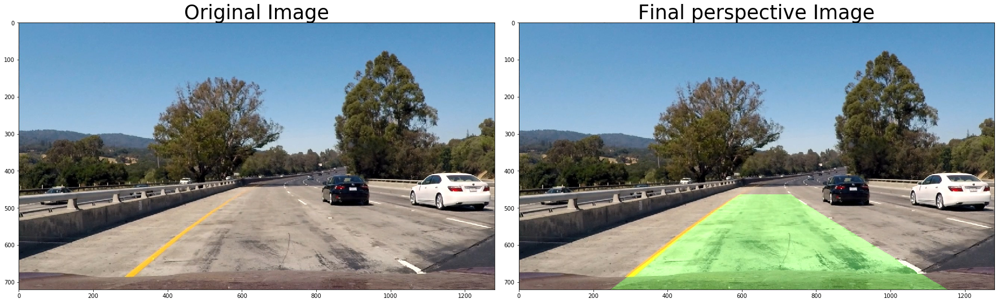

False
--> Using Sliding Windows Approach <--
Curvature radius Real World - Left => 791.421380061912 m - Right 4258.298042937221 m
Top ---> 19557 Middle ---> 19123 Bottom ---> 19887
left_fit_coefs [-2.07508988e-04  2.89371359e-01  2.37119575e+02] right_fit_coefs [-3.85815184e-05  1.83403975e-01  8.90526832e+02]
y_eval -->  719.0
Left_curvature 2409.8286778447173 Right_curvature 13278.985921387899 sanity True


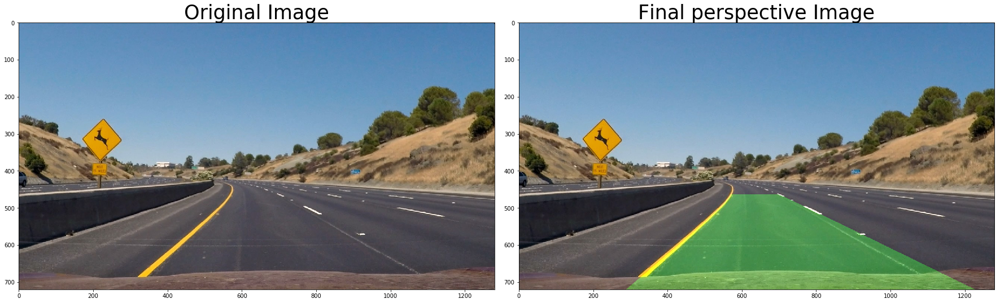

False
--> Using Sliding Windows Approach <--
Curvature radius Real World - Left => 2655.8336192918446 m - Right 1292.317401955469 m
Top ---> 19271 Middle ---> 19096 Bottom ---> 19381
left_fit_coefs [ 6.18629678e-05 -2.22803581e-01  4.22955832e+02] right_fit_coefs [ 1.27099636e-04 -2.64287294e-01  1.06585834e+03]
y_eval -->  719.0
Left_curvature 8300.535893825478 Right_curvature 3973.1991258748194 sanity True


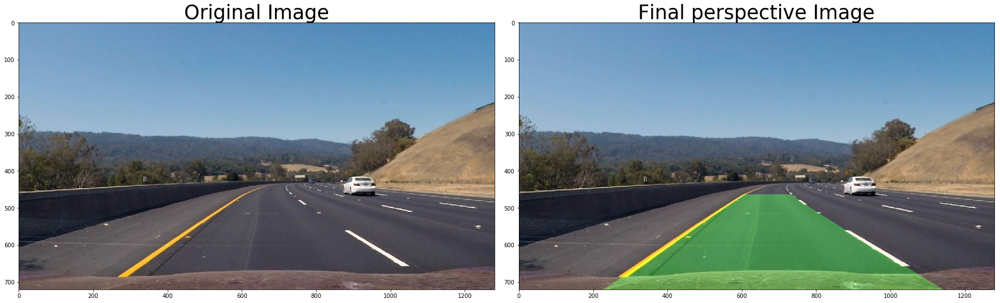

False
--> Using Sliding Windows Approach <--
Curvature radius Real World - Left => 2393.085055029744 m - Right 373.23672825278925 m
Top ---> 21453 Middle ---> 19761 Bottom ---> 20756
left_fit_coefs [ 6.18629678e-05 -2.22803581e-01  4.22955832e+02] right_fit_coefs [ 1.27099636e-04 -2.64287294e-01  1.06585834e+03]
y_eval -->  719.0
Left_curvature 8300.535893825478 Right_curvature 3973.1991258748194 sanity False


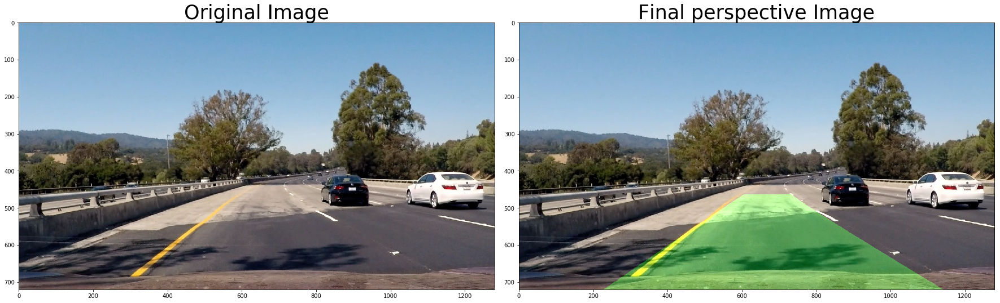

False
--> Using Sliding Windows Approach <--
Curvature radius Real World - Left => 437.0551130438954 m - Right 1851.8554375188478 m
Top ---> 20227 Middle ---> 21338 Bottom ---> 20398
left_fit_coefs [ 6.18629678e-05 -2.22803581e-01  4.22955832e+02] right_fit_coefs [ 1.27099636e-04 -2.64287294e-01  1.06585834e+03]
y_eval -->  719.0
Left_curvature 8300.535893825478 Right_curvature 3973.1991258748194 sanity False


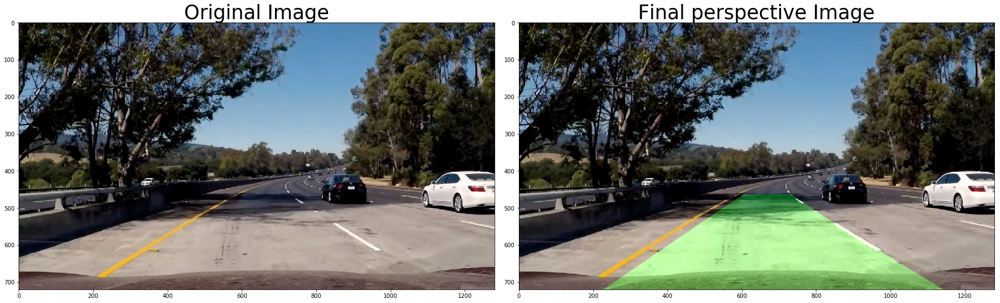

False
--> Using Sliding Windows Approach <--
Curvature radius Real World - Left => 1292.3447128081475 m - Right 560.8363973090289 m
Top ---> 19445 Middle ---> 19378 Bottom ---> 20450
left_fit_coefs [ 6.18629678e-05 -2.22803581e-01  4.22955832e+02] right_fit_coefs [ 1.27099636e-04 -2.64287294e-01  1.06585834e+03]
y_eval -->  719.0
Left_curvature 8300.535893825478 Right_curvature 3973.1991258748194 sanity False


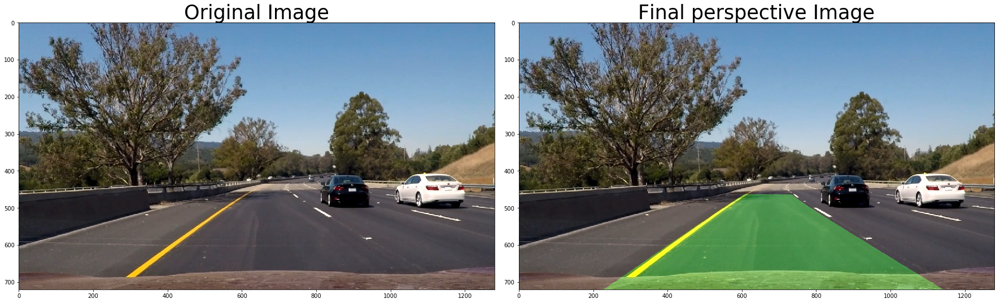

In [54]:
# test full pipeline on a single image
for i in range(6):
    my_img = mpimg.imread(test_images[i])
    final = advancedLaneFindingPipeline(my_img)
    PlotComparisonView(my_img, final, 'Final perspective', colormap = (None, None))

False
--> Using Sliding Windows Approach <--
Curvature radius Real World - Left => 317.1030770978045 m - Right 266.31303525237365 m
Top ---> 18899 Middle ---> 18843 Bottom ---> 18113
left_fit_coefs [-2.14644250e-04  3.24296480e-01  2.20248142e+02] right_fit_coefs [1.26409641e-04 1.15003369e-01 8.80013443e+02]
y_eval -->  719.0
Left_curvature 2330.2903431430236 Right_curvature 4489.316504861725 sanity False


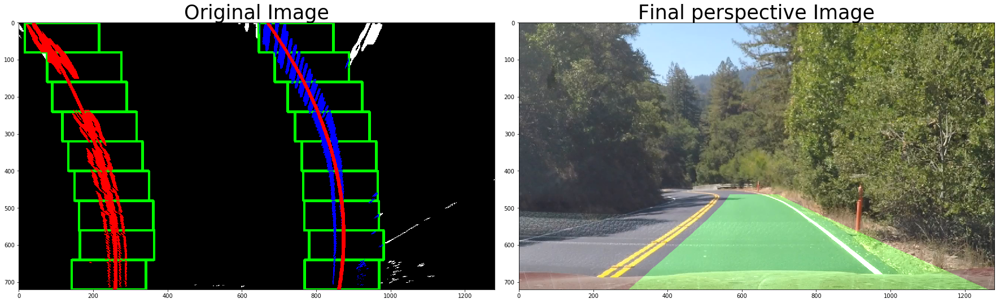

Moviepy - Building video output_videos/challenge_video_solution1.mp4.
Moviepy - Writing video output_videos/challenge_video_solution1.mp4



OSError: [WinError 6] The handle is invalid

In [64]:
# Let's play a bit more with the way I am handling video files
video_output = 'output_videos/challenge_video_solution1.mp4'
## To speed up the testing process you may want to try your pipeline on a shorter subclip of the video
## To do so add .subclip(start_second,end_second) to the end of the line below
## Where start_second and end_second are integer values representing the start and end of the subclip
## You may also uncomment the following line for a subclip of the first 5 seconds
clipLength = 0.4

clip1 = VideoFileClip("harder_challenge_video.mp4").subclip(0, 2)


# number of frames in clip iterator
#N = sum( 1 for f in clip1.iter_frames() )
#print("N =>", N)


white_clip = clip1.fl_image(process_image) #NOTE: this function expects color images!!
%time white_clip.write_videofile(video_output, audio=False)